<a href="https://colab.research.google.com/github/moustafa-7/GANs_MNIST/blob/master/GAN_MNIST_loss_function_a.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
import os
os.chdir("/content/drive/My Drive/GAN_MNIST")

In [0]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets

In [0]:
from utils import Logger

In [0]:
def mnist_data():
  compose = transforms.Compose(
      [transforms.ToTensor(),
       transforms.Normalize((.5,),(.5,))]
  )
  output_dir = './dataset'
  return datasets.MNIST(root=output_dir, train=True, transform=compose, download=True)

#load data
data = mnist_data()

#data loader to iterate over it and train
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)

#Number of batches
num_batches = len(data_loader)


In [0]:
# The Descriminator
class DNet(torch.nn.Module):
  def __init__(self):
    super(DNet, self).__init__()

    len_features = 28*28
    len_out = 1


    self.h0 = nn.Sequential(nn.Linear(len_features, 1024),
                            nn.LeakyReLU(0.2),
                            nn.Dropout(0.3))
    
    self.h1 = nn.Sequential(nn.Linear(1024,512),
                            nn.LeakyReLU(0.2),
                            nn.Dropout(0.3))
    
    self.h2 = nn.Sequential(nn.Linear(512,256),
                            nn.LeakyReLU(0.2),
                            nn.Dropout(0.3))
    
    self.out = nn.Sequential(nn.Linear(256, len_out),
                             nn.Sigmoid())
    
  def forward(self, x):
    x = self.h0(x)
    x = self.h1(x)
    x = self.h2(x)
    x = self.out(x)
    return x

dnet = DNet()

In [0]:
class GNet(torch.nn.Module):
  def __init__(self):
    super(GNet, self).__init__()
    len_features = 100
    len_out = 28*28


    self.h0 = nn.Sequential(nn.Linear(len_features, 256),
                            nn.LeakyReLU(0.2))
    
    self.h1 = nn.Sequential(nn.Linear(256,512),
                            nn.LeakyReLU(0.2))
    
    self.h2 = nn.Sequential(nn.Linear(512,1024),
                            nn.LeakyReLU(0.2))
    
    self.out = nn.Sequential(nn.Linear(1024, len_out),
                             nn.Tanh())
  
  def forward(self, x):
    x = self.h0(x)
    x = self.h1(x)
    x = self.h2(x)
    x = self.out(x)
    return x

gnet = GNet()


In [0]:
d_optimizer = optim.Adam(dnet.parameters(), lr=0.0002)
g_optimizer = optim.Adam(gnet.parameters(), lr=0.0002)

In [0]:
loss = nn.BCELoss()

In [0]:
def img_to_vec(imgs):
  return imgs.view(imgs.size(0), 28*28)

def vec_to_img(vecs):
  return vecs.view(vecs.size(0), 1, 28, 28)

In [0]:
def ones_vec(size):
  data = Variable(torch.ones(size,1))
  return data
  
def zeros_vec(size):
  data = Variable(torch.zeros(size,1))
  return data

In [0]:
def noise(size):
  n = Variable(torch.randn(size, 100))
  return n

In [0]:
def train_dnet(optimizer, real_data, fake_data):
  n = real_data.size(0)
  optimizer.zero_grad()

  prediction_real = dnet(real_data)
  error_real = loss(prediction_real, ones_vec(n))
  error_real.backward()

  prediction_fake = dnet(fake_data)
  error_fake = loss(prediction_fake, zeros_vec(n))
  error_fake.backward()

  optimizer.step()

  return error_real + error_fake, prediction_real, prediction_fake

In [0]:
def train_gnet(optimizer, fake_data):
  n = fake_data.size(0)

  optimizer.zero_grad()

  prediction = dnet(fake_data)

  error = loss(prediction, ones_vec(n))
  error.backward()
  
  optimizer.step()

  return error

In [0]:
num_test_samples = 16
test_noise = noise(num_test_samples)

In [0]:
# create logger instance
logger = Logger("GAN_b_loss", data_name='MNIST')
num_epochs = 200

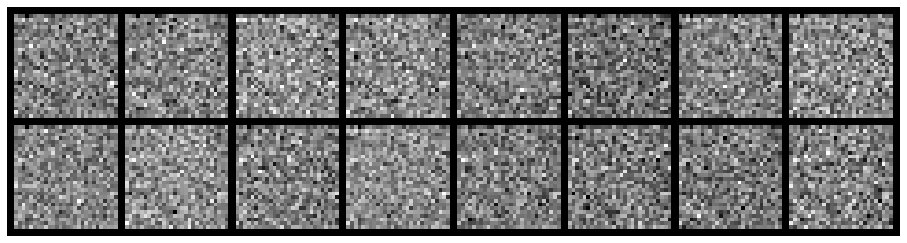

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.3679, Generator Loss: 0.6773
D(x): 0.5178, D(G(z)): 0.5081


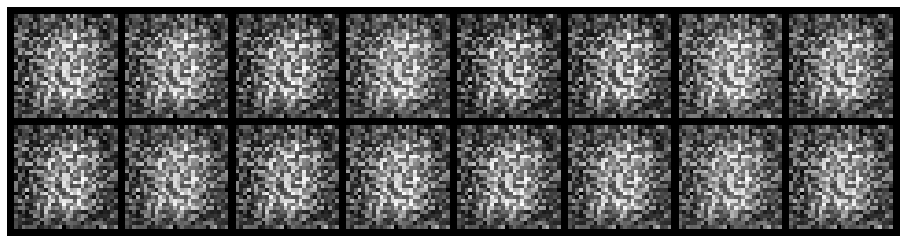

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 1.1103, Generator Loss: 1.2715
D(x): 0.8307, D(G(z)): 0.5822


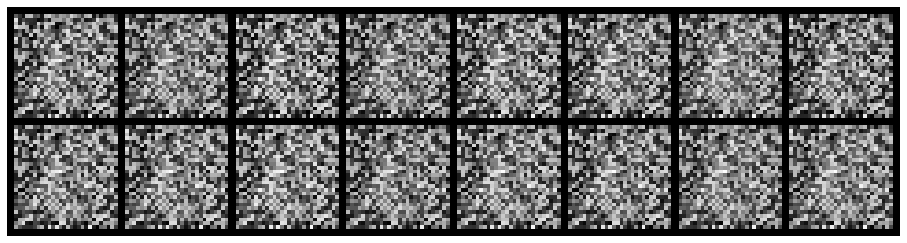

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.3014, Generator Loss: 4.3309
D(x): 0.9531, D(G(z)): 0.1920


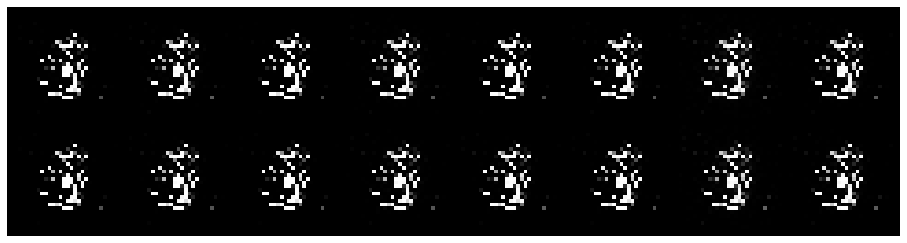

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.3365, Generator Loss: 3.5416
D(x): 0.8714, D(G(z)): 0.1249


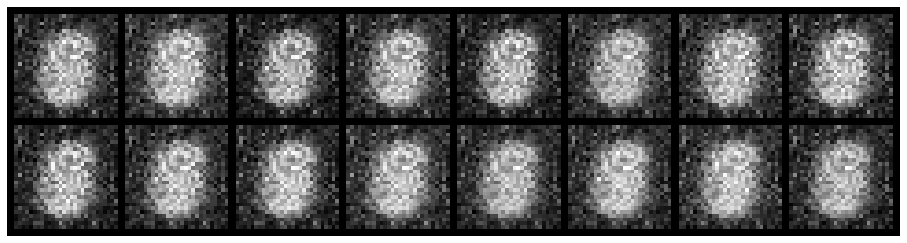

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 0.9563, Generator Loss: 1.6045
D(x): 0.7316, D(G(z)): 0.4168


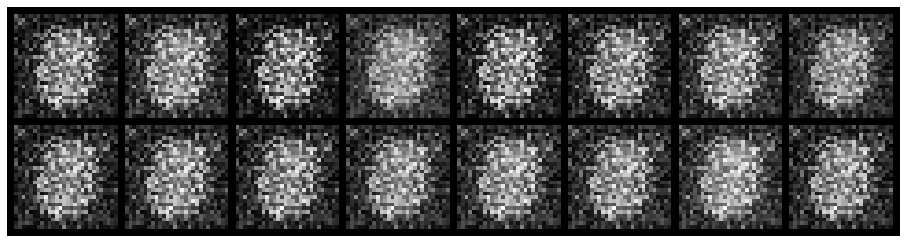

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 1.6660, Generator Loss: 0.3452
D(x): 0.7333, D(G(z)): 0.7291


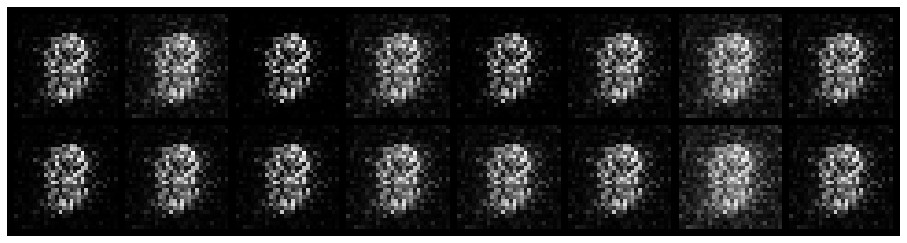

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.8641, Generator Loss: 2.1751
D(x): 0.5031, D(G(z)): 0.1471


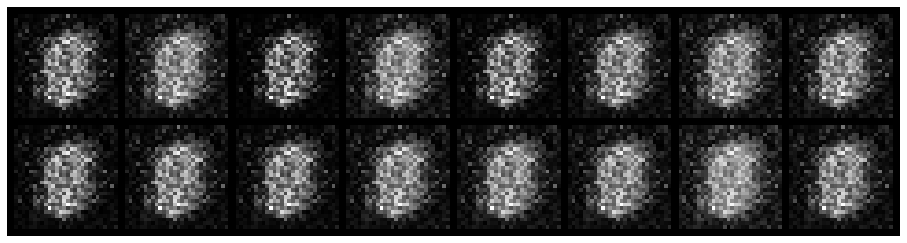

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 1.3154, Generator Loss: 0.9889
D(x): 0.5113, D(G(z)): 0.4461


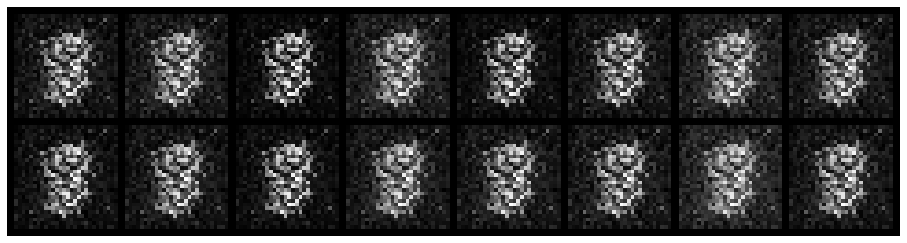

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 2.5299, Generator Loss: 0.1971
D(x): 0.6957, D(G(z)): 0.8657


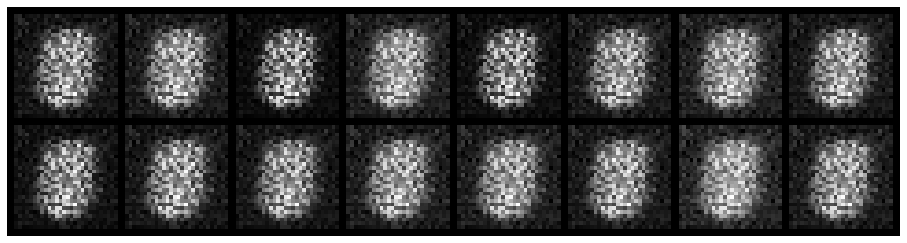

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.6422, Generator Loss: 2.2756
D(x): 0.6950, D(G(z)): 0.2049


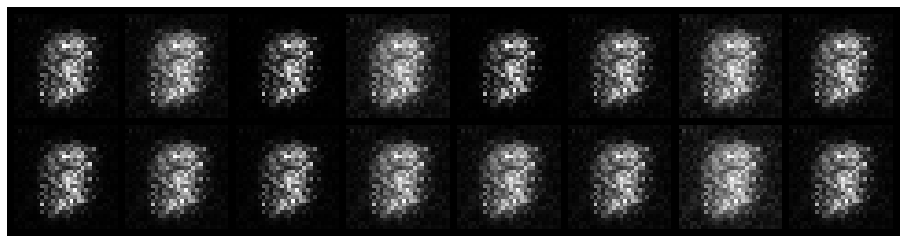

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 1.2794, Generator Loss: 0.8381
D(x): 0.5028, D(G(z)): 0.4436


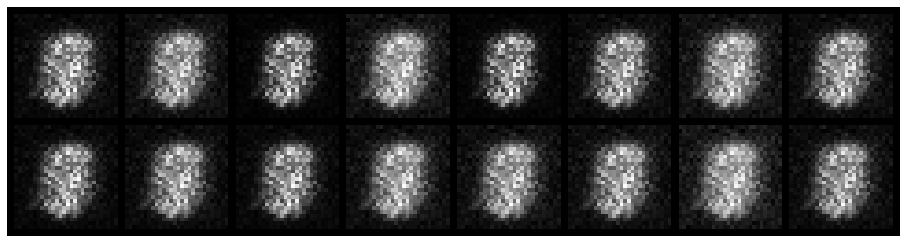

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 0.7212, Generator Loss: 1.5956
D(x): 0.7201, D(G(z)): 0.2594


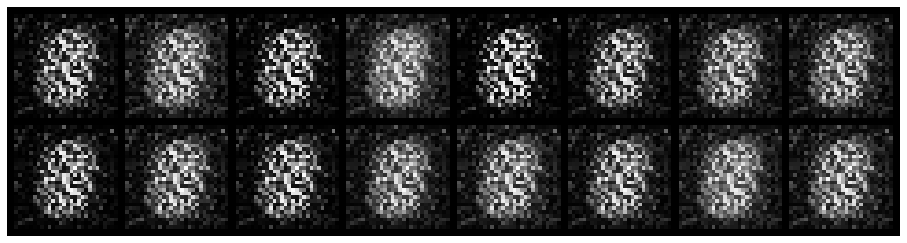

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 2.1287, Generator Loss: 0.9781
D(x): 0.3547, D(G(z)): 0.5913


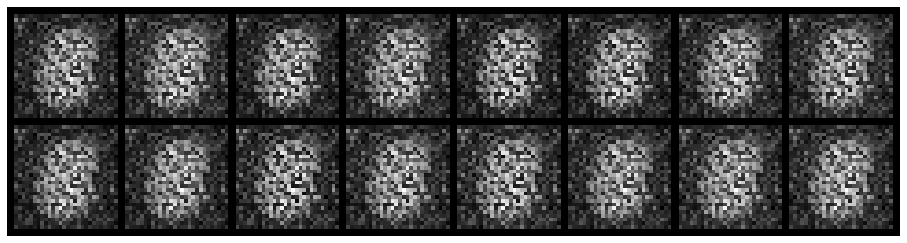

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 1.4529, Generator Loss: 0.8956
D(x): 0.7004, D(G(z)): 0.5582


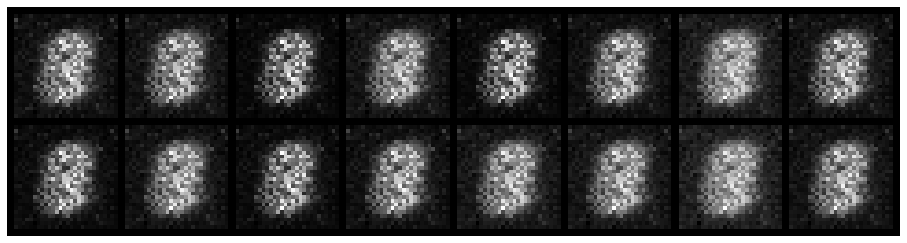

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 1.1227, Generator Loss: 1.2061
D(x): 0.6161, D(G(z)): 0.3952


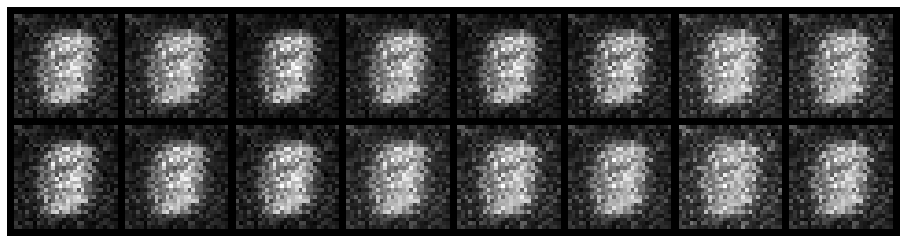

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.6885, Generator Loss: 1.5547
D(x): 0.8274, D(G(z)): 0.3476


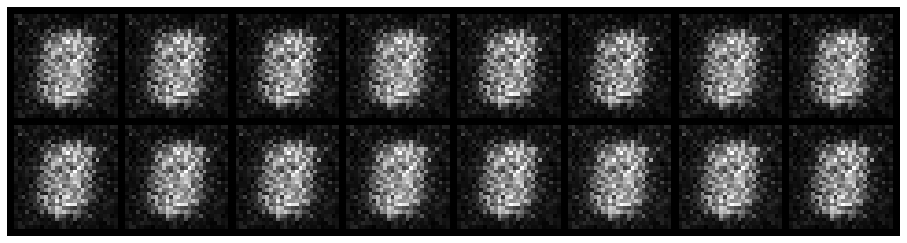

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.3581, Generator Loss: 3.3099
D(x): 0.8568, D(G(z)): 0.1333


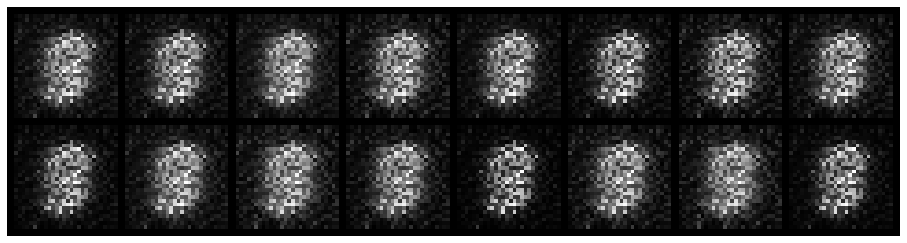

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 1.4620, Generator Loss: 1.0332
D(x): 0.6942, D(G(z)): 0.5916


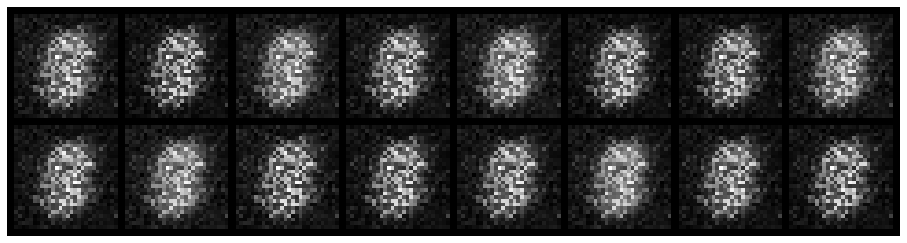

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.7062, Generator Loss: 4.6891
D(x): 0.8078, D(G(z)): 0.2686


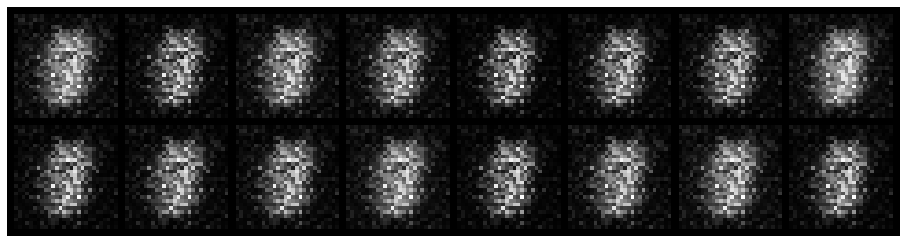

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.7429, Generator Loss: 3.1134
D(x): 0.6976, D(G(z)): 0.2008


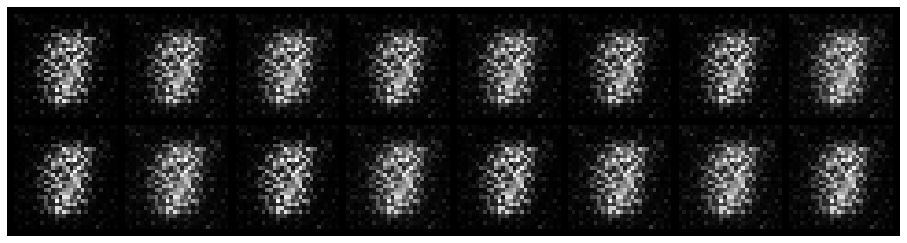

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 1.4348, Generator Loss: 1.7487
D(x): 0.7306, D(G(z)): 0.4787


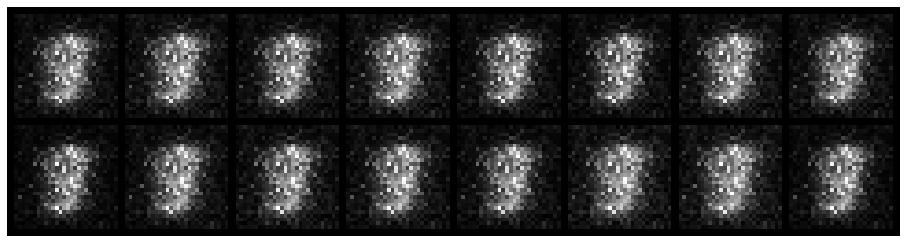

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.7156, Generator Loss: 2.0580
D(x): 0.7591, D(G(z)): 0.2113


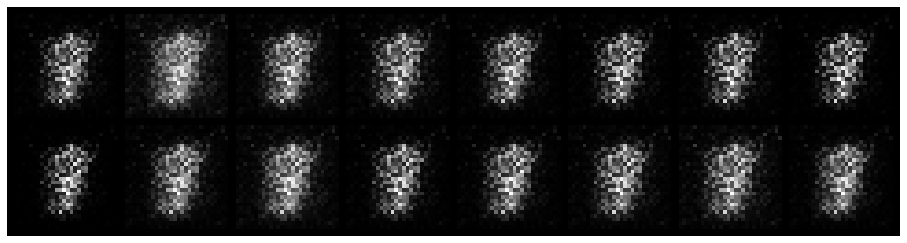

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 1.4156, Generator Loss: 2.4801
D(x): 0.7136, D(G(z)): 0.3108


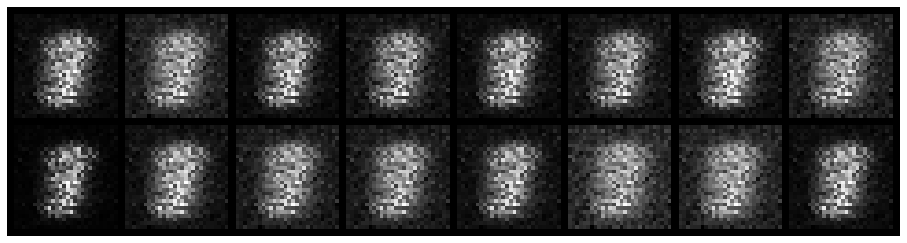

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.7196, Generator Loss: 1.4472
D(x): 0.8052, D(G(z)): 0.2864


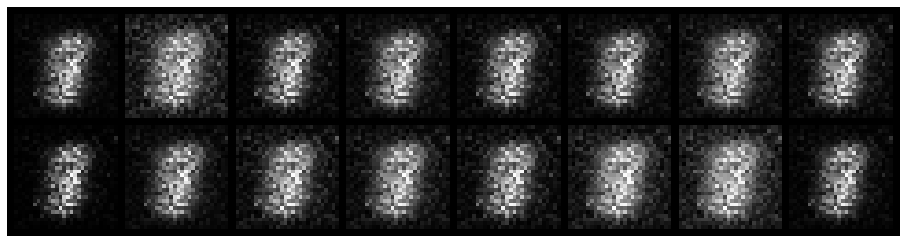

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.1534, Generator Loss: 3.0914
D(x): 0.9641, D(G(z)): 0.0859


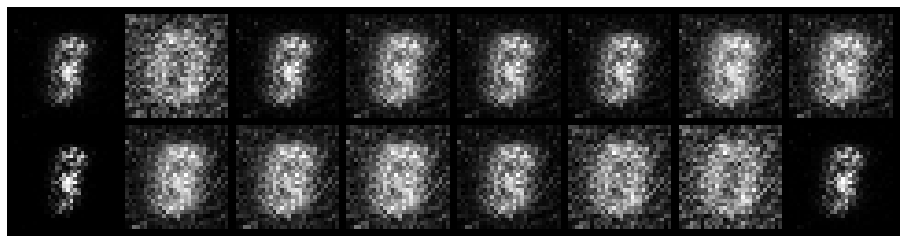

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.3540, Generator Loss: 3.3820
D(x): 0.8694, D(G(z)): 0.1182


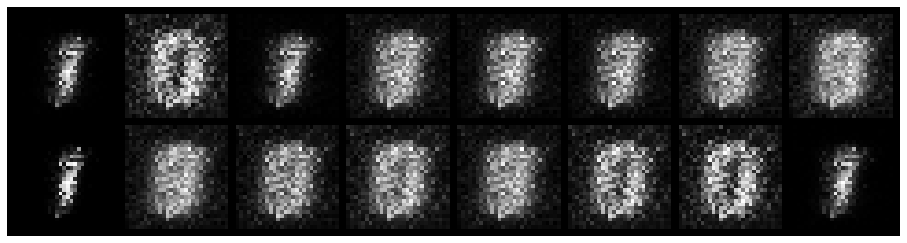

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.7226, Generator Loss: 2.7528
D(x): 0.7241, D(G(z)): 0.2076


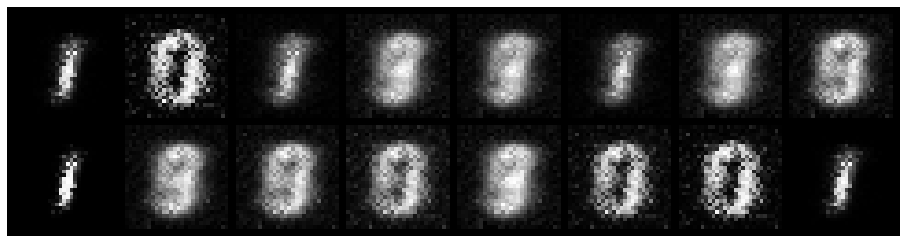

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.9392, Generator Loss: 1.4772
D(x): 0.6672, D(G(z)): 0.3118


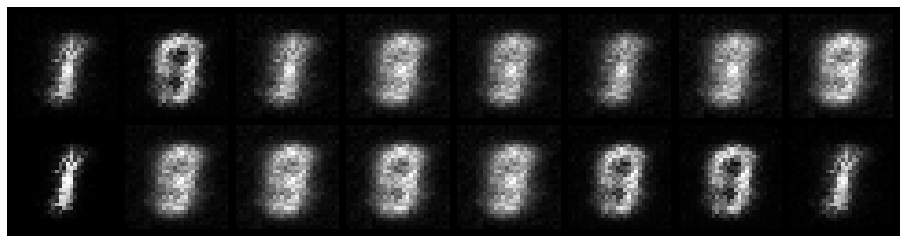

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.9525, Generator Loss: 1.3028
D(x): 0.6713, D(G(z)): 0.2991


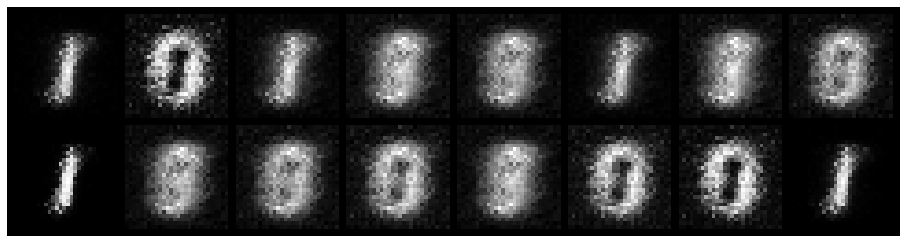

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.9799, Generator Loss: 1.3945
D(x): 0.6951, D(G(z)): 0.3003


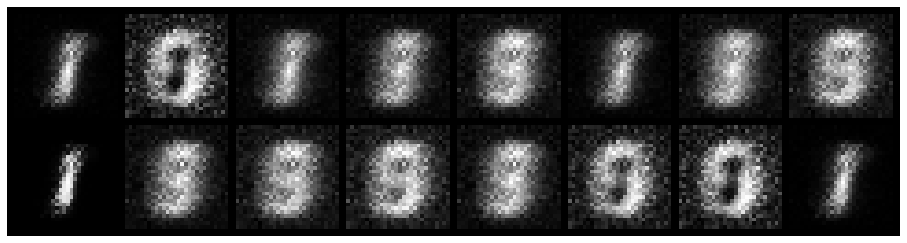

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.3895, Generator Loss: 2.1113
D(x): 0.8994, D(G(z)): 0.1710


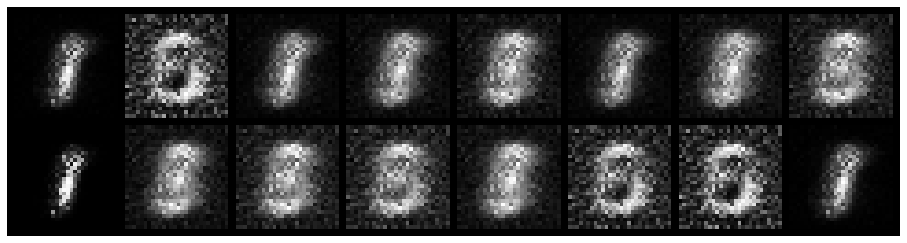

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.4299, Generator Loss: 2.1968
D(x): 0.9054, D(G(z)): 0.1797


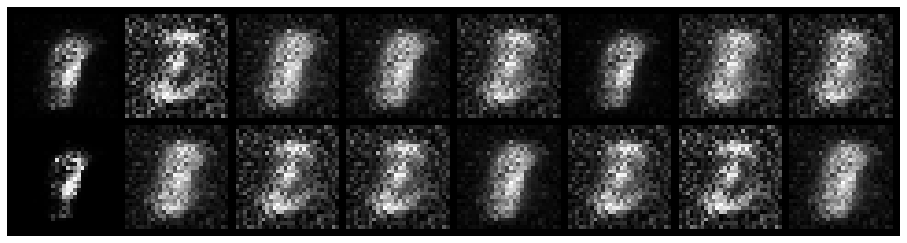

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.3217, Generator Loss: 2.3991
D(x): 0.9173, D(G(z)): 0.1443


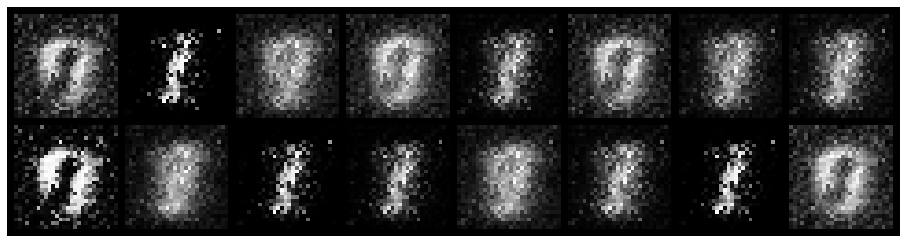

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.4057, Generator Loss: 4.0196
D(x): 0.8455, D(G(z)): 0.1092


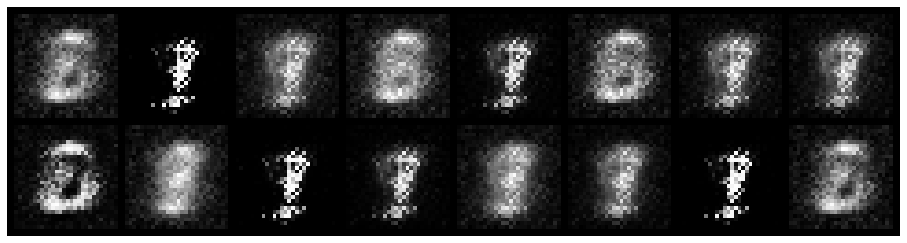

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.3736, Generator Loss: 3.9230
D(x): 0.8772, D(G(z)): 0.1287


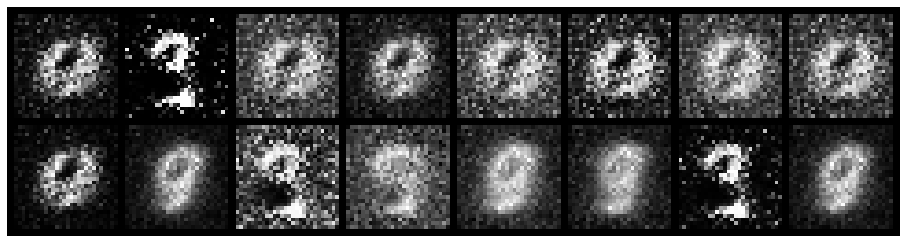

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.8267, Generator Loss: 2.8928
D(x): 0.7349, D(G(z)): 0.1235


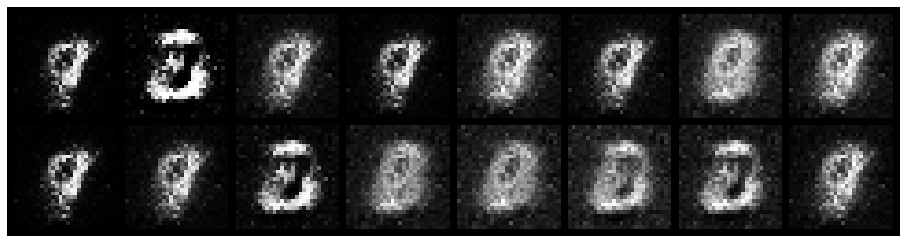

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.7667, Generator Loss: 2.1492
D(x): 0.9546, D(G(z)): 0.4166


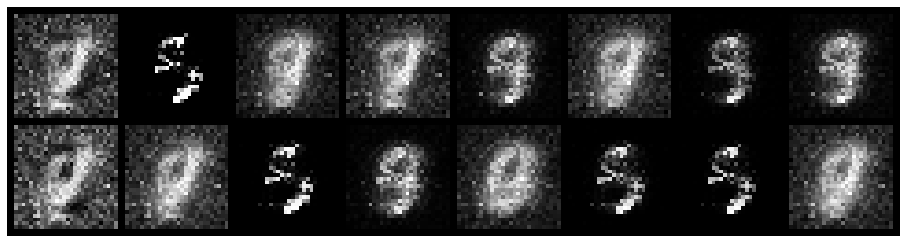

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.4616, Generator Loss: 3.0790
D(x): 0.8866, D(G(z)): 0.1889


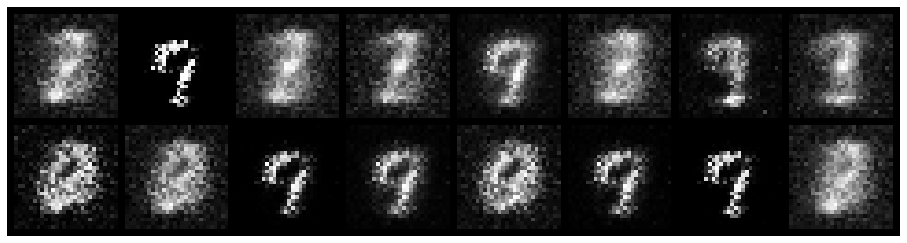

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.4408, Generator Loss: 2.5117
D(x): 0.8503, D(G(z)): 0.1511


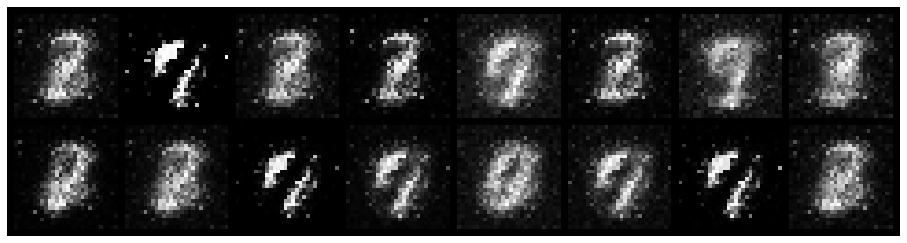

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.4219, Generator Loss: 3.4542
D(x): 0.8624, D(G(z)): 0.0977


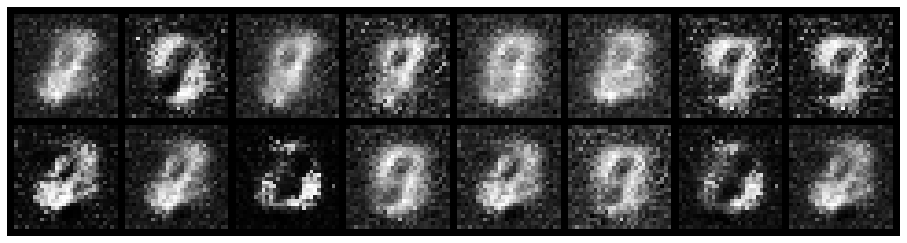

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.5947, Generator Loss: 2.8597
D(x): 0.8604, D(G(z)): 0.1580


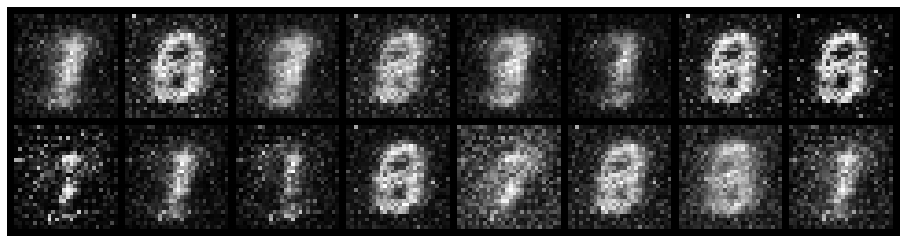

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.4777, Generator Loss: 2.8283
D(x): 0.8879, D(G(z)): 0.2015


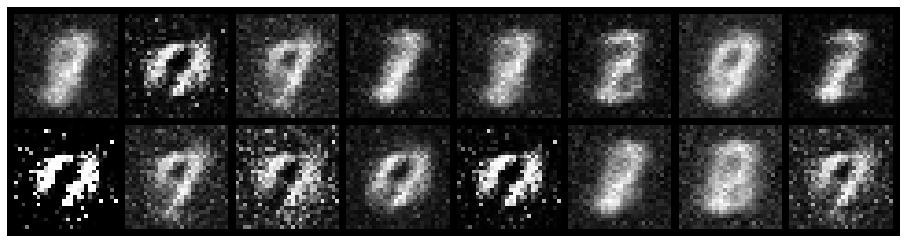

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.3648, Generator Loss: 2.4746
D(x): 0.8959, D(G(z)): 0.1657


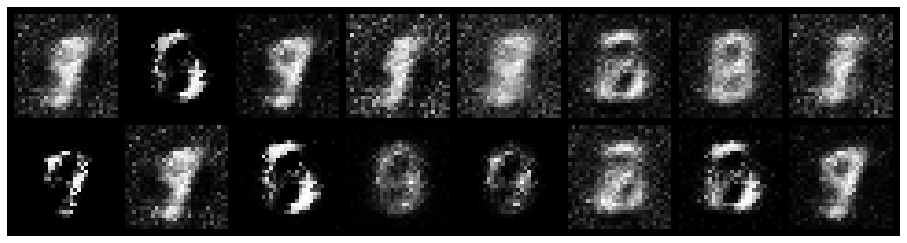

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.2835, Generator Loss: 2.9400
D(x): 0.9072, D(G(z)): 0.1258


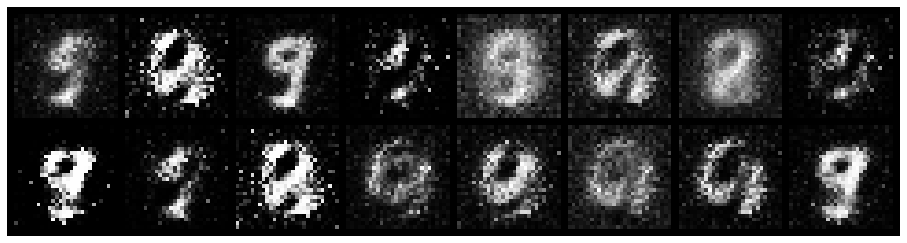

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.7444, Generator Loss: 2.3913
D(x): 0.7071, D(G(z)): 0.1545


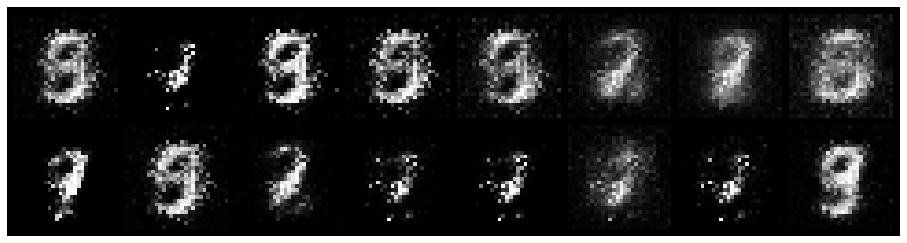

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.6764, Generator Loss: 1.6527
D(x): 0.8284, D(G(z)): 0.2952


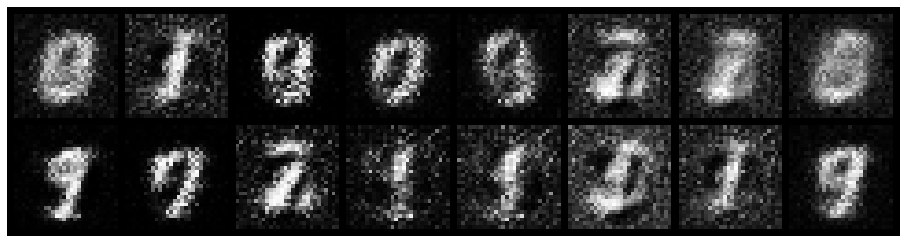

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.6687, Generator Loss: 1.7238
D(x): 0.8225, D(G(z)): 0.2706


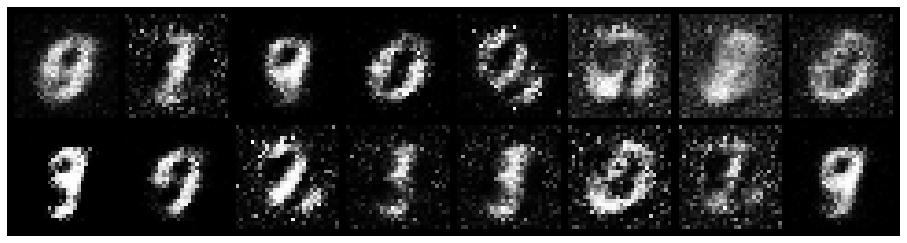

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.7231, Generator Loss: 2.2635
D(x): 0.7548, D(G(z)): 0.1487


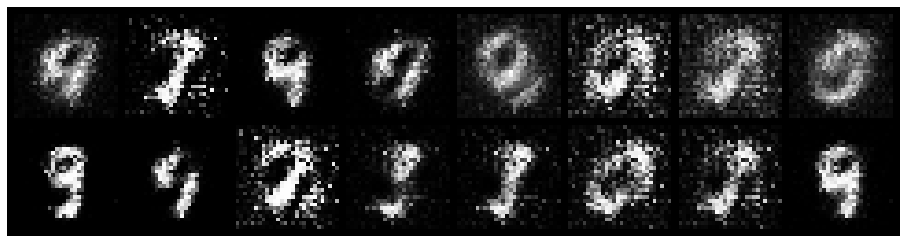

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.5866, Generator Loss: 3.4441
D(x): 0.8359, D(G(z)): 0.1409


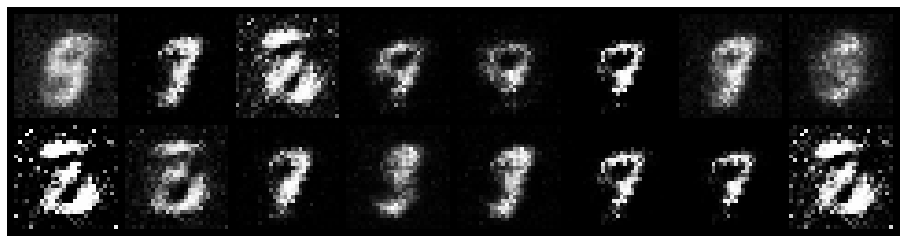

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.7984, Generator Loss: 1.4488
D(x): 0.7683, D(G(z)): 0.2812


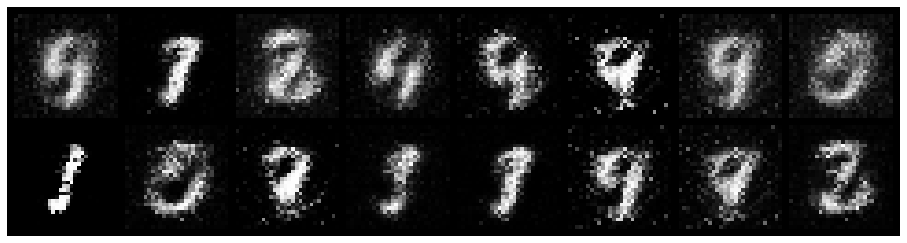

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.5471, Generator Loss: 2.7596
D(x): 0.7826, D(G(z)): 0.1278


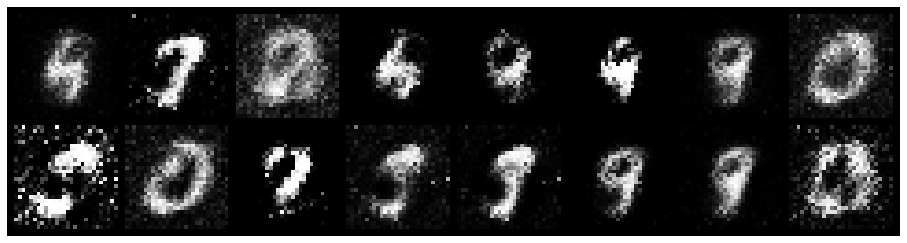

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.3726, Generator Loss: 2.4842
D(x): 0.8669, D(G(z)): 0.1537


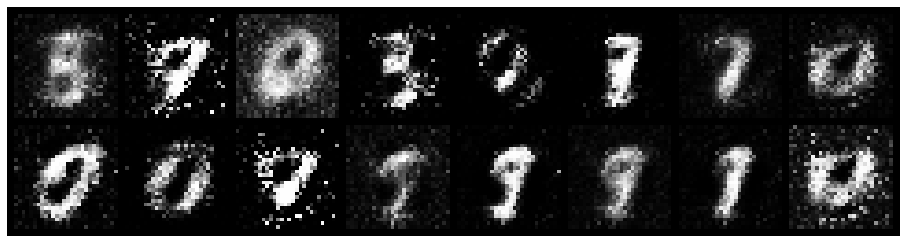

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.6028, Generator Loss: 2.6398
D(x): 0.7968, D(G(z)): 0.1779


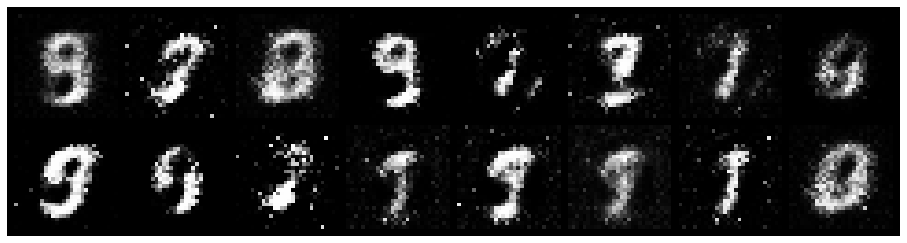

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.4050, Generator Loss: 2.9647
D(x): 0.8509, D(G(z)): 0.0899


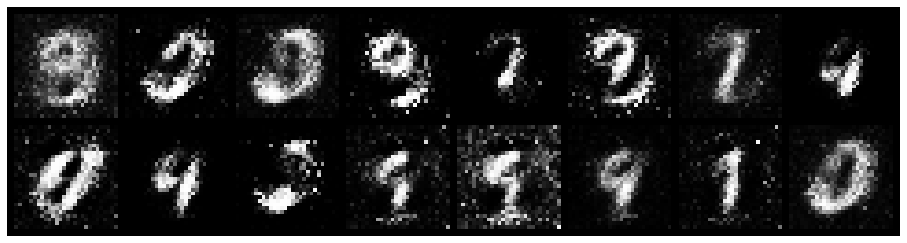

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.5396, Generator Loss: 2.2637
D(x): 0.8521, D(G(z)): 0.1842


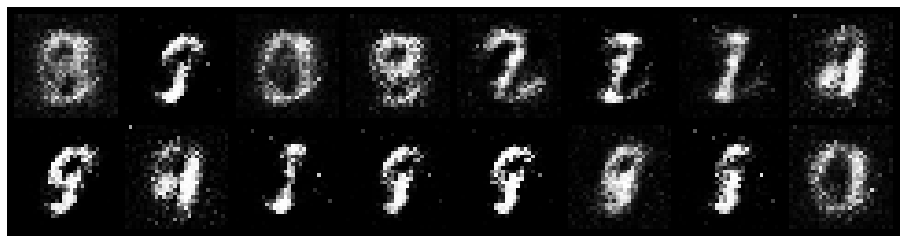

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 1.0070, Generator Loss: 1.5312
D(x): 0.6933, D(G(z)): 0.2898


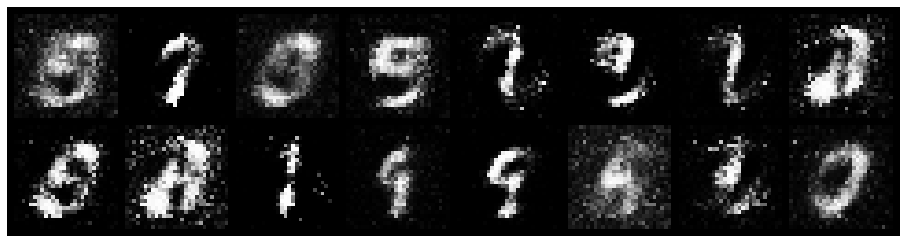

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.8104, Generator Loss: 2.4387
D(x): 0.7209, D(G(z)): 0.2043


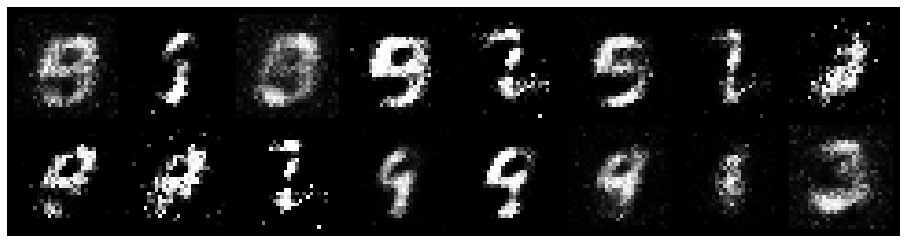

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.6216, Generator Loss: 1.9968
D(x): 0.8637, D(G(z)): 0.2654


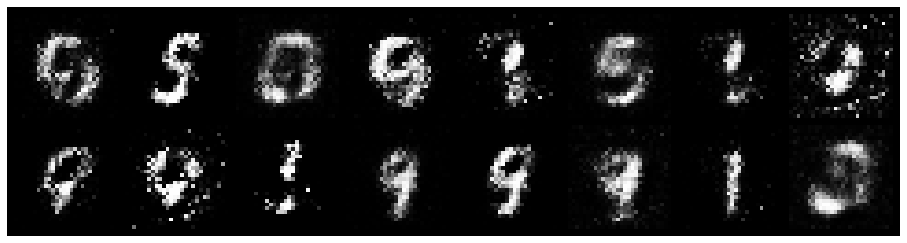

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.7042, Generator Loss: 2.0182
D(x): 0.7717, D(G(z)): 0.2017


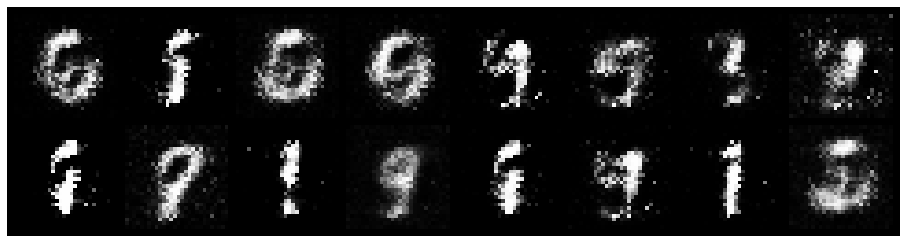

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.4300, Generator Loss: 2.0352
D(x): 0.8690, D(G(z)): 0.1810


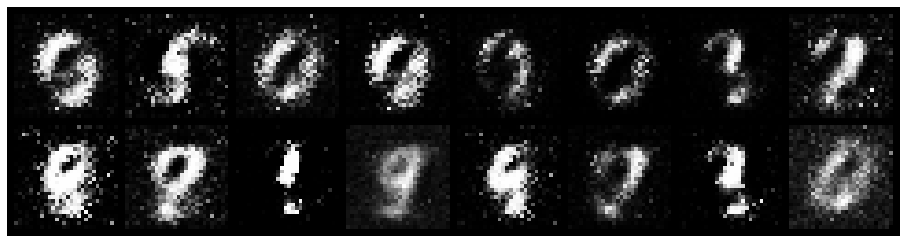

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.7699, Generator Loss: 1.6612
D(x): 0.6917, D(G(z)): 0.2372


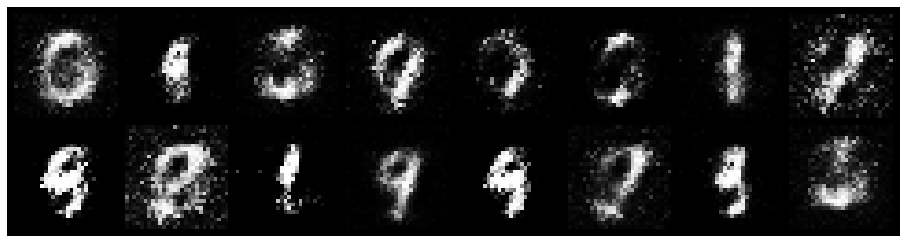

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.3802, Generator Loss: 2.6723
D(x): 0.8846, D(G(z)): 0.1490


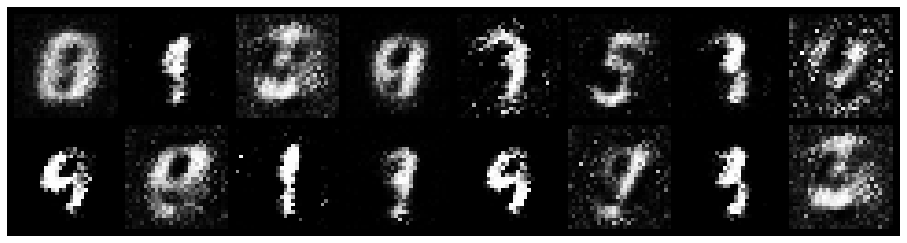

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.6231, Generator Loss: 1.8489
D(x): 0.7569, D(G(z)): 0.1736


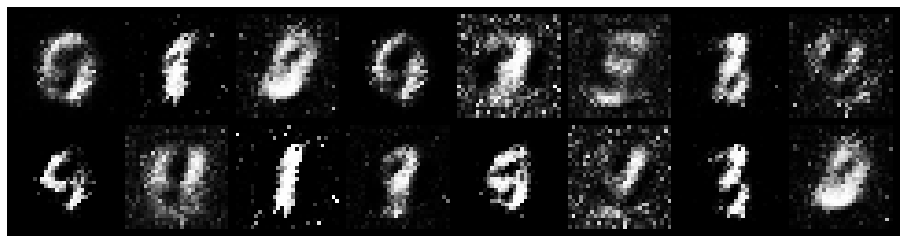

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.6720, Generator Loss: 2.5191
D(x): 0.7829, D(G(z)): 0.1939


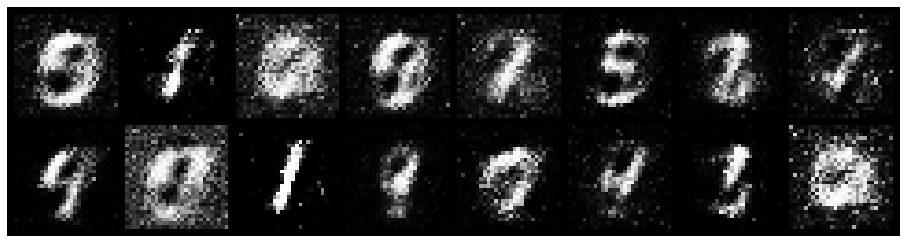

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 1.1845, Generator Loss: 1.1338
D(x): 0.6819, D(G(z)): 0.4090


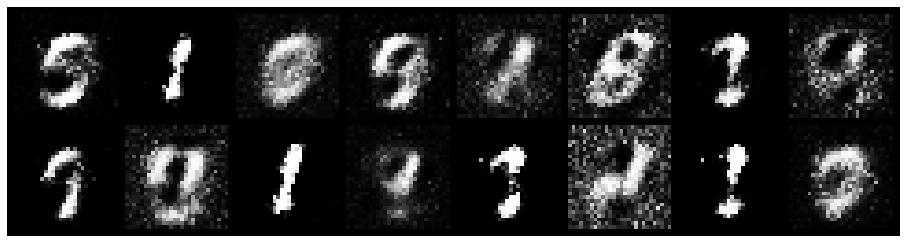

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 1.0304, Generator Loss: 1.8118
D(x): 0.6392, D(G(z)): 0.2565


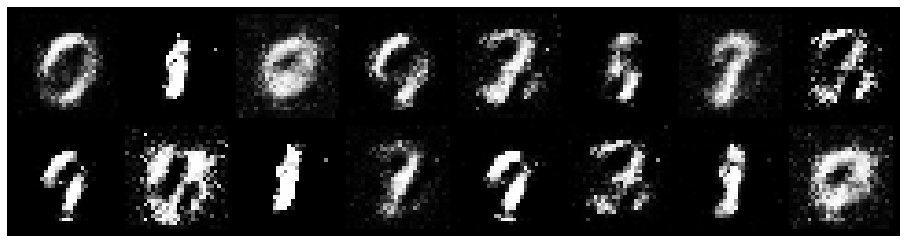

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.5959, Generator Loss: 1.9451
D(x): 0.7910, D(G(z)): 0.2224


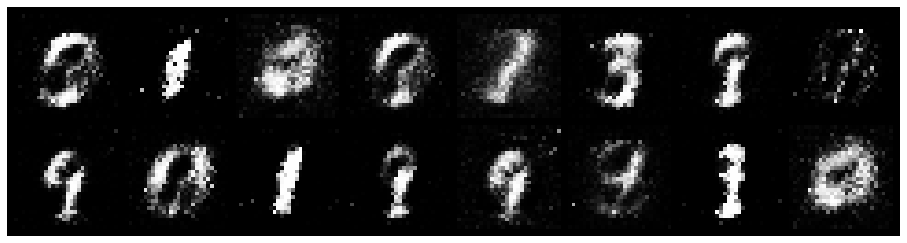

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.6449, Generator Loss: 2.2435
D(x): 0.7342, D(G(z)): 0.1551


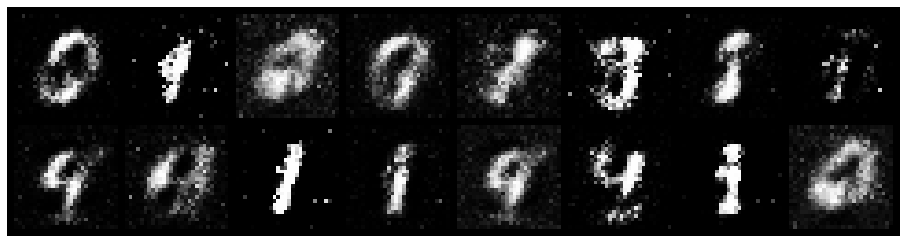

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.7228, Generator Loss: 1.9543
D(x): 0.7992, D(G(z)): 0.2498


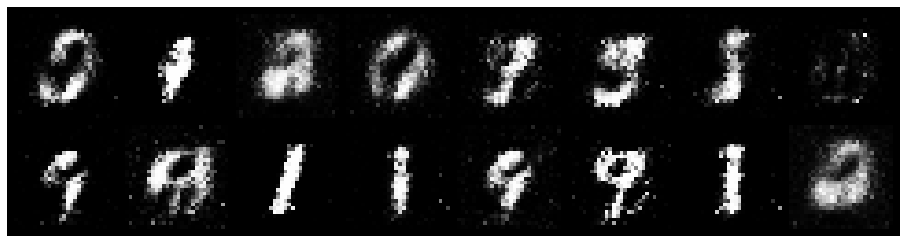

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 1.3049, Generator Loss: 1.4207
D(x): 0.5588, D(G(z)): 0.2724


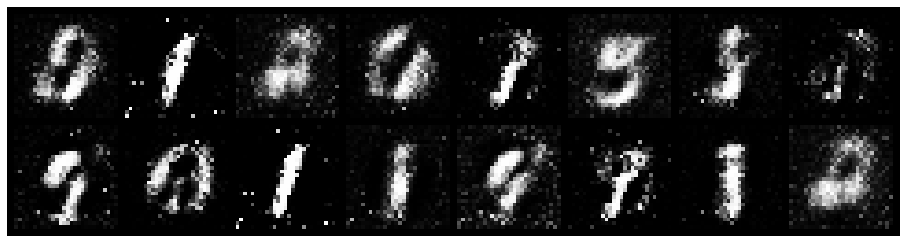

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.8023, Generator Loss: 2.0724
D(x): 0.7211, D(G(z)): 0.2171


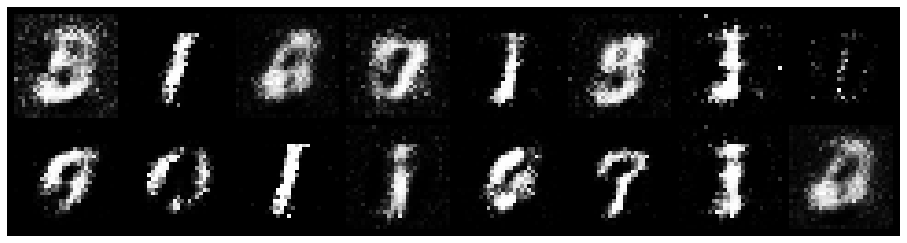

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.8269, Generator Loss: 1.9113
D(x): 0.7805, D(G(z)): 0.2801


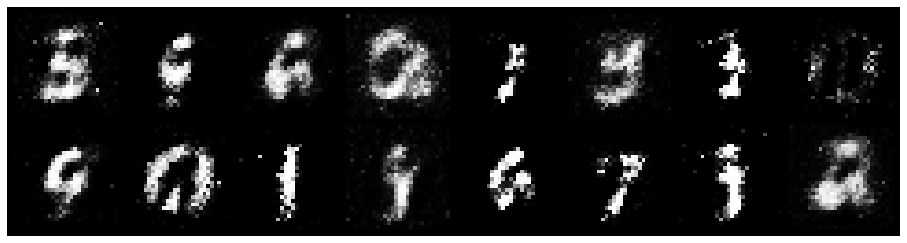

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.6449, Generator Loss: 2.1361
D(x): 0.7948, D(G(z)): 0.2220


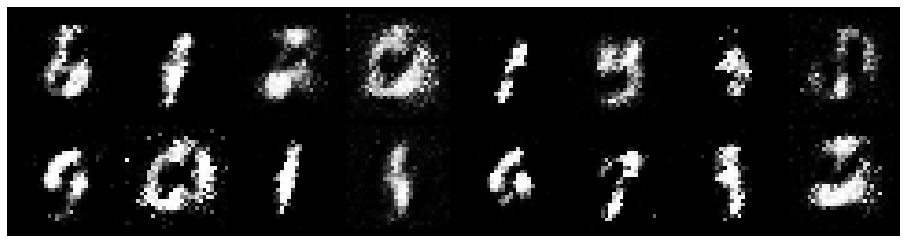

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.9015, Generator Loss: 1.9211
D(x): 0.8223, D(G(z)): 0.3250


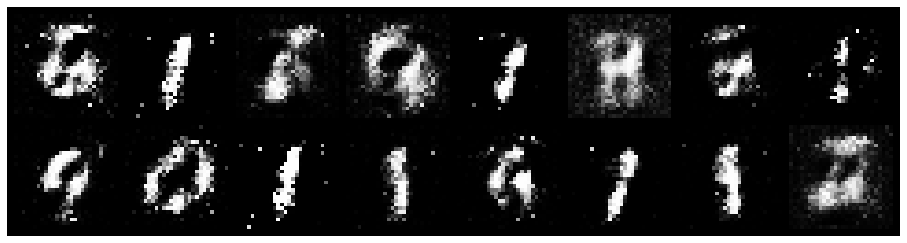

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.8193, Generator Loss: 1.7666
D(x): 0.7309, D(G(z)): 0.2604


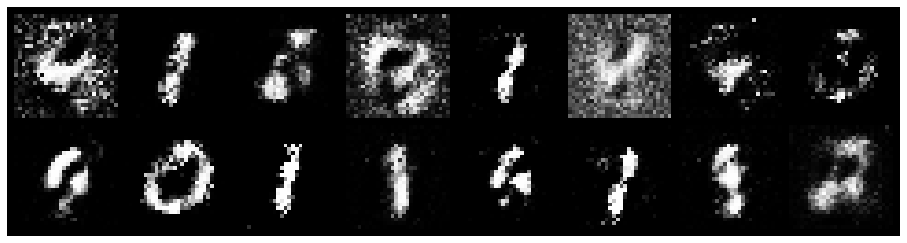

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 1.0708, Generator Loss: 1.8523
D(x): 0.7709, D(G(z)): 0.3465


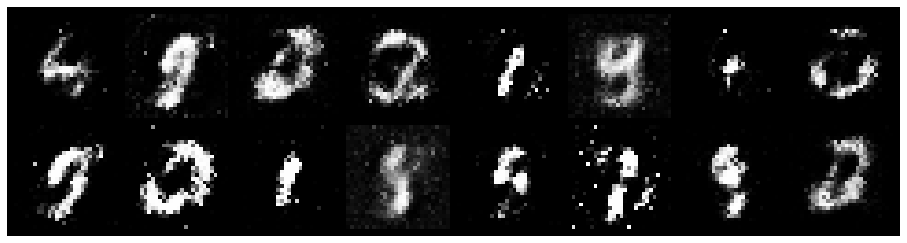

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.7843, Generator Loss: 1.7554
D(x): 0.7914, D(G(z)): 0.2754


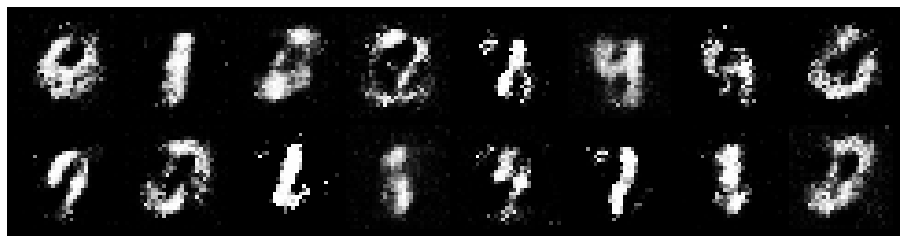

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.7495, Generator Loss: 2.3860
D(x): 0.8058, D(G(z)): 0.2467


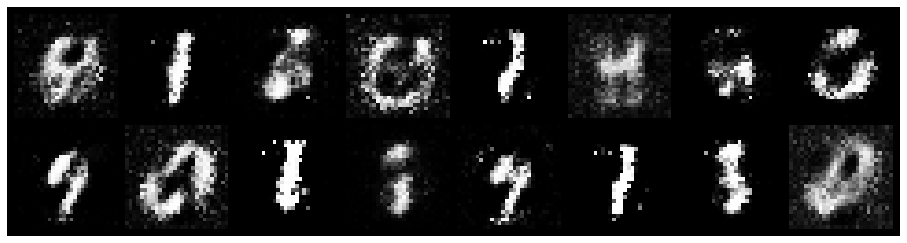

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.5641, Generator Loss: 1.9763
D(x): 0.8202, D(G(z)): 0.1972


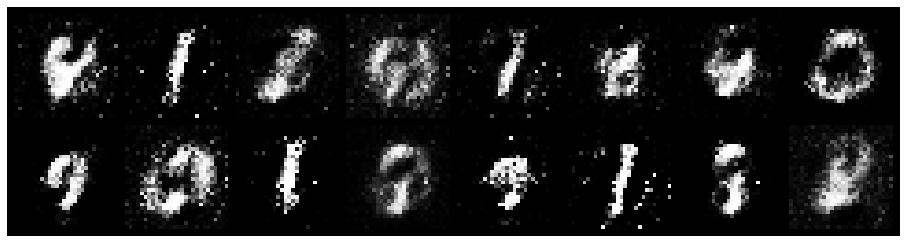

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.6432, Generator Loss: 2.0315
D(x): 0.7718, D(G(z)): 0.2106


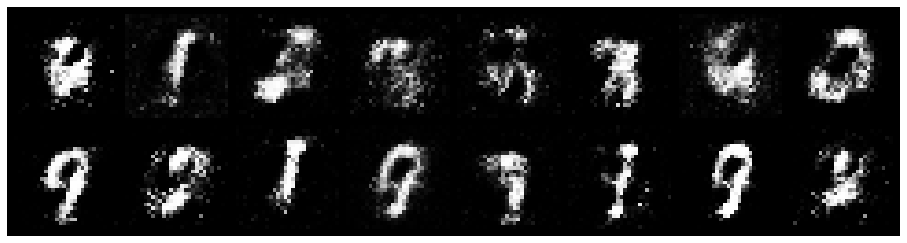

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.8566, Generator Loss: 1.7410
D(x): 0.6706, D(G(z)): 0.1899


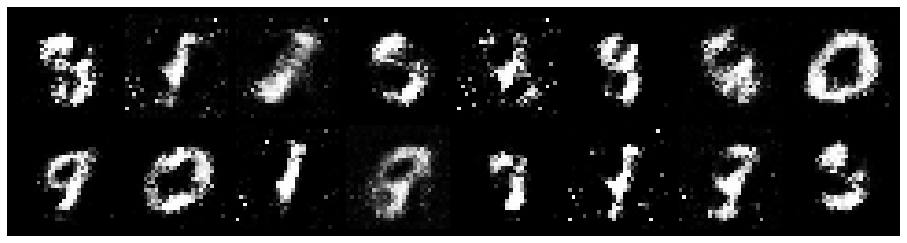

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.8414, Generator Loss: 1.6298
D(x): 0.7197, D(G(z)): 0.2433


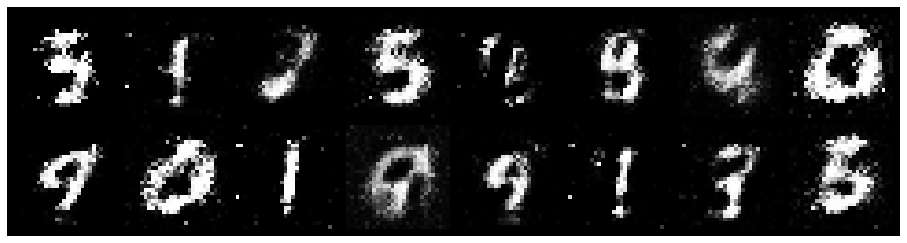

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.6776, Generator Loss: 1.8302
D(x): 0.8300, D(G(z)): 0.2827


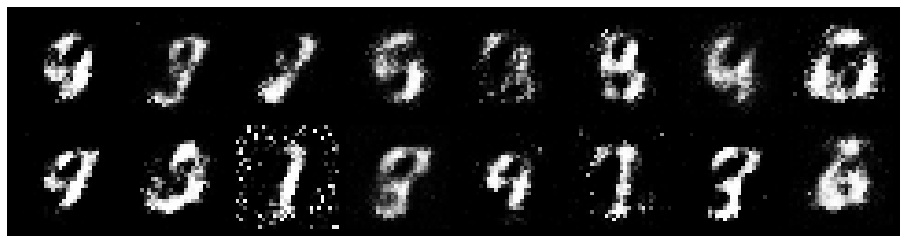

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.8245, Generator Loss: 1.6565
D(x): 0.7546, D(G(z)): 0.3049


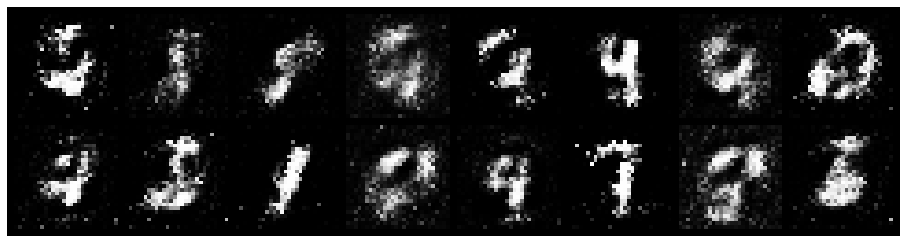

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.6598, Generator Loss: 1.7359
D(x): 0.7695, D(G(z)): 0.2409


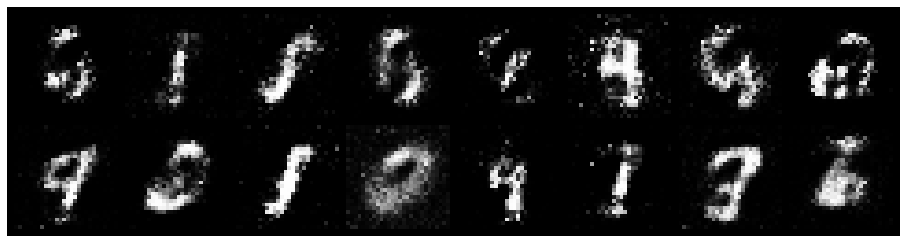

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.9048, Generator Loss: 1.4737
D(x): 0.7299, D(G(z)): 0.2914


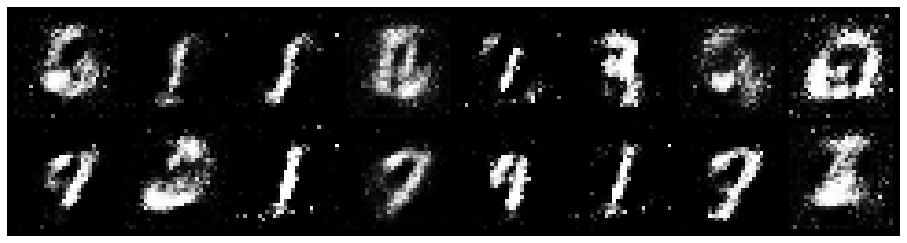

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 1.0204, Generator Loss: 1.9576
D(x): 0.6845, D(G(z)): 0.2800


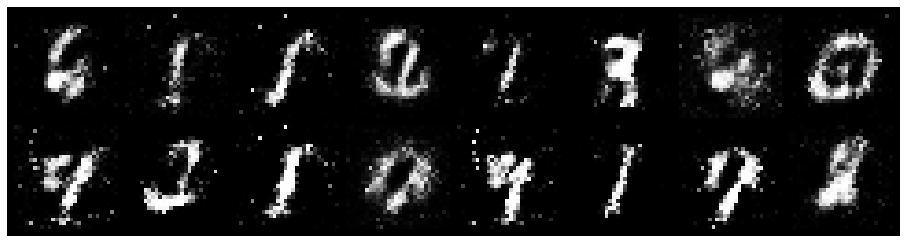

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.5825, Generator Loss: 2.2939
D(x): 0.8259, D(G(z)): 0.1910


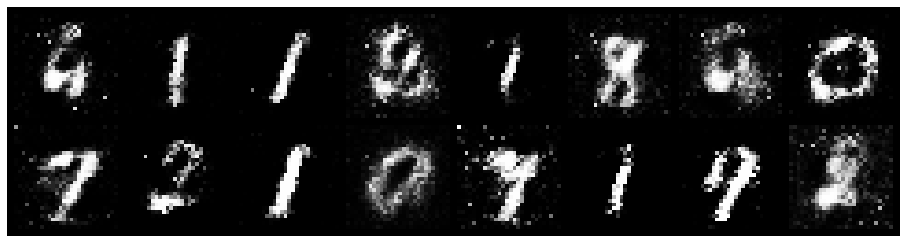

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.5940, Generator Loss: 1.6886
D(x): 0.8334, D(G(z)): 0.2615


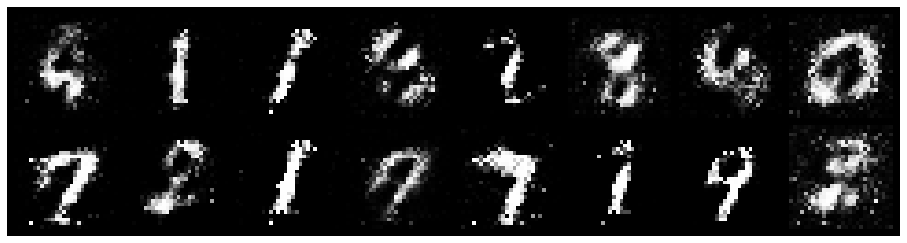

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.7028, Generator Loss: 1.9469
D(x): 0.7192, D(G(z)): 0.2054


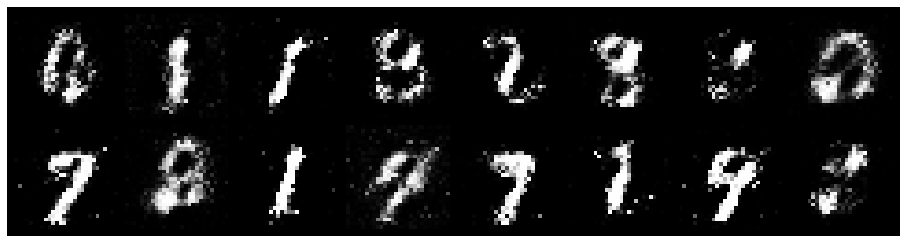

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.6402, Generator Loss: 1.7158
D(x): 0.7877, D(G(z)): 0.2560


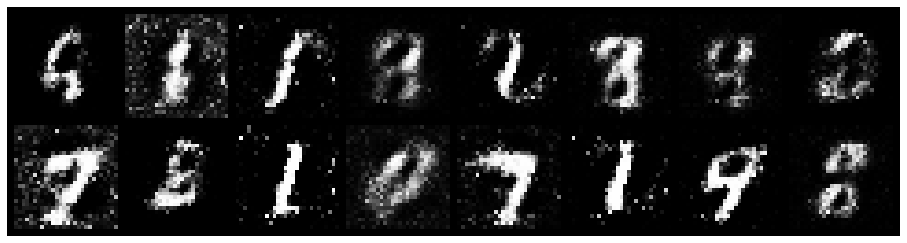

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.7775, Generator Loss: 1.6286
D(x): 0.7179, D(G(z)): 0.2563


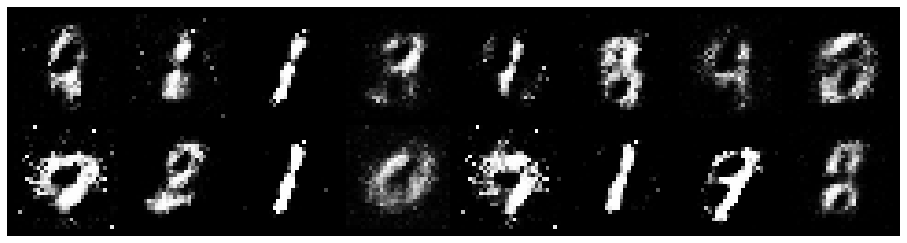

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.9044, Generator Loss: 1.4141
D(x): 0.7545, D(G(z)): 0.3343


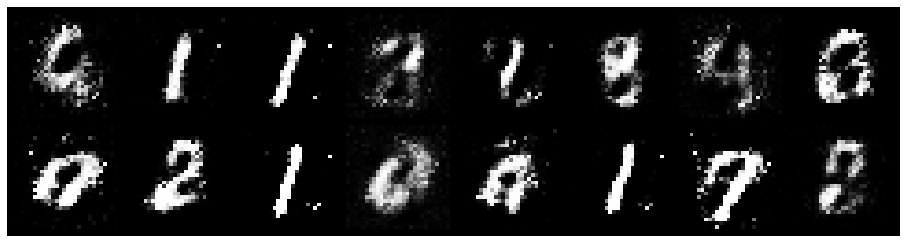

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 1.2374, Generator Loss: 1.6613
D(x): 0.5951, D(G(z)): 0.2925


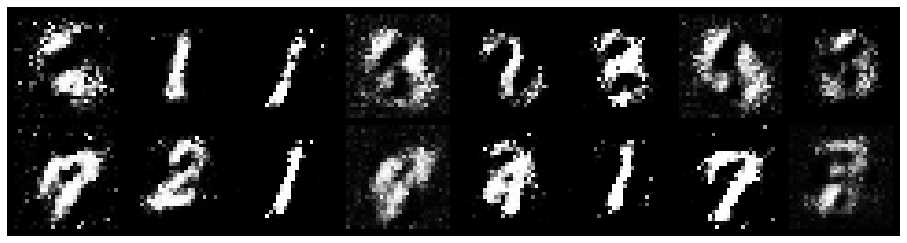

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.6334, Generator Loss: 1.8408
D(x): 0.7613, D(G(z)): 0.2015


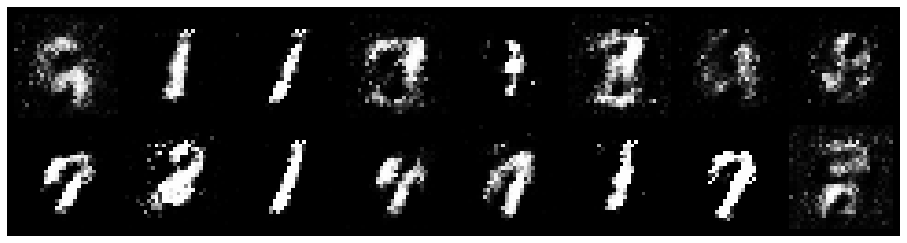

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.8246, Generator Loss: 1.6290
D(x): 0.6877, D(G(z)): 0.2290


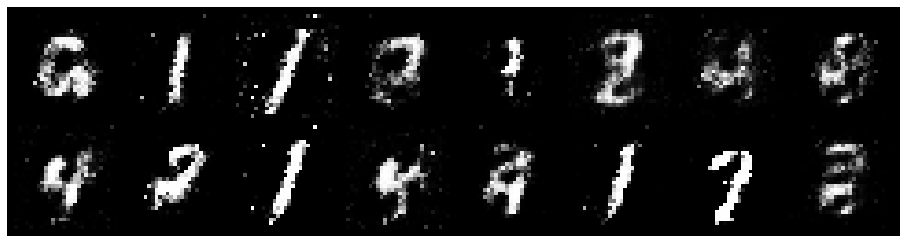

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.9588, Generator Loss: 1.3588
D(x): 0.7657, D(G(z)): 0.3658


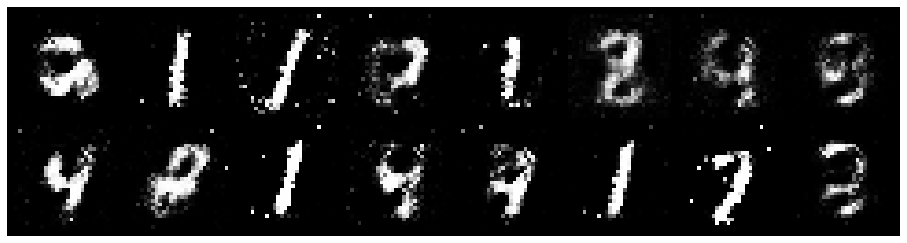

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.4673, Generator Loss: 1.8309
D(x): 0.8478, D(G(z)): 0.2024


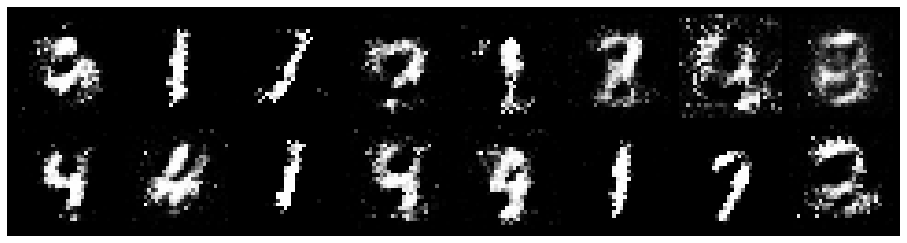

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.8415, Generator Loss: 1.5729
D(x): 0.7256, D(G(z)): 0.2613


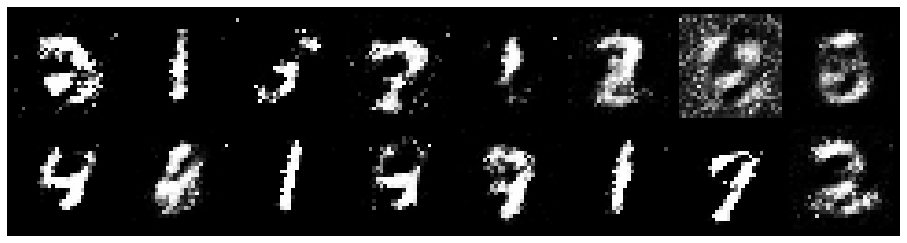

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 1.0725, Generator Loss: 1.8322
D(x): 0.6982, D(G(z)): 0.3127


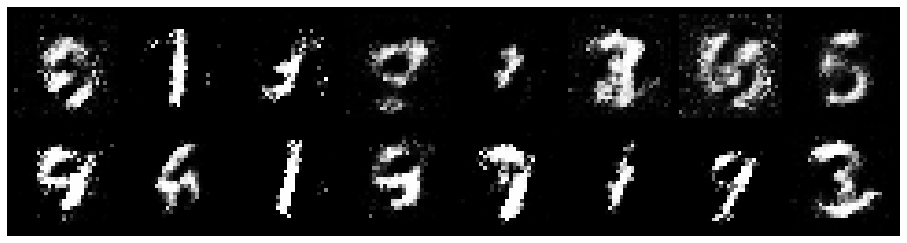

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 1.2025, Generator Loss: 1.8514
D(x): 0.6984, D(G(z)): 0.3848


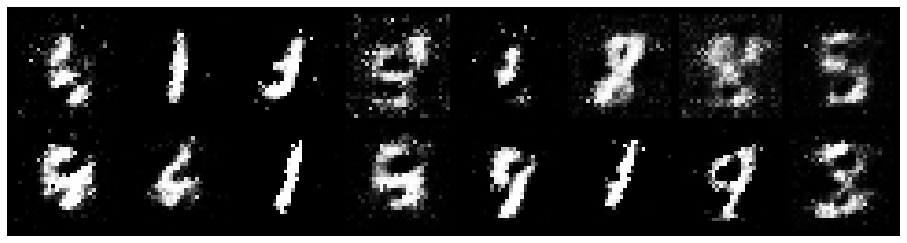

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.8109, Generator Loss: 1.4197
D(x): 0.7380, D(G(z)): 0.3126


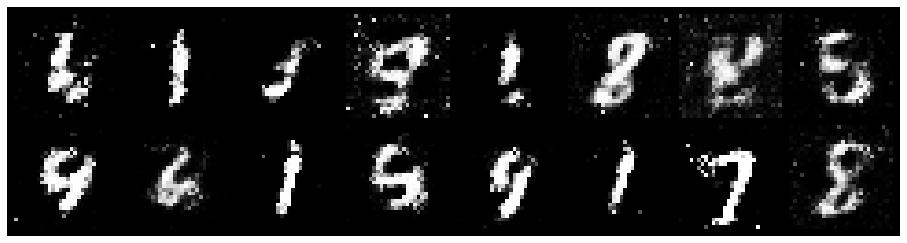

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.8663, Generator Loss: 1.5010
D(x): 0.6843, D(G(z)): 0.2542


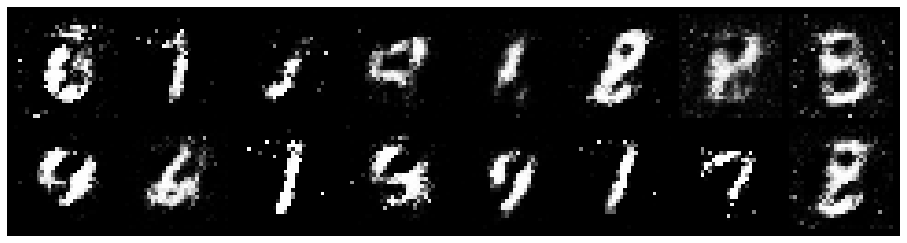

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.6821, Generator Loss: 2.3453
D(x): 0.7844, D(G(z)): 0.2390


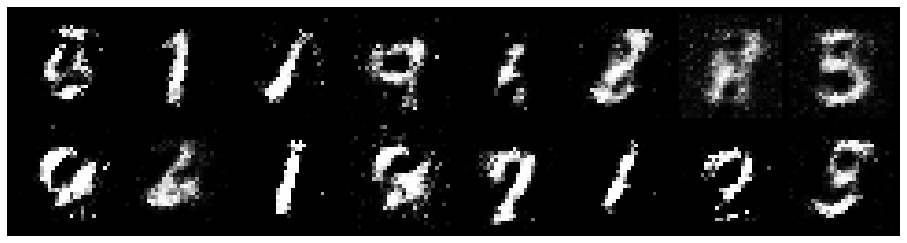

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.7103, Generator Loss: 1.7202
D(x): 0.7468, D(G(z)): 0.2330


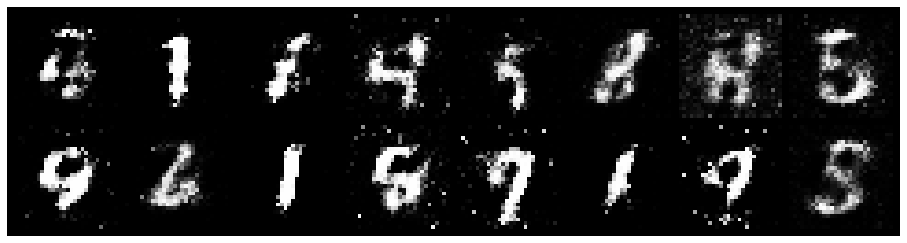

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.9329, Generator Loss: 1.2766
D(x): 0.6999, D(G(z)): 0.3316


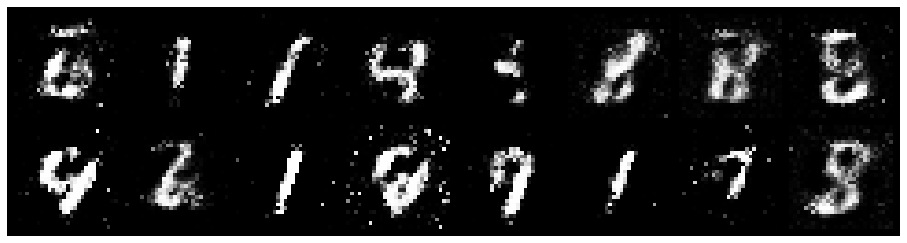

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.6113, Generator Loss: 1.8077
D(x): 0.7744, D(G(z)): 0.2071


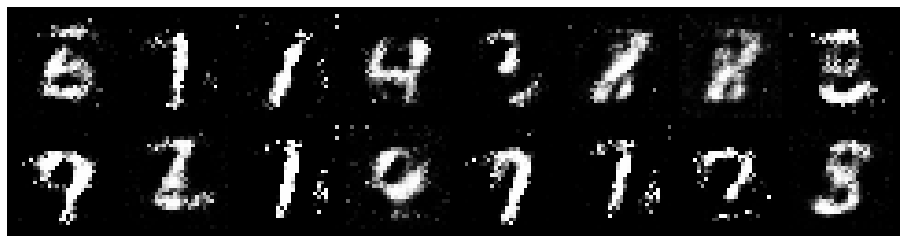

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.6505, Generator Loss: 1.9684
D(x): 0.8028, D(G(z)): 0.2226


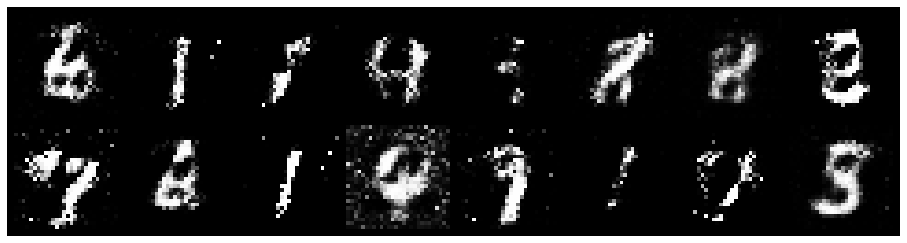

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.7186, Generator Loss: 1.8239
D(x): 0.7347, D(G(z)): 0.2164


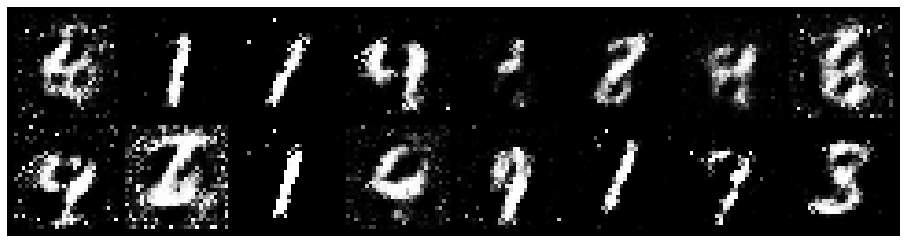

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.7982, Generator Loss: 1.8466
D(x): 0.7150, D(G(z)): 0.2384


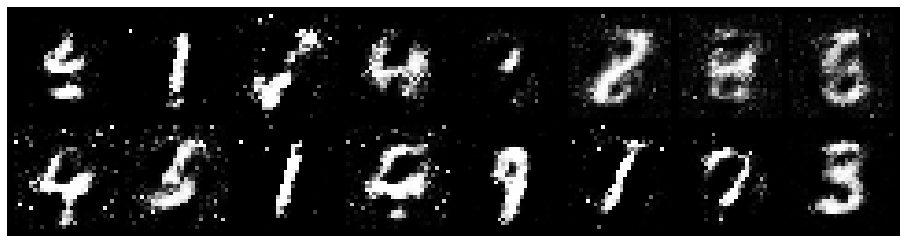

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.8876, Generator Loss: 1.9040
D(x): 0.6977, D(G(z)): 0.2902


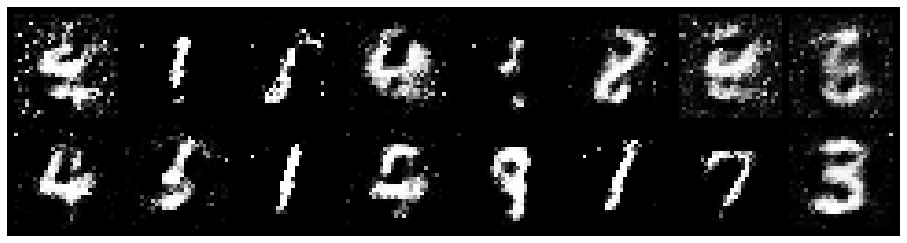

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.7354, Generator Loss: 1.6259
D(x): 0.7316, D(G(z)): 0.2487


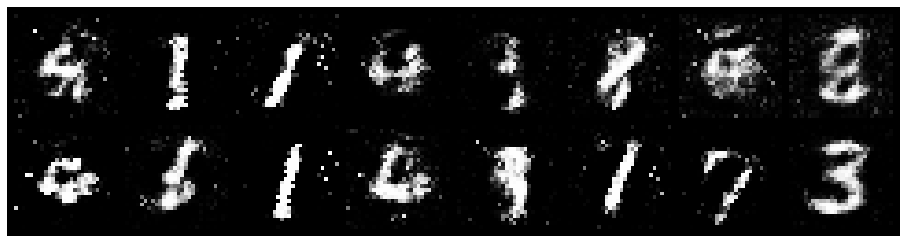

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.8497, Generator Loss: 1.3639
D(x): 0.7105, D(G(z)): 0.2937


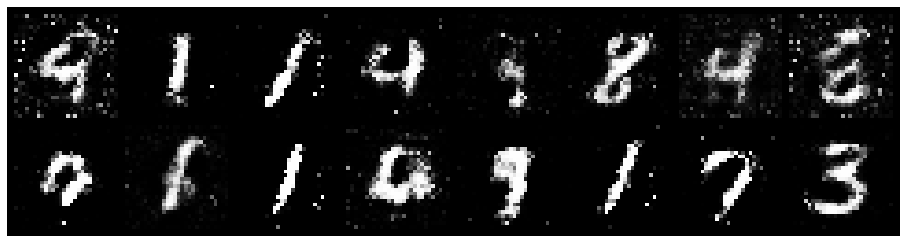

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.8867, Generator Loss: 1.2666
D(x): 0.7209, D(G(z)): 0.3367


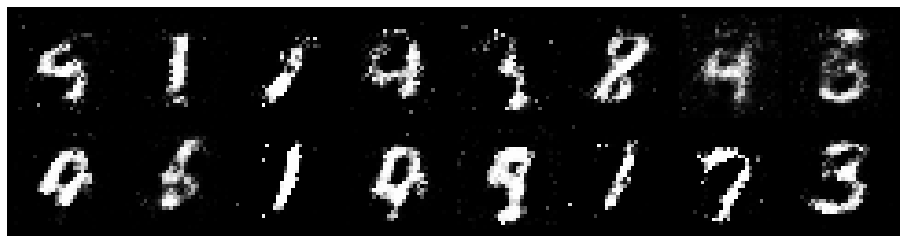

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.8414, Generator Loss: 1.5633
D(x): 0.7461, D(G(z)): 0.3264


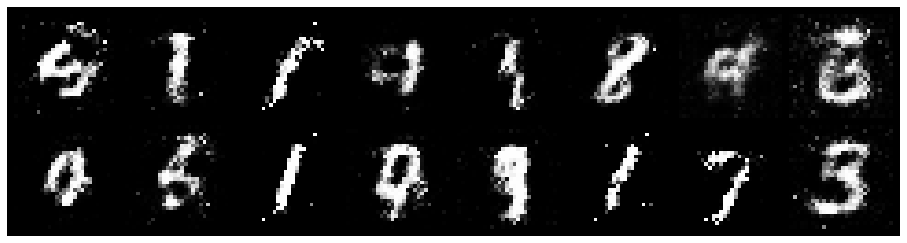

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 1.4428, Generator Loss: 1.1994
D(x): 0.5750, D(G(z)): 0.4174


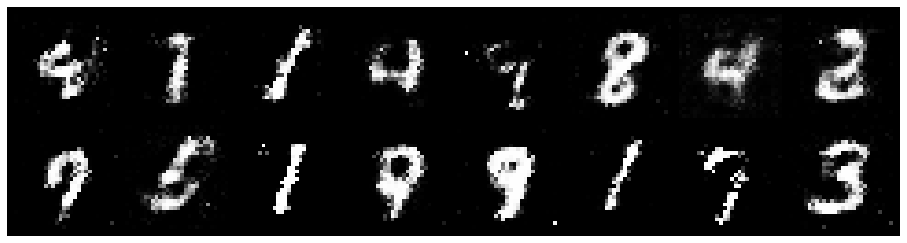

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.8208, Generator Loss: 1.8651
D(x): 0.7067, D(G(z)): 0.2519


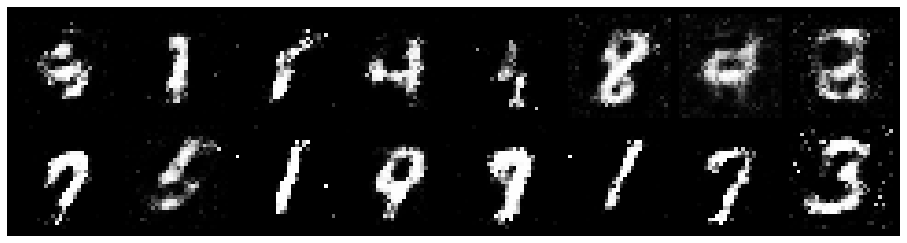

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 1.1238, Generator Loss: 1.3658
D(x): 0.6710, D(G(z)): 0.3660


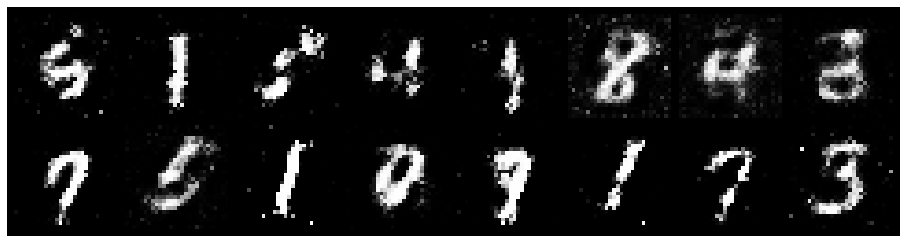

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.8598, Generator Loss: 1.8504
D(x): 0.7404, D(G(z)): 0.2687


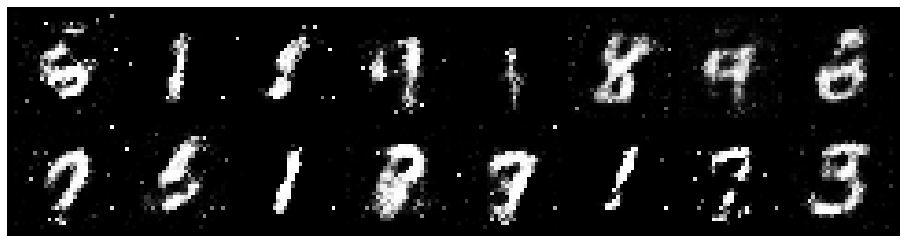

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 1.2674, Generator Loss: 1.1328
D(x): 0.6576, D(G(z)): 0.4217


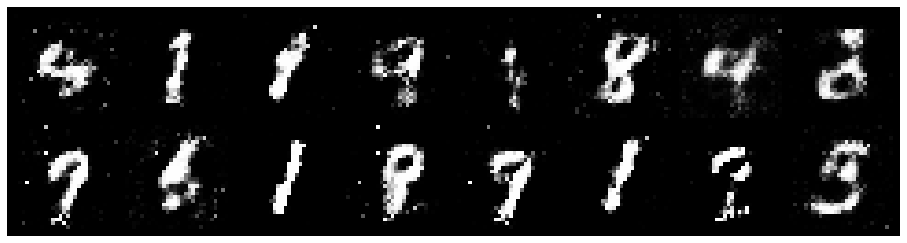

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 1.0570, Generator Loss: 1.5083
D(x): 0.6850, D(G(z)): 0.2950


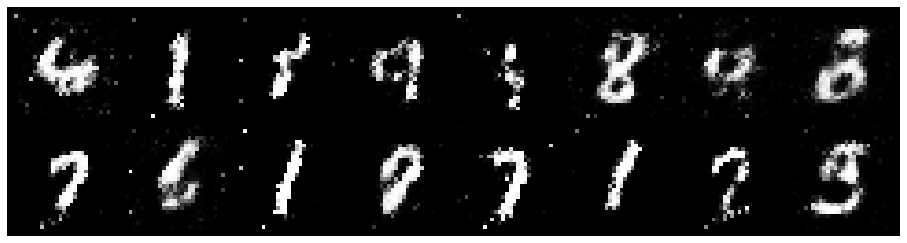

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 1.1400, Generator Loss: 1.4594
D(x): 0.5635, D(G(z)): 0.3016


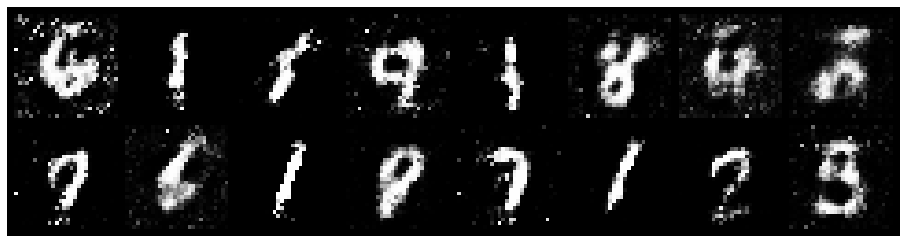

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.8362, Generator Loss: 1.4366
D(x): 0.7334, D(G(z)): 0.3097


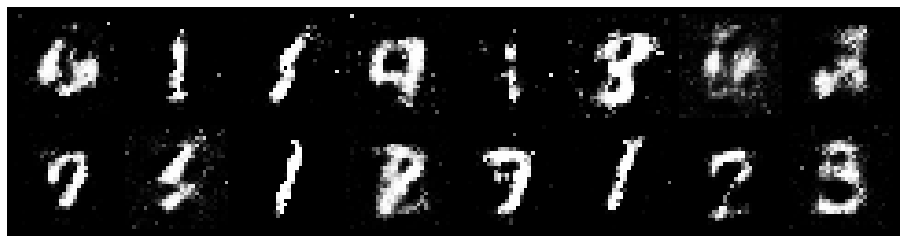

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 0.7993, Generator Loss: 1.6565
D(x): 0.7895, D(G(z)): 0.3130


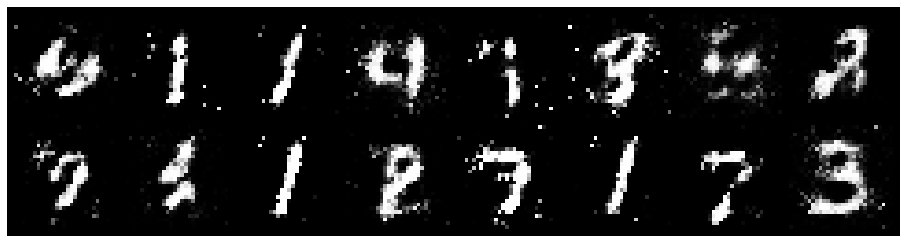

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.8403, Generator Loss: 1.5049
D(x): 0.7465, D(G(z)): 0.3084


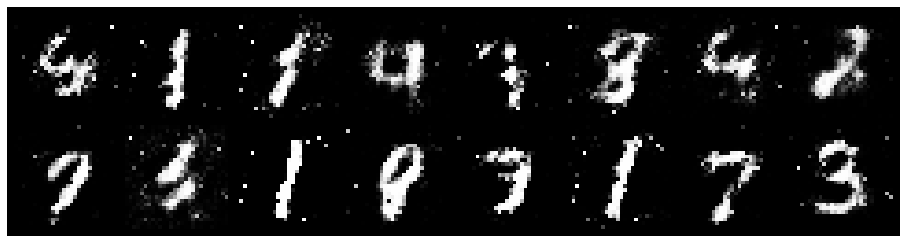

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.8300, Generator Loss: 1.7638
D(x): 0.6520, D(G(z)): 0.1847


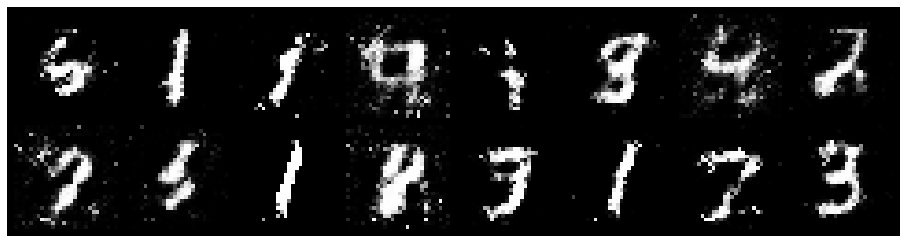

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.8085, Generator Loss: 1.8117
D(x): 0.8020, D(G(z)): 0.3515


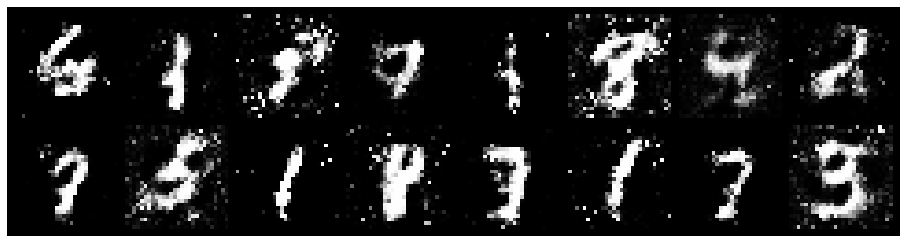

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 1.1556, Generator Loss: 1.6102
D(x): 0.6432, D(G(z)): 0.3178


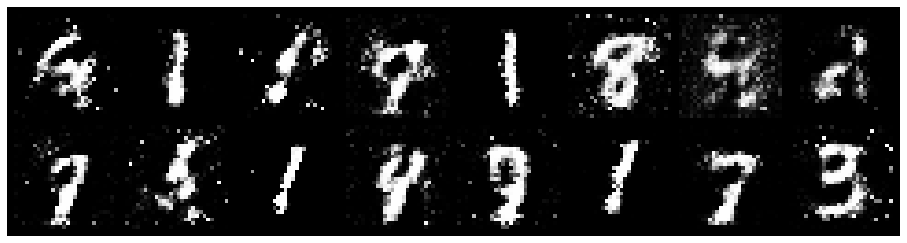

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.9289, Generator Loss: 1.2988
D(x): 0.6632, D(G(z)): 0.2700


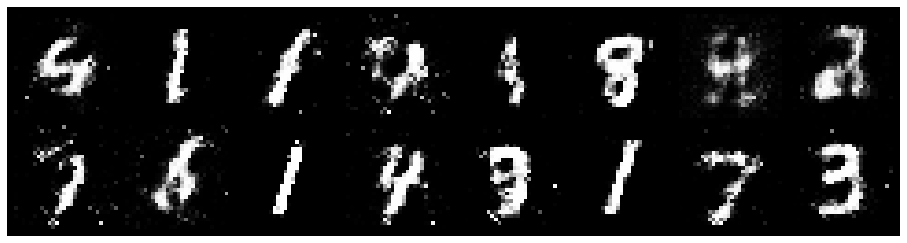

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.8387, Generator Loss: 1.6757
D(x): 0.7337, D(G(z)): 0.2938


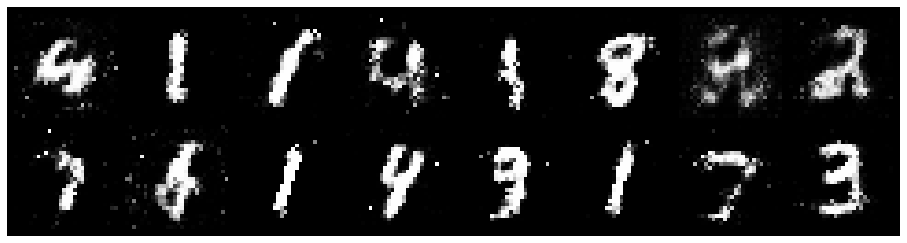

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.7239, Generator Loss: 1.8913
D(x): 0.7714, D(G(z)): 0.2759


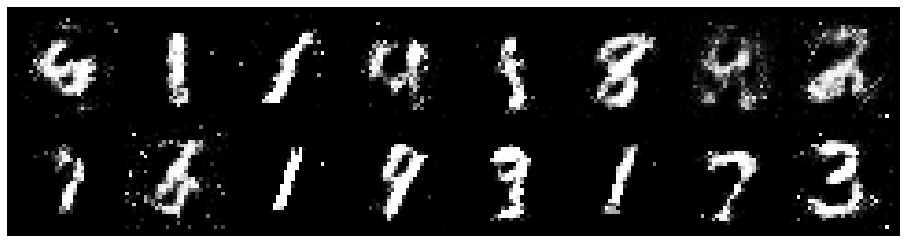

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.7841, Generator Loss: 1.5981
D(x): 0.7293, D(G(z)): 0.2774


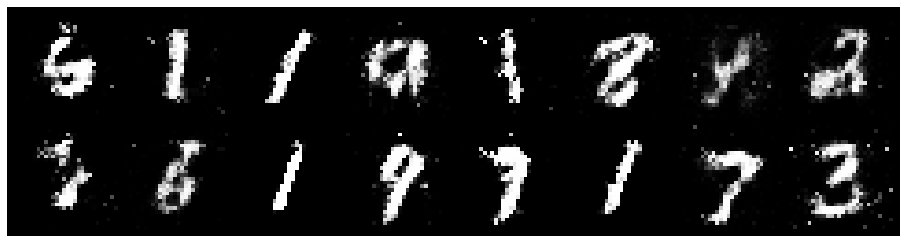

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 1.0503, Generator Loss: 1.3240
D(x): 0.6906, D(G(z)): 0.3515


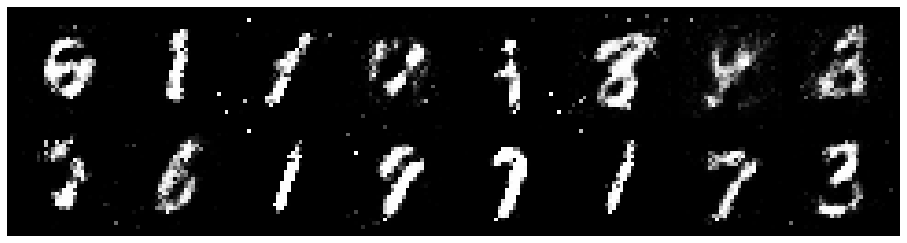

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.8923, Generator Loss: 1.4023
D(x): 0.6706, D(G(z)): 0.3022


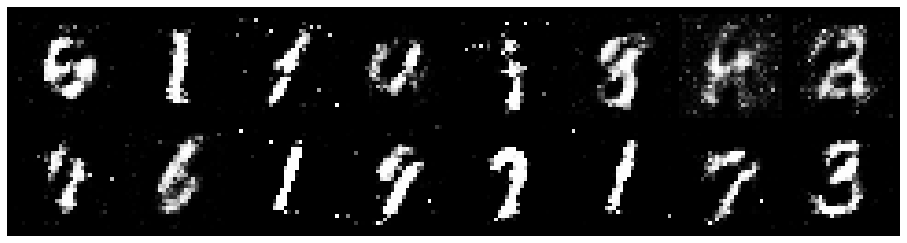

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 0.8590, Generator Loss: 1.7367
D(x): 0.6957, D(G(z)): 0.2604


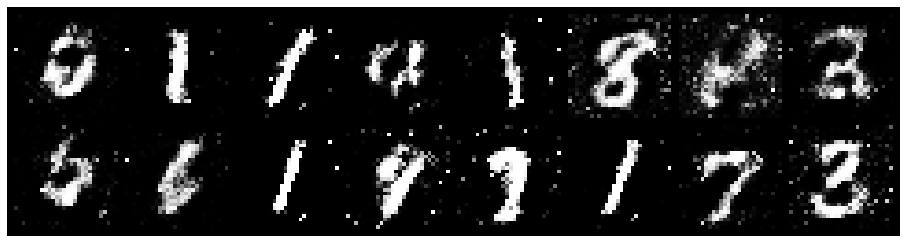

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.8765, Generator Loss: 1.5859
D(x): 0.7194, D(G(z)): 0.2986


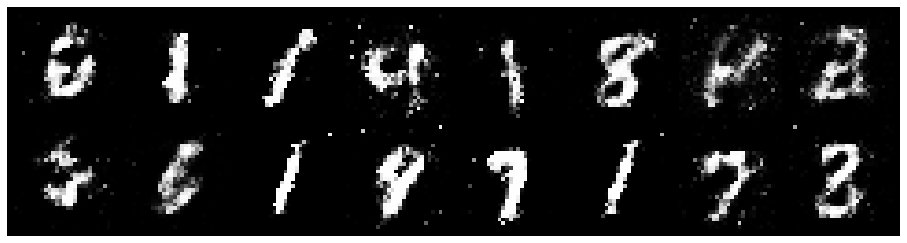

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.9159, Generator Loss: 1.8562
D(x): 0.7792, D(G(z)): 0.3851


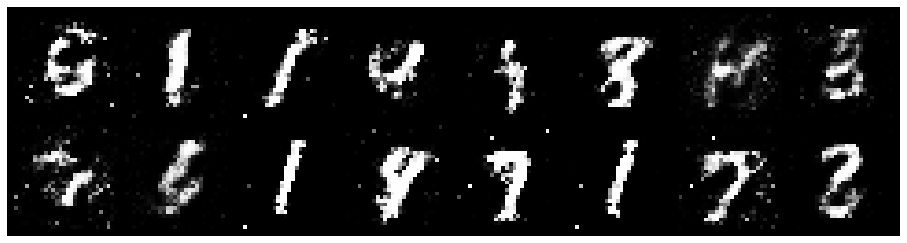

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.9863, Generator Loss: 1.2229
D(x): 0.7063, D(G(z)): 0.3806


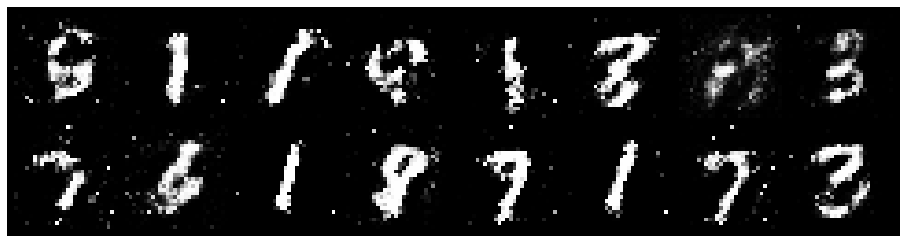

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.9913, Generator Loss: 1.3733
D(x): 0.7066, D(G(z)): 0.3276


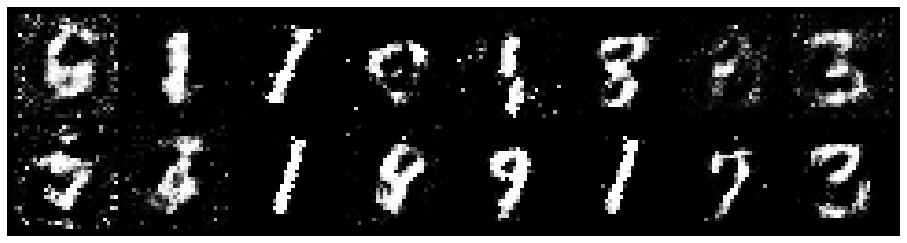

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.9452, Generator Loss: 1.4130
D(x): 0.7066, D(G(z)): 0.3244


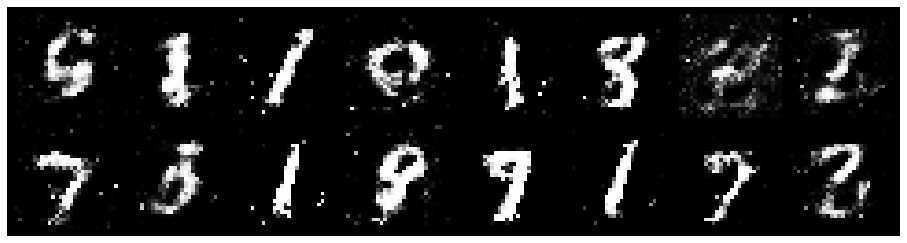

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.9871, Generator Loss: 1.5018
D(x): 0.6663, D(G(z)): 0.3180


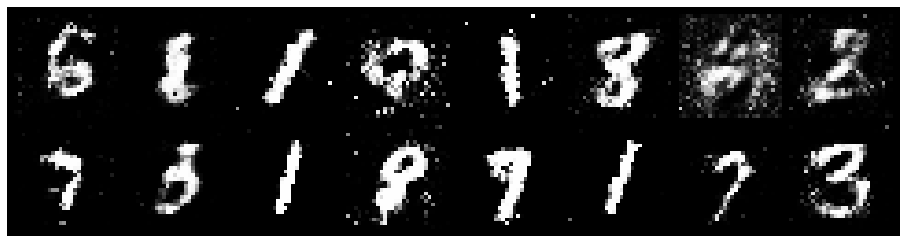

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 0.9433, Generator Loss: 1.1030
D(x): 0.7437, D(G(z)): 0.3423


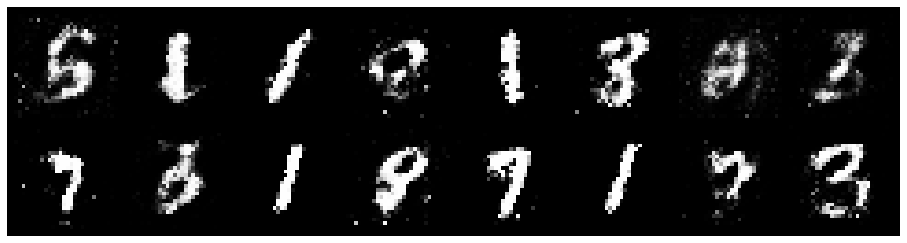

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 0.8735, Generator Loss: 1.4425
D(x): 0.6364, D(G(z)): 0.2143


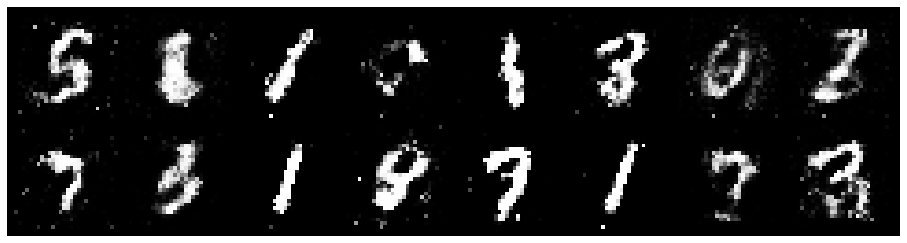

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 1.0648, Generator Loss: 1.4260
D(x): 0.6771, D(G(z)): 0.3590


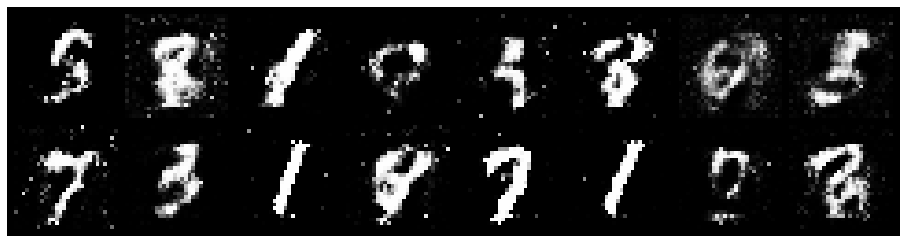

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 1.0549, Generator Loss: 1.3641
D(x): 0.6289, D(G(z)): 0.3108


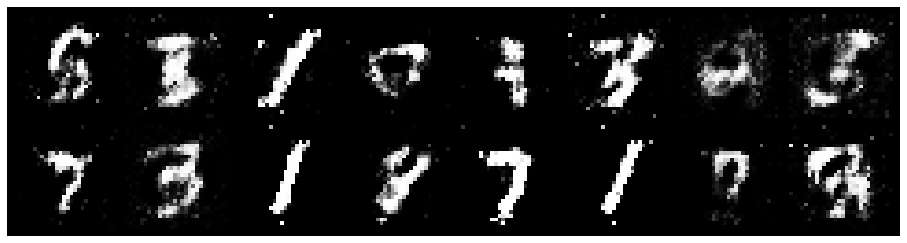

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.9480, Generator Loss: 1.4733
D(x): 0.6751, D(G(z)): 0.2947


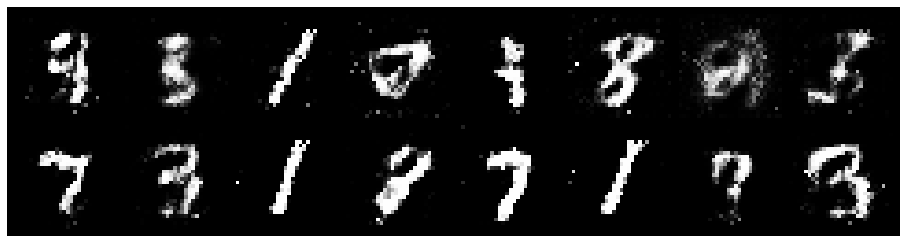

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.7638, Generator Loss: 1.5966
D(x): 0.7879, D(G(z)): 0.2806


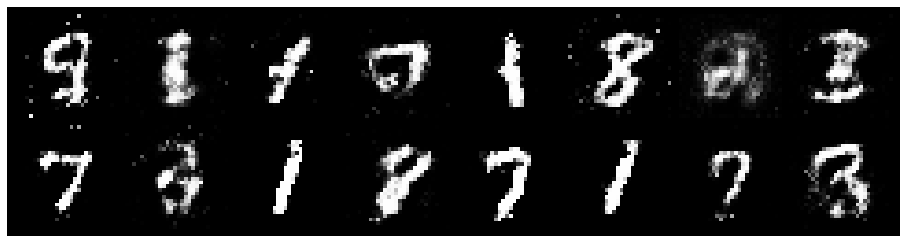

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 1.0424, Generator Loss: 1.8642
D(x): 0.7463, D(G(z)): 0.3873


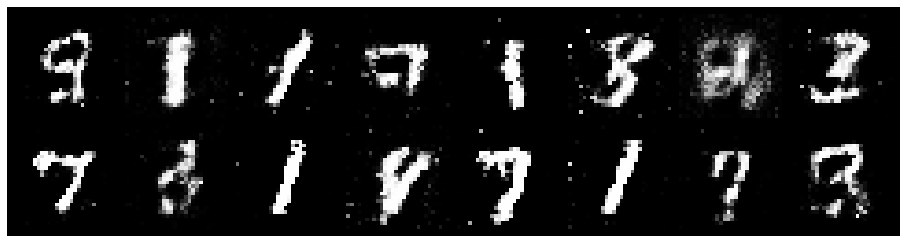

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 0.9880, Generator Loss: 1.5391
D(x): 0.7561, D(G(z)): 0.3794


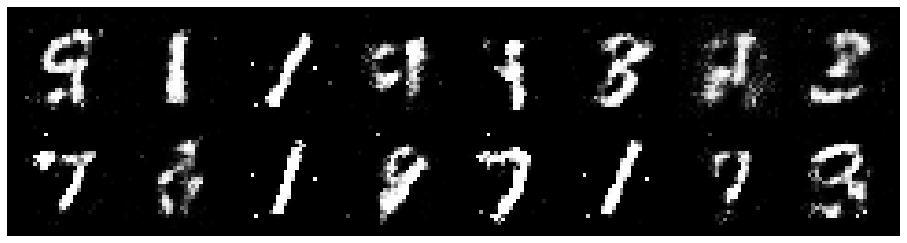

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.8981, Generator Loss: 1.9063
D(x): 0.7129, D(G(z)): 0.2794


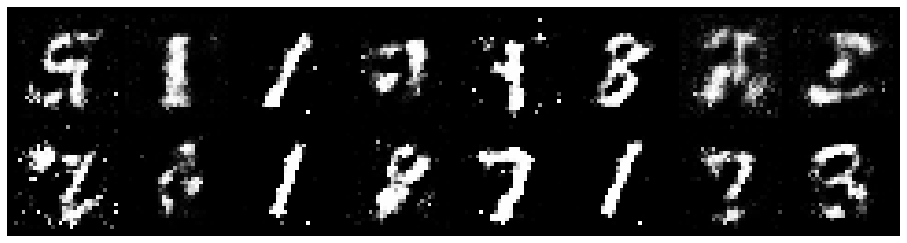

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.7931, Generator Loss: 1.6937
D(x): 0.7461, D(G(z)): 0.2787


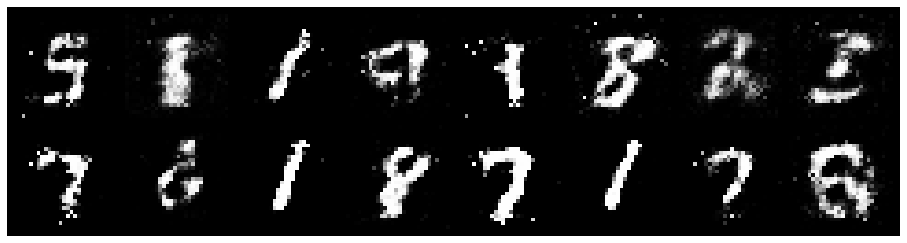

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.9362, Generator Loss: 1.8295
D(x): 0.7100, D(G(z)): 0.3012


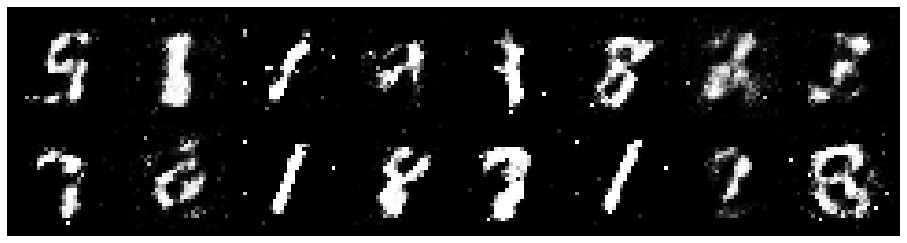

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 1.0192, Generator Loss: 1.4837
D(x): 0.6764, D(G(z)): 0.3369


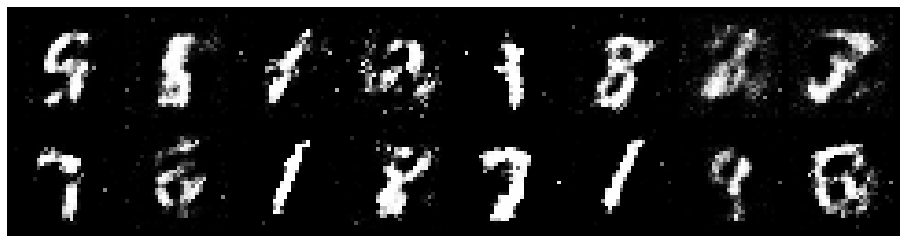

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 1.1823, Generator Loss: 1.1594
D(x): 0.6916, D(G(z)): 0.4335


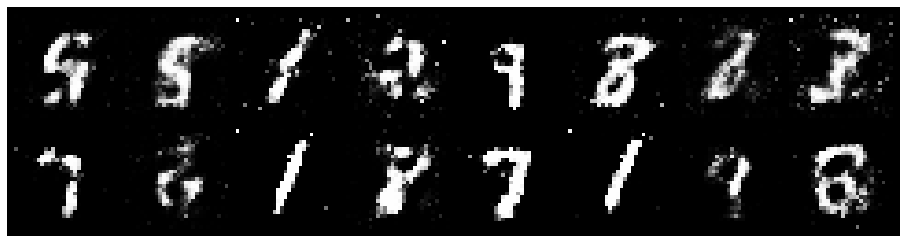

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 1.2236, Generator Loss: 1.1002
D(x): 0.6175, D(G(z)): 0.3807


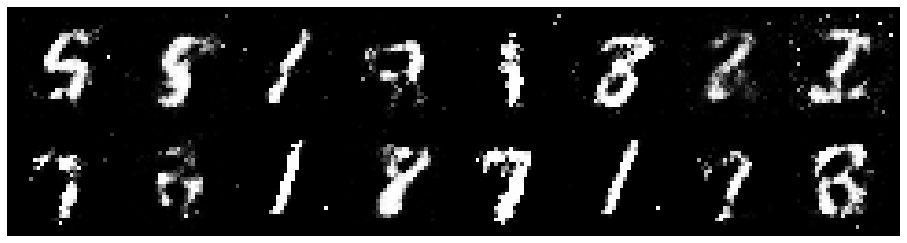

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 0.8421, Generator Loss: 1.4811
D(x): 0.7835, D(G(z)): 0.3528


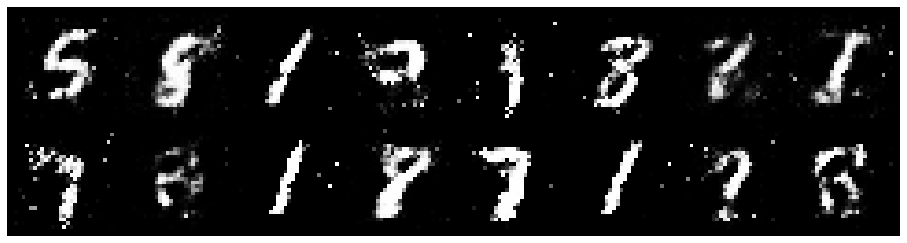

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 0.9758, Generator Loss: 1.2920
D(x): 0.6607, D(G(z)): 0.3388


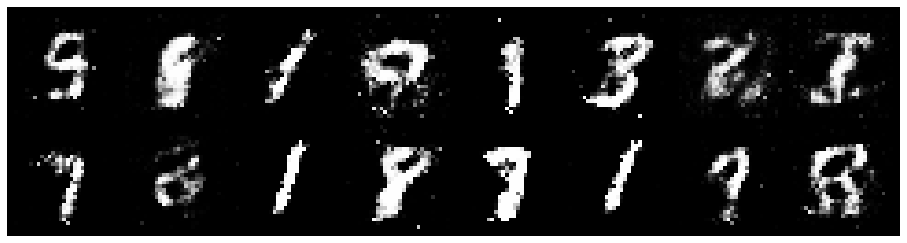

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 0.8393, Generator Loss: 1.5059
D(x): 0.6940, D(G(z)): 0.2393


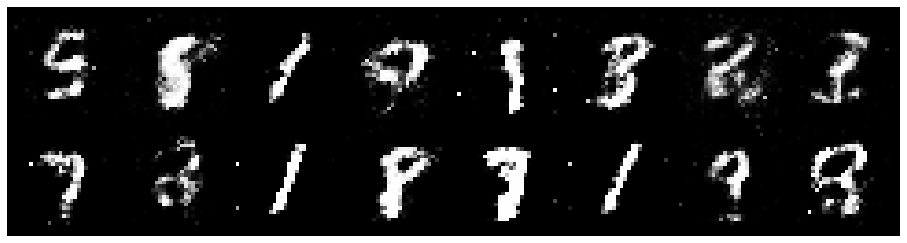

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.7421, Generator Loss: 2.1073
D(x): 0.7698, D(G(z)): 0.2583


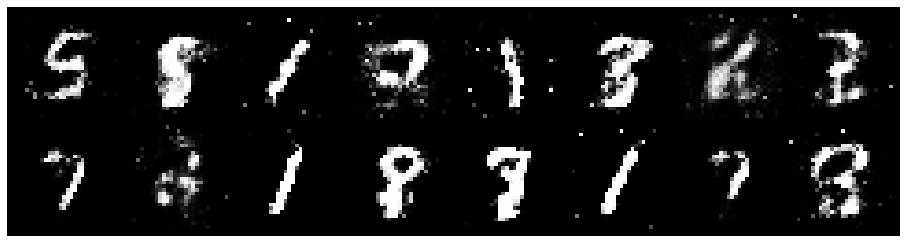

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 1.0265, Generator Loss: 1.5573
D(x): 0.6572, D(G(z)): 0.3011


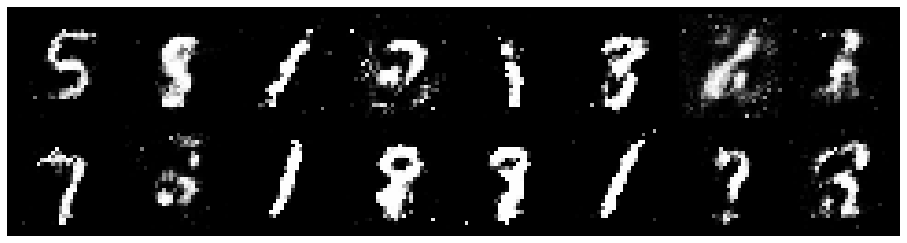

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 1.1239, Generator Loss: 1.0624
D(x): 0.6840, D(G(z)): 0.4236


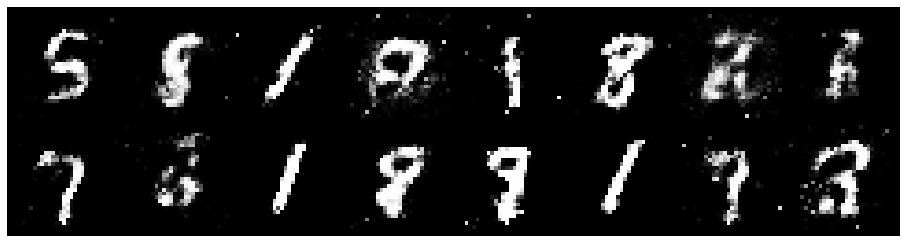

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 1.0302, Generator Loss: 1.3862
D(x): 0.6650, D(G(z)): 0.3342


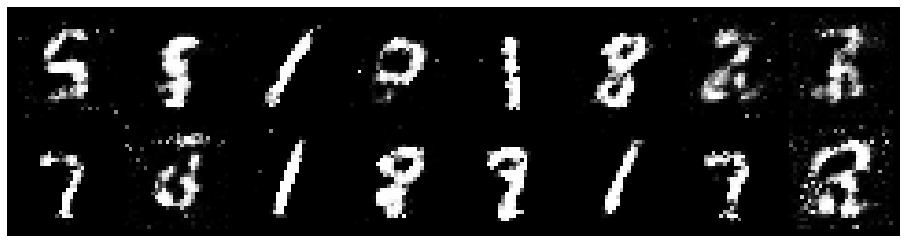

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.9119, Generator Loss: 1.1989
D(x): 0.6739, D(G(z)): 0.3057


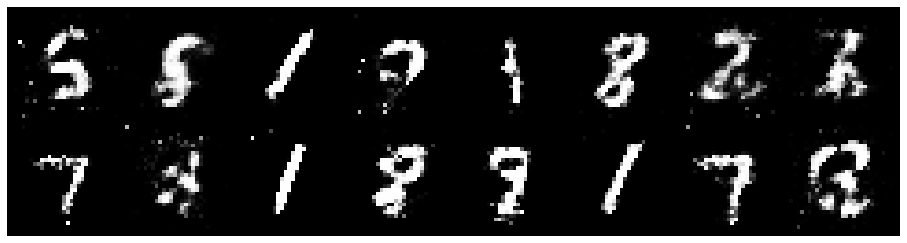

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 0.9863, Generator Loss: 1.3762
D(x): 0.6368, D(G(z)): 0.2706


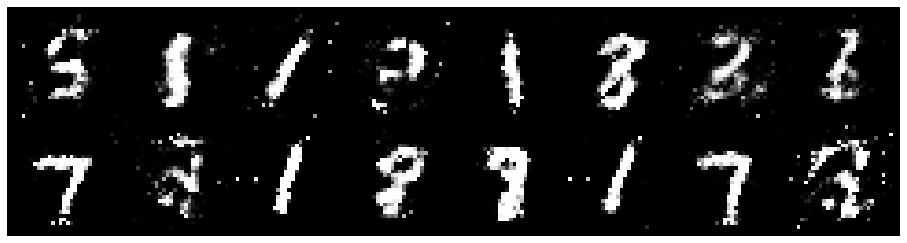

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.9992, Generator Loss: 1.3599
D(x): 0.6405, D(G(z)): 0.3111


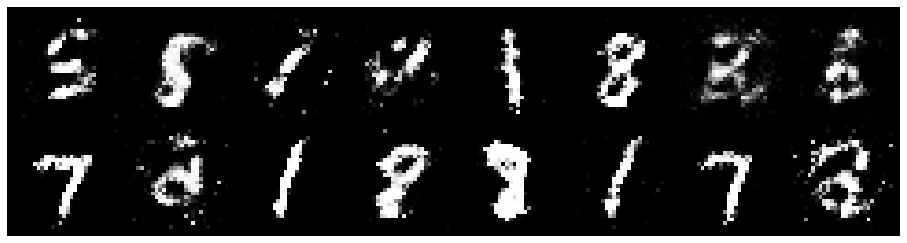

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 1.2032, Generator Loss: 1.0794
D(x): 0.6263, D(G(z)): 0.4198


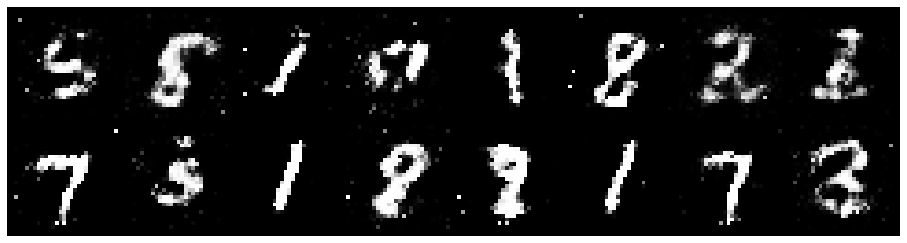

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 1.1237, Generator Loss: 1.1345
D(x): 0.6437, D(G(z)): 0.3892


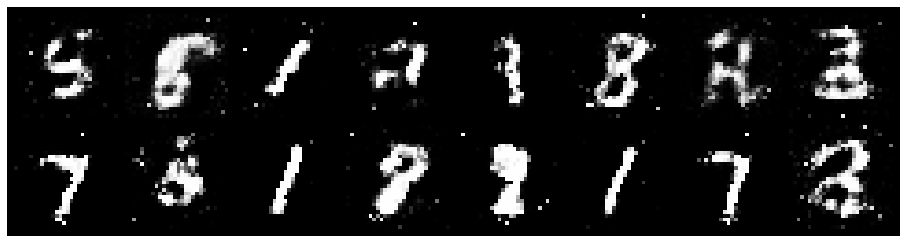

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.0450, Generator Loss: 1.2391
D(x): 0.6685, D(G(z)): 0.3776


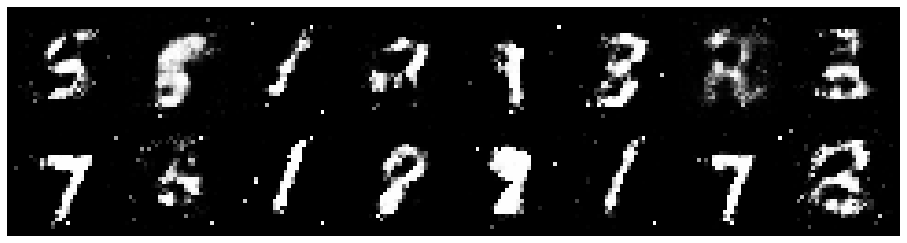

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 0.9334, Generator Loss: 1.4872
D(x): 0.6597, D(G(z)): 0.3106


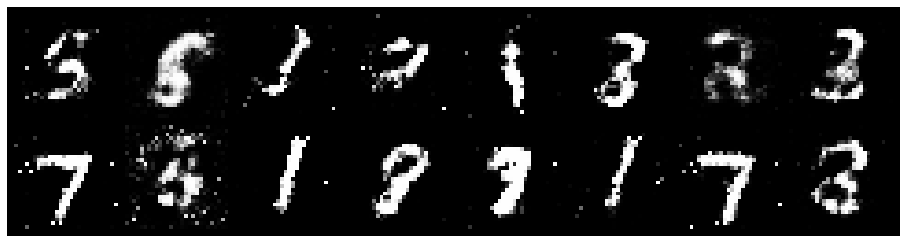

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 1.0873, Generator Loss: 1.4460
D(x): 0.6816, D(G(z)): 0.3945


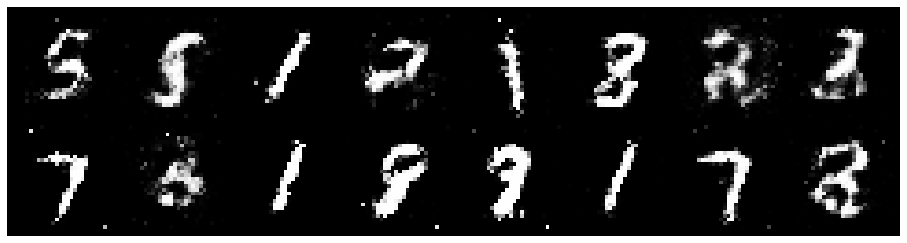

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 1.0254, Generator Loss: 1.6314
D(x): 0.6730, D(G(z)): 0.3353


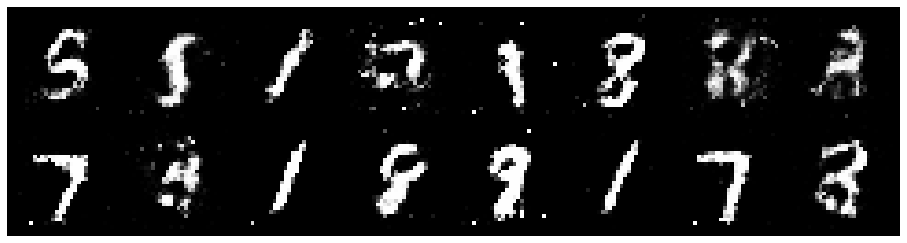

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.8356, Generator Loss: 1.5354
D(x): 0.6987, D(G(z)): 0.3022


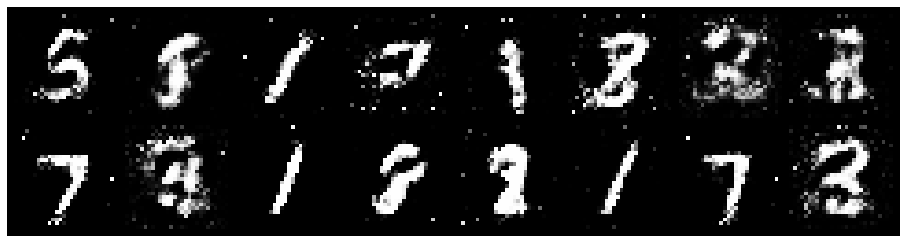

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 1.0153, Generator Loss: 1.3003
D(x): 0.6726, D(G(z)): 0.3593


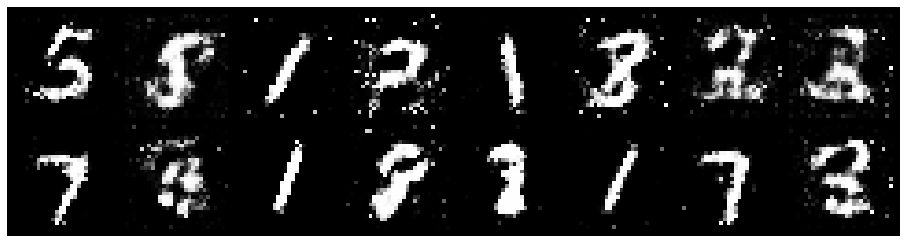

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 1.2798, Generator Loss: 1.3383
D(x): 0.5681, D(G(z)): 0.3495


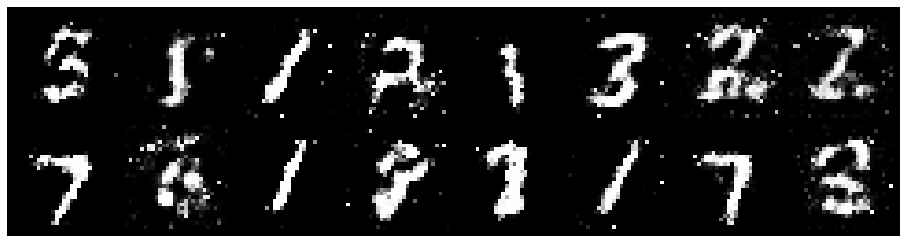

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 1.1861, Generator Loss: 1.2652
D(x): 0.6193, D(G(z)): 0.3953


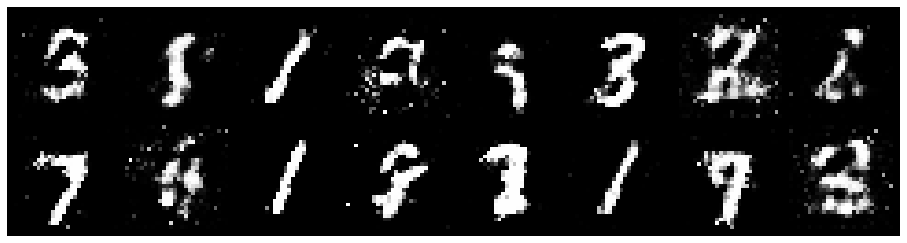

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 1.0372, Generator Loss: 1.2154
D(x): 0.6442, D(G(z)): 0.3612


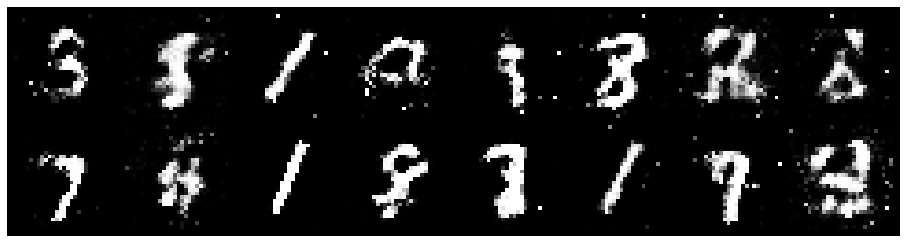

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 0.9802, Generator Loss: 1.2304
D(x): 0.6413, D(G(z)): 0.3467


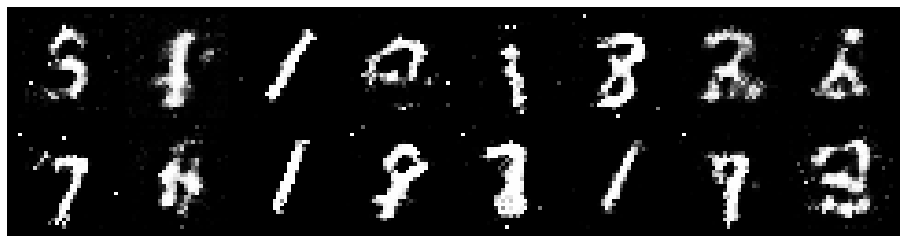

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 0.9673, Generator Loss: 1.6997
D(x): 0.6383, D(G(z)): 0.2844


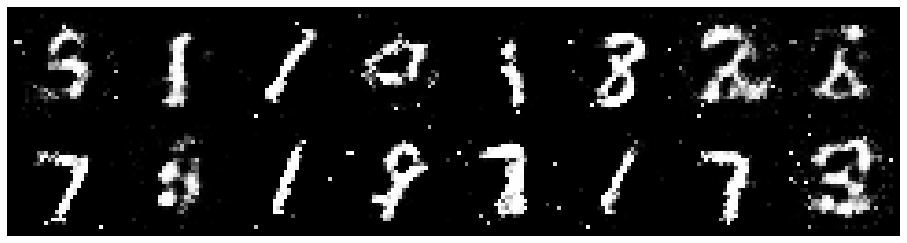

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 0.9654, Generator Loss: 1.6133
D(x): 0.6533, D(G(z)): 0.2854


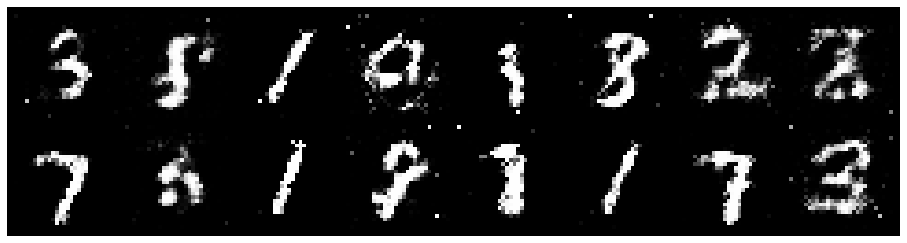

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 1.1177, Generator Loss: 1.0660
D(x): 0.6555, D(G(z)): 0.3804


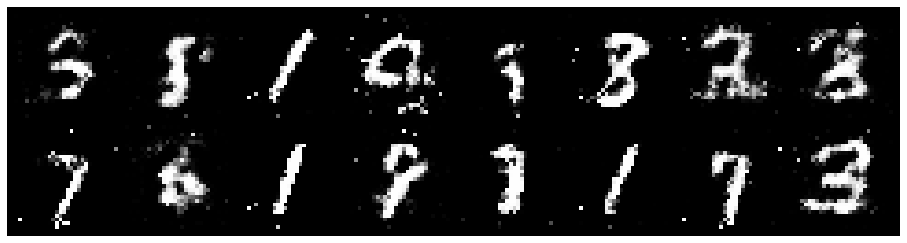

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 1.0354, Generator Loss: 1.1454
D(x): 0.6614, D(G(z)): 0.3670


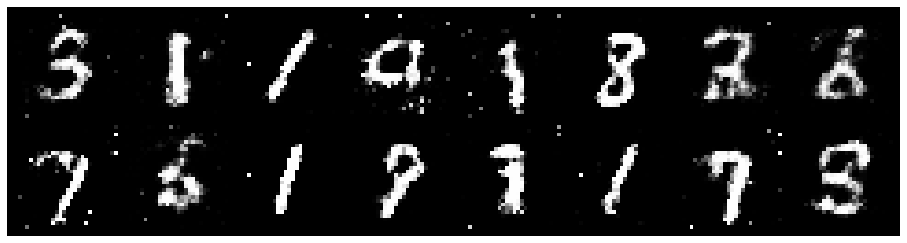

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.9446, Generator Loss: 1.8117
D(x): 0.6609, D(G(z)): 0.2844


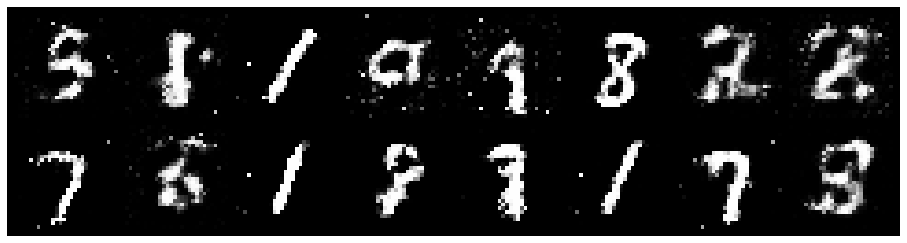

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 1.1062, Generator Loss: 1.4455
D(x): 0.6856, D(G(z)): 0.3550


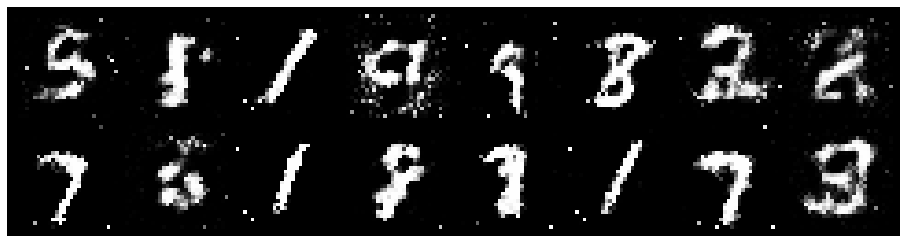

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 0.8683, Generator Loss: 1.5097
D(x): 0.6554, D(G(z)): 0.2593


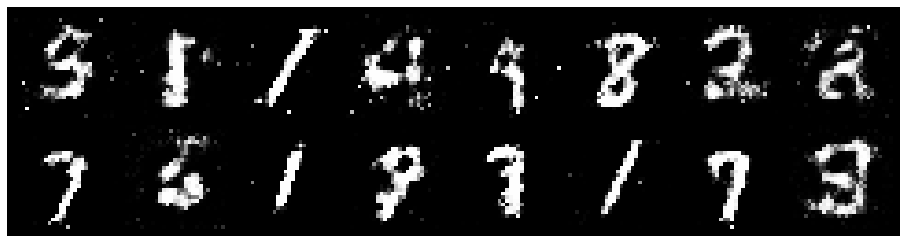

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 1.0356, Generator Loss: 1.2925
D(x): 0.6795, D(G(z)): 0.3667


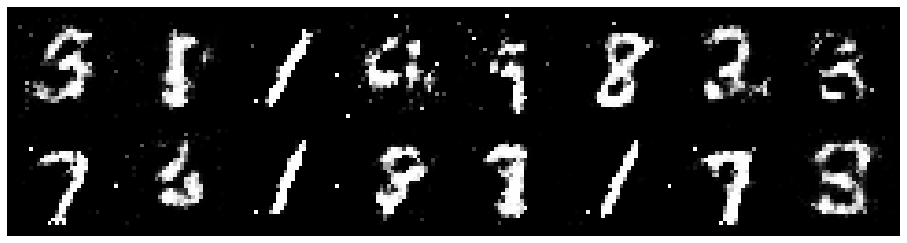

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 1.0589, Generator Loss: 1.2323
D(x): 0.7031, D(G(z)): 0.4067


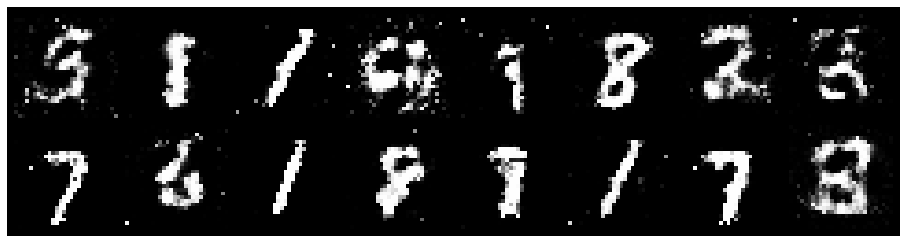

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 1.0054, Generator Loss: 1.3614
D(x): 0.6860, D(G(z)): 0.3685


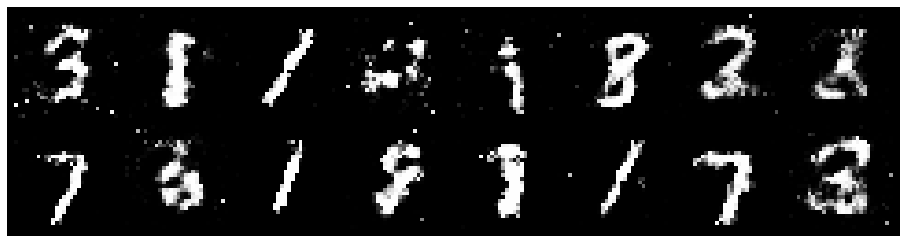

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 1.1669, Generator Loss: 1.4552
D(x): 0.5651, D(G(z)): 0.3032


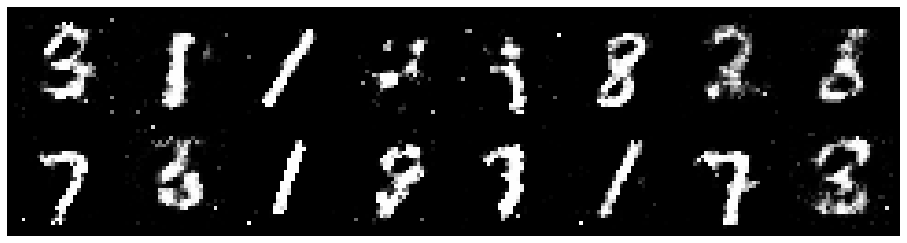

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 1.1215, Generator Loss: 1.1192
D(x): 0.6505, D(G(z)): 0.3708


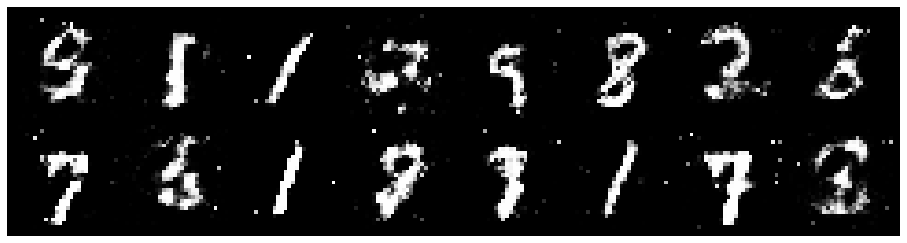

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.1584, Generator Loss: 1.5168
D(x): 0.5436, D(G(z)): 0.2441


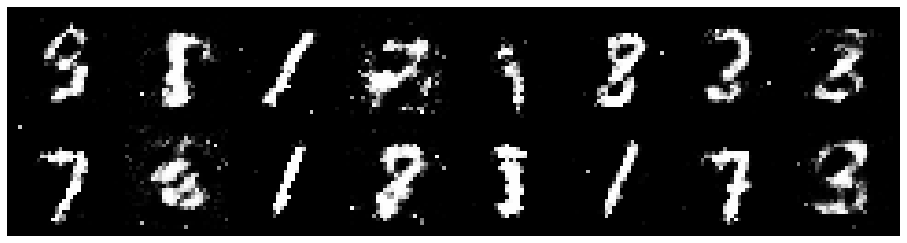

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 0.9676, Generator Loss: 1.2738
D(x): 0.6810, D(G(z)): 0.3215


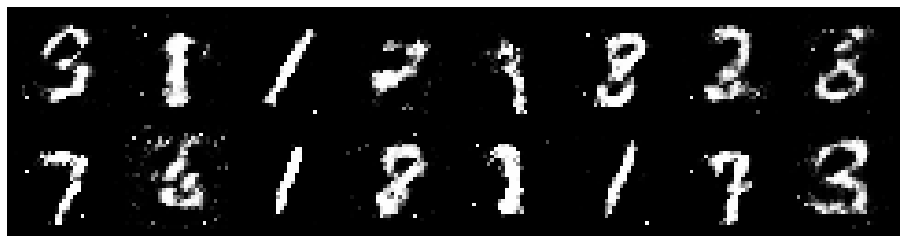

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 1.1431, Generator Loss: 1.5409
D(x): 0.6480, D(G(z)): 0.3513


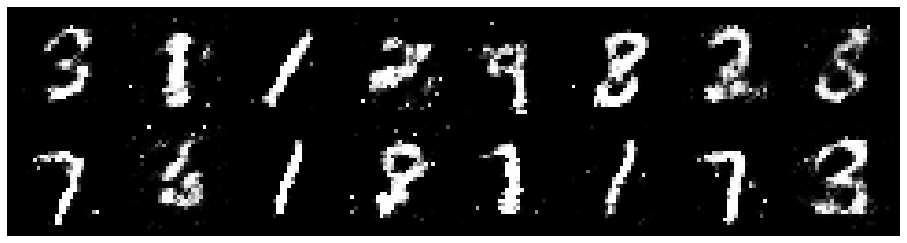

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 1.0799, Generator Loss: 1.0977
D(x): 0.6517, D(G(z)): 0.4054


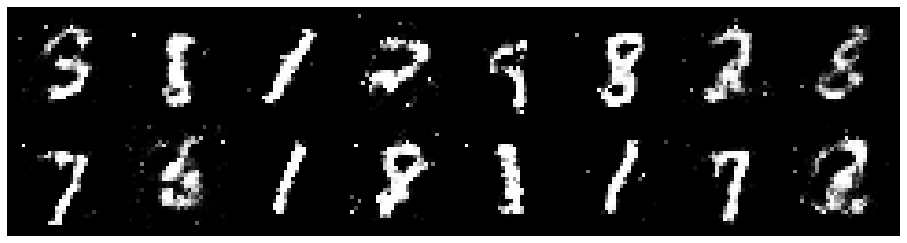

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 1.0052, Generator Loss: 1.0941
D(x): 0.6758, D(G(z)): 0.3715


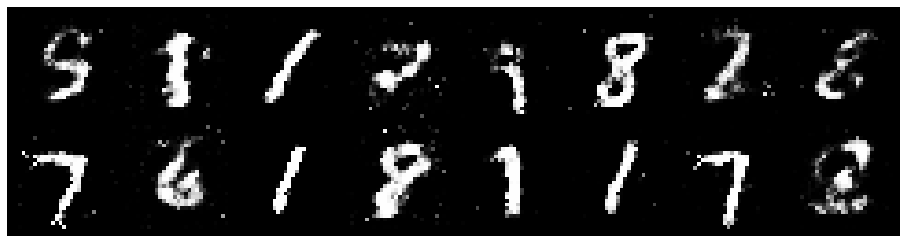

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 1.0054, Generator Loss: 1.6362
D(x): 0.6127, D(G(z)): 0.2726


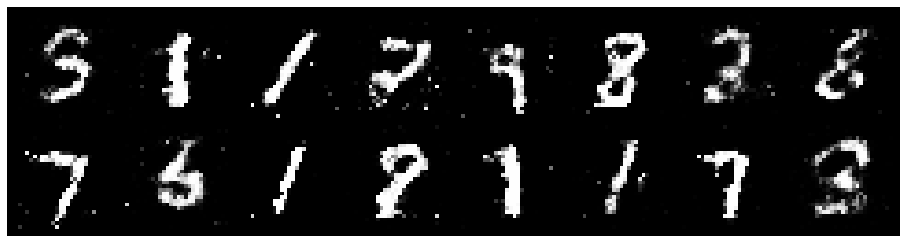

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 1.0795, Generator Loss: 1.1584
D(x): 0.6795, D(G(z)): 0.4016


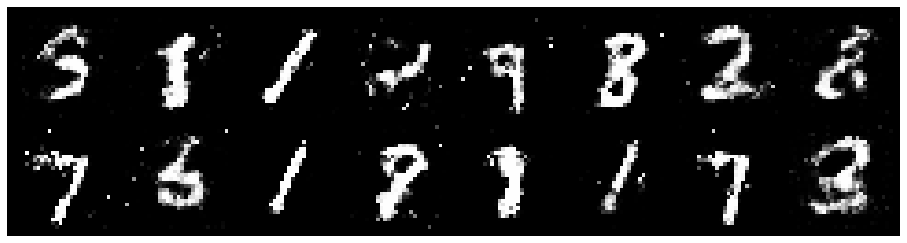

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 1.3098, Generator Loss: 1.3023
D(x): 0.5662, D(G(z)): 0.3821


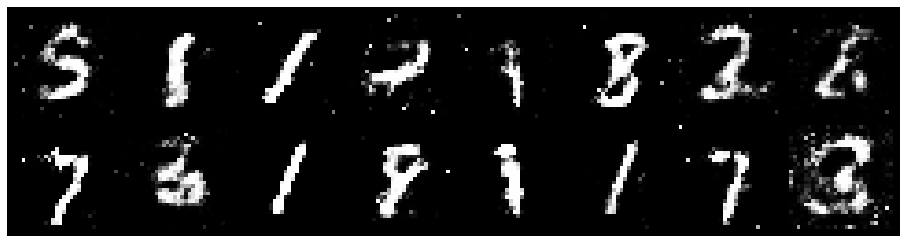

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 1.1060, Generator Loss: 1.4001
D(x): 0.6425, D(G(z)): 0.3395


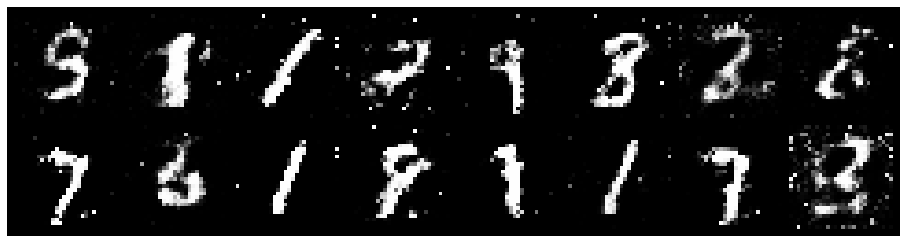

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 1.2362, Generator Loss: 1.2156
D(x): 0.6614, D(G(z)): 0.3767


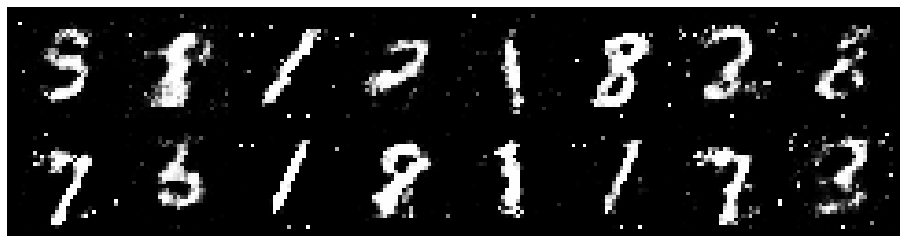

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 1.1067, Generator Loss: 1.0020
D(x): 0.6369, D(G(z)): 0.3967


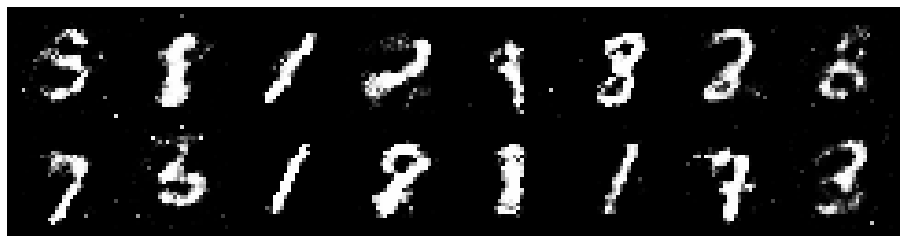

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.0485, Generator Loss: 1.3943
D(x): 0.6675, D(G(z)): 0.3394


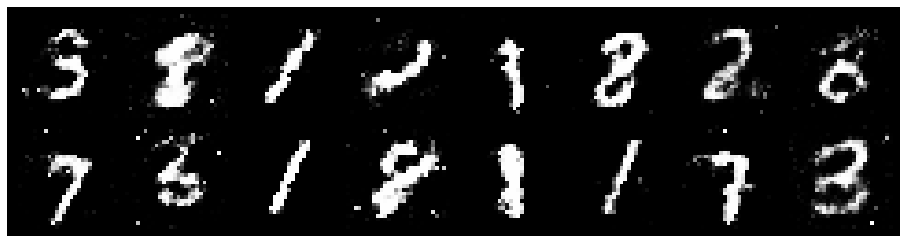

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 0.9301, Generator Loss: 1.4839
D(x): 0.7232, D(G(z)): 0.3429


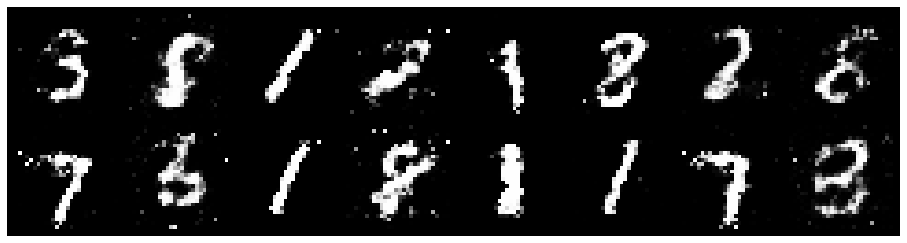

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.0212, Generator Loss: 1.2587
D(x): 0.6508, D(G(z)): 0.3341


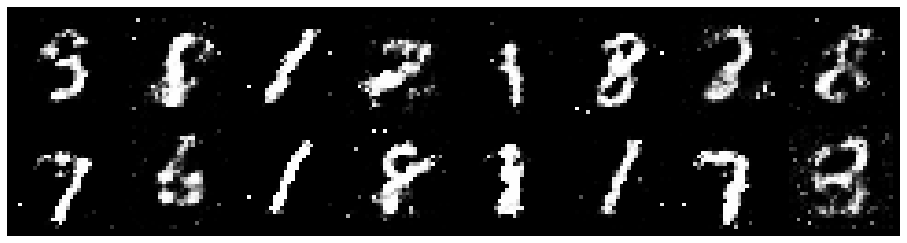

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.1604, Generator Loss: 1.0457
D(x): 0.5809, D(G(z)): 0.3254


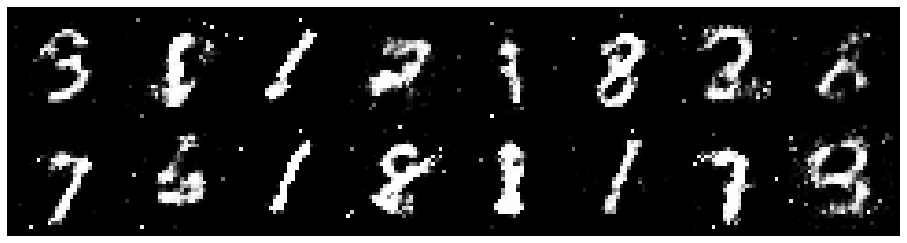

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.1426, Generator Loss: 1.0864
D(x): 0.6451, D(G(z)): 0.4471


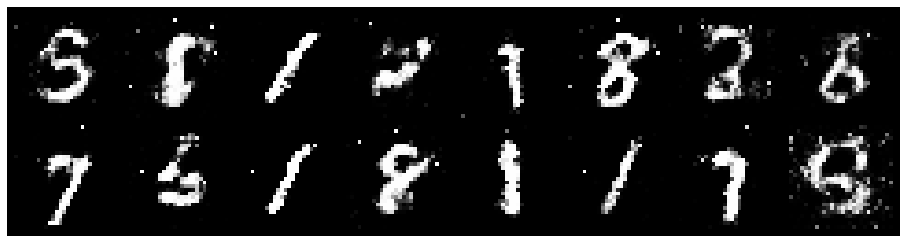

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 0.9616, Generator Loss: 1.2651
D(x): 0.6574, D(G(z)): 0.3245


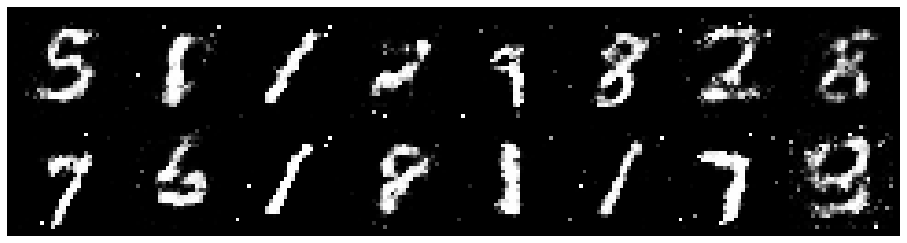

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 1.1236, Generator Loss: 1.2347
D(x): 0.5803, D(G(z)): 0.3702


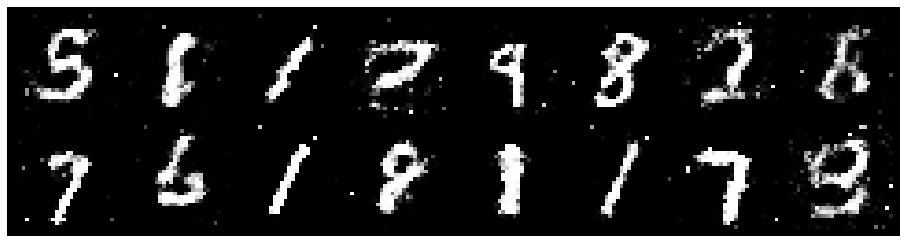

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 1.0012, Generator Loss: 1.6361
D(x): 0.6520, D(G(z)): 0.3315


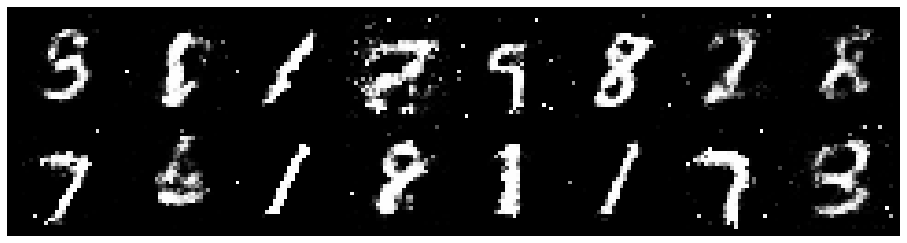

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 1.0209, Generator Loss: 1.0779
D(x): 0.7162, D(G(z)): 0.4009


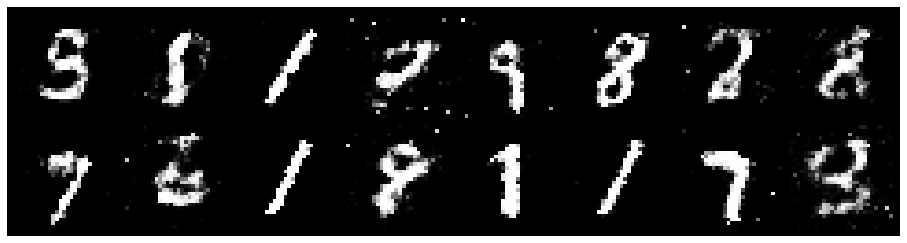

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 1.2201, Generator Loss: 1.2874
D(x): 0.6323, D(G(z)): 0.4095


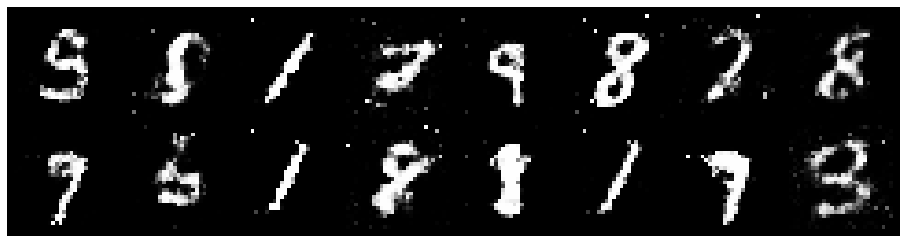

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.0839, Generator Loss: 1.1703
D(x): 0.6065, D(G(z)): 0.3230


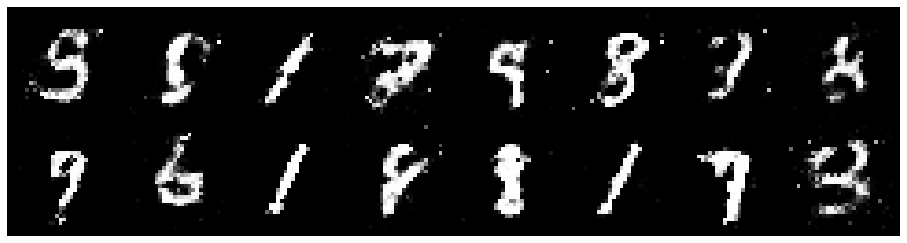

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 0.9905, Generator Loss: 1.1309
D(x): 0.6260, D(G(z)): 0.3245


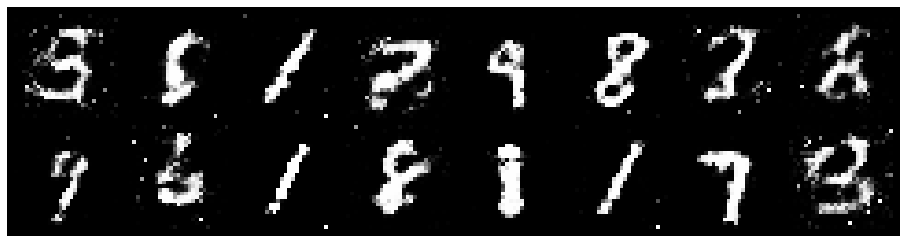

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 0.9767, Generator Loss: 1.0971
D(x): 0.6797, D(G(z)): 0.3665


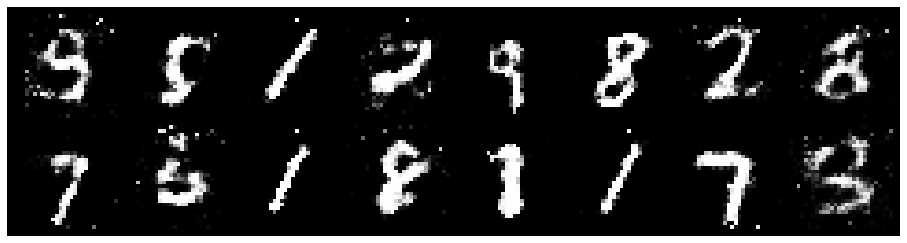

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.1382, Generator Loss: 1.3831
D(x): 0.6827, D(G(z)): 0.4168


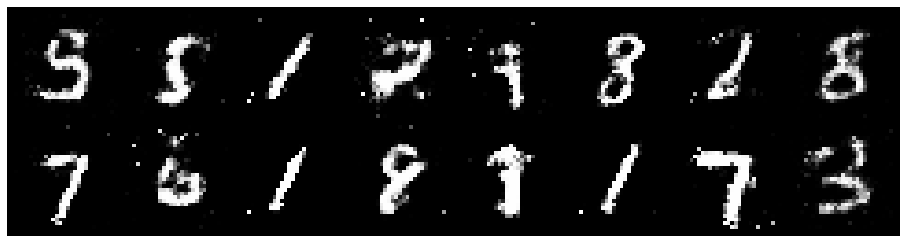

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 0.9708, Generator Loss: 1.3660
D(x): 0.6204, D(G(z)): 0.2985


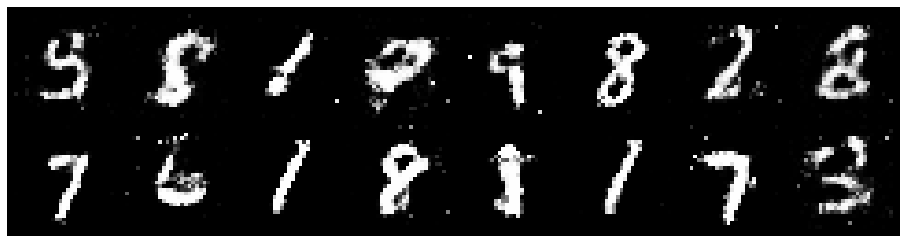

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.2846, Generator Loss: 0.7904
D(x): 0.6351, D(G(z)): 0.4575


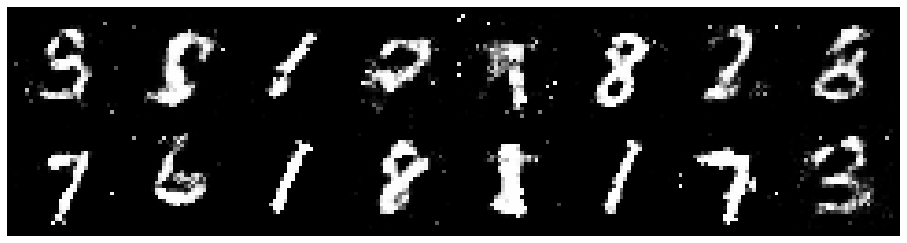

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.0709, Generator Loss: 1.1926
D(x): 0.6595, D(G(z)): 0.3944


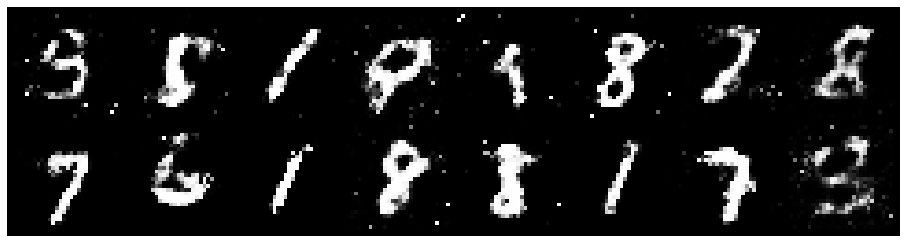

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 0.8840, Generator Loss: 1.3177
D(x): 0.7254, D(G(z)): 0.3482


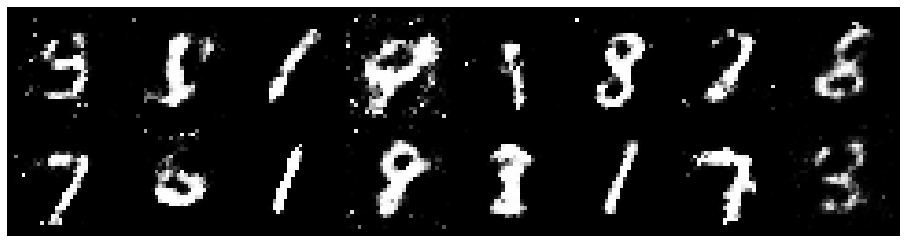

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 1.0347, Generator Loss: 1.2446
D(x): 0.6996, D(G(z)): 0.3727


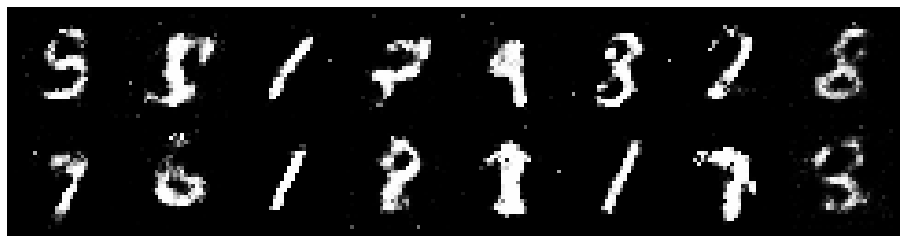

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.2230, Generator Loss: 1.0306
D(x): 0.5479, D(G(z)): 0.3715


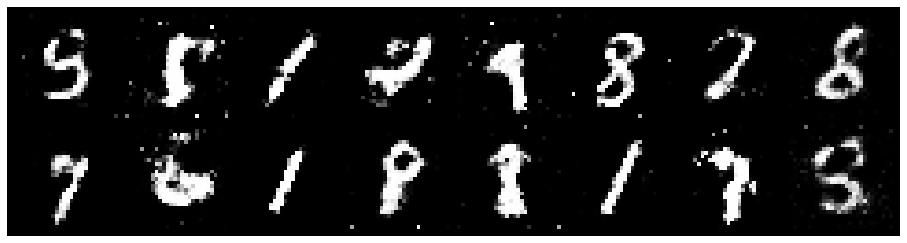

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 1.2089, Generator Loss: 1.1633
D(x): 0.6048, D(G(z)): 0.3994


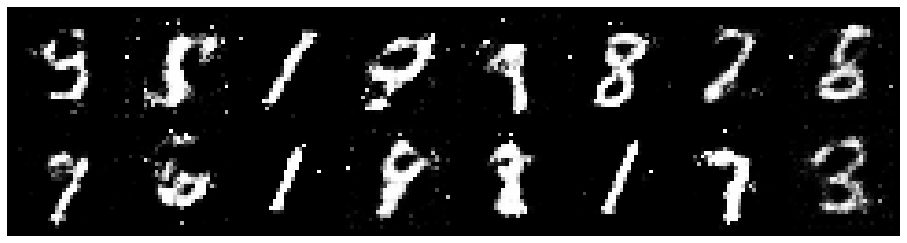

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.2354, Generator Loss: 1.2207
D(x): 0.5473, D(G(z)): 0.3628


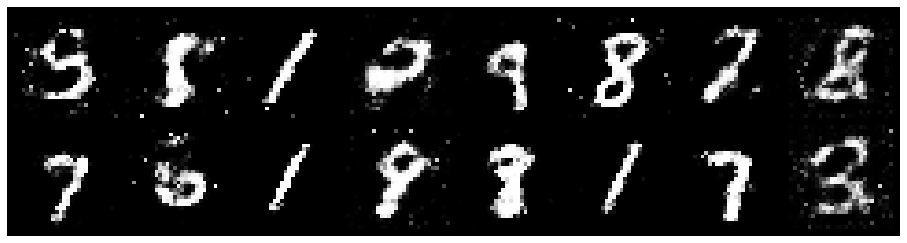

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.1109, Generator Loss: 1.3332
D(x): 0.6412, D(G(z)): 0.3798


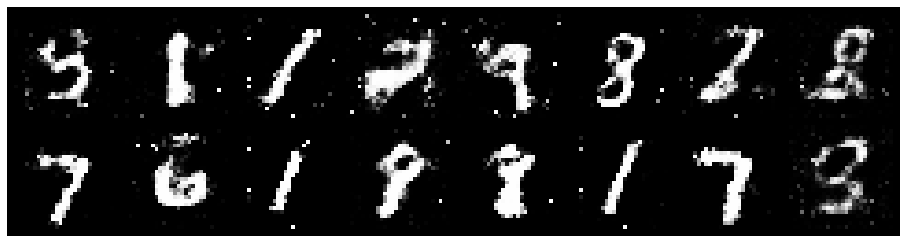

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.0128, Generator Loss: 1.7180
D(x): 0.6606, D(G(z)): 0.3095


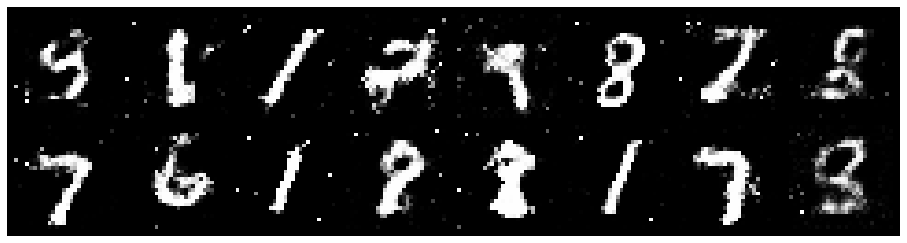

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.1912, Generator Loss: 1.4387
D(x): 0.5880, D(G(z)): 0.3567


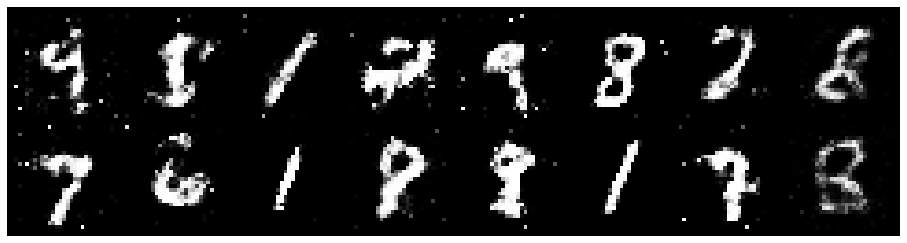

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.1739, Generator Loss: 1.3578
D(x): 0.6782, D(G(z)): 0.4290


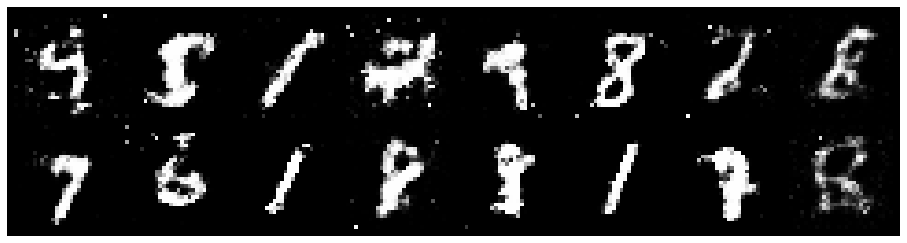

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 1.1270, Generator Loss: 1.2404
D(x): 0.6150, D(G(z)): 0.3283


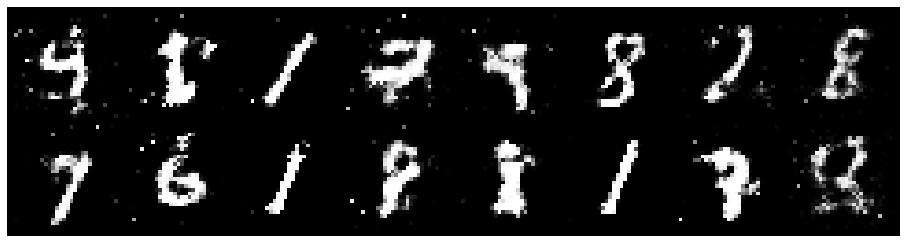

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.1075, Generator Loss: 1.1114
D(x): 0.6831, D(G(z)): 0.3809


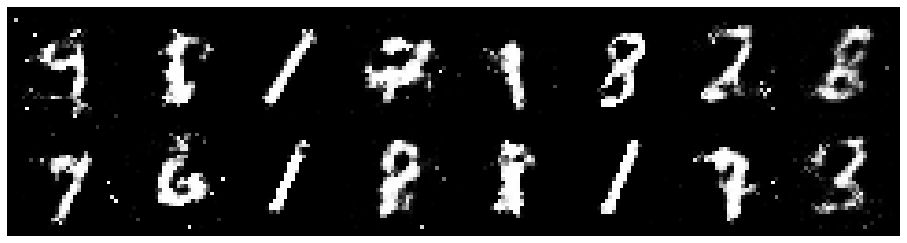

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.1139, Generator Loss: 1.3790
D(x): 0.5991, D(G(z)): 0.3239


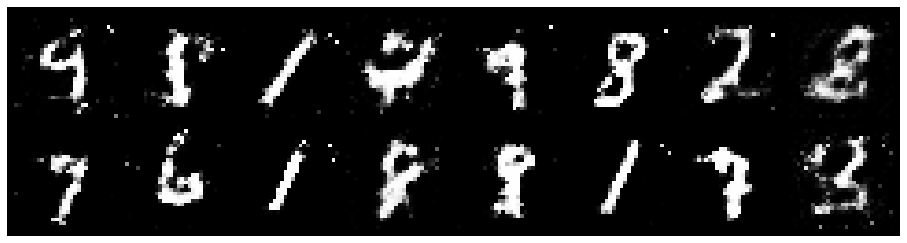

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.1350, Generator Loss: 1.0766
D(x): 0.5846, D(G(z)): 0.3604


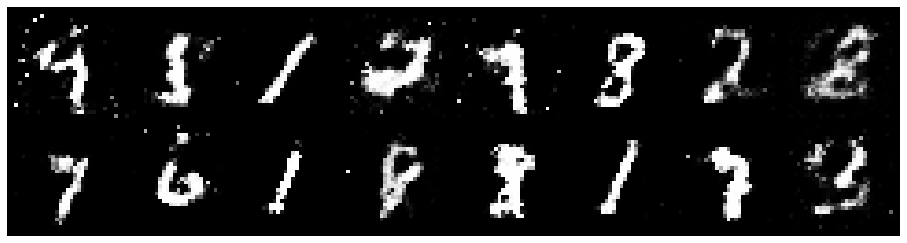

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 0.9856, Generator Loss: 1.3400
D(x): 0.6481, D(G(z)): 0.3408


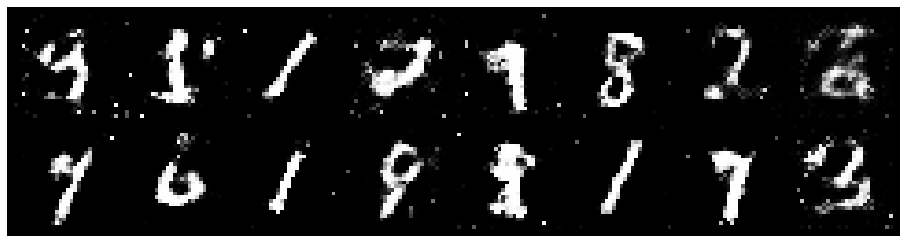

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.0108, Generator Loss: 1.1983
D(x): 0.6181, D(G(z)): 0.3056


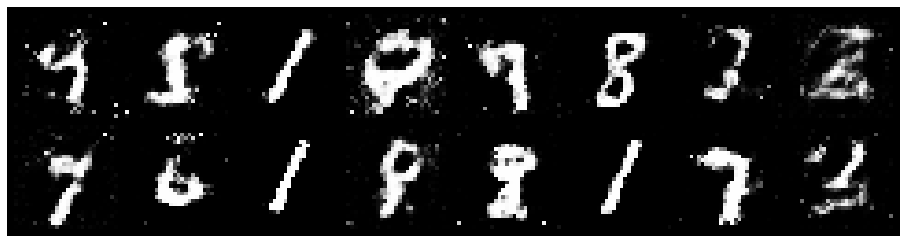

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.1951, Generator Loss: 1.1613
D(x): 0.6602, D(G(z)): 0.4372


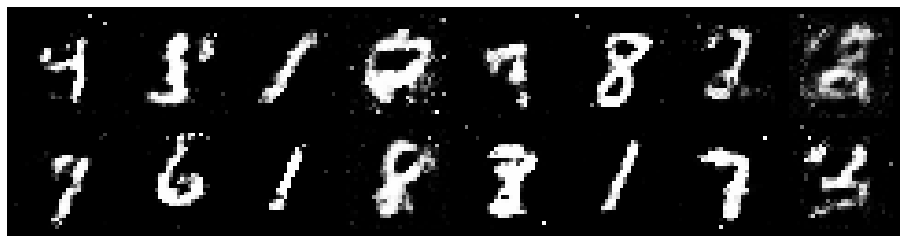

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.1284, Generator Loss: 1.3950
D(x): 0.6845, D(G(z)): 0.4146


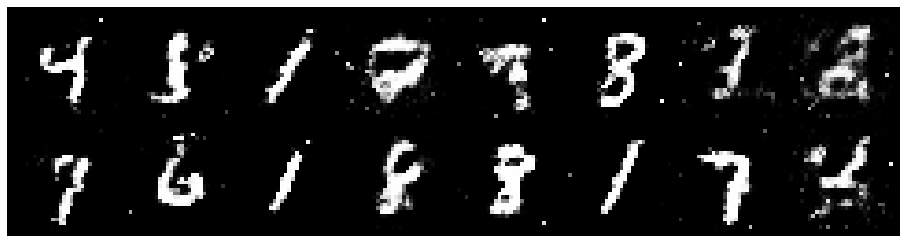

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.1293, Generator Loss: 1.2586
D(x): 0.6008, D(G(z)): 0.3434


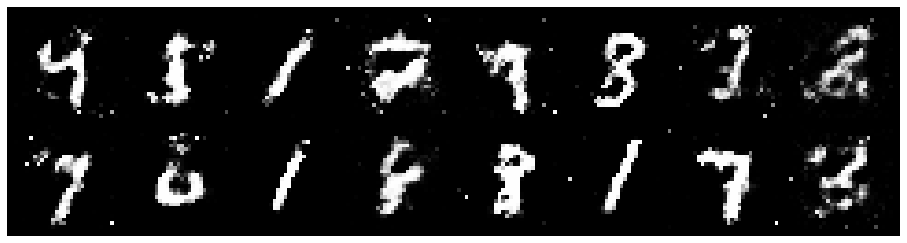

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.1271, Generator Loss: 1.2609
D(x): 0.6630, D(G(z)): 0.3906


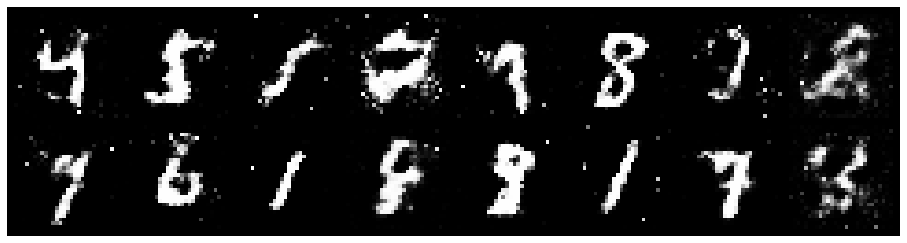

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 0.9396, Generator Loss: 1.2965
D(x): 0.6668, D(G(z)): 0.3297


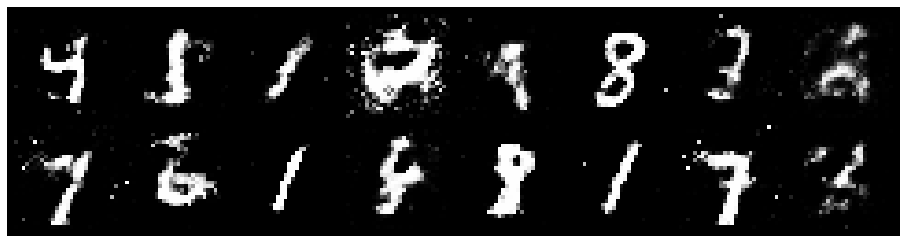

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 0.9535, Generator Loss: 1.3056
D(x): 0.7122, D(G(z)): 0.3752


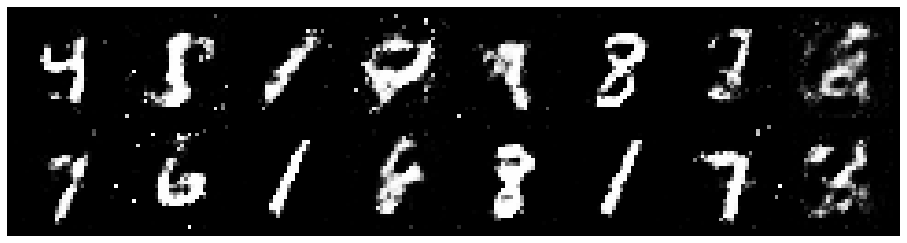

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.1797, Generator Loss: 1.3786
D(x): 0.5846, D(G(z)): 0.3679


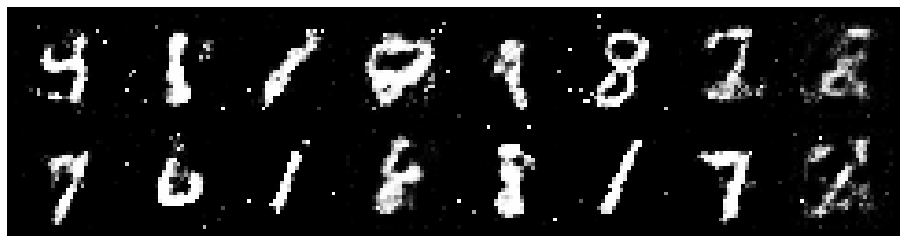

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 0.9750, Generator Loss: 1.3260
D(x): 0.6381, D(G(z)): 0.3137


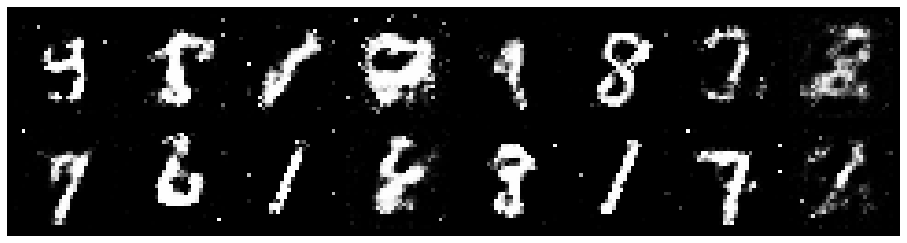

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.1797, Generator Loss: 1.3576
D(x): 0.6330, D(G(z)): 0.4025


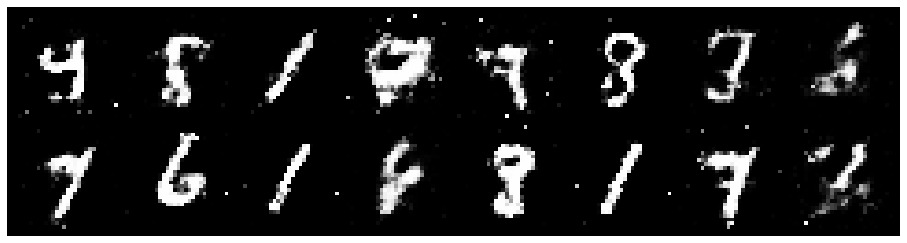

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 0.9991, Generator Loss: 1.2403
D(x): 0.6602, D(G(z)): 0.3614


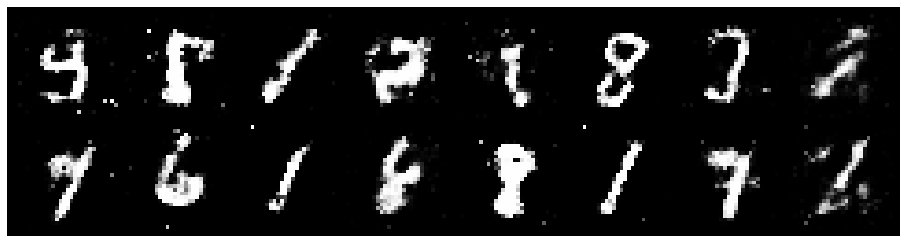

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.0525, Generator Loss: 1.2252
D(x): 0.5898, D(G(z)): 0.3325


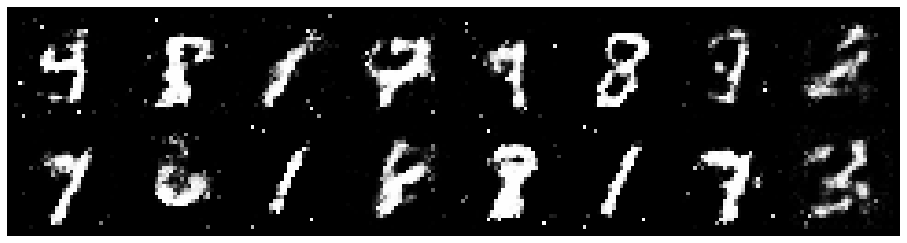

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.0729, Generator Loss: 1.1957
D(x): 0.6043, D(G(z)): 0.3284


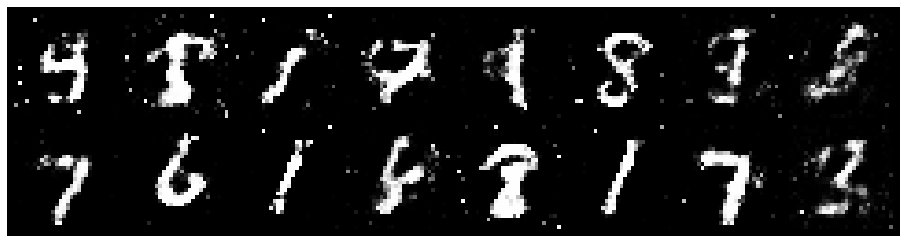

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.0926, Generator Loss: 1.2979
D(x): 0.5803, D(G(z)): 0.3355


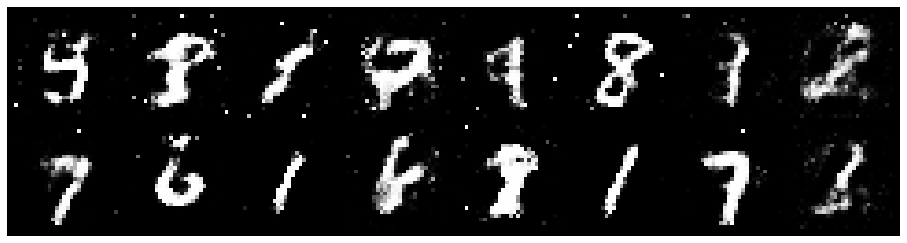

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.1855, Generator Loss: 0.9900
D(x): 0.5954, D(G(z)): 0.3899


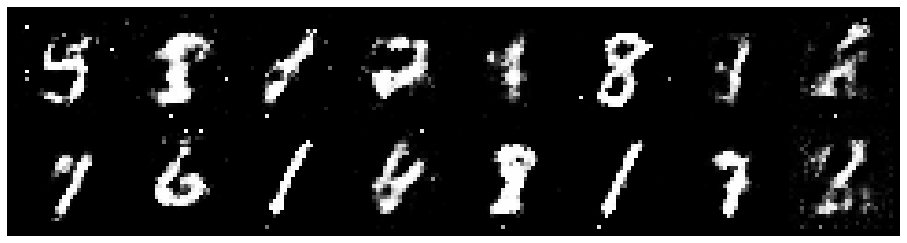

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.1754, Generator Loss: 1.2664
D(x): 0.6146, D(G(z)): 0.3391


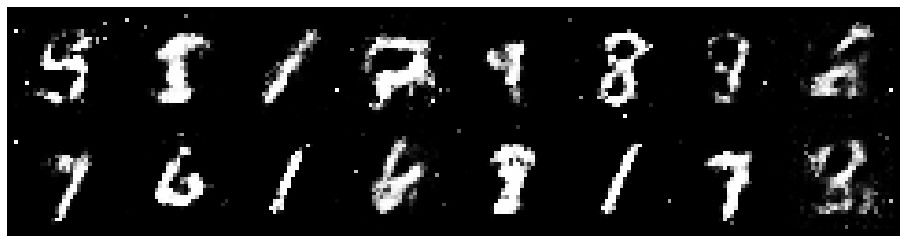

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.0942, Generator Loss: 1.3161
D(x): 0.5938, D(G(z)): 0.3292


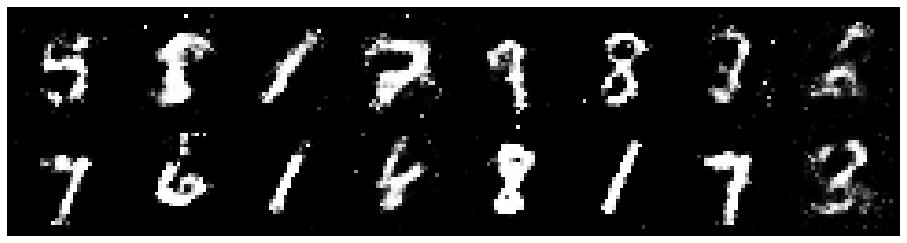

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 0.9359, Generator Loss: 1.1556
D(x): 0.6935, D(G(z)): 0.3607


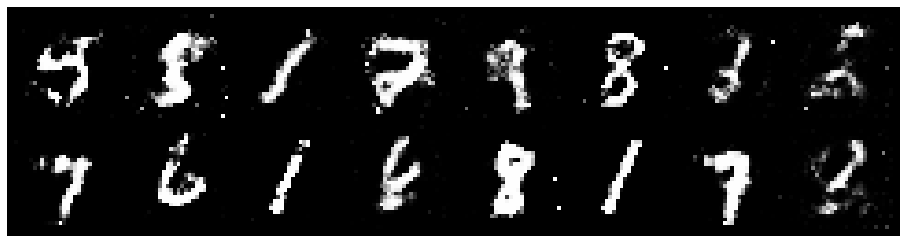

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.2033, Generator Loss: 1.0498
D(x): 0.6477, D(G(z)): 0.4410


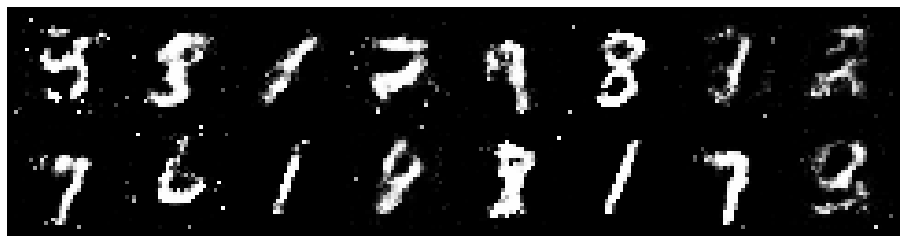

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.2068, Generator Loss: 1.0499
D(x): 0.6195, D(G(z)): 0.4161


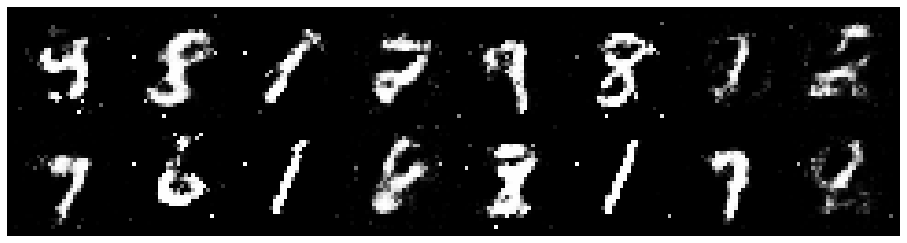

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.2773, Generator Loss: 1.1614
D(x): 0.5440, D(G(z)): 0.3649


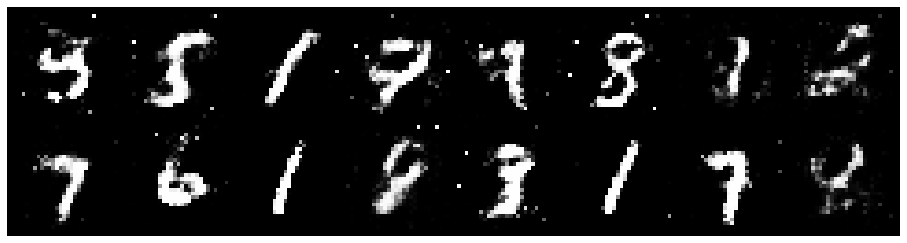

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 0.9963, Generator Loss: 1.3328
D(x): 0.6757, D(G(z)): 0.3637


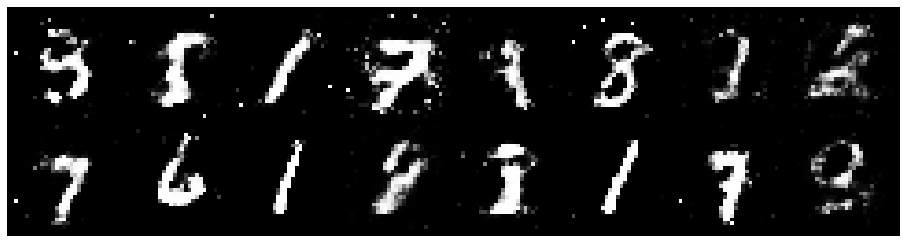

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.1589, Generator Loss: 1.1323
D(x): 0.6016, D(G(z)): 0.3381


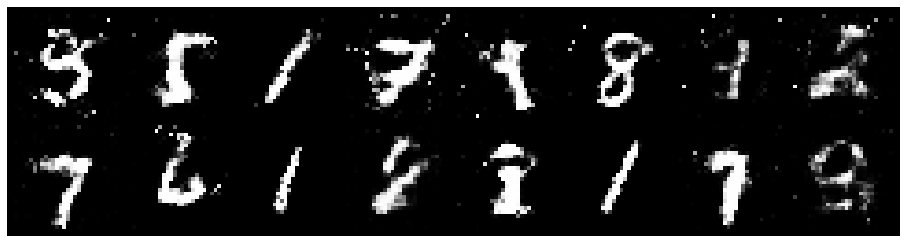

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.1804, Generator Loss: 1.4107
D(x): 0.5888, D(G(z)): 0.3377


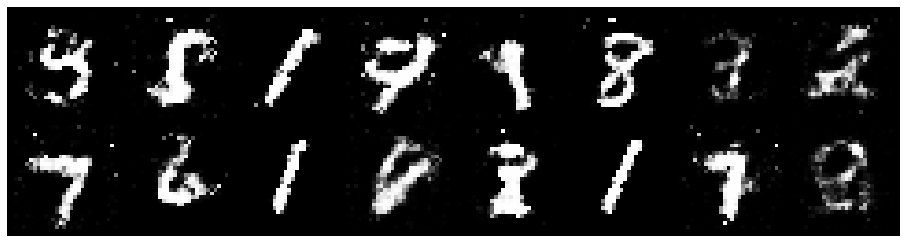

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 0.9400, Generator Loss: 1.2718
D(x): 0.7037, D(G(z)): 0.3438


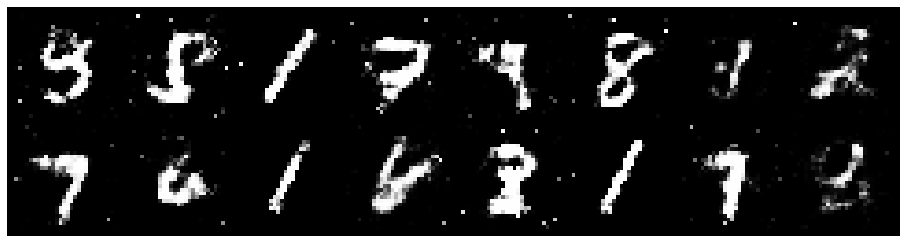

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 0.9857, Generator Loss: 1.3640
D(x): 0.6337, D(G(z)): 0.3309


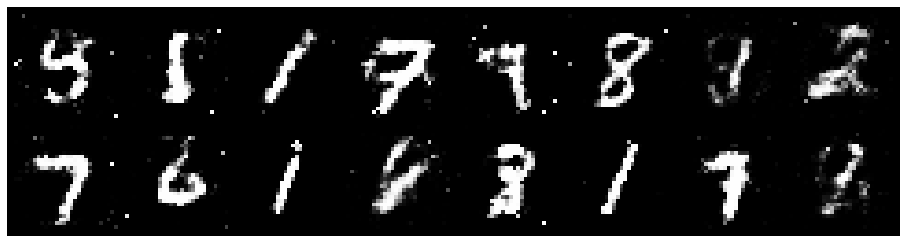

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.1117, Generator Loss: 1.1119
D(x): 0.6355, D(G(z)): 0.3841


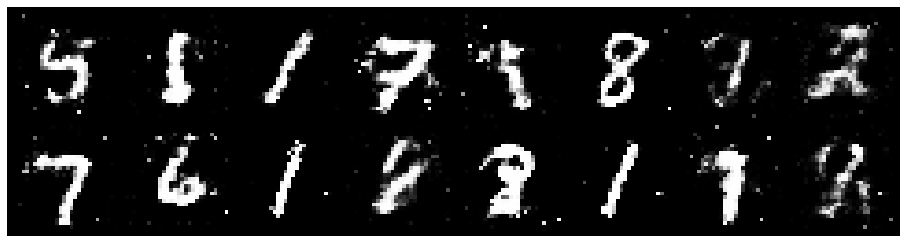

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.1131, Generator Loss: 1.3105
D(x): 0.6022, D(G(z)): 0.3617


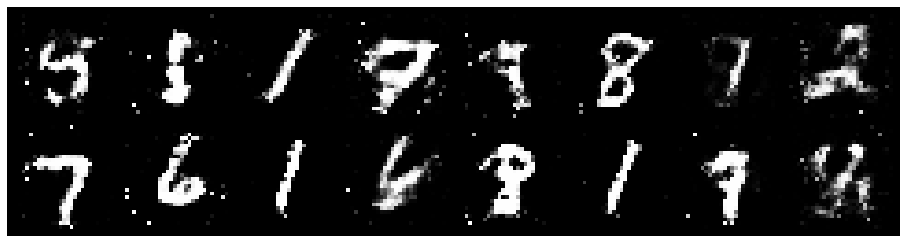

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.0564, Generator Loss: 1.3511
D(x): 0.6643, D(G(z)): 0.3647


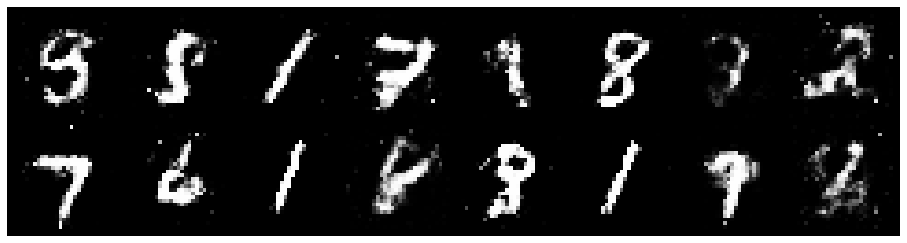

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 0.9759, Generator Loss: 1.3303
D(x): 0.6346, D(G(z)): 0.3170


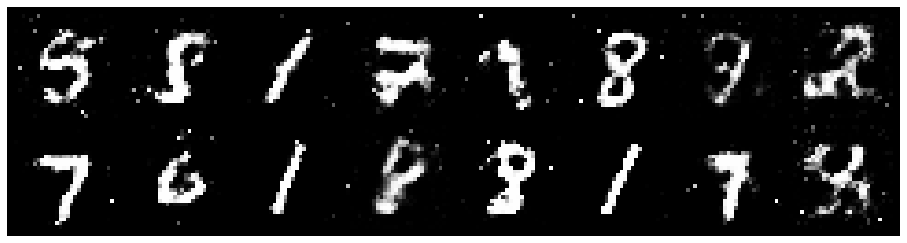

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.3590, Generator Loss: 0.9087
D(x): 0.6093, D(G(z)): 0.4531


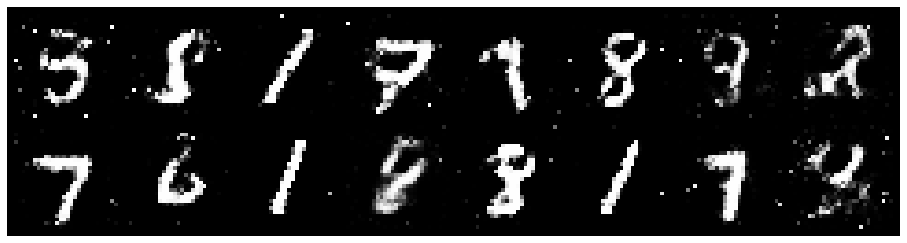

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 0.9763, Generator Loss: 1.6354
D(x): 0.6341, D(G(z)): 0.2778


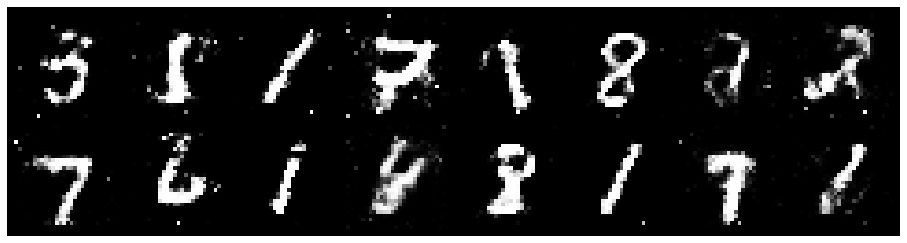

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.0013, Generator Loss: 1.3573
D(x): 0.6500, D(G(z)): 0.3504


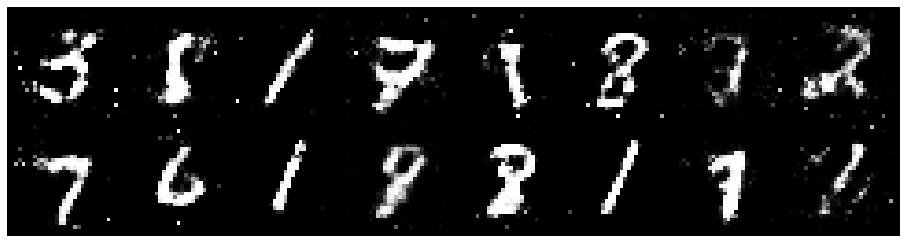

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.1663, Generator Loss: 1.1754
D(x): 0.6154, D(G(z)): 0.3927


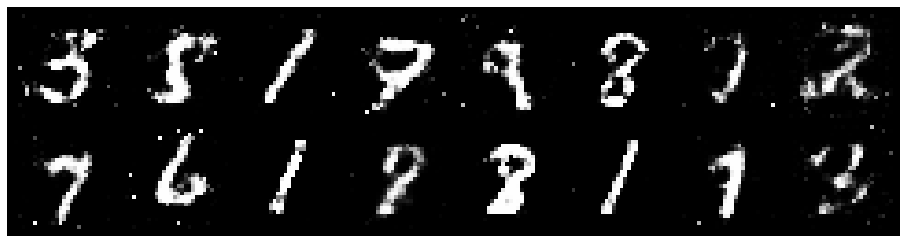

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.0806, Generator Loss: 1.0964
D(x): 0.6518, D(G(z)): 0.3919


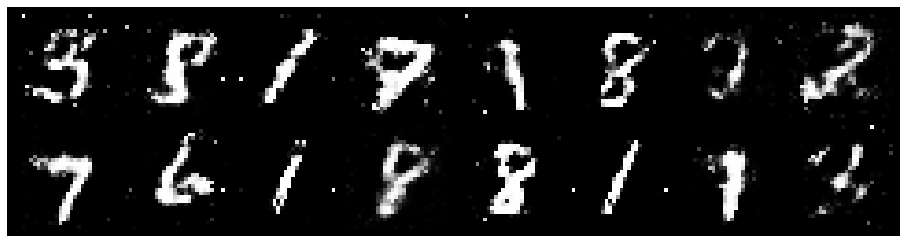

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.3094, Generator Loss: 0.9335
D(x): 0.5507, D(G(z)): 0.4334


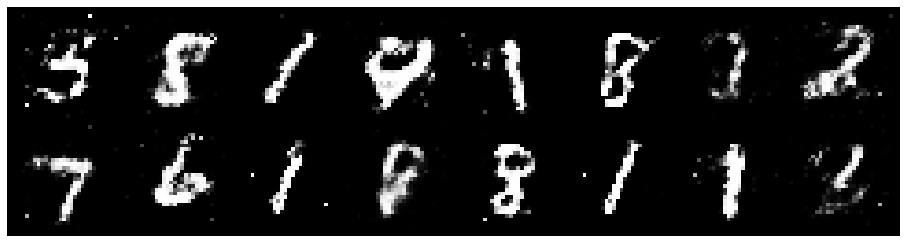

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.2271, Generator Loss: 1.0710
D(x): 0.5761, D(G(z)): 0.4084


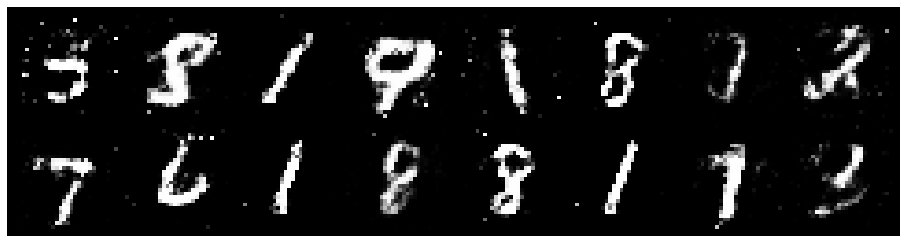

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.2408, Generator Loss: 0.9085
D(x): 0.6117, D(G(z)): 0.4160


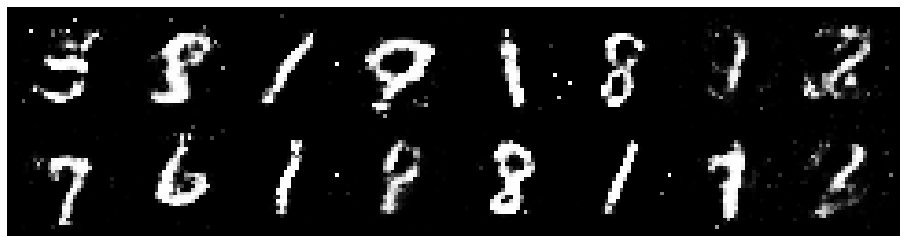

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.2587, Generator Loss: 1.0161
D(x): 0.5537, D(G(z)): 0.3957


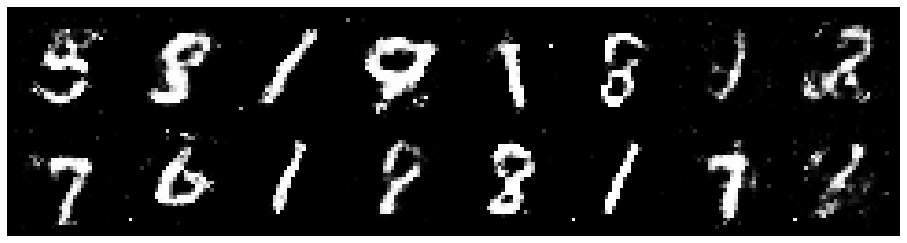

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.0551, Generator Loss: 1.1129
D(x): 0.6251, D(G(z)): 0.3637


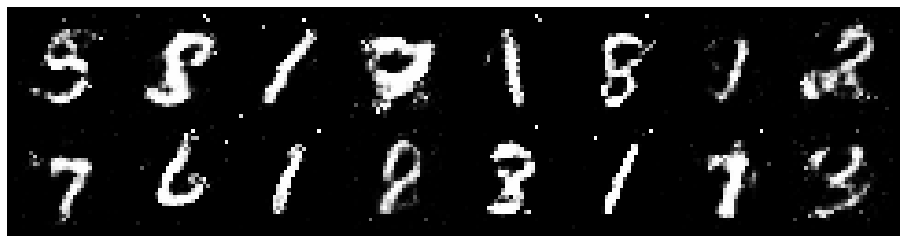

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 0.9855, Generator Loss: 1.1894
D(x): 0.6390, D(G(z)): 0.3520


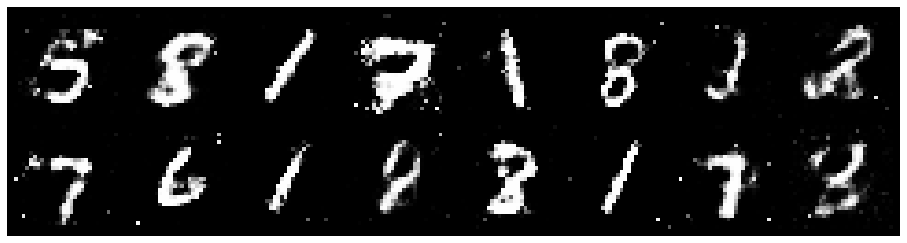

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 0.9211, Generator Loss: 1.1723
D(x): 0.6817, D(G(z)): 0.3488


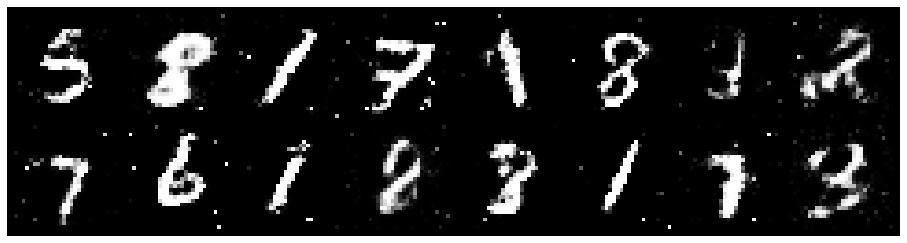

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.0842, Generator Loss: 0.9888
D(x): 0.6318, D(G(z)): 0.4151


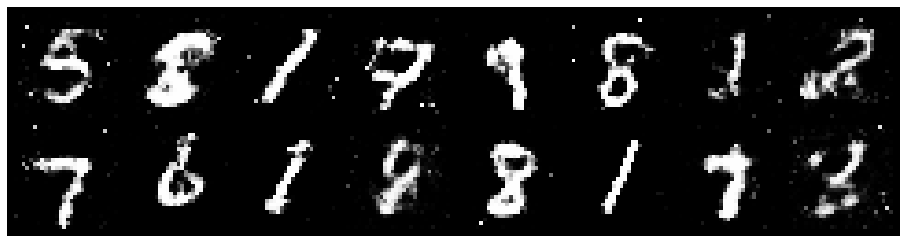

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.1742, Generator Loss: 1.0804
D(x): 0.5931, D(G(z)): 0.3861


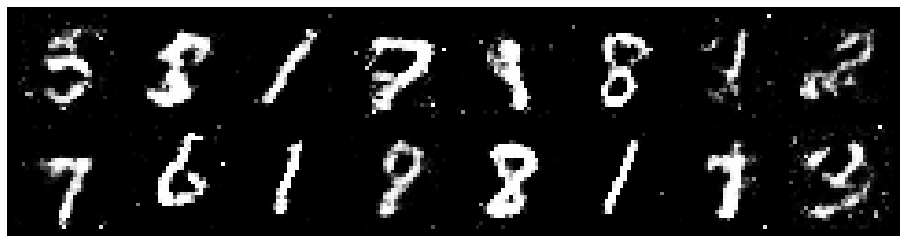

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.0833, Generator Loss: 1.0061
D(x): 0.6178, D(G(z)): 0.3852


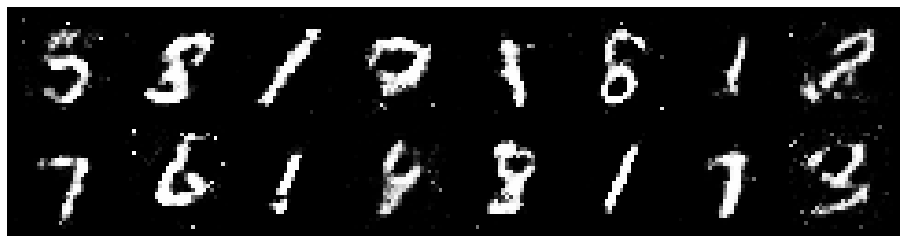

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.0687, Generator Loss: 1.2618
D(x): 0.6467, D(G(z)): 0.3756


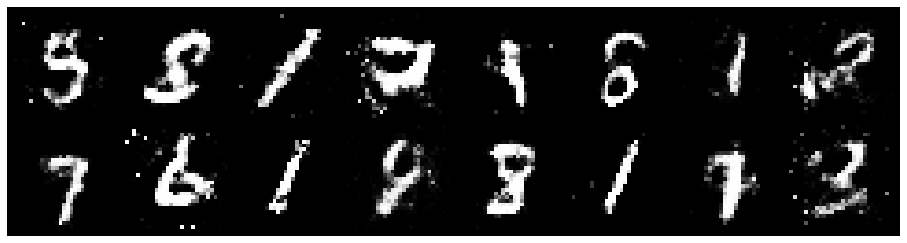

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.0735, Generator Loss: 1.1287
D(x): 0.6474, D(G(z)): 0.3844


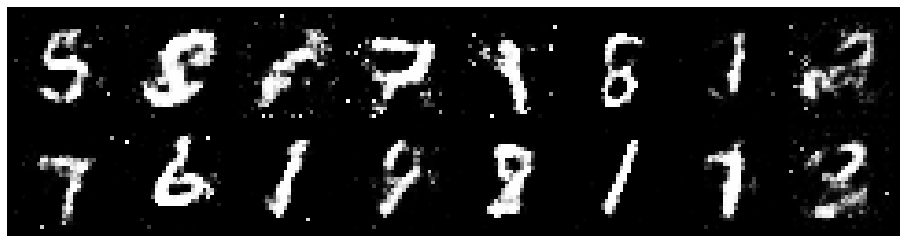

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.1631, Generator Loss: 1.2358
D(x): 0.6145, D(G(z)): 0.4052


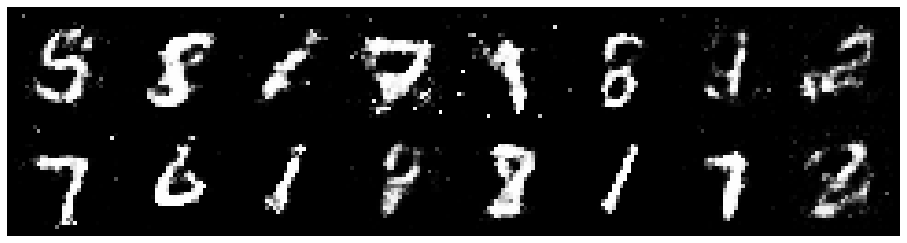

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 0.9958, Generator Loss: 1.2129
D(x): 0.6265, D(G(z)): 0.3505


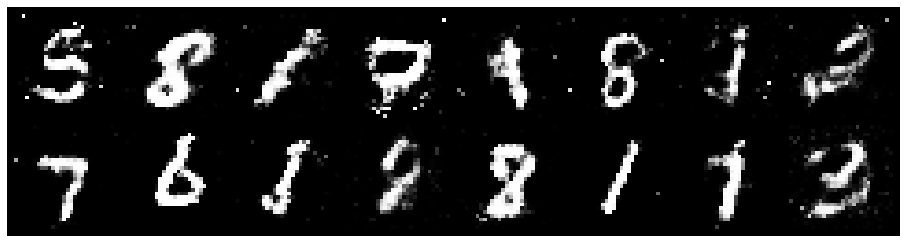

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.3108, Generator Loss: 1.0755
D(x): 0.6057, D(G(z)): 0.4461


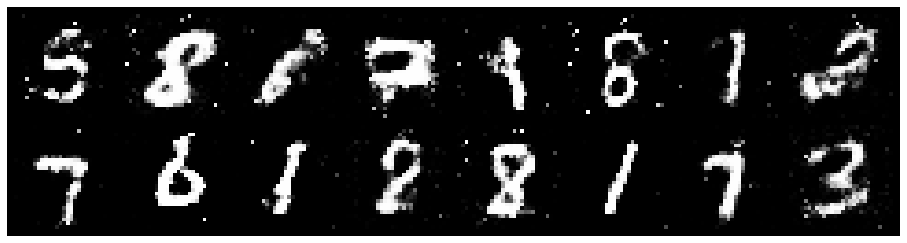

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.3120, Generator Loss: 1.0827
D(x): 0.5728, D(G(z)): 0.4277


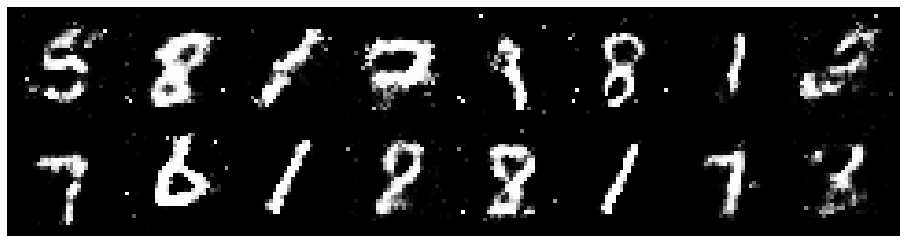

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.0651, Generator Loss: 1.6419
D(x): 0.6948, D(G(z)): 0.3663


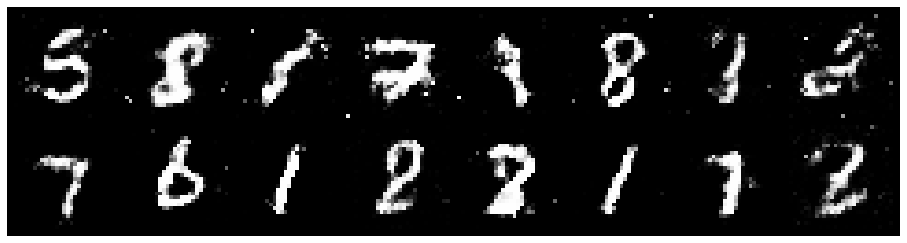

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.1770, Generator Loss: 1.0666
D(x): 0.6285, D(G(z)): 0.4174


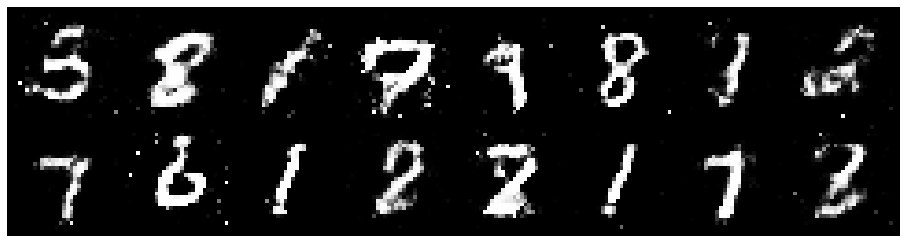

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.1718, Generator Loss: 1.1547
D(x): 0.5509, D(G(z)): 0.3522


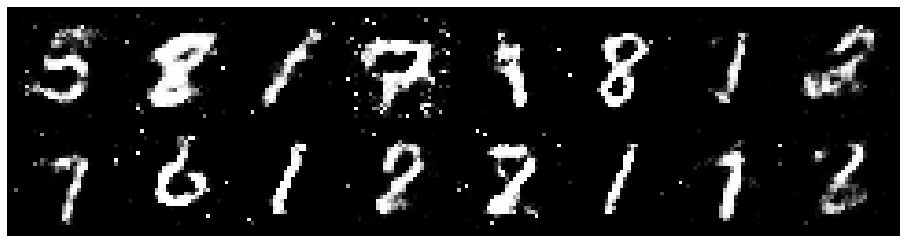

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.1653, Generator Loss: 1.1543
D(x): 0.6427, D(G(z)): 0.4207


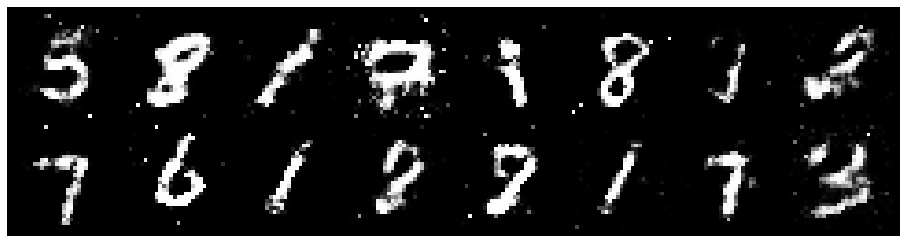

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.2212, Generator Loss: 1.0468
D(x): 0.6134, D(G(z)): 0.4225


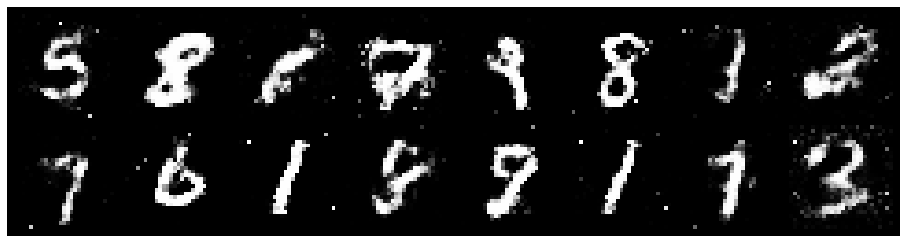

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.1506, Generator Loss: 1.3515
D(x): 0.5237, D(G(z)): 0.2961


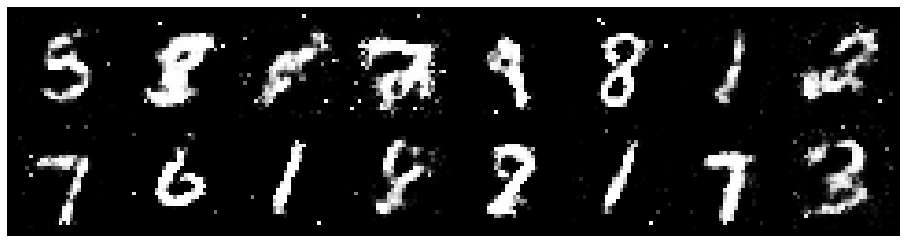

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.0144, Generator Loss: 1.1014
D(x): 0.6882, D(G(z)): 0.3980


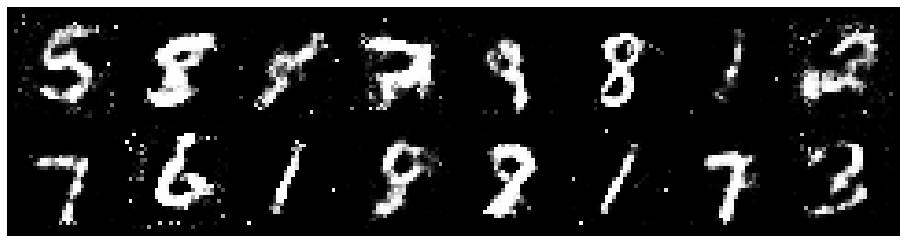

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.2435, Generator Loss: 1.1012
D(x): 0.5786, D(G(z)): 0.3623


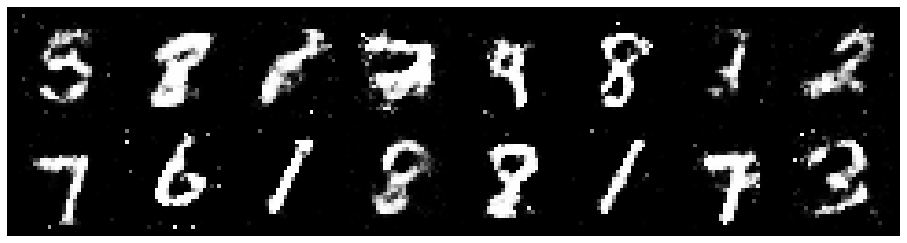

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.1339, Generator Loss: 1.1581
D(x): 0.6006, D(G(z)): 0.3777


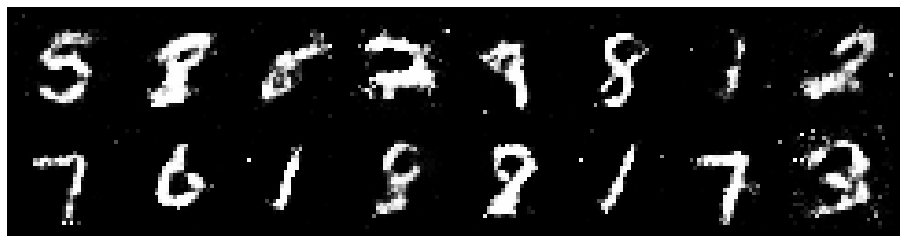

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.1246, Generator Loss: 0.8984
D(x): 0.6249, D(G(z)): 0.4038


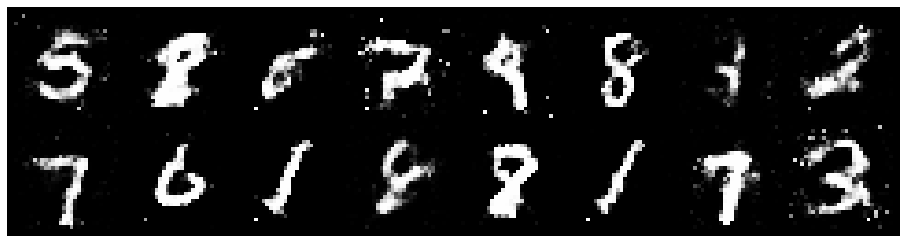

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.1676, Generator Loss: 0.8831
D(x): 0.6303, D(G(z)): 0.4420


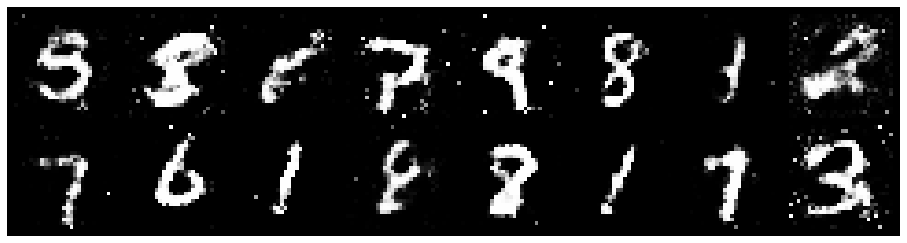

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.2596, Generator Loss: 1.0112
D(x): 0.5372, D(G(z)): 0.3986


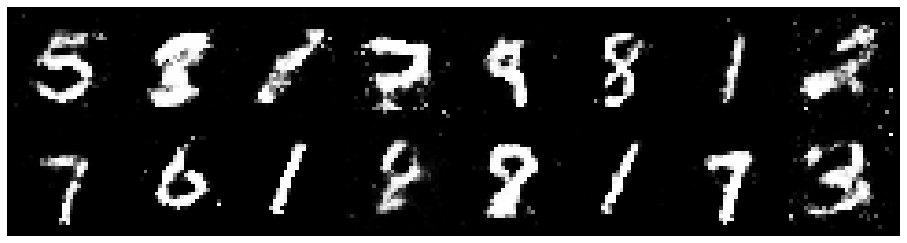

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.2969, Generator Loss: 1.0894
D(x): 0.5679, D(G(z)): 0.4172


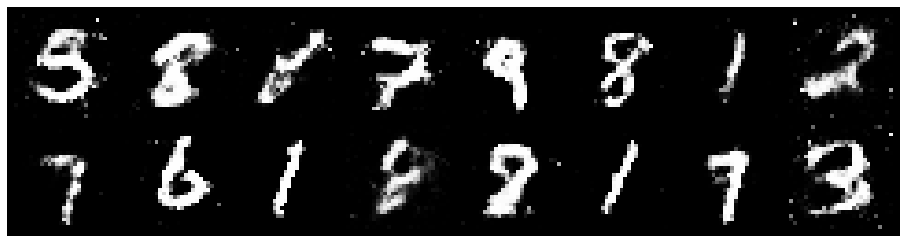

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.2852, Generator Loss: 0.9985
D(x): 0.6493, D(G(z)): 0.4829


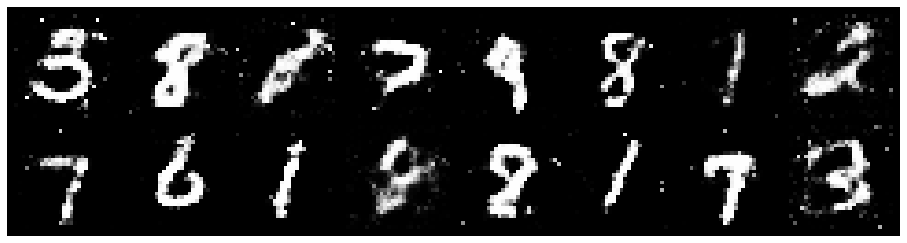

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1963, Generator Loss: 1.4685
D(x): 0.5299, D(G(z)): 0.3293


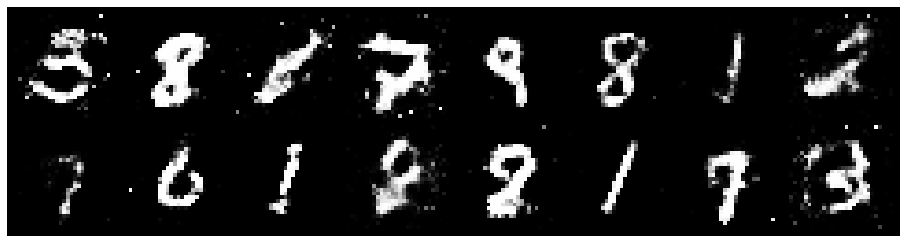

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.2484, Generator Loss: 0.8716
D(x): 0.5842, D(G(z)): 0.4350


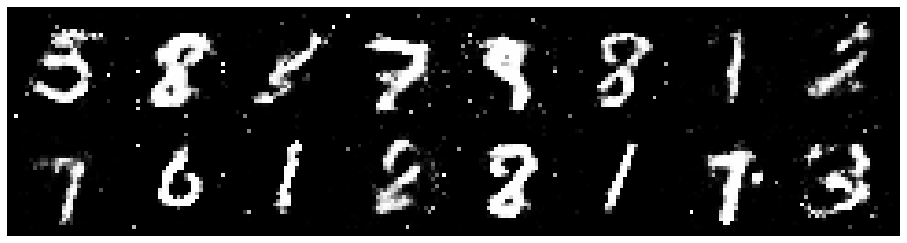

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.1362, Generator Loss: 1.0678
D(x): 0.6017, D(G(z)): 0.3867


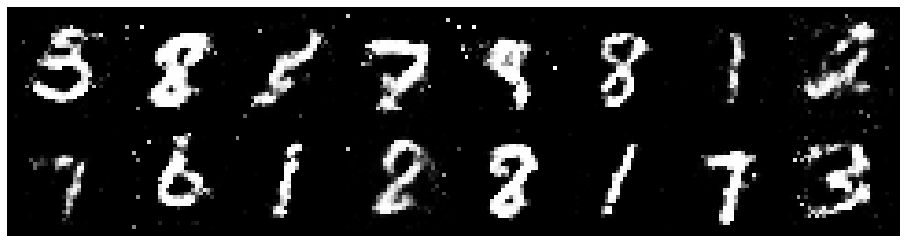

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.1386, Generator Loss: 0.8923
D(x): 0.6540, D(G(z)): 0.4429


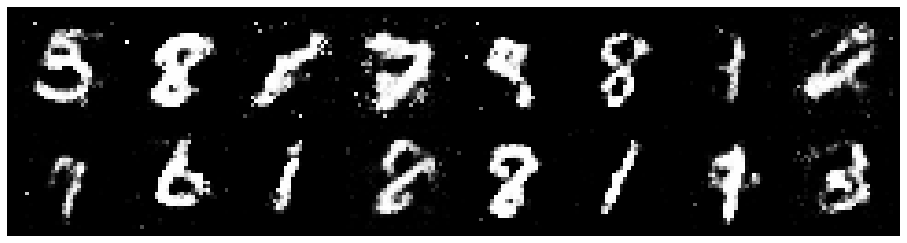

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.2679, Generator Loss: 0.8619
D(x): 0.6416, D(G(z)): 0.4630


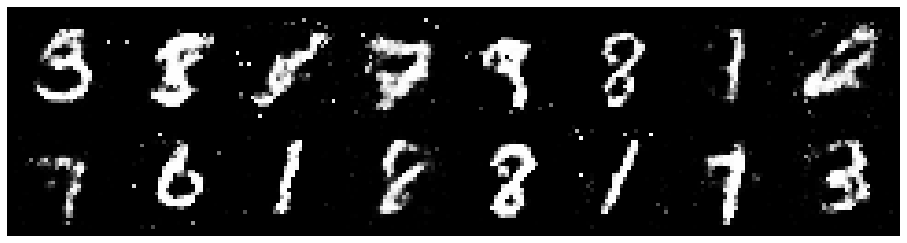

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.1202, Generator Loss: 1.1950
D(x): 0.5991, D(G(z)): 0.3441


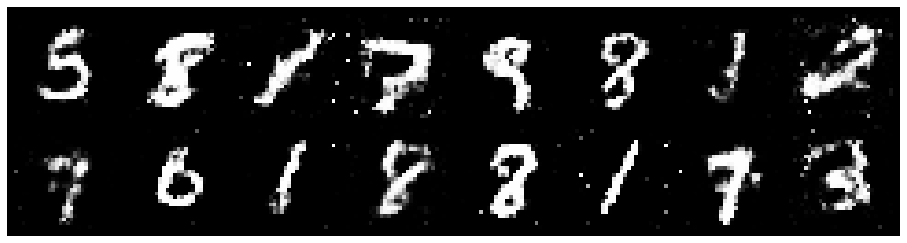

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.2635, Generator Loss: 0.8715
D(x): 0.5722, D(G(z)): 0.4151


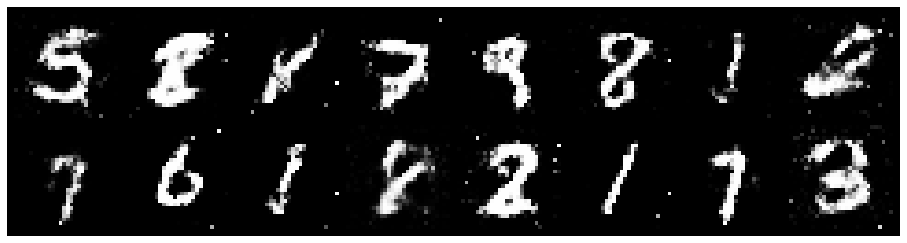

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.1843, Generator Loss: 0.9235
D(x): 0.5953, D(G(z)): 0.4130


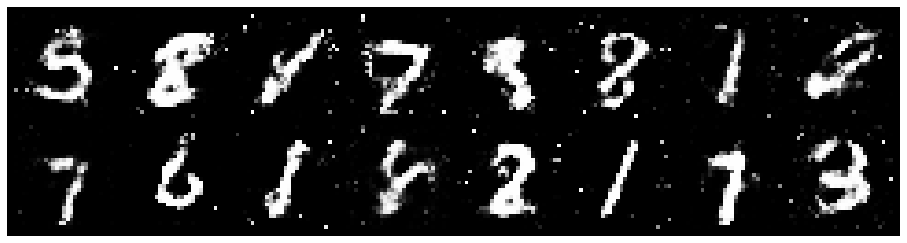

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.1276, Generator Loss: 1.0263
D(x): 0.6044, D(G(z)): 0.3966


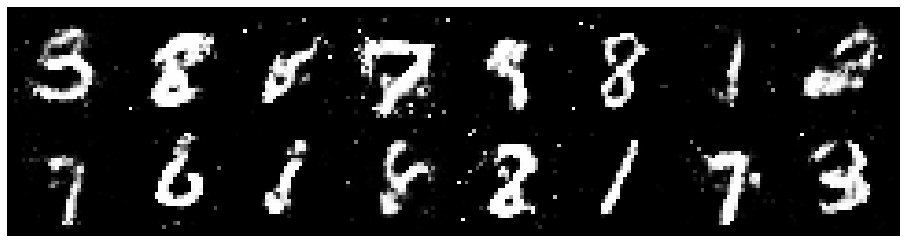

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.3248, Generator Loss: 0.9115
D(x): 0.6086, D(G(z)): 0.4692


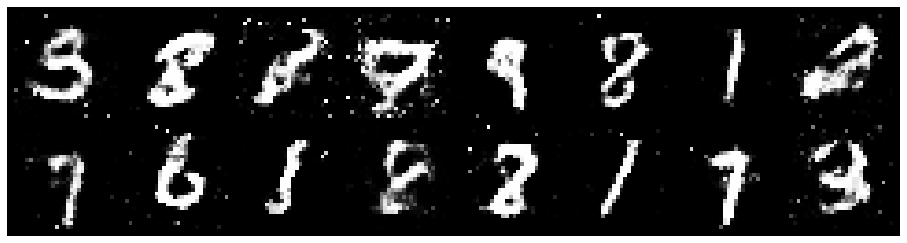

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.2820, Generator Loss: 1.1049
D(x): 0.6000, D(G(z)): 0.4491


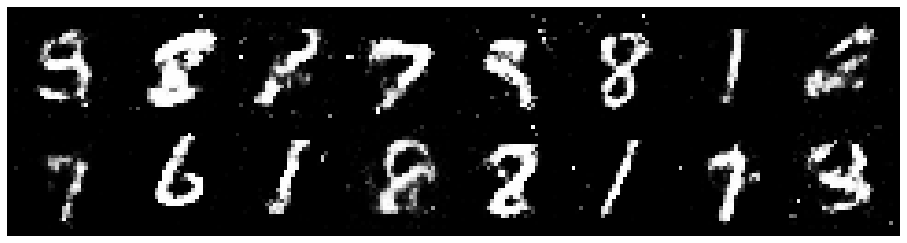

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.2349, Generator Loss: 0.8938
D(x): 0.6031, D(G(z)): 0.4274


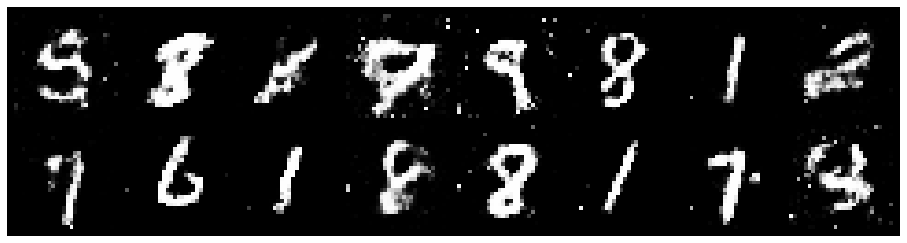

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.0223, Generator Loss: 1.0114
D(x): 0.6395, D(G(z)): 0.3785


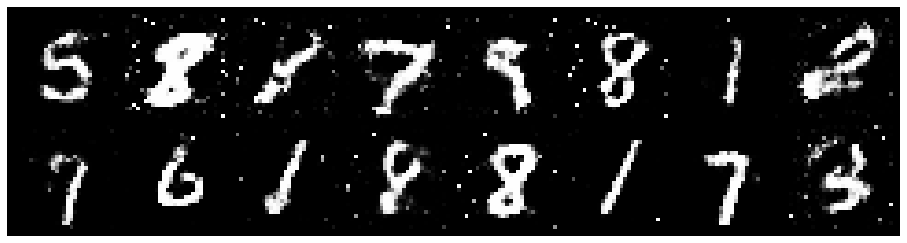

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.2000, Generator Loss: 0.9494
D(x): 0.5541, D(G(z)): 0.4098


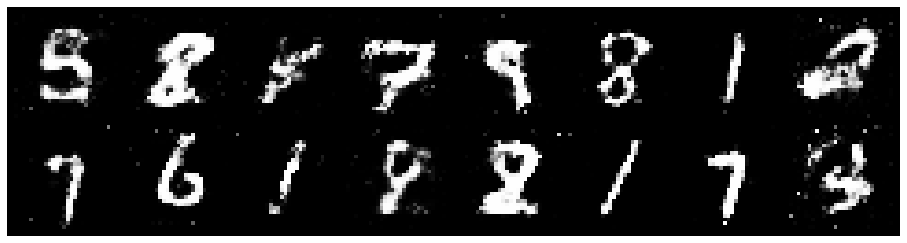

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.3057, Generator Loss: 1.0707
D(x): 0.5672, D(G(z)): 0.4354


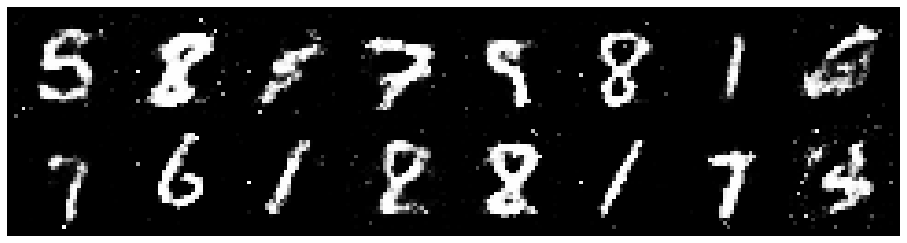

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.1721, Generator Loss: 1.1258
D(x): 0.6065, D(G(z)): 0.4107


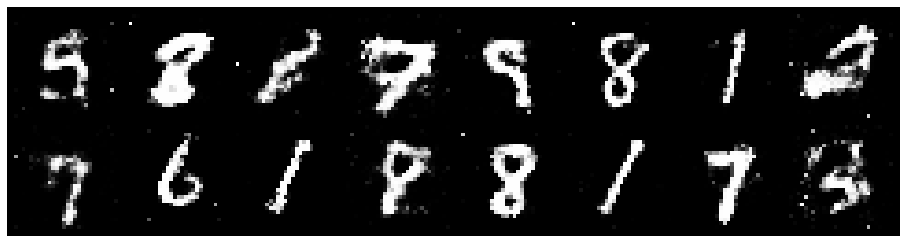

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.1658, Generator Loss: 1.0531
D(x): 0.6032, D(G(z)): 0.4000


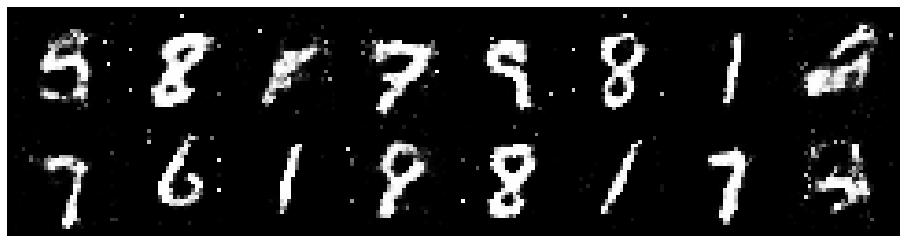

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 0.9979, Generator Loss: 1.0525
D(x): 0.6413, D(G(z)): 0.3500


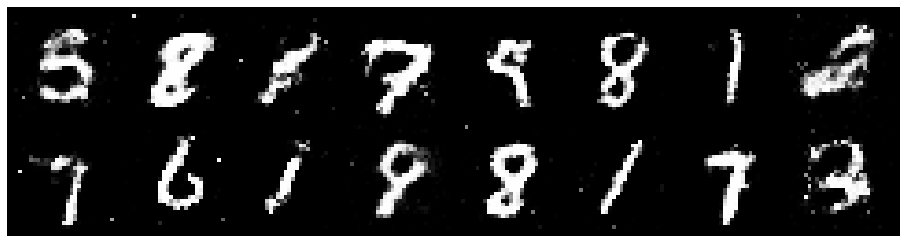

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.2213, Generator Loss: 1.0097
D(x): 0.5945, D(G(z)): 0.4401


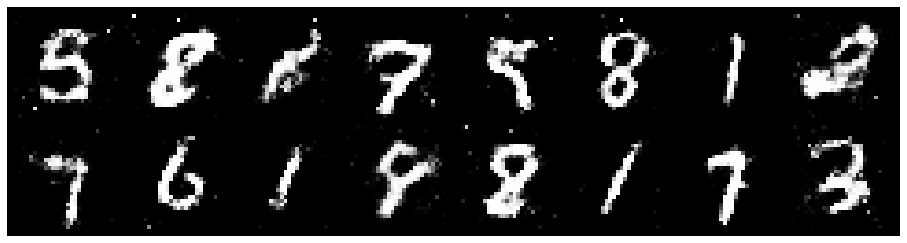

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.1492, Generator Loss: 1.0895
D(x): 0.5748, D(G(z)): 0.3808


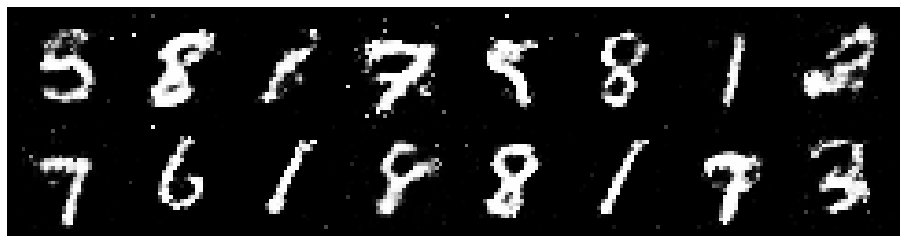

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.1661, Generator Loss: 0.9390
D(x): 0.5874, D(G(z)): 0.4119


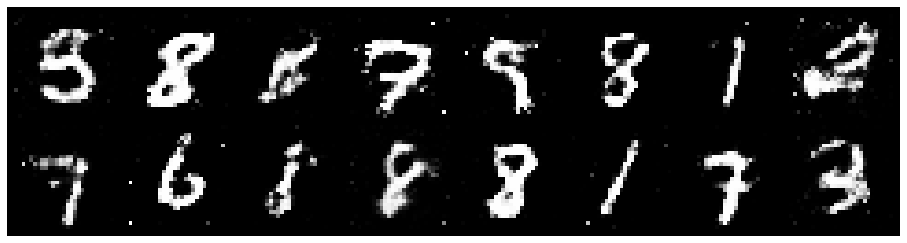

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.2205, Generator Loss: 0.9106
D(x): 0.5969, D(G(z)): 0.4574


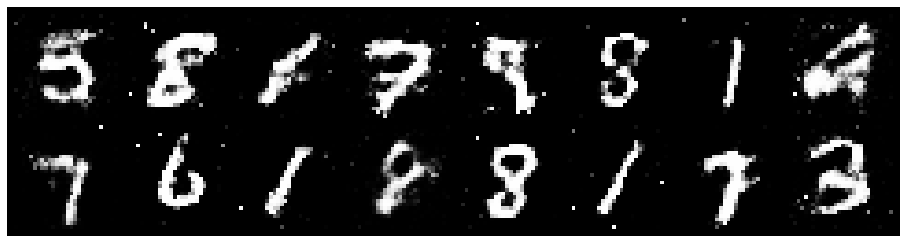

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.2003, Generator Loss: 1.2201
D(x): 0.5706, D(G(z)): 0.3864


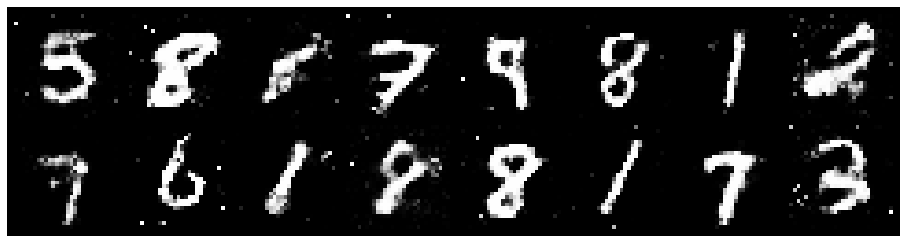

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.2995, Generator Loss: 1.0597
D(x): 0.5275, D(G(z)): 0.4025


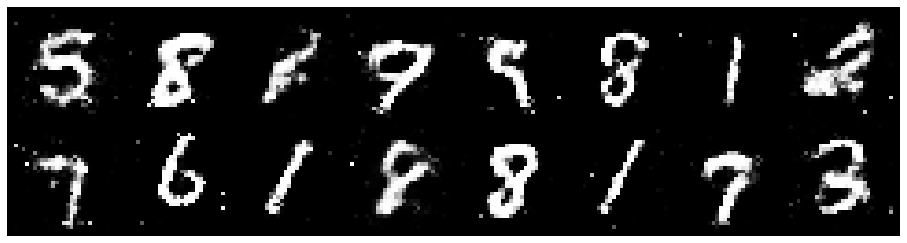

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.1733, Generator Loss: 1.0520
D(x): 0.6102, D(G(z)): 0.4117


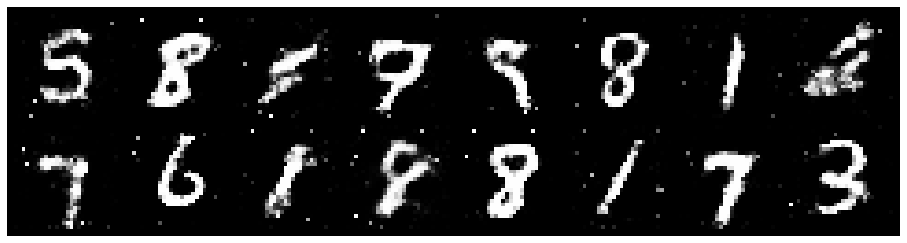

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.2451, Generator Loss: 1.0808
D(x): 0.5507, D(G(z)): 0.3988


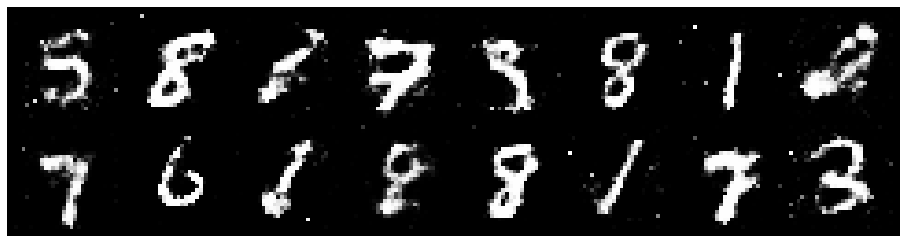

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.0395, Generator Loss: 1.1251
D(x): 0.5916, D(G(z)): 0.3530


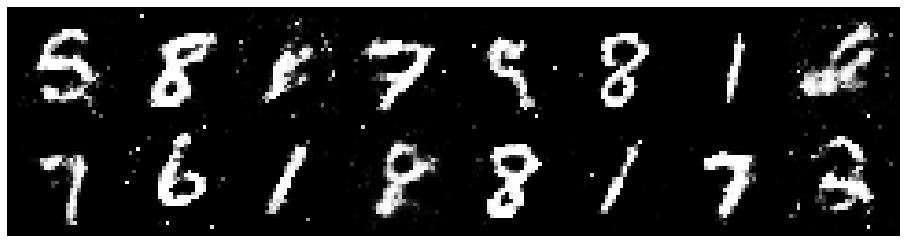

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.1767, Generator Loss: 1.2411
D(x): 0.6671, D(G(z)): 0.4327


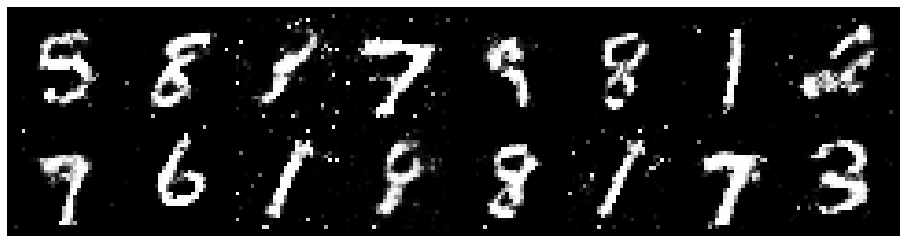

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.1433, Generator Loss: 1.2119
D(x): 0.6319, D(G(z)): 0.4125


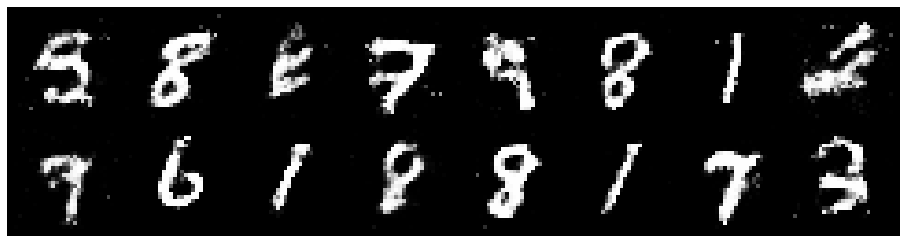

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.2389, Generator Loss: 0.9939
D(x): 0.6202, D(G(z)): 0.4790


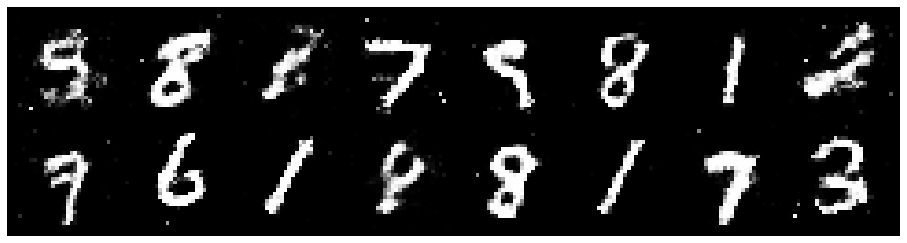

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.3000, Generator Loss: 0.8883
D(x): 0.5536, D(G(z)): 0.4377


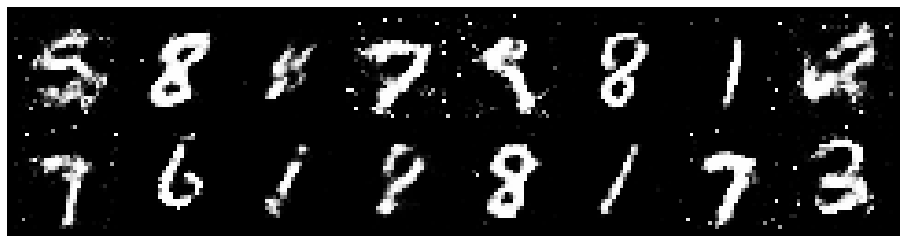

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.1140, Generator Loss: 0.9351
D(x): 0.6097, D(G(z)): 0.4041


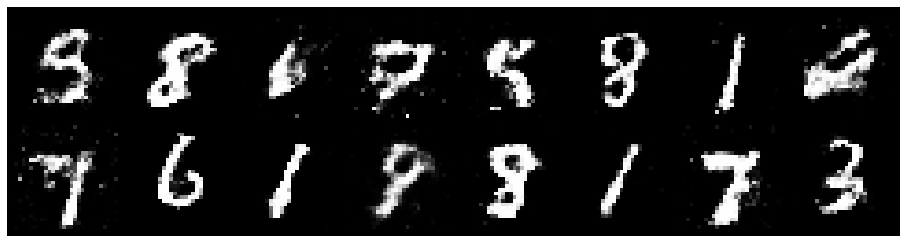

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.2759, Generator Loss: 0.9495
D(x): 0.5678, D(G(z)): 0.4455


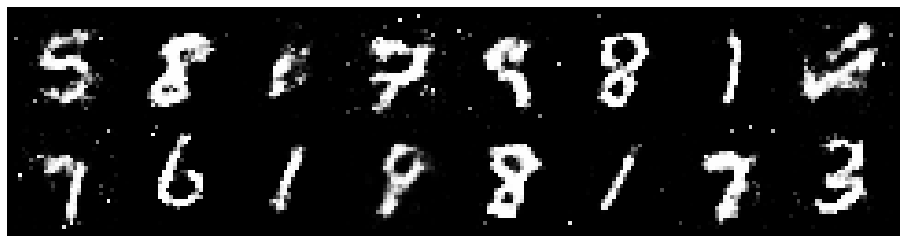

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.2159, Generator Loss: 1.1289
D(x): 0.6216, D(G(z)): 0.4335


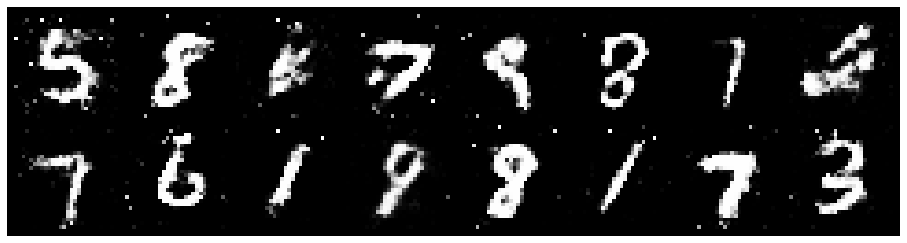

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.2579, Generator Loss: 1.1477
D(x): 0.6025, D(G(z)): 0.4187


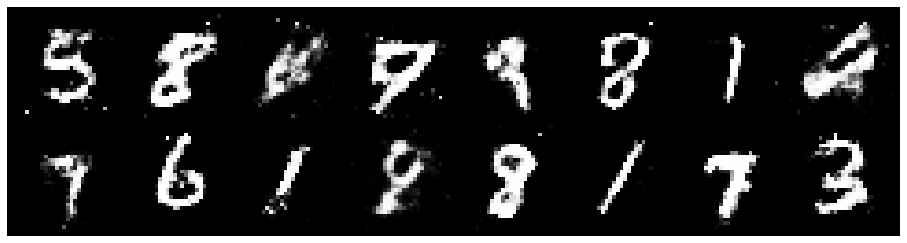

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.2105, Generator Loss: 0.8924
D(x): 0.6026, D(G(z)): 0.4182


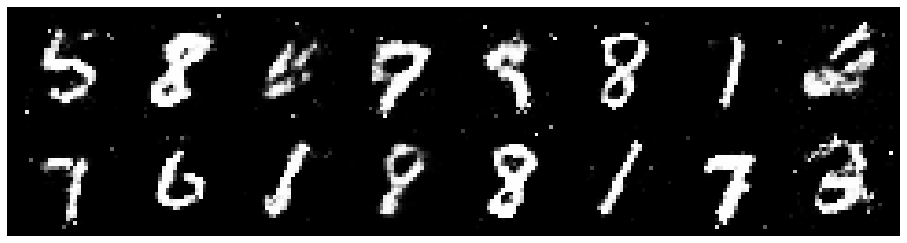

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.1213, Generator Loss: 0.9823
D(x): 0.6276, D(G(z)): 0.3900


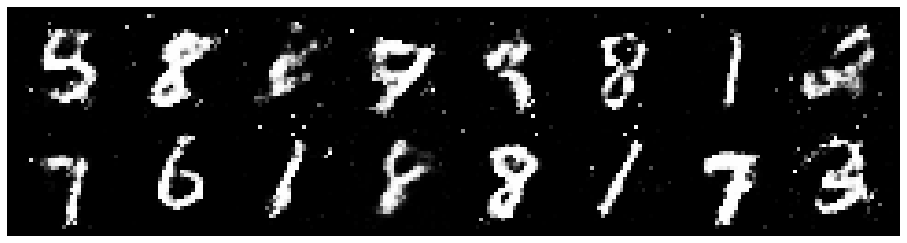

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.2514, Generator Loss: 1.1988
D(x): 0.5936, D(G(z)): 0.4195


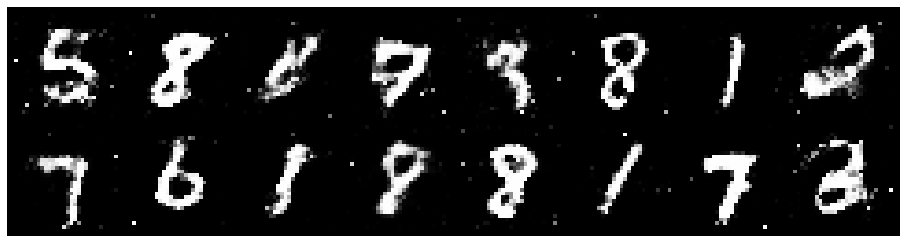

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.0888, Generator Loss: 1.0534
D(x): 0.5895, D(G(z)): 0.3693


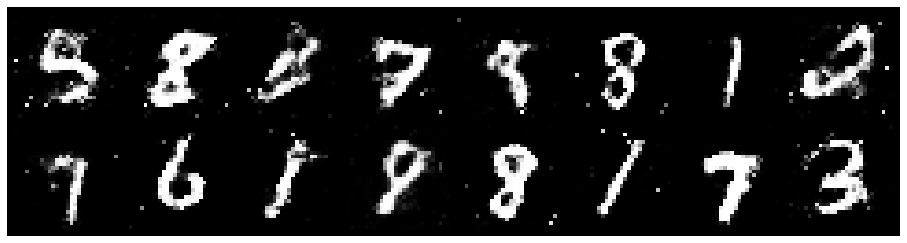

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.0558, Generator Loss: 1.0692
D(x): 0.6450, D(G(z)): 0.3996


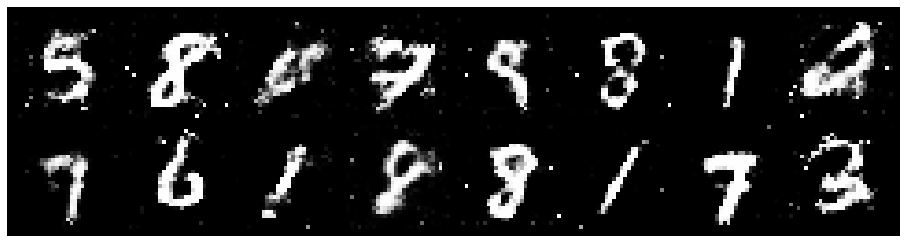

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.2952, Generator Loss: 0.9581
D(x): 0.5521, D(G(z)): 0.4353


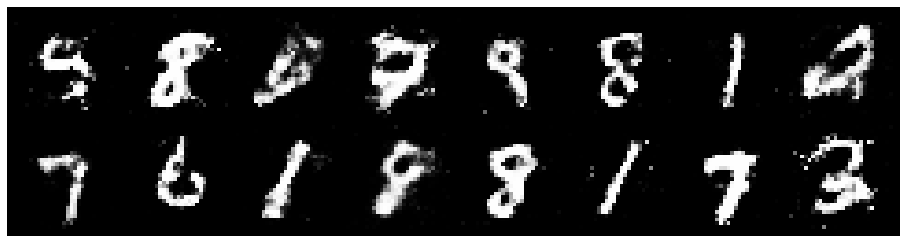

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.2220, Generator Loss: 0.9681
D(x): 0.5613, D(G(z)): 0.4052


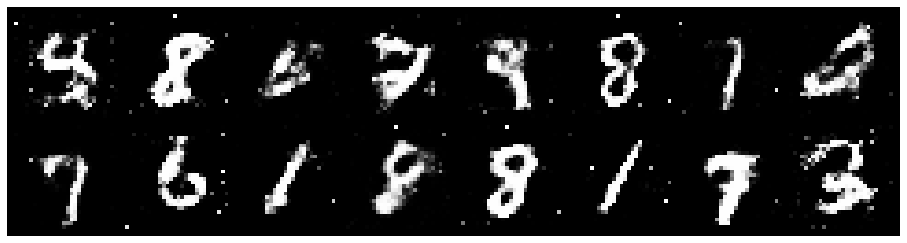

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.2519, Generator Loss: 1.2462
D(x): 0.6086, D(G(z)): 0.4302


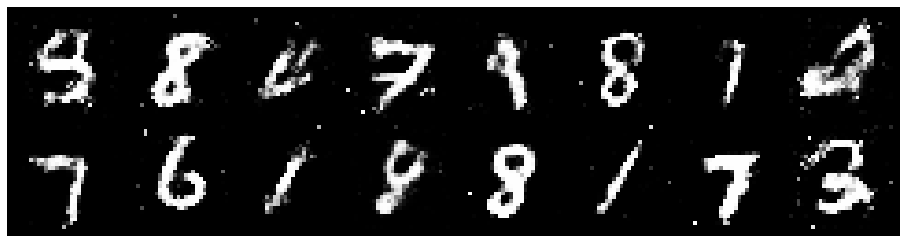

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.2291, Generator Loss: 1.0857
D(x): 0.6070, D(G(z)): 0.4551


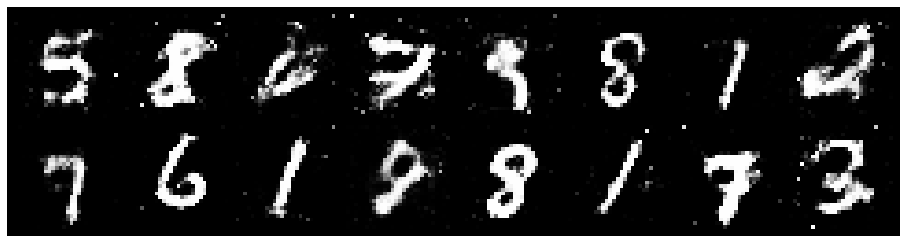

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.0736, Generator Loss: 1.2821
D(x): 0.6461, D(G(z)): 0.3776


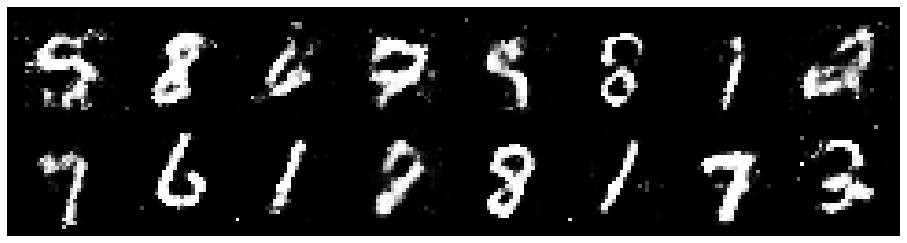

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.1577, Generator Loss: 1.1746
D(x): 0.5651, D(G(z)): 0.3787


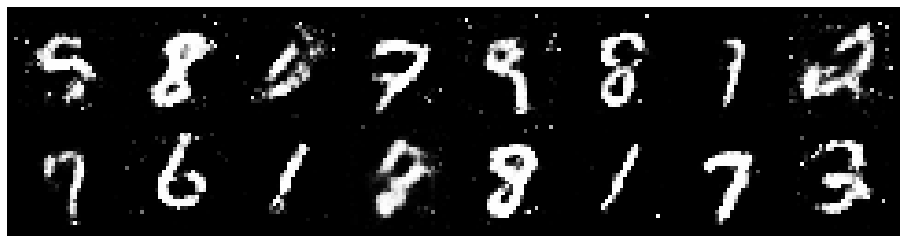

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.2094, Generator Loss: 0.8454
D(x): 0.5846, D(G(z)): 0.4484


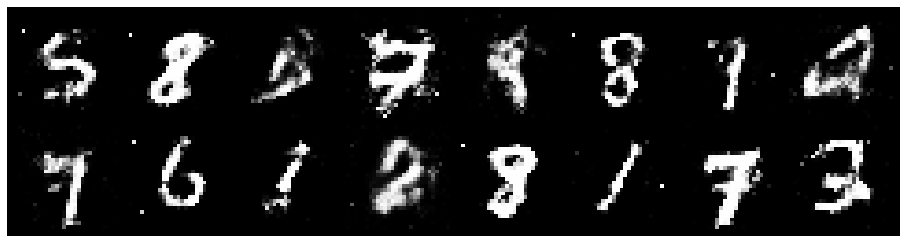

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.1791, Generator Loss: 0.9729
D(x): 0.5839, D(G(z)): 0.4210


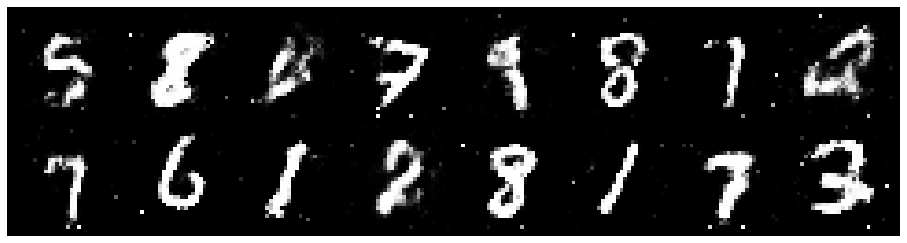

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.2343, Generator Loss: 1.0182
D(x): 0.6084, D(G(z)): 0.4410


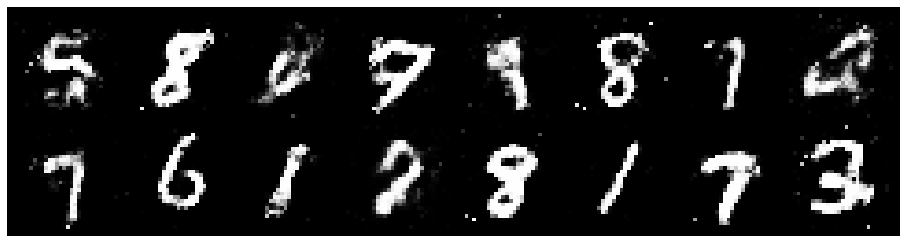

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.2479, Generator Loss: 0.7441
D(x): 0.6108, D(G(z)): 0.4751


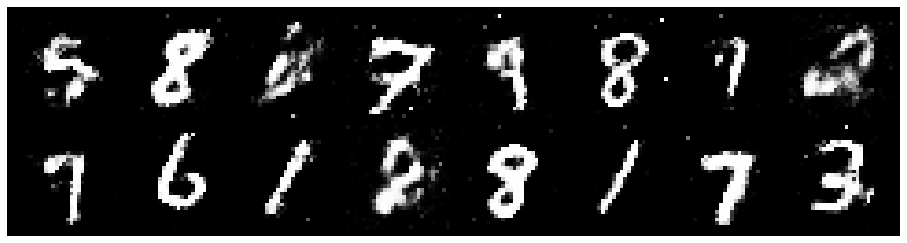

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.1974, Generator Loss: 1.1927
D(x): 0.5625, D(G(z)): 0.3650


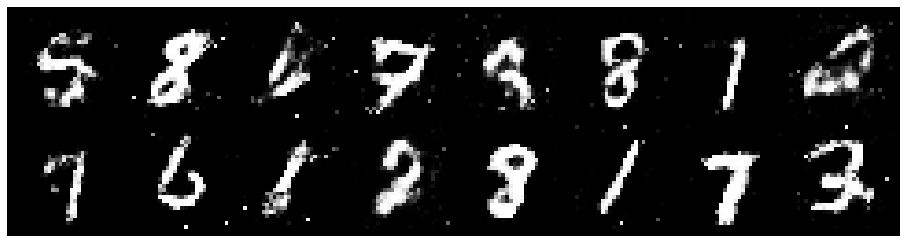

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.0678, Generator Loss: 0.9537
D(x): 0.6216, D(G(z)): 0.3975


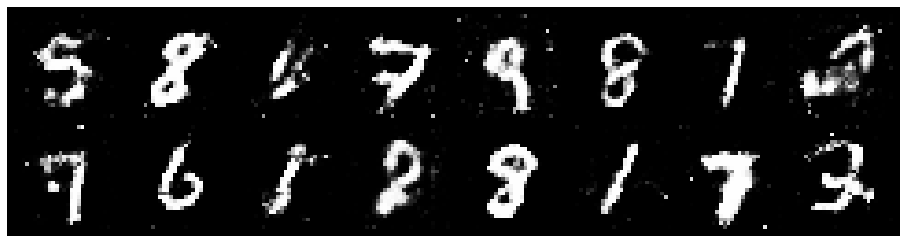

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.2950, Generator Loss: 1.1915
D(x): 0.5607, D(G(z)): 0.4098


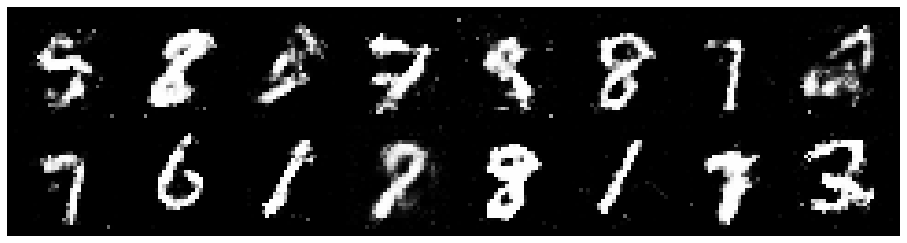

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.1804, Generator Loss: 1.0349
D(x): 0.6352, D(G(z)): 0.4417


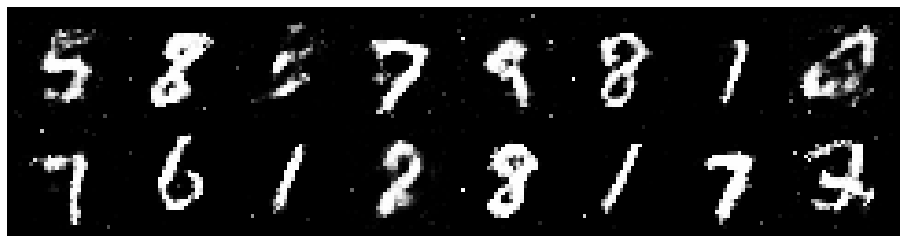

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.2119, Generator Loss: 1.0957
D(x): 0.5841, D(G(z)): 0.4266


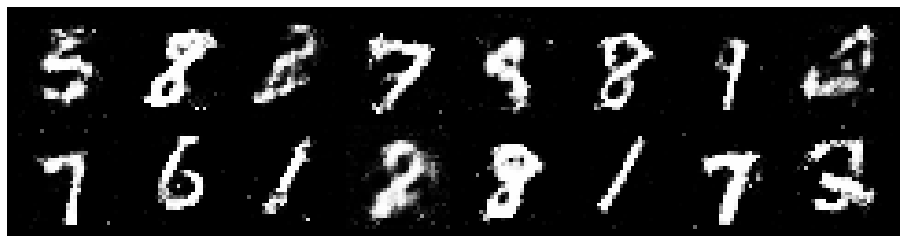

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.1370, Generator Loss: 1.0460
D(x): 0.6236, D(G(z)): 0.4011


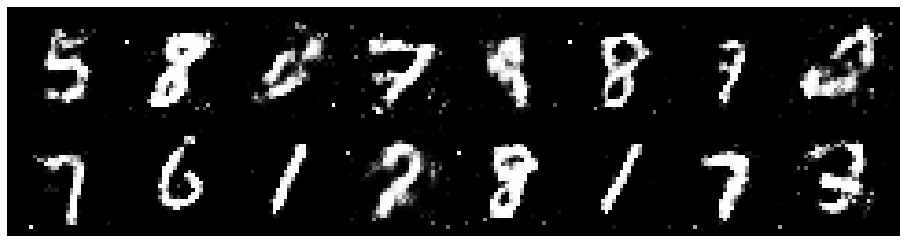

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.2043, Generator Loss: 1.2743
D(x): 0.5982, D(G(z)): 0.4258


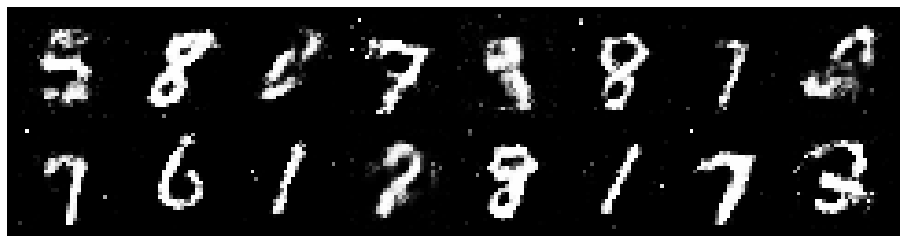

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.2481, Generator Loss: 0.9524
D(x): 0.5362, D(G(z)): 0.3903


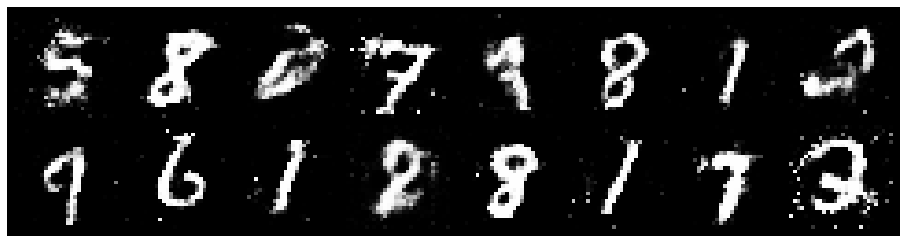

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.2831, Generator Loss: 1.1059
D(x): 0.5273, D(G(z)): 0.3926


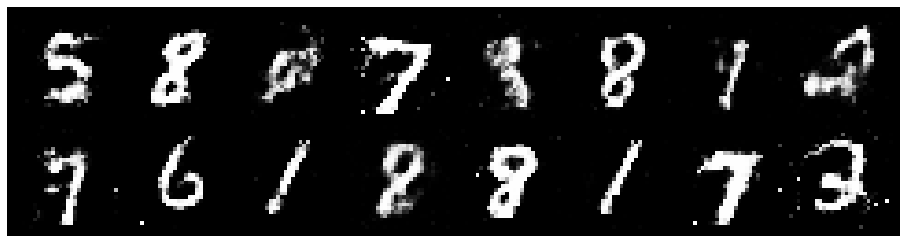

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.0229, Generator Loss: 1.1959
D(x): 0.6192, D(G(z)): 0.3487


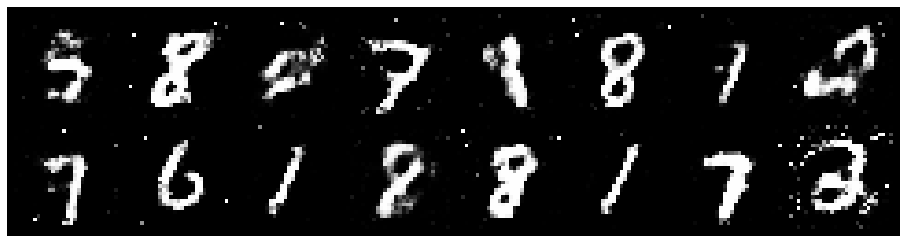

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.2648, Generator Loss: 0.9355
D(x): 0.5985, D(G(z)): 0.4616


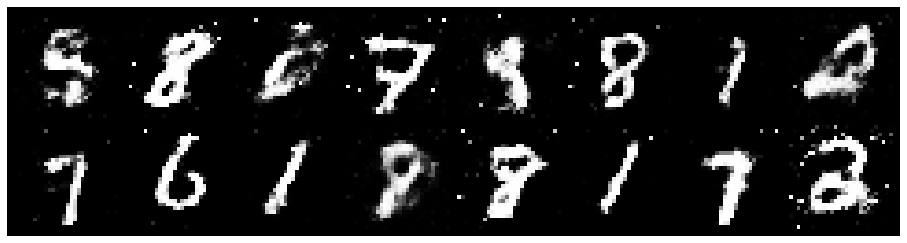

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.1840, Generator Loss: 1.0582
D(x): 0.6559, D(G(z)): 0.4423


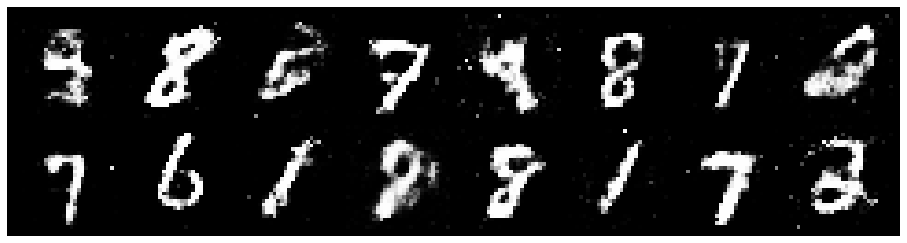

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.1975, Generator Loss: 0.9622
D(x): 0.5887, D(G(z)): 0.4354


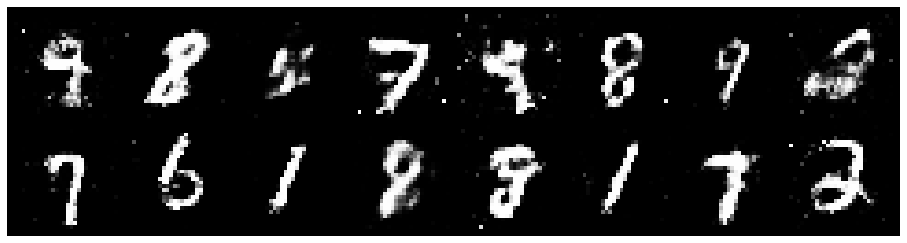

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.3685, Generator Loss: 0.8213
D(x): 0.5535, D(G(z)): 0.4841


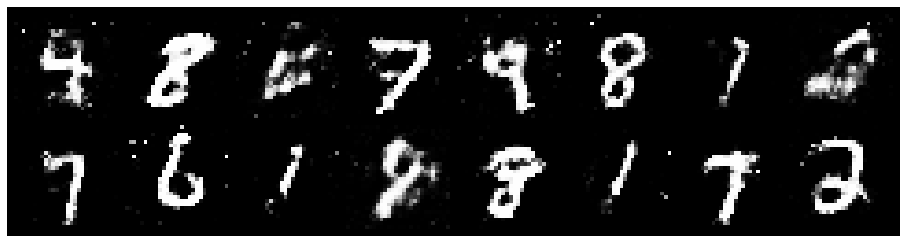

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.1840, Generator Loss: 1.2679
D(x): 0.5726, D(G(z)): 0.3707


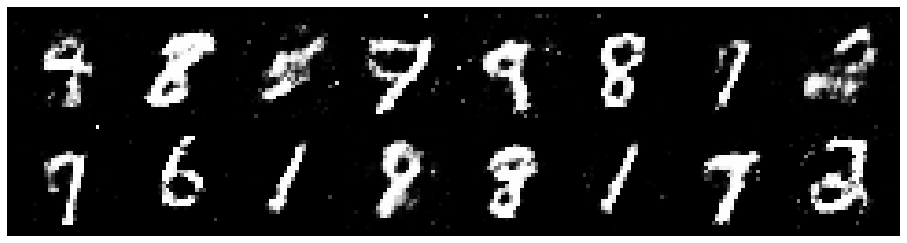

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.2188, Generator Loss: 0.9147
D(x): 0.6266, D(G(z)): 0.4388


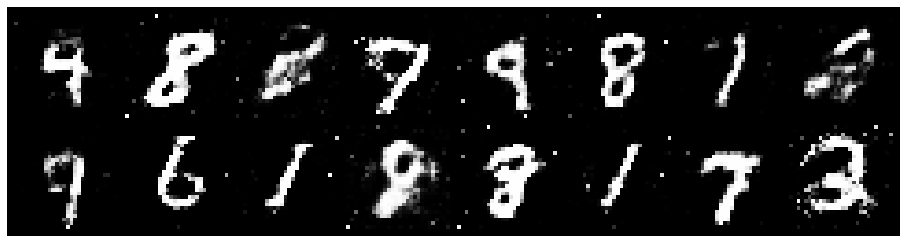

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.2739, Generator Loss: 1.0619
D(x): 0.6052, D(G(z)): 0.4426


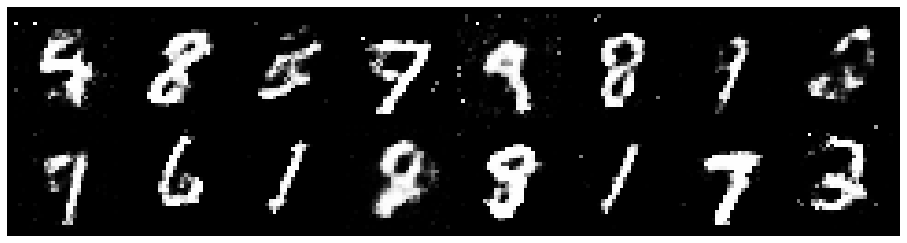

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.3739, Generator Loss: 0.9215
D(x): 0.5866, D(G(z)): 0.4896


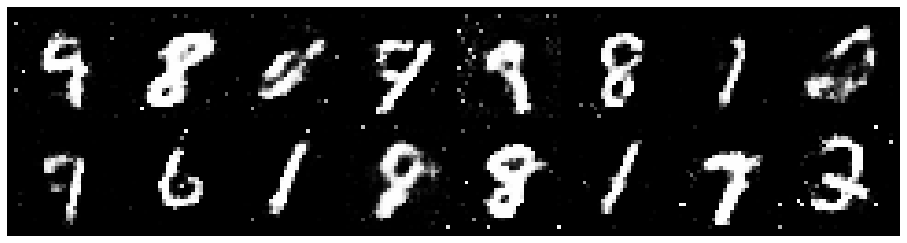

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.1834, Generator Loss: 1.1650
D(x): 0.5831, D(G(z)): 0.3707


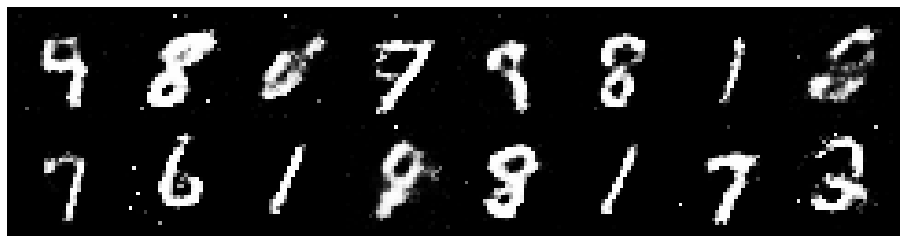

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.3110, Generator Loss: 0.9704
D(x): 0.5463, D(G(z)): 0.4194


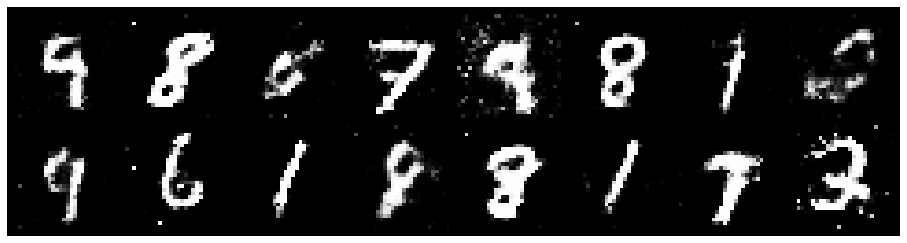

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.2408, Generator Loss: 1.1818
D(x): 0.5658, D(G(z)): 0.3724


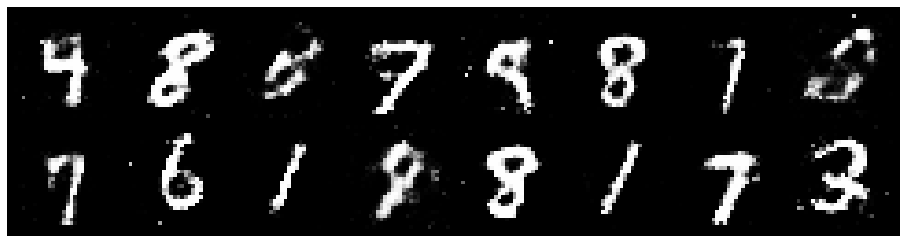

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.0401, Generator Loss: 1.2671
D(x): 0.6385, D(G(z)): 0.3878


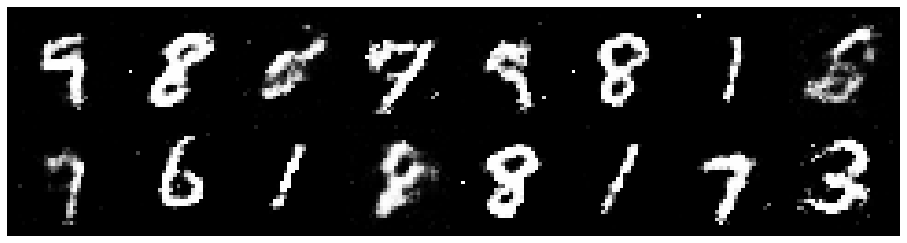

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.1756, Generator Loss: 0.9756
D(x): 0.5975, D(G(z)): 0.4179


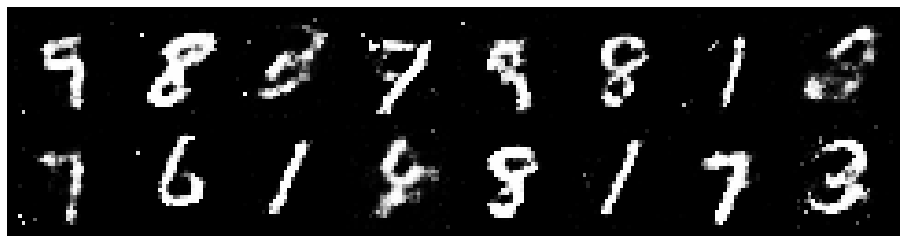

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.2564, Generator Loss: 0.9664
D(x): 0.5371, D(G(z)): 0.4269


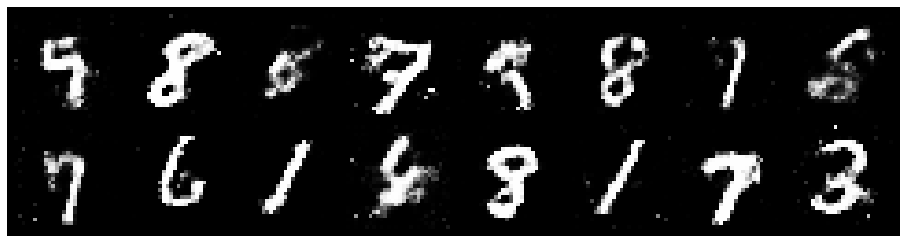

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.3697, Generator Loss: 0.9189
D(x): 0.5669, D(G(z)): 0.4578


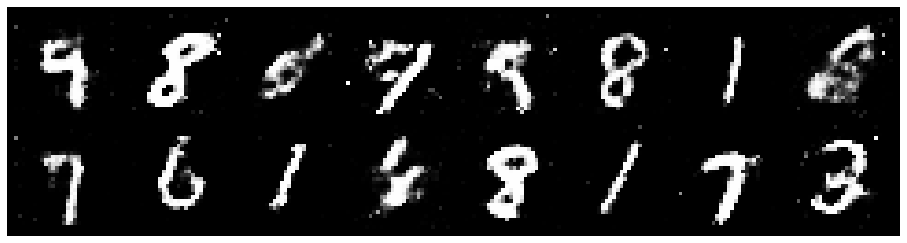

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.3843, Generator Loss: 1.1224
D(x): 0.5087, D(G(z)): 0.3818


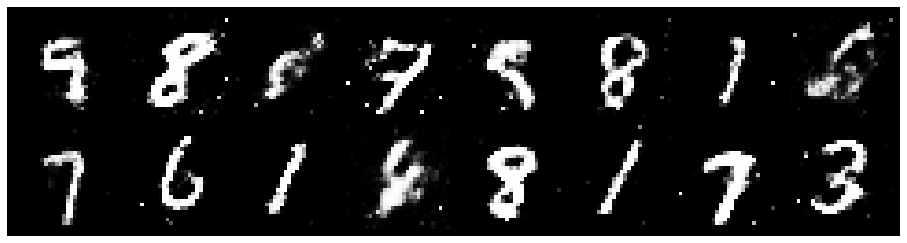

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.1225, Generator Loss: 1.1379
D(x): 0.6032, D(G(z)): 0.3711


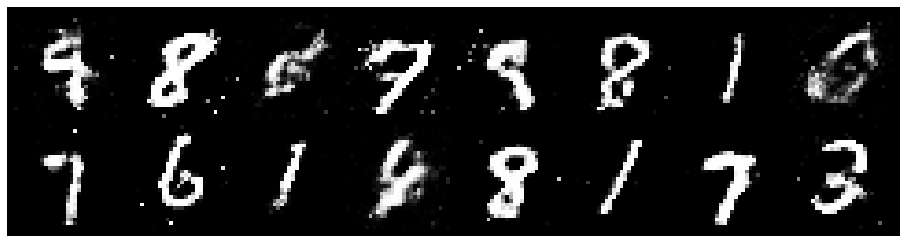

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.1077, Generator Loss: 1.1327
D(x): 0.5888, D(G(z)): 0.3699


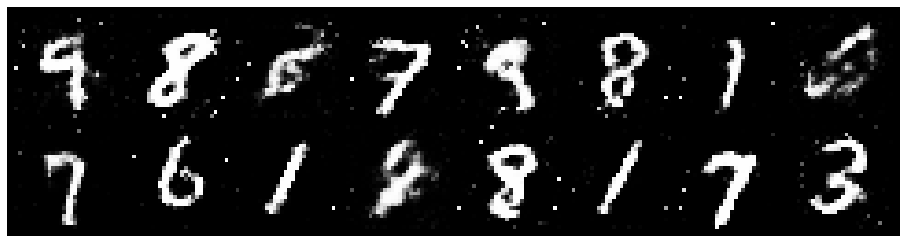

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.2336, Generator Loss: 0.9612
D(x): 0.5957, D(G(z)): 0.4363


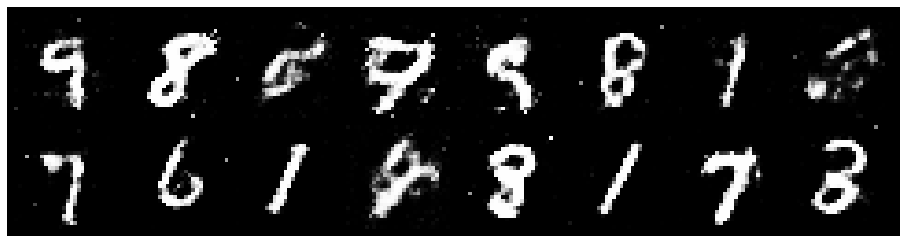

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.2255, Generator Loss: 0.8955
D(x): 0.5817, D(G(z)): 0.4567


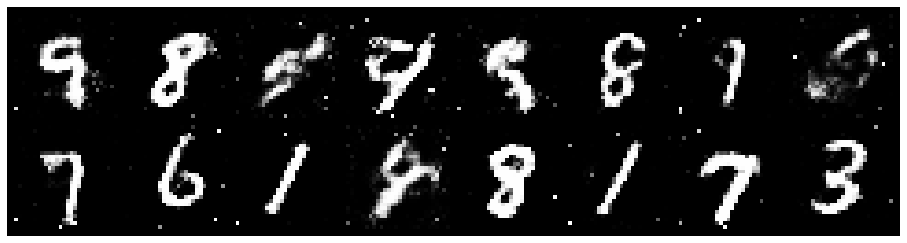

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.2832, Generator Loss: 0.9932
D(x): 0.6420, D(G(z)): 0.4595


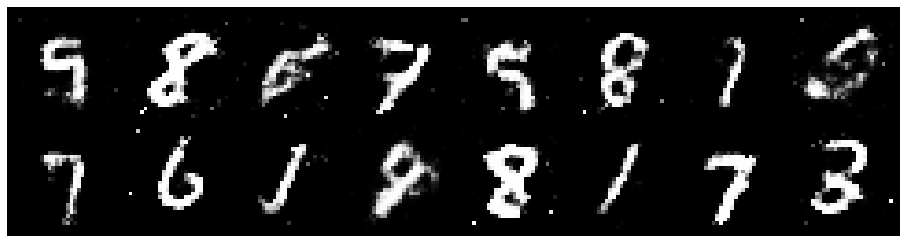

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.0290, Generator Loss: 1.0464
D(x): 0.6199, D(G(z)): 0.3378


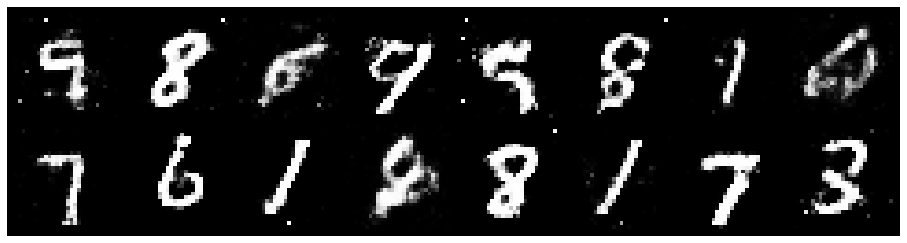

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.1540, Generator Loss: 1.1454
D(x): 0.5550, D(G(z)): 0.3708


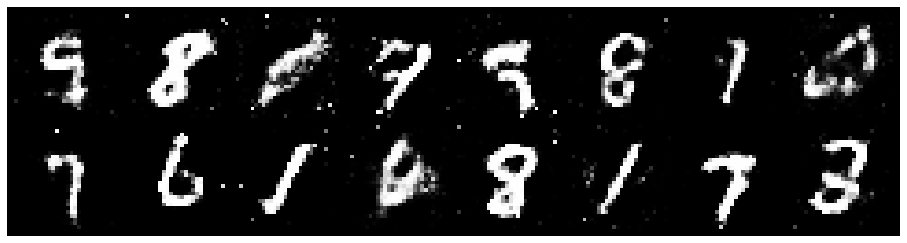

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.2240, Generator Loss: 0.9411
D(x): 0.5860, D(G(z)): 0.4436


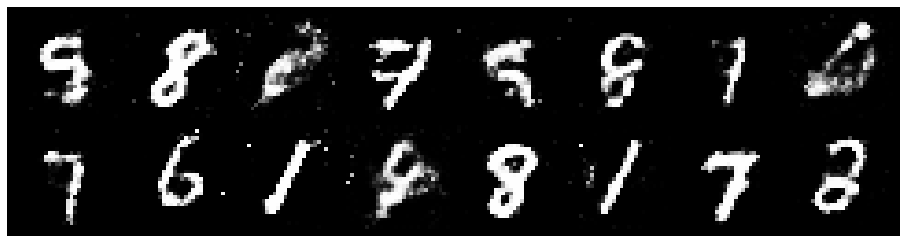

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.2535, Generator Loss: 0.9744
D(x): 0.5387, D(G(z)): 0.4102


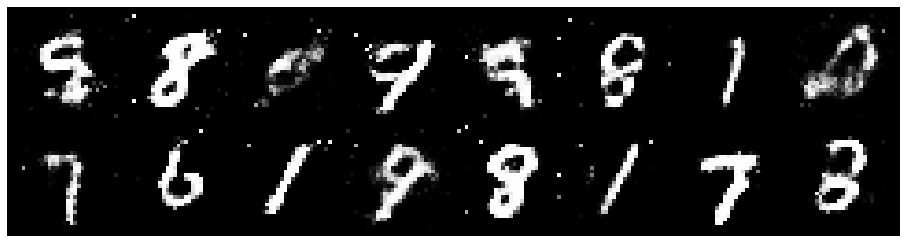

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.4598, Generator Loss: 0.8475
D(x): 0.5823, D(G(z)): 0.4918


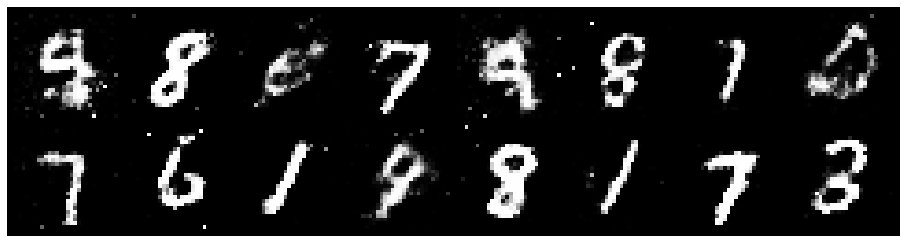

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.2191, Generator Loss: 0.9999
D(x): 0.6205, D(G(z)): 0.4444


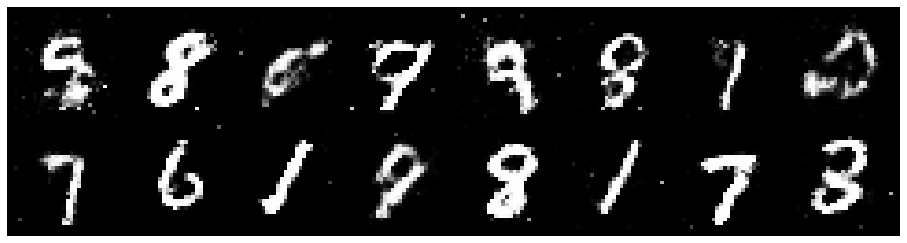

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.2434, Generator Loss: 0.9252
D(x): 0.5598, D(G(z)): 0.4399


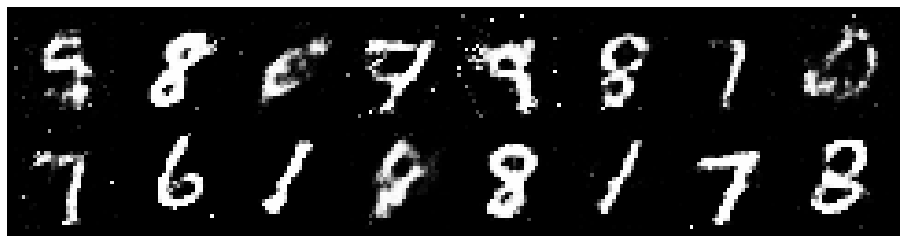

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.2604, Generator Loss: 0.9517
D(x): 0.5418, D(G(z)): 0.4233


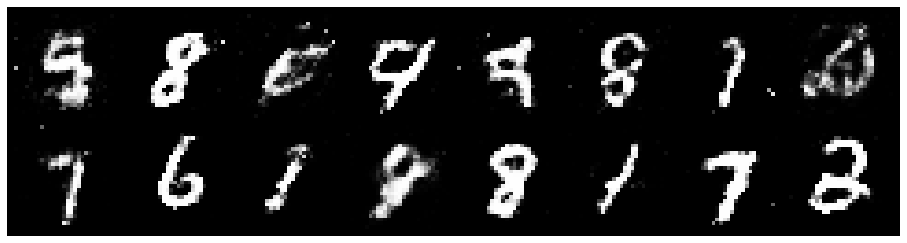

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.3477, Generator Loss: 0.9395
D(x): 0.4928, D(G(z)): 0.4118


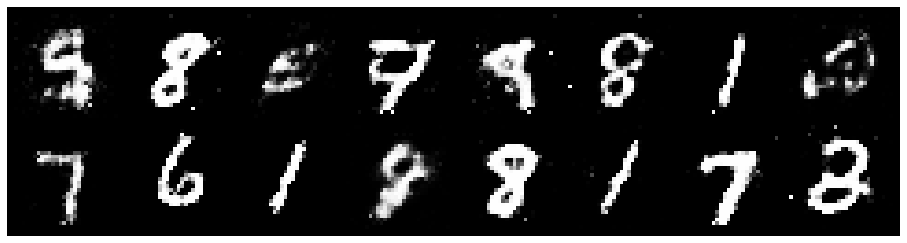

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.3935, Generator Loss: 1.0439
D(x): 0.5144, D(G(z)): 0.4411


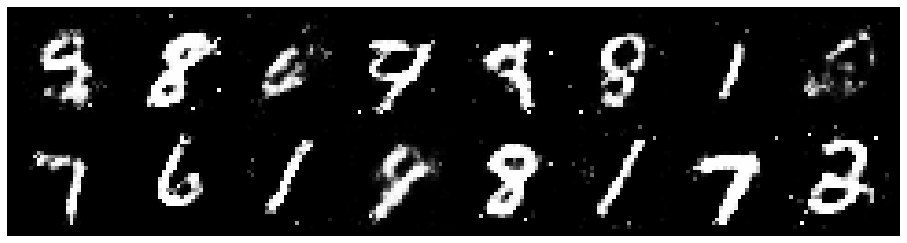

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.2794, Generator Loss: 1.0006
D(x): 0.5284, D(G(z)): 0.3845


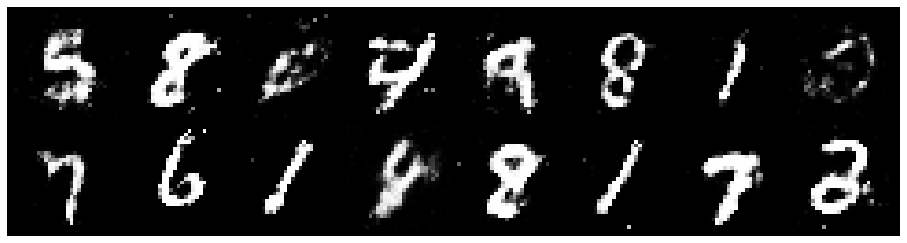

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.2972, Generator Loss: 0.8651
D(x): 0.5437, D(G(z)): 0.4481


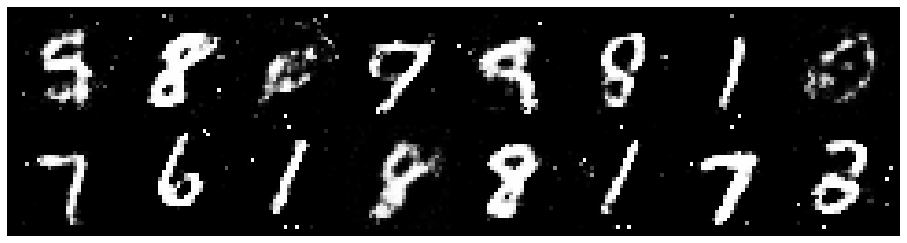

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.2363, Generator Loss: 0.8371
D(x): 0.6029, D(G(z)): 0.4500


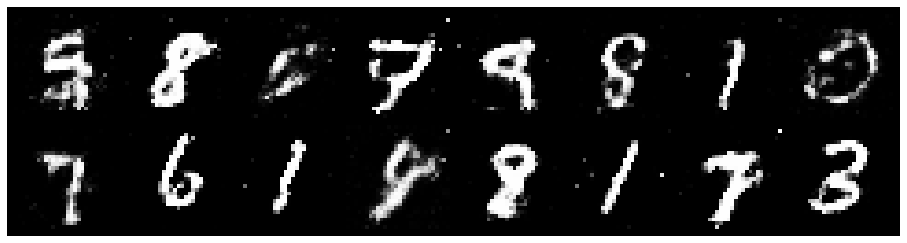

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.2770, Generator Loss: 1.0208
D(x): 0.6165, D(G(z)): 0.4562


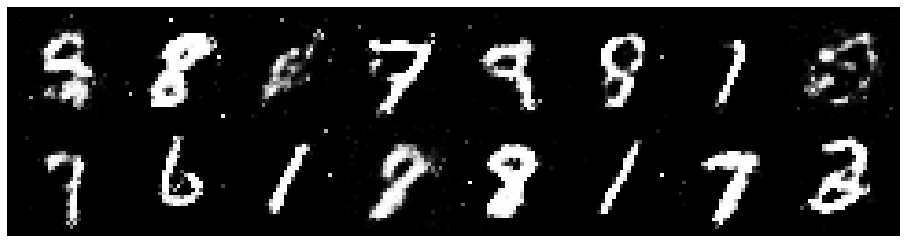

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.1393, Generator Loss: 1.1369
D(x): 0.5837, D(G(z)): 0.3654


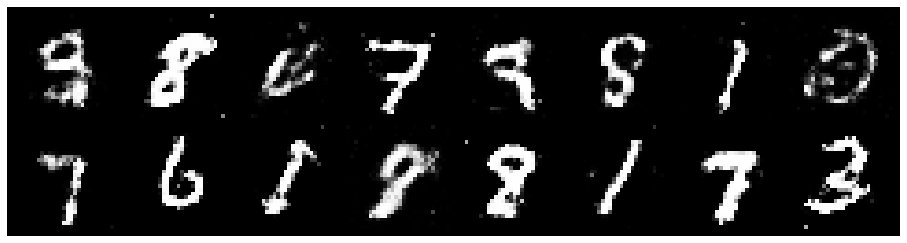

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.1043, Generator Loss: 0.9981
D(x): 0.6114, D(G(z)): 0.3926


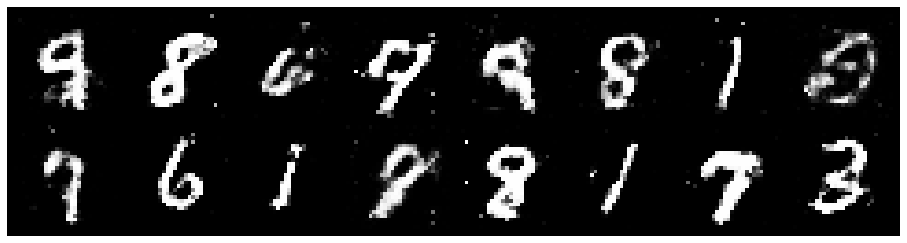

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.1577, Generator Loss: 1.0137
D(x): 0.5836, D(G(z)): 0.4106


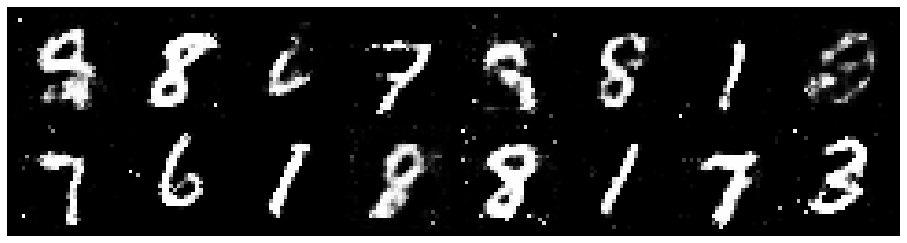

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.2499, Generator Loss: 0.9779
D(x): 0.5464, D(G(z)): 0.4246


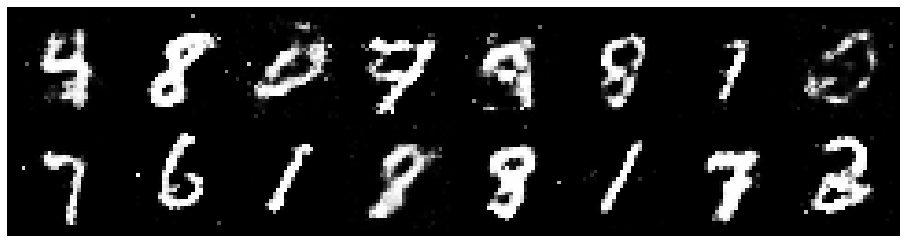

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.3456, Generator Loss: 0.8525
D(x): 0.5397, D(G(z)): 0.4627


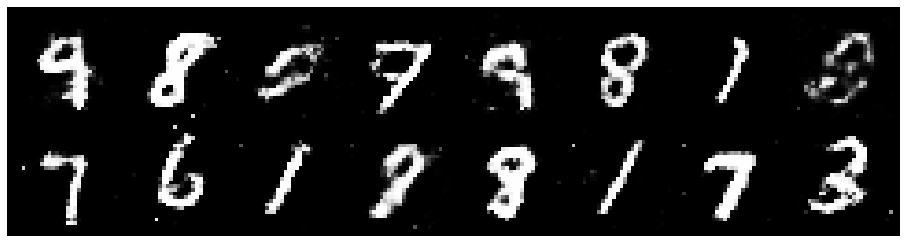

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.3353, Generator Loss: 0.7968
D(x): 0.5998, D(G(z)): 0.5095


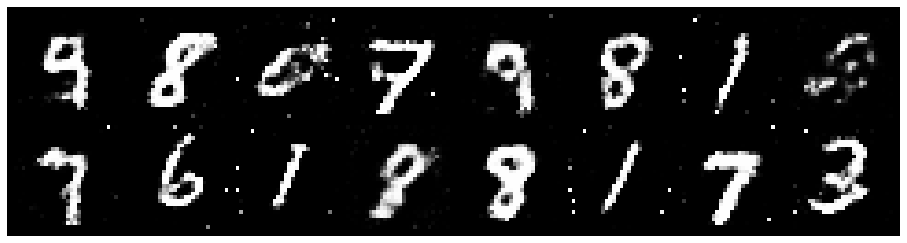

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.3334, Generator Loss: 0.9745
D(x): 0.5162, D(G(z)): 0.4164


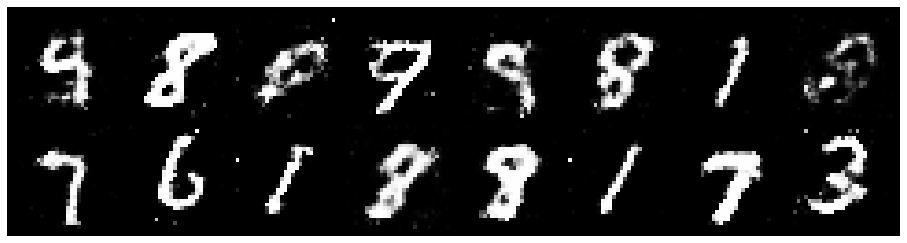

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.0500, Generator Loss: 1.1598
D(x): 0.6239, D(G(z)): 0.3638


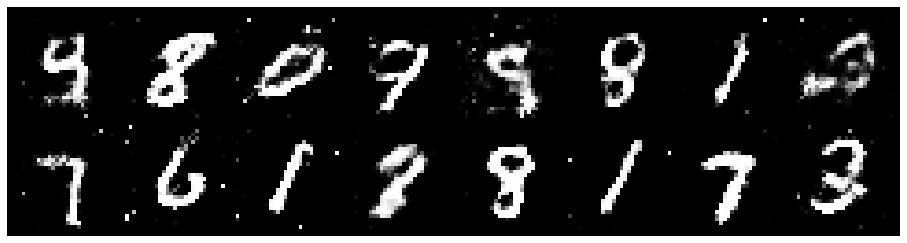

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.1915, Generator Loss: 1.0554
D(x): 0.5956, D(G(z)): 0.4182


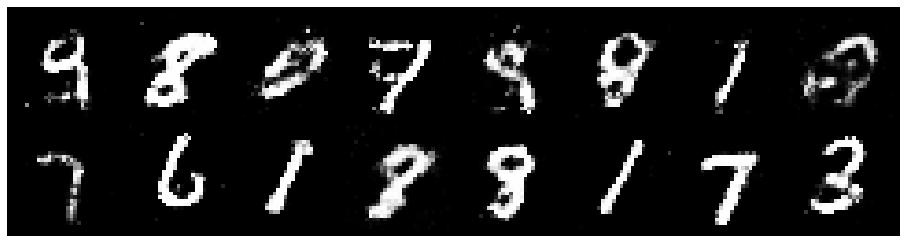

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.2724, Generator Loss: 0.8849
D(x): 0.5645, D(G(z)): 0.4467


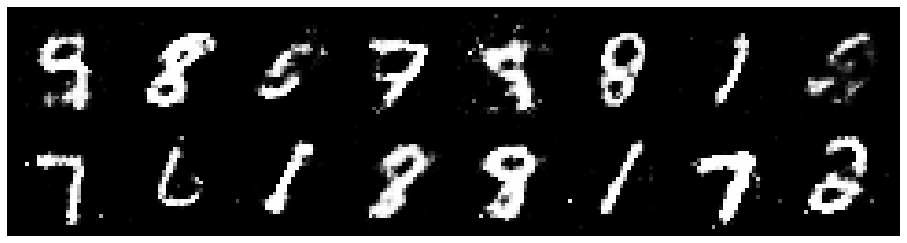

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.2360, Generator Loss: 0.9352
D(x): 0.5611, D(G(z)): 0.4420


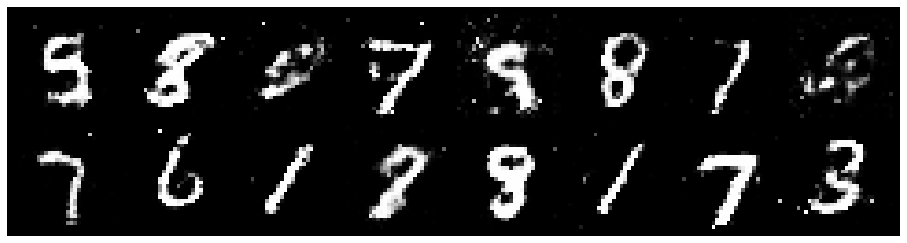

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.4564, Generator Loss: 0.9222
D(x): 0.4971, D(G(z)): 0.4621


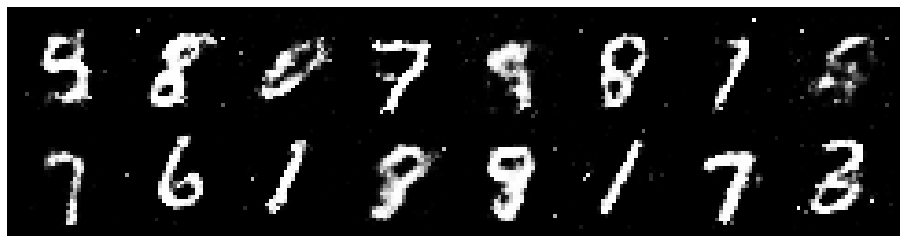

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.1392, Generator Loss: 0.9973
D(x): 0.5983, D(G(z)): 0.4044


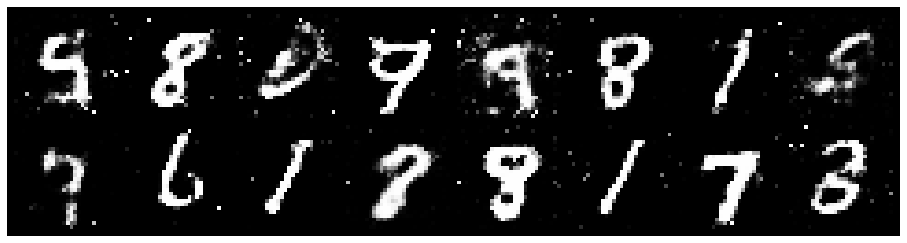

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.1296, Generator Loss: 1.3096
D(x): 0.5910, D(G(z)): 0.3592


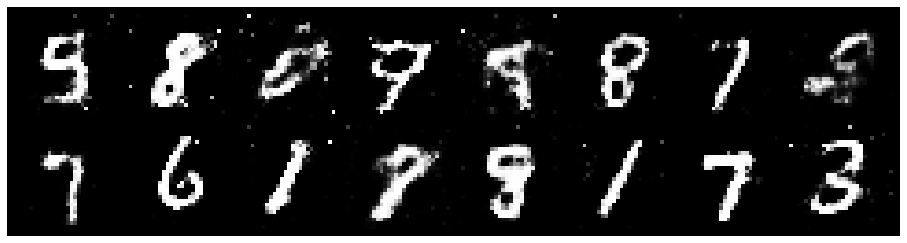

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.1137, Generator Loss: 1.3419
D(x): 0.5666, D(G(z)): 0.3405


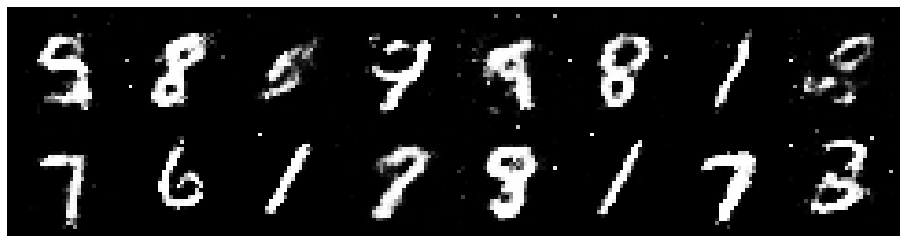

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.1183, Generator Loss: 1.0118
D(x): 0.5900, D(G(z)): 0.3937


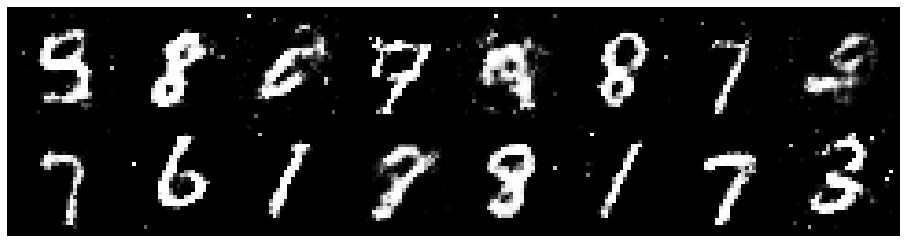

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.1772, Generator Loss: 1.1819
D(x): 0.5999, D(G(z)): 0.4152


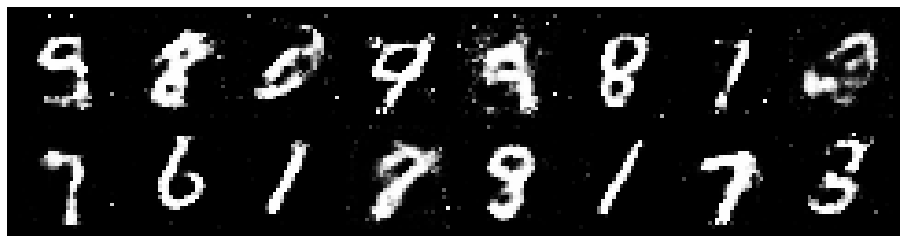

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.2176, Generator Loss: 0.9628
D(x): 0.6095, D(G(z)): 0.4570


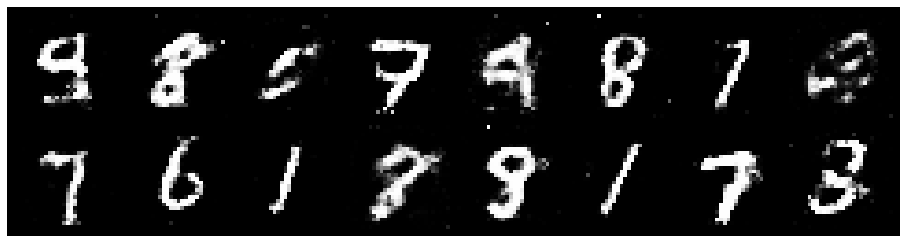

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.2424, Generator Loss: 0.8799
D(x): 0.6043, D(G(z)): 0.4793


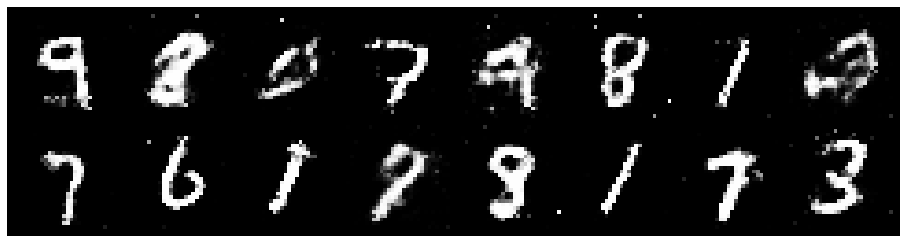

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.3095, Generator Loss: 0.8939
D(x): 0.5416, D(G(z)): 0.4580


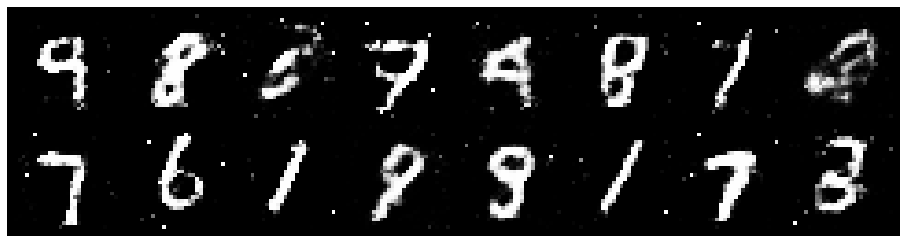

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.2333, Generator Loss: 0.9763
D(x): 0.5204, D(G(z)): 0.3668


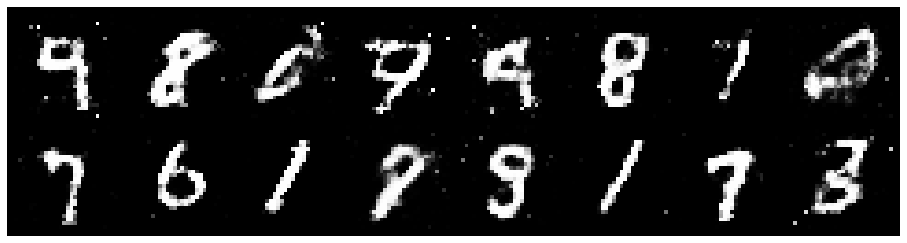

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.2774, Generator Loss: 0.8492
D(x): 0.5508, D(G(z)): 0.4406


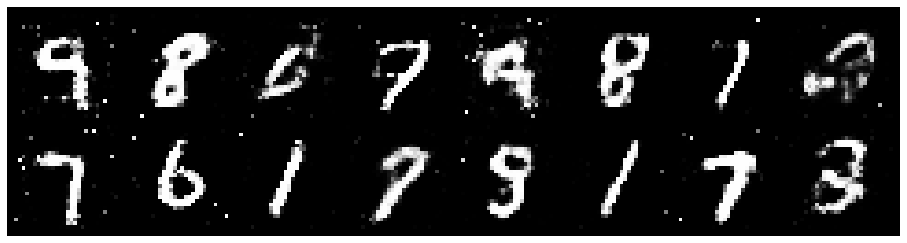

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.3193, Generator Loss: 0.9777
D(x): 0.5851, D(G(z)): 0.4690


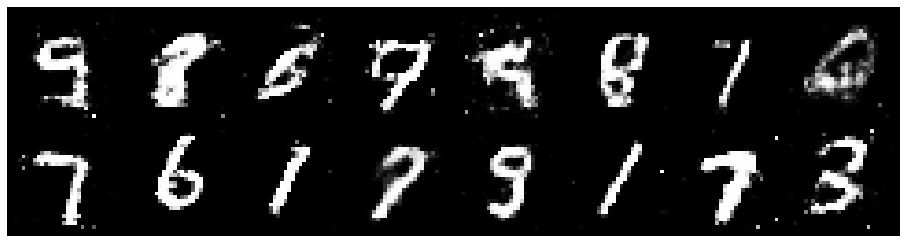

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.2786, Generator Loss: 1.0737
D(x): 0.5715, D(G(z)): 0.4058


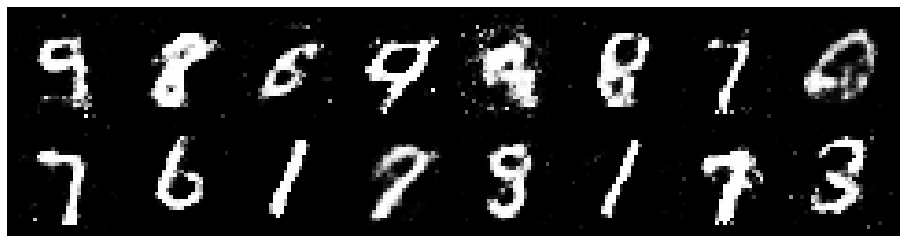

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.3653, Generator Loss: 1.0756
D(x): 0.5489, D(G(z)): 0.4410


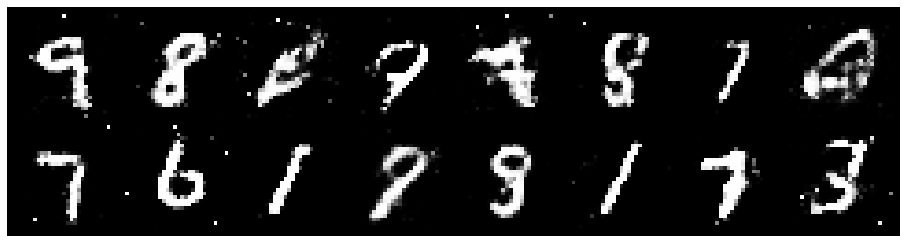

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.0358, Generator Loss: 1.1463
D(x): 0.6242, D(G(z)): 0.3691


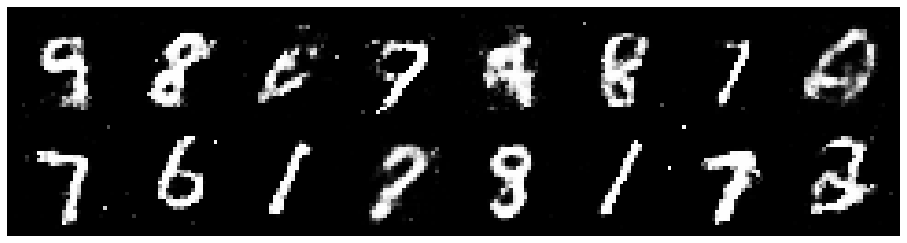

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.1673, Generator Loss: 1.0674
D(x): 0.5743, D(G(z)): 0.3984


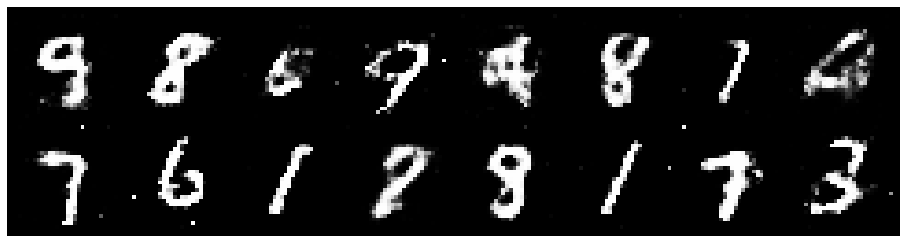

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.1214, Generator Loss: 1.0276
D(x): 0.5842, D(G(z)): 0.3836


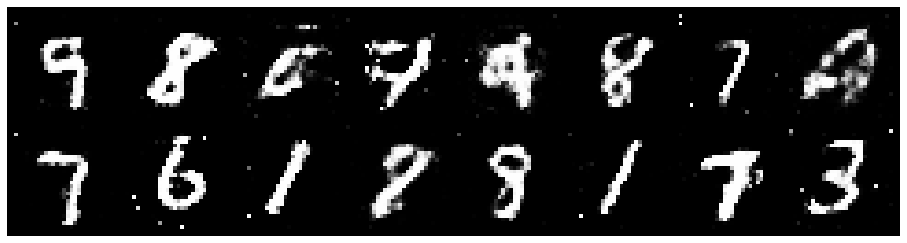

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.2341, Generator Loss: 0.9587
D(x): 0.5578, D(G(z)): 0.4136


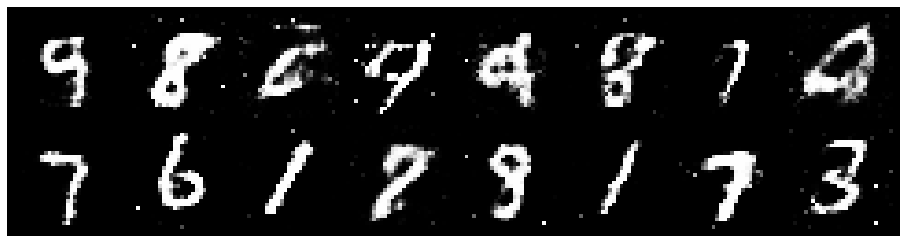

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.1237, Generator Loss: 0.9727
D(x): 0.6354, D(G(z)): 0.4216


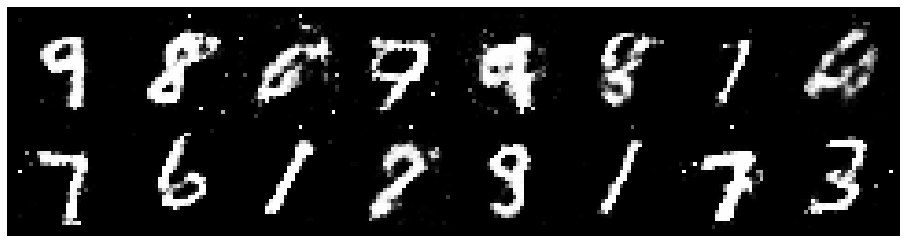

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.3497, Generator Loss: 0.8774
D(x): 0.5683, D(G(z)): 0.4819


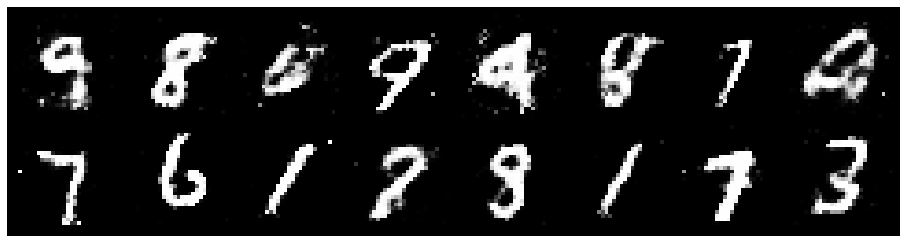

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.2336, Generator Loss: 0.9799
D(x): 0.5436, D(G(z)): 0.4017


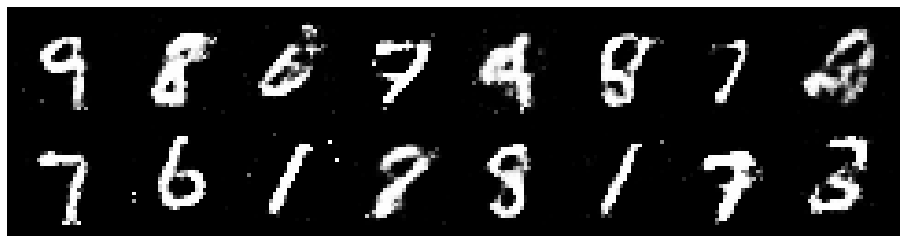

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.1153, Generator Loss: 1.0906
D(x): 0.6833, D(G(z)): 0.4510


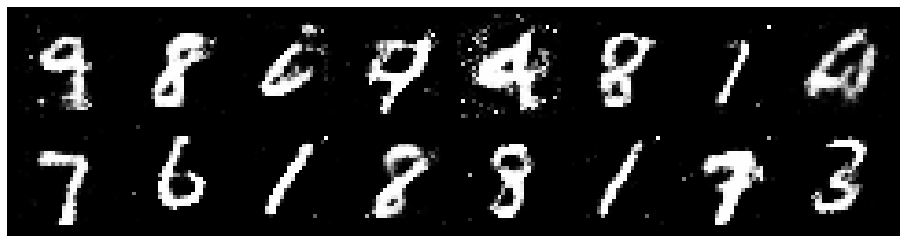

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.0450, Generator Loss: 1.0687
D(x): 0.5986, D(G(z)): 0.3567


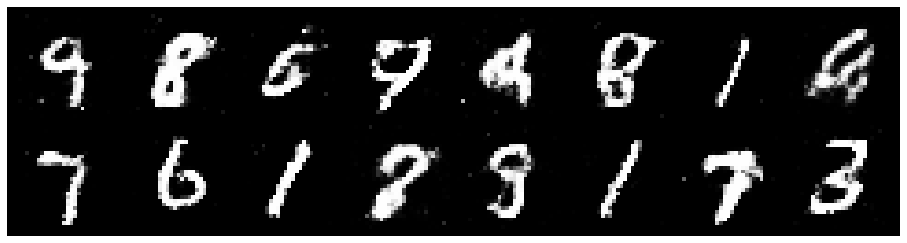

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.1500, Generator Loss: 1.0213
D(x): 0.5611, D(G(z)): 0.3853


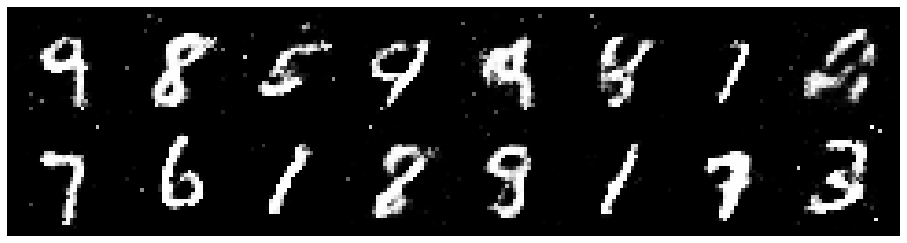

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.2154, Generator Loss: 0.8643
D(x): 0.5617, D(G(z)): 0.4249


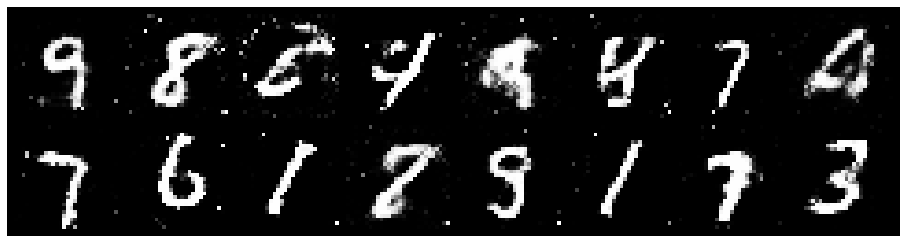

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.1955, Generator Loss: 0.9869
D(x): 0.5458, D(G(z)): 0.3850


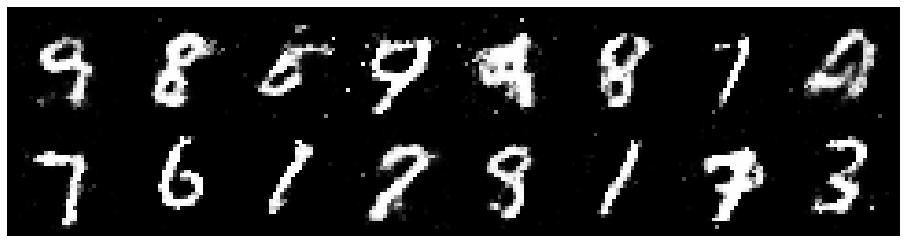

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.2673, Generator Loss: 1.1457
D(x): 0.5740, D(G(z)): 0.3918


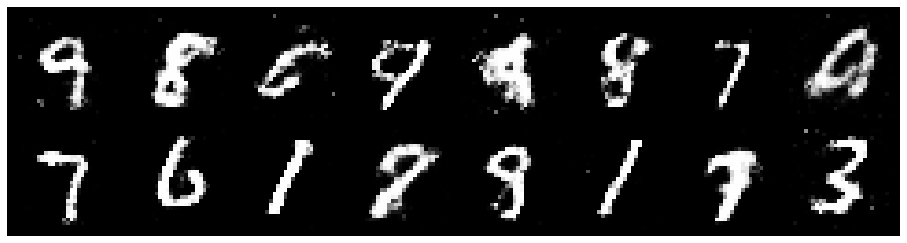

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.3404, Generator Loss: 1.1376
D(x): 0.5403, D(G(z)): 0.4312


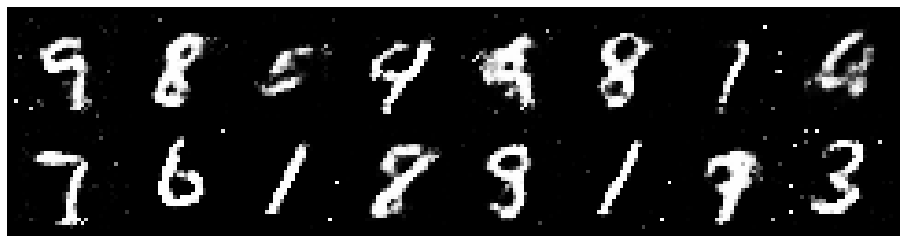

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.0901, Generator Loss: 1.0438
D(x): 0.5755, D(G(z)): 0.3742


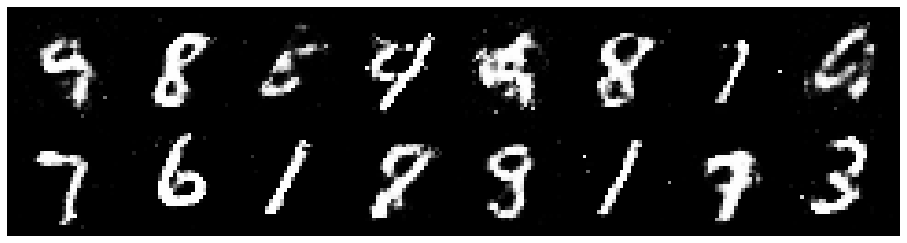

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.1997, Generator Loss: 1.1606
D(x): 0.6083, D(G(z)): 0.3950


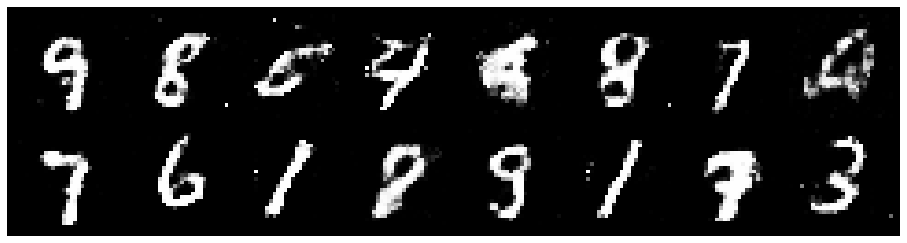

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.1294, Generator Loss: 0.9352
D(x): 0.6368, D(G(z)): 0.4324


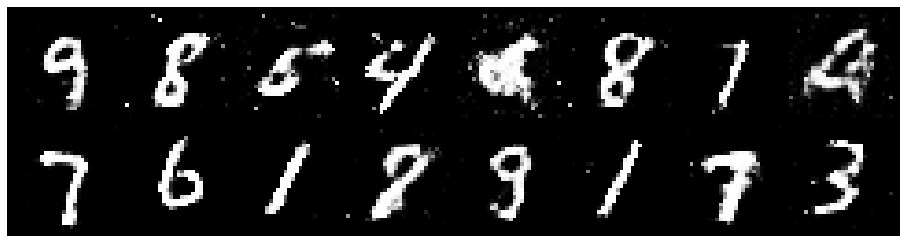

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.1114, Generator Loss: 0.9650
D(x): 0.6182, D(G(z)): 0.4034


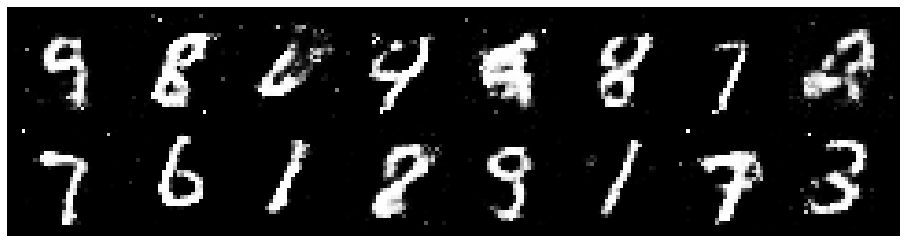

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.1455, Generator Loss: 0.9514
D(x): 0.6074, D(G(z)): 0.4067


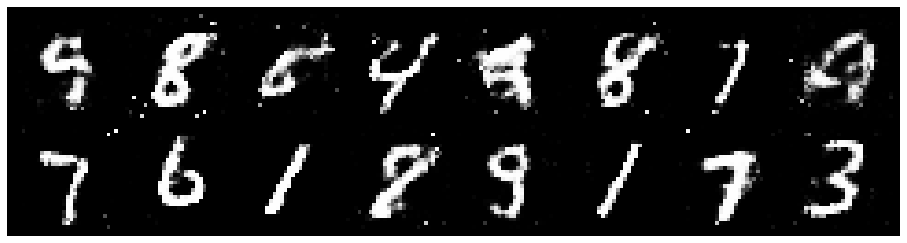

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.2404, Generator Loss: 1.0077
D(x): 0.6151, D(G(z)): 0.4454


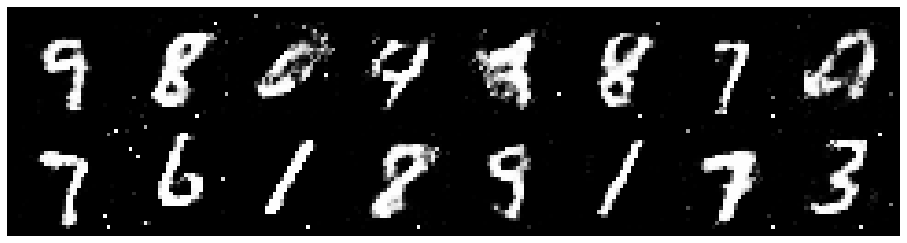

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.2362, Generator Loss: 1.0244
D(x): 0.5832, D(G(z)): 0.4281


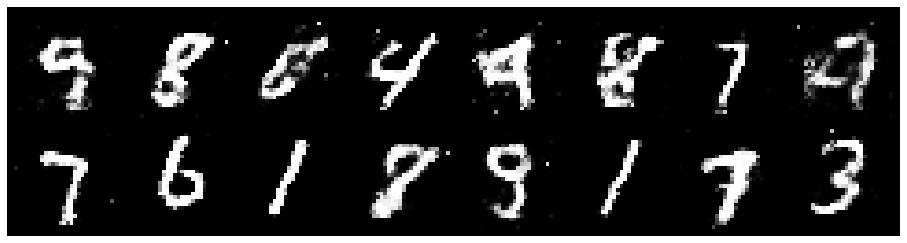

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.1874, Generator Loss: 0.8880
D(x): 0.5986, D(G(z)): 0.4386


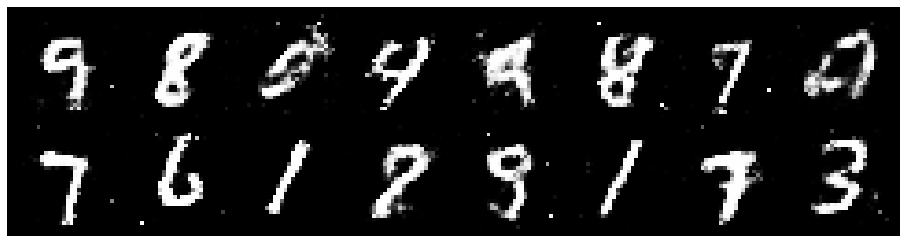

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.2854, Generator Loss: 1.0265
D(x): 0.5559, D(G(z)): 0.4272


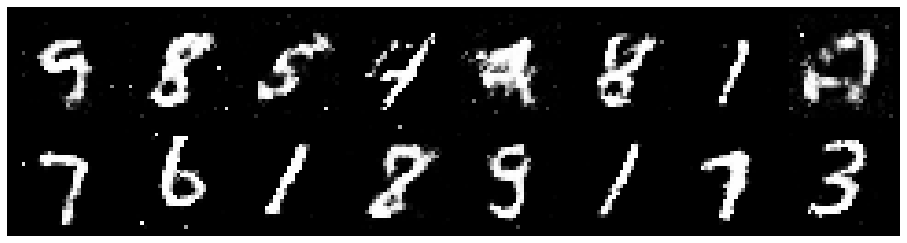

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.2626, Generator Loss: 0.9921
D(x): 0.5437, D(G(z)): 0.4162


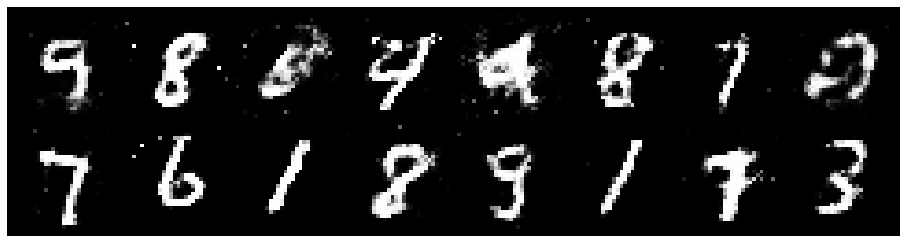

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.3853, Generator Loss: 0.8349
D(x): 0.5405, D(G(z)): 0.4790


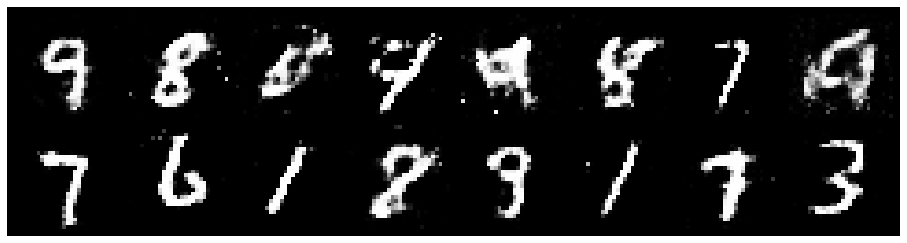

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.3659, Generator Loss: 0.8575
D(x): 0.5815, D(G(z)): 0.4821


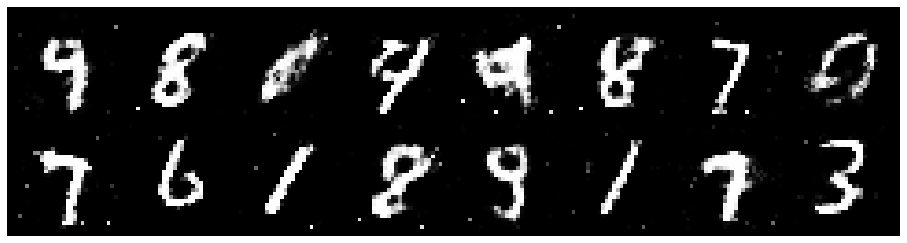

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.3073, Generator Loss: 1.0308
D(x): 0.5912, D(G(z)): 0.4388


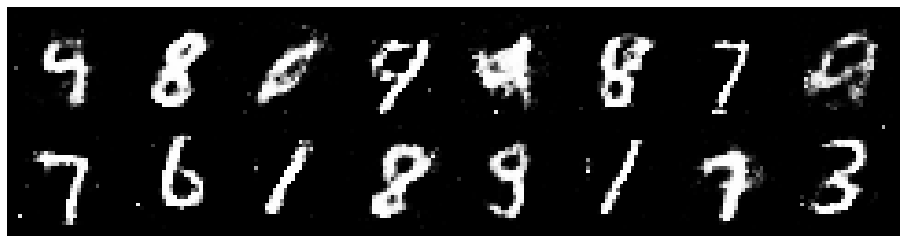

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.3274, Generator Loss: 1.1454
D(x): 0.5868, D(G(z)): 0.4453


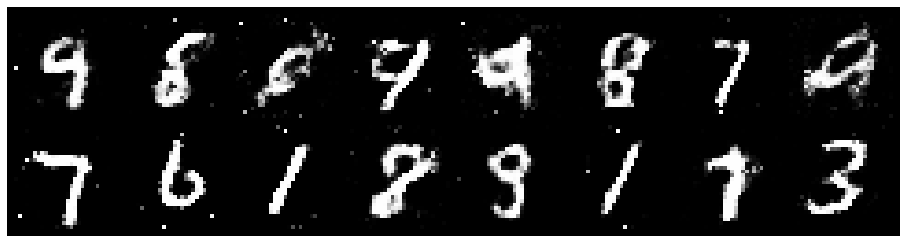

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.1493, Generator Loss: 0.9532
D(x): 0.5856, D(G(z)): 0.4003


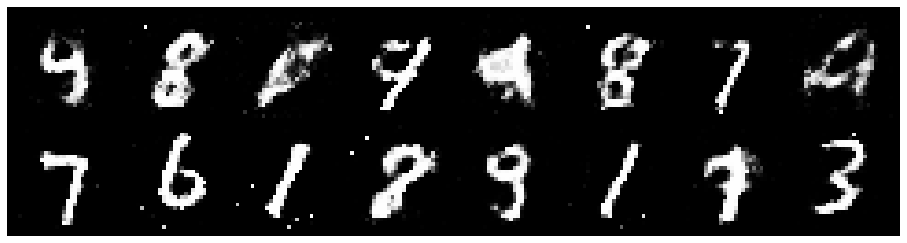

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.1986, Generator Loss: 1.0403
D(x): 0.5487, D(G(z)): 0.3818


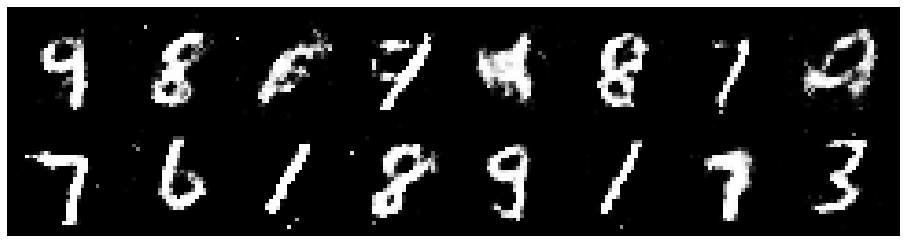

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.2940, Generator Loss: 0.9267
D(x): 0.5830, D(G(z)): 0.4518


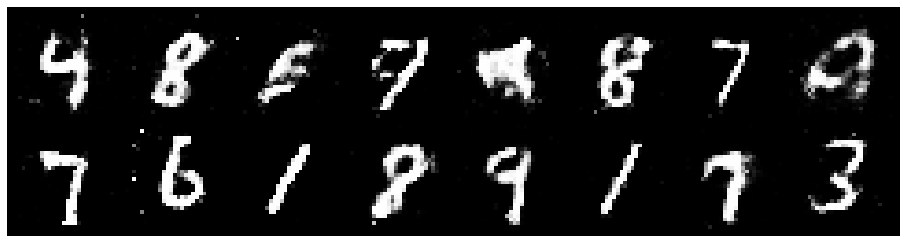

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.2768, Generator Loss: 0.9691
D(x): 0.5704, D(G(z)): 0.4515


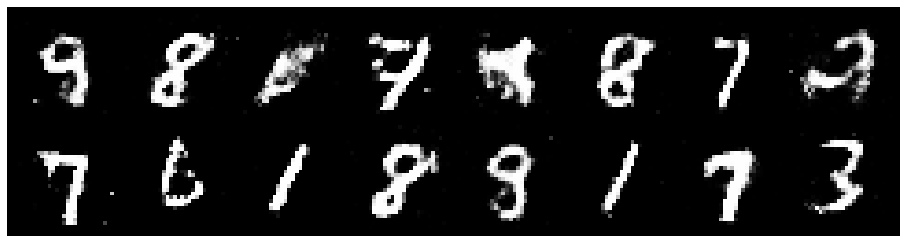

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.4366, Generator Loss: 0.9840
D(x): 0.4593, D(G(z)): 0.3767


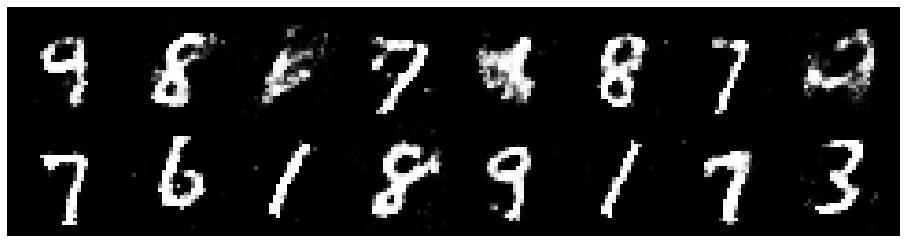

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.1809, Generator Loss: 1.1407
D(x): 0.5929, D(G(z)): 0.3930


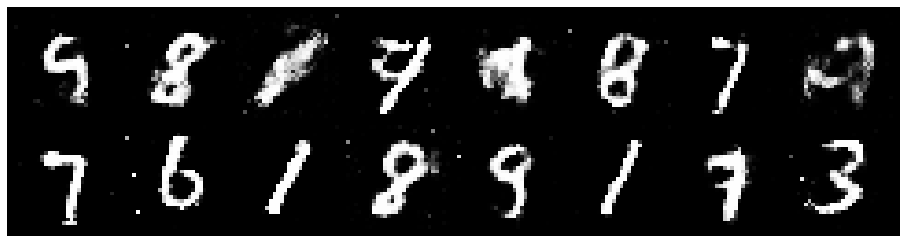

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.2593, Generator Loss: 1.1084
D(x): 0.5498, D(G(z)): 0.3857


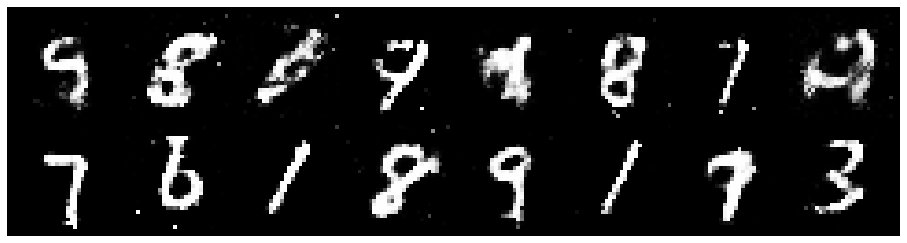

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.1684, Generator Loss: 0.9719
D(x): 0.5963, D(G(z)): 0.4288


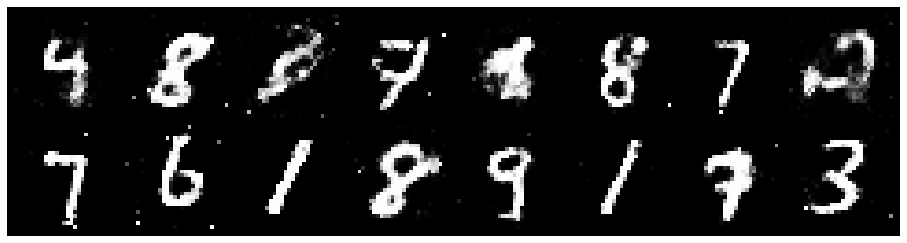

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.2582, Generator Loss: 0.9705
D(x): 0.5589, D(G(z)): 0.4271


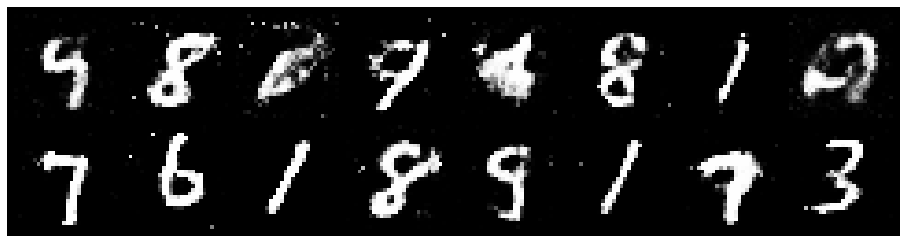

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.2828, Generator Loss: 0.9062
D(x): 0.5733, D(G(z)): 0.4477


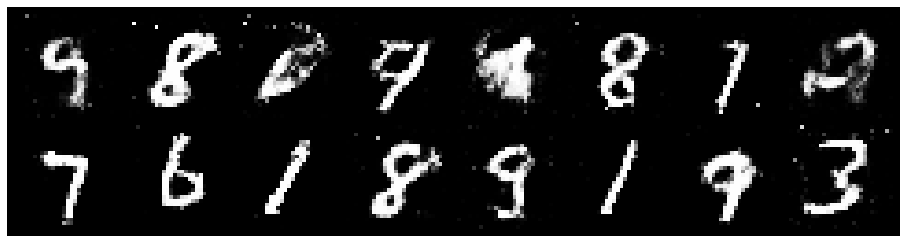

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.2194, Generator Loss: 0.9131
D(x): 0.6020, D(G(z)): 0.4641


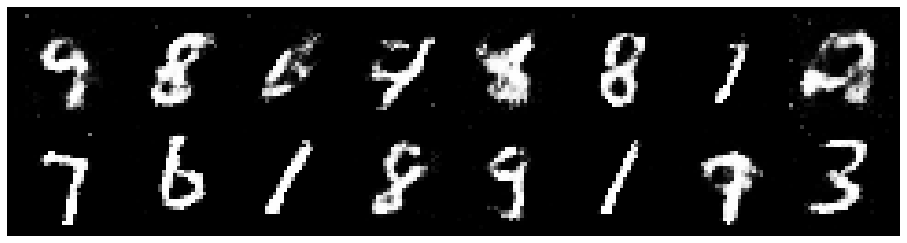

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.2544, Generator Loss: 0.8300
D(x): 0.6182, D(G(z)): 0.4828


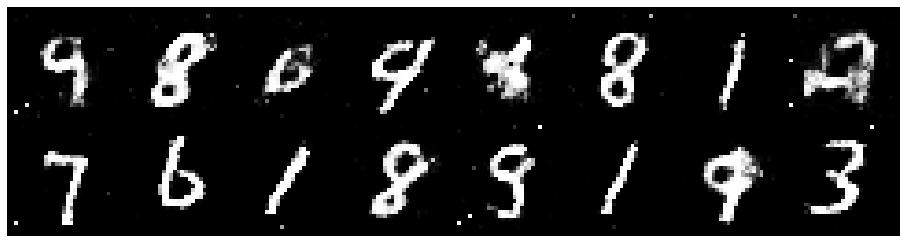

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.3148, Generator Loss: 1.0133
D(x): 0.5433, D(G(z)): 0.4381


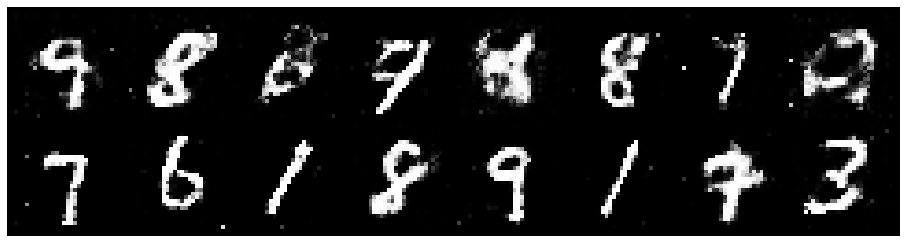

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.0862, Generator Loss: 1.0085
D(x): 0.6026, D(G(z)): 0.3862


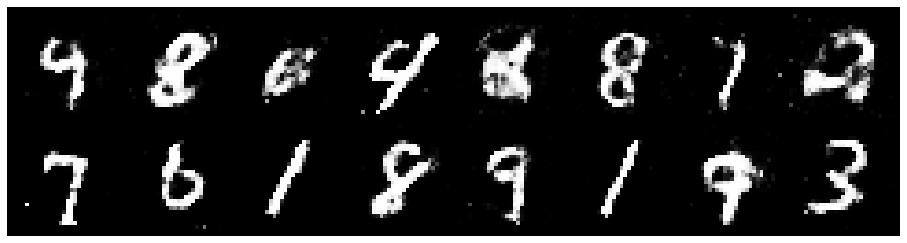

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.3051, Generator Loss: 0.8369
D(x): 0.5685, D(G(z)): 0.4655


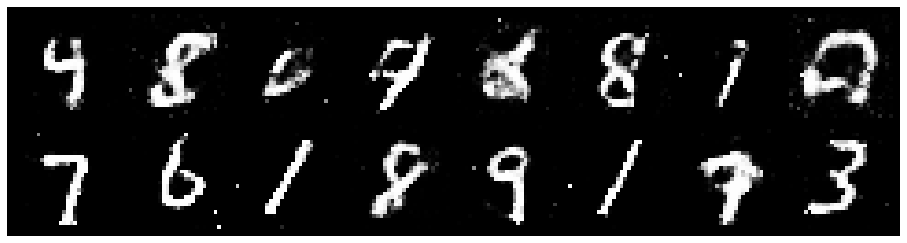

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.2193, Generator Loss: 0.8837
D(x): 0.5687, D(G(z)): 0.4341


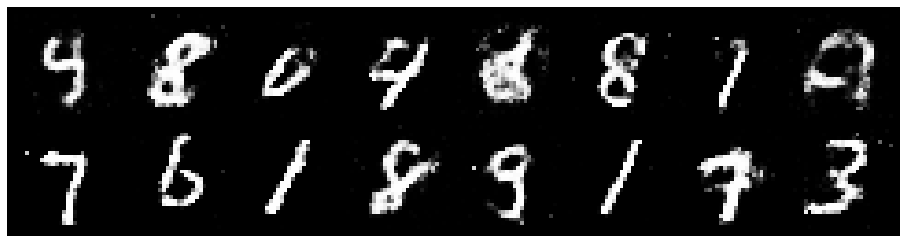

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.1745, Generator Loss: 0.8506
D(x): 0.6723, D(G(z)): 0.4727


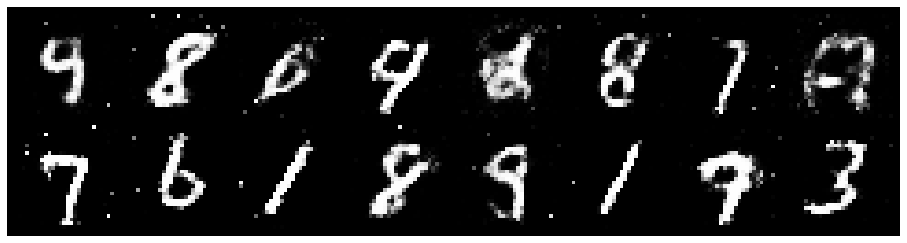

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2885, Generator Loss: 1.0463
D(x): 0.5362, D(G(z)): 0.4193


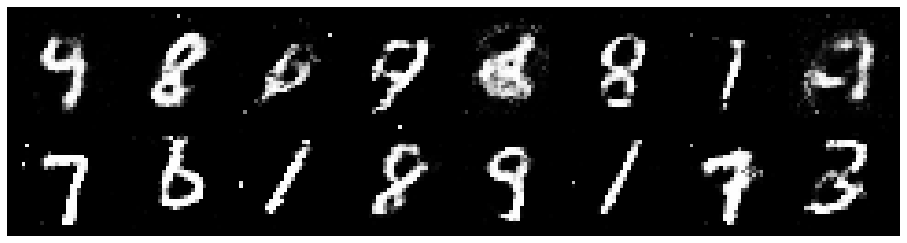

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.2201, Generator Loss: 1.1264
D(x): 0.5551, D(G(z)): 0.3845


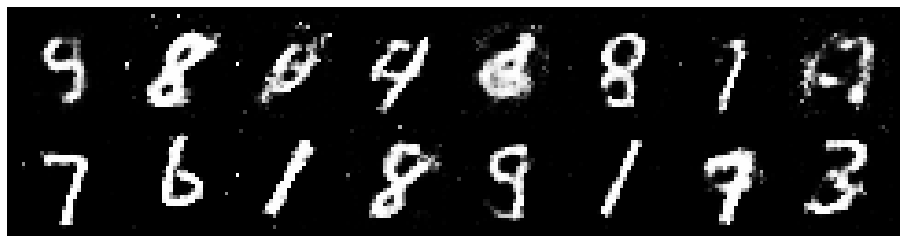

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.2906, Generator Loss: 1.0100
D(x): 0.5293, D(G(z)): 0.4072


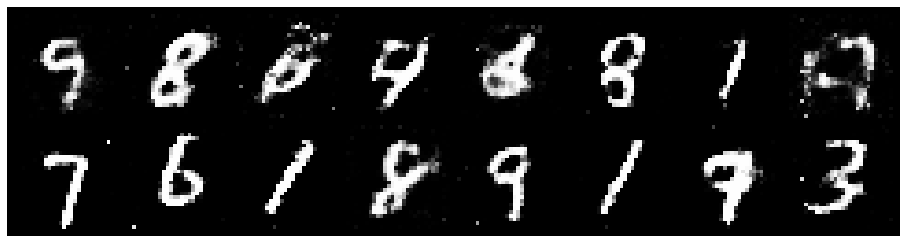

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.1379, Generator Loss: 1.1302
D(x): 0.5875, D(G(z)): 0.3779


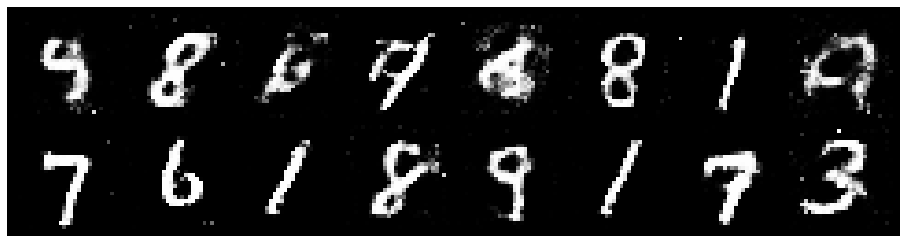

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.2384, Generator Loss: 0.9862
D(x): 0.5366, D(G(z)): 0.3817


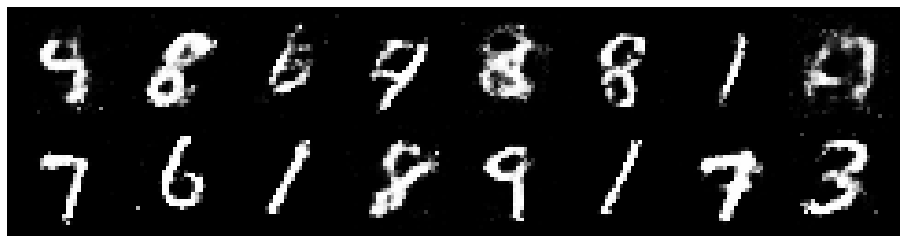

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.2162, Generator Loss: 0.9442
D(x): 0.5901, D(G(z)): 0.4427


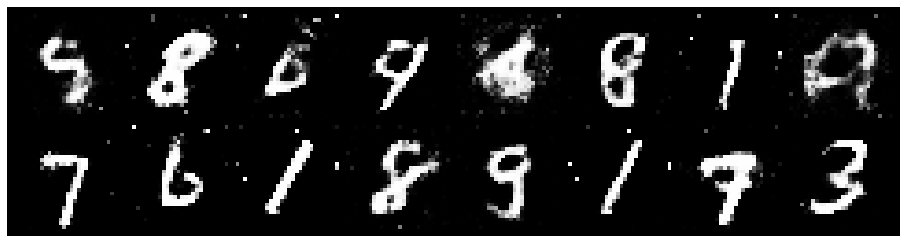

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.0991, Generator Loss: 1.1433
D(x): 0.5765, D(G(z)): 0.3485


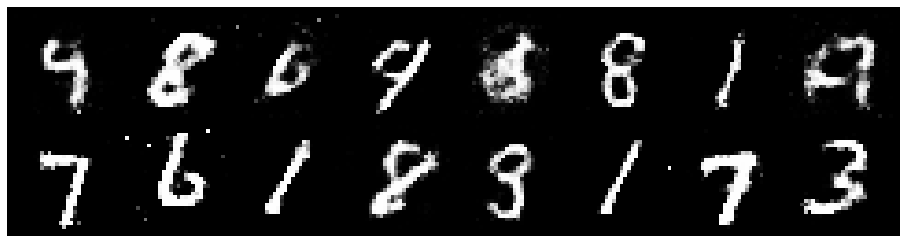

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.1001, Generator Loss: 1.1330
D(x): 0.5920, D(G(z)): 0.3763


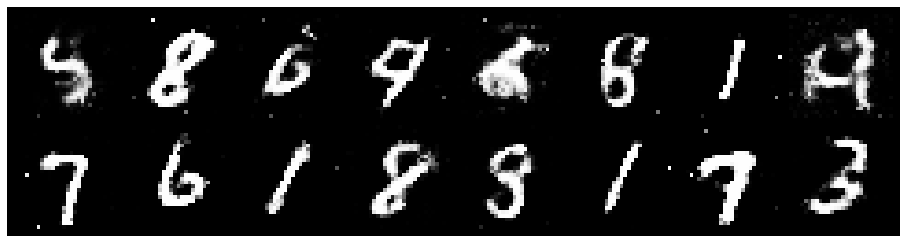

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.1057, Generator Loss: 0.9762
D(x): 0.5800, D(G(z)): 0.3841


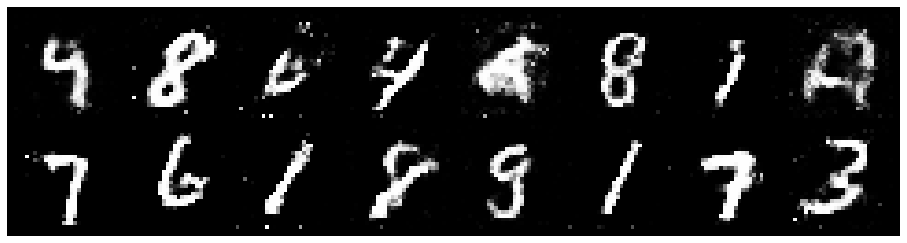

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.1095, Generator Loss: 1.0601
D(x): 0.5910, D(G(z)): 0.3675


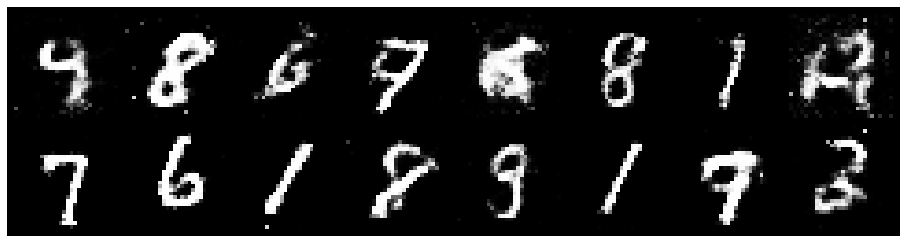

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.0943, Generator Loss: 1.0822
D(x): 0.5729, D(G(z)): 0.3532


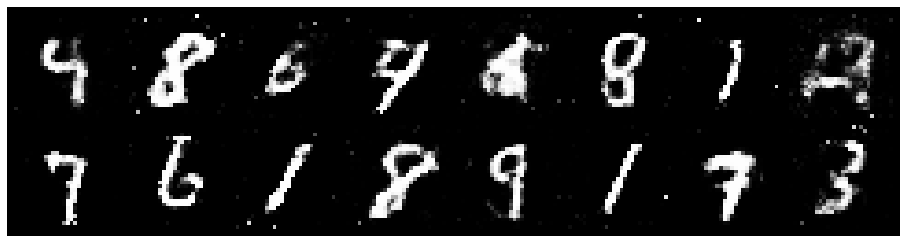

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.1615, Generator Loss: 0.9194
D(x): 0.5759, D(G(z)): 0.4159


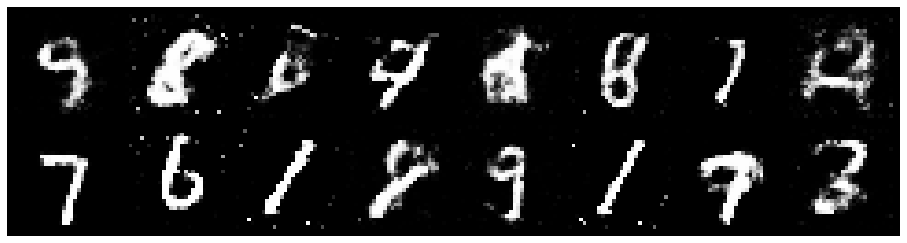

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.1555, Generator Loss: 0.9778
D(x): 0.6079, D(G(z)): 0.4222


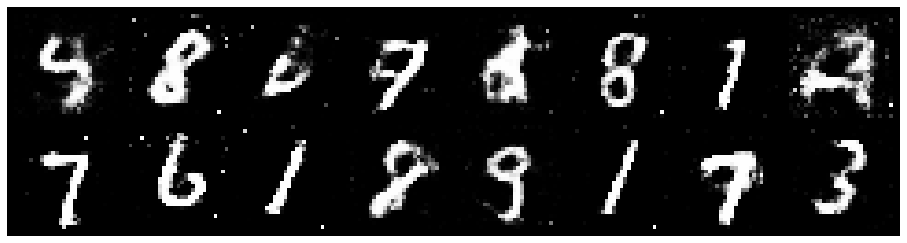

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.3725, Generator Loss: 0.8526
D(x): 0.5790, D(G(z)): 0.5065


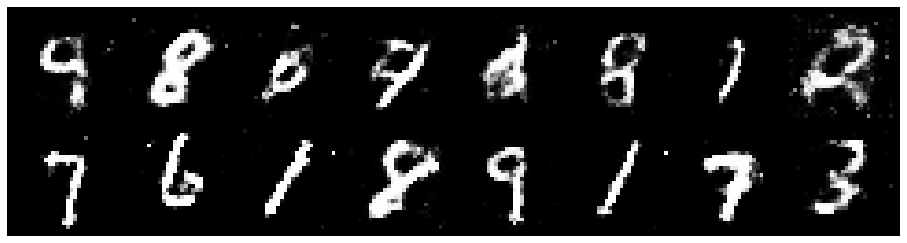

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.3886, Generator Loss: 0.8920
D(x): 0.6002, D(G(z)): 0.4818


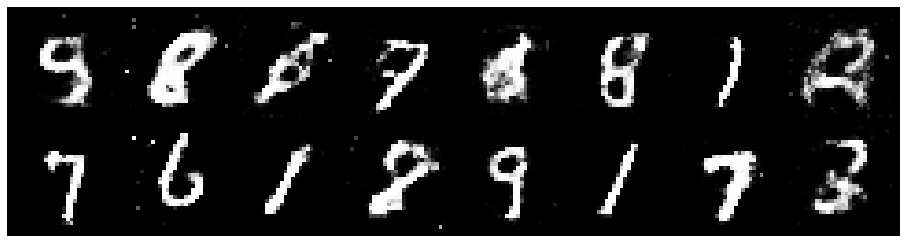

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.3029, Generator Loss: 0.8953
D(x): 0.5374, D(G(z)): 0.4462


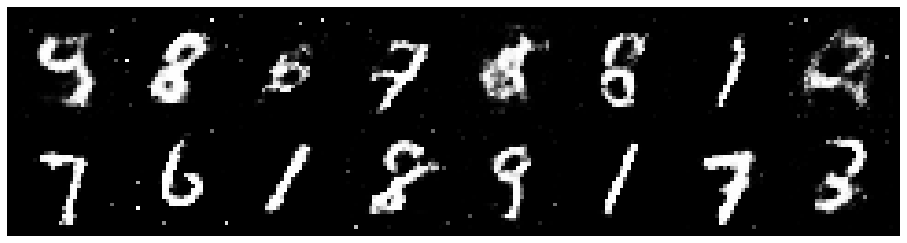

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.2451, Generator Loss: 0.9433
D(x): 0.5599, D(G(z)): 0.4150


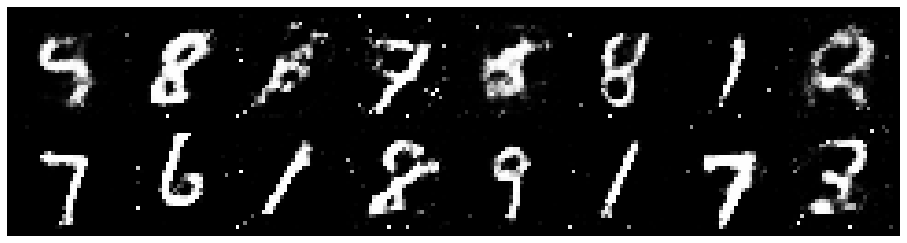

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.1397, Generator Loss: 1.1333
D(x): 0.6045, D(G(z)): 0.4040


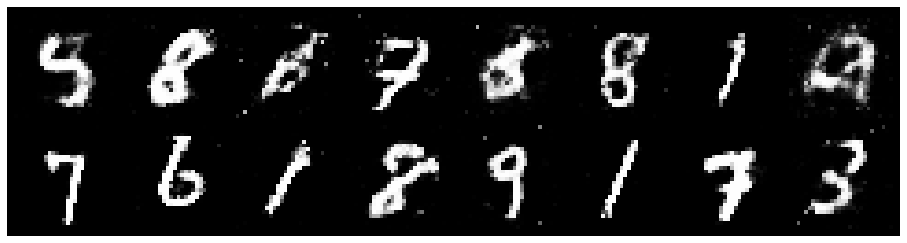

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.2494, Generator Loss: 0.8991
D(x): 0.5687, D(G(z)): 0.4262


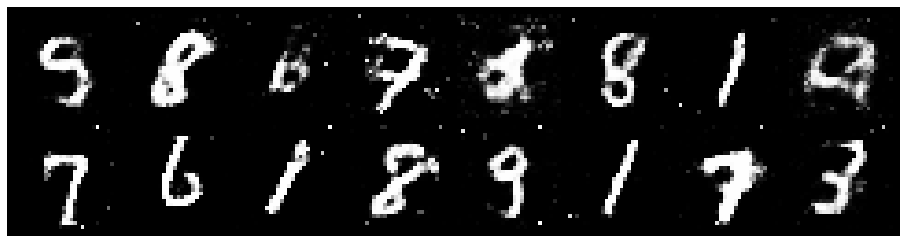

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.2273, Generator Loss: 0.9746
D(x): 0.5554, D(G(z)): 0.4084


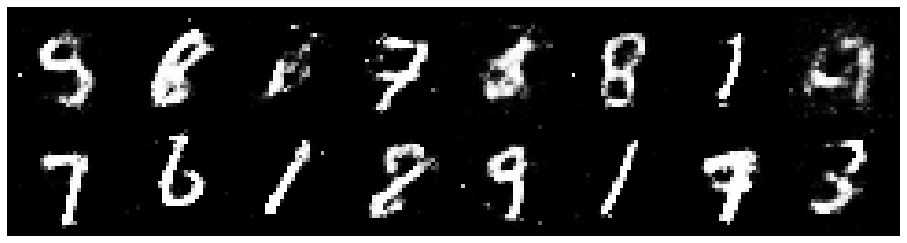

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.2616, Generator Loss: 0.8145
D(x): 0.6138, D(G(z)): 0.4702


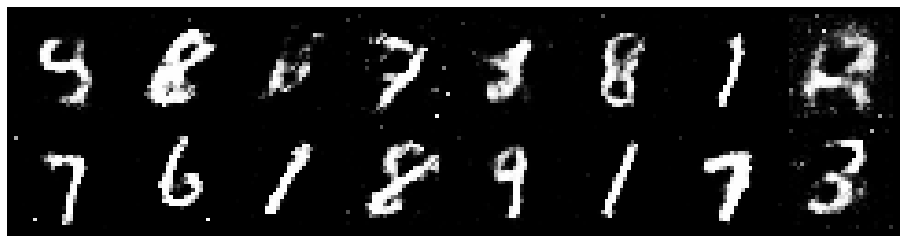

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.2075, Generator Loss: 1.0723
D(x): 0.5751, D(G(z)): 0.4100


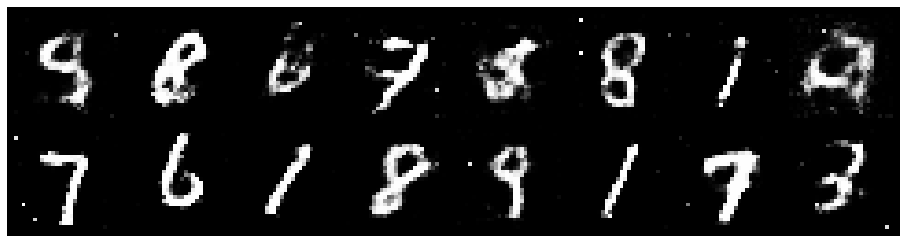

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.2046, Generator Loss: 1.0839
D(x): 0.5603, D(G(z)): 0.3936


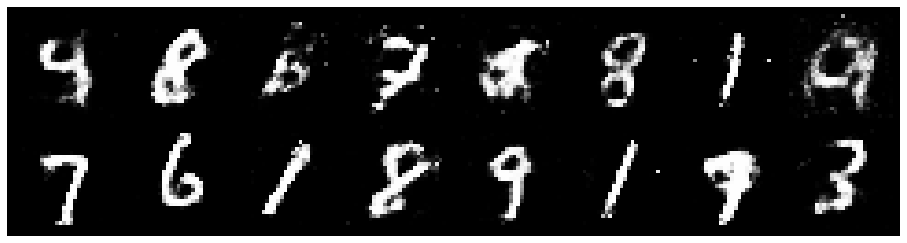

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.2850, Generator Loss: 1.0684
D(x): 0.5386, D(G(z)): 0.4313


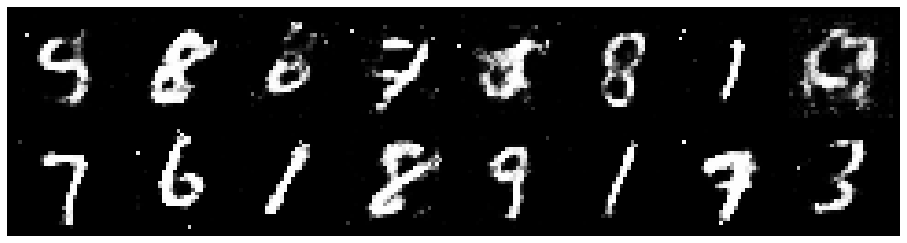

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.2178, Generator Loss: 1.1202
D(x): 0.5889, D(G(z)): 0.4044


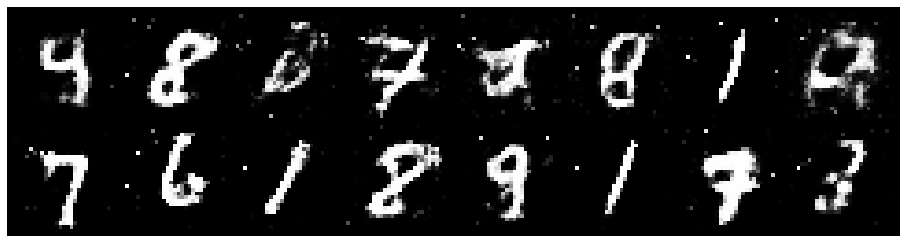

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.1951, Generator Loss: 0.9240
D(x): 0.5666, D(G(z)): 0.4223


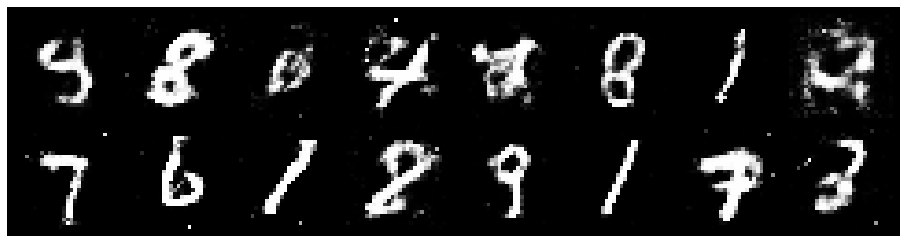

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.3317, Generator Loss: 0.7927
D(x): 0.5697, D(G(z)): 0.4873


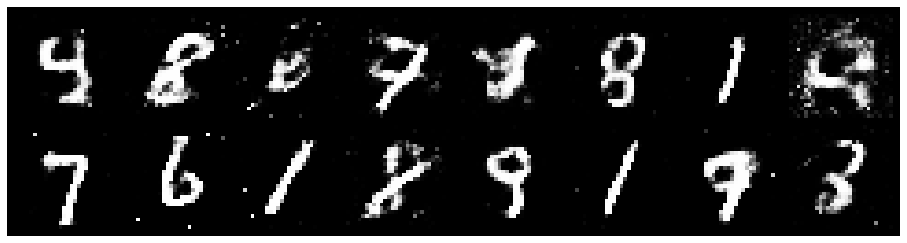

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.1952, Generator Loss: 1.0020
D(x): 0.5832, D(G(z)): 0.4275


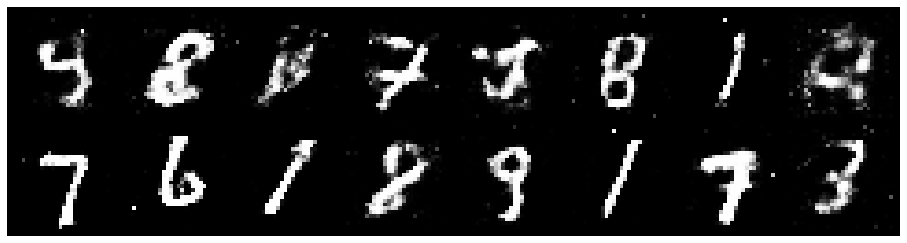

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.2209, Generator Loss: 0.9061
D(x): 0.6078, D(G(z)): 0.4473


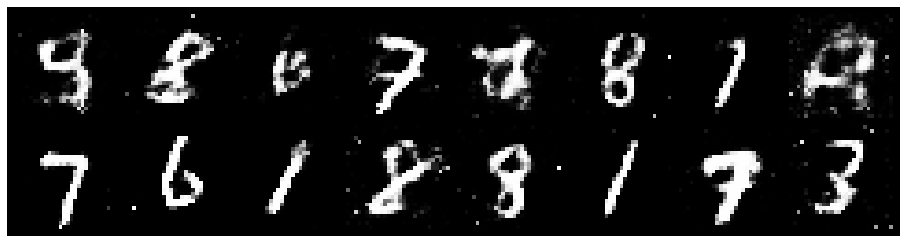

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.1586, Generator Loss: 0.9277
D(x): 0.6069, D(G(z)): 0.4306


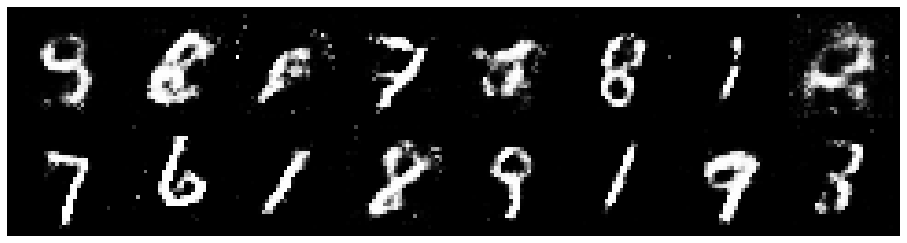

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.1744, Generator Loss: 1.0092
D(x): 0.5979, D(G(z)): 0.3939


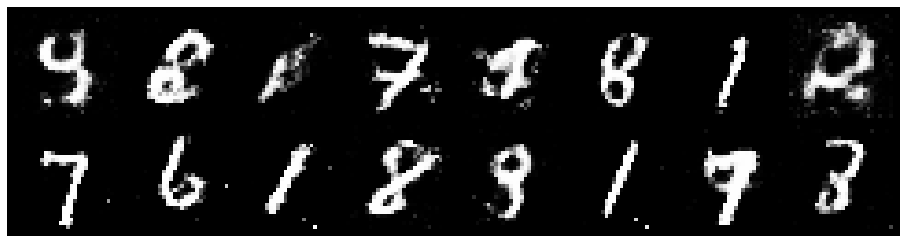

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.2042, Generator Loss: 0.8686
D(x): 0.5618, D(G(z)): 0.4293


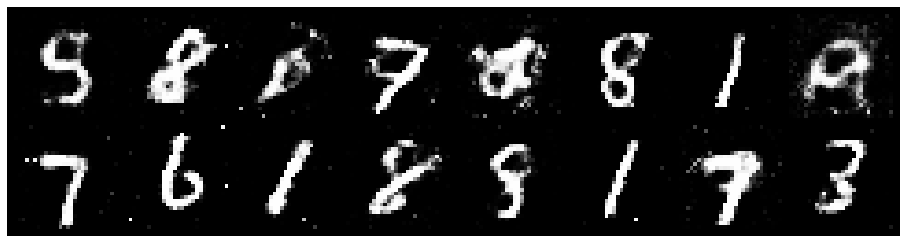

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.2265, Generator Loss: 0.9321
D(x): 0.5557, D(G(z)): 0.4270


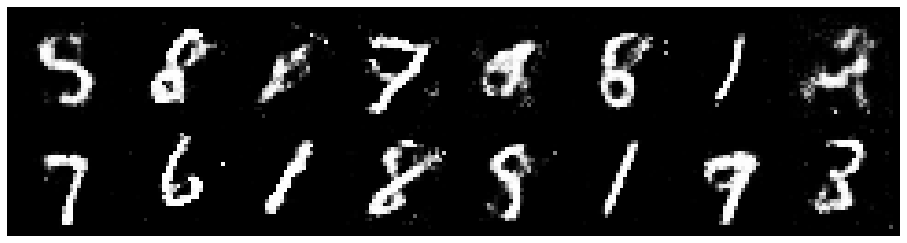

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.0915, Generator Loss: 1.0465
D(x): 0.5731, D(G(z)): 0.3525


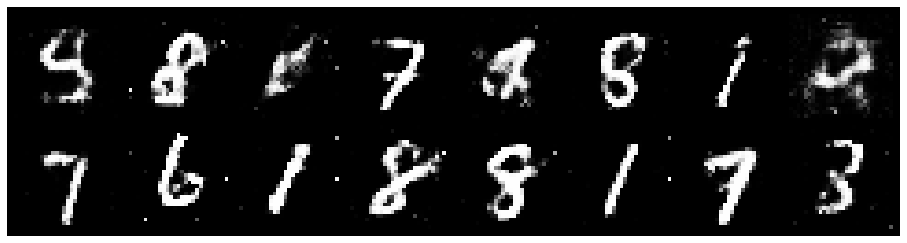

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.1700, Generator Loss: 0.8991
D(x): 0.5657, D(G(z)): 0.3994


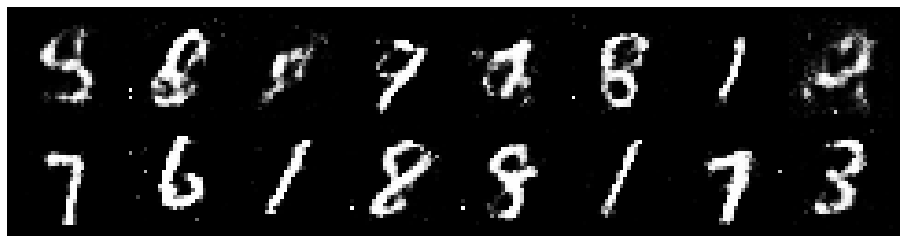

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.1747, Generator Loss: 0.9529
D(x): 0.5521, D(G(z)): 0.4074


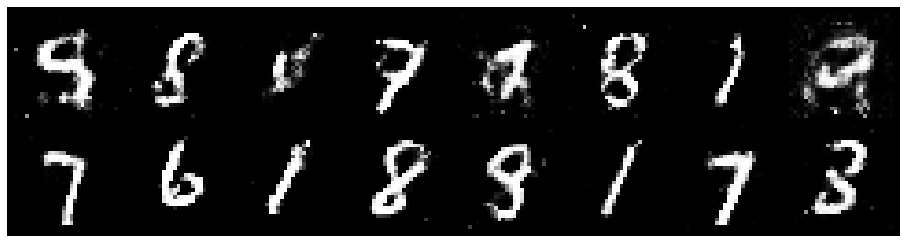

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.3266, Generator Loss: 0.8954
D(x): 0.5330, D(G(z)): 0.4237


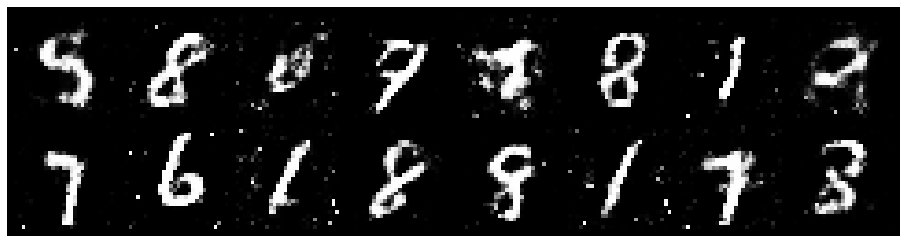

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.1803, Generator Loss: 0.9426
D(x): 0.5706, D(G(z)): 0.4076


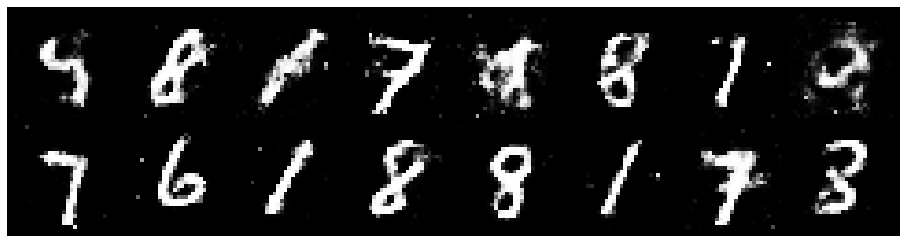

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.1626, Generator Loss: 1.0561
D(x): 0.6183, D(G(z)): 0.4218


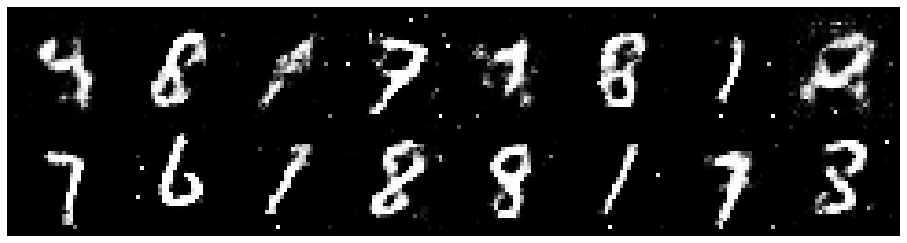

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.1350, Generator Loss: 1.1078
D(x): 0.5972, D(G(z)): 0.4052


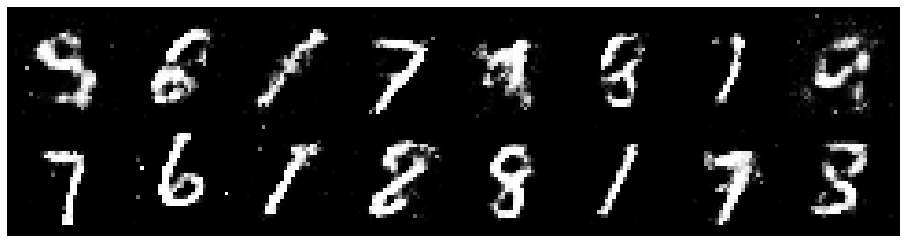

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.2298, Generator Loss: 0.9608
D(x): 0.5958, D(G(z)): 0.4375


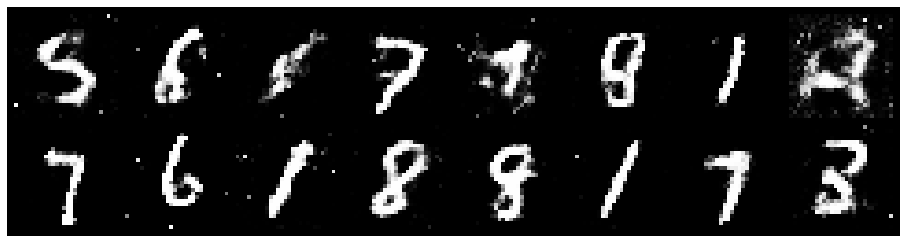

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.1959, Generator Loss: 0.8369
D(x): 0.6058, D(G(z)): 0.4556


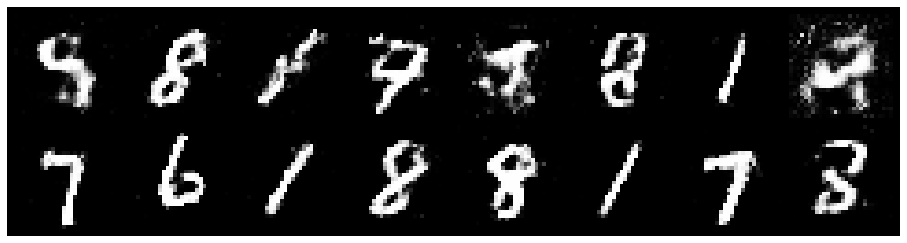

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.2347, Generator Loss: 0.8802
D(x): 0.5859, D(G(z)): 0.4278


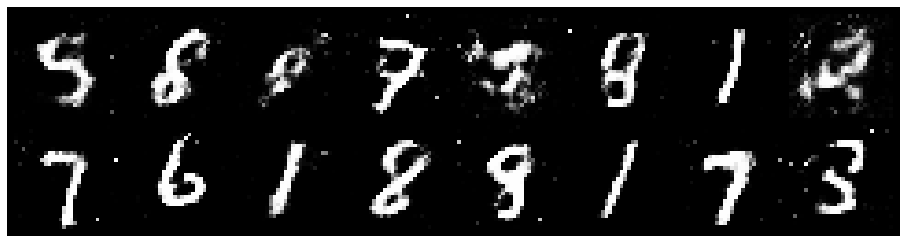

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.2640, Generator Loss: 1.0031
D(x): 0.5723, D(G(z)): 0.4308


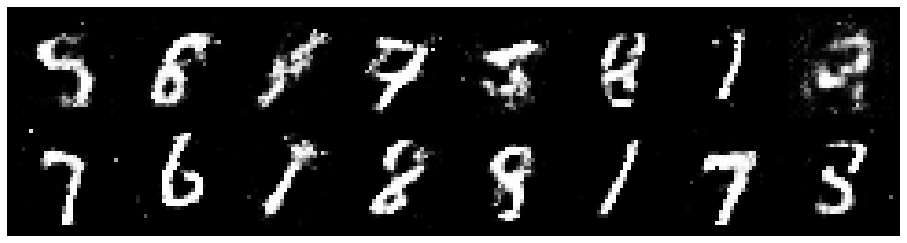

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.3086, Generator Loss: 1.0599
D(x): 0.5225, D(G(z)): 0.3918


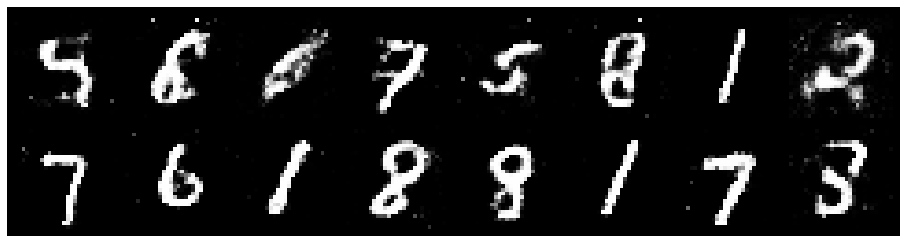

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.2483, Generator Loss: 0.9548
D(x): 0.6009, D(G(z)): 0.4524


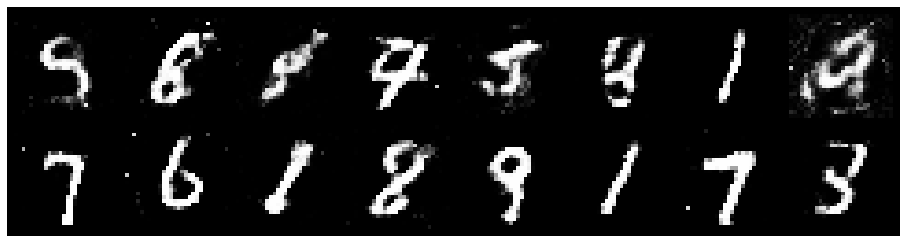

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.1565, Generator Loss: 0.9899
D(x): 0.6097, D(G(z)): 0.4274


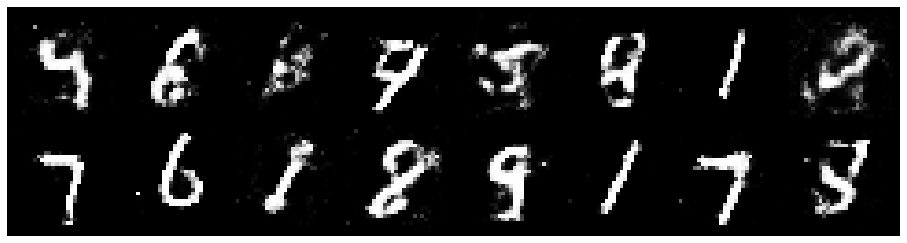

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.2913, Generator Loss: 0.8931
D(x): 0.5084, D(G(z)): 0.4224


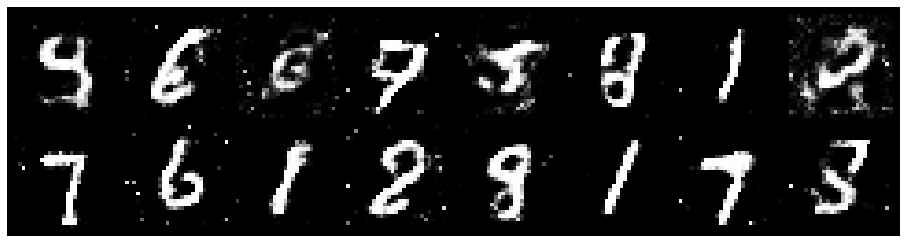

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.2476, Generator Loss: 0.9387
D(x): 0.5662, D(G(z)): 0.4159


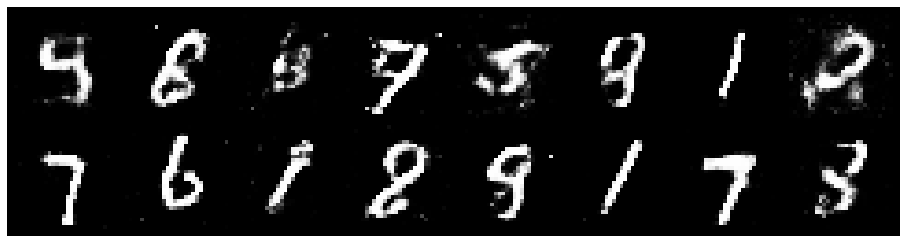

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.2815, Generator Loss: 0.8764
D(x): 0.5908, D(G(z)): 0.4703


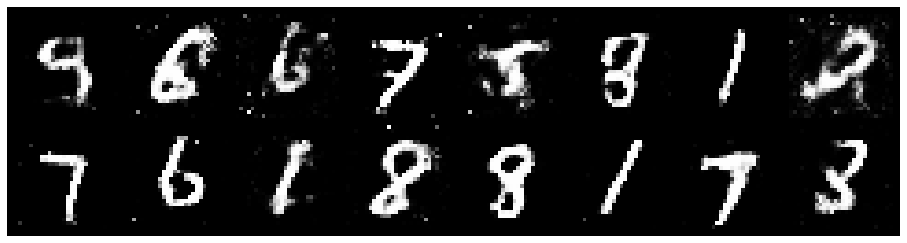

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.1684, Generator Loss: 1.1312
D(x): 0.5964, D(G(z)): 0.4121


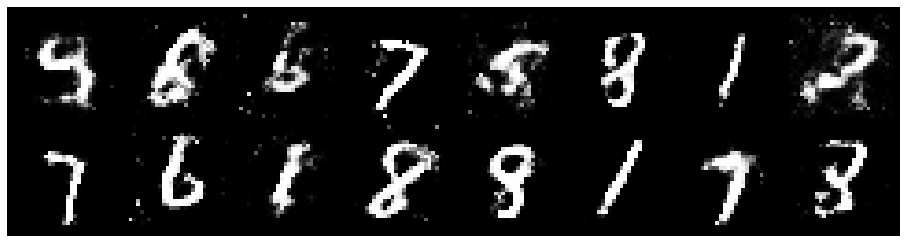

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.2109, Generator Loss: 0.9780
D(x): 0.5672, D(G(z)): 0.4112


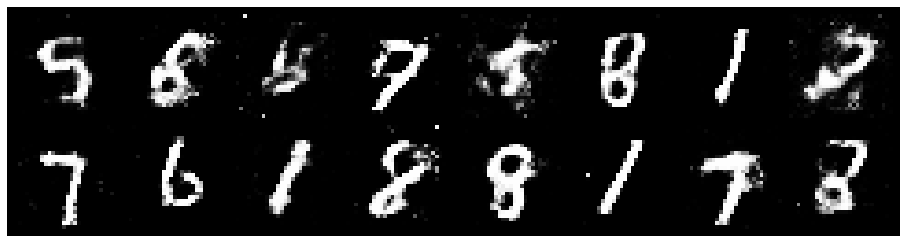

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.2814, Generator Loss: 0.8175
D(x): 0.5659, D(G(z)): 0.4647


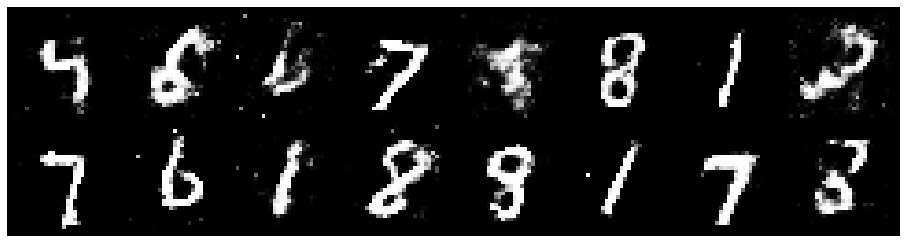

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.2717, Generator Loss: 0.9293
D(x): 0.5231, D(G(z)): 0.4164


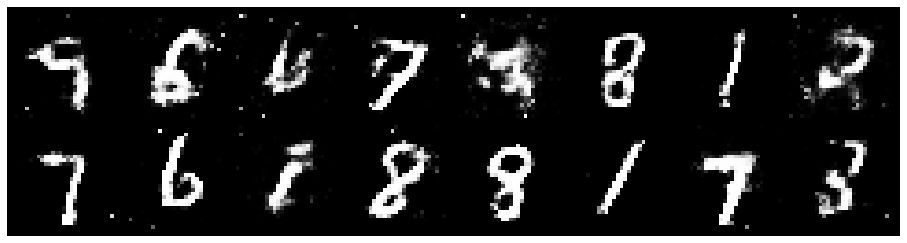

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.3960, Generator Loss: 0.8812
D(x): 0.5350, D(G(z)): 0.4694


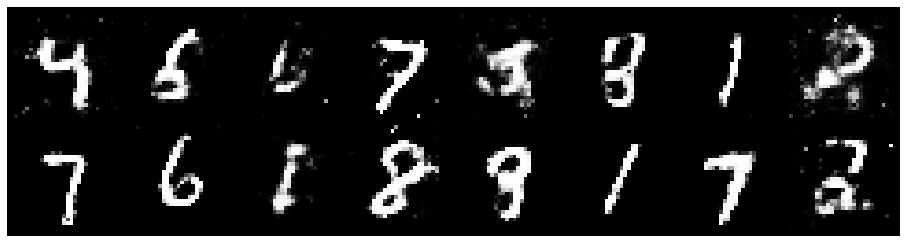

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.3238, Generator Loss: 1.0213
D(x): 0.5252, D(G(z)): 0.4126


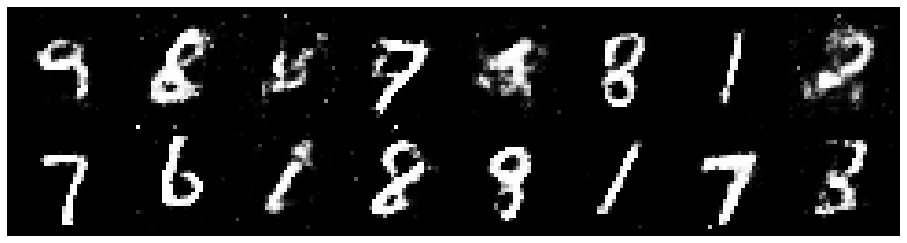

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.2281, Generator Loss: 1.0061
D(x): 0.5988, D(G(z)): 0.4360


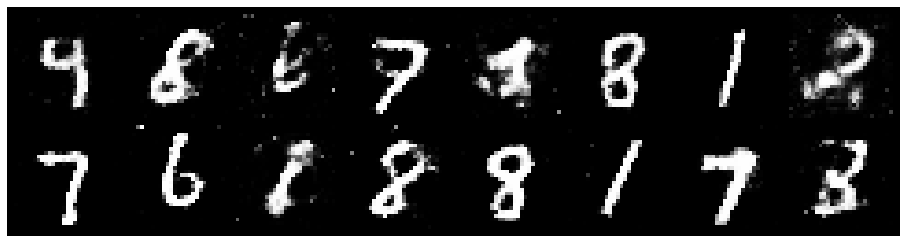

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.3171, Generator Loss: 0.8959
D(x): 0.5484, D(G(z)): 0.4539


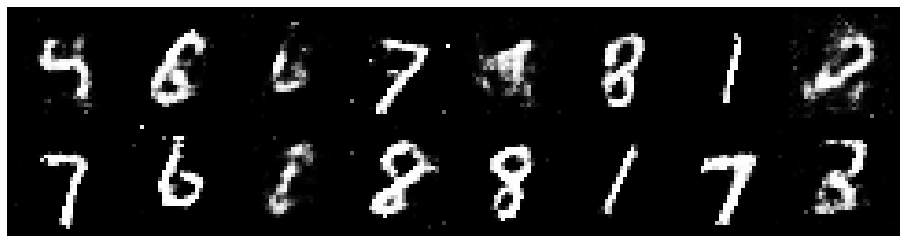

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.1381, Generator Loss: 0.9291
D(x): 0.6090, D(G(z)): 0.4113


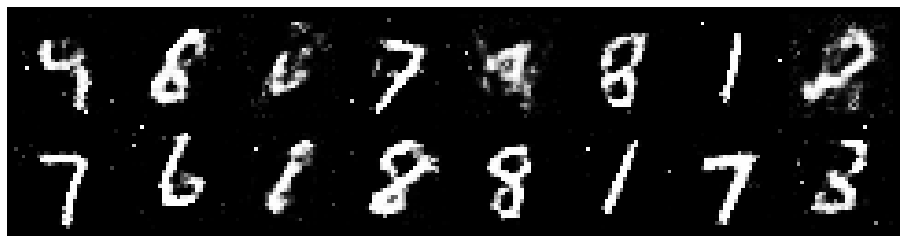

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.2215, Generator Loss: 0.9872
D(x): 0.6022, D(G(z)): 0.4417


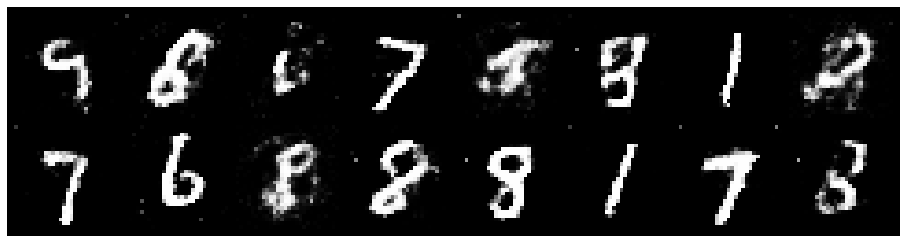

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.3788, Generator Loss: 0.8189
D(x): 0.5721, D(G(z)): 0.5033


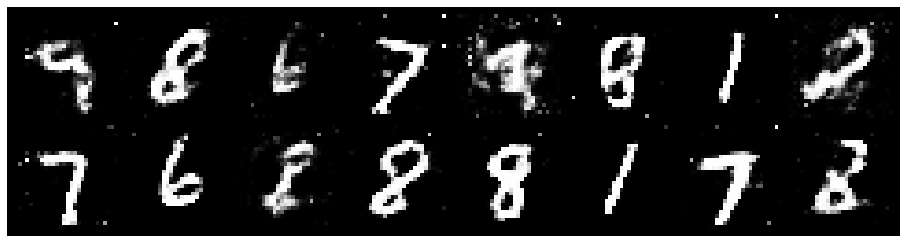

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2709, Generator Loss: 1.0136
D(x): 0.5461, D(G(z)): 0.4167


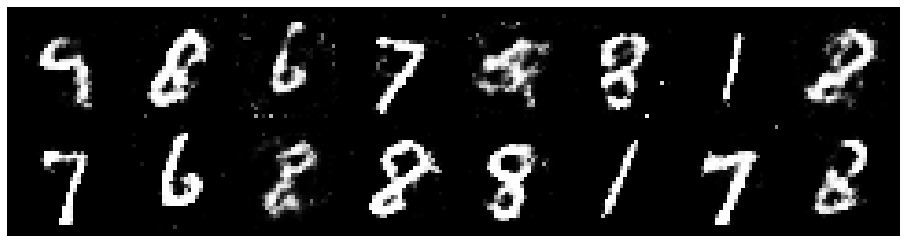

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.0856, Generator Loss: 1.0052
D(x): 0.6001, D(G(z)): 0.3815


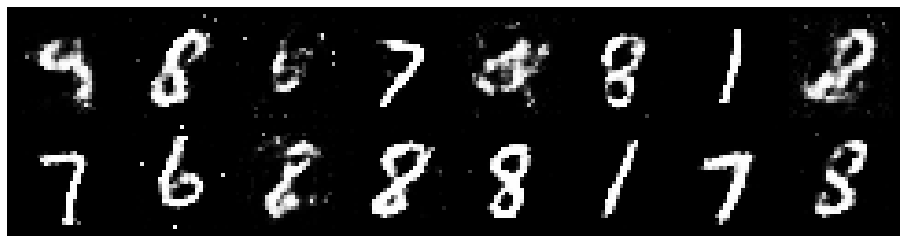

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.1269, Generator Loss: 1.2038
D(x): 0.5910, D(G(z)): 0.3735


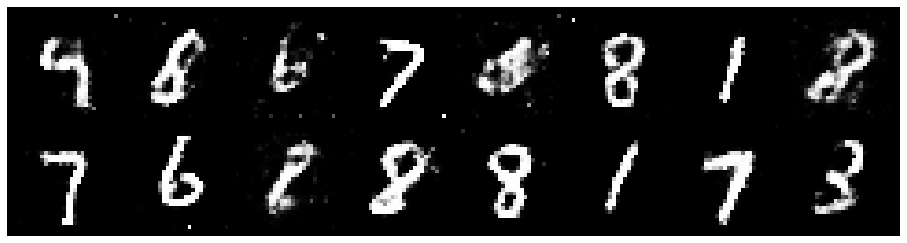

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.1690, Generator Loss: 0.8980
D(x): 0.5621, D(G(z)): 0.3907


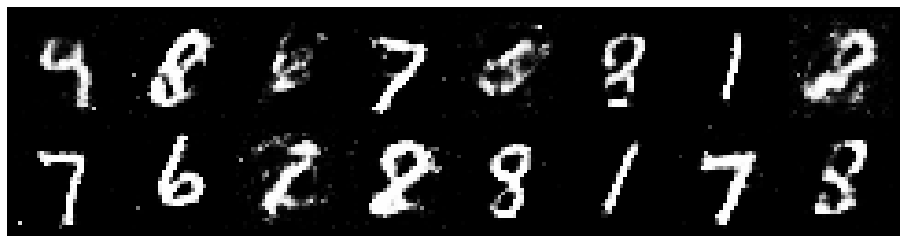

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.1641, Generator Loss: 1.1433
D(x): 0.6011, D(G(z)): 0.4155


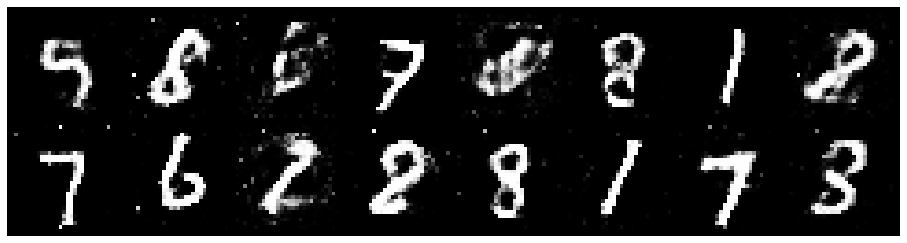

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.1748, Generator Loss: 0.8679
D(x): 0.5923, D(G(z)): 0.4385


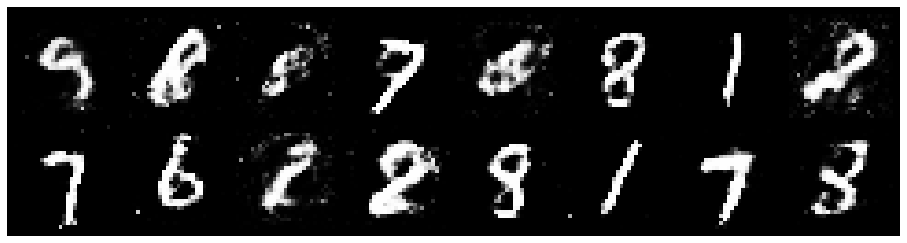

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.2246, Generator Loss: 0.8215
D(x): 0.5827, D(G(z)): 0.4425


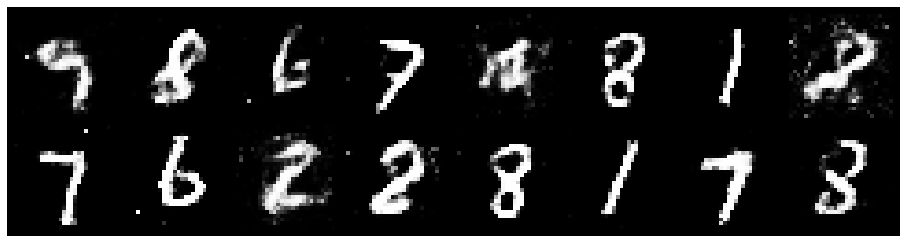

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.2213, Generator Loss: 0.9731
D(x): 0.5758, D(G(z)): 0.4216


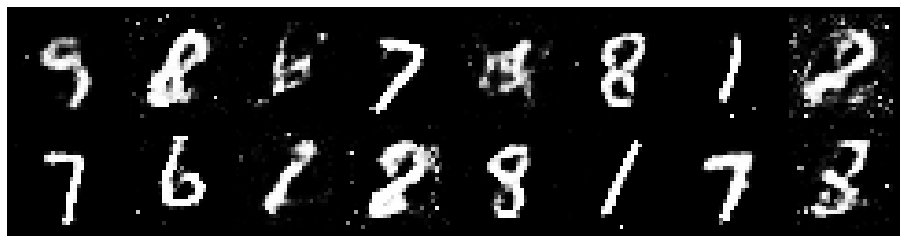

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.1660, Generator Loss: 0.8817
D(x): 0.6066, D(G(z)): 0.4214


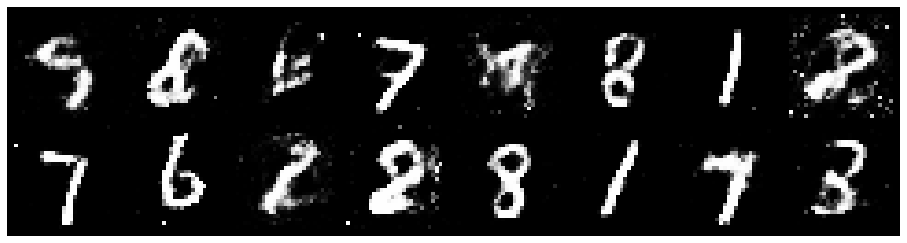

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.3128, Generator Loss: 0.8256
D(x): 0.5490, D(G(z)): 0.4425


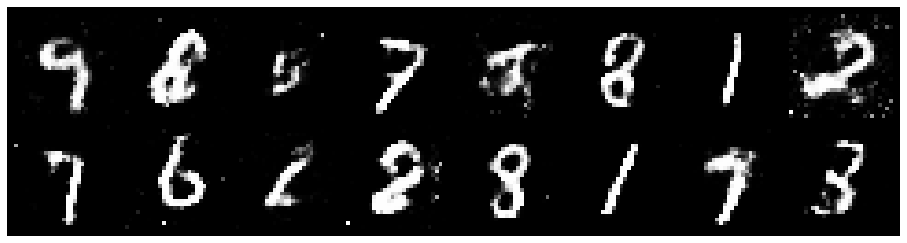

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.3529, Generator Loss: 0.8358
D(x): 0.5210, D(G(z)): 0.4347


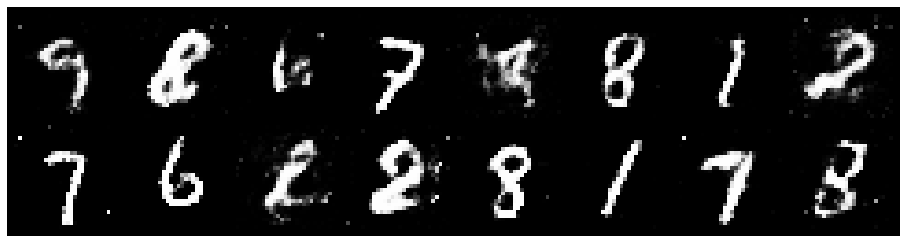

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.2659, Generator Loss: 0.8457
D(x): 0.5818, D(G(z)): 0.4413


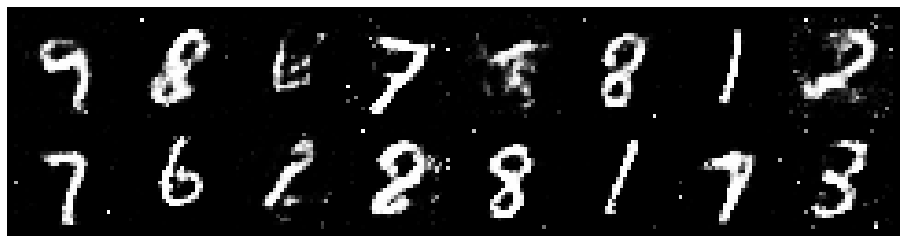

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.3309, Generator Loss: 0.9553
D(x): 0.5119, D(G(z)): 0.4061


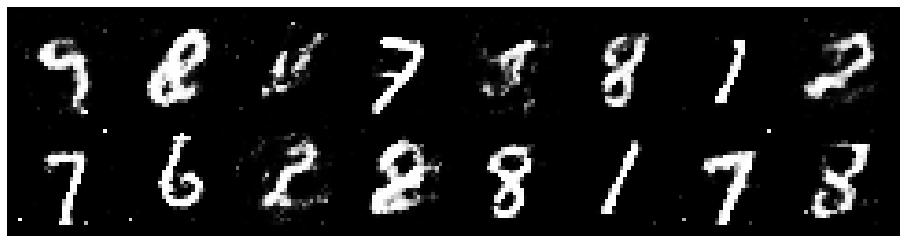

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.3869, Generator Loss: 0.8935
D(x): 0.4891, D(G(z)): 0.4357


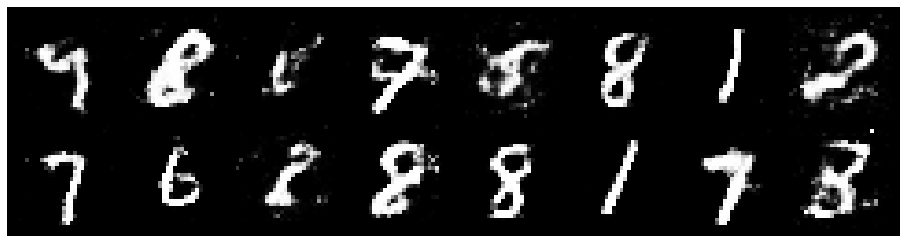

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.4223, Generator Loss: 0.9091
D(x): 0.4837, D(G(z)): 0.4463


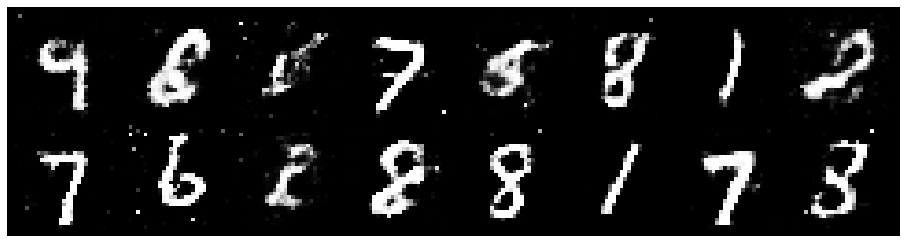

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.2660, Generator Loss: 1.2301
D(x): 0.5485, D(G(z)): 0.4006


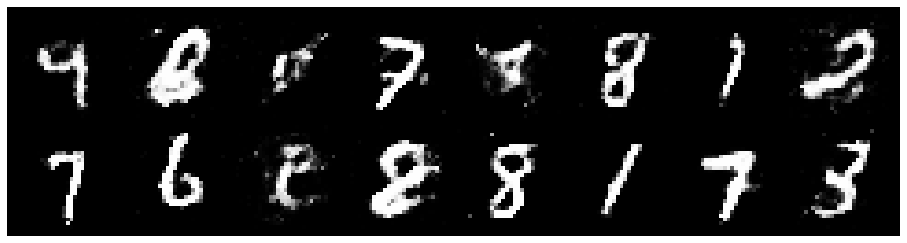

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.2049, Generator Loss: 1.0845
D(x): 0.5683, D(G(z)): 0.4147


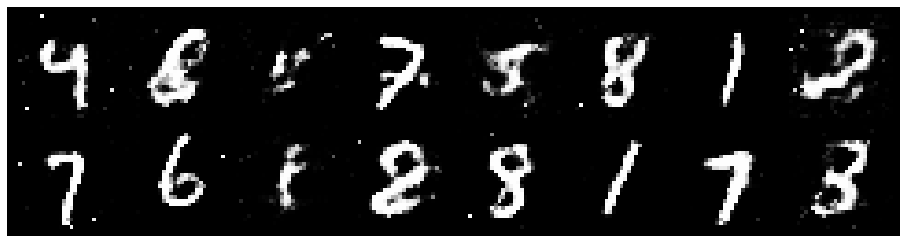

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.1999, Generator Loss: 1.0284
D(x): 0.5625, D(G(z)): 0.4062


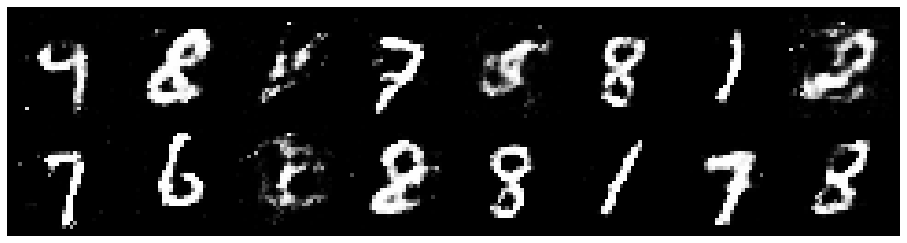

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.3052, Generator Loss: 0.8257
D(x): 0.5131, D(G(z)): 0.4338


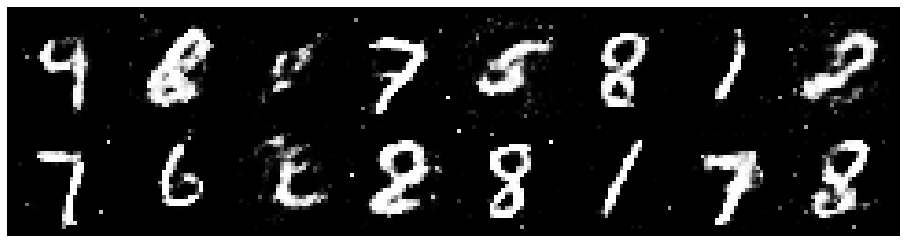

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.3522, Generator Loss: 0.8357
D(x): 0.5696, D(G(z)): 0.4830


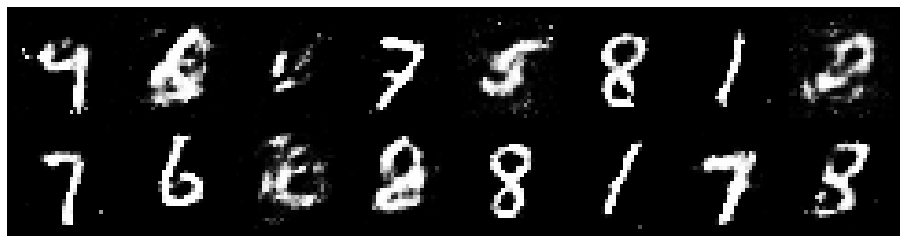

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.2665, Generator Loss: 0.9267
D(x): 0.6097, D(G(z)): 0.4699


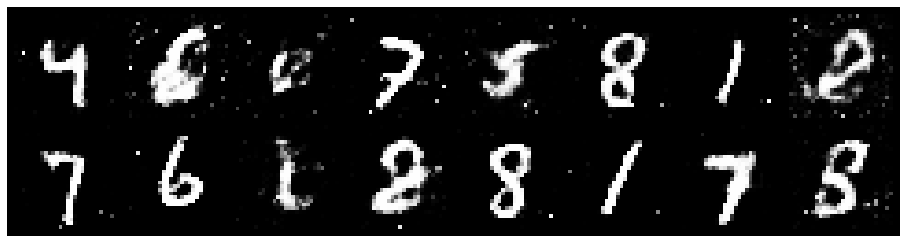

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.2424, Generator Loss: 0.9465
D(x): 0.5312, D(G(z)): 0.4217


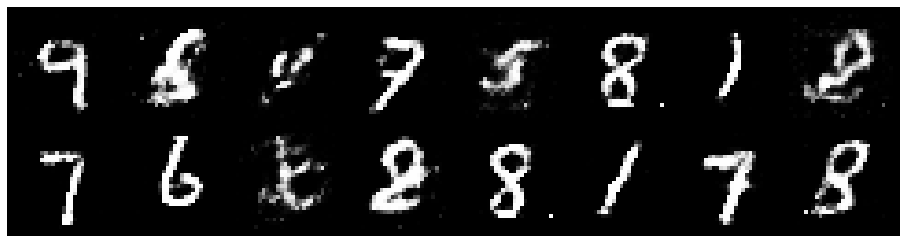

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.3397, Generator Loss: 0.8866
D(x): 0.5530, D(G(z)): 0.4715


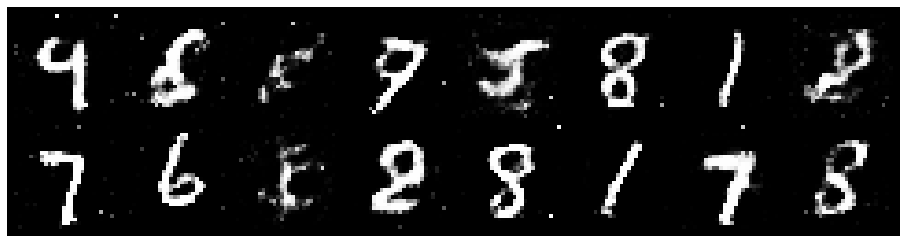

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.2280, Generator Loss: 1.1012
D(x): 0.5456, D(G(z)): 0.3908


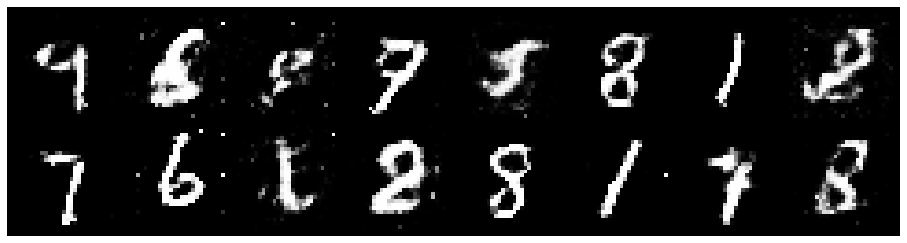

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.1655, Generator Loss: 0.9775
D(x): 0.5706, D(G(z)): 0.4036


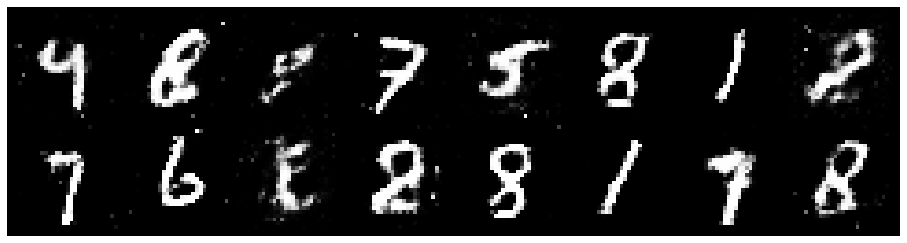

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.3113, Generator Loss: 0.8733
D(x): 0.5038, D(G(z)): 0.4257


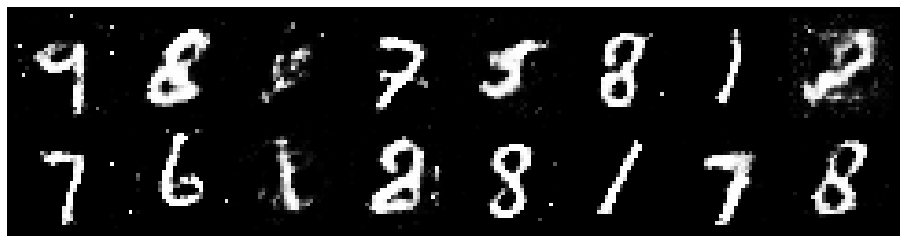

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.2675, Generator Loss: 0.8864
D(x): 0.5435, D(G(z)): 0.4441


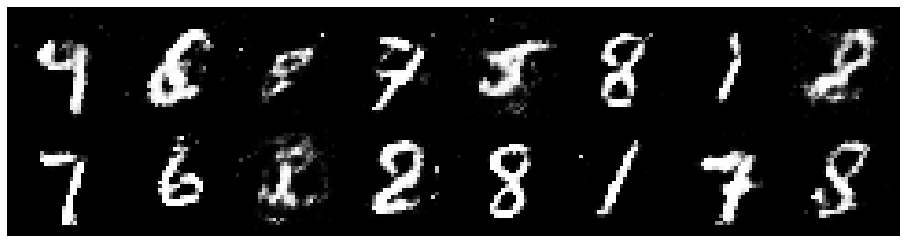

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.2261, Generator Loss: 0.8672
D(x): 0.5561, D(G(z)): 0.4357


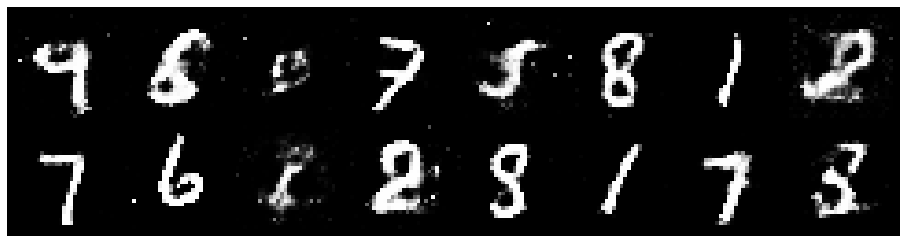

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2647, Generator Loss: 0.8649
D(x): 0.5340, D(G(z)): 0.4133


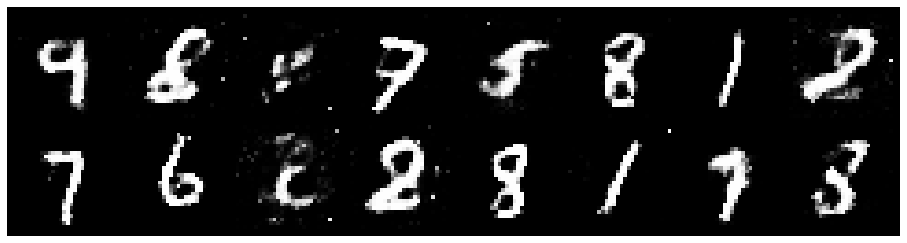

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.2164, Generator Loss: 0.8880
D(x): 0.5529, D(G(z)): 0.4183


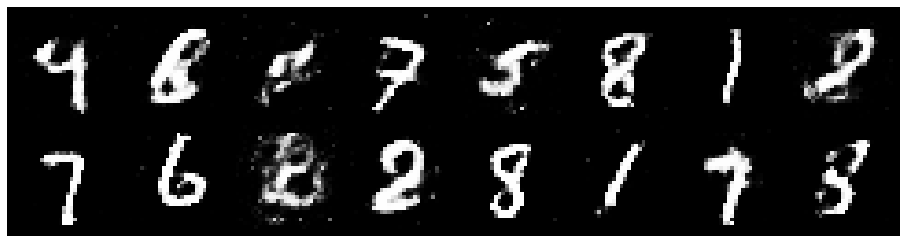

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.2346, Generator Loss: 0.9069
D(x): 0.6117, D(G(z)): 0.4641


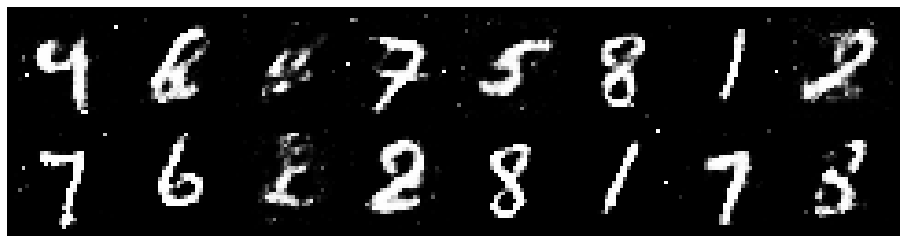

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.2053, Generator Loss: 1.0483
D(x): 0.5516, D(G(z)): 0.3931


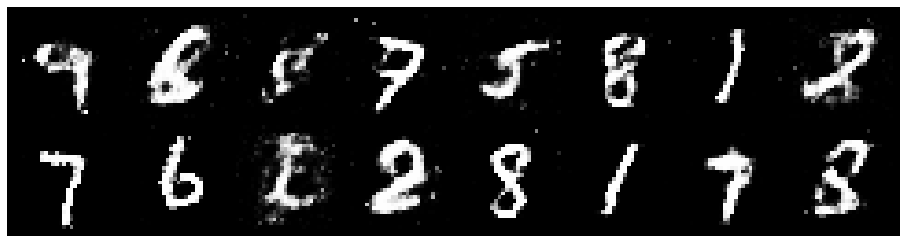

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.2076, Generator Loss: 0.9324
D(x): 0.6059, D(G(z)): 0.4473


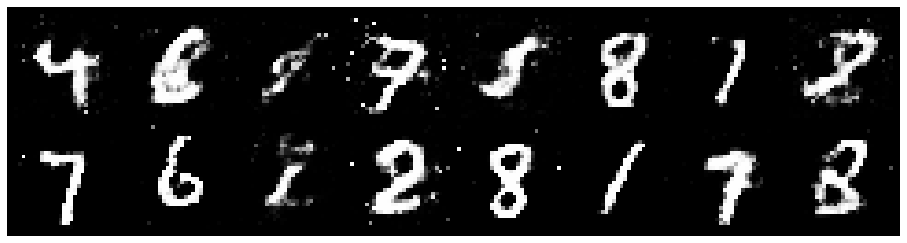

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.3310, Generator Loss: 0.8645
D(x): 0.5222, D(G(z)): 0.4443


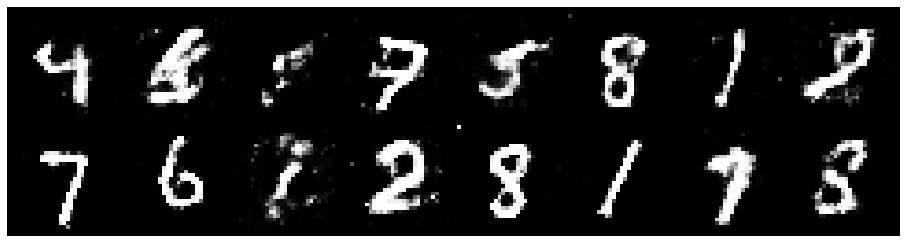

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.2497, Generator Loss: 0.8740
D(x): 0.5619, D(G(z)): 0.4573


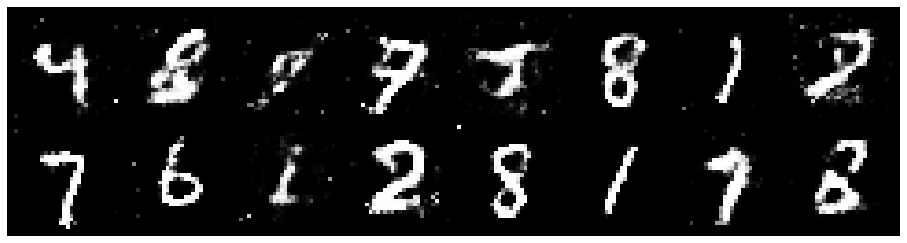

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.4109, Generator Loss: 0.7662
D(x): 0.5546, D(G(z)): 0.4934


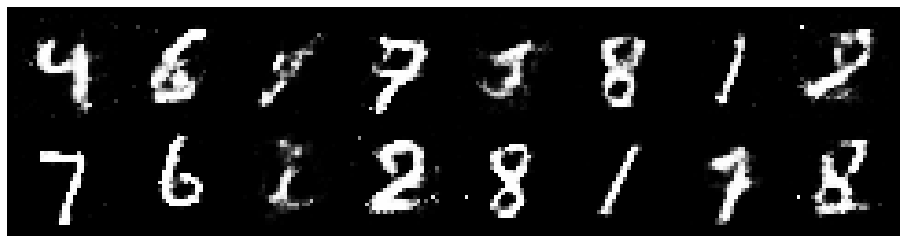

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.3759, Generator Loss: 0.8189
D(x): 0.5458, D(G(z)): 0.4846


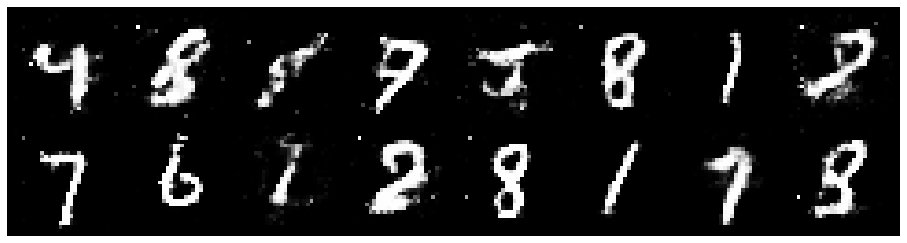

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.2515, Generator Loss: 0.9669
D(x): 0.6156, D(G(z)): 0.4683


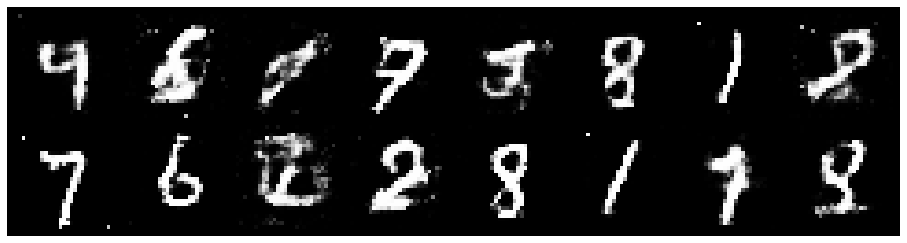

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.2952, Generator Loss: 0.9844
D(x): 0.5652, D(G(z)): 0.4474


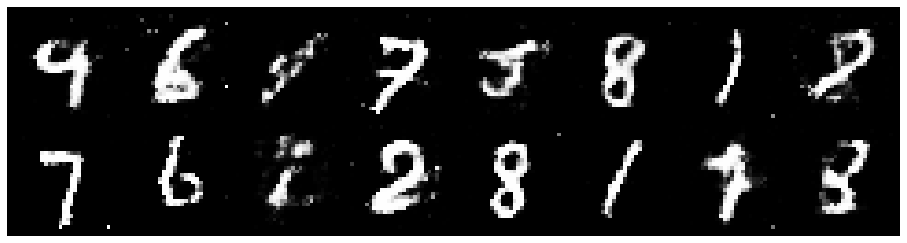

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.3358, Generator Loss: 0.8148
D(x): 0.5558, D(G(z)): 0.4788


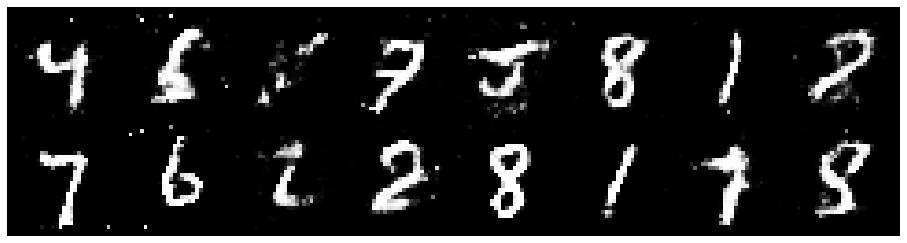

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.3375, Generator Loss: 0.8709
D(x): 0.5285, D(G(z)): 0.4417


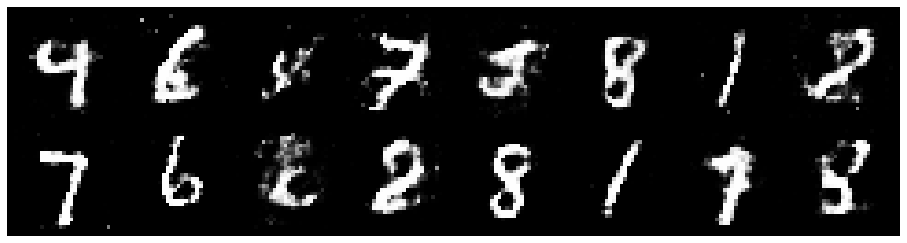

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.2407, Generator Loss: 0.9050
D(x): 0.5691, D(G(z)): 0.4187


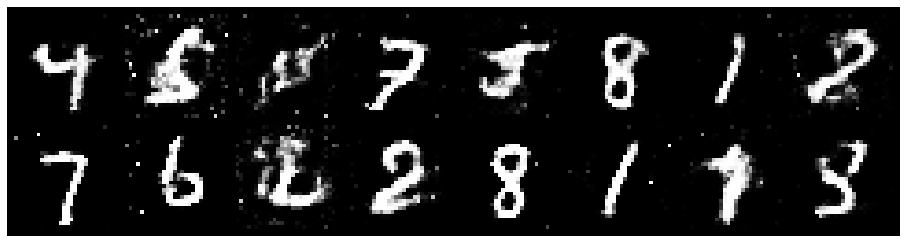

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.1322, Generator Loss: 0.9016
D(x): 0.5919, D(G(z)): 0.4035


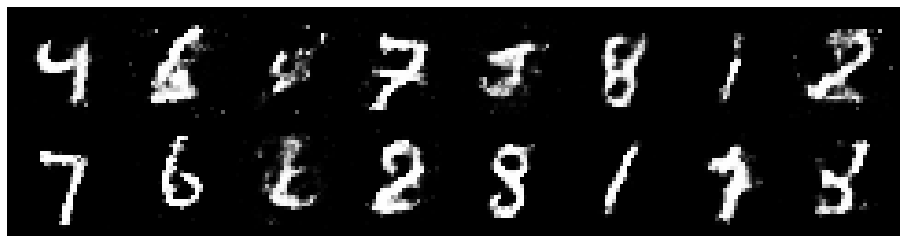

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.2738, Generator Loss: 0.8343
D(x): 0.5526, D(G(z)): 0.4435


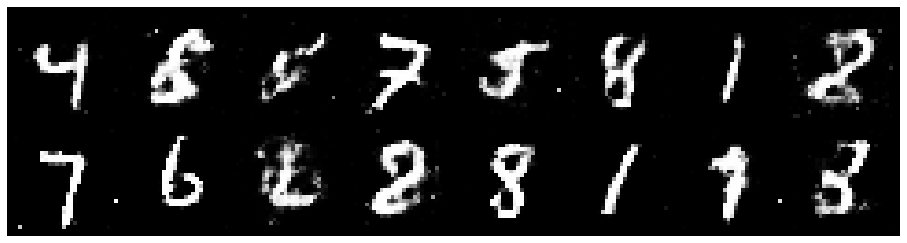

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.3204, Generator Loss: 1.0526
D(x): 0.5606, D(G(z)): 0.4535


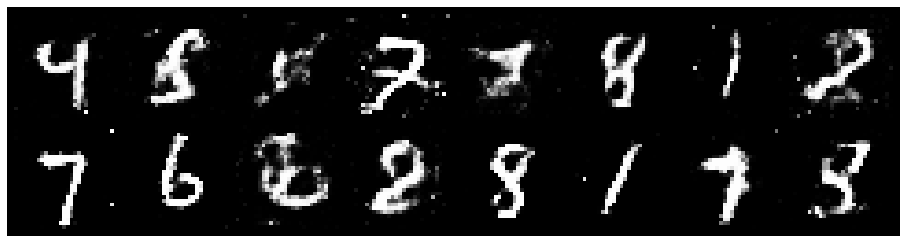

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.1868, Generator Loss: 0.9471
D(x): 0.5739, D(G(z)): 0.4096


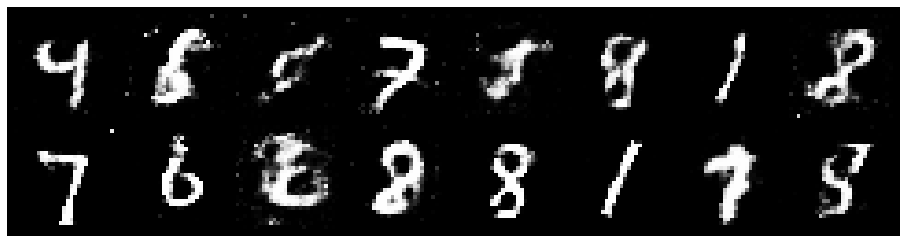

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.2110, Generator Loss: 0.9388
D(x): 0.5558, D(G(z)): 0.4193


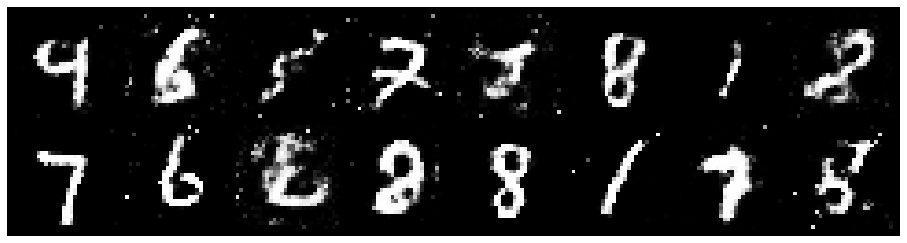

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.1933, Generator Loss: 1.0046
D(x): 0.5572, D(G(z)): 0.4022


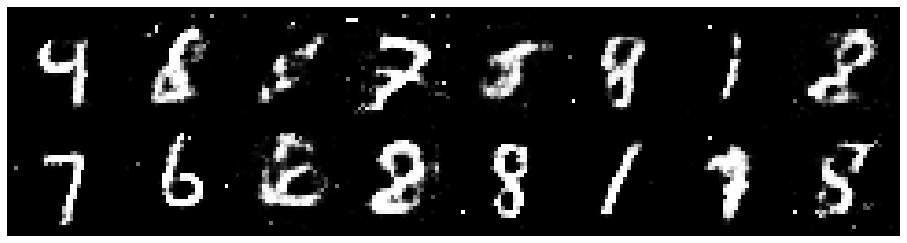

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.2040, Generator Loss: 1.0049
D(x): 0.5939, D(G(z)): 0.4339


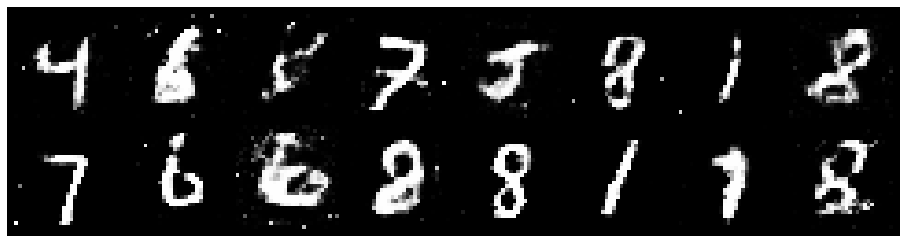

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.2640, Generator Loss: 0.8966
D(x): 0.6039, D(G(z)): 0.4667


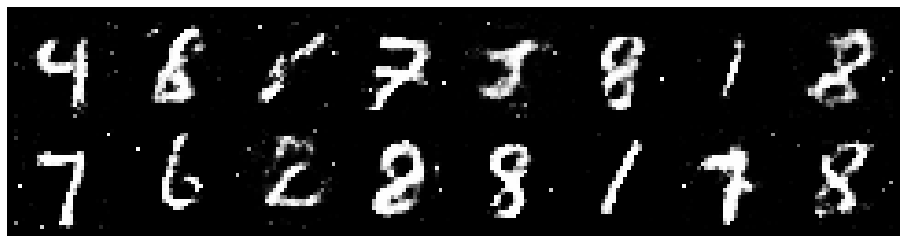

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.2303, Generator Loss: 1.0810
D(x): 0.5562, D(G(z)): 0.4247


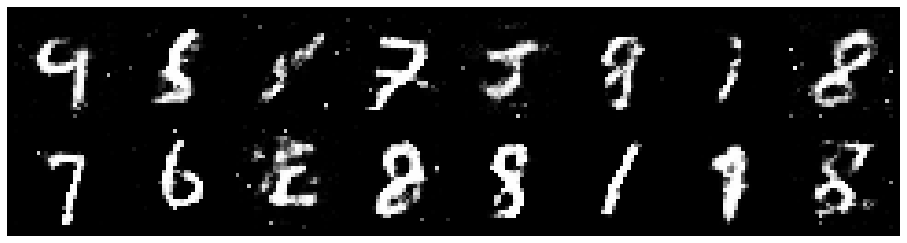

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.2365, Generator Loss: 0.9326
D(x): 0.5547, D(G(z)): 0.4497


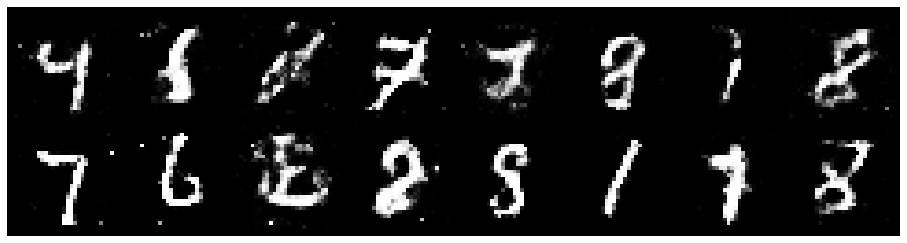

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.2114, Generator Loss: 1.0138
D(x): 0.5634, D(G(z)): 0.4148


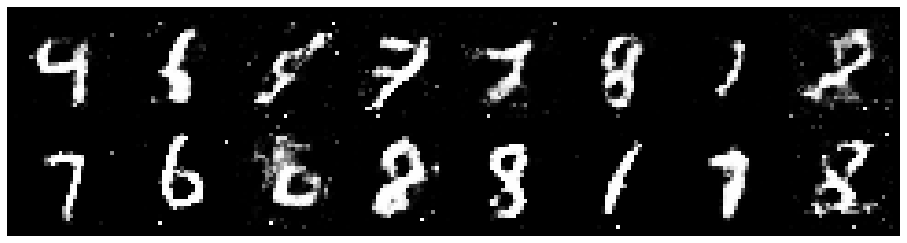

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.2727, Generator Loss: 0.8707
D(x): 0.5627, D(G(z)): 0.4481


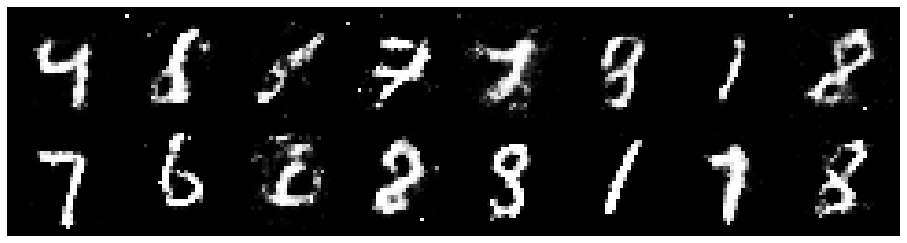

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.3043, Generator Loss: 0.9981
D(x): 0.5459, D(G(z)): 0.4218


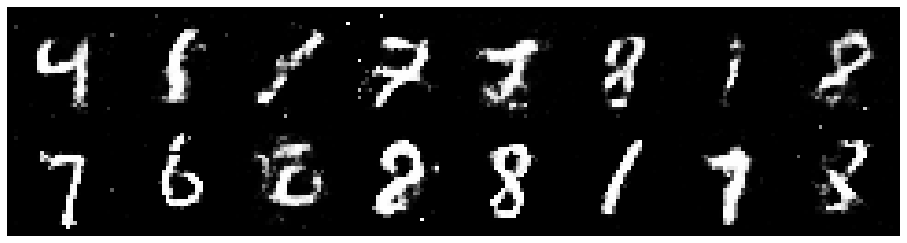

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.1500, Generator Loss: 0.9500
D(x): 0.5868, D(G(z)): 0.4129


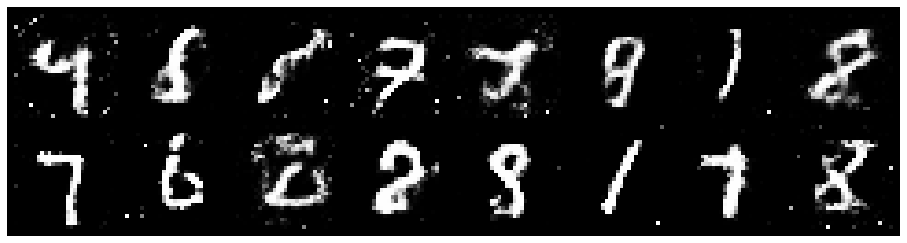

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.2516, Generator Loss: 0.9897
D(x): 0.5539, D(G(z)): 0.4228


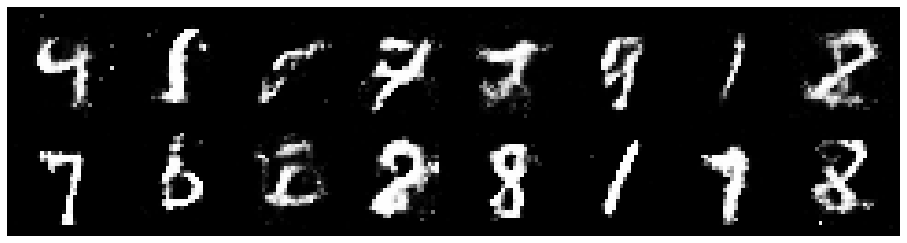

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.2567, Generator Loss: 1.0110
D(x): 0.5340, D(G(z)): 0.4096


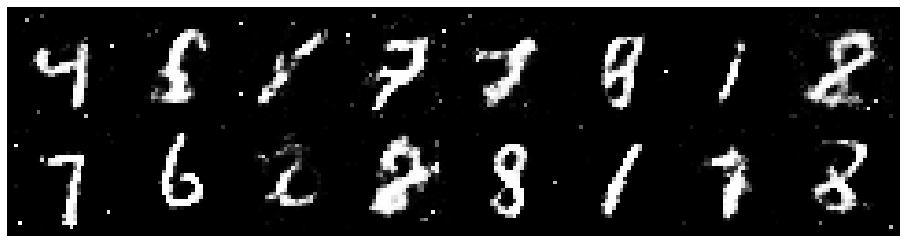

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.2011, Generator Loss: 0.9830
D(x): 0.6025, D(G(z)): 0.4365


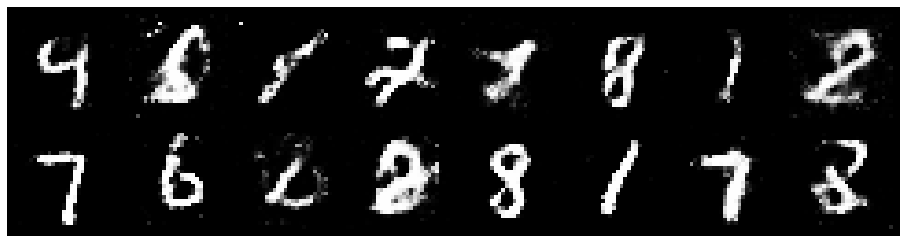

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.2986, Generator Loss: 0.8371
D(x): 0.5413, D(G(z)): 0.4614


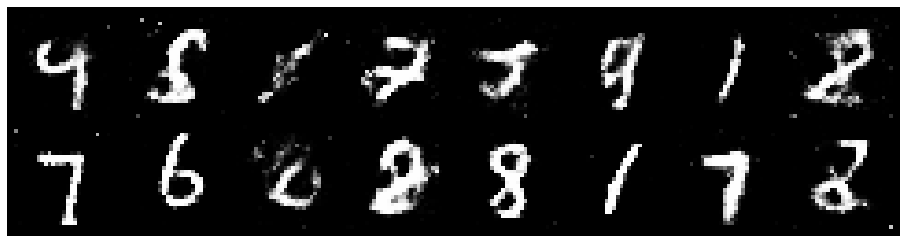

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.1636, Generator Loss: 0.9440
D(x): 0.5524, D(G(z)): 0.3984


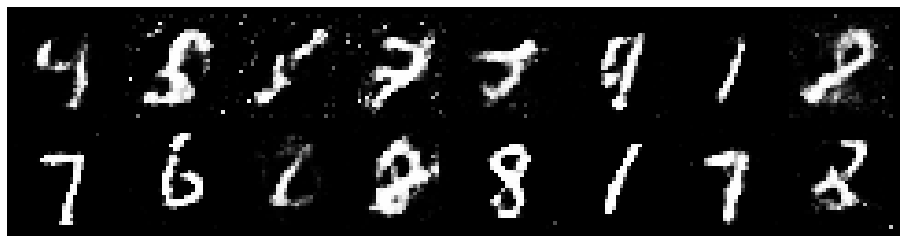

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.2686, Generator Loss: 0.8453
D(x): 0.5689, D(G(z)): 0.4722


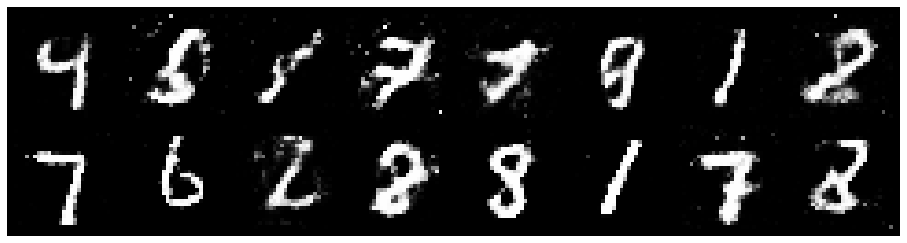

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.2922, Generator Loss: 0.8605
D(x): 0.5403, D(G(z)): 0.4586


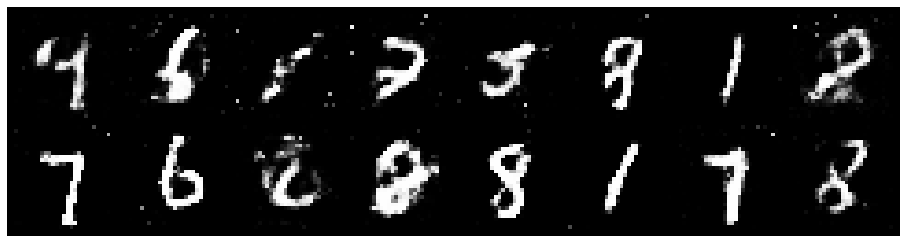

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.2258, Generator Loss: 0.9782
D(x): 0.5440, D(G(z)): 0.4158


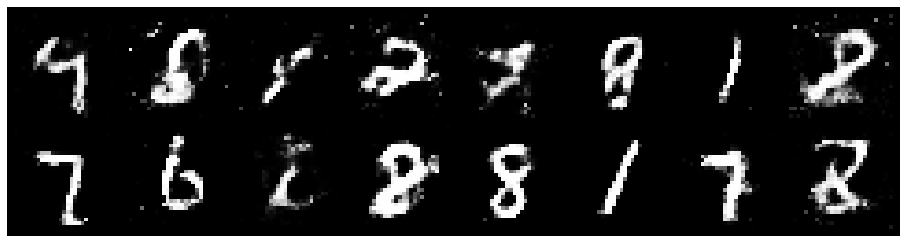

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.2273, Generator Loss: 0.9306
D(x): 0.5577, D(G(z)): 0.4219


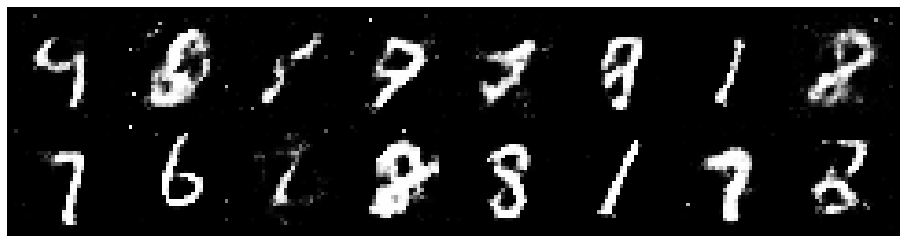

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.2102, Generator Loss: 0.9308
D(x): 0.5542, D(G(z)): 0.4135


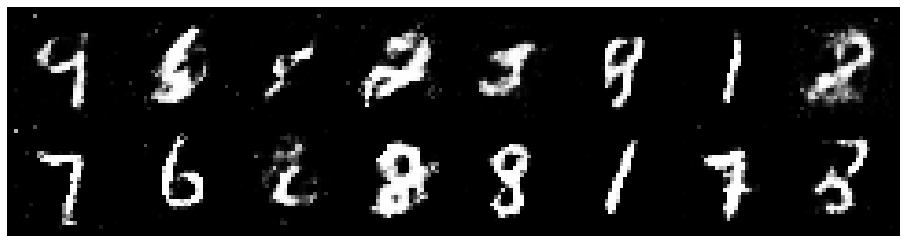

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.1142, Generator Loss: 0.9535
D(x): 0.5840, D(G(z)): 0.3865


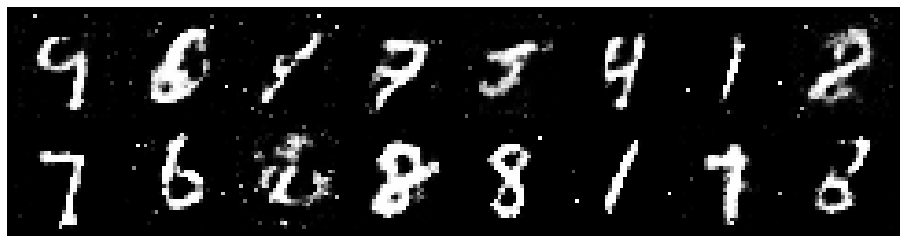

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.2628, Generator Loss: 0.8981
D(x): 0.5383, D(G(z)): 0.4385


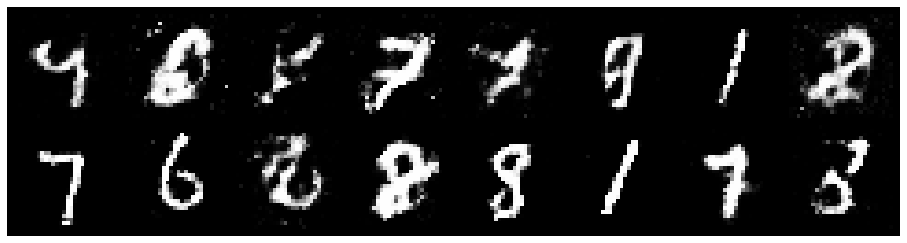

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.2035, Generator Loss: 0.8819
D(x): 0.5494, D(G(z)): 0.4096


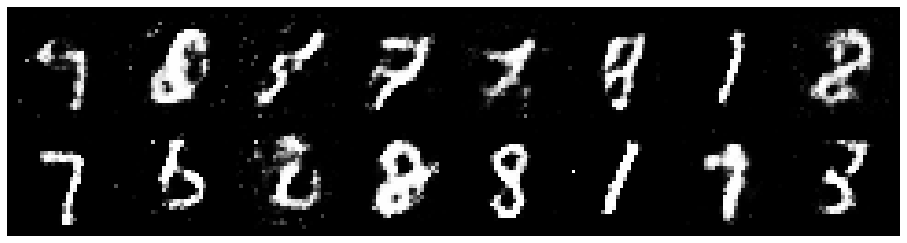

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.1842, Generator Loss: 0.9596
D(x): 0.5490, D(G(z)): 0.3891


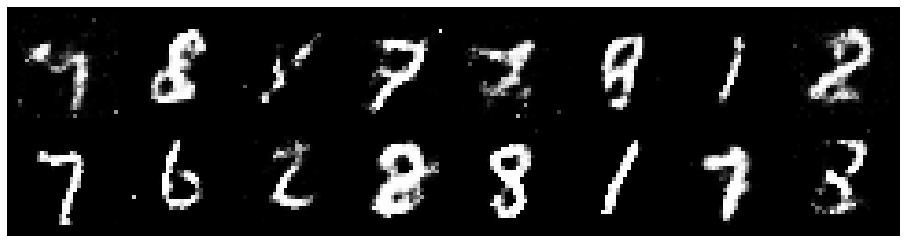

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.1616, Generator Loss: 0.9640
D(x): 0.5575, D(G(z)): 0.3822


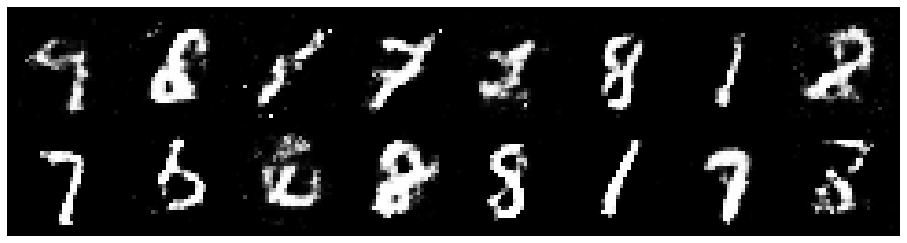

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.2572, Generator Loss: 0.9578
D(x): 0.5438, D(G(z)): 0.4348


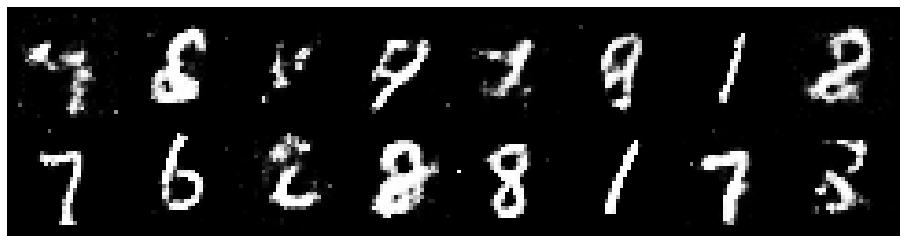

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.2852, Generator Loss: 0.8433
D(x): 0.5464, D(G(z)): 0.4501


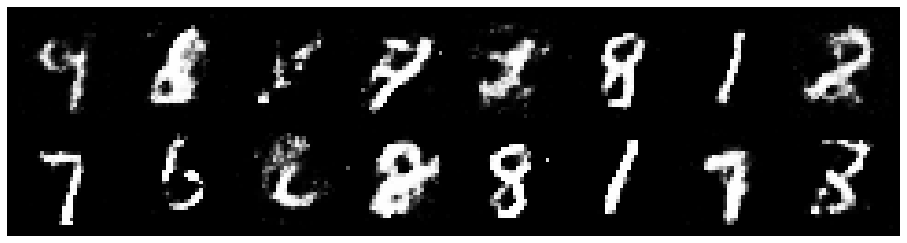

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.2815, Generator Loss: 0.7999
D(x): 0.5181, D(G(z)): 0.4107


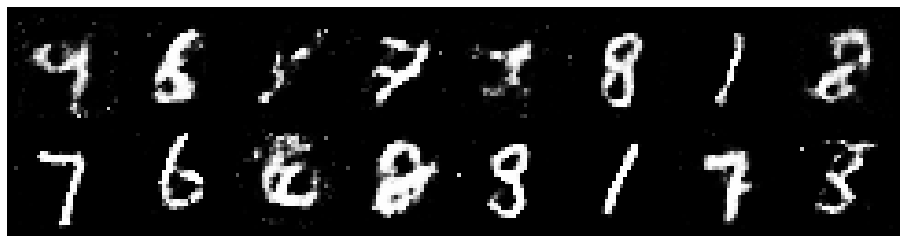

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.2027, Generator Loss: 1.0142
D(x): 0.5385, D(G(z)): 0.4039


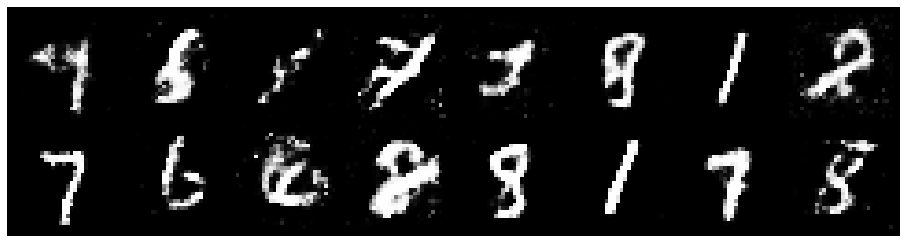

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.1567, Generator Loss: 0.9541
D(x): 0.5958, D(G(z)): 0.4081


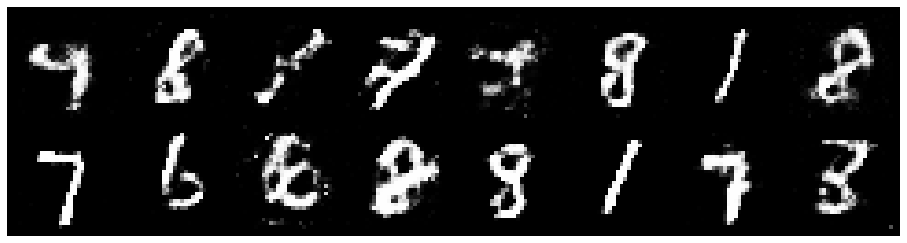

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.1475, Generator Loss: 0.8413
D(x): 0.5937, D(G(z)): 0.4212


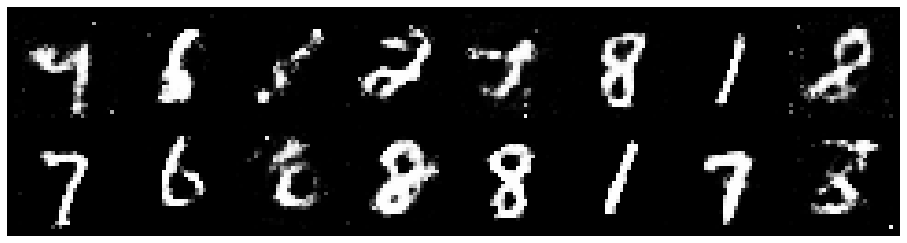

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.3186, Generator Loss: 0.7450
D(x): 0.5451, D(G(z)): 0.4672


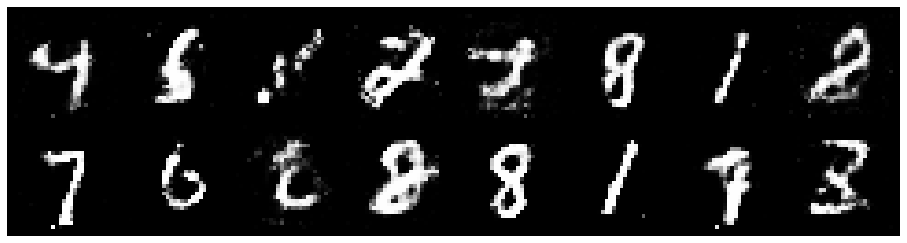

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.3628, Generator Loss: 0.9146
D(x): 0.5316, D(G(z)): 0.4580


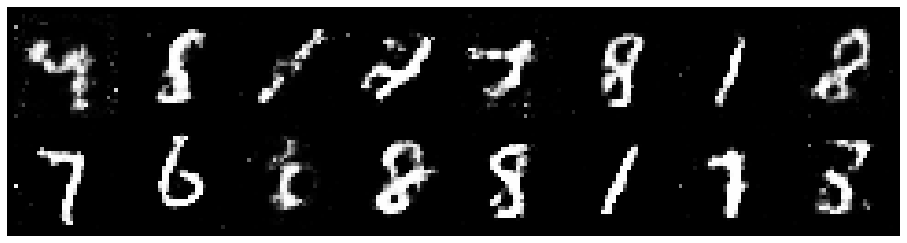

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.3157, Generator Loss: 0.8467
D(x): 0.5295, D(G(z)): 0.4537


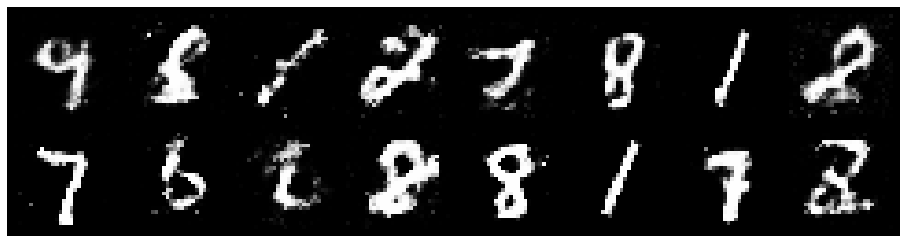

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.4161, Generator Loss: 0.8158
D(x): 0.5499, D(G(z)): 0.4894


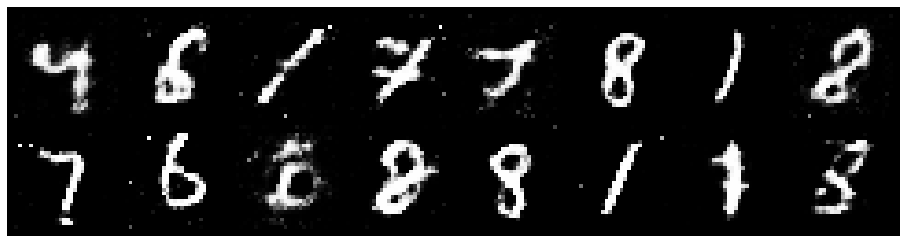

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.1937, Generator Loss: 0.9518
D(x): 0.6008, D(G(z)): 0.4455


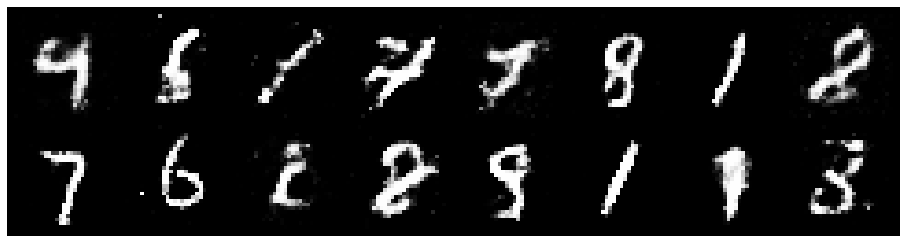

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.2694, Generator Loss: 0.9225
D(x): 0.5544, D(G(z)): 0.4574


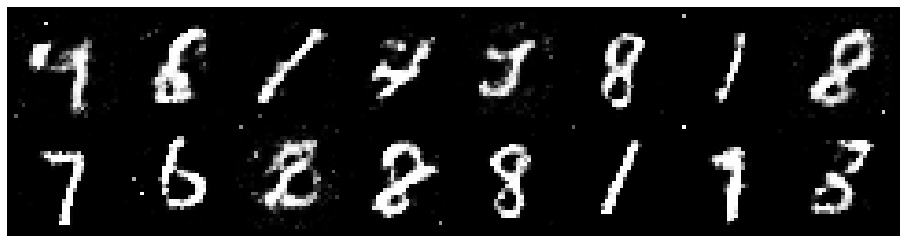

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.2077, Generator Loss: 0.8792
D(x): 0.5605, D(G(z)): 0.4258


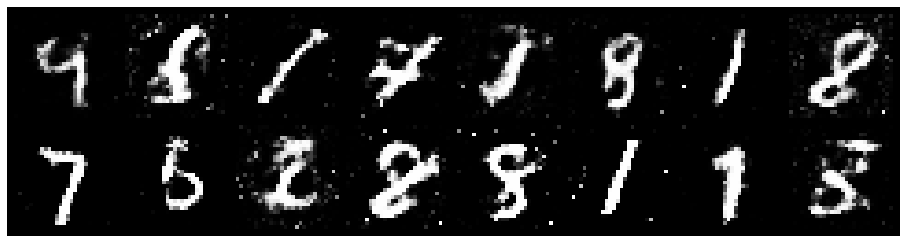

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.1740, Generator Loss: 0.8381
D(x): 0.5757, D(G(z)): 0.4264


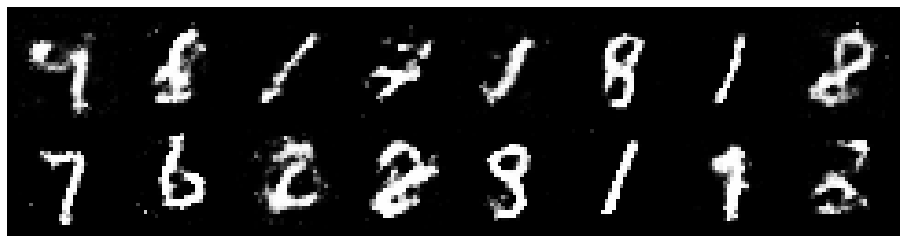

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.2257, Generator Loss: 0.9058
D(x): 0.6079, D(G(z)): 0.4760


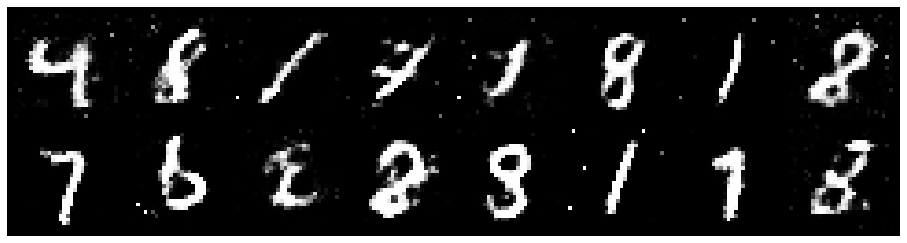

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.2208, Generator Loss: 0.8751
D(x): 0.5762, D(G(z)): 0.4282


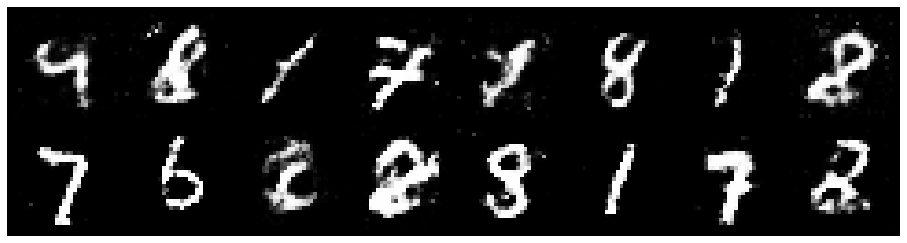

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.3196, Generator Loss: 0.8094
D(x): 0.5301, D(G(z)): 0.4492


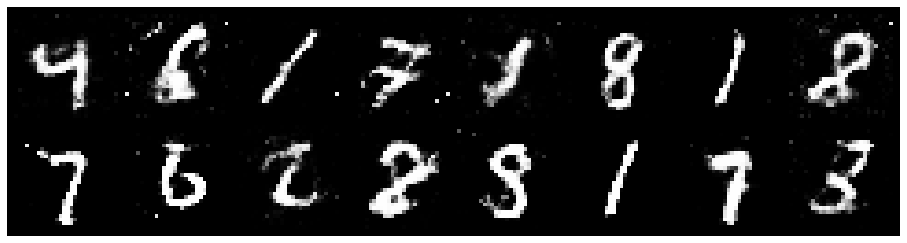

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.2538, Generator Loss: 0.9587
D(x): 0.5403, D(G(z)): 0.4193


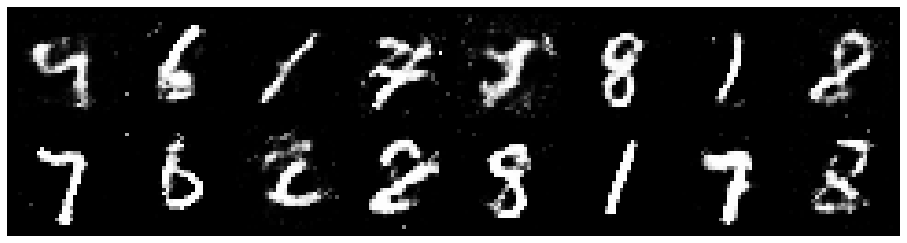

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.3065, Generator Loss: 0.8995
D(x): 0.5763, D(G(z)): 0.4698


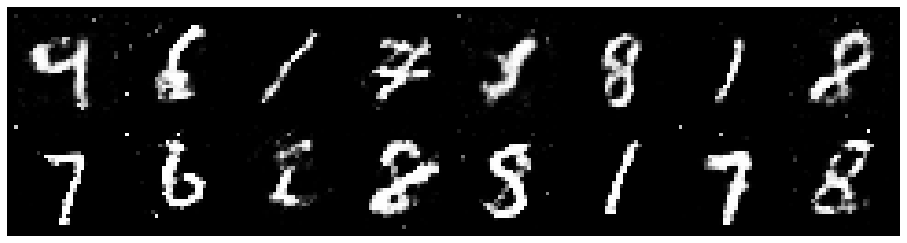

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.1872, Generator Loss: 0.8401
D(x): 0.5666, D(G(z)): 0.4262


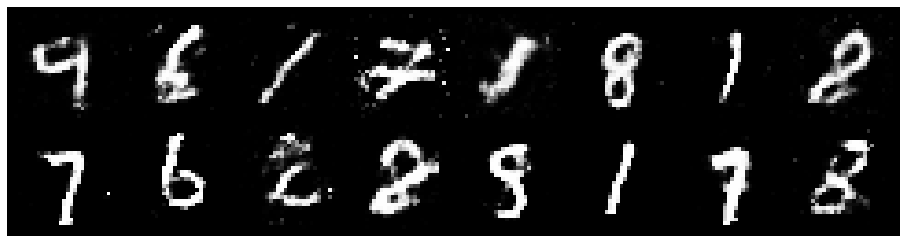

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.2599, Generator Loss: 0.9213
D(x): 0.5424, D(G(z)): 0.4089


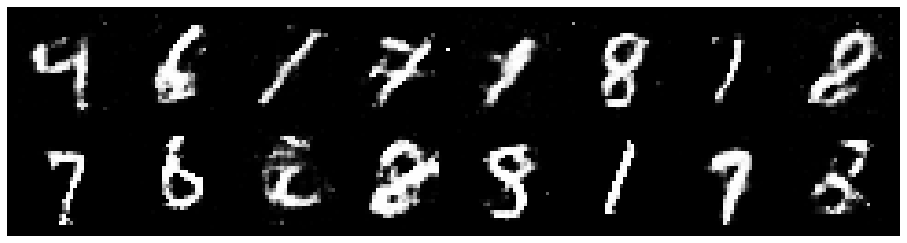

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.2763, Generator Loss: 0.8177
D(x): 0.5293, D(G(z)): 0.4463


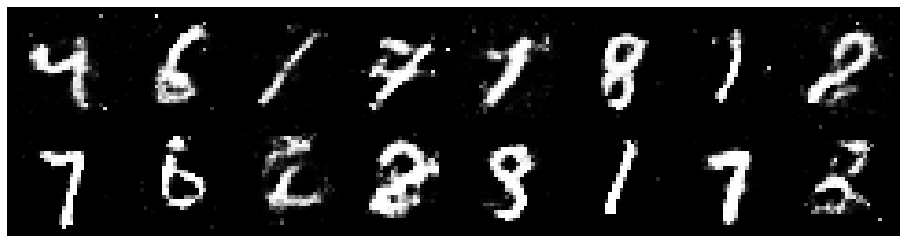

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.3011, Generator Loss: 0.7992
D(x): 0.5618, D(G(z)): 0.4637


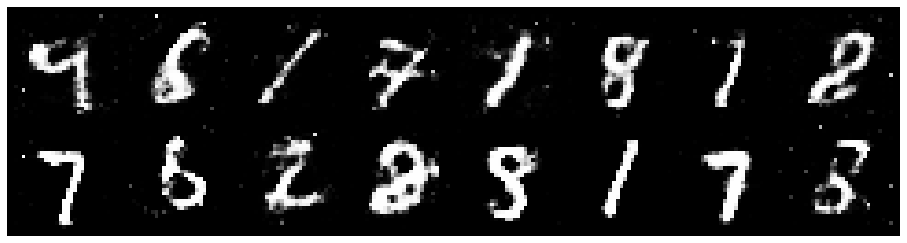

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2703, Generator Loss: 1.0728
D(x): 0.5314, D(G(z)): 0.3975


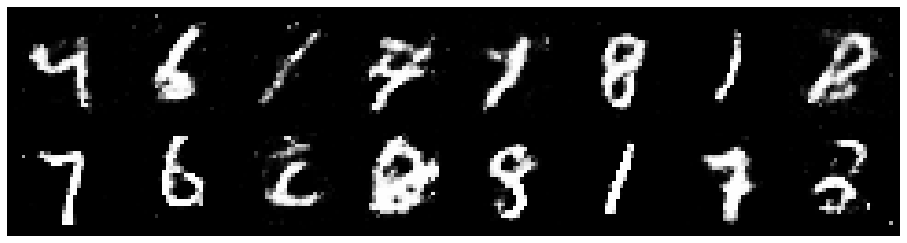

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.1765, Generator Loss: 0.9877
D(x): 0.6090, D(G(z)): 0.4501


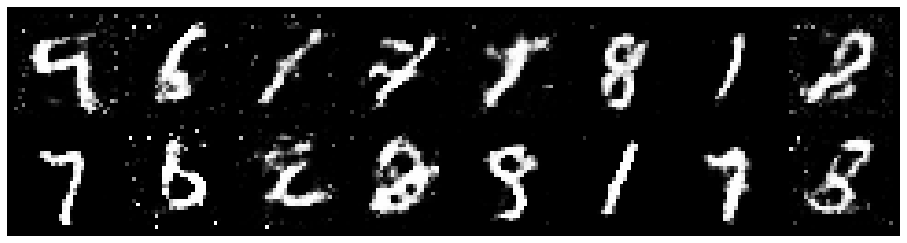

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.3408, Generator Loss: 0.8808
D(x): 0.5596, D(G(z)): 0.4789


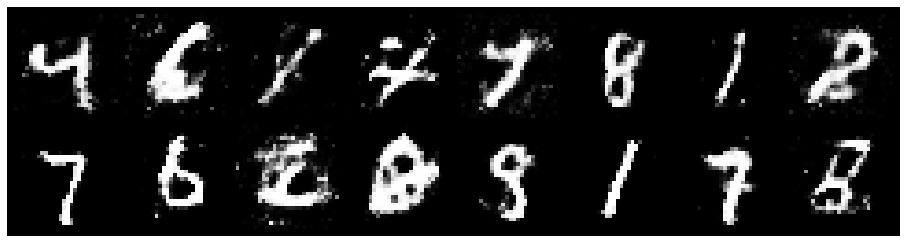

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.1633, Generator Loss: 1.0444
D(x): 0.6217, D(G(z)): 0.4366


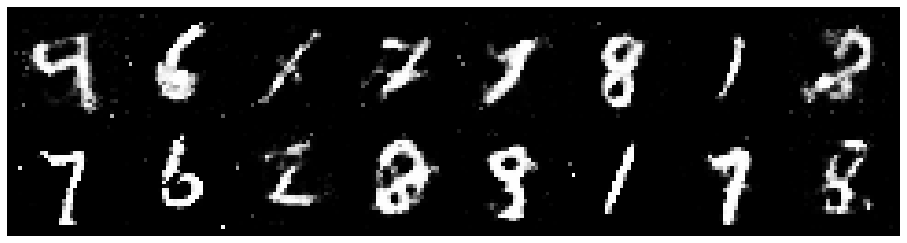

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.2699, Generator Loss: 0.7330
D(x): 0.5503, D(G(z)): 0.4552


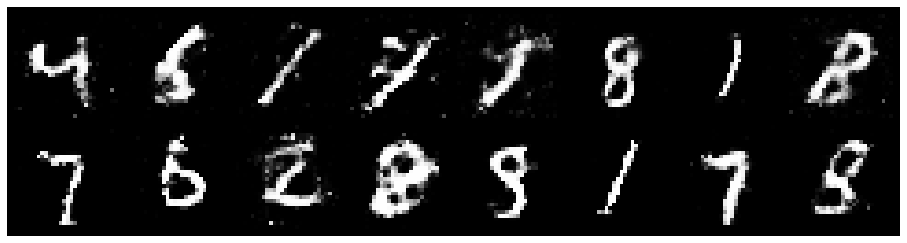

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.2516, Generator Loss: 0.7944
D(x): 0.5562, D(G(z)): 0.4514


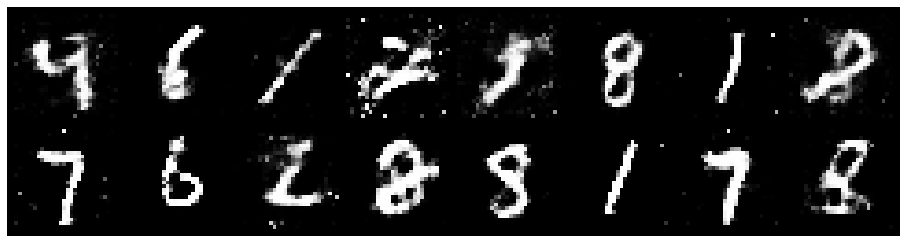

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.2471, Generator Loss: 0.9404
D(x): 0.5588, D(G(z)): 0.4461


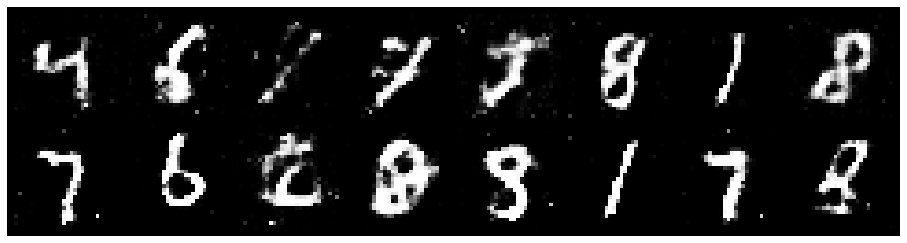

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.2326, Generator Loss: 0.9395
D(x): 0.5908, D(G(z)): 0.4337


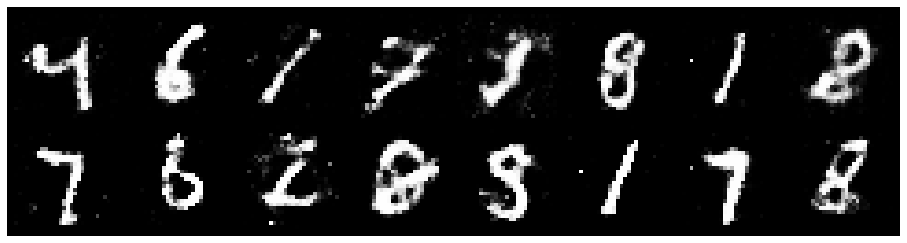

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.2552, Generator Loss: 0.8309
D(x): 0.6051, D(G(z)): 0.4630


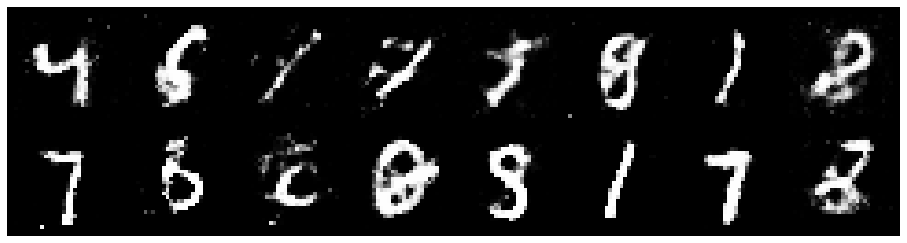

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.1303, Generator Loss: 0.8510
D(x): 0.6521, D(G(z)): 0.4663


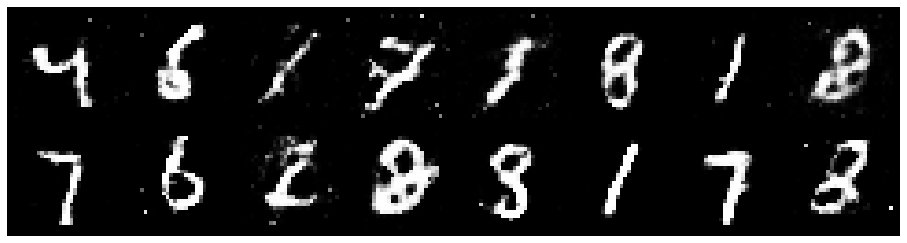

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.2642, Generator Loss: 0.9506
D(x): 0.5575, D(G(z)): 0.4439


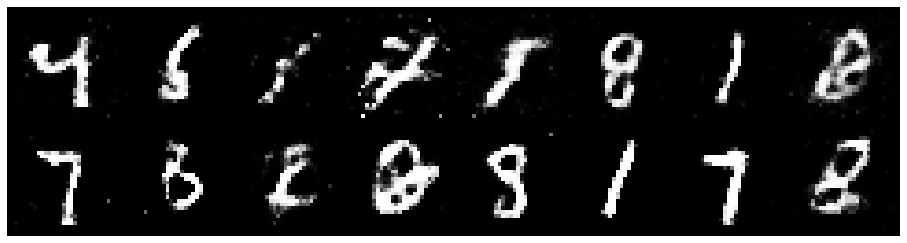

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.1668, Generator Loss: 0.9660
D(x): 0.5639, D(G(z)): 0.3922


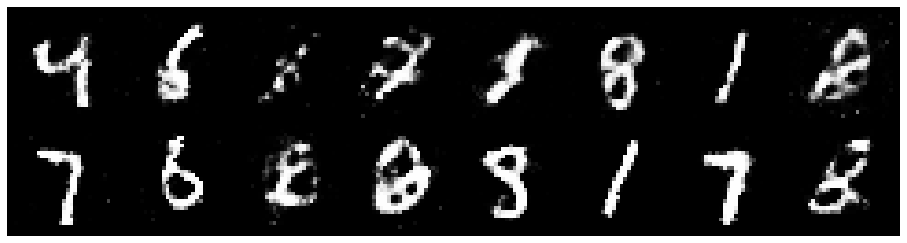

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.2539, Generator Loss: 0.9667
D(x): 0.5728, D(G(z)): 0.4458


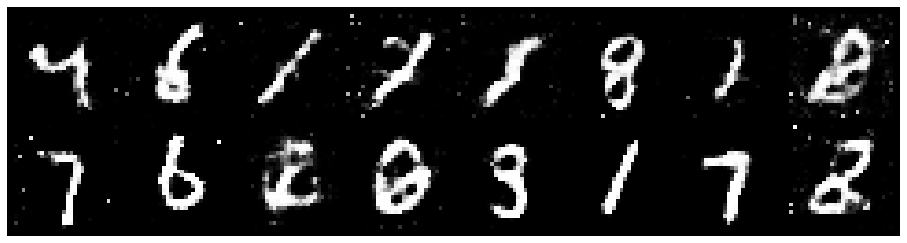

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.2764, Generator Loss: 0.9050
D(x): 0.5895, D(G(z)): 0.4714


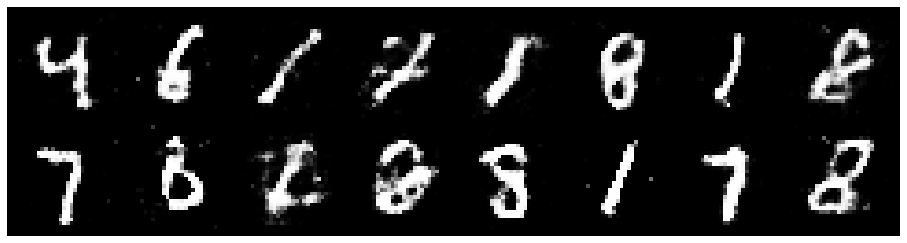

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.3559, Generator Loss: 0.7762
D(x): 0.5588, D(G(z)): 0.4691


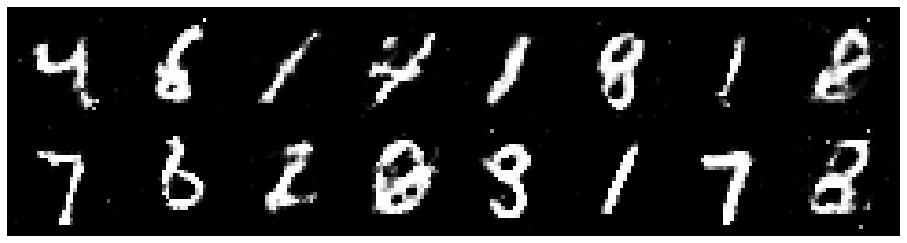

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.3026, Generator Loss: 0.8930
D(x): 0.5637, D(G(z)): 0.4491


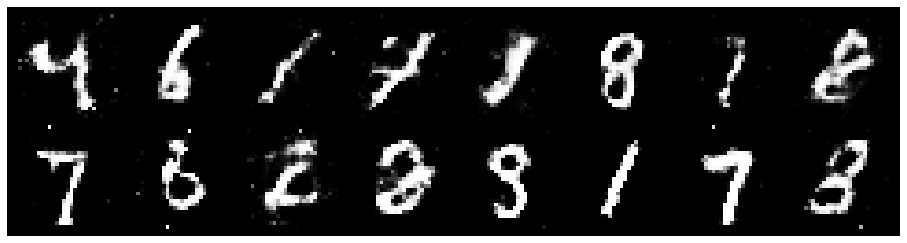

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.3147, Generator Loss: 0.9277
D(x): 0.5564, D(G(z)): 0.4587


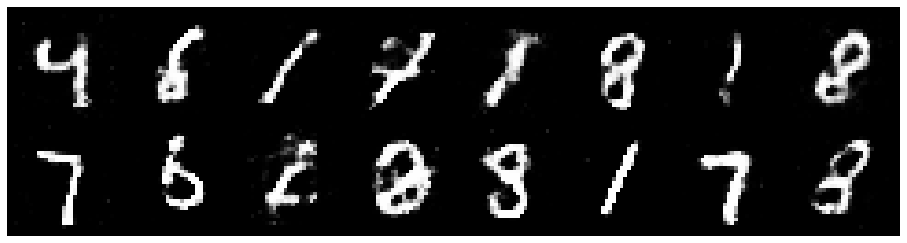

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.3552, Generator Loss: 0.8703
D(x): 0.5804, D(G(z)): 0.4920


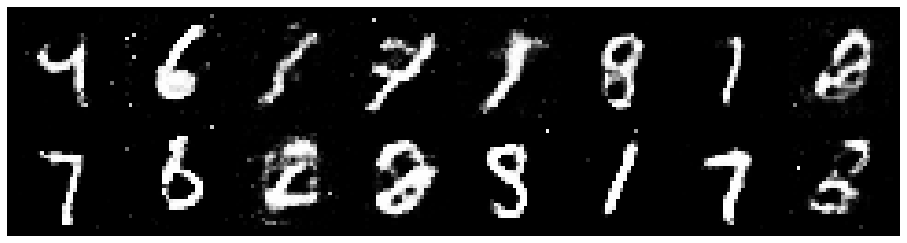

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.2991, Generator Loss: 0.9403
D(x): 0.6011, D(G(z)): 0.4862


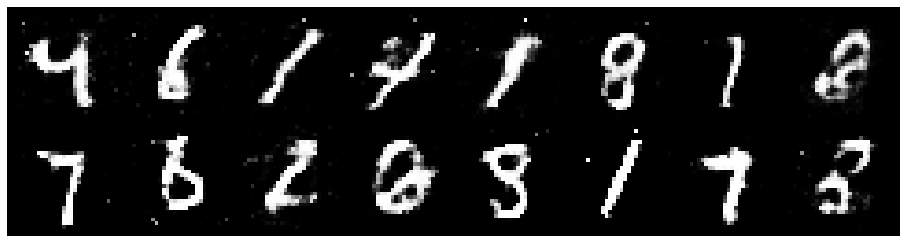

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.3744, Generator Loss: 0.8863
D(x): 0.5874, D(G(z)): 0.4679


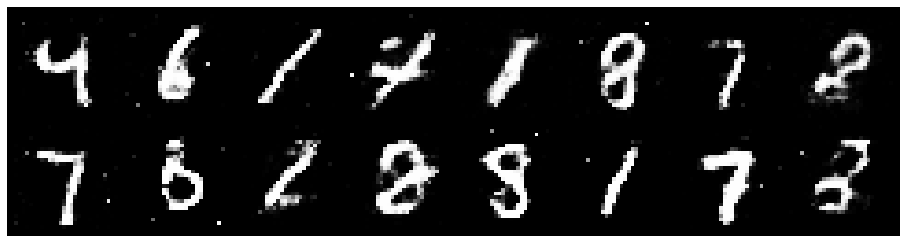

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.3036, Generator Loss: 0.8590
D(x): 0.5825, D(G(z)): 0.4728


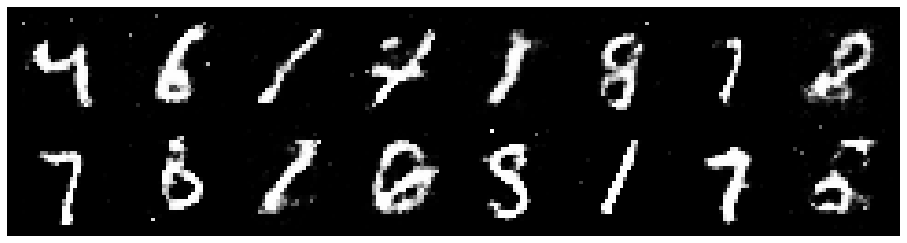

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.4102, Generator Loss: 0.9926
D(x): 0.5317, D(G(z)): 0.4546


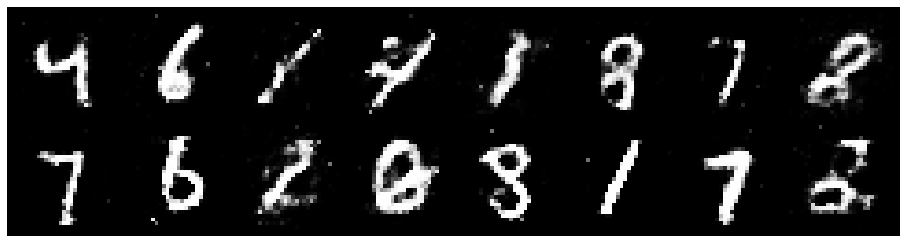

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.1832, Generator Loss: 0.9993
D(x): 0.5668, D(G(z)): 0.4063


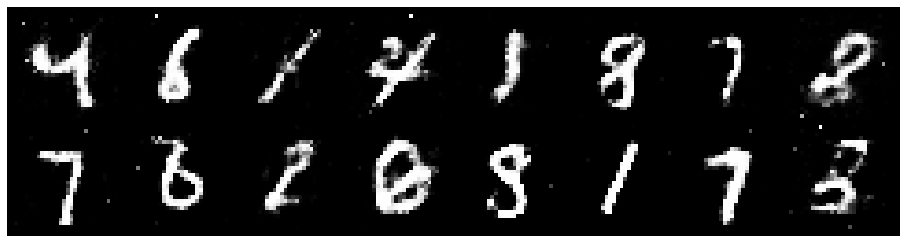

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.2132, Generator Loss: 0.8822
D(x): 0.5442, D(G(z)): 0.4106


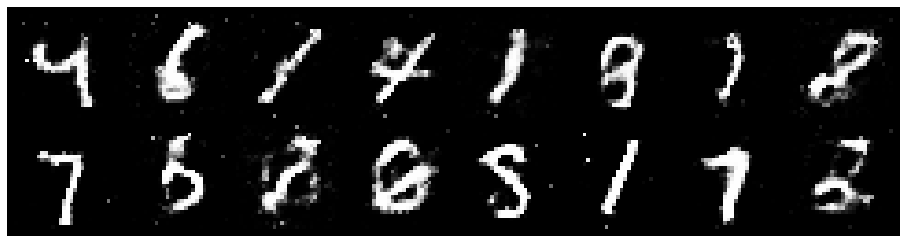

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.2432, Generator Loss: 0.7706
D(x): 0.5651, D(G(z)): 0.4503


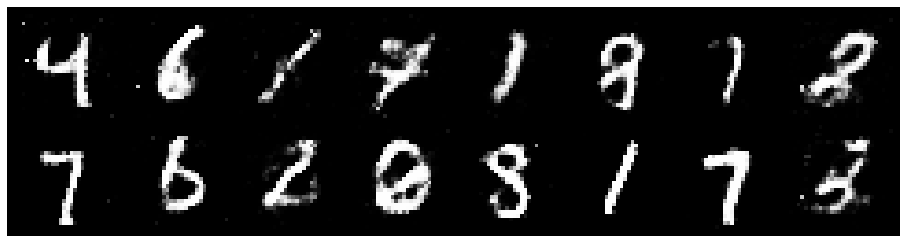

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.3067, Generator Loss: 0.9073
D(x): 0.5589, D(G(z)): 0.4566


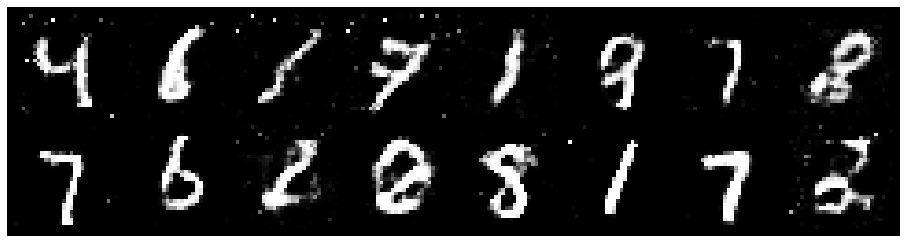

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.2981, Generator Loss: 1.0205
D(x): 0.5807, D(G(z)): 0.4374


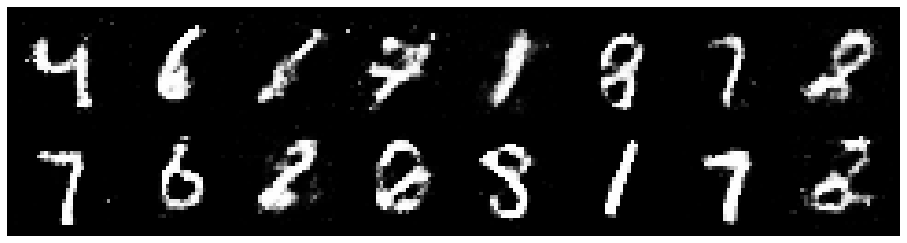

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.2608, Generator Loss: 0.8770
D(x): 0.5662, D(G(z)): 0.4328


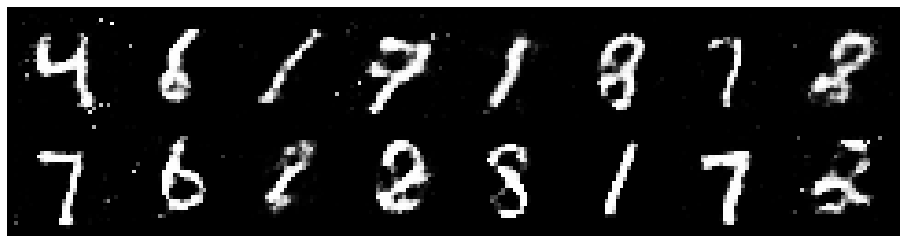

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.2183, Generator Loss: 0.8900
D(x): 0.5506, D(G(z)): 0.4154


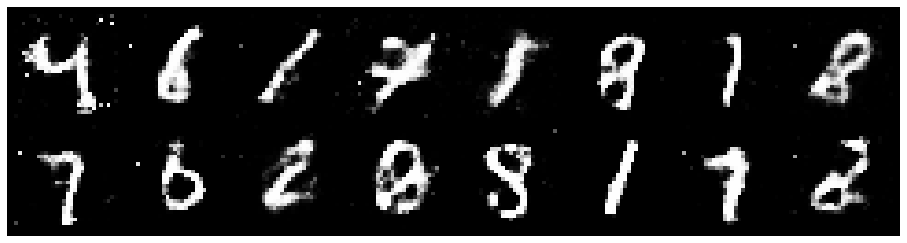

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.2703, Generator Loss: 0.9301
D(x): 0.5395, D(G(z)): 0.4310


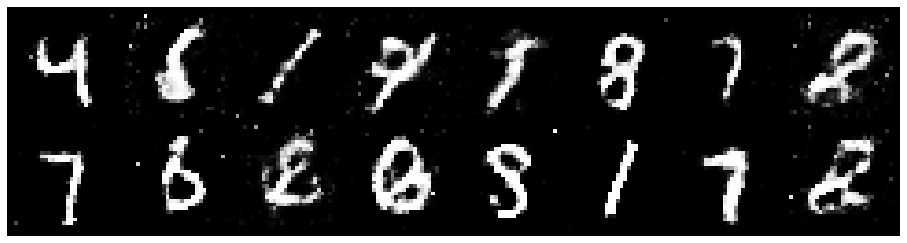

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.2381, Generator Loss: 0.8509
D(x): 0.5461, D(G(z)): 0.4289


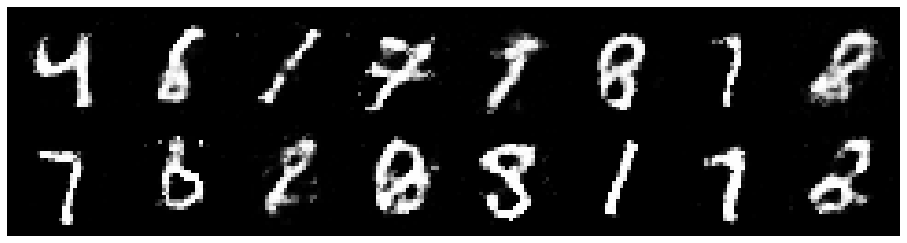

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.2411, Generator Loss: 0.7975
D(x): 0.5577, D(G(z)): 0.4504


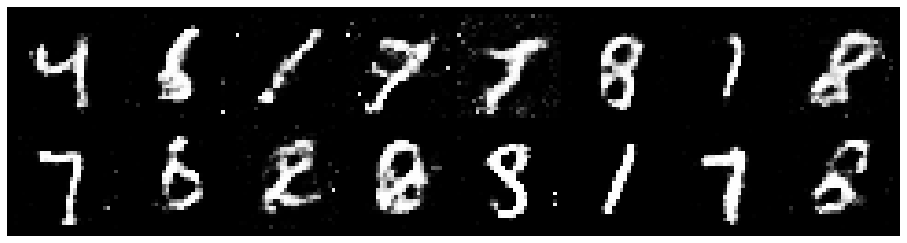

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.3182, Generator Loss: 0.8662
D(x): 0.5114, D(G(z)): 0.4187


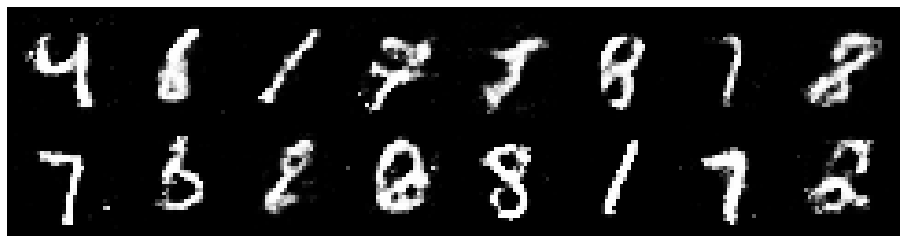

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.2907, Generator Loss: 0.8838
D(x): 0.5992, D(G(z)): 0.4727


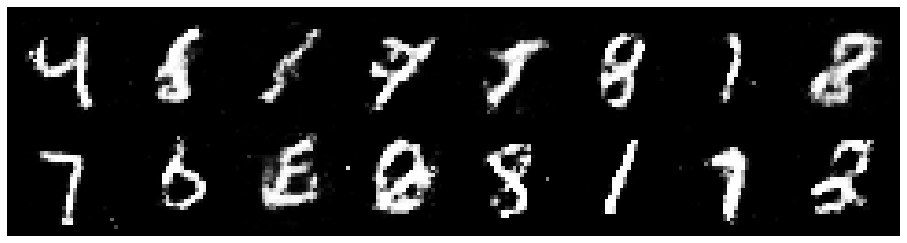

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2660, Generator Loss: 0.8880
D(x): 0.5701, D(G(z)): 0.4483


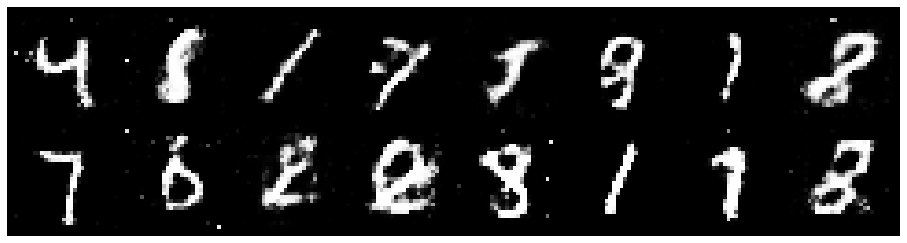

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.4109, Generator Loss: 0.8060
D(x): 0.5468, D(G(z)): 0.4788


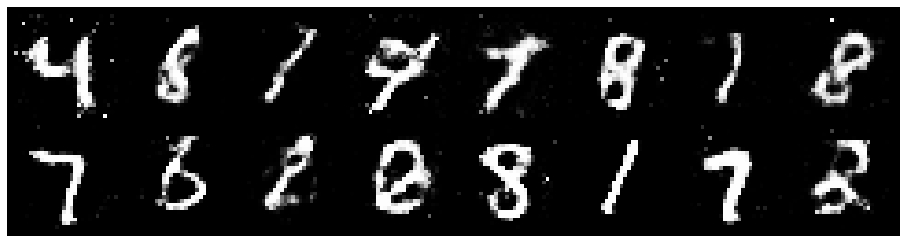

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.0979, Generator Loss: 0.9763
D(x): 0.5988, D(G(z)): 0.4039


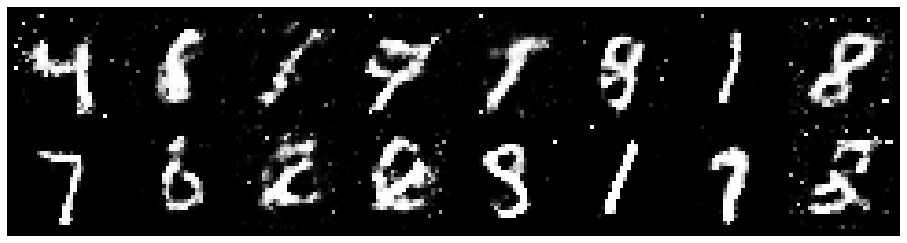

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.3335, Generator Loss: 0.8165
D(x): 0.5480, D(G(z)): 0.4624


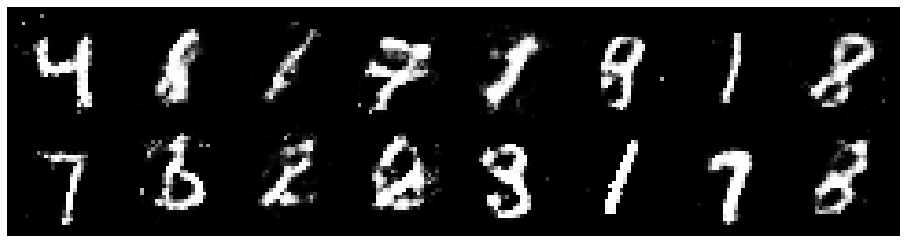

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.1775, Generator Loss: 0.8630
D(x): 0.5796, D(G(z)): 0.4401


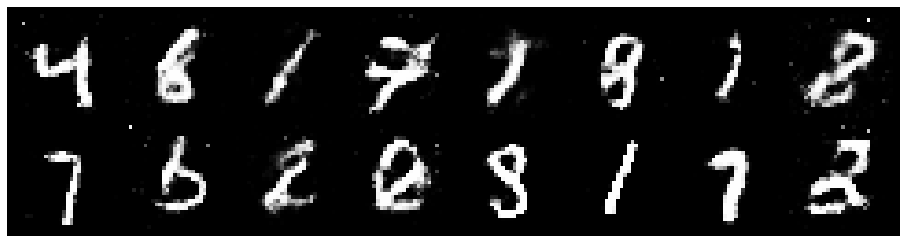

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.1837, Generator Loss: 1.0776
D(x): 0.5656, D(G(z)): 0.3991


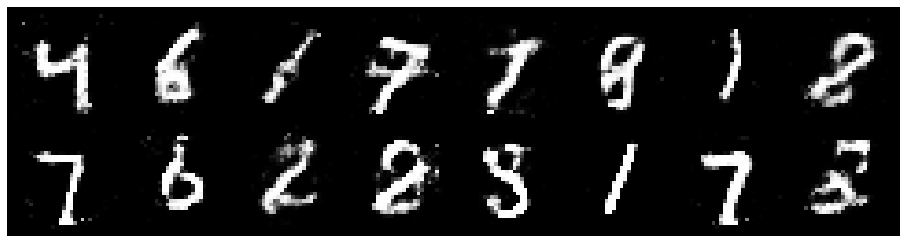

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.1545, Generator Loss: 1.0691
D(x): 0.6024, D(G(z)): 0.4225


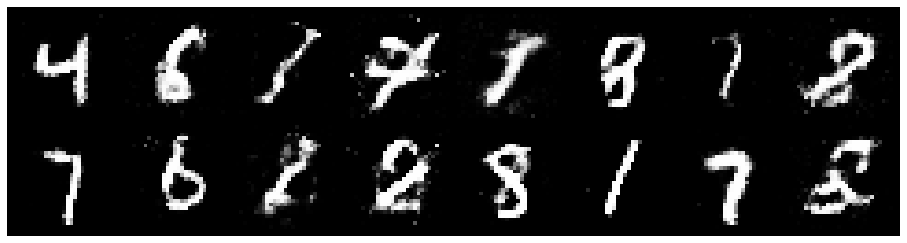

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.3391, Generator Loss: 0.8718
D(x): 0.5845, D(G(z)): 0.4900


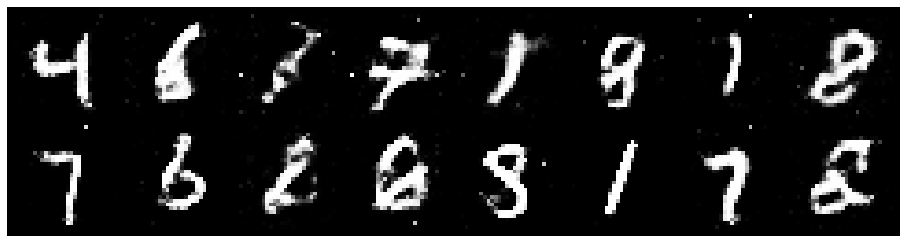

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.3219, Generator Loss: 0.9559
D(x): 0.5449, D(G(z)): 0.4604


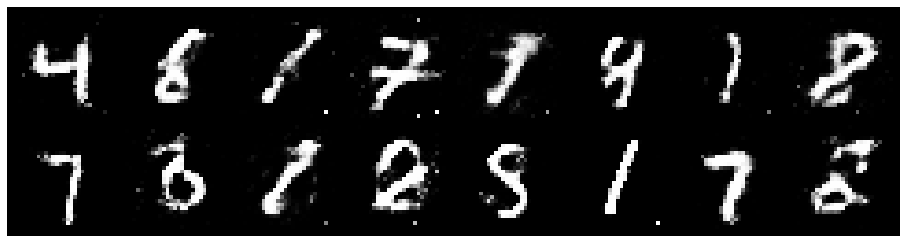

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.0577, Generator Loss: 1.0266
D(x): 0.5991, D(G(z)): 0.3810


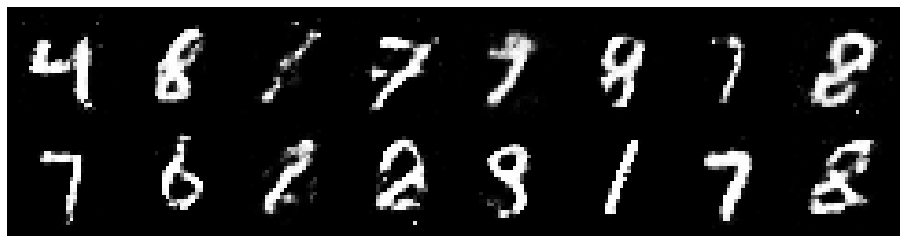

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.1995, Generator Loss: 0.8806
D(x): 0.6043, D(G(z)): 0.4562


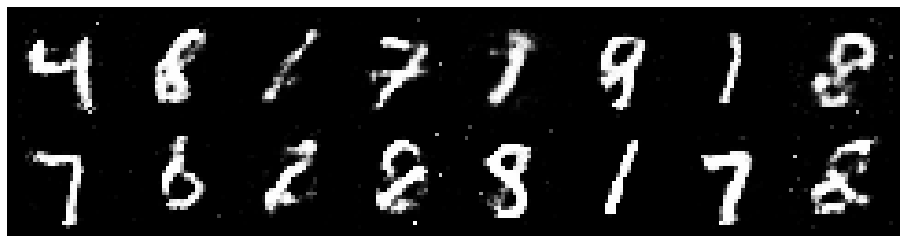

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.2152, Generator Loss: 0.8995
D(x): 0.5792, D(G(z)): 0.4250


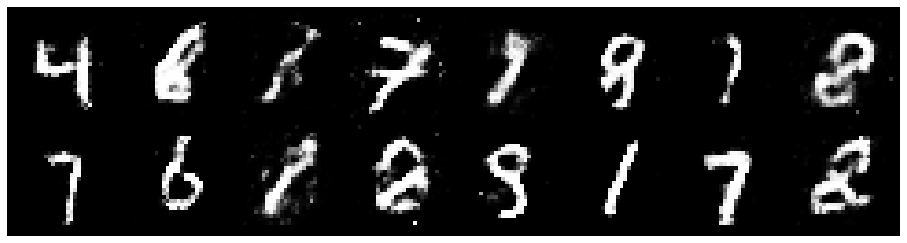

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.2672, Generator Loss: 0.9203
D(x): 0.5517, D(G(z)): 0.4244


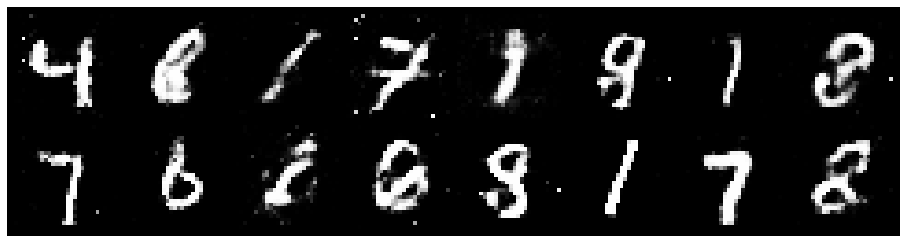

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.2198, Generator Loss: 0.8862
D(x): 0.6059, D(G(z)): 0.4536


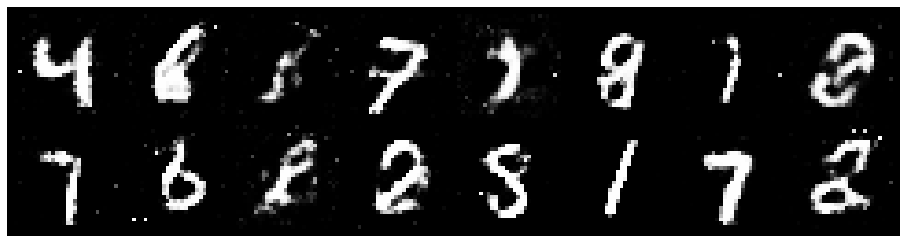

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.2497, Generator Loss: 0.8808
D(x): 0.5946, D(G(z)): 0.4695


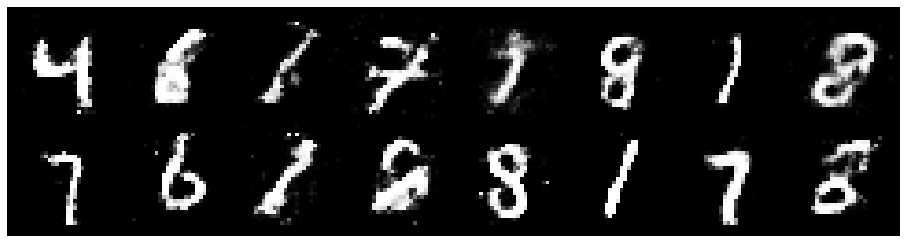

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.1991, Generator Loss: 0.9442
D(x): 0.5762, D(G(z)): 0.4285


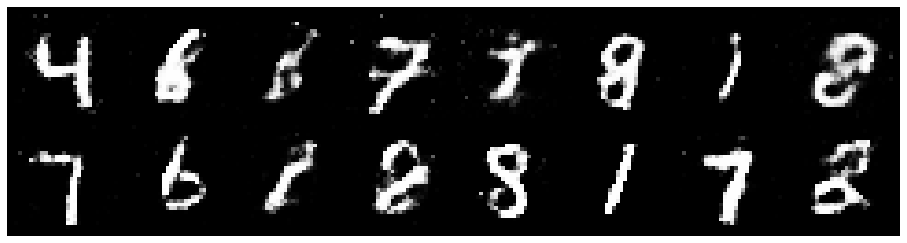

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.3254, Generator Loss: 0.8194
D(x): 0.5211, D(G(z)): 0.4540


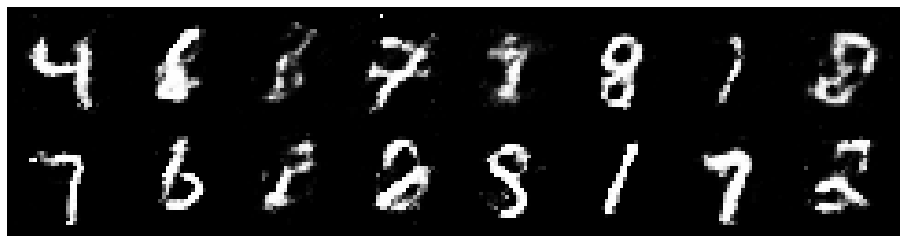

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.2307, Generator Loss: 0.9532
D(x): 0.5468, D(G(z)): 0.4113


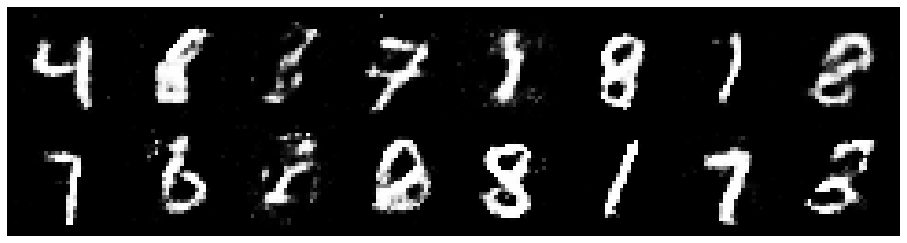

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.2768, Generator Loss: 0.8539
D(x): 0.5452, D(G(z)): 0.4287


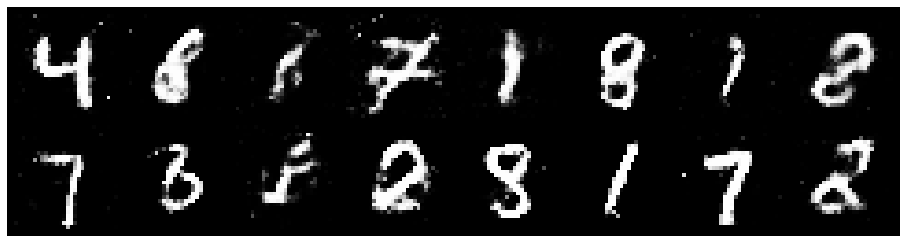

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.3025, Generator Loss: 0.8666
D(x): 0.5350, D(G(z)): 0.4523


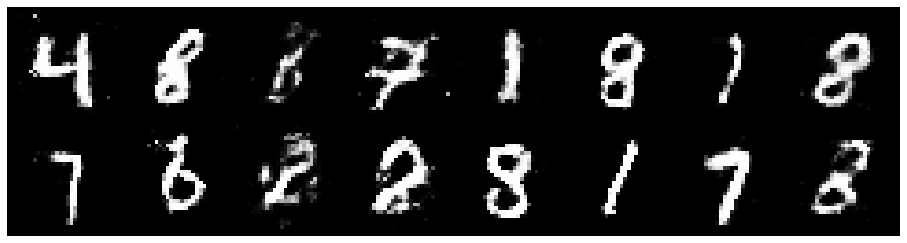

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2280, Generator Loss: 0.7778
D(x): 0.5701, D(G(z)): 0.4501


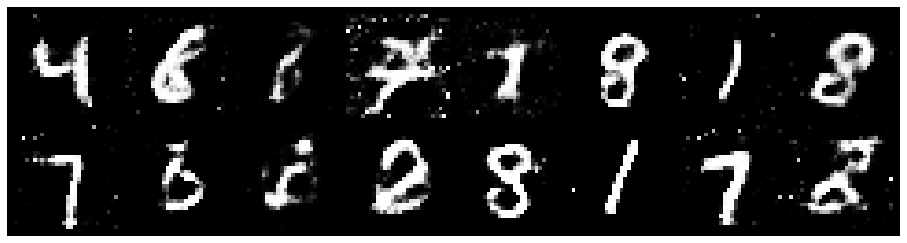

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.3588, Generator Loss: 0.8480
D(x): 0.5325, D(G(z)): 0.4795


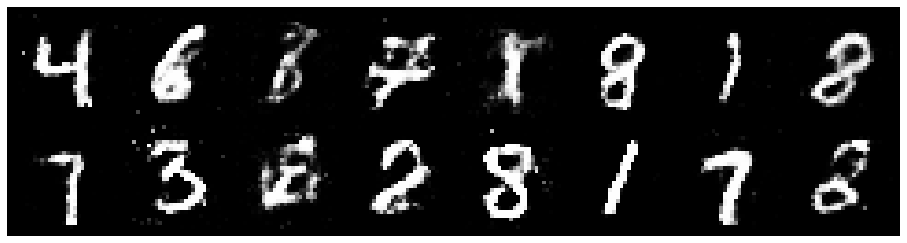

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.2606, Generator Loss: 0.9145
D(x): 0.5441, D(G(z)): 0.4367


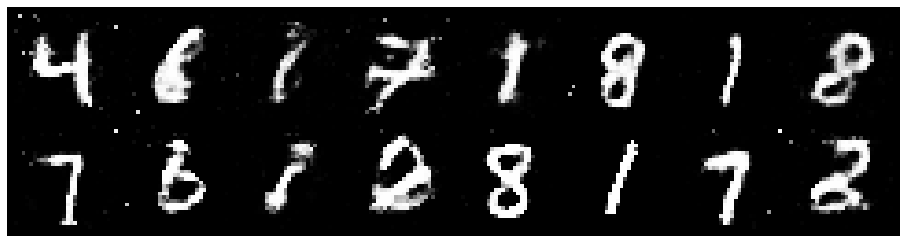

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.3106, Generator Loss: 0.9215
D(x): 0.5257, D(G(z)): 0.4369


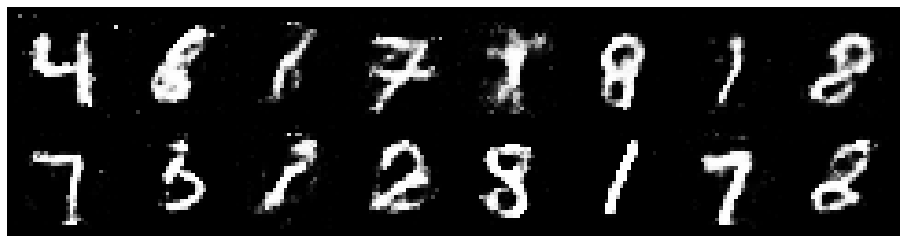

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.3596, Generator Loss: 0.8490
D(x): 0.5178, D(G(z)): 0.4511


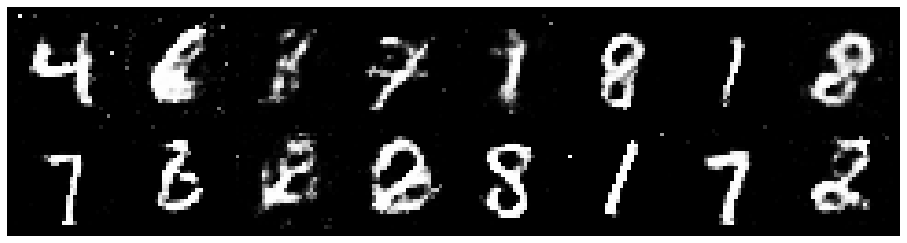

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.1976, Generator Loss: 0.8508
D(x): 0.6124, D(G(z)): 0.4413


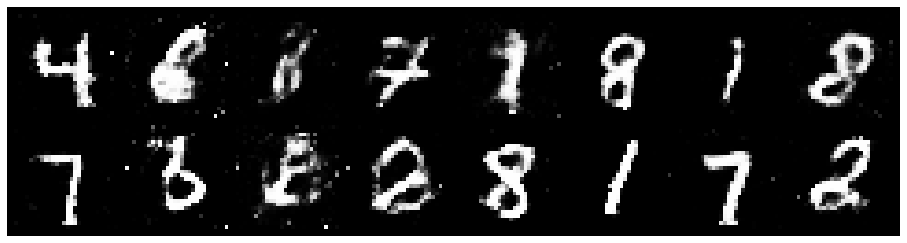

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.2483, Generator Loss: 0.8763
D(x): 0.5655, D(G(z)): 0.4409


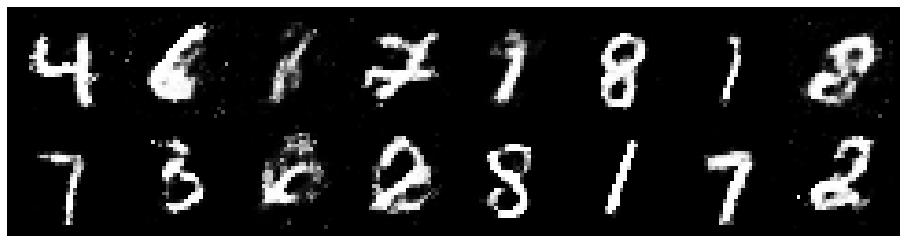

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.3184, Generator Loss: 0.8464
D(x): 0.5362, D(G(z)): 0.4679


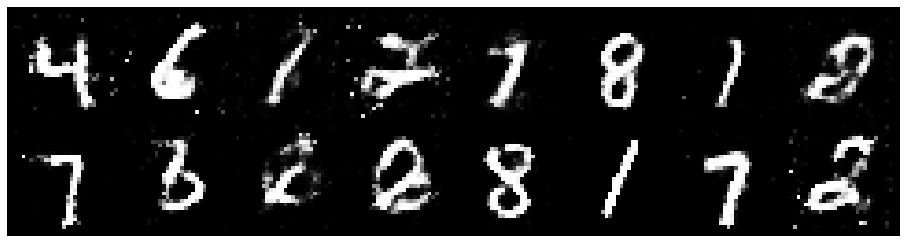

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2935, Generator Loss: 0.7809
D(x): 0.5706, D(G(z)): 0.4790


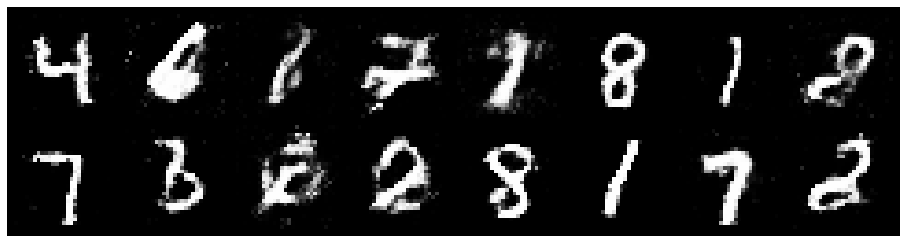

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.3160, Generator Loss: 0.8278
D(x): 0.5375, D(G(z)): 0.4487


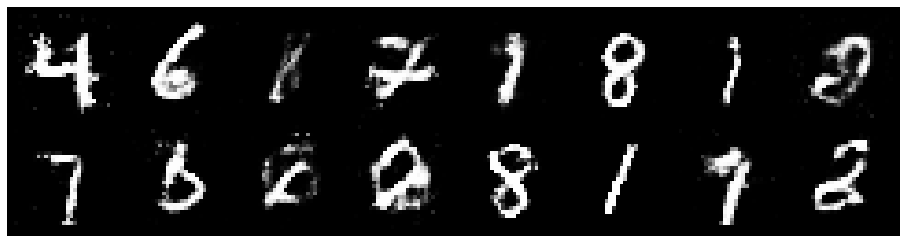

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.2958, Generator Loss: 0.7514
D(x): 0.5395, D(G(z)): 0.4629


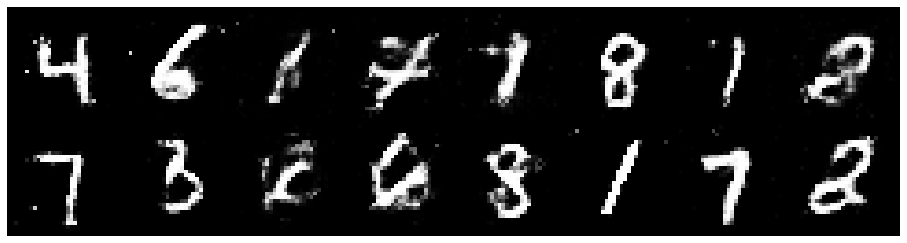

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.3038, Generator Loss: 0.7665
D(x): 0.5653, D(G(z)): 0.4882


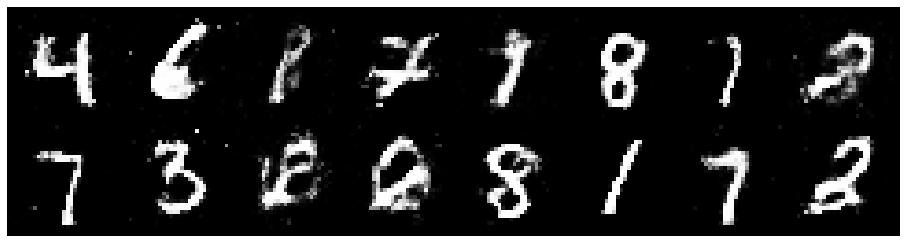

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.3365, Generator Loss: 0.8163
D(x): 0.5612, D(G(z)): 0.4966


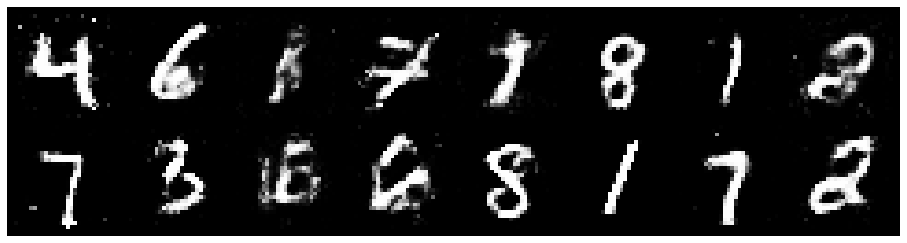

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.3216, Generator Loss: 0.8792
D(x): 0.5708, D(G(z)): 0.4767


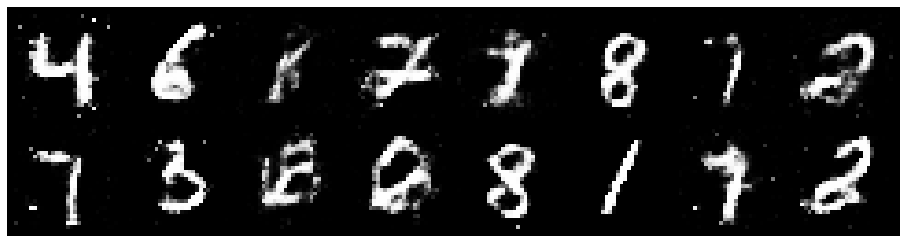

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.2175, Generator Loss: 0.9960
D(x): 0.5793, D(G(z)): 0.4386


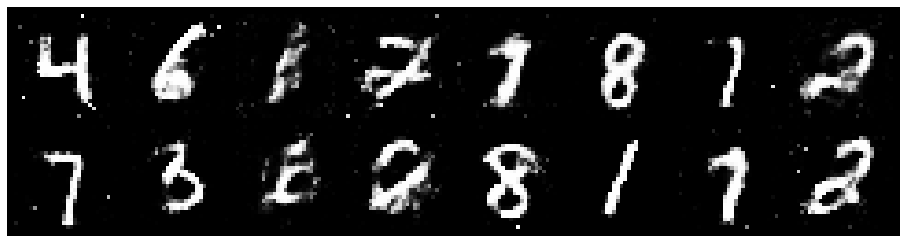

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.1681, Generator Loss: 0.9305
D(x): 0.5662, D(G(z)): 0.4178


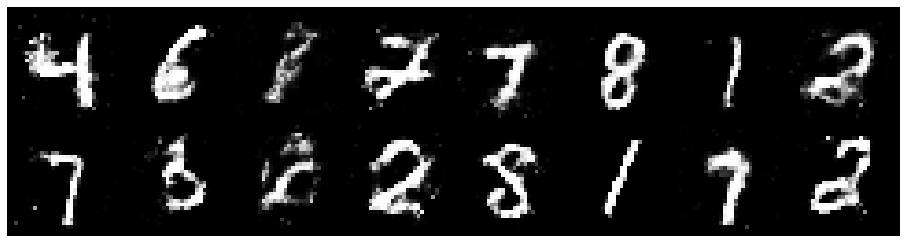

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.3037, Generator Loss: 0.8446
D(x): 0.6053, D(G(z)): 0.5019


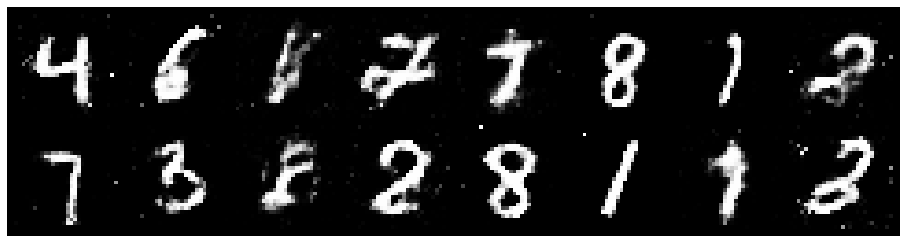

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.1762, Generator Loss: 0.7608
D(x): 0.5986, D(G(z)): 0.4490


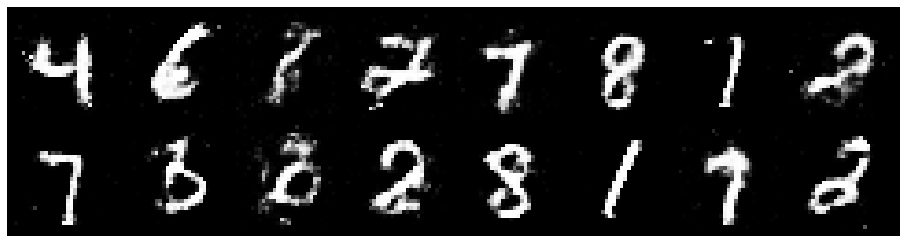

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.2113, Generator Loss: 0.9335
D(x): 0.5610, D(G(z)): 0.4077


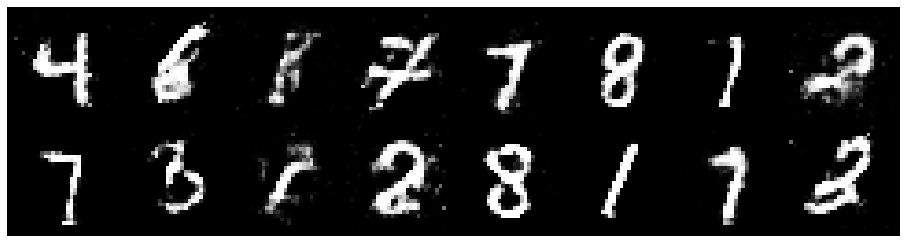

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.1986, Generator Loss: 1.1059
D(x): 0.5820, D(G(z)): 0.4097


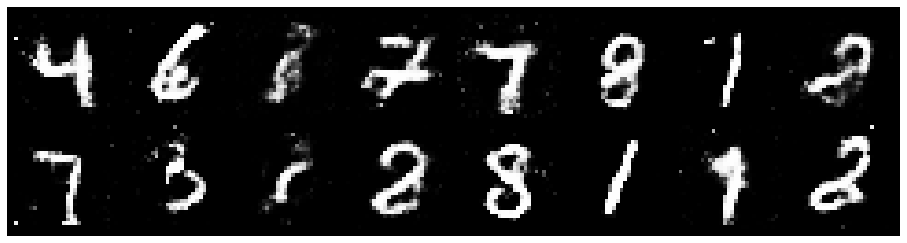

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.1885, Generator Loss: 0.9925
D(x): 0.5814, D(G(z)): 0.4298


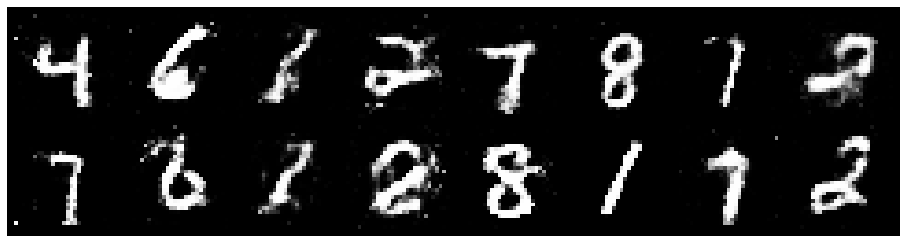

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.1967, Generator Loss: 1.0980
D(x): 0.5507, D(G(z)): 0.3911


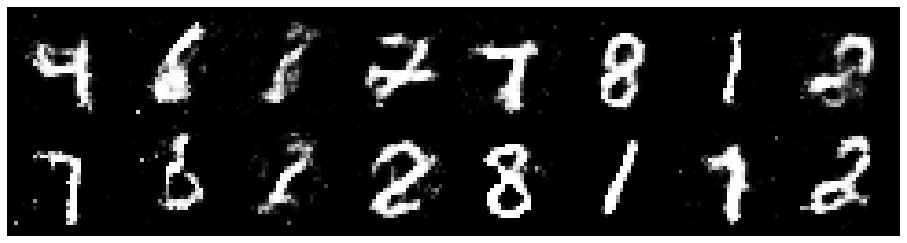

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.3364, Generator Loss: 1.0179
D(x): 0.5128, D(G(z)): 0.4422


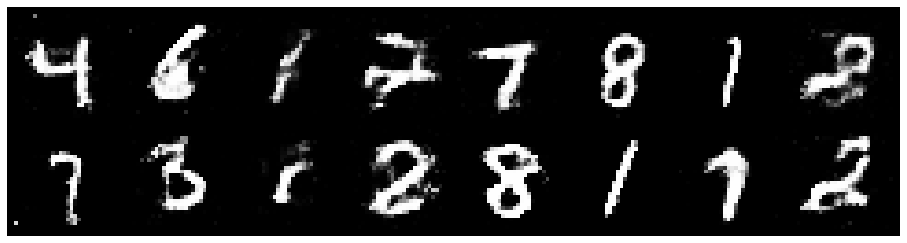

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.4816, Generator Loss: 0.8410
D(x): 0.5577, D(G(z)): 0.5112


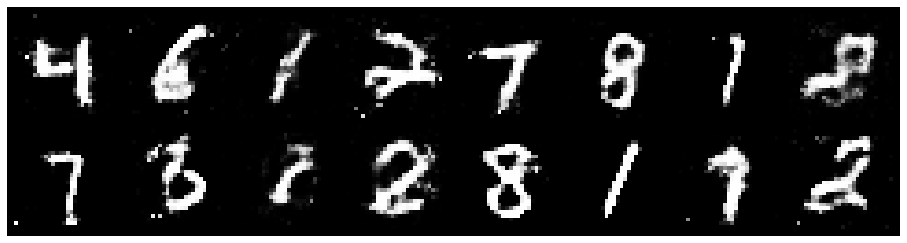

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.3208, Generator Loss: 0.8778
D(x): 0.5664, D(G(z)): 0.4778


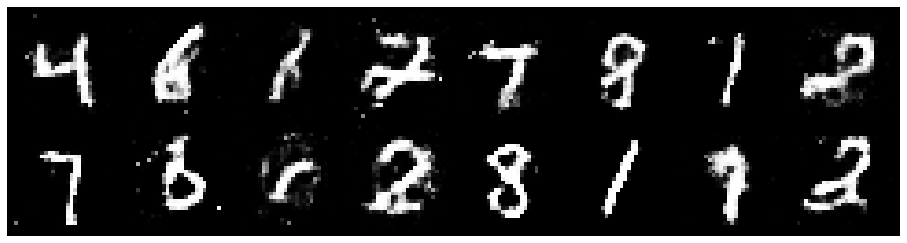

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.3283, Generator Loss: 0.8802
D(x): 0.5876, D(G(z)): 0.4885


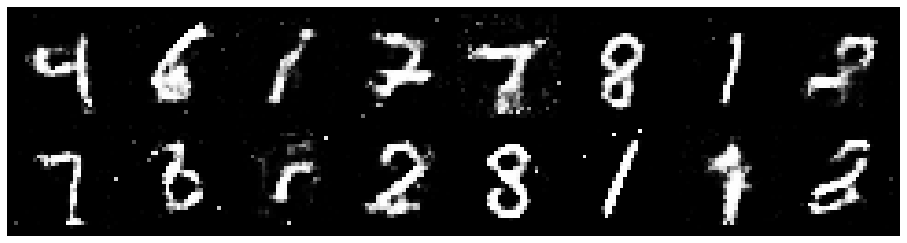

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.4068, Generator Loss: 0.7174
D(x): 0.5766, D(G(z)): 0.4849


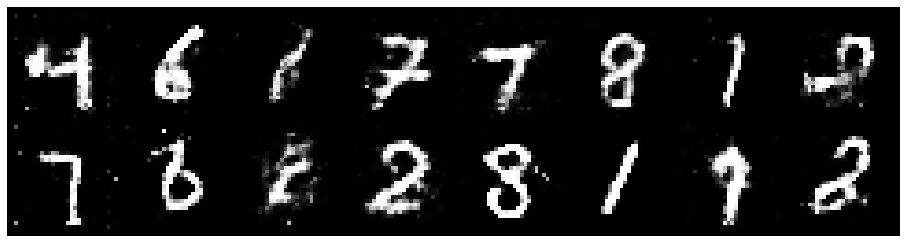

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.2713, Generator Loss: 0.9004
D(x): 0.5592, D(G(z)): 0.4448


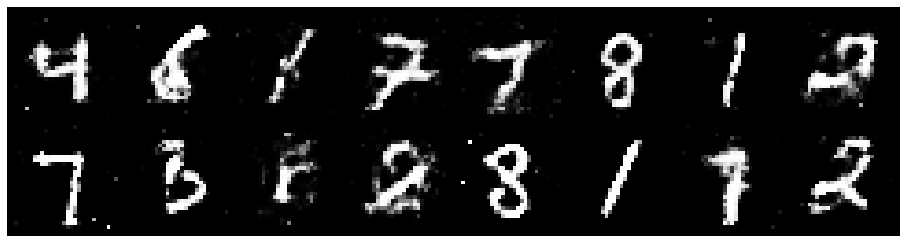

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.3966, Generator Loss: 0.8197
D(x): 0.5141, D(G(z)): 0.4770


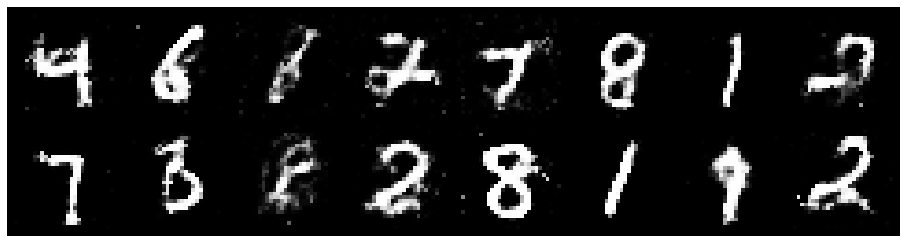

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.4247, Generator Loss: 0.9781
D(x): 0.5242, D(G(z)): 0.4604


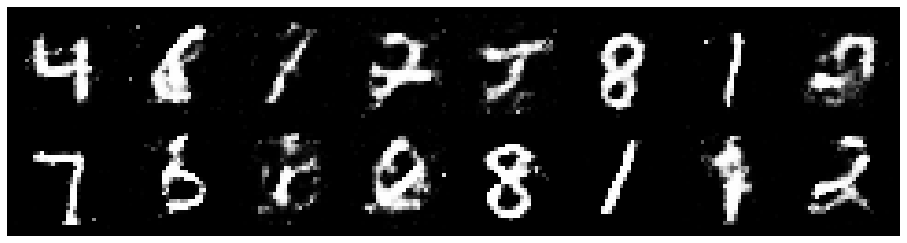

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.3946, Generator Loss: 0.9461
D(x): 0.5979, D(G(z)): 0.5172


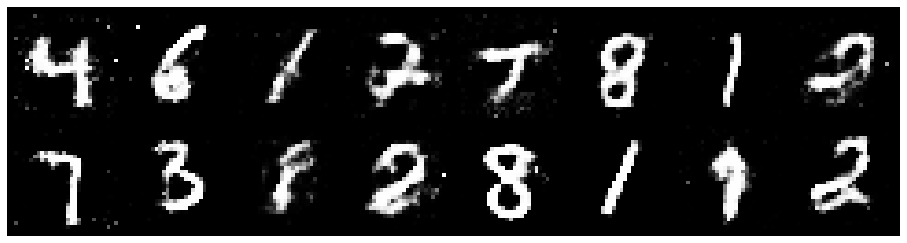

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.2015, Generator Loss: 1.0297
D(x): 0.5683, D(G(z)): 0.3969


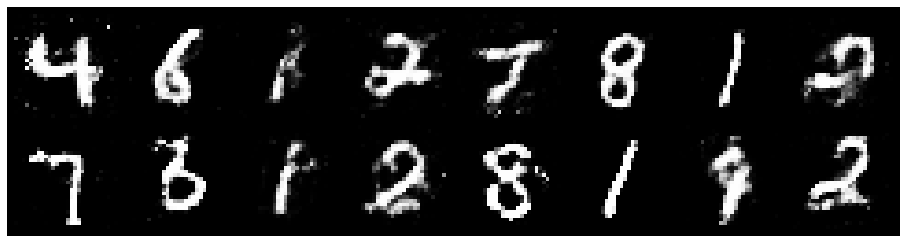

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.3126, Generator Loss: 0.8772
D(x): 0.5470, D(G(z)): 0.4494


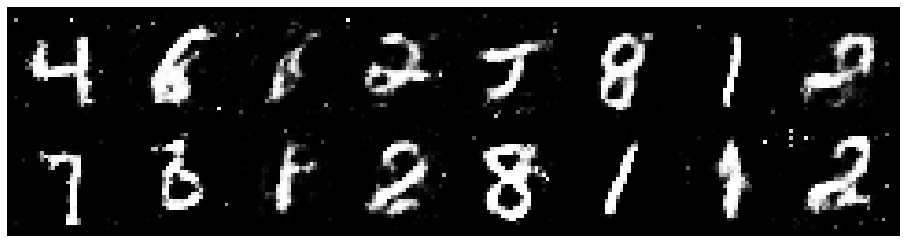

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.2019, Generator Loss: 1.0830
D(x): 0.5356, D(G(z)): 0.3961


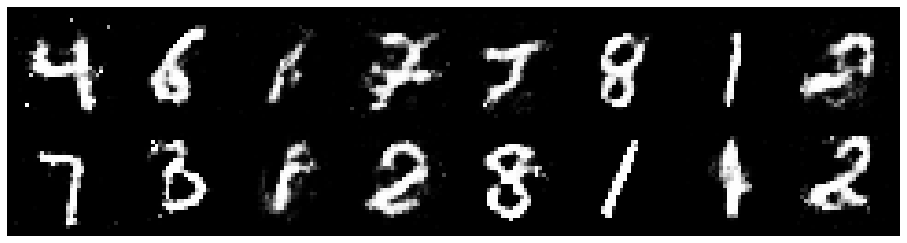

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.3304, Generator Loss: 0.8694
D(x): 0.5521, D(G(z)): 0.4625


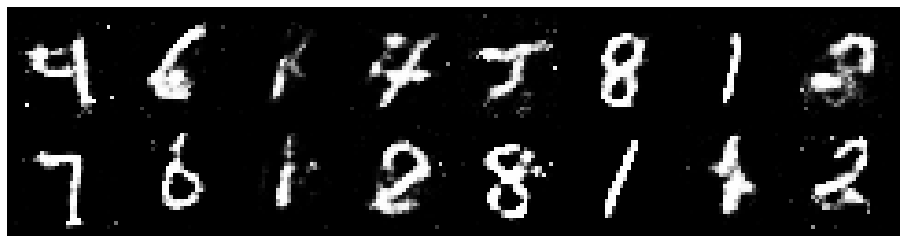

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.1890, Generator Loss: 0.9365
D(x): 0.5605, D(G(z)): 0.4049


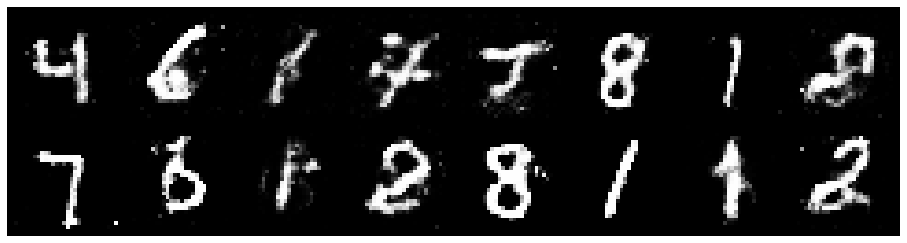

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.2729, Generator Loss: 0.9510
D(x): 0.5657, D(G(z)): 0.4504


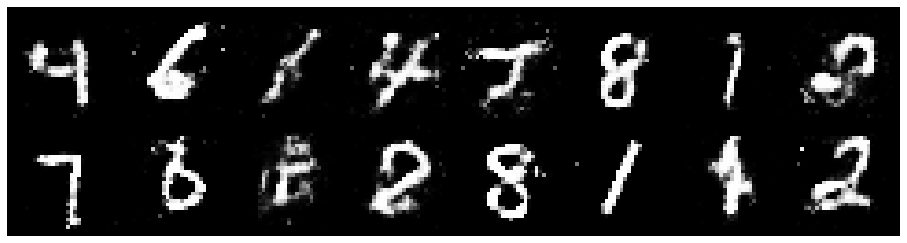

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.2303, Generator Loss: 0.9520
D(x): 0.5492, D(G(z)): 0.4294


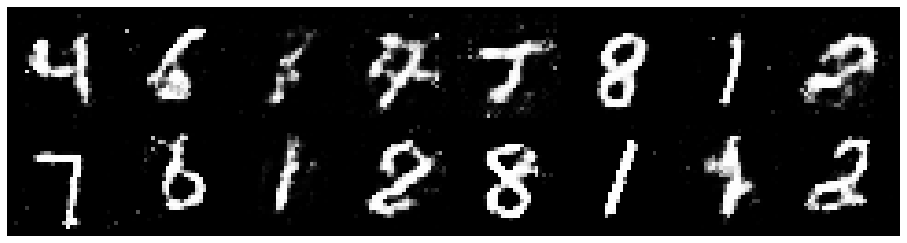

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.2736, Generator Loss: 0.9250
D(x): 0.5532, D(G(z)): 0.4520


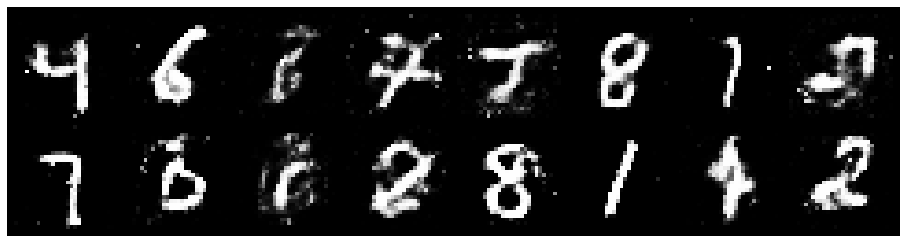

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.3463, Generator Loss: 0.8525
D(x): 0.5508, D(G(z)): 0.4685


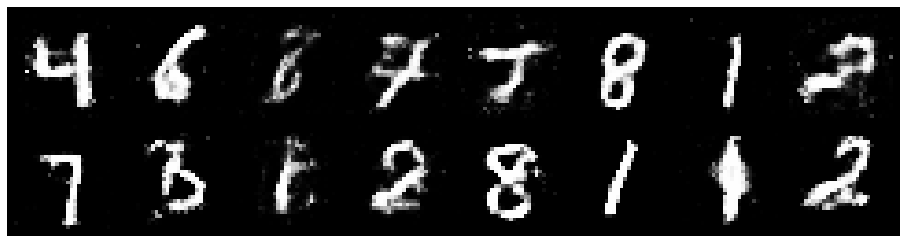

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.3822, Generator Loss: 0.8702
D(x): 0.5182, D(G(z)): 0.4602


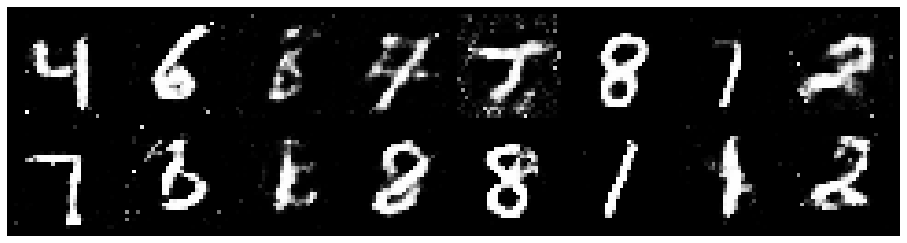

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.2548, Generator Loss: 0.8585
D(x): 0.5437, D(G(z)): 0.4297


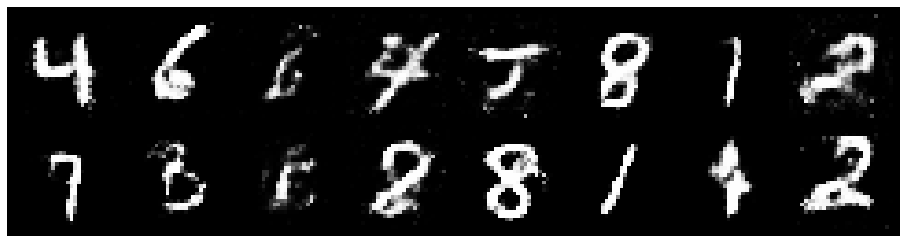

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.2279, Generator Loss: 0.9472
D(x): 0.5505, D(G(z)): 0.4379


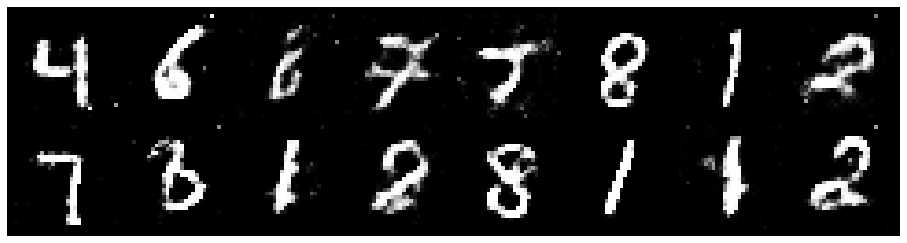

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.2464, Generator Loss: 0.9700
D(x): 0.5774, D(G(z)): 0.4275


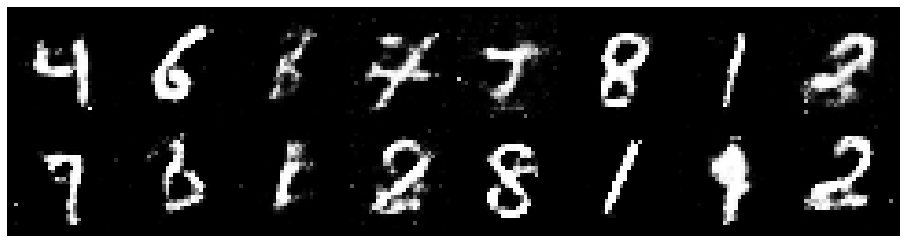

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.2076, Generator Loss: 0.9789
D(x): 0.5377, D(G(z)): 0.4056


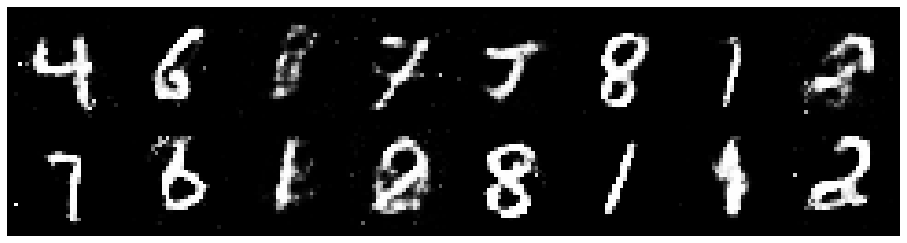

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.2335, Generator Loss: 1.0461
D(x): 0.5821, D(G(z)): 0.4274


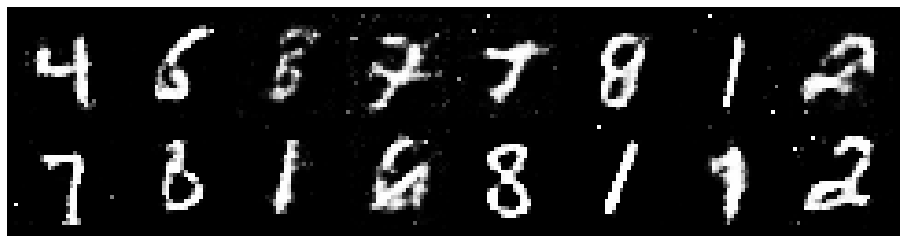

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.1552, Generator Loss: 0.9083
D(x): 0.5870, D(G(z)): 0.4120


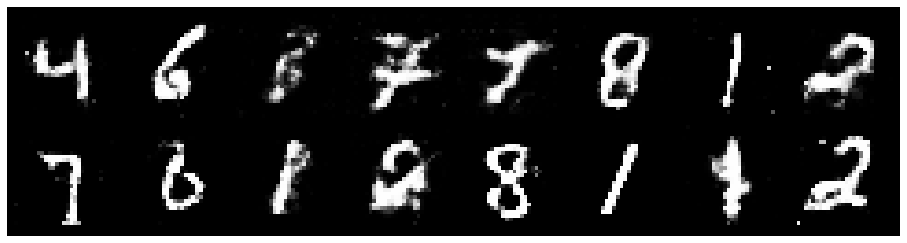

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.1436, Generator Loss: 0.8723
D(x): 0.5813, D(G(z)): 0.4207


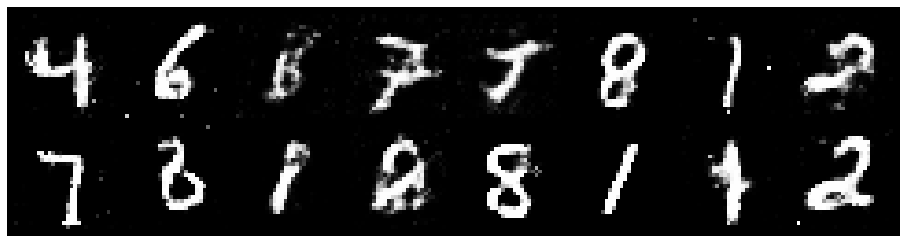

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.3002, Generator Loss: 0.8394
D(x): 0.5503, D(G(z)): 0.4524


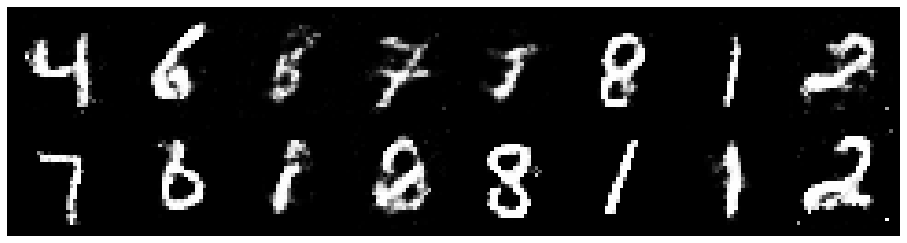

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.3319, Generator Loss: 0.9533
D(x): 0.5344, D(G(z)): 0.4535


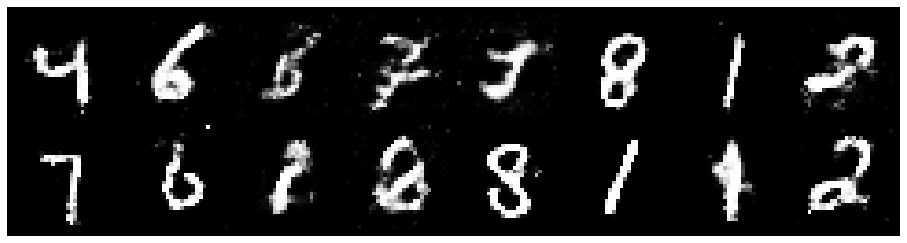

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.2815, Generator Loss: 0.8379
D(x): 0.5462, D(G(z)): 0.4447


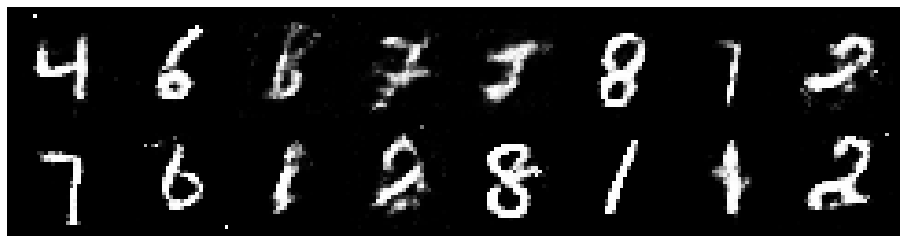

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.3299, Generator Loss: 0.8078
D(x): 0.5613, D(G(z)): 0.4633


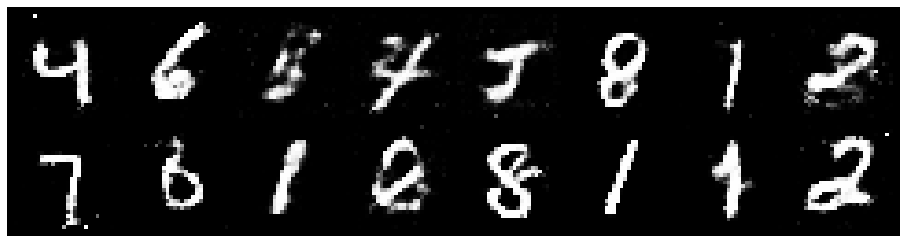

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.2182, Generator Loss: 0.9956
D(x): 0.5809, D(G(z)): 0.4195


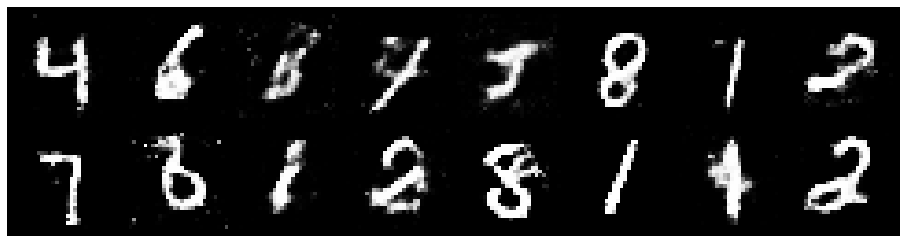

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.2265, Generator Loss: 1.0088
D(x): 0.5656, D(G(z)): 0.4129


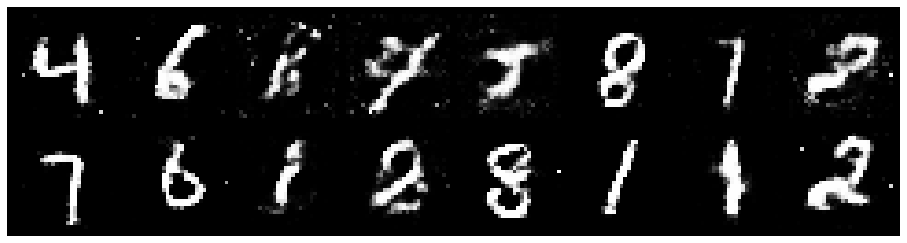

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2854, Generator Loss: 0.9615
D(x): 0.5854, D(G(z)): 0.4522


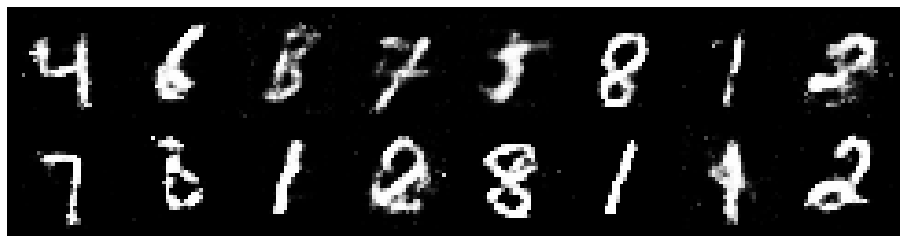

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.2142, Generator Loss: 0.8887
D(x): 0.5815, D(G(z)): 0.4474


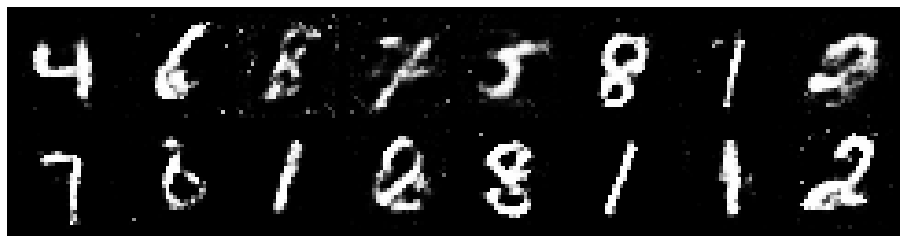

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.2114, Generator Loss: 0.9601
D(x): 0.5838, D(G(z)): 0.4496


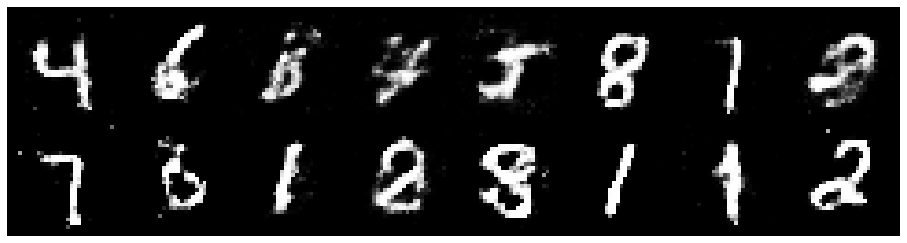

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.2384, Generator Loss: 0.9094
D(x): 0.5597, D(G(z)): 0.4332


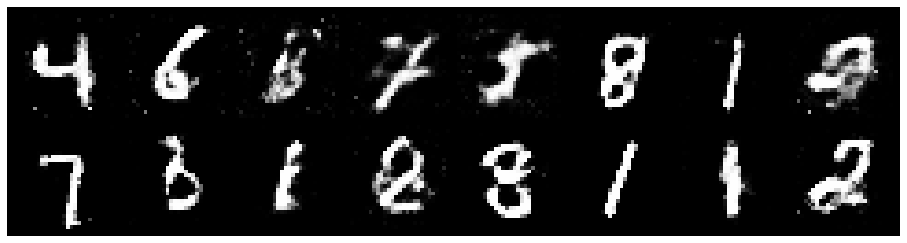

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.1652, Generator Loss: 0.9860
D(x): 0.5655, D(G(z)): 0.4024


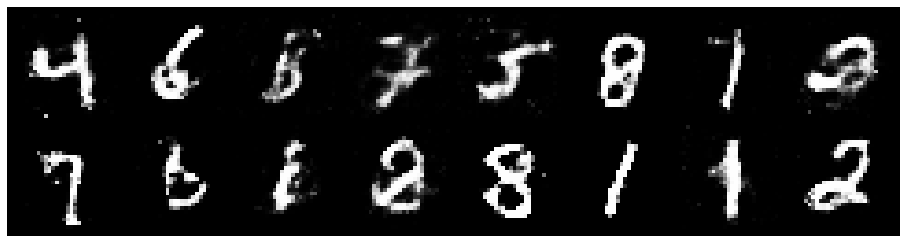

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.3077, Generator Loss: 0.8874
D(x): 0.5698, D(G(z)): 0.4689


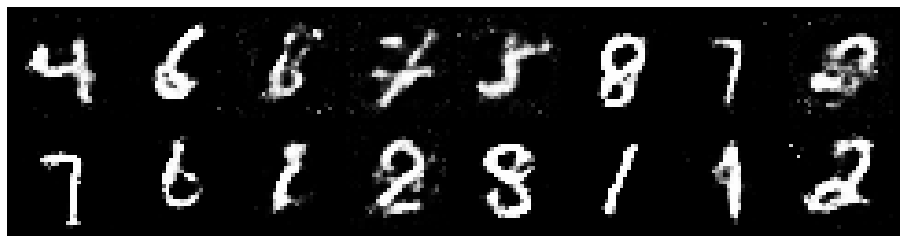

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.2622, Generator Loss: 0.9574
D(x): 0.5577, D(G(z)): 0.4289


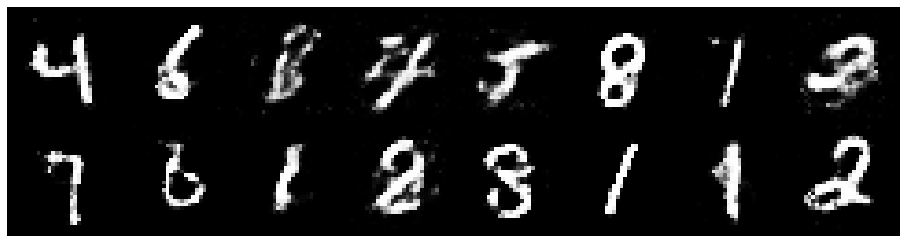

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.2319, Generator Loss: 0.9622
D(x): 0.5665, D(G(z)): 0.4326


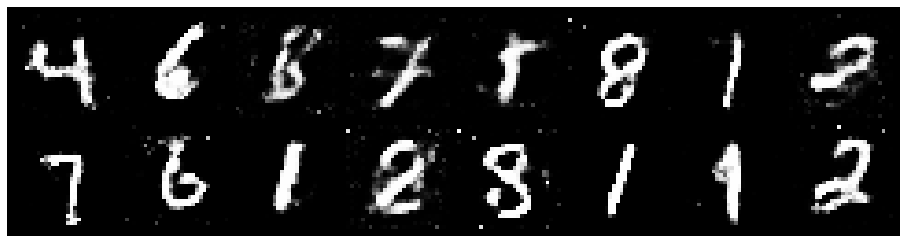

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.2472, Generator Loss: 0.8563
D(x): 0.5268, D(G(z)): 0.4193


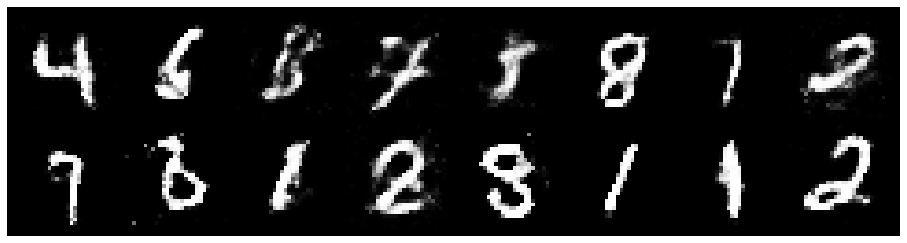

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.2544, Generator Loss: 1.0183
D(x): 0.5787, D(G(z)): 0.4300


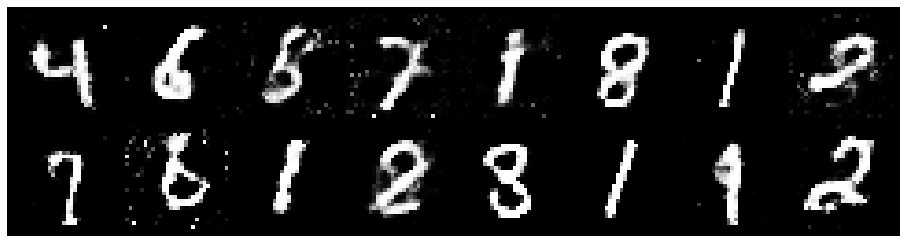

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.3235, Generator Loss: 0.8610
D(x): 0.5463, D(G(z)): 0.4512


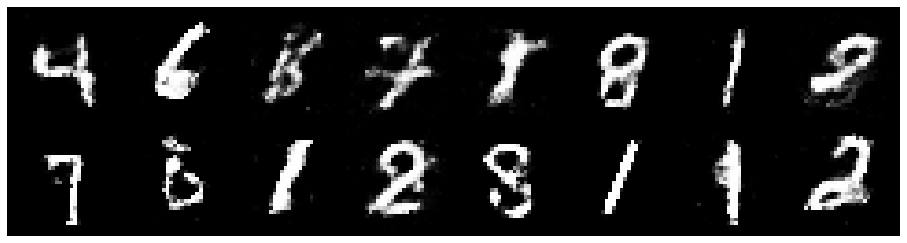

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.2917, Generator Loss: 0.7454
D(x): 0.5488, D(G(z)): 0.4585


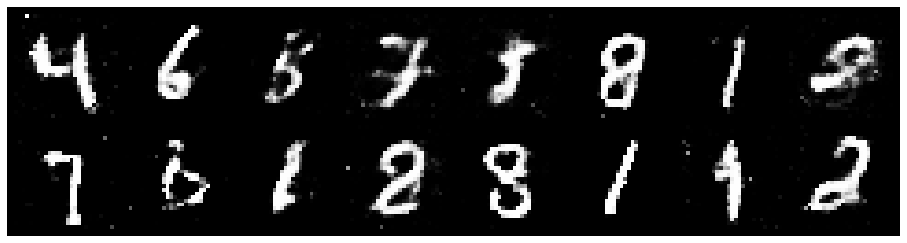

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.3648, Generator Loss: 0.8936
D(x): 0.5198, D(G(z)): 0.4473


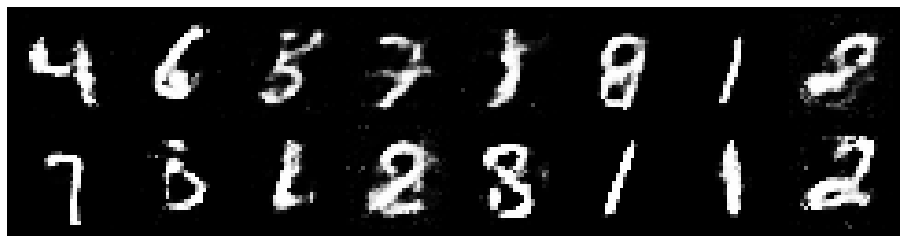

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.3583, Generator Loss: 0.8450
D(x): 0.5291, D(G(z)): 0.4599


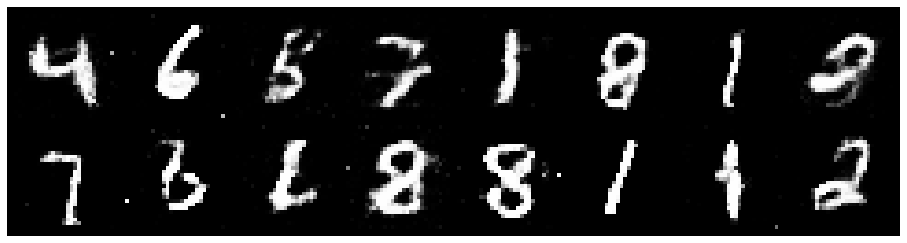

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.3078, Generator Loss: 0.7268
D(x): 0.5568, D(G(z)): 0.4716


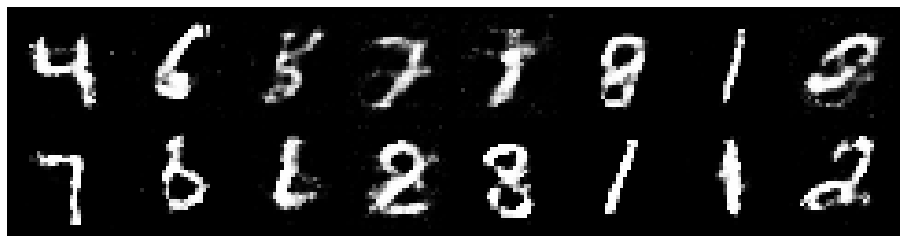

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.3159, Generator Loss: 0.9928
D(x): 0.5587, D(G(z)): 0.4449


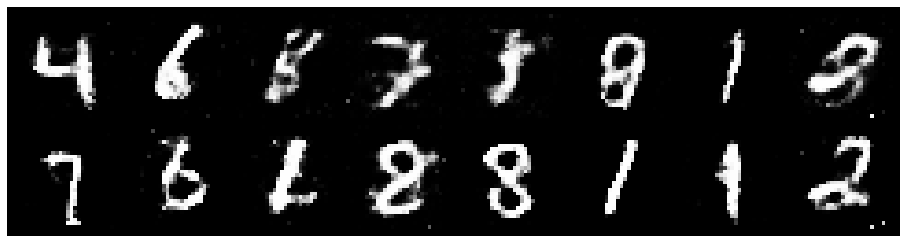

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.2670, Generator Loss: 0.9532
D(x): 0.5850, D(G(z)): 0.4592


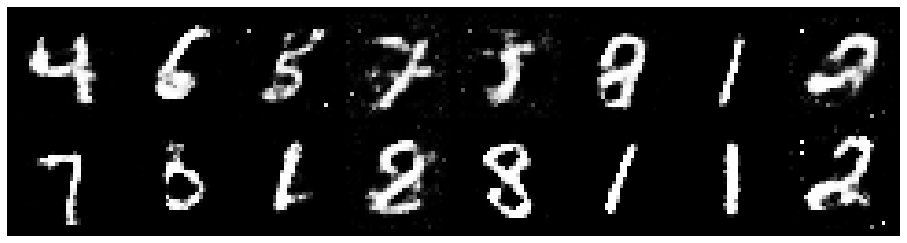

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.3181, Generator Loss: 0.9917
D(x): 0.5485, D(G(z)): 0.4502


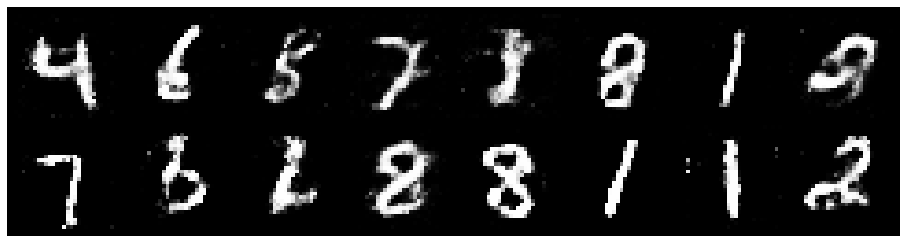

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.2833, Generator Loss: 0.9054
D(x): 0.5455, D(G(z)): 0.4348


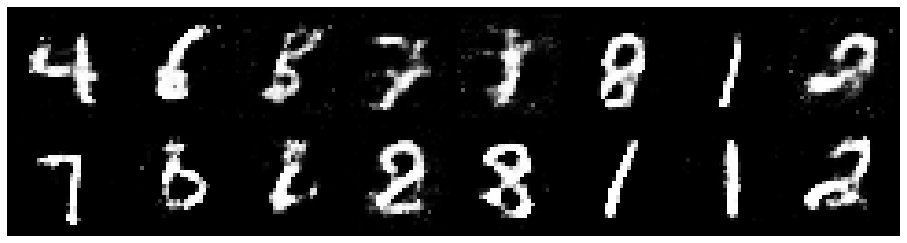

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.3126, Generator Loss: 0.9401
D(x): 0.5317, D(G(z)): 0.4513


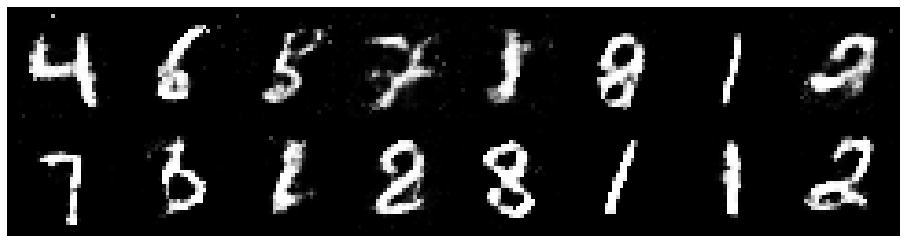

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.2914, Generator Loss: 0.8723
D(x): 0.5759, D(G(z)): 0.4670


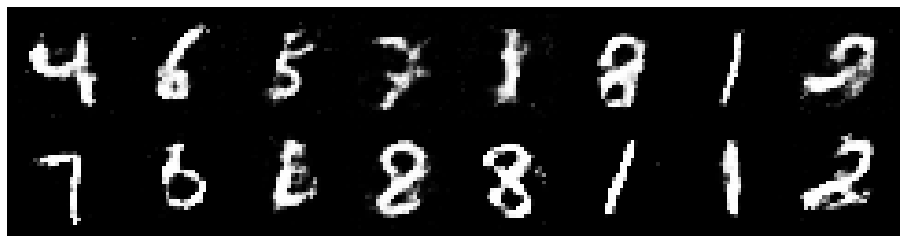

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.3331, Generator Loss: 0.8015
D(x): 0.5693, D(G(z)): 0.4886


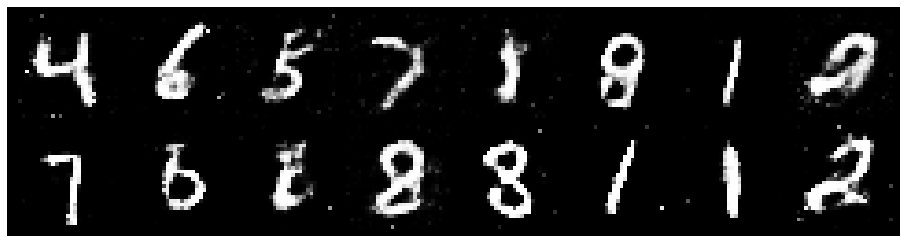

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.3201, Generator Loss: 0.8352
D(x): 0.5419, D(G(z)): 0.4686


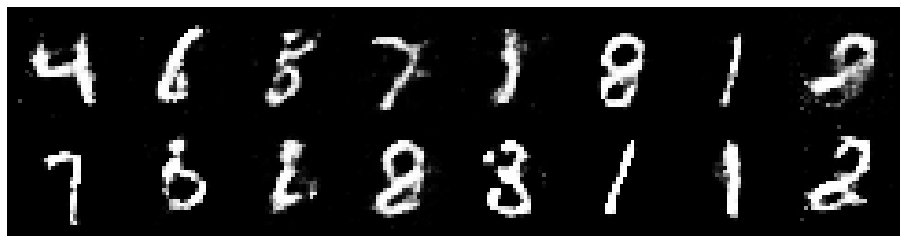

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.2587, Generator Loss: 0.8509
D(x): 0.5520, D(G(z)): 0.4425


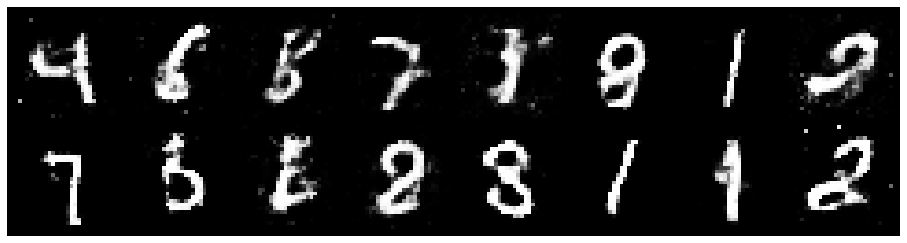

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.2909, Generator Loss: 0.7872
D(x): 0.5521, D(G(z)): 0.4621


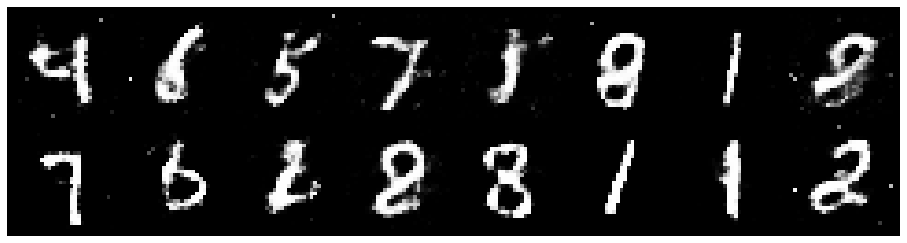

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.2424, Generator Loss: 0.8934
D(x): 0.5639, D(G(z)): 0.4576


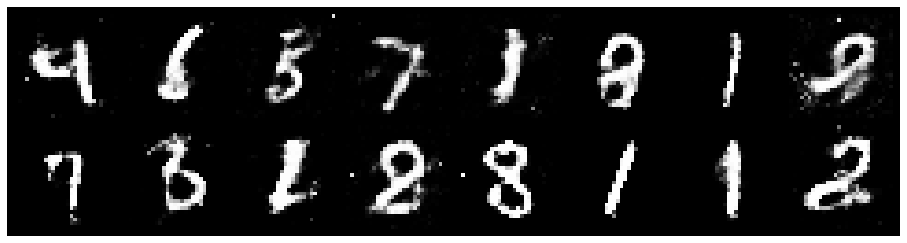

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.2411, Generator Loss: 0.9432
D(x): 0.5710, D(G(z)): 0.4415


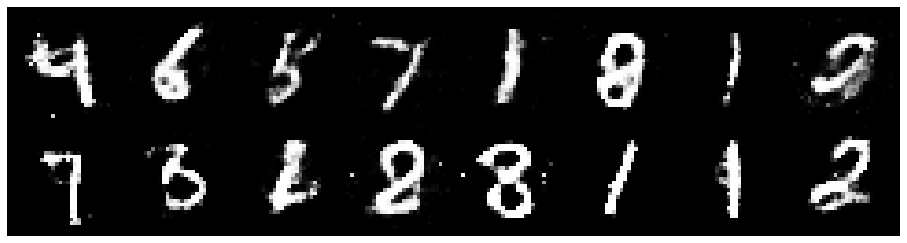

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.2088, Generator Loss: 1.0397
D(x): 0.5667, D(G(z)): 0.4253


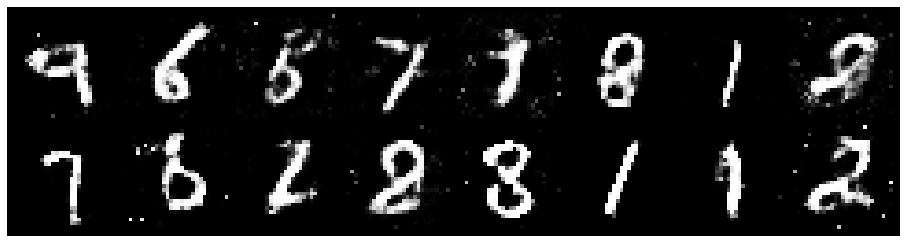

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.2542, Generator Loss: 0.8398
D(x): 0.5556, D(G(z)): 0.4456


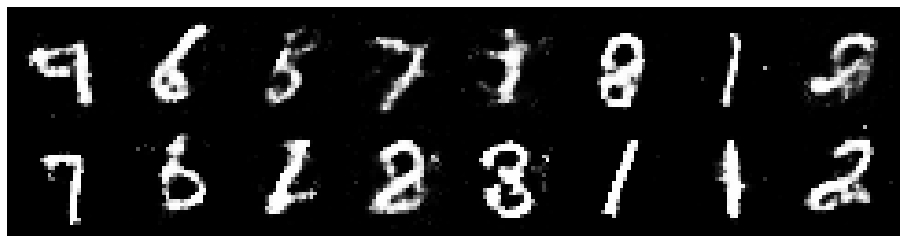

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.2523, Generator Loss: 0.9515
D(x): 0.5516, D(G(z)): 0.4391


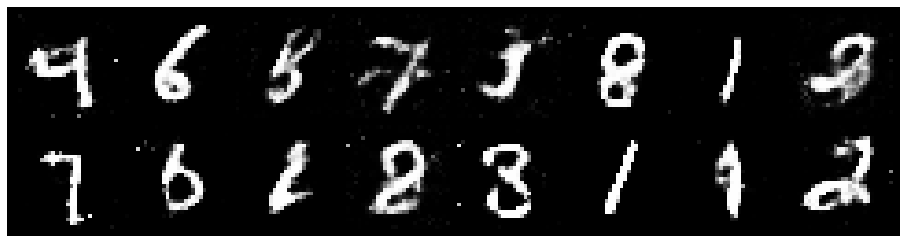

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.3502, Generator Loss: 0.8431
D(x): 0.5372, D(G(z)): 0.4667


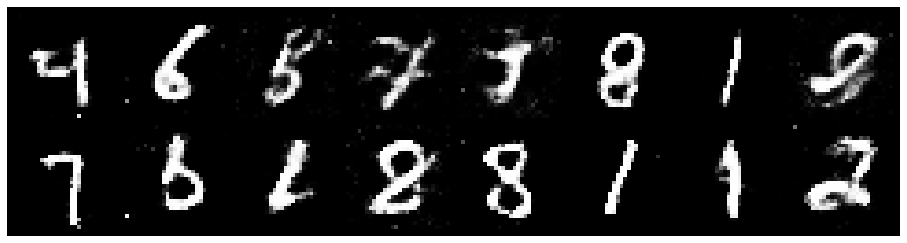

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.2877, Generator Loss: 0.9142
D(x): 0.5796, D(G(z)): 0.4670


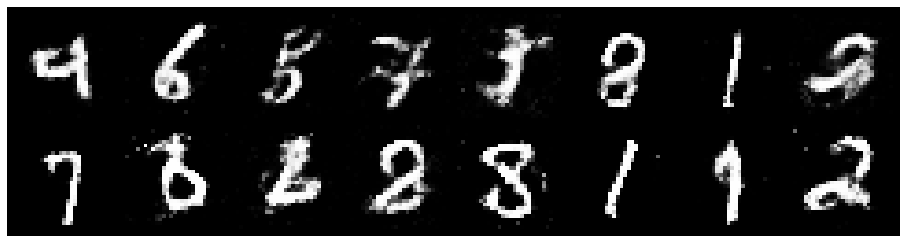

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.1413, Generator Loss: 0.9201
D(x): 0.5939, D(G(z)): 0.4249


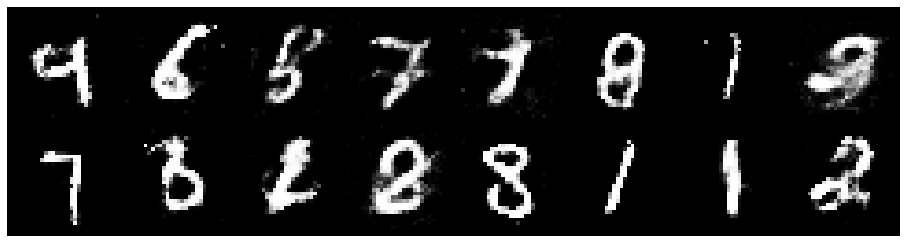

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.2054, Generator Loss: 0.8284
D(x): 0.5663, D(G(z)): 0.4384


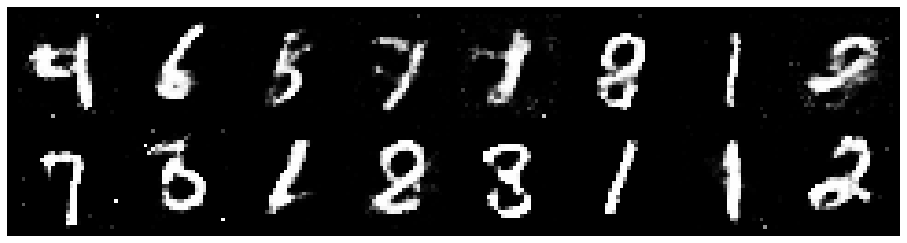

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.2211, Generator Loss: 0.9421
D(x): 0.5731, D(G(z)): 0.4445


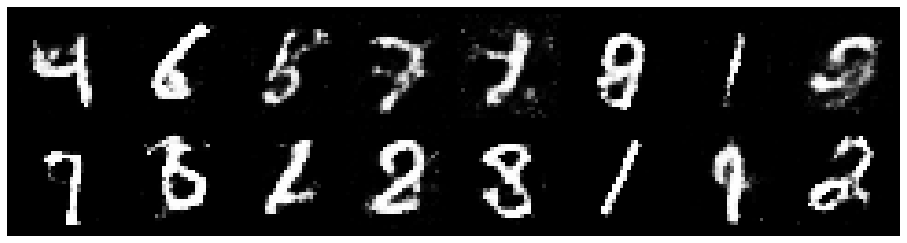

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.2882, Generator Loss: 0.9354
D(x): 0.5605, D(G(z)): 0.4347


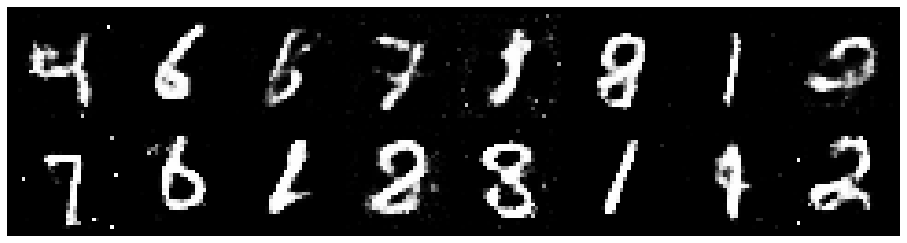

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.2004, Generator Loss: 0.9407
D(x): 0.5871, D(G(z)): 0.4213


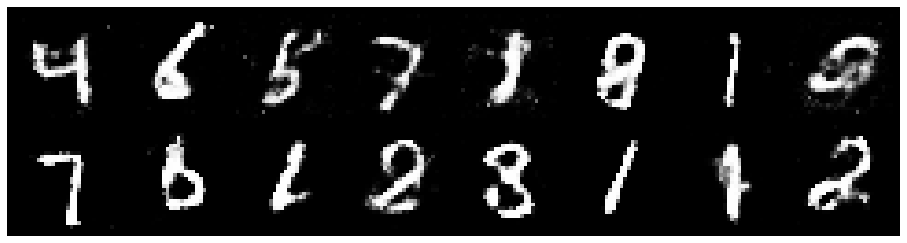

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.2207, Generator Loss: 0.9269
D(x): 0.5787, D(G(z)): 0.4388


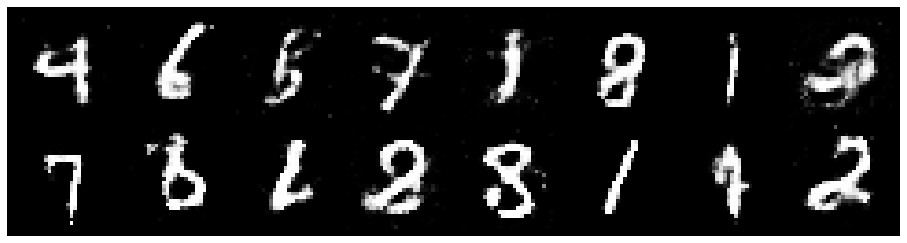

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.1970, Generator Loss: 0.9116
D(x): 0.5791, D(G(z)): 0.4193


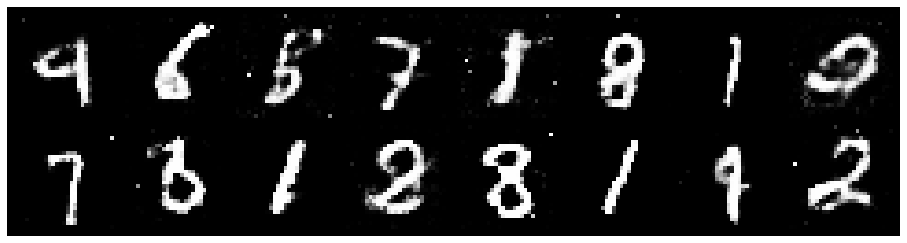

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.3005, Generator Loss: 0.9466
D(x): 0.5314, D(G(z)): 0.4325


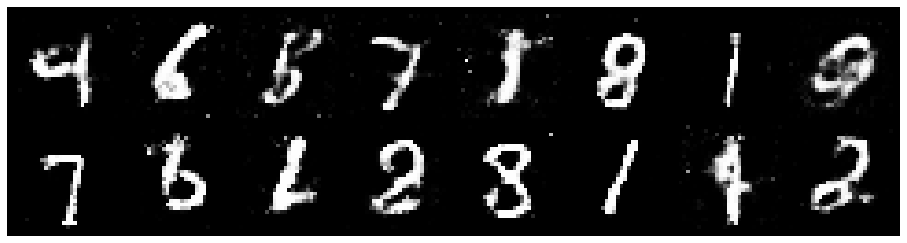

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.2905, Generator Loss: 1.0279
D(x): 0.5420, D(G(z)): 0.4347


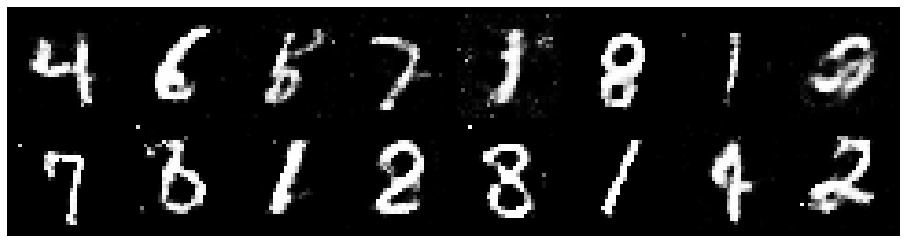

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.3568, Generator Loss: 0.7595
D(x): 0.5449, D(G(z)): 0.4825


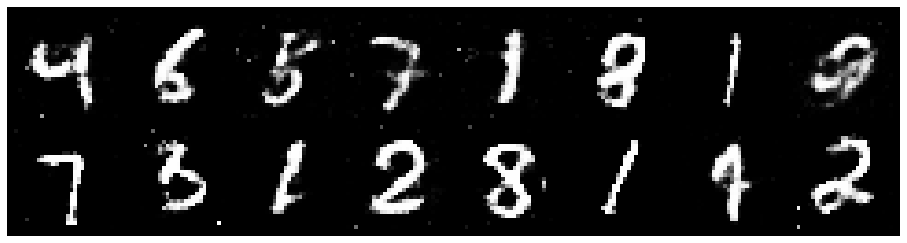

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.3507, Generator Loss: 0.9138
D(x): 0.5028, D(G(z)): 0.4462


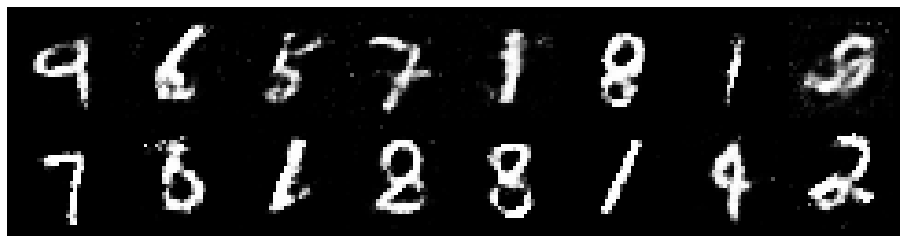

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.2182, Generator Loss: 0.8099
D(x): 0.5997, D(G(z)): 0.4716


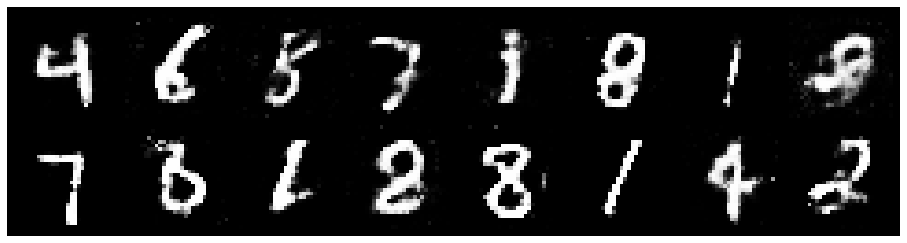

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.3518, Generator Loss: 0.8867
D(x): 0.5219, D(G(z)): 0.4550


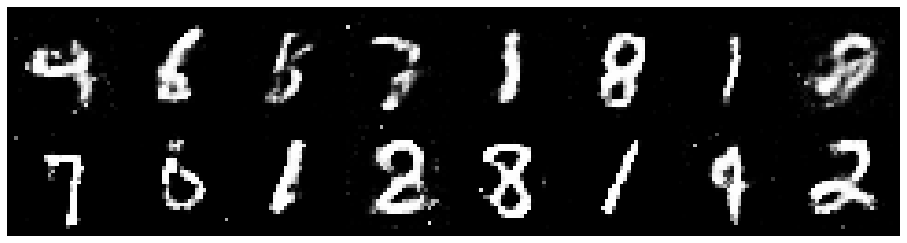

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.3297, Generator Loss: 0.8744
D(x): 0.5264, D(G(z)): 0.4489


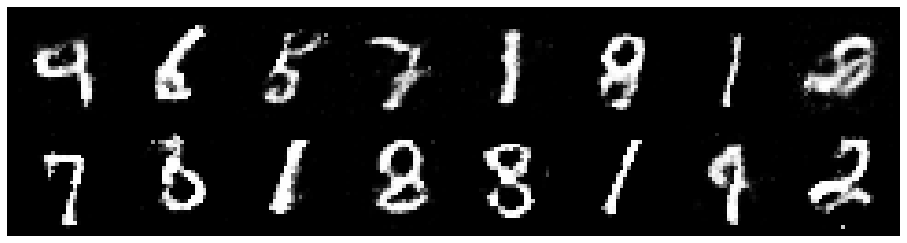

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.2873, Generator Loss: 0.8820
D(x): 0.5223, D(G(z)): 0.4303


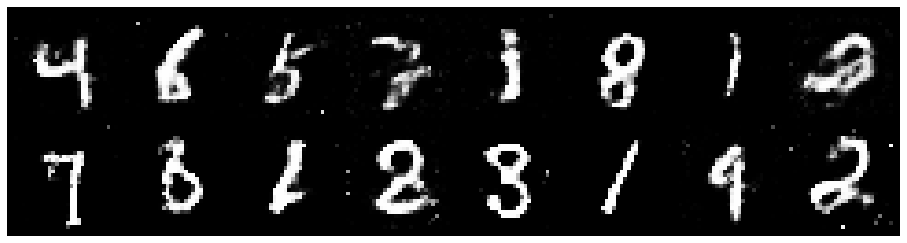

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.2497, Generator Loss: 0.9812
D(x): 0.5929, D(G(z)): 0.4390


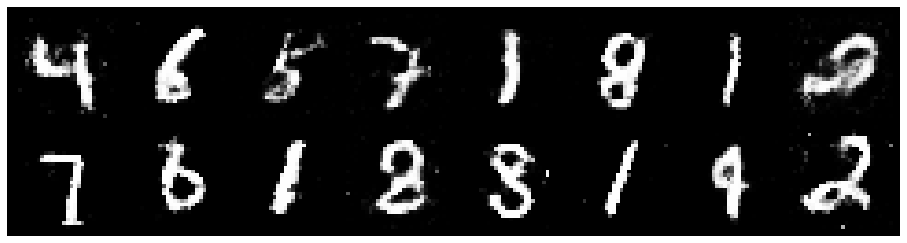

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.2924, Generator Loss: 0.8826
D(x): 0.5768, D(G(z)): 0.4390


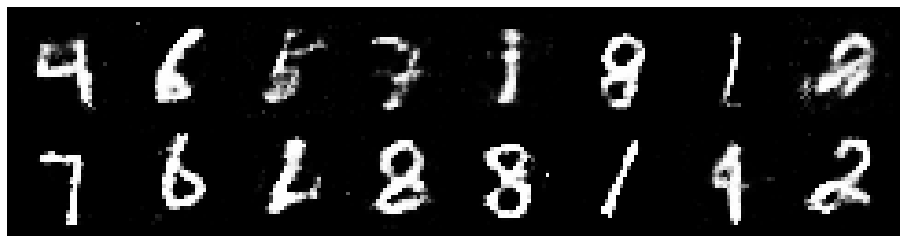

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.1944, Generator Loss: 0.8411
D(x): 0.5922, D(G(z)): 0.4412


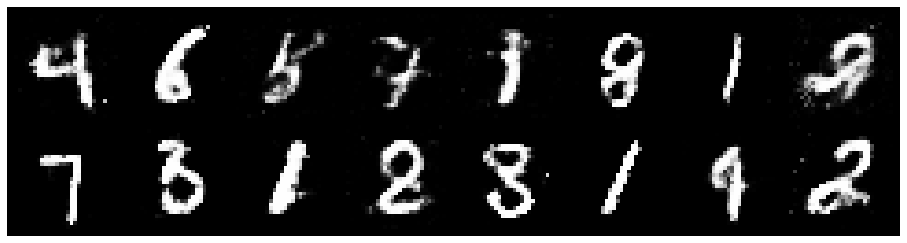

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.2424, Generator Loss: 1.0037
D(x): 0.5315, D(G(z)): 0.4008


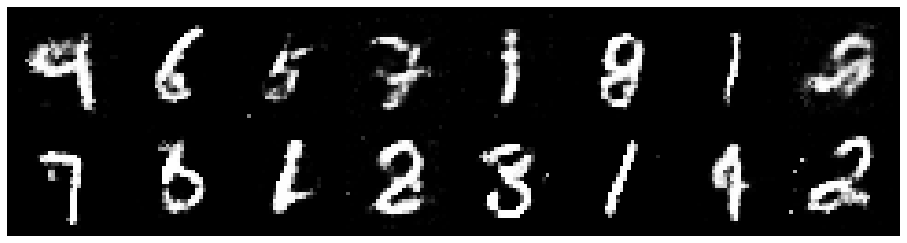

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.2508, Generator Loss: 0.8487
D(x): 0.5519, D(G(z)): 0.4382


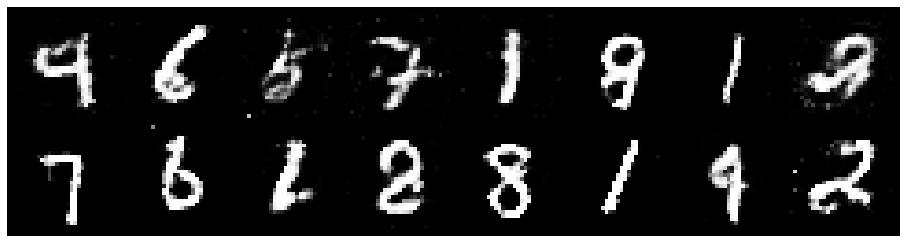

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.2892, Generator Loss: 0.9354
D(x): 0.5586, D(G(z)): 0.4561


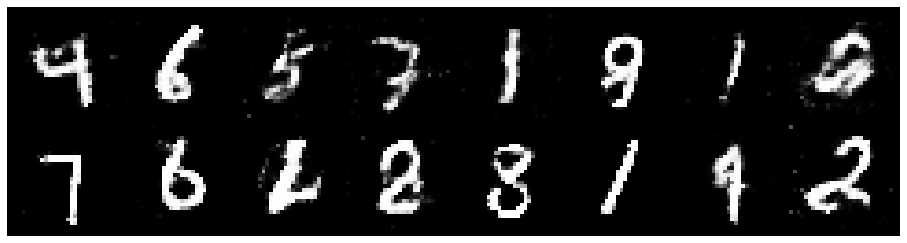

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.2944, Generator Loss: 0.8230
D(x): 0.5546, D(G(z)): 0.4577


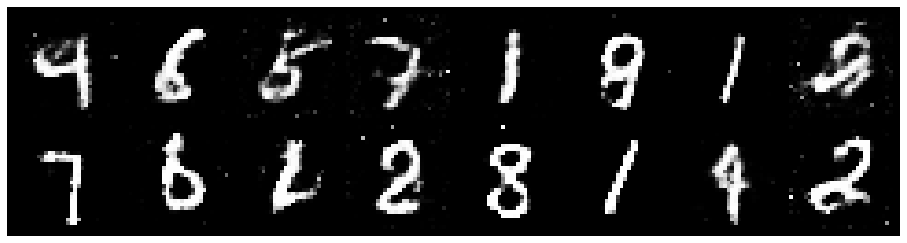

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.2877, Generator Loss: 0.9037
D(x): 0.5474, D(G(z)): 0.4556


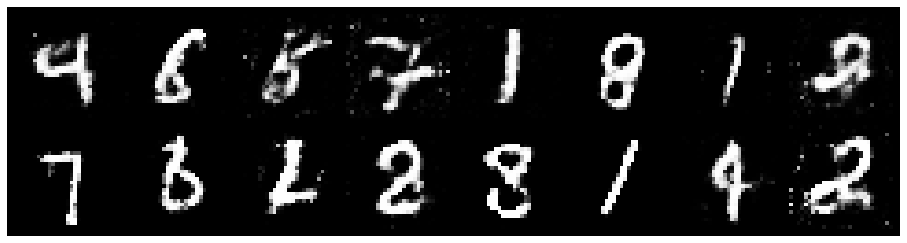

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.2678, Generator Loss: 0.8789
D(x): 0.5136, D(G(z)): 0.4061


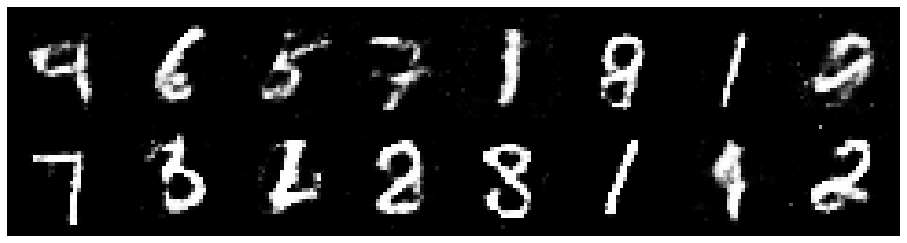

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.2822, Generator Loss: 0.9280
D(x): 0.5311, D(G(z)): 0.4288


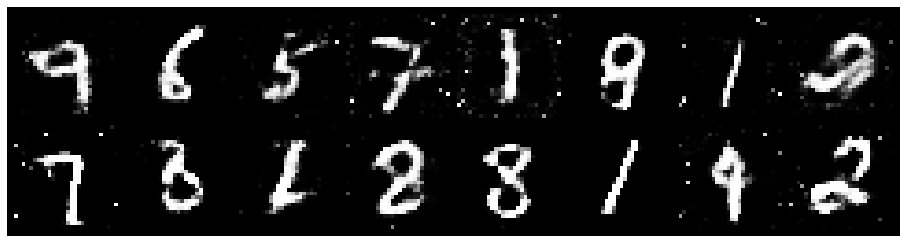

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.2688, Generator Loss: 0.9101
D(x): 0.5441, D(G(z)): 0.4447


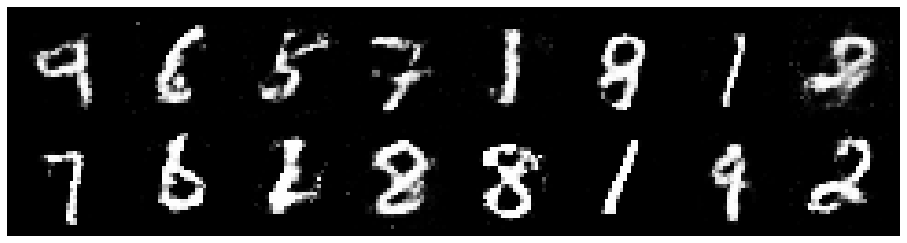

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.3239, Generator Loss: 0.7915
D(x): 0.5064, D(G(z)): 0.4396


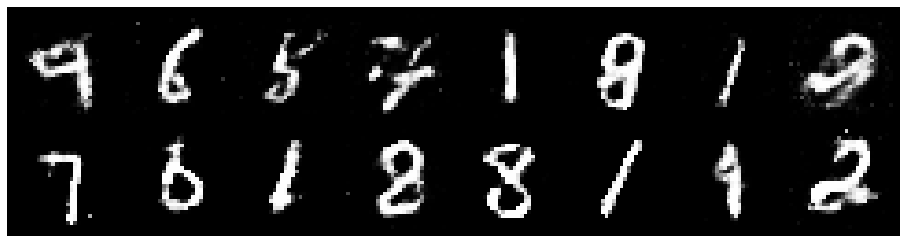

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.3287, Generator Loss: 0.9174
D(x): 0.5372, D(G(z)): 0.4486


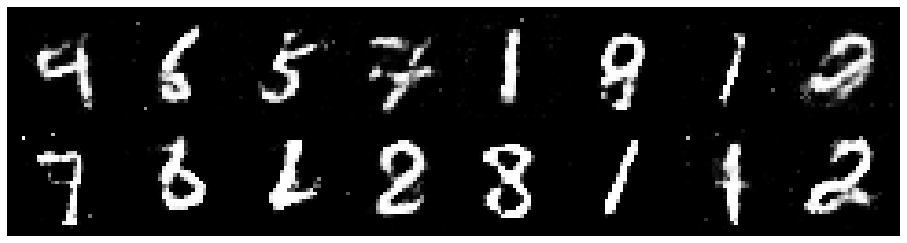

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.3389, Generator Loss: 0.8290
D(x): 0.5322, D(G(z)): 0.4718


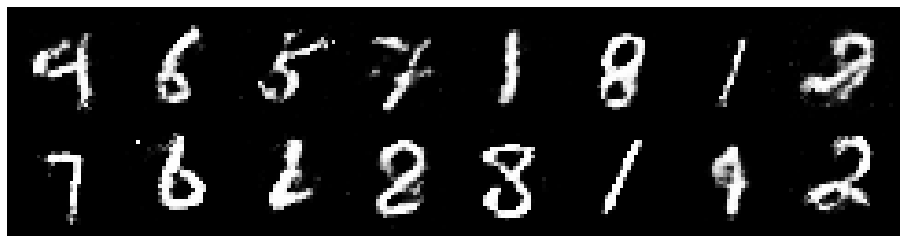

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.3442, Generator Loss: 0.8016
D(x): 0.5460, D(G(z)): 0.4809


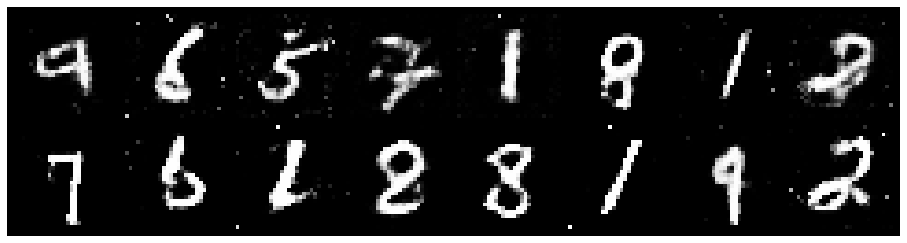

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.2938, Generator Loss: 0.8858
D(x): 0.5374, D(G(z)): 0.4424


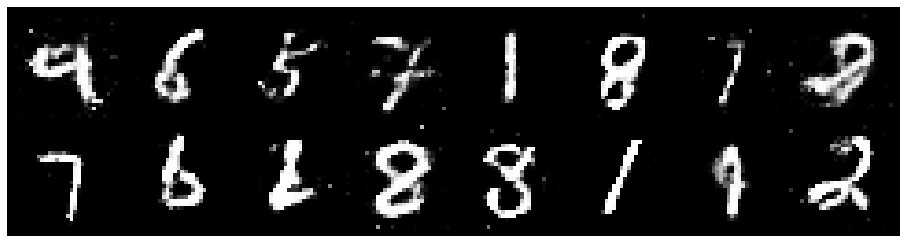

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.2293, Generator Loss: 0.8760
D(x): 0.5779, D(G(z)): 0.4456


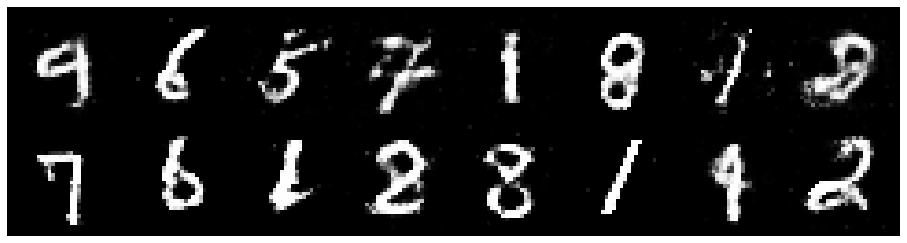

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.3631, Generator Loss: 0.8879
D(x): 0.5299, D(G(z)): 0.4503


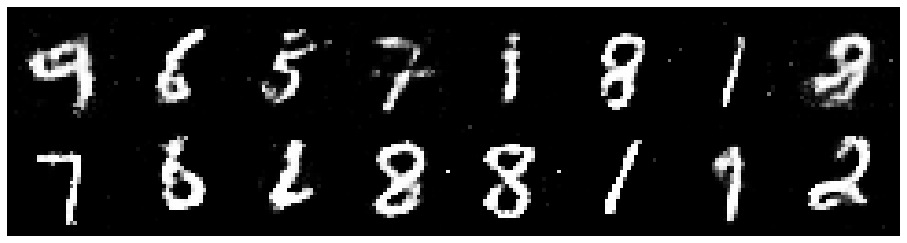

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.2734, Generator Loss: 0.9786
D(x): 0.5202, D(G(z)): 0.3982


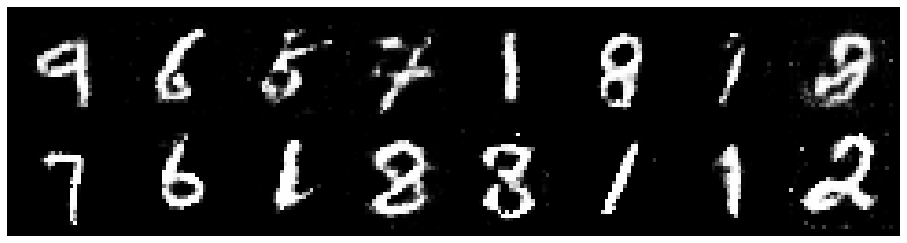

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.1558, Generator Loss: 0.9943
D(x): 0.5507, D(G(z)): 0.3701


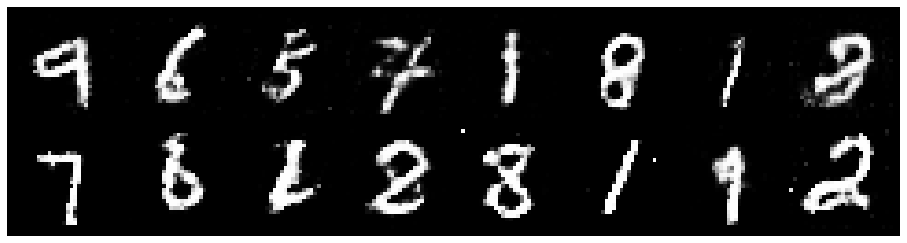

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.2306, Generator Loss: 0.8156
D(x): 0.5715, D(G(z)): 0.4649


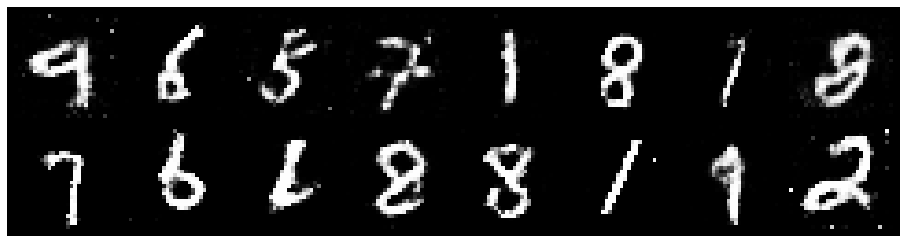

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.2745, Generator Loss: 0.8464
D(x): 0.5326, D(G(z)): 0.4255


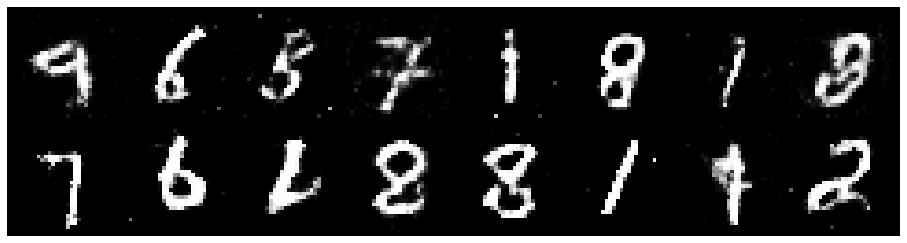

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.2446, Generator Loss: 0.8660
D(x): 0.5388, D(G(z)): 0.4224


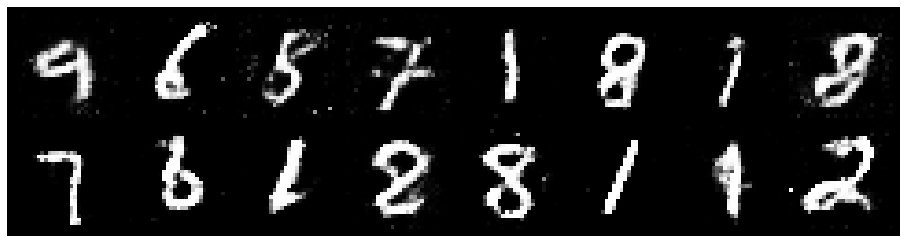

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.3025, Generator Loss: 0.9754
D(x): 0.5378, D(G(z)): 0.4483


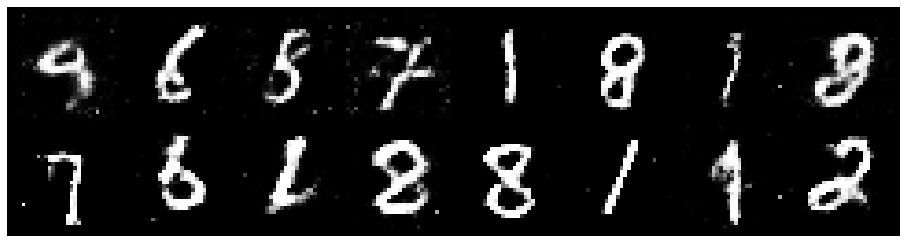

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.2515, Generator Loss: 0.9071
D(x): 0.5476, D(G(z)): 0.4289


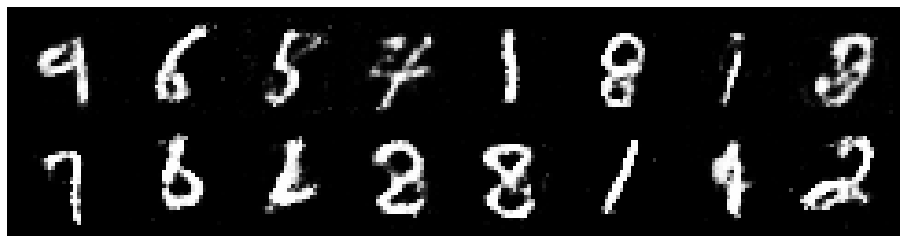

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.1824, Generator Loss: 0.9801
D(x): 0.5759, D(G(z)): 0.4324


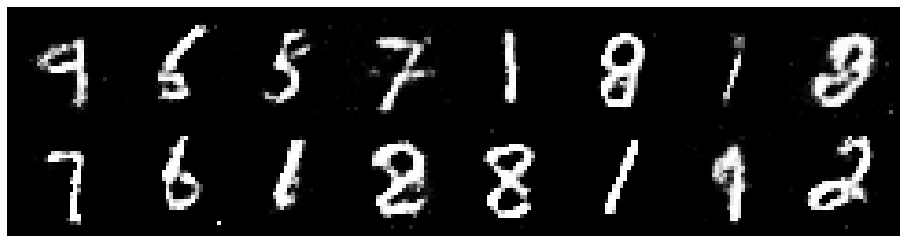

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.2719, Generator Loss: 0.8608
D(x): 0.5567, D(G(z)): 0.4260


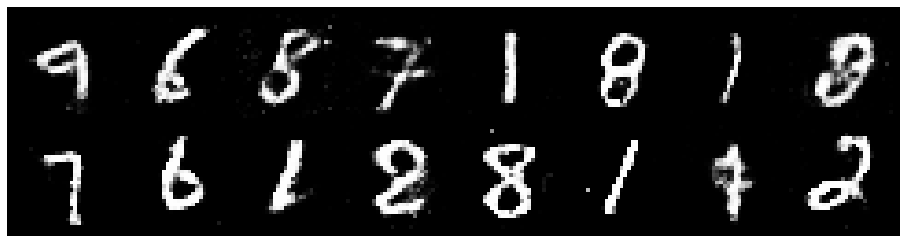

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.3147, Generator Loss: 0.8483
D(x): 0.5392, D(G(z)): 0.4670


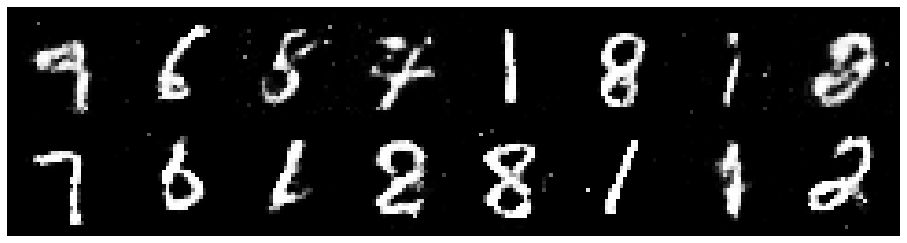

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.3038, Generator Loss: 1.0299
D(x): 0.5409, D(G(z)): 0.4281


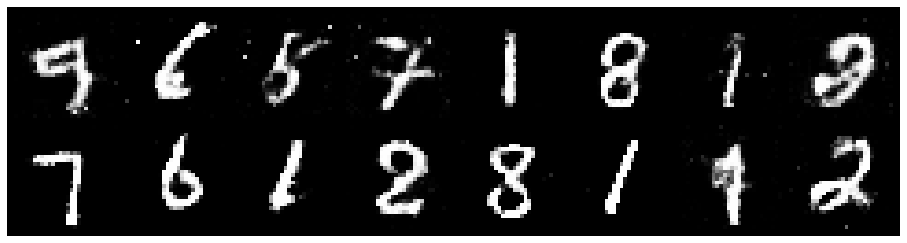

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.2114, Generator Loss: 1.0306
D(x): 0.6280, D(G(z)): 0.4511


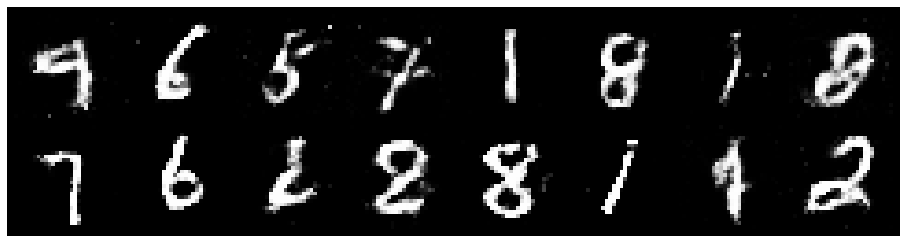

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.3085, Generator Loss: 0.8704
D(x): 0.5524, D(G(z)): 0.4521


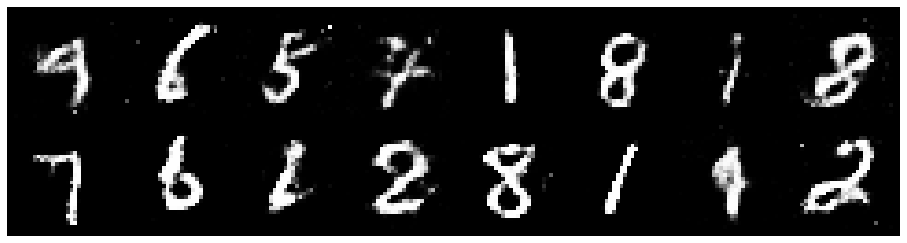

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2714, Generator Loss: 0.8088
D(x): 0.5802, D(G(z)): 0.4765


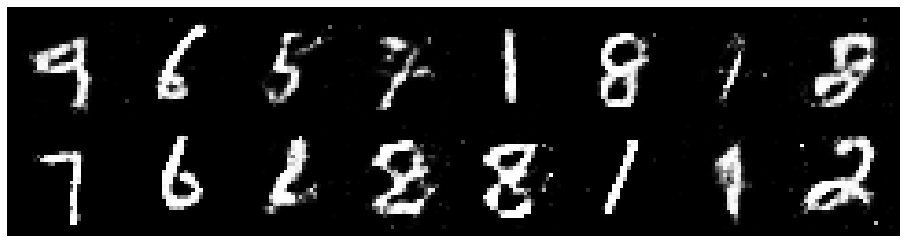

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.3410, Generator Loss: 1.0176
D(x): 0.5154, D(G(z)): 0.4337


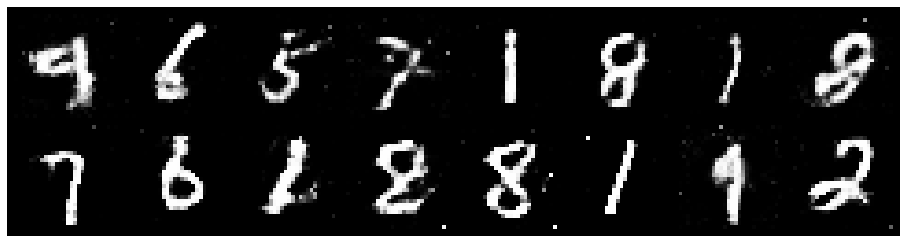

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.3725, Generator Loss: 0.9548
D(x): 0.5191, D(G(z)): 0.4385


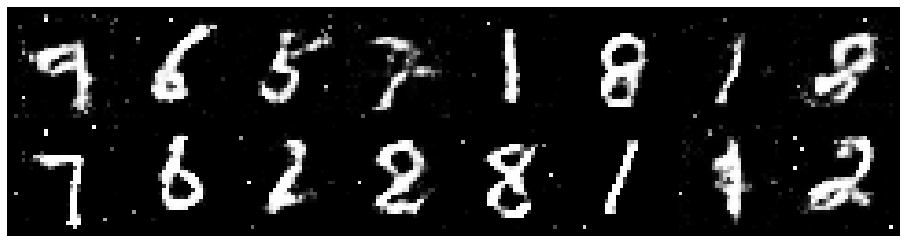

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.2608, Generator Loss: 0.9249
D(x): 0.5757, D(G(z)): 0.4521


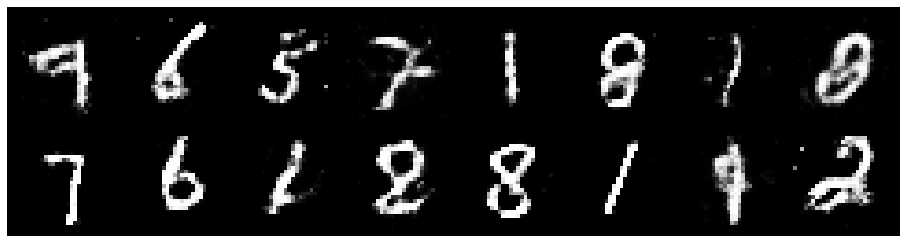

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.3133, Generator Loss: 0.8484
D(x): 0.5648, D(G(z)): 0.4768


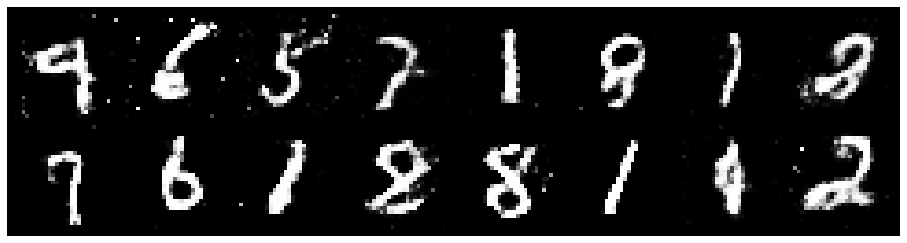

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.2915, Generator Loss: 0.8874
D(x): 0.5169, D(G(z)): 0.4301


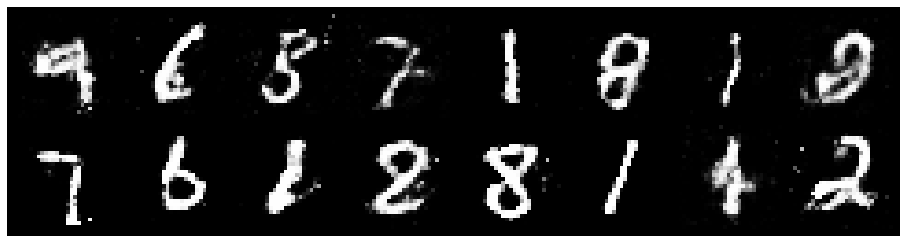

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.2426, Generator Loss: 0.8539
D(x): 0.5755, D(G(z)): 0.4506


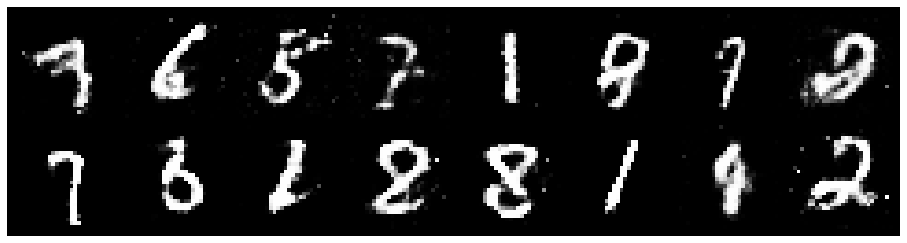

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.2188, Generator Loss: 0.9614
D(x): 0.5647, D(G(z)): 0.4355


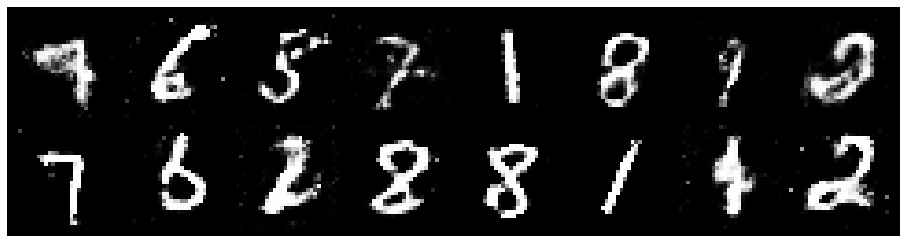

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.2576, Generator Loss: 0.8254
D(x): 0.5633, D(G(z)): 0.4581


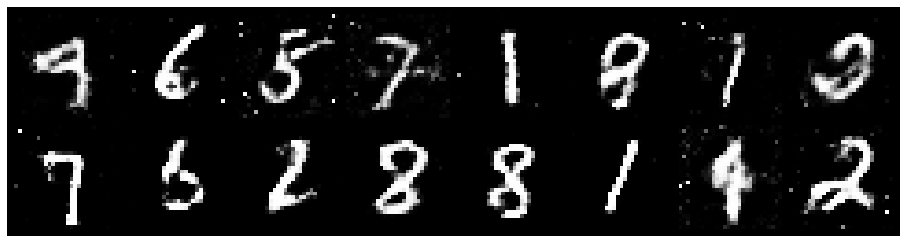

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.2512, Generator Loss: 0.8295
D(x): 0.5519, D(G(z)): 0.4420


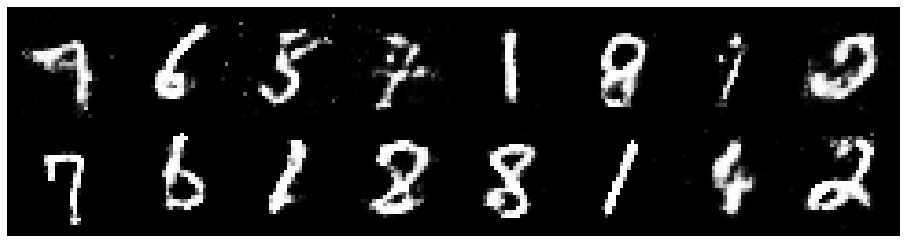

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.2676, Generator Loss: 0.8494
D(x): 0.5580, D(G(z)): 0.4236


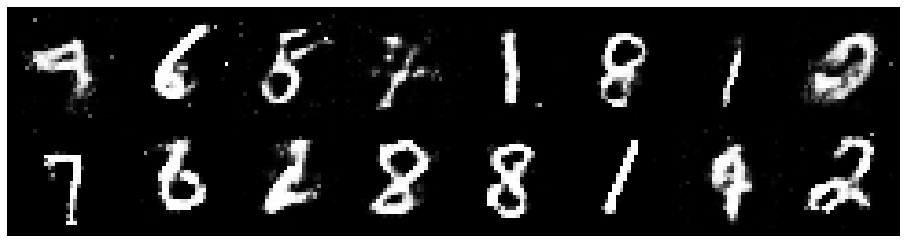

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.3131, Generator Loss: 0.6876
D(x): 0.5949, D(G(z)): 0.5038


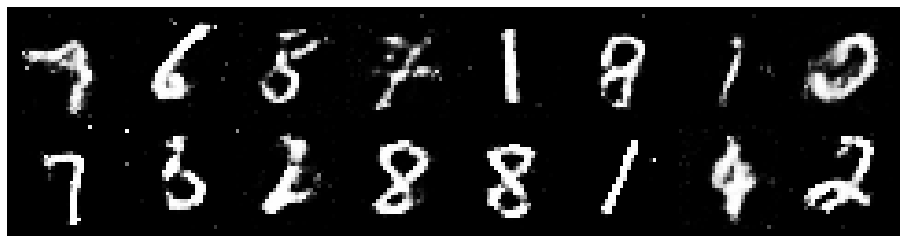

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.3264, Generator Loss: 0.8767
D(x): 0.5403, D(G(z)): 0.4552


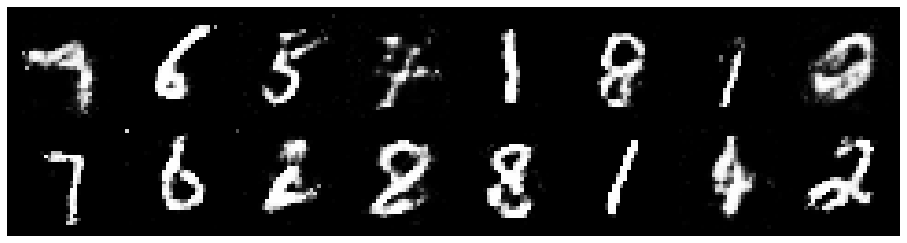

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.2569, Generator Loss: 0.8712
D(x): 0.5801, D(G(z)): 0.4574


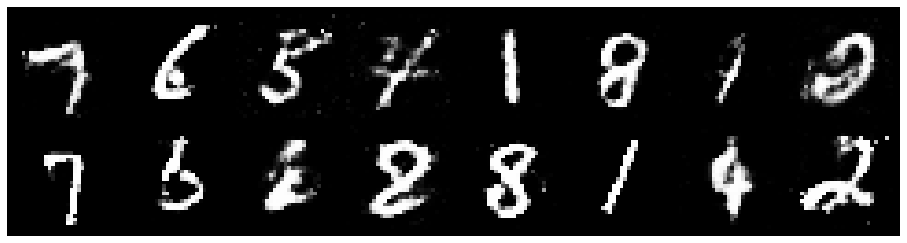

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.3089, Generator Loss: 0.8539
D(x): 0.5218, D(G(z)): 0.4594


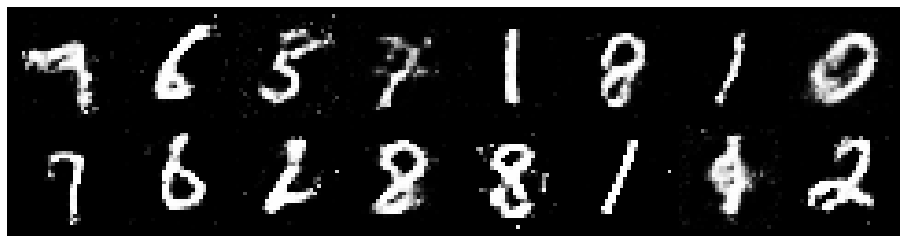

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.3141, Generator Loss: 0.8626
D(x): 0.5690, D(G(z)): 0.4658


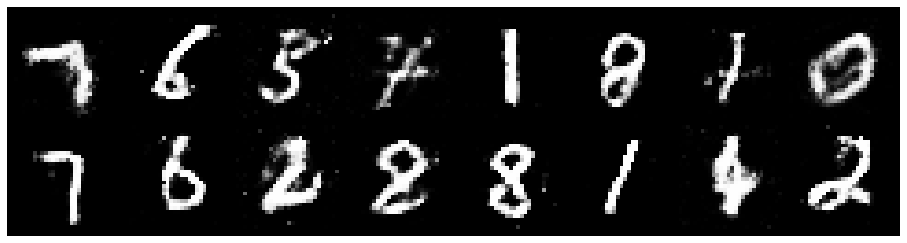

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.2625, Generator Loss: 0.7745
D(x): 0.5720, D(G(z)): 0.4684


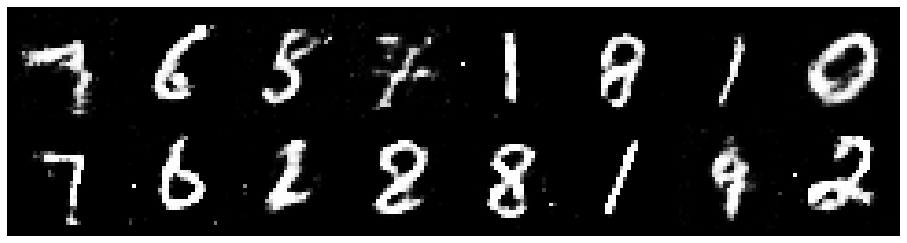

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.2643, Generator Loss: 0.8614
D(x): 0.5670, D(G(z)): 0.4395


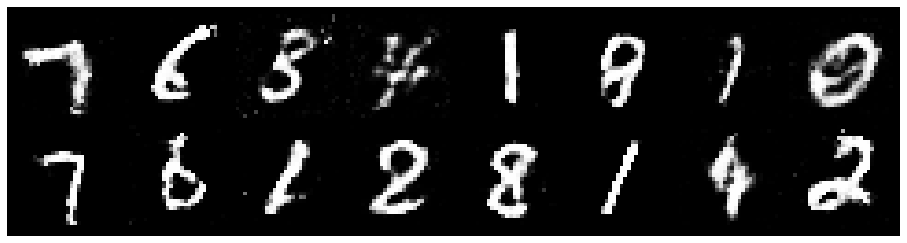

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.2772, Generator Loss: 0.9013
D(x): 0.5245, D(G(z)): 0.4323


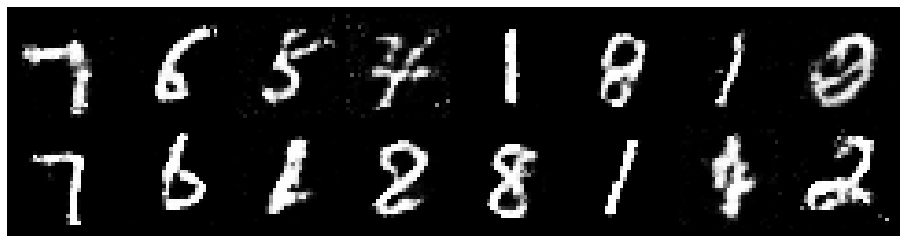

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.1724, Generator Loss: 0.8865
D(x): 0.5657, D(G(z)): 0.4084


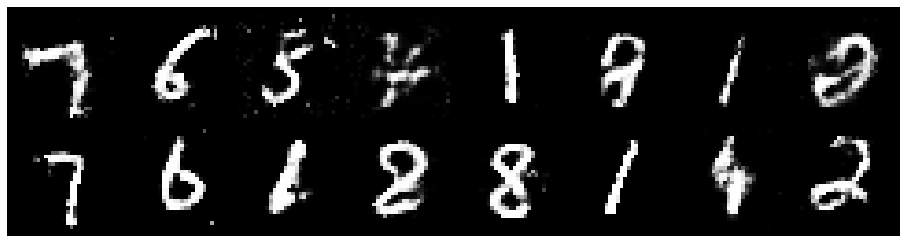

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.1940, Generator Loss: 1.0235
D(x): 0.5631, D(G(z)): 0.4094


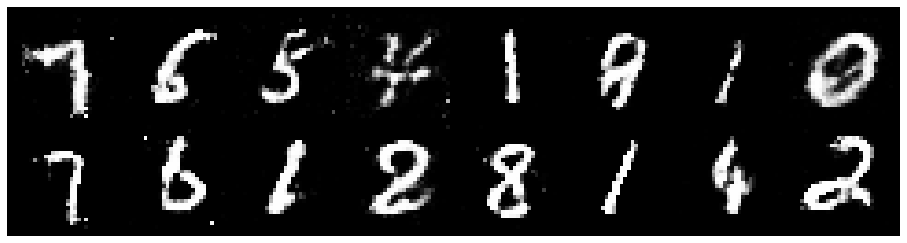

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.1665, Generator Loss: 0.9819
D(x): 0.5765, D(G(z)): 0.3996


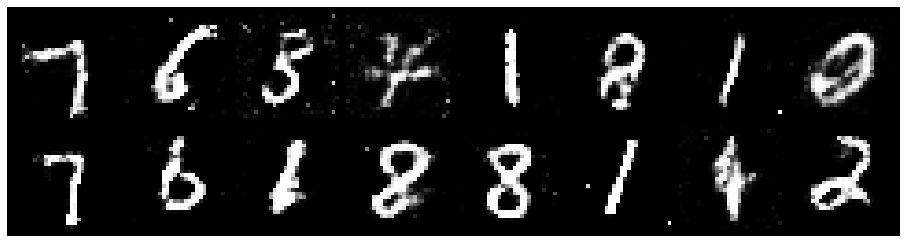

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.1895, Generator Loss: 0.9400
D(x): 0.5793, D(G(z)): 0.4184


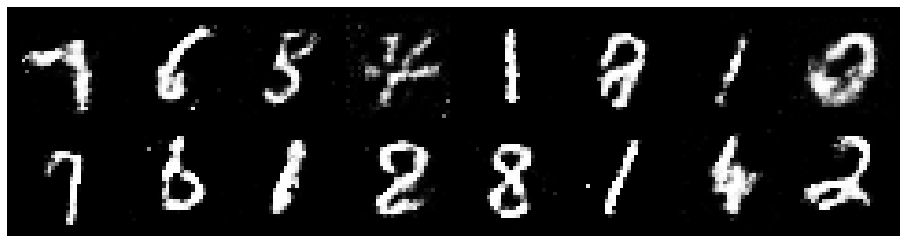

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.2999, Generator Loss: 0.8764
D(x): 0.5428, D(G(z)): 0.4508


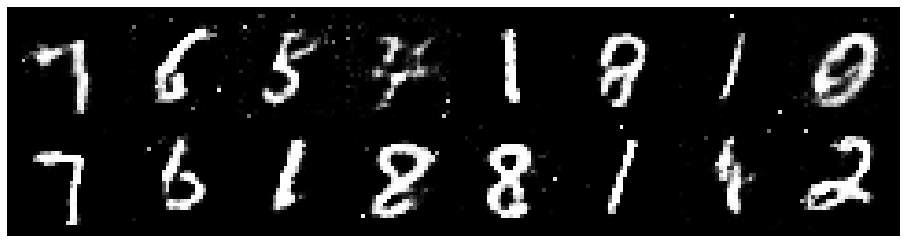

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.2754, Generator Loss: 0.9430
D(x): 0.5627, D(G(z)): 0.4394


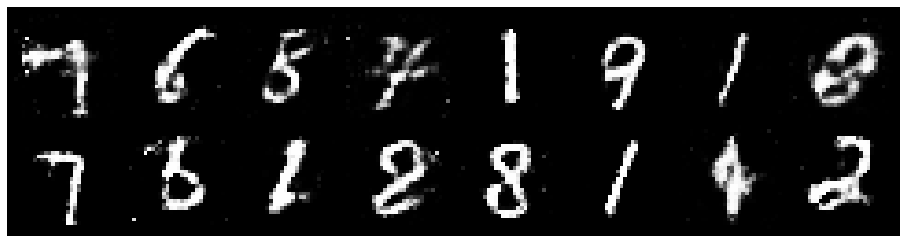

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.2998, Generator Loss: 0.8297
D(x): 0.5313, D(G(z)): 0.4525


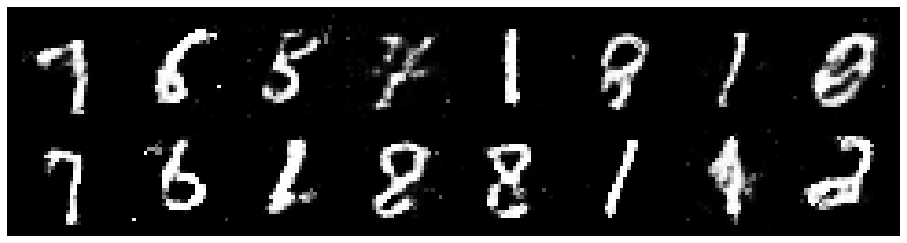

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.2515, Generator Loss: 0.7957
D(x): 0.5594, D(G(z)): 0.4564


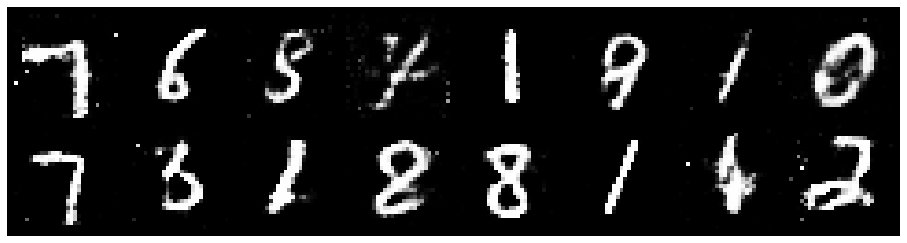

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.4237, Generator Loss: 0.8412
D(x): 0.5062, D(G(z)): 0.4645


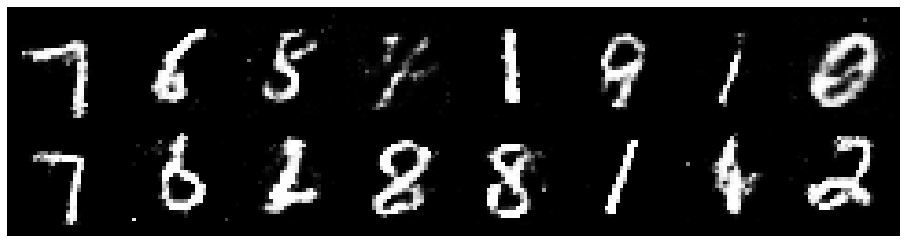

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.2874, Generator Loss: 0.8055
D(x): 0.5527, D(G(z)): 0.4652


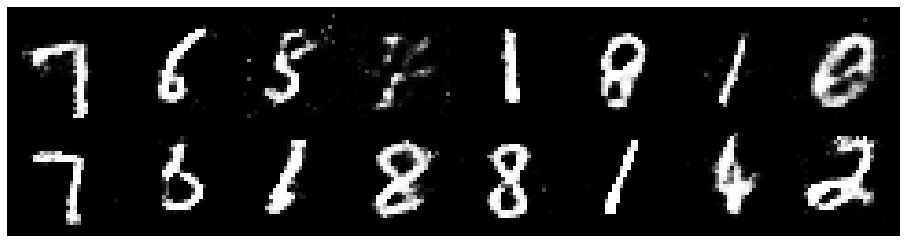

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.3355, Generator Loss: 0.8109
D(x): 0.5557, D(G(z)): 0.4703


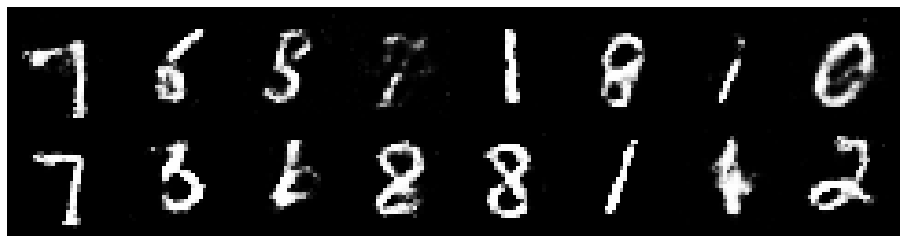

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.2785, Generator Loss: 0.8851
D(x): 0.5515, D(G(z)): 0.4503


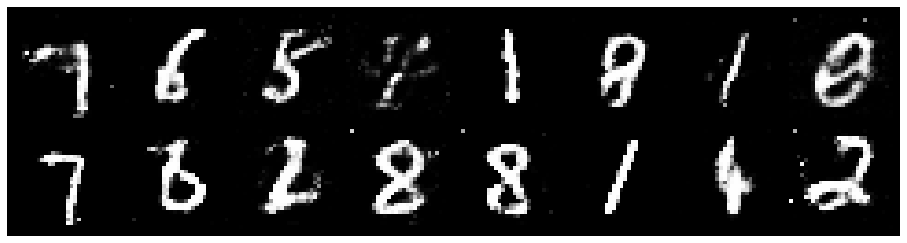

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.2565, Generator Loss: 0.8922
D(x): 0.5569, D(G(z)): 0.4485


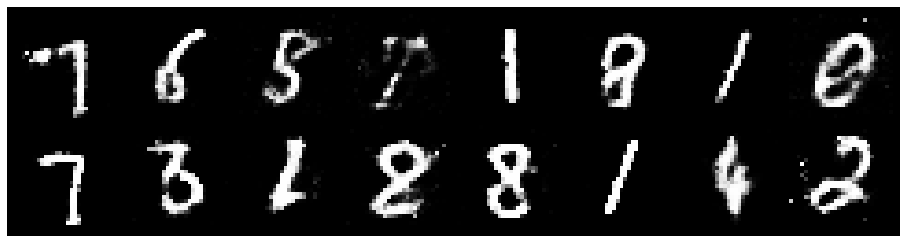

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.2871, Generator Loss: 0.9256
D(x): 0.5364, D(G(z)): 0.4254


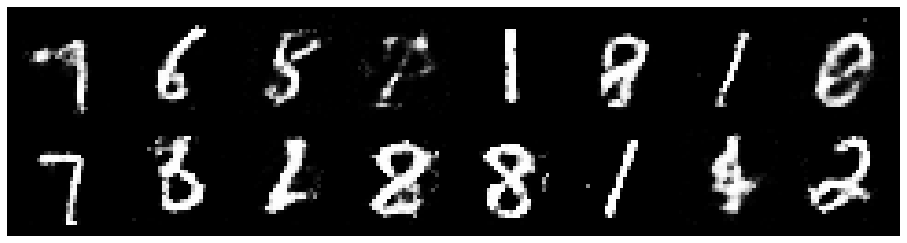

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.3020, Generator Loss: 0.8409
D(x): 0.5528, D(G(z)): 0.4608


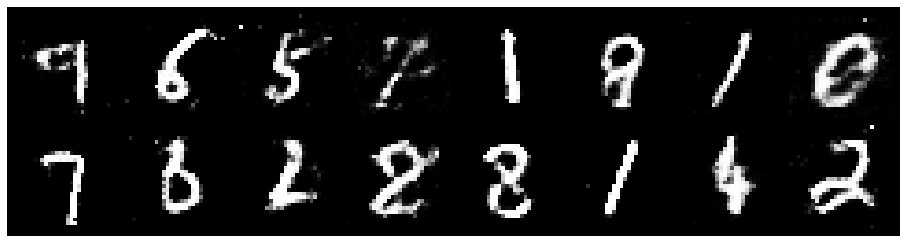

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.2544, Generator Loss: 0.8674
D(x): 0.5420, D(G(z)): 0.4367


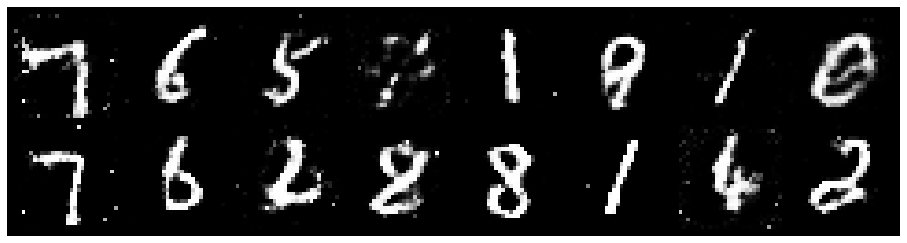

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.2590, Generator Loss: 0.9050
D(x): 0.5629, D(G(z)): 0.4524


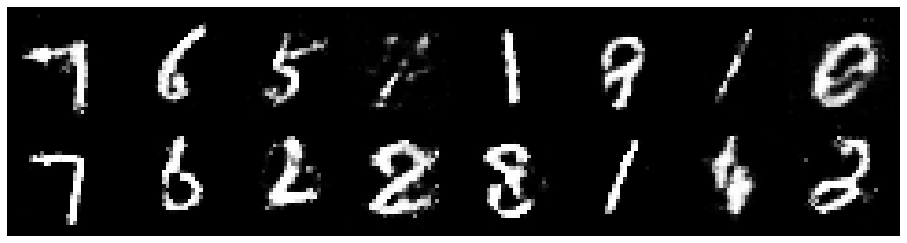

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.3637, Generator Loss: 0.7506
D(x): 0.5156, D(G(z)): 0.4686


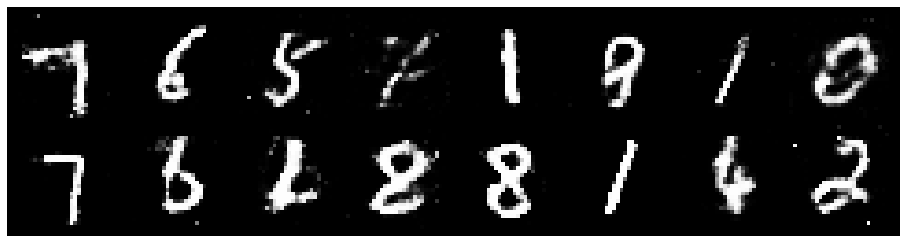

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.3715, Generator Loss: 0.8444
D(x): 0.5442, D(G(z)): 0.4704


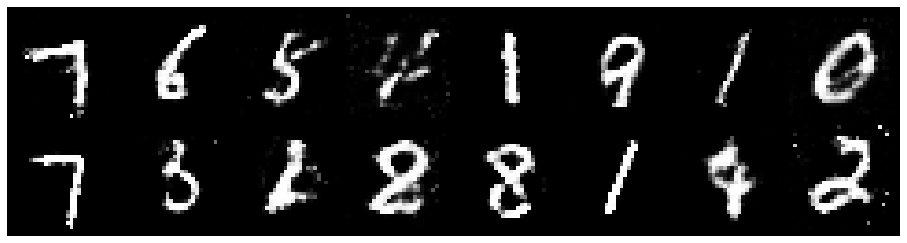

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.3037, Generator Loss: 0.8922
D(x): 0.5348, D(G(z)): 0.4535


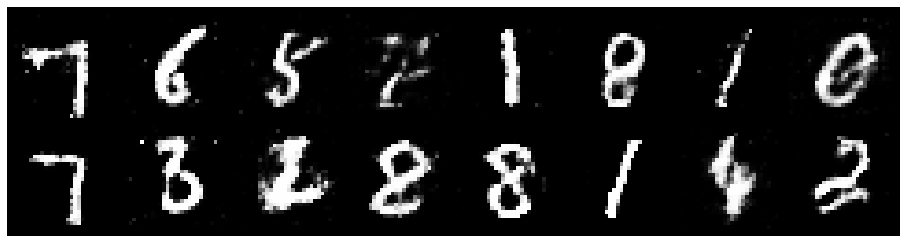

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.2621, Generator Loss: 0.8597
D(x): 0.5363, D(G(z)): 0.4333


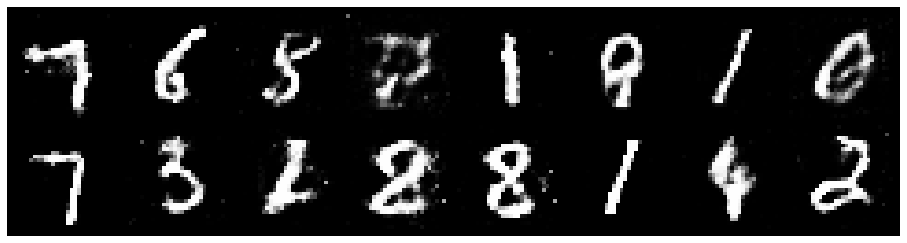

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.2731, Generator Loss: 1.0184
D(x): 0.5333, D(G(z)): 0.4207


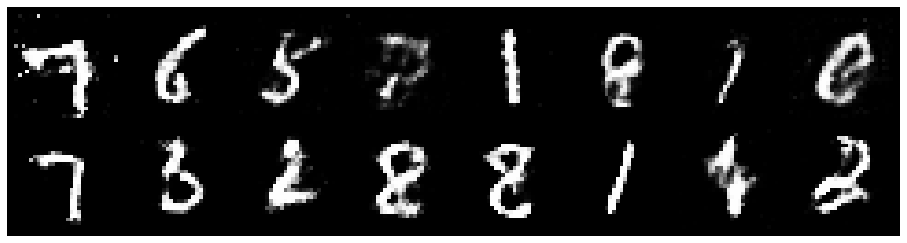

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.2294, Generator Loss: 0.8913
D(x): 0.5777, D(G(z)): 0.4454


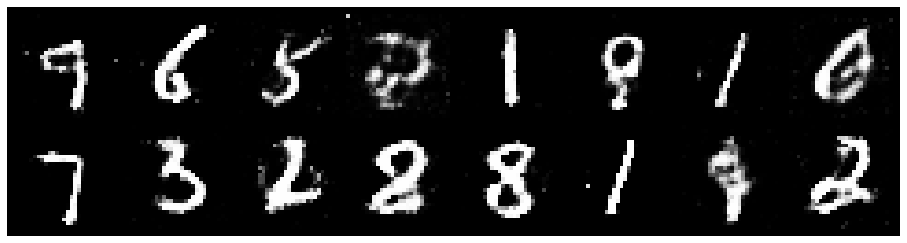

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.2498, Generator Loss: 0.9297
D(x): 0.6068, D(G(z)): 0.4847


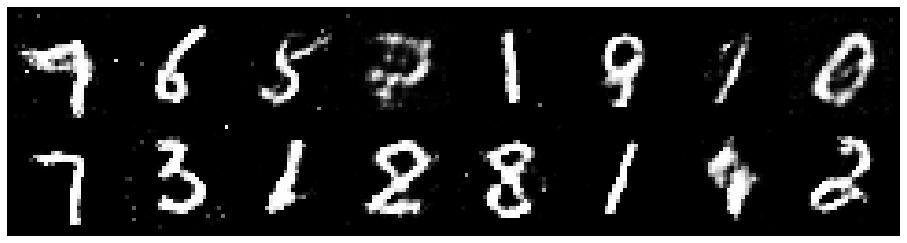

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.2425, Generator Loss: 0.8801
D(x): 0.5927, D(G(z)): 0.4659


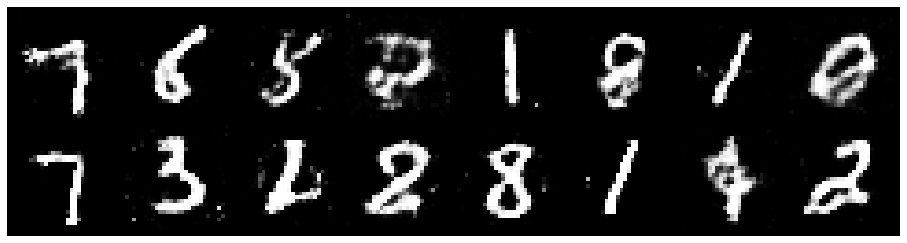

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.3195, Generator Loss: 0.7980
D(x): 0.5426, D(G(z)): 0.4565


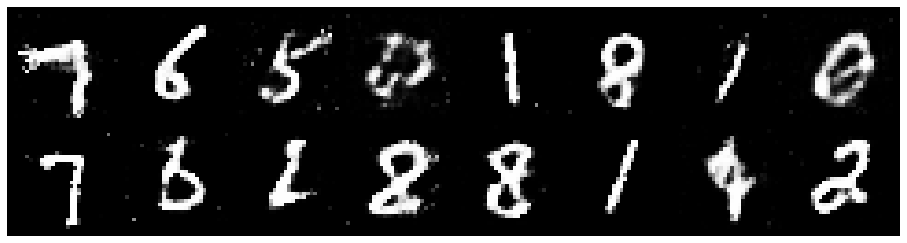

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.3462, Generator Loss: 0.9235
D(x): 0.5616, D(G(z)): 0.4800


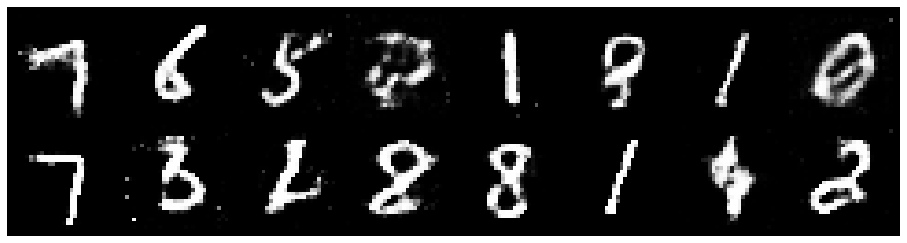

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.3015, Generator Loss: 0.9259
D(x): 0.5535, D(G(z)): 0.4584


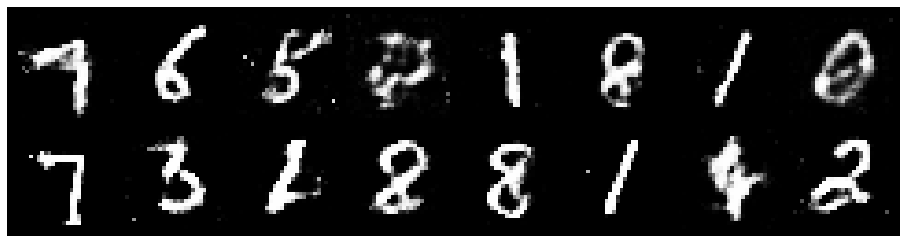

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.3500, Generator Loss: 0.7539
D(x): 0.5463, D(G(z)): 0.4767


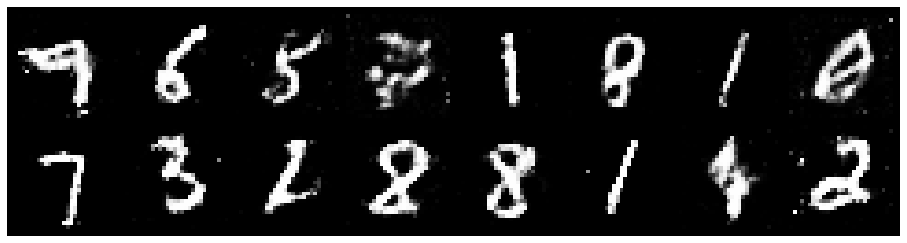

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2774, Generator Loss: 0.8807
D(x): 0.5631, D(G(z)): 0.4532


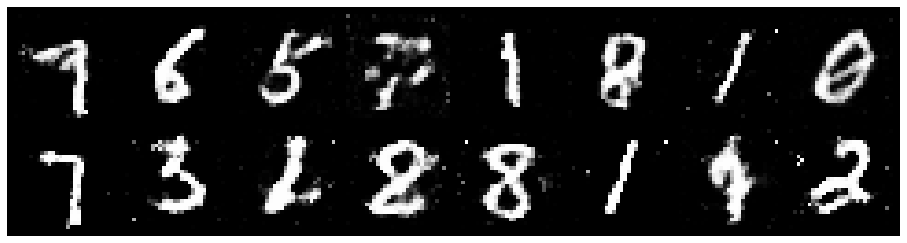

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.2083, Generator Loss: 0.8801
D(x): 0.5539, D(G(z)): 0.4250


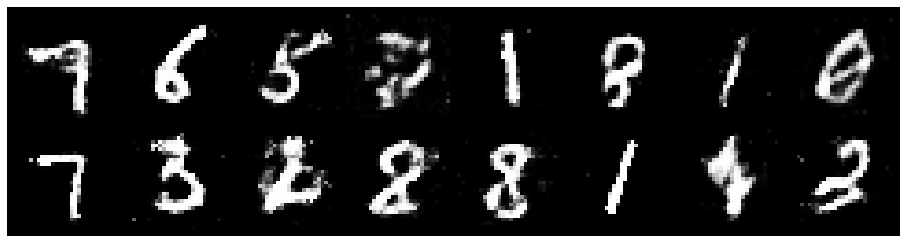

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.3094, Generator Loss: 0.9020
D(x): 0.5193, D(G(z)): 0.4344


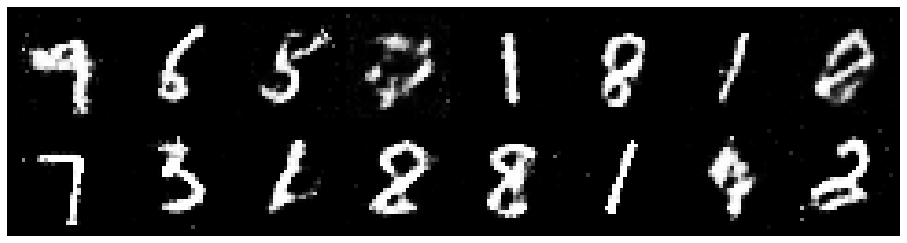

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.3239, Generator Loss: 0.8006
D(x): 0.5323, D(G(z)): 0.4700


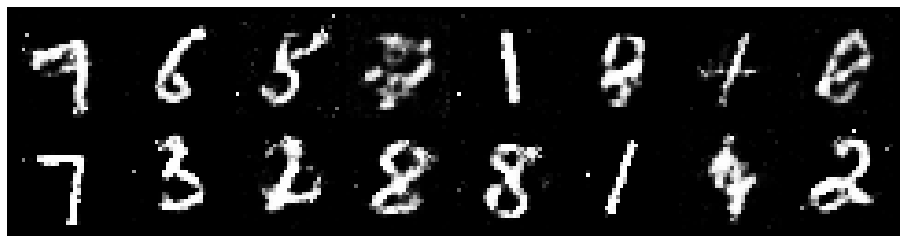

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.1954, Generator Loss: 0.8988
D(x): 0.5668, D(G(z)): 0.4168


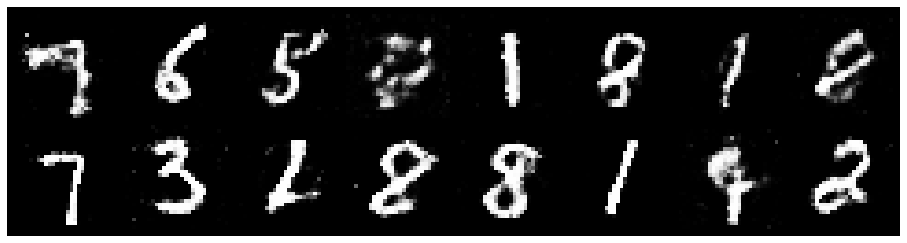

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.2058, Generator Loss: 0.9138
D(x): 0.5627, D(G(z)): 0.4024


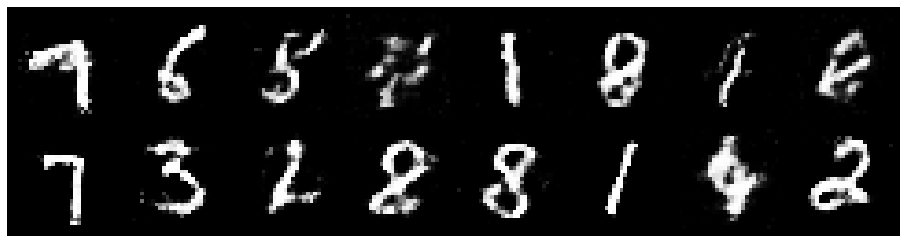

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.2777, Generator Loss: 0.8857
D(x): 0.5167, D(G(z)): 0.4124


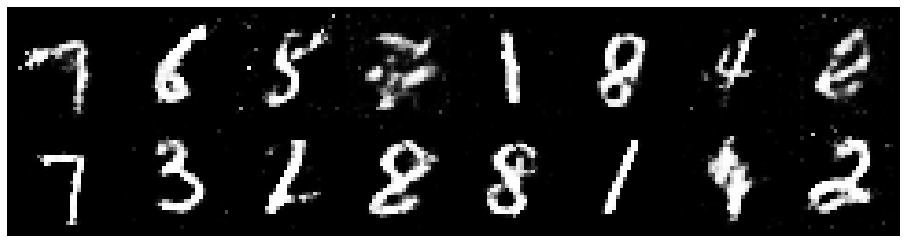

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.3146, Generator Loss: 0.9010
D(x): 0.5054, D(G(z)): 0.4088


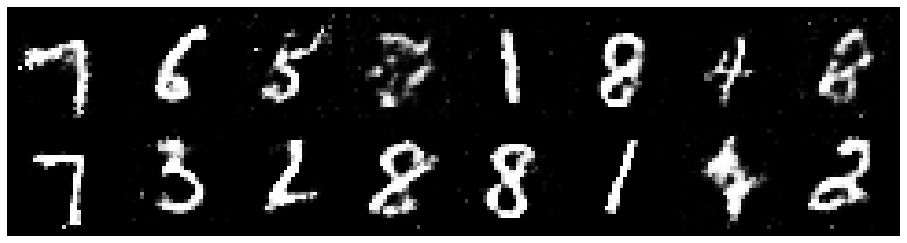

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.2478, Generator Loss: 0.8019
D(x): 0.6027, D(G(z)): 0.4624


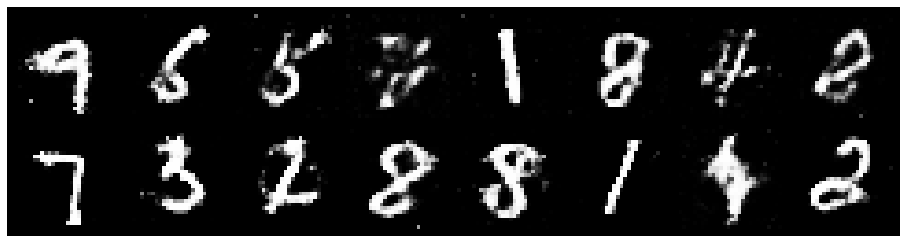

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.2885, Generator Loss: 0.9009
D(x): 0.5429, D(G(z)): 0.4445


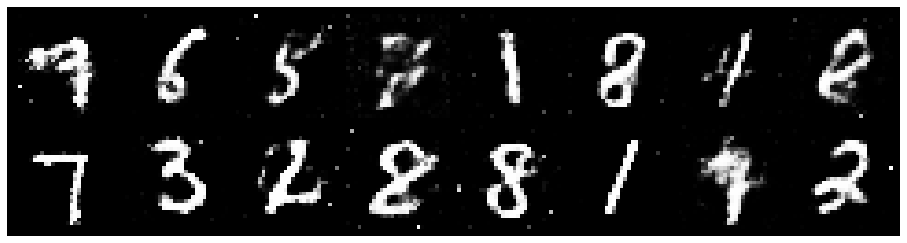

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.2845, Generator Loss: 0.8876
D(x): 0.5401, D(G(z)): 0.4418


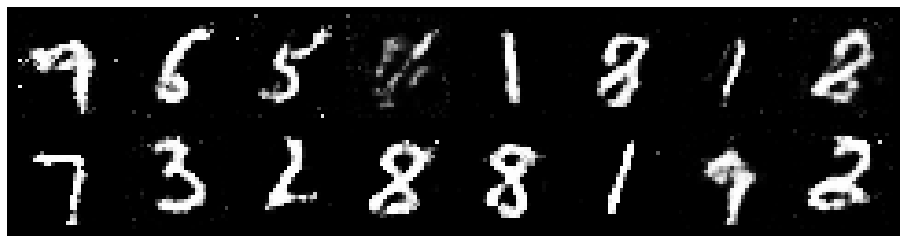

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.2236, Generator Loss: 0.9109
D(x): 0.5434, D(G(z)): 0.4195


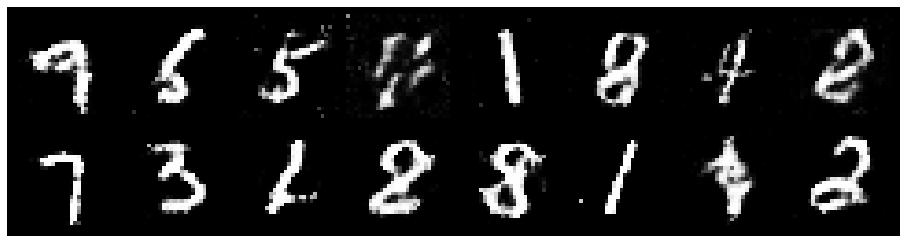

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.2577, Generator Loss: 0.9926
D(x): 0.5328, D(G(z)): 0.4101


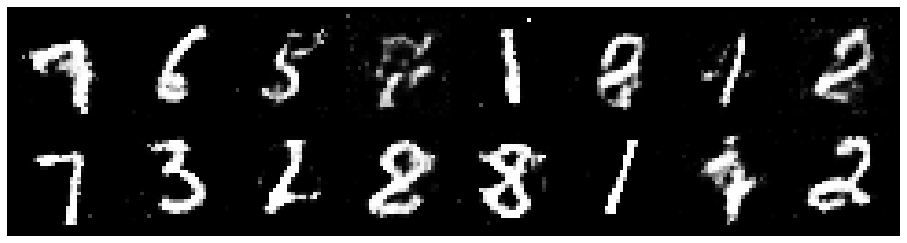

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.1684, Generator Loss: 0.9388
D(x): 0.5847, D(G(z)): 0.4099


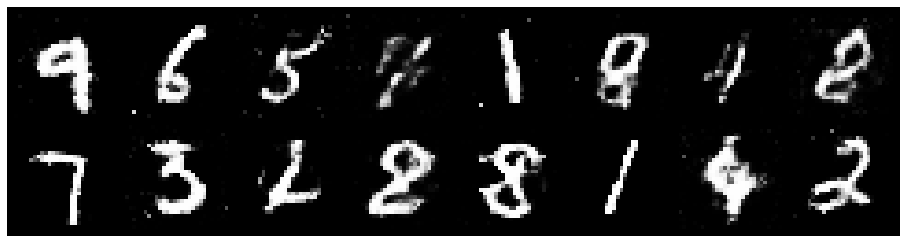

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.3159, Generator Loss: 0.8060
D(x): 0.5736, D(G(z)): 0.4773


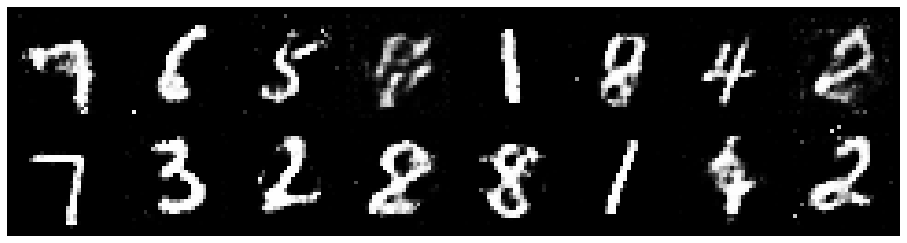

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.2687, Generator Loss: 0.8938
D(x): 0.5608, D(G(z)): 0.4425


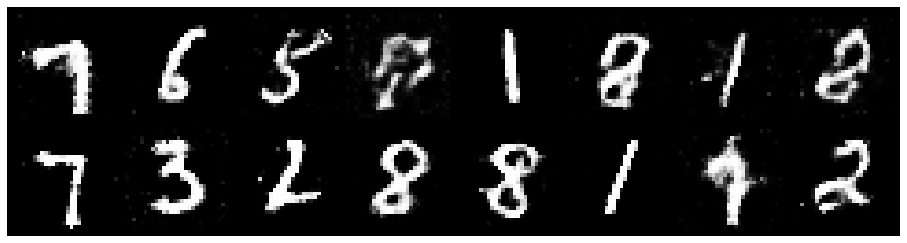

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.2896, Generator Loss: 0.8320
D(x): 0.5843, D(G(z)): 0.4786


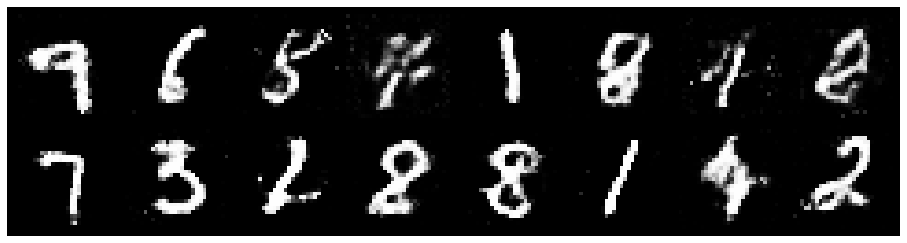

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.1737, Generator Loss: 0.9597
D(x): 0.5816, D(G(z)): 0.4240


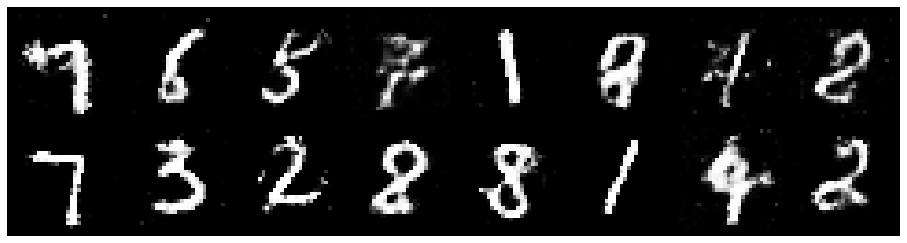

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.3214, Generator Loss: 0.7423
D(x): 0.5910, D(G(z)): 0.5115


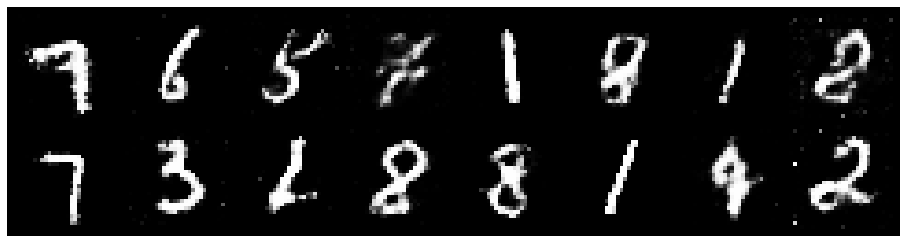

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.2416, Generator Loss: 0.8095
D(x): 0.5783, D(G(z)): 0.4572


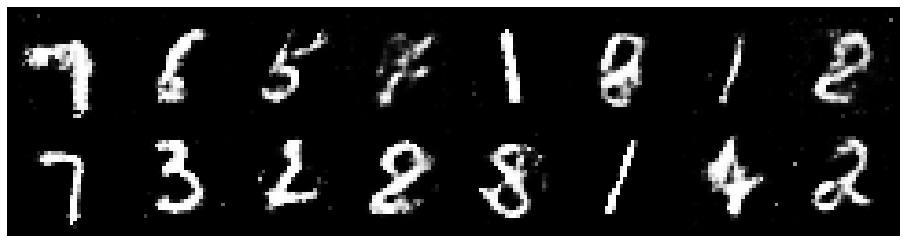

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.2555, Generator Loss: 0.9646
D(x): 0.5427, D(G(z)): 0.4162


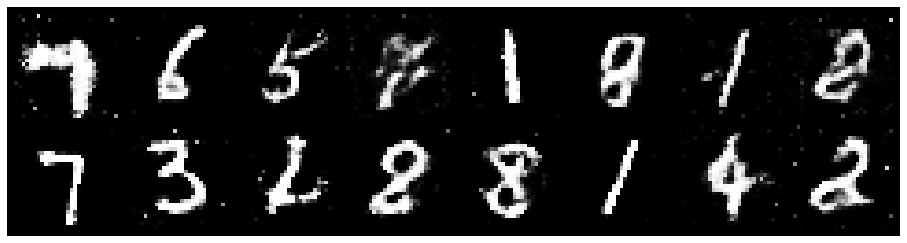

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.3801, Generator Loss: 0.7603
D(x): 0.5539, D(G(z)): 0.4997


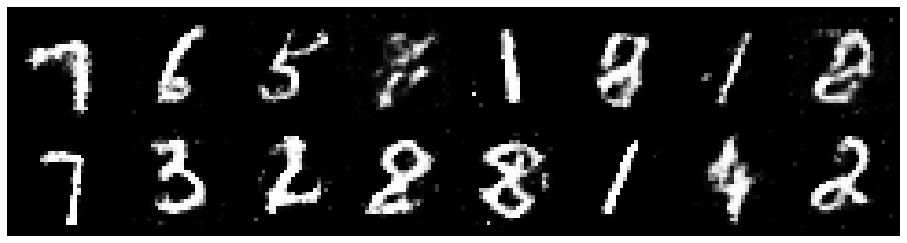

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.2437, Generator Loss: 0.9328
D(x): 0.5588, D(G(z)): 0.4239


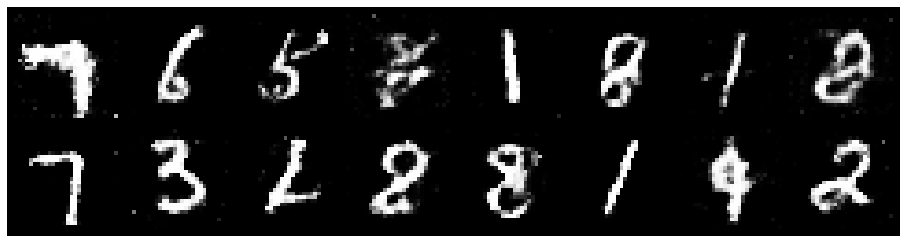

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.1835, Generator Loss: 0.9145
D(x): 0.5838, D(G(z)): 0.4339


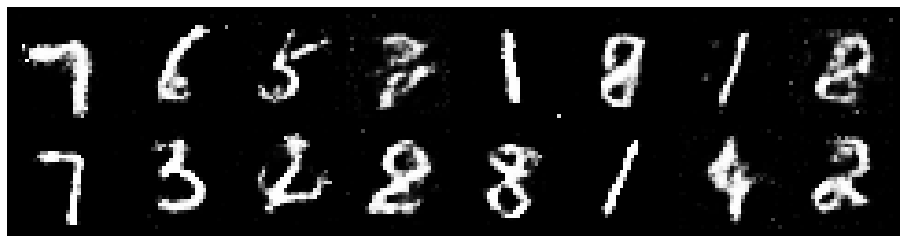

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.2172, Generator Loss: 0.8672
D(x): 0.5366, D(G(z)): 0.4064


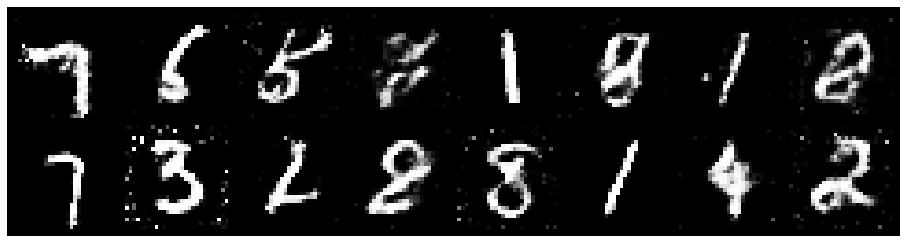

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.2556, Generator Loss: 0.8759
D(x): 0.5544, D(G(z)): 0.4433


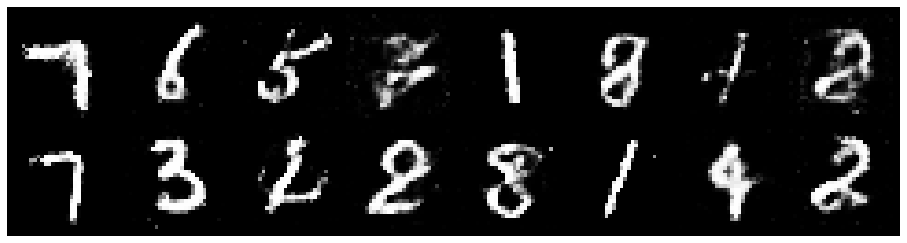

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.2966, Generator Loss: 0.8796
D(x): 0.5415, D(G(z)): 0.4508


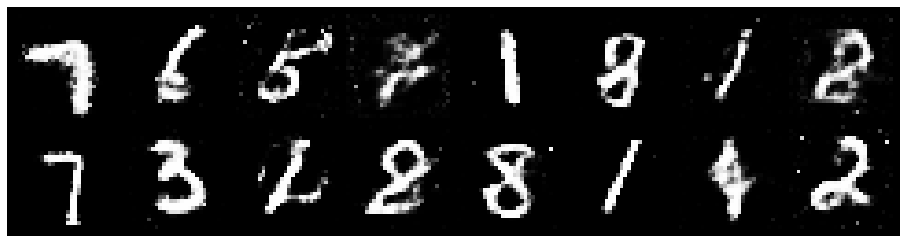

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.2198, Generator Loss: 1.0060
D(x): 0.5506, D(G(z)): 0.4053


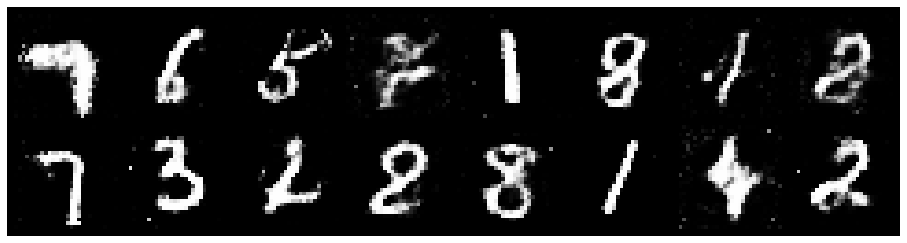

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.1844, Generator Loss: 1.0121
D(x): 0.5417, D(G(z)): 0.3768


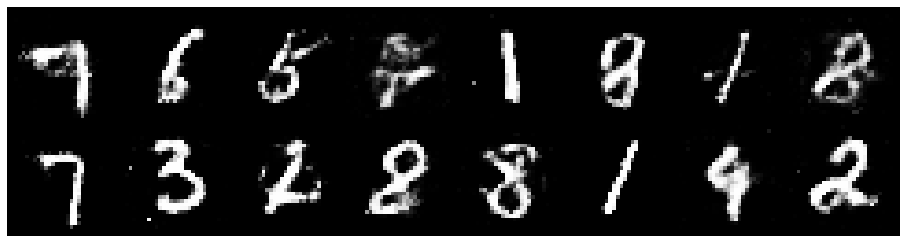

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.2171, Generator Loss: 0.8241
D(x): 0.5883, D(G(z)): 0.4625


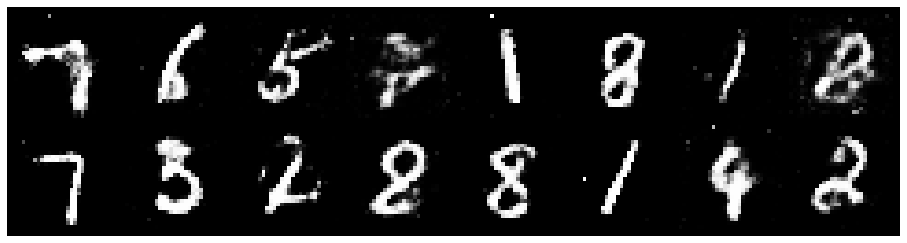

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.2554, Generator Loss: 0.8531
D(x): 0.5389, D(G(z)): 0.4296


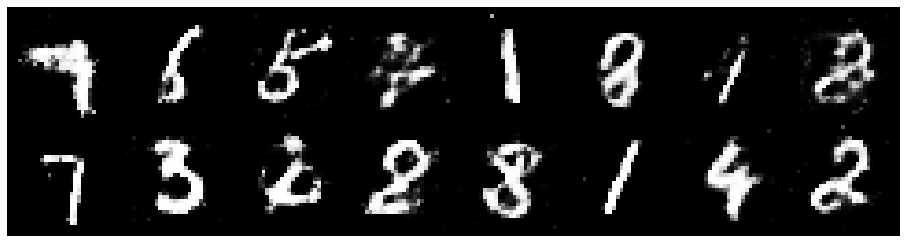

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.3265, Generator Loss: 0.9098
D(x): 0.5237, D(G(z)): 0.4346


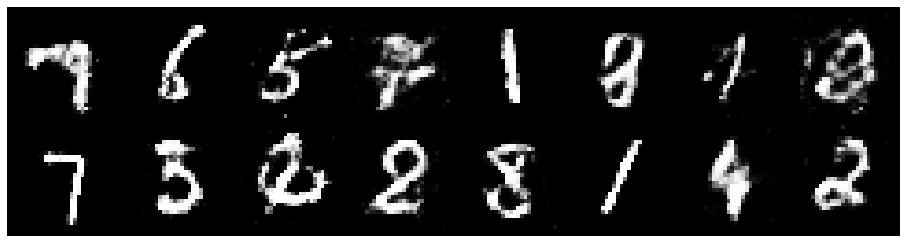

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.4612, Generator Loss: 0.8196
D(x): 0.5344, D(G(z)): 0.5237


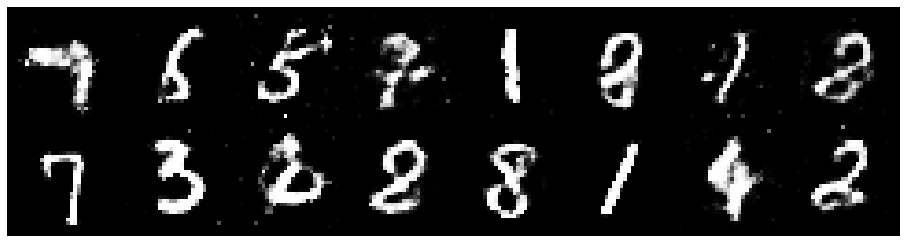

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.2878, Generator Loss: 0.9038
D(x): 0.5192, D(G(z)): 0.4390


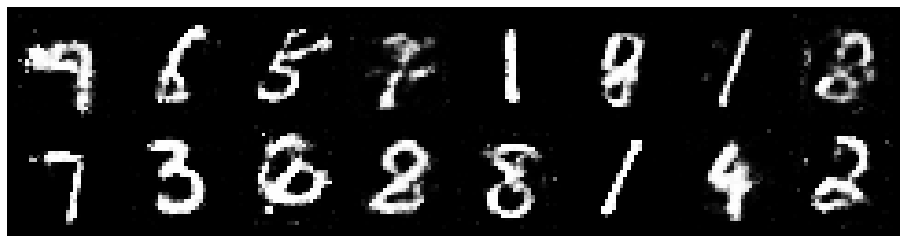

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.1861, Generator Loss: 0.9269
D(x): 0.5901, D(G(z)): 0.4128


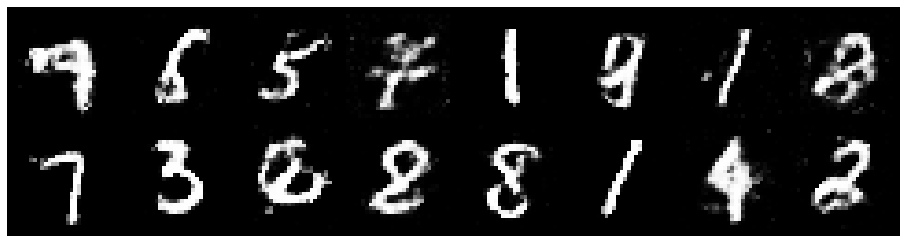

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.2339, Generator Loss: 0.7911
D(x): 0.5723, D(G(z)): 0.4569


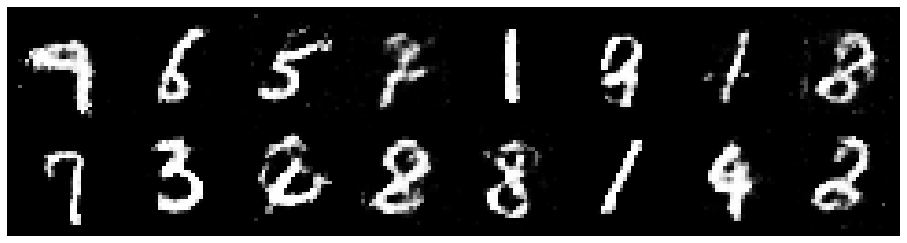

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.2670, Generator Loss: 0.7871
D(x): 0.5591, D(G(z)): 0.4454


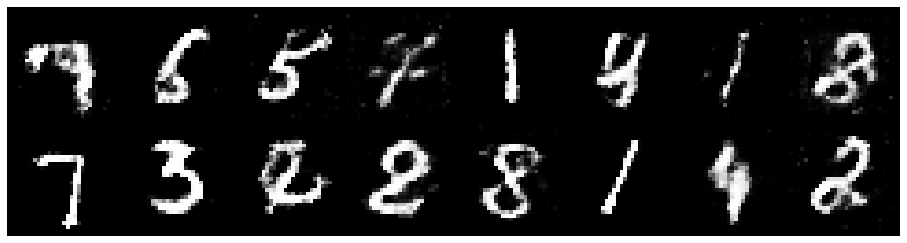

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.2590, Generator Loss: 0.9119
D(x): 0.5501, D(G(z)): 0.4447


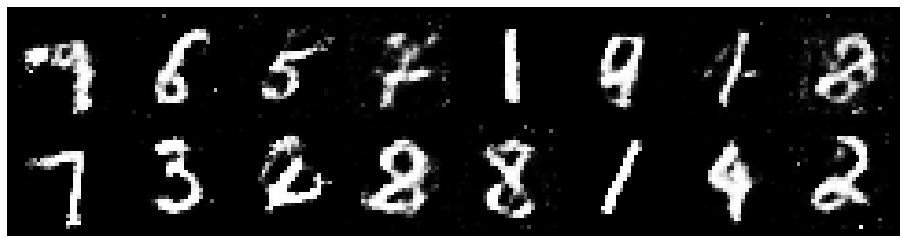

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.2524, Generator Loss: 0.9630
D(x): 0.5744, D(G(z)): 0.4515


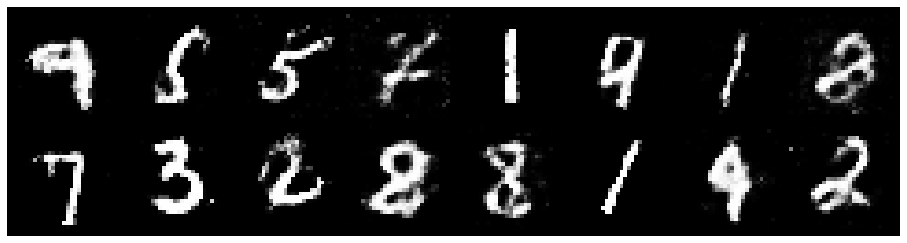

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.3223, Generator Loss: 0.9201
D(x): 0.5383, D(G(z)): 0.4346


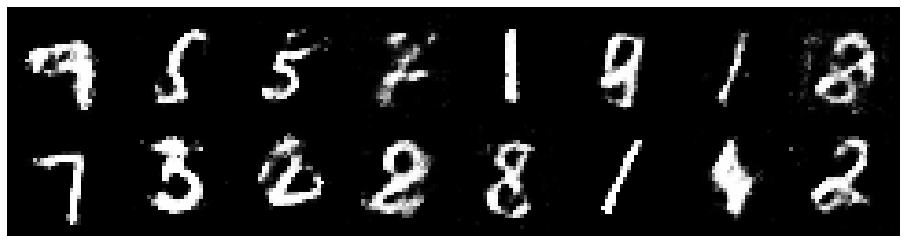

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.2502, Generator Loss: 0.8834
D(x): 0.5325, D(G(z)): 0.4262


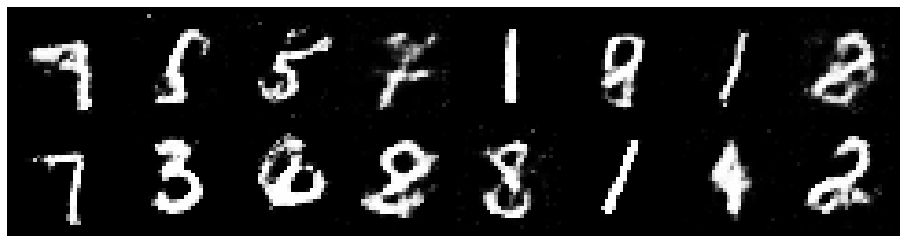

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2808, Generator Loss: 0.8622
D(x): 0.5400, D(G(z)): 0.4346


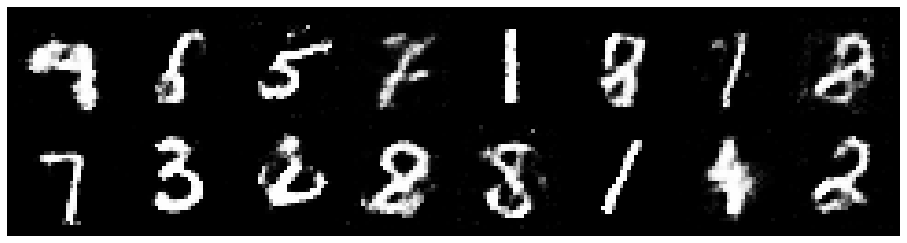

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.3780, Generator Loss: 0.8398
D(x): 0.5659, D(G(z)): 0.4898


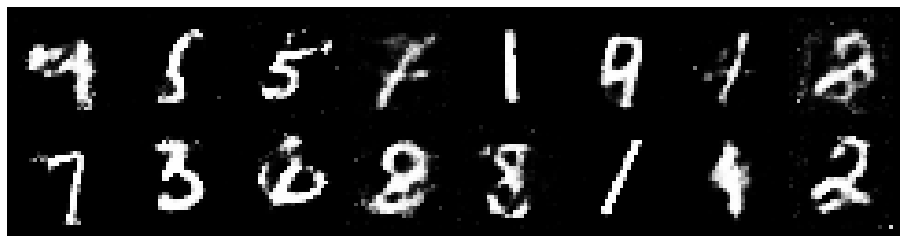

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.2410, Generator Loss: 0.9476
D(x): 0.5695, D(G(z)): 0.4459


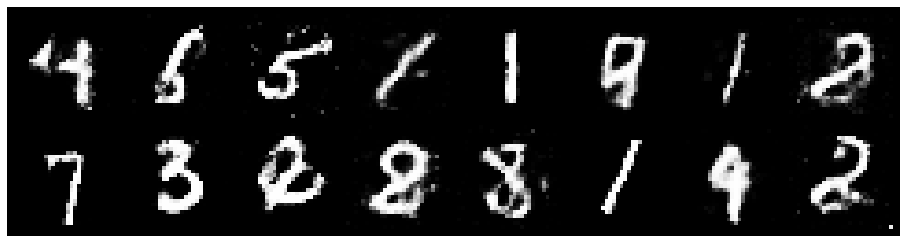

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.3088, Generator Loss: 0.7931
D(x): 0.5258, D(G(z)): 0.4421


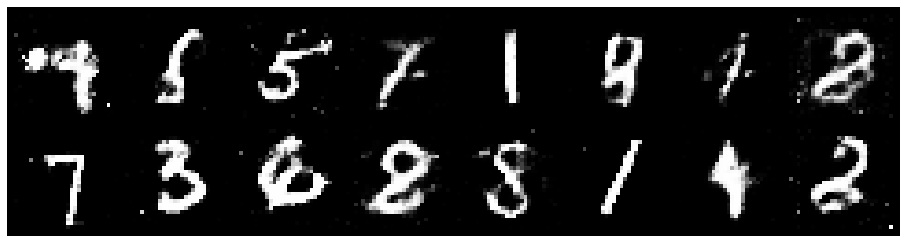

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.3131, Generator Loss: 0.9878
D(x): 0.5428, D(G(z)): 0.4297


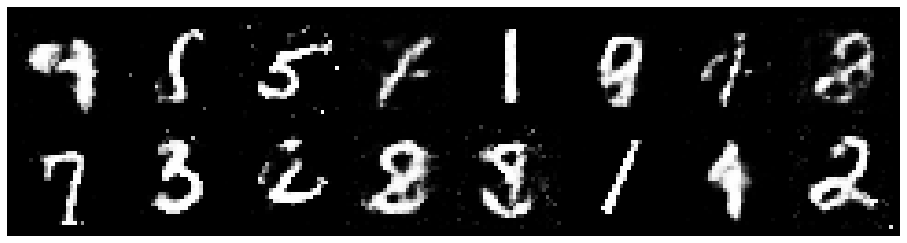

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.2541, Generator Loss: 0.9837
D(x): 0.5338, D(G(z)): 0.4015


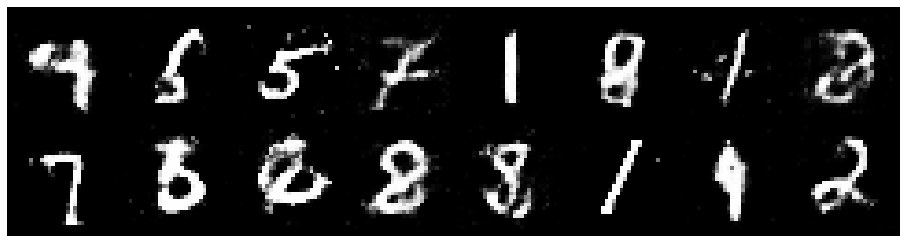

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.3666, Generator Loss: 0.8525
D(x): 0.5597, D(G(z)): 0.4758


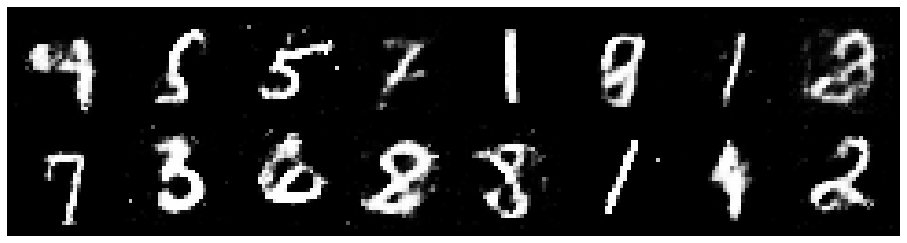

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.4022, Generator Loss: 0.9451
D(x): 0.5077, D(G(z)): 0.4476


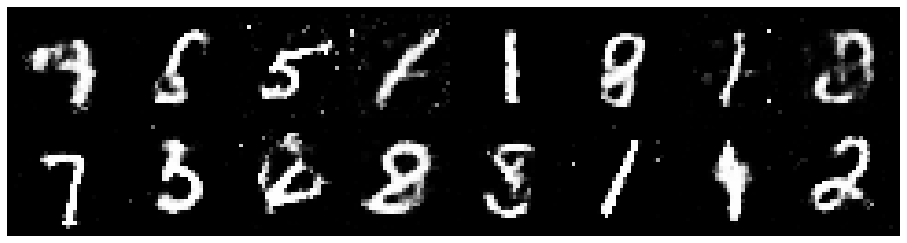

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.2884, Generator Loss: 1.0029
D(x): 0.5470, D(G(z)): 0.4429


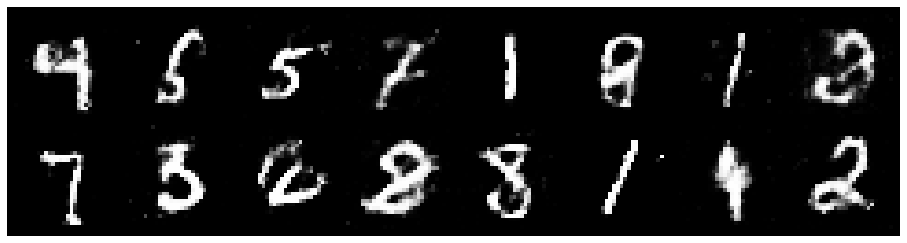

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.2893, Generator Loss: 0.9545
D(x): 0.5444, D(G(z)): 0.4456


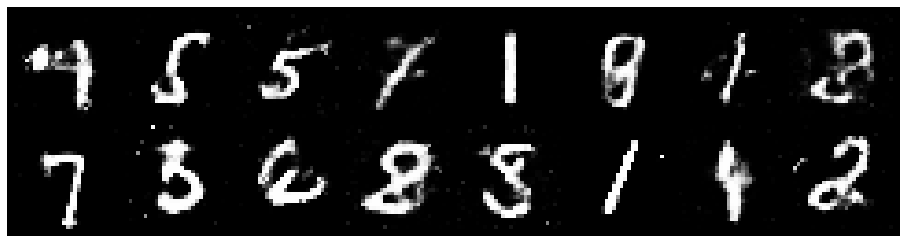

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.3285, Generator Loss: 0.8562
D(x): 0.5545, D(G(z)): 0.4763


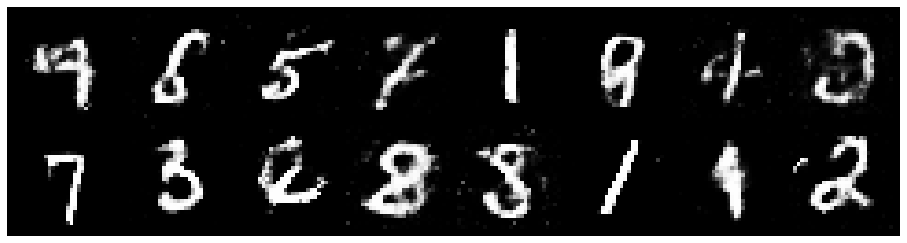

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.2159, Generator Loss: 0.8618
D(x): 0.5759, D(G(z)): 0.4326


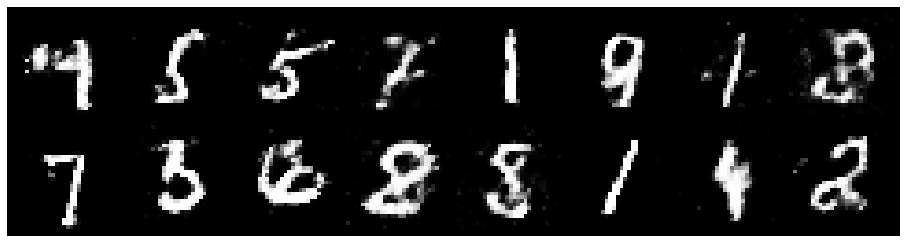

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.2268, Generator Loss: 0.8732
D(x): 0.5590, D(G(z)): 0.4287


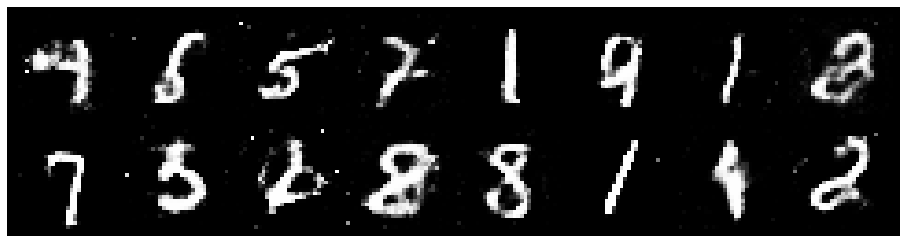

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.2997, Generator Loss: 0.8227
D(x): 0.5255, D(G(z)): 0.4315


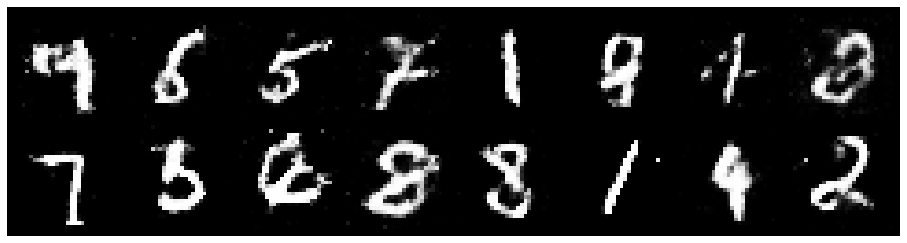

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.3572, Generator Loss: 0.8806
D(x): 0.5601, D(G(z)): 0.4786


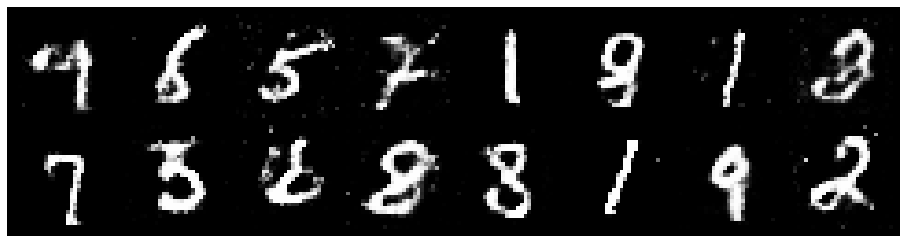

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.3471, Generator Loss: 0.8042
D(x): 0.5217, D(G(z)): 0.4574


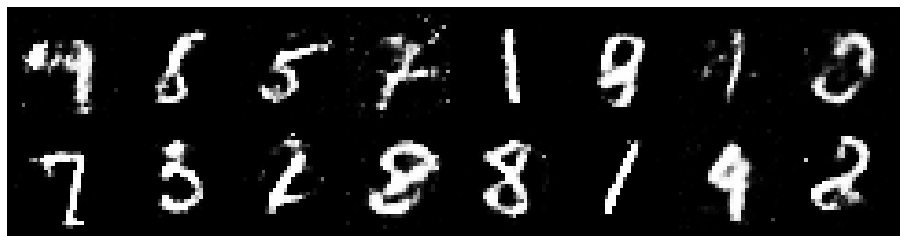

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.3348, Generator Loss: 0.8529
D(x): 0.5361, D(G(z)): 0.4563


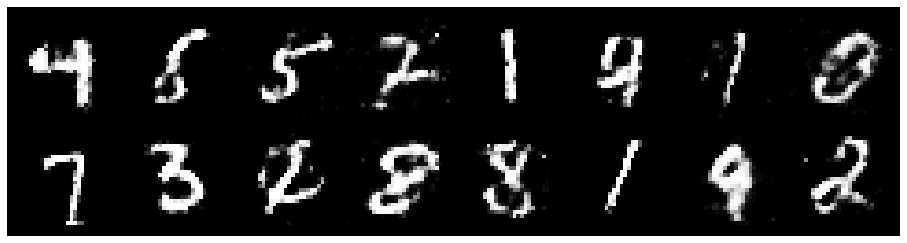

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.2180, Generator Loss: 0.8661
D(x): 0.5636, D(G(z)): 0.4269


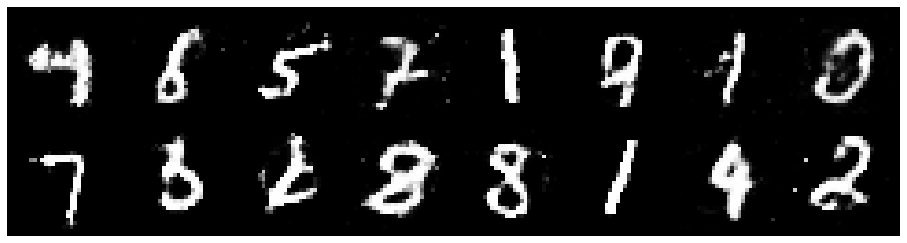

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.2216, Generator Loss: 0.7567
D(x): 0.6397, D(G(z)): 0.4880


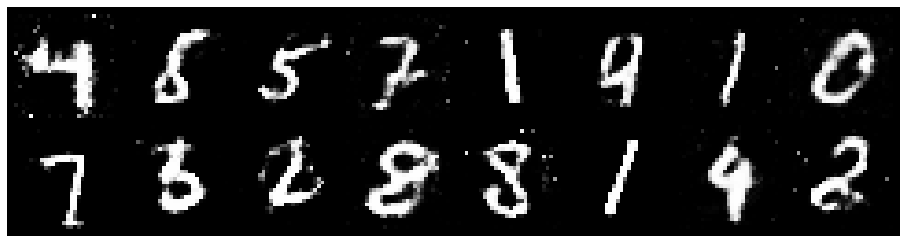

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.3821, Generator Loss: 1.1109
D(x): 0.5230, D(G(z)): 0.4334


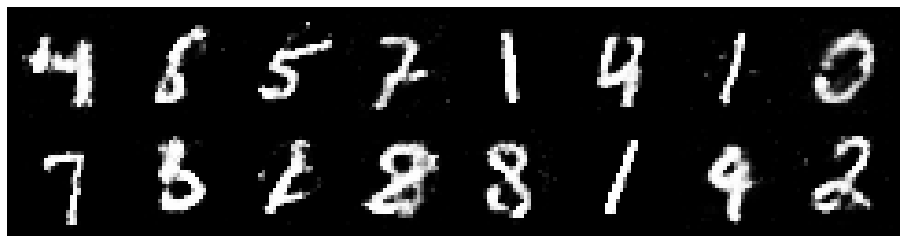

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2309, Generator Loss: 0.8113
D(x): 0.5547, D(G(z)): 0.4215


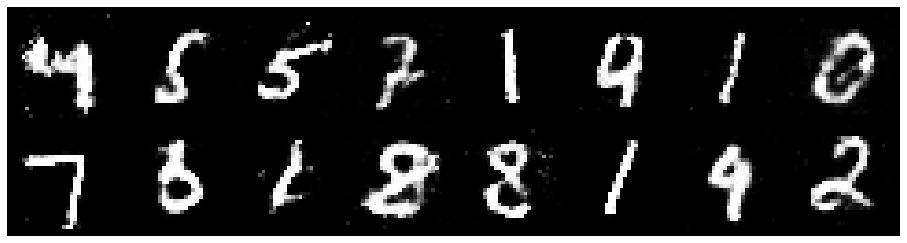

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.2384, Generator Loss: 0.8436
D(x): 0.5687, D(G(z)): 0.4463


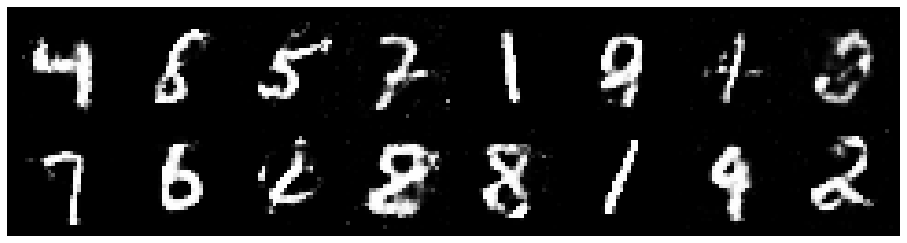

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.3126, Generator Loss: 0.8559
D(x): 0.5163, D(G(z)): 0.4521


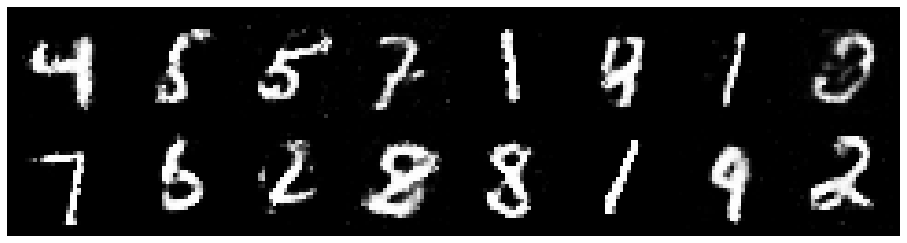

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.2721, Generator Loss: 0.9160
D(x): 0.5398, D(G(z)): 0.4441


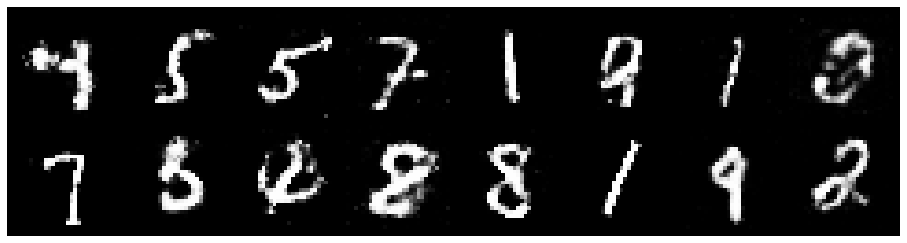

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.2335, Generator Loss: 0.8628
D(x): 0.5839, D(G(z)): 0.4660


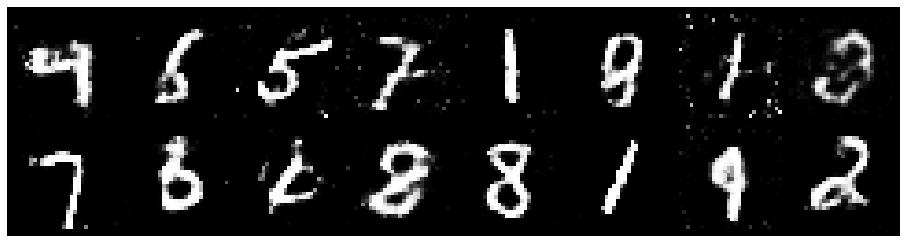

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.2555, Generator Loss: 0.9388
D(x): 0.5489, D(G(z)): 0.4396


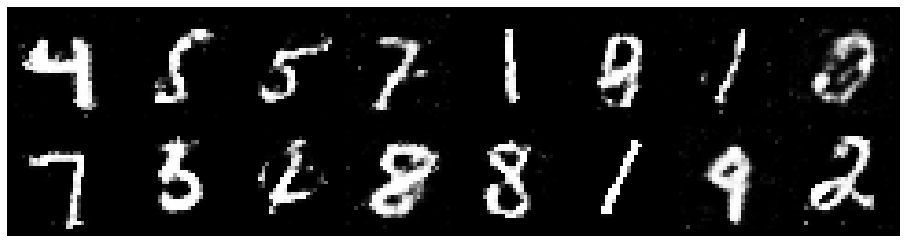

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.2314, Generator Loss: 0.9133
D(x): 0.5664, D(G(z)): 0.4296


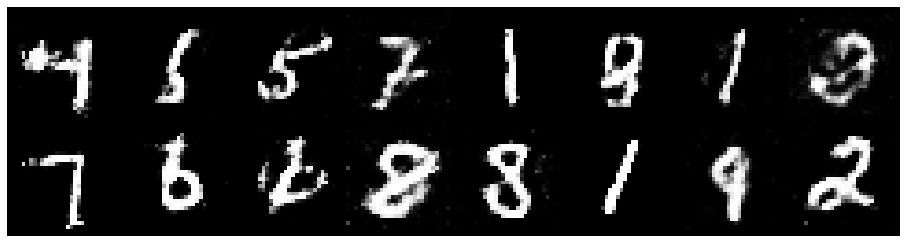

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.3319, Generator Loss: 0.8522
D(x): 0.5619, D(G(z)): 0.4839


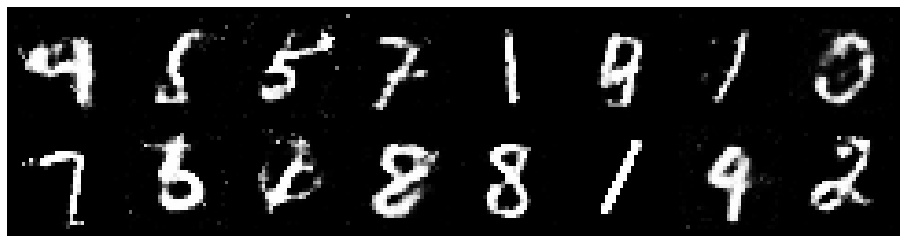

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.3076, Generator Loss: 0.8855
D(x): 0.5339, D(G(z)): 0.4509


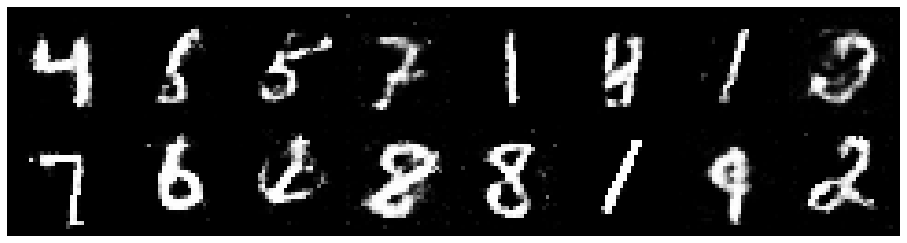

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.2488, Generator Loss: 1.0067
D(x): 0.5717, D(G(z)): 0.4411


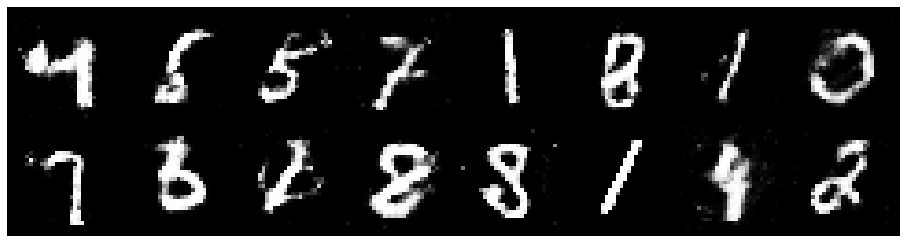

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.2009, Generator Loss: 0.9144
D(x): 0.5818, D(G(z)): 0.4441


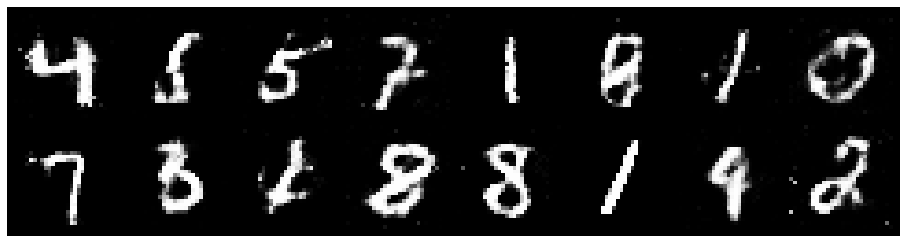

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.3216, Generator Loss: 0.8339
D(x): 0.5574, D(G(z)): 0.4614


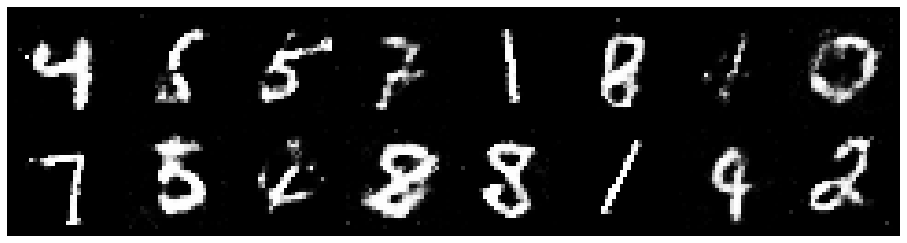

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.2442, Generator Loss: 0.9817
D(x): 0.5931, D(G(z)): 0.4541


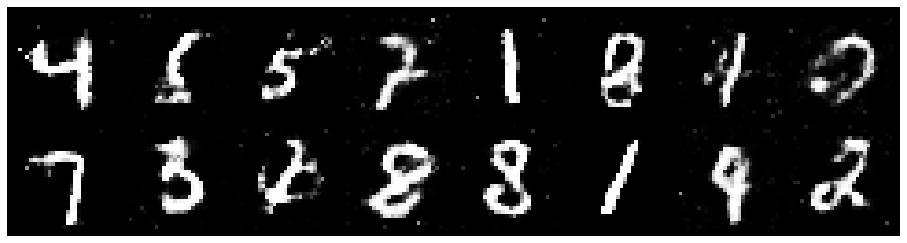

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.2539, Generator Loss: 0.8499
D(x): 0.5784, D(G(z)): 0.4498


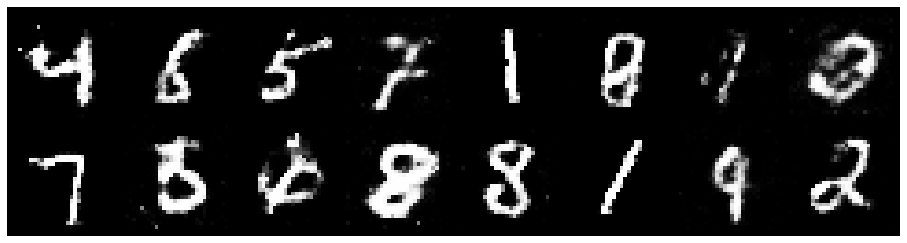

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.3019, Generator Loss: 1.0135
D(x): 0.5292, D(G(z)): 0.4181


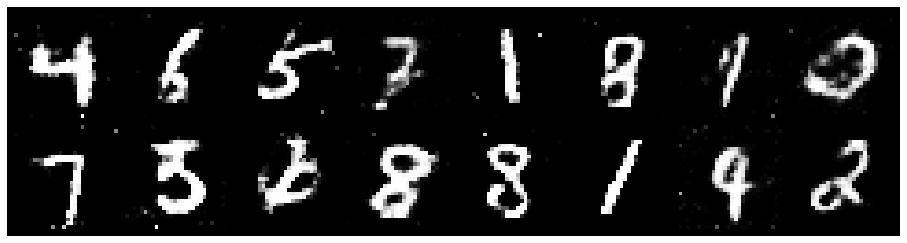

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.1607, Generator Loss: 0.8625
D(x): 0.5695, D(G(z)): 0.4112


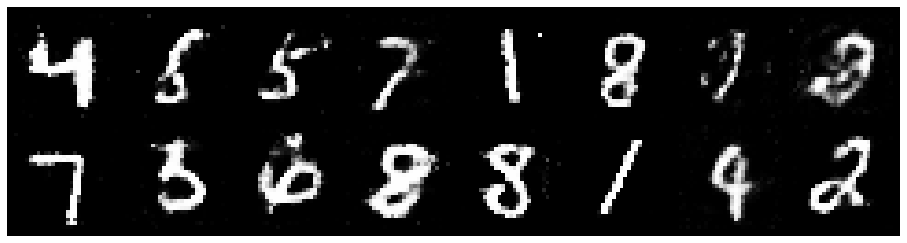

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.2411, Generator Loss: 0.8332
D(x): 0.5671, D(G(z)): 0.4564


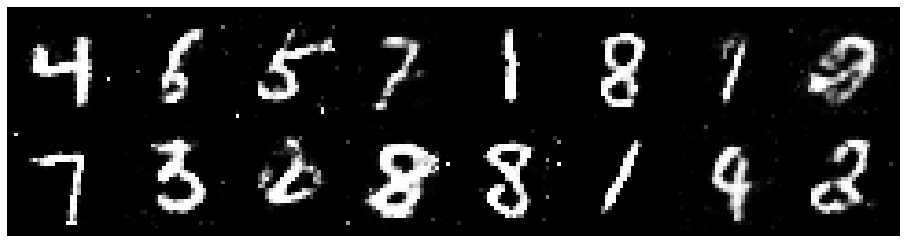

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.1407, Generator Loss: 0.9926
D(x): 0.5889, D(G(z)): 0.4190


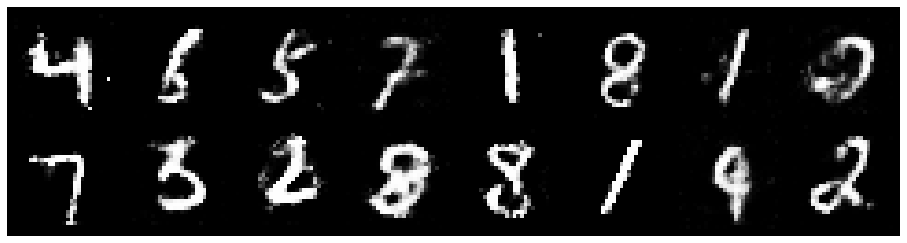

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.2135, Generator Loss: 0.9654
D(x): 0.5700, D(G(z)): 0.4162


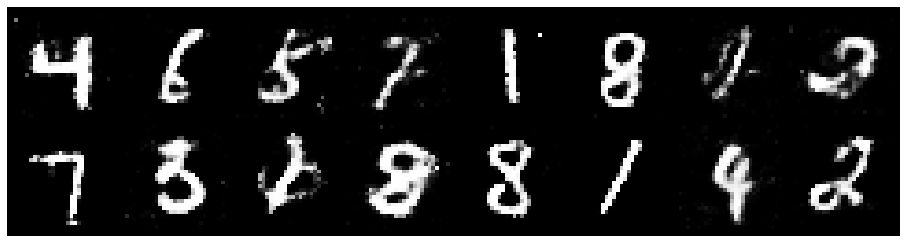

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.2147, Generator Loss: 0.9772
D(x): 0.5387, D(G(z)): 0.3912


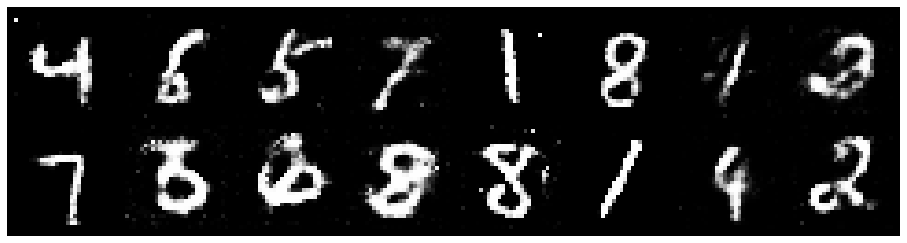

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.3725, Generator Loss: 0.9066
D(x): 0.5364, D(G(z)): 0.4831


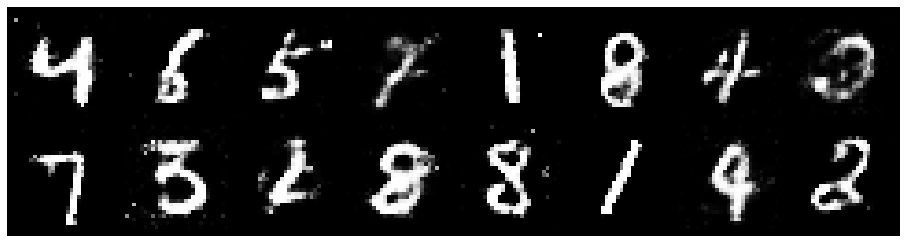

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.2745, Generator Loss: 0.7893
D(x): 0.5454, D(G(z)): 0.4538


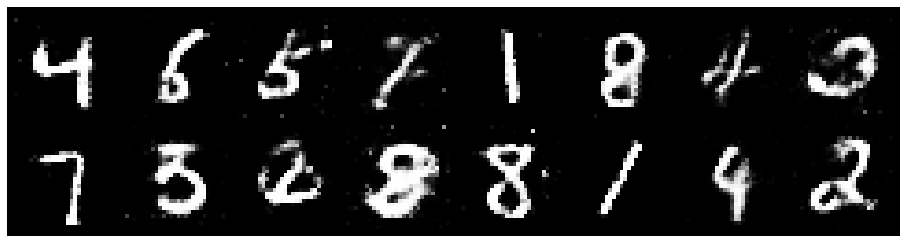

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.2189, Generator Loss: 0.8643
D(x): 0.5477, D(G(z)): 0.4258


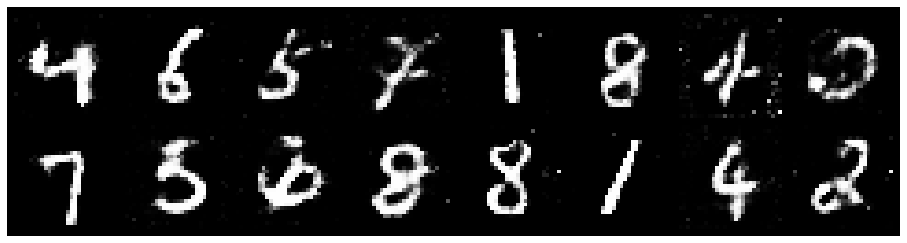

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.2873, Generator Loss: 0.9840
D(x): 0.5273, D(G(z)): 0.4197


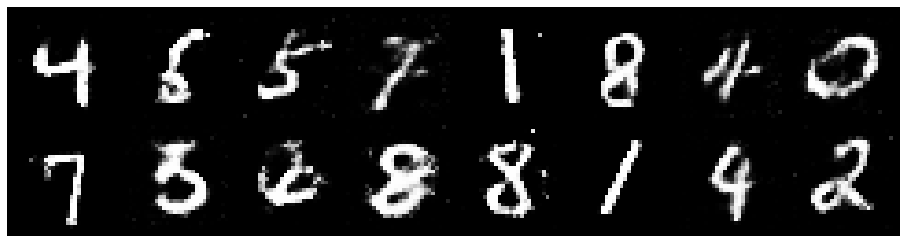

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.2438, Generator Loss: 0.8742
D(x): 0.5454, D(G(z)): 0.4305


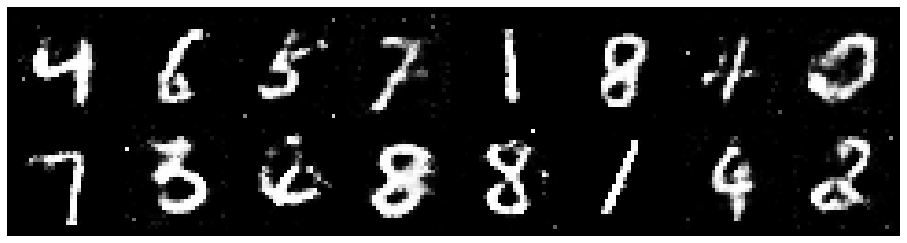

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.2649, Generator Loss: 0.7817
D(x): 0.5796, D(G(z)): 0.4739


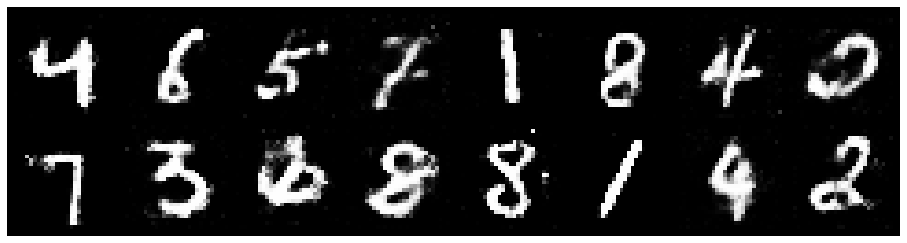

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.1592, Generator Loss: 0.8735
D(x): 0.6185, D(G(z)): 0.4525


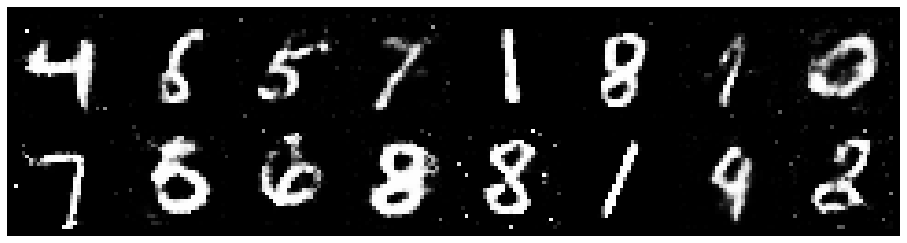

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.1353, Generator Loss: 0.9342
D(x): 0.5992, D(G(z)): 0.4247


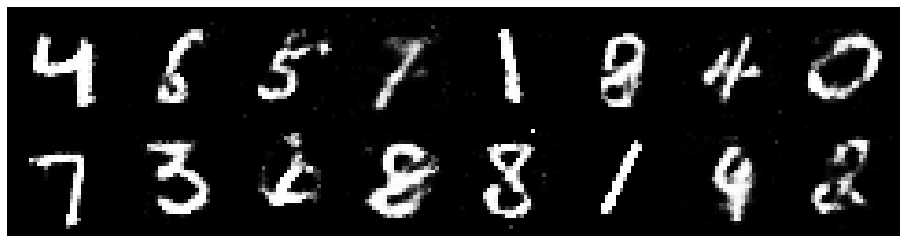

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.3829, Generator Loss: 0.7795
D(x): 0.5704, D(G(z)): 0.5056


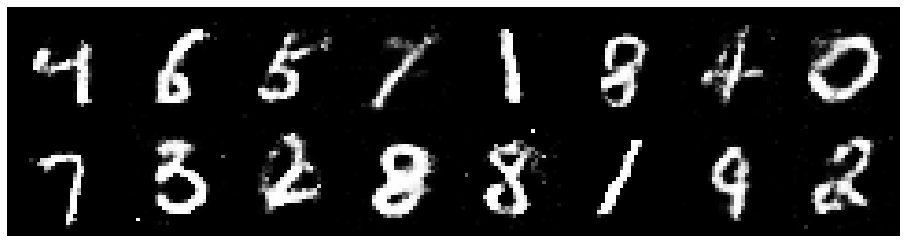

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.2889, Generator Loss: 0.8092
D(x): 0.5345, D(G(z)): 0.4368


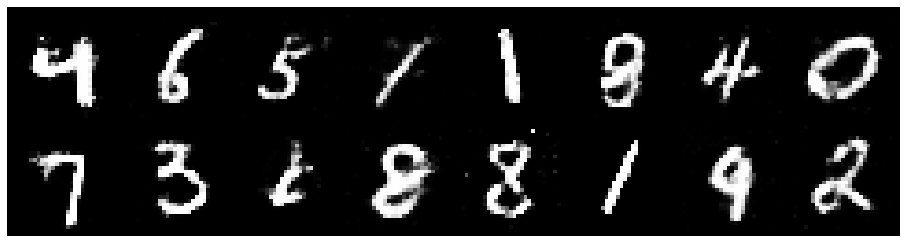

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.3184, Generator Loss: 0.8252
D(x): 0.5189, D(G(z)): 0.4462


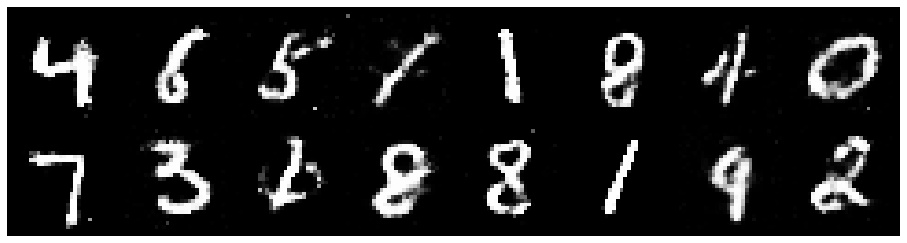

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.3163, Generator Loss: 0.8568
D(x): 0.5579, D(G(z)): 0.4637


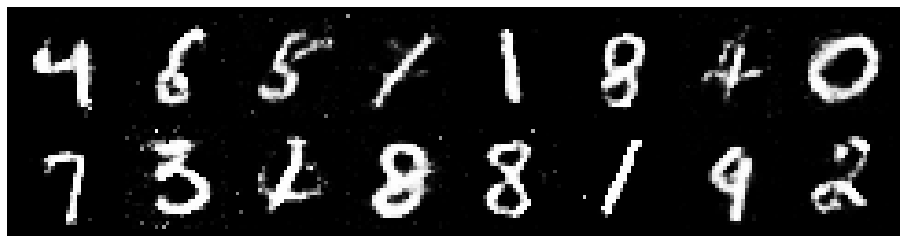

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.2073, Generator Loss: 0.8419
D(x): 0.5889, D(G(z)): 0.4512


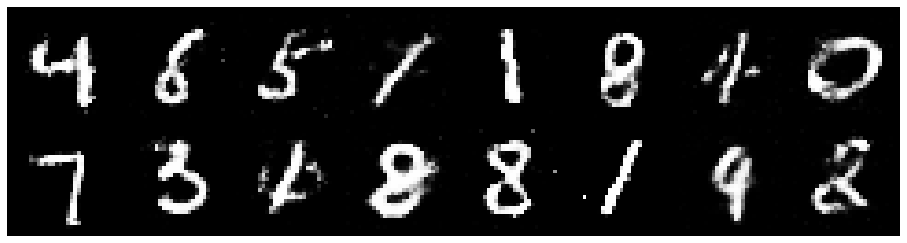

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.3540, Generator Loss: 0.8741
D(x): 0.5020, D(G(z)): 0.4383


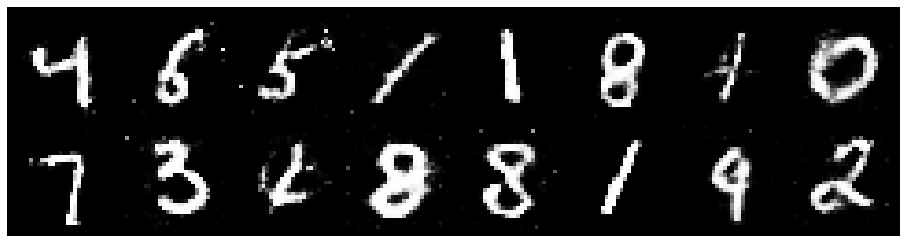

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.3590, Generator Loss: 0.8425
D(x): 0.4813, D(G(z)): 0.4230


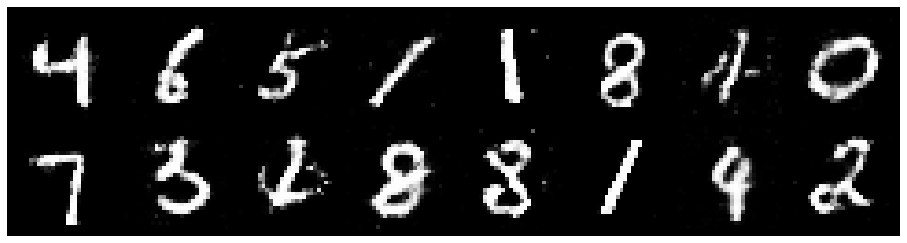

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.2024, Generator Loss: 0.9707
D(x): 0.5874, D(G(z)): 0.4448


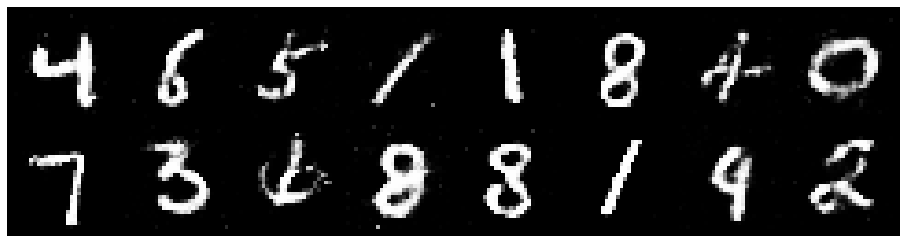

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.3695, Generator Loss: 0.8556
D(x): 0.5548, D(G(z)): 0.4700


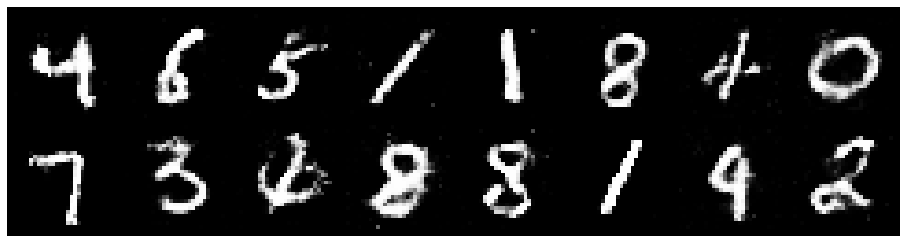

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.3440, Generator Loss: 0.9756
D(x): 0.5513, D(G(z)): 0.4331


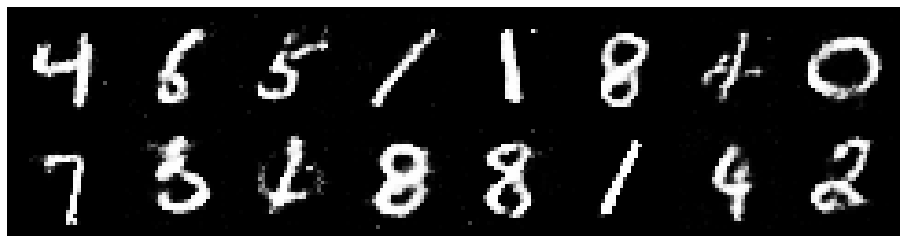

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.2394, Generator Loss: 0.8906
D(x): 0.5732, D(G(z)): 0.4490


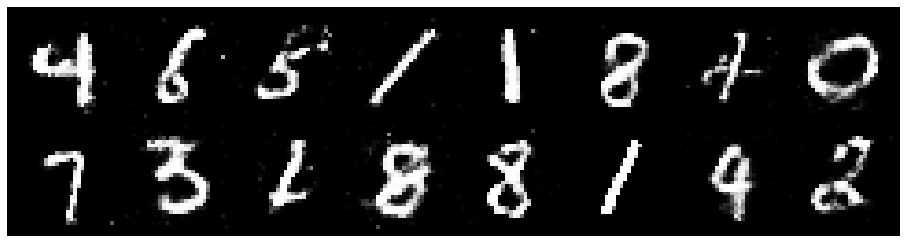

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.2873, Generator Loss: 0.8625
D(x): 0.5775, D(G(z)): 0.4792


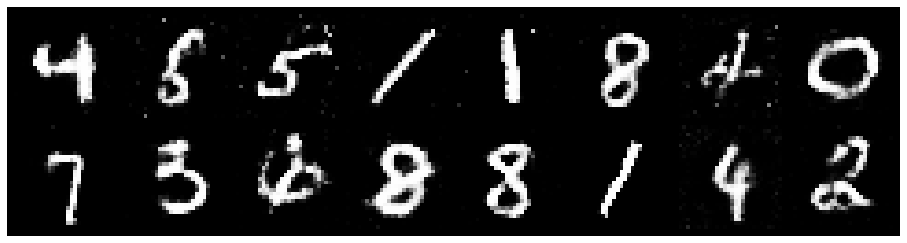

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.2263, Generator Loss: 0.8819
D(x): 0.5543, D(G(z)): 0.4210


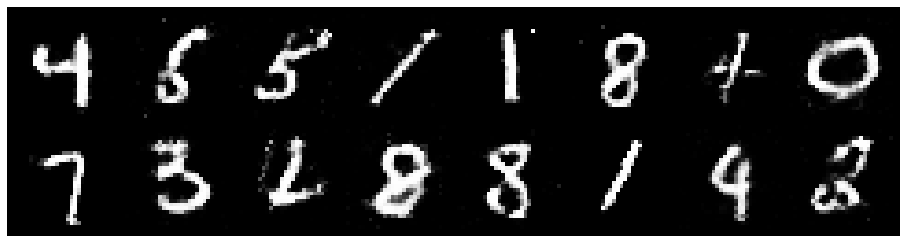

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.3845, Generator Loss: 0.7498
D(x): 0.5689, D(G(z)): 0.5084


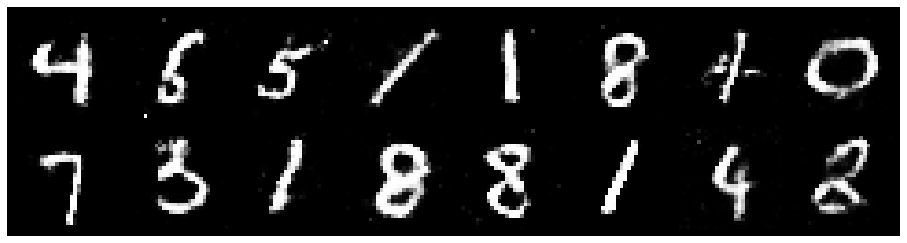

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.3475, Generator Loss: 0.7897
D(x): 0.5180, D(G(z)): 0.4547


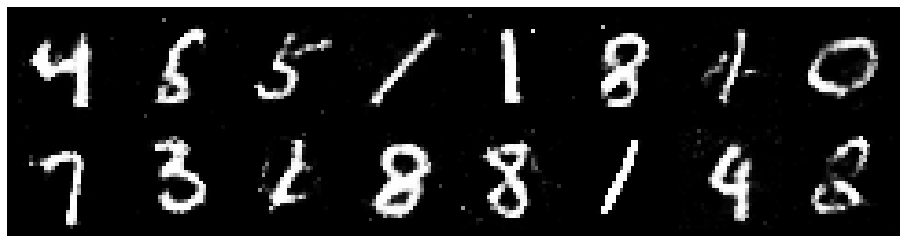

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.2725, Generator Loss: 0.9770
D(x): 0.5591, D(G(z)): 0.4487


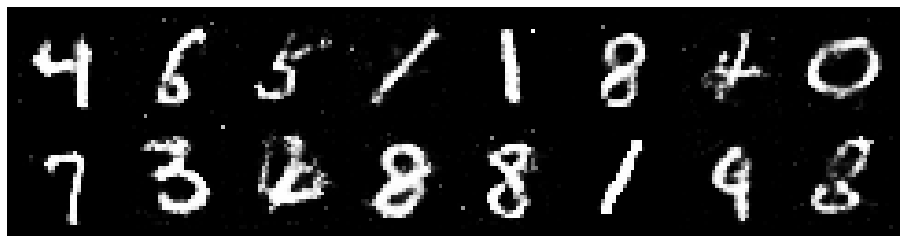

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.2088, Generator Loss: 0.9078
D(x): 0.5667, D(G(z)): 0.4303


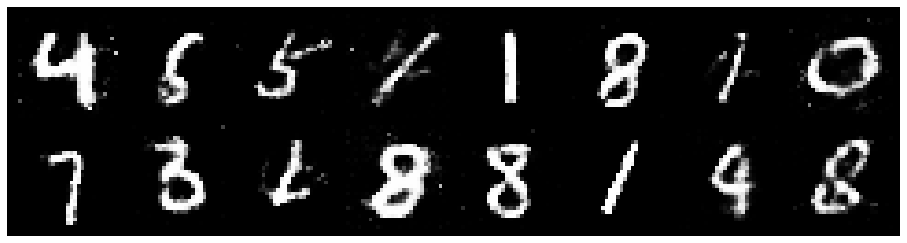

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.2522, Generator Loss: 0.8705
D(x): 0.5554, D(G(z)): 0.4486


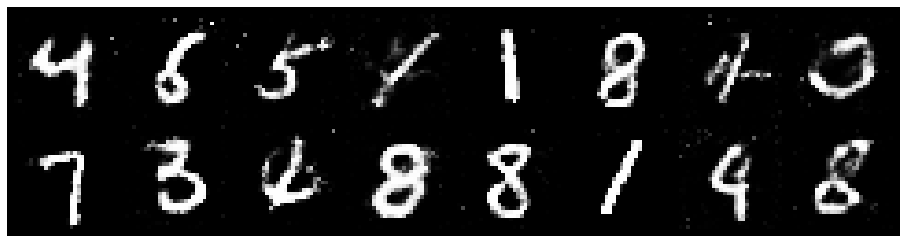

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.2505, Generator Loss: 0.8651
D(x): 0.5532, D(G(z)): 0.4494


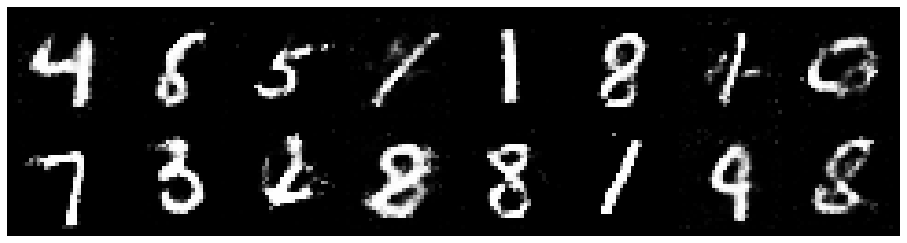

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.2866, Generator Loss: 0.8739
D(x): 0.5715, D(G(z)): 0.4632


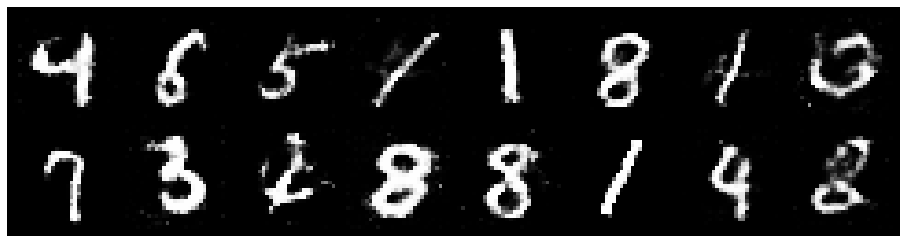

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.2914, Generator Loss: 0.7916
D(x): 0.5668, D(G(z)): 0.4799


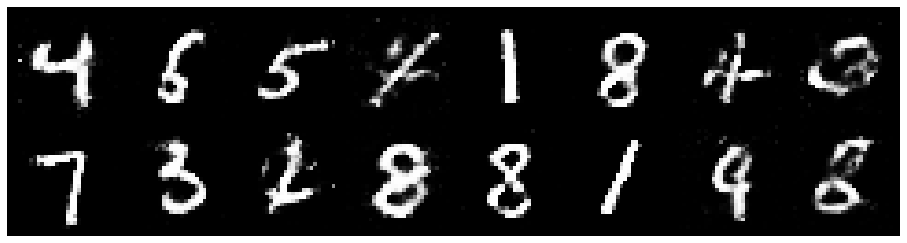

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.2568, Generator Loss: 0.8210
D(x): 0.5728, D(G(z)): 0.4683


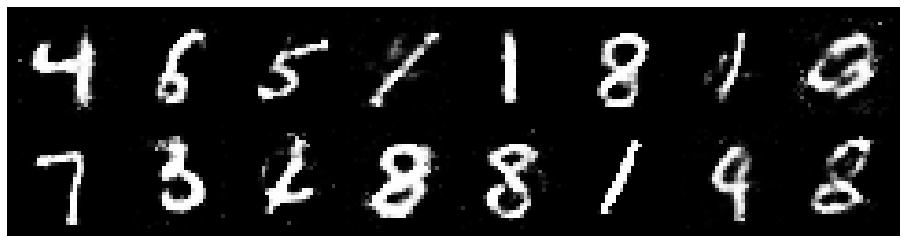

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.3784, Generator Loss: 0.8561
D(x): 0.5251, D(G(z)): 0.4613


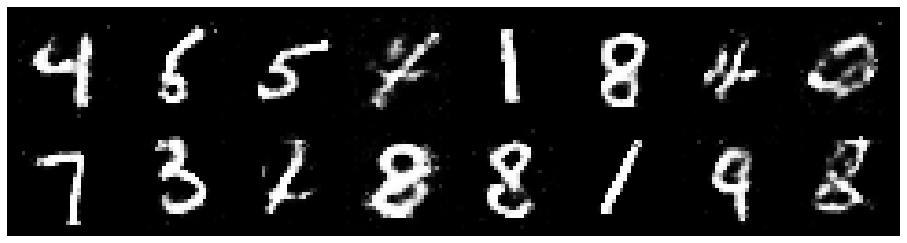

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.3729, Generator Loss: 0.7909
D(x): 0.5625, D(G(z)): 0.5049


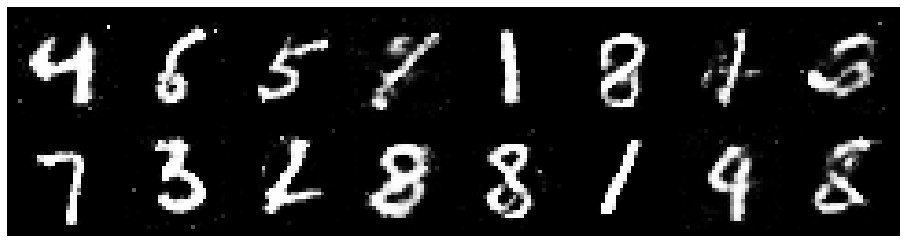

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.3023, Generator Loss: 0.7836
D(x): 0.5611, D(G(z)): 0.4728


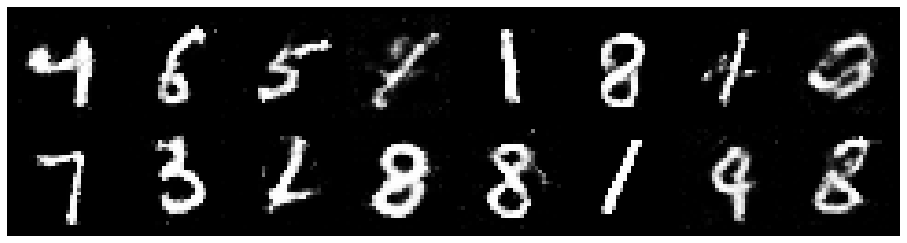

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.3280, Generator Loss: 0.8371
D(x): 0.5364, D(G(z)): 0.4728


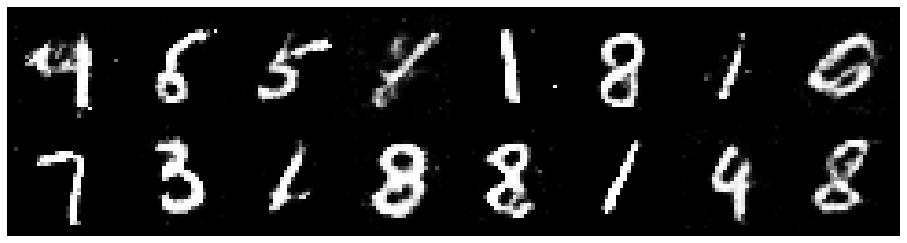

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.2816, Generator Loss: 0.9088
D(x): 0.5444, D(G(z)): 0.4350


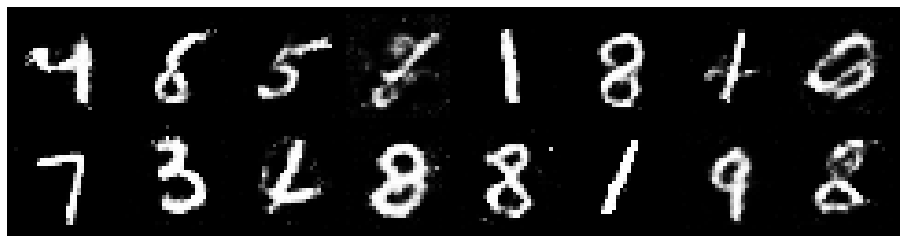

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.3076, Generator Loss: 0.9229
D(x): 0.5762, D(G(z)): 0.4772


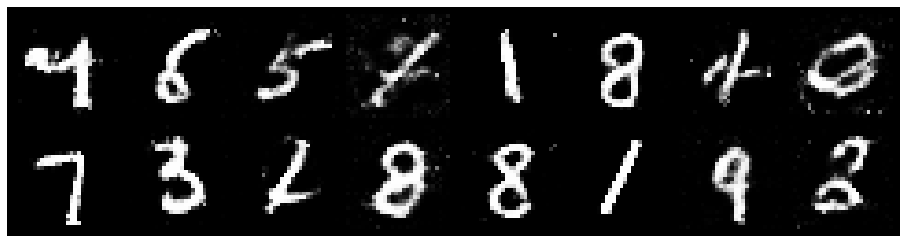

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.1535, Generator Loss: 0.9798
D(x): 0.5954, D(G(z)): 0.4151


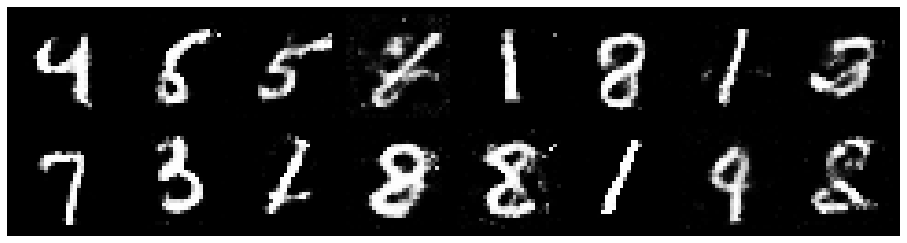

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.2380, Generator Loss: 1.0678
D(x): 0.5637, D(G(z)): 0.4291


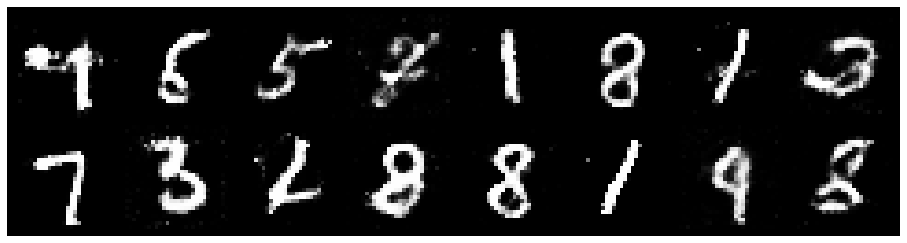

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.2545, Generator Loss: 0.7711
D(x): 0.5431, D(G(z)): 0.4494


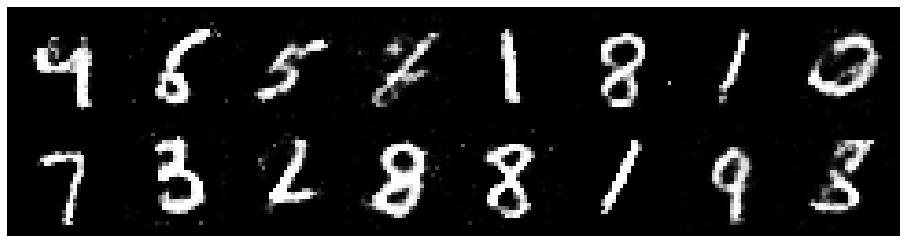

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.1952, Generator Loss: 0.8799
D(x): 0.5897, D(G(z)): 0.4323


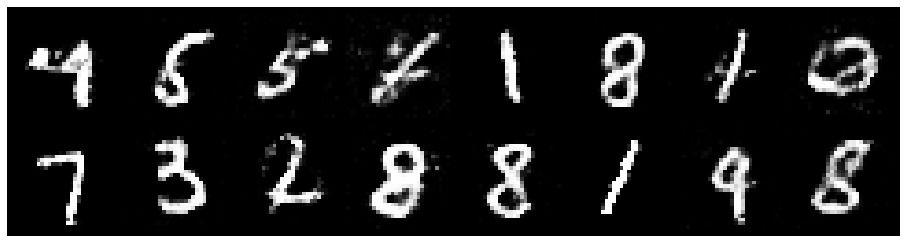

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.3530, Generator Loss: 0.8870
D(x): 0.5259, D(G(z)): 0.4562


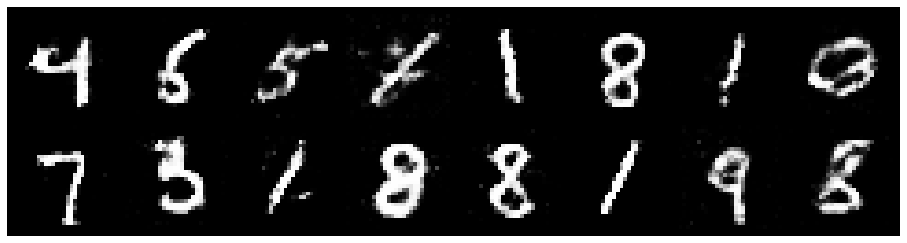

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.3953, Generator Loss: 0.8603
D(x): 0.5112, D(G(z)): 0.4539


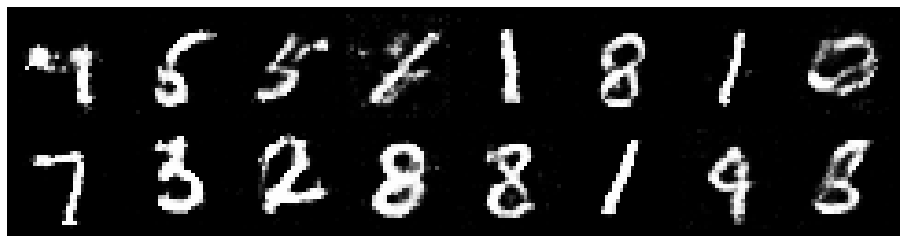

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.2965, Generator Loss: 0.8074
D(x): 0.5463, D(G(z)): 0.4594


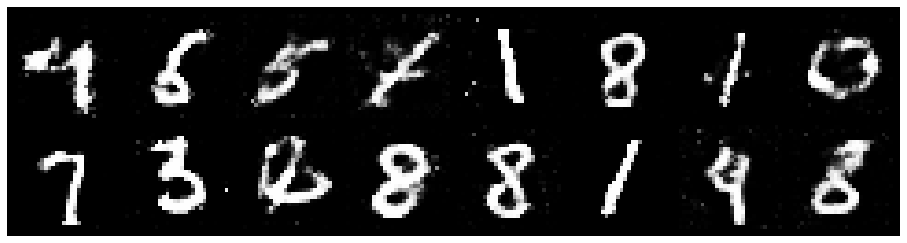

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.3488, Generator Loss: 0.8545
D(x): 0.5529, D(G(z)): 0.4812


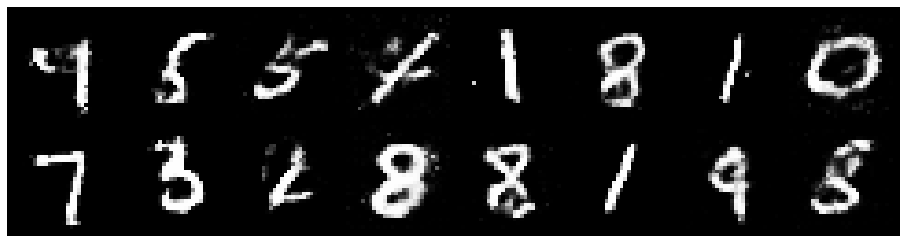

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.3020, Generator Loss: 0.7511
D(x): 0.5681, D(G(z)): 0.4732


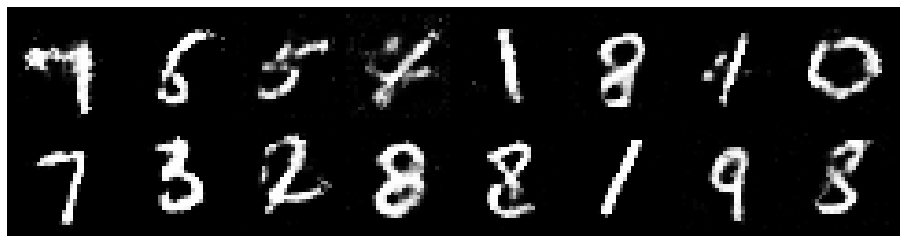

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.4589, Generator Loss: 0.8694
D(x): 0.5542, D(G(z)): 0.4959


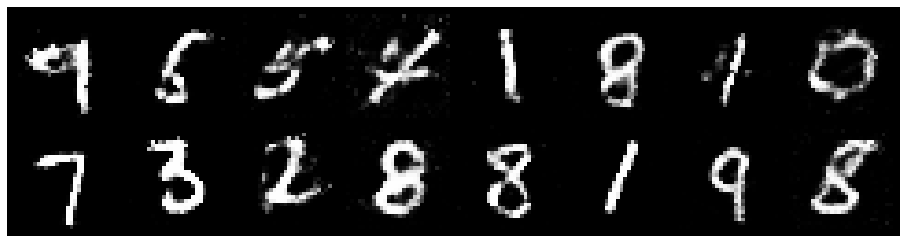

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.2919, Generator Loss: 0.8434
D(x): 0.5446, D(G(z)): 0.4483


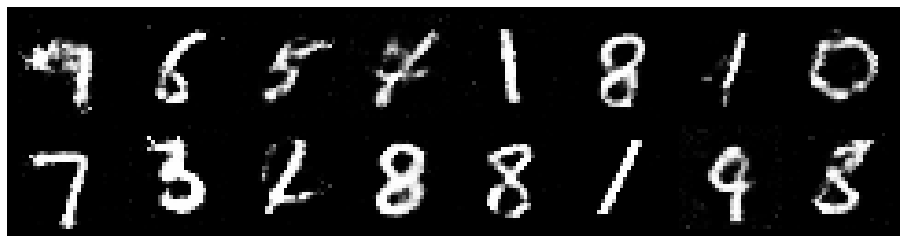

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.2462, Generator Loss: 0.8614
D(x): 0.5837, D(G(z)): 0.4531


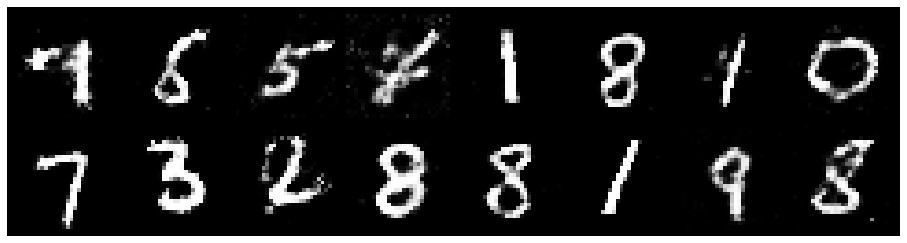

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.2178, Generator Loss: 0.8544
D(x): 0.5679, D(G(z)): 0.4339


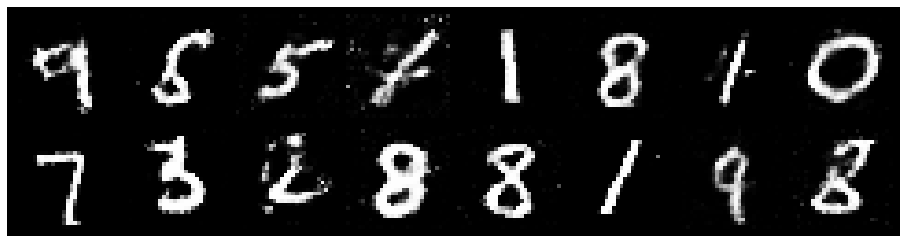

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.2231, Generator Loss: 0.8733
D(x): 0.5844, D(G(z)): 0.4394


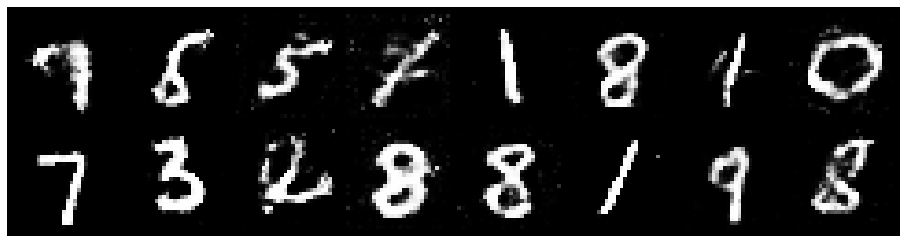

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.2447, Generator Loss: 0.8532
D(x): 0.5818, D(G(z)): 0.4603


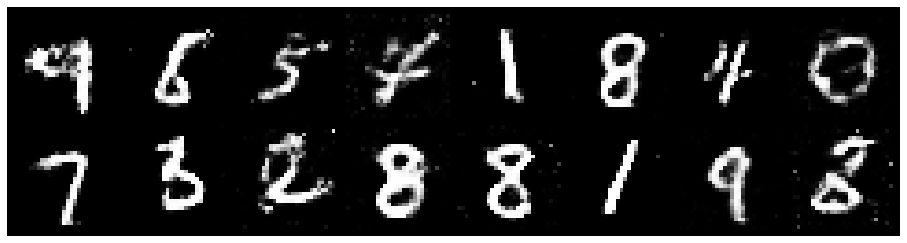

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.2605, Generator Loss: 0.9157
D(x): 0.5677, D(G(z)): 0.4312


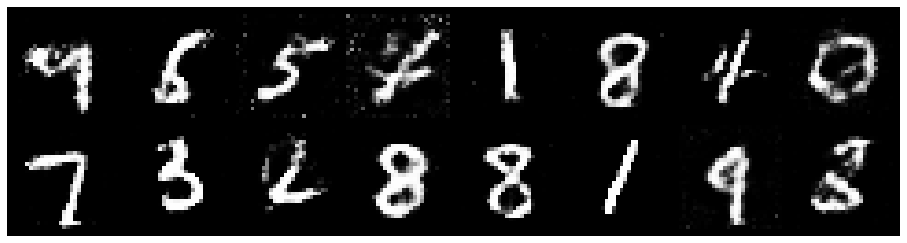

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.2669, Generator Loss: 0.8804
D(x): 0.5652, D(G(z)): 0.4487


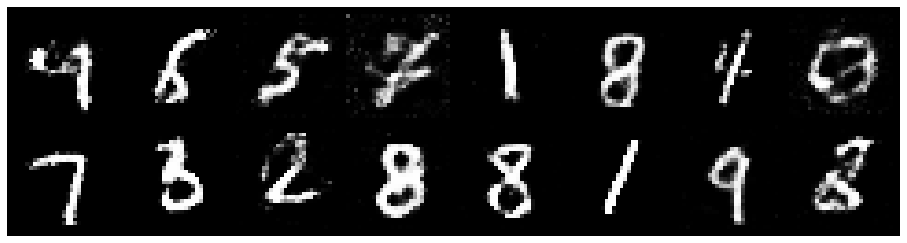

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.1976, Generator Loss: 0.9746
D(x): 0.5687, D(G(z)): 0.4233


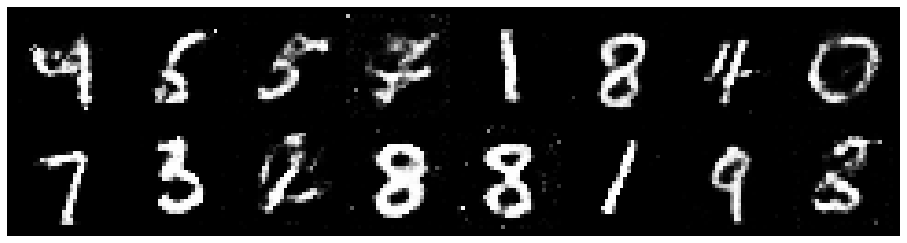

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.2025, Generator Loss: 0.9278
D(x): 0.5353, D(G(z)): 0.3921


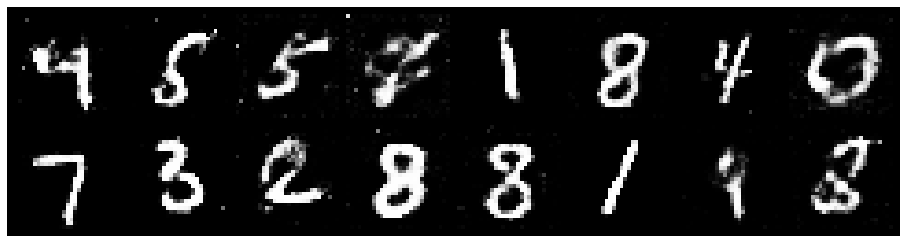

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.2441, Generator Loss: 0.7808
D(x): 0.5801, D(G(z)): 0.4708


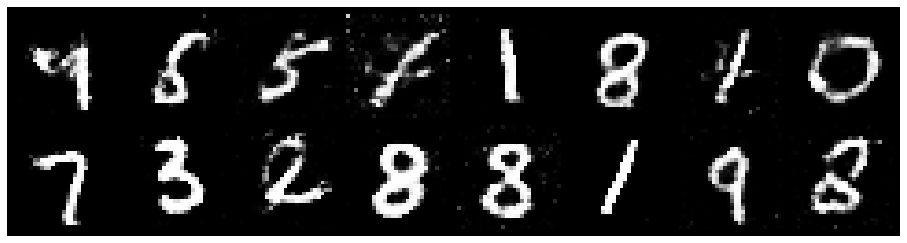

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.2005, Generator Loss: 0.8645
D(x): 0.5644, D(G(z)): 0.4239


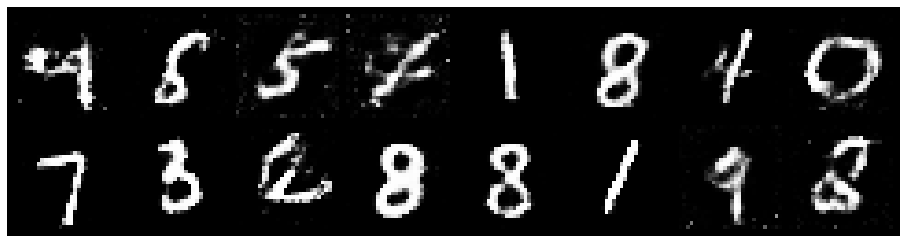

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.3477, Generator Loss: 0.8205
D(x): 0.5617, D(G(z)): 0.4846


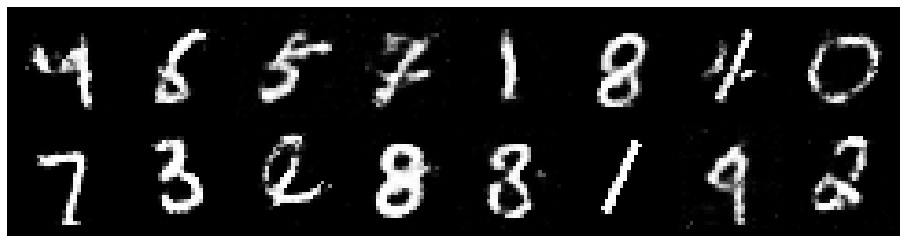

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.3297, Generator Loss: 0.8486
D(x): 0.5222, D(G(z)): 0.4476


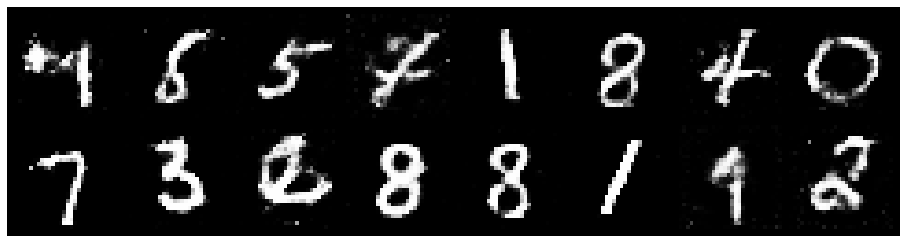

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.4009, Generator Loss: 0.9427
D(x): 0.4824, D(G(z)): 0.4469


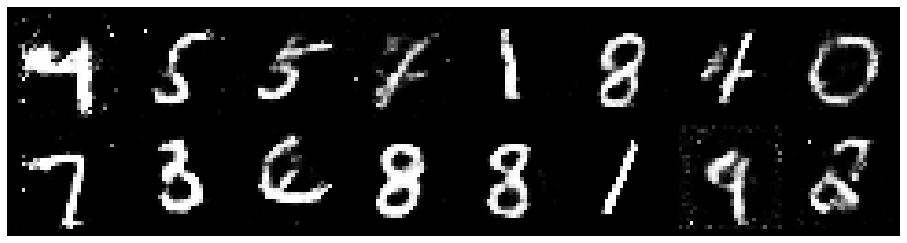

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.3493, Generator Loss: 0.8577
D(x): 0.5379, D(G(z)): 0.4688


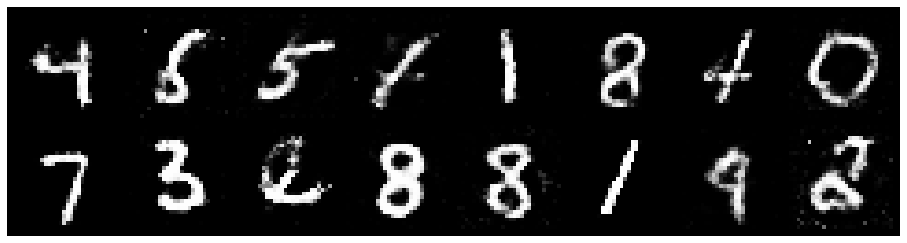

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.2002, Generator Loss: 0.9571
D(x): 0.5434, D(G(z)): 0.3971


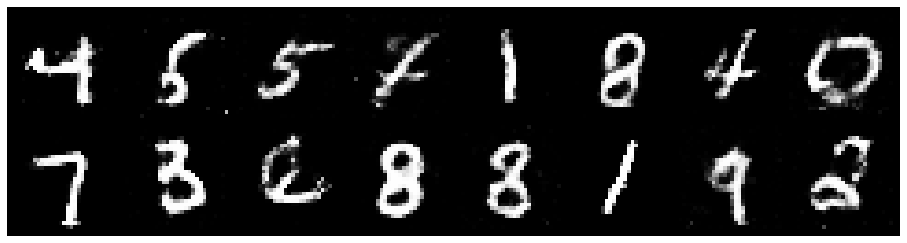

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.2766, Generator Loss: 0.8684
D(x): 0.5538, D(G(z)): 0.4428


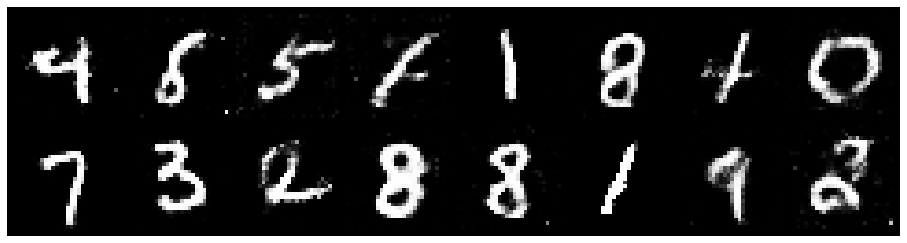

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.2091, Generator Loss: 0.9090
D(x): 0.5669, D(G(z)): 0.4264


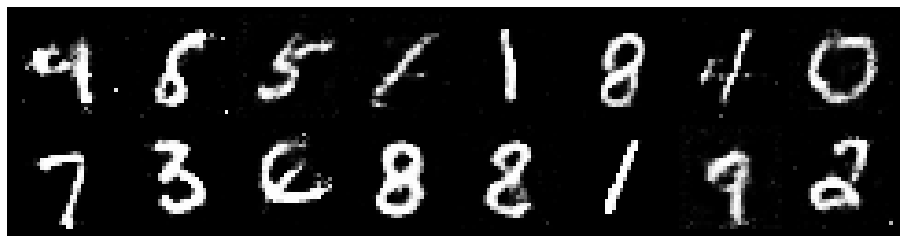

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.3504, Generator Loss: 0.8239
D(x): 0.5315, D(G(z)): 0.4514


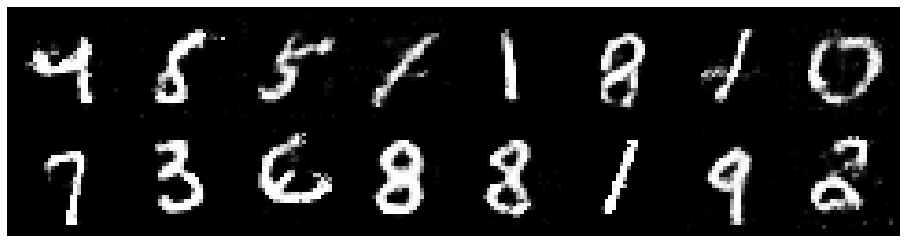

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.3312, Generator Loss: 0.8919
D(x): 0.5437, D(G(z)): 0.4556


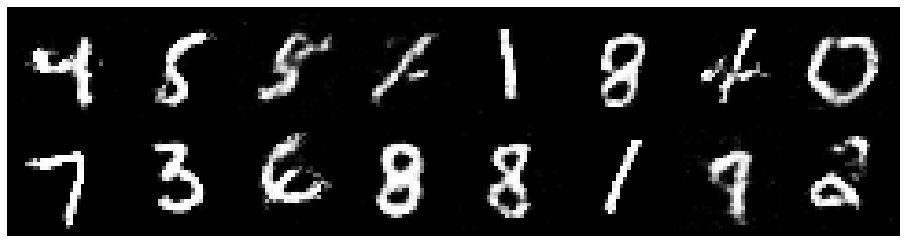

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.3146, Generator Loss: 0.7658
D(x): 0.5501, D(G(z)): 0.4629


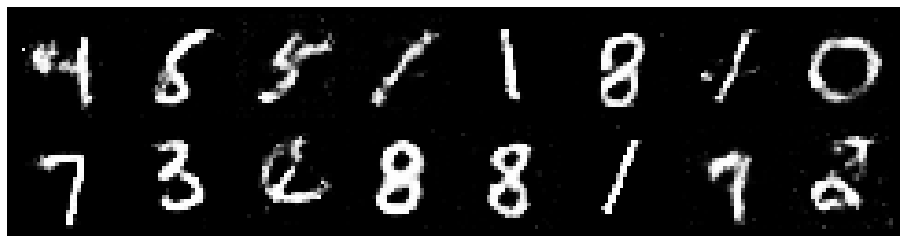

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.4877, Generator Loss: 0.7850
D(x): 0.5012, D(G(z)): 0.4926


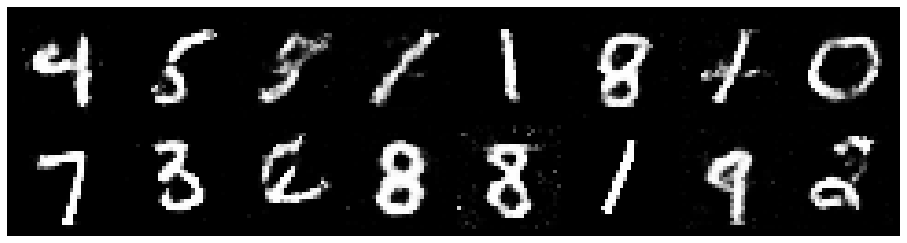

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.2815, Generator Loss: 0.9751
D(x): 0.5443, D(G(z)): 0.4453


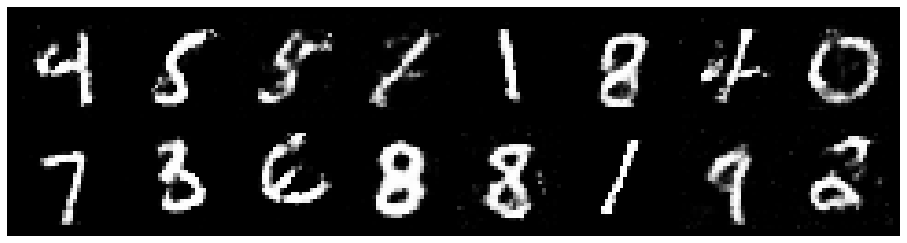

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.3705, Generator Loss: 0.8217
D(x): 0.5490, D(G(z)): 0.4894


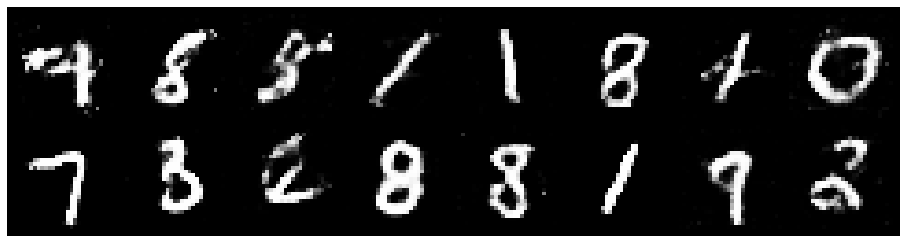

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.2516, Generator Loss: 0.8634
D(x): 0.5499, D(G(z)): 0.4402


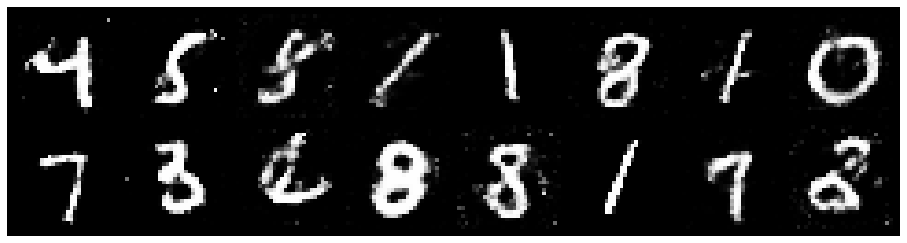

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.2445, Generator Loss: 0.8430
D(x): 0.5731, D(G(z)): 0.4469


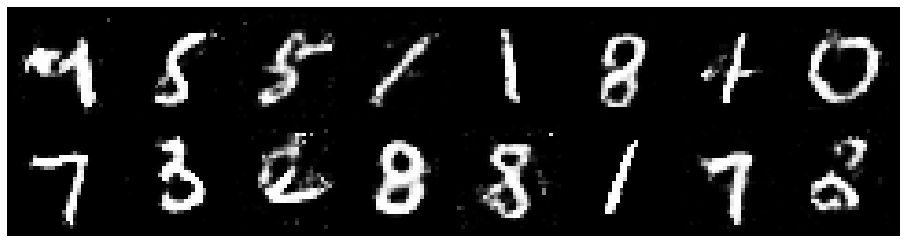

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.2192, Generator Loss: 1.0027
D(x): 0.5220, D(G(z)): 0.3795


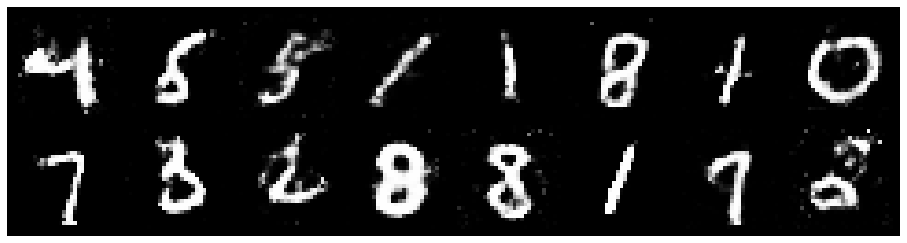

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.2224, Generator Loss: 0.9044
D(x): 0.5530, D(G(z)): 0.4352


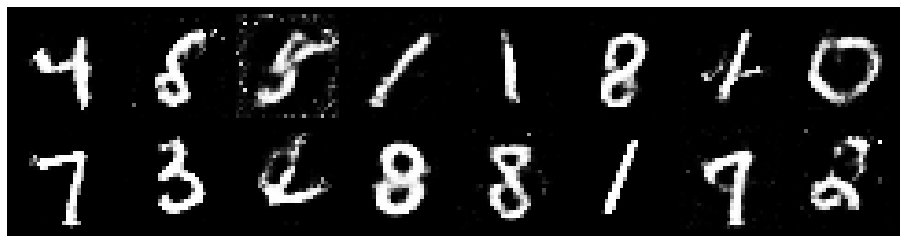

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.3174, Generator Loss: 0.8351
D(x): 0.5607, D(G(z)): 0.4741


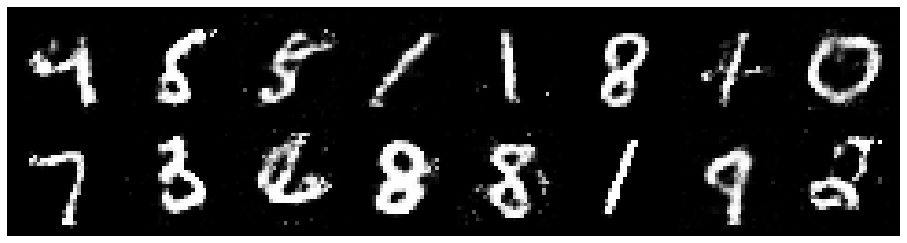

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.2540, Generator Loss: 0.8563
D(x): 0.5230, D(G(z)): 0.4181


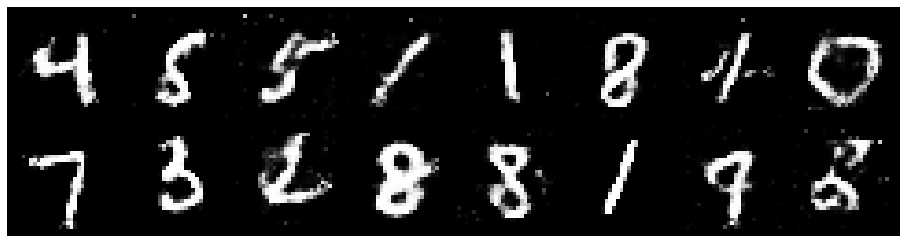

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.2456, Generator Loss: 0.8711
D(x): 0.5735, D(G(z)): 0.4580


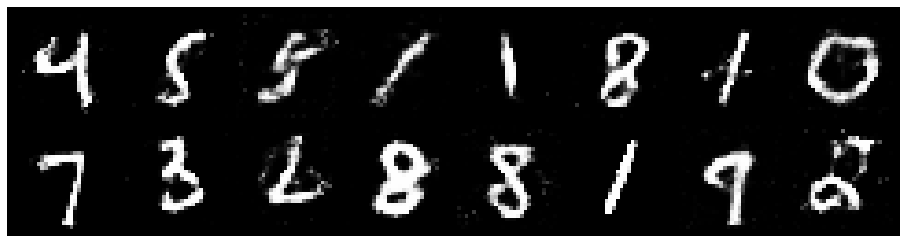

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.2829, Generator Loss: 0.9170
D(x): 0.5704, D(G(z)): 0.4716


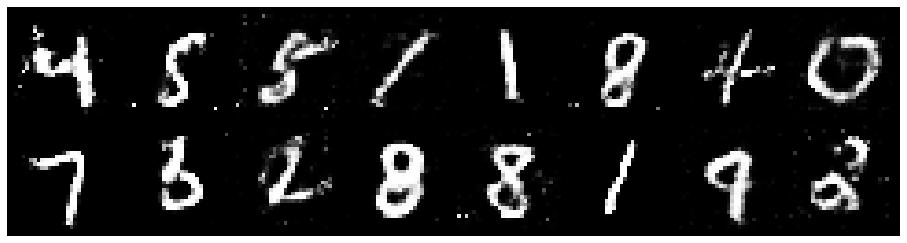

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.3161, Generator Loss: 0.9581
D(x): 0.5237, D(G(z)): 0.4270


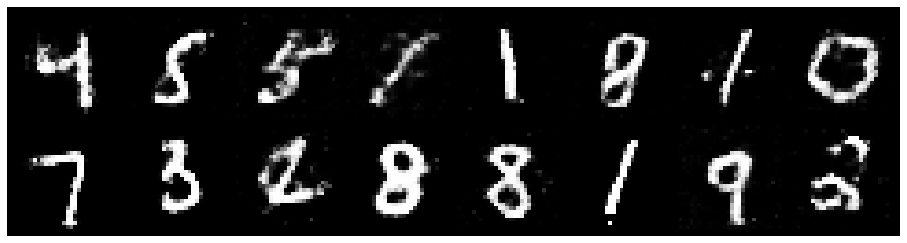

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.2559, Generator Loss: 0.8359
D(x): 0.5741, D(G(z)): 0.4569


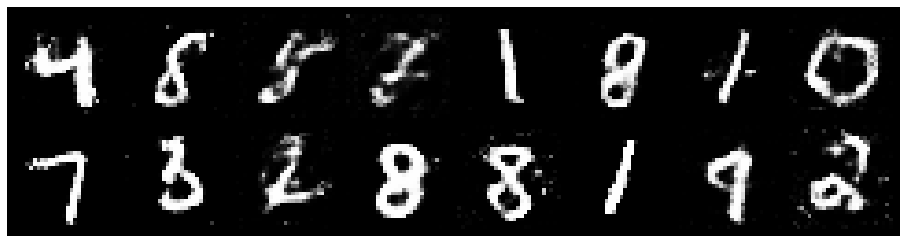

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.2571, Generator Loss: 0.8817
D(x): 0.5668, D(G(z)): 0.4322


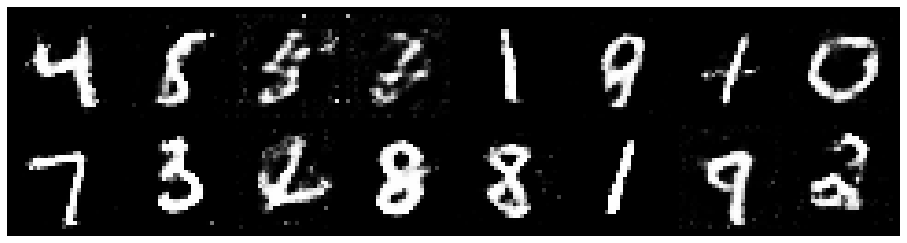

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.3028, Generator Loss: 0.8716
D(x): 0.5616, D(G(z)): 0.4685


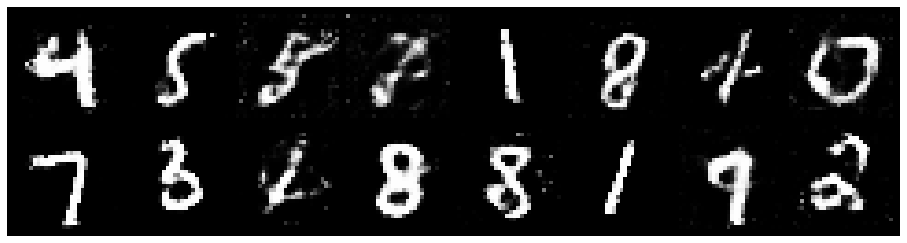

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.3039, Generator Loss: 0.8574
D(x): 0.5071, D(G(z)): 0.4203


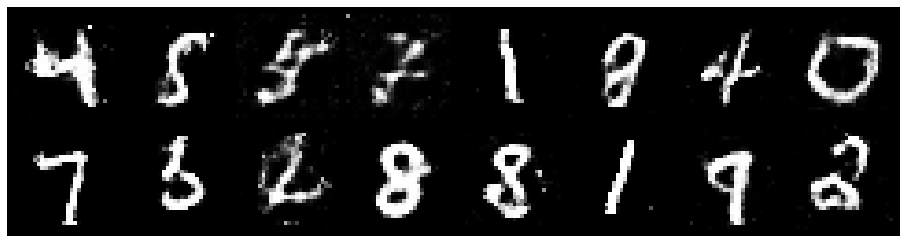

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.3206, Generator Loss: 0.8860
D(x): 0.5347, D(G(z)): 0.4659


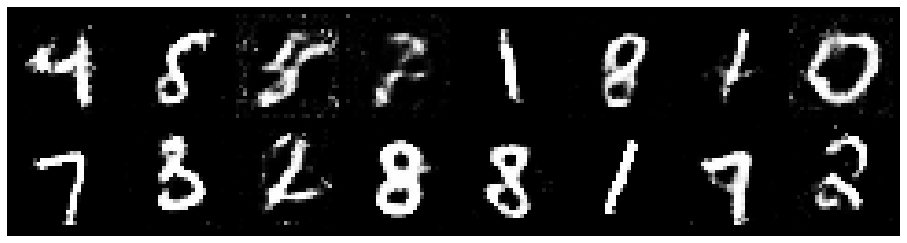

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.3054, Generator Loss: 0.9048
D(x): 0.5238, D(G(z)): 0.4364


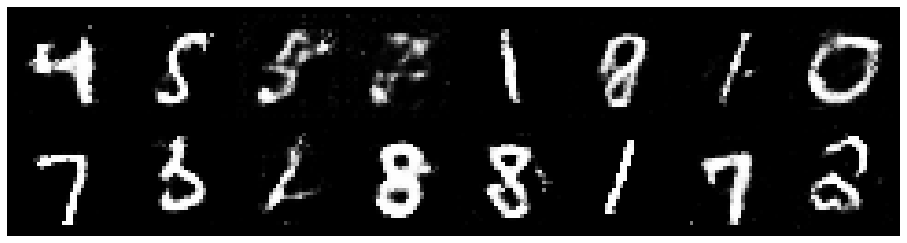

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.2562, Generator Loss: 0.8710
D(x): 0.5726, D(G(z)): 0.4646


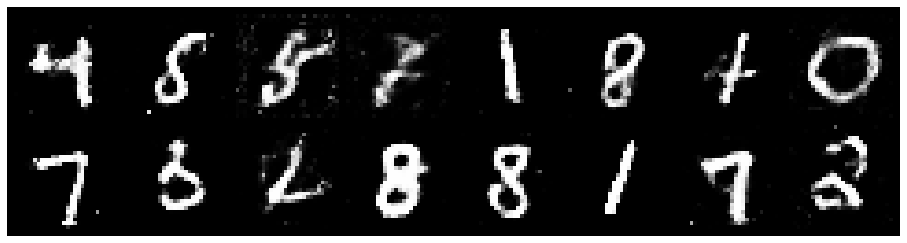

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.2611, Generator Loss: 0.9129
D(x): 0.5561, D(G(z)): 0.4376


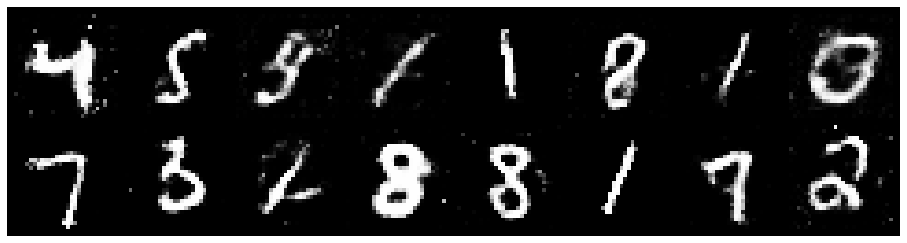

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.2659, Generator Loss: 0.9353
D(x): 0.5489, D(G(z)): 0.4263


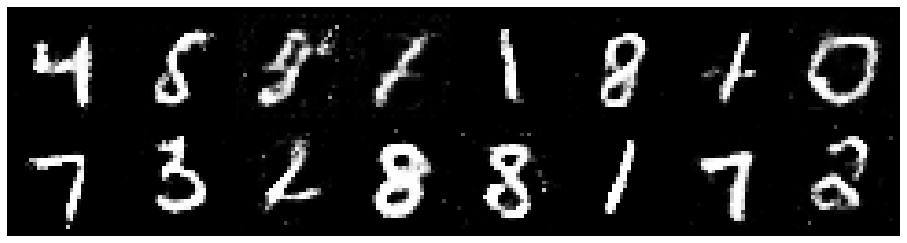

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.3469, Generator Loss: 0.8567
D(x): 0.5327, D(G(z)): 0.4582


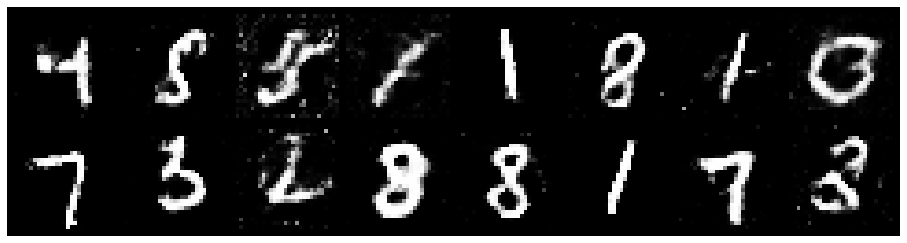

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.2539, Generator Loss: 0.8801
D(x): 0.5576, D(G(z)): 0.4299


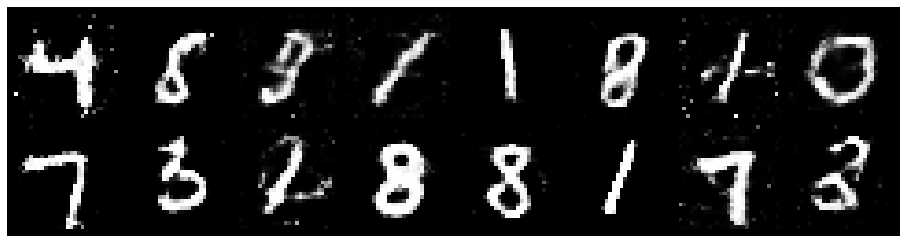

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.2696, Generator Loss: 0.8347
D(x): 0.5531, D(G(z)): 0.4427


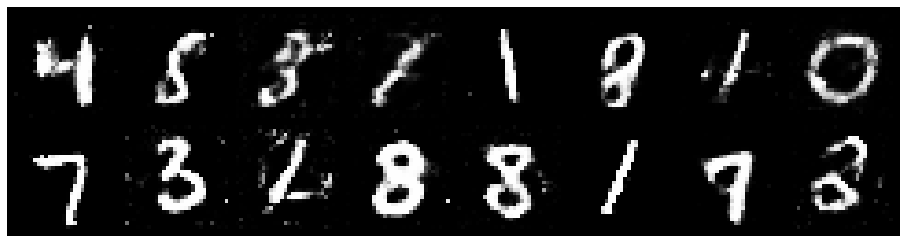

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.2680, Generator Loss: 0.8861
D(x): 0.5319, D(G(z)): 0.4367


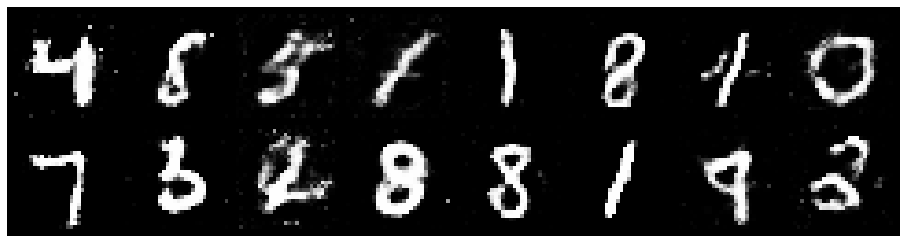

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.2914, Generator Loss: 0.8342
D(x): 0.5484, D(G(z)): 0.4643


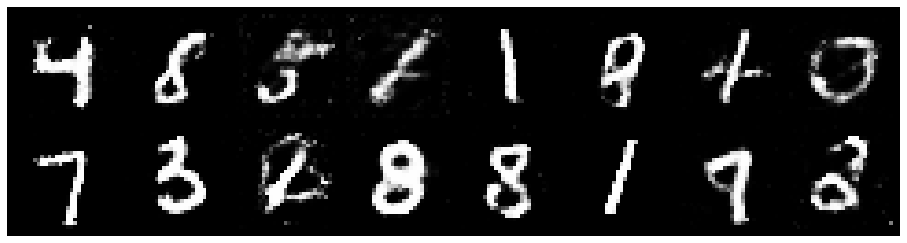

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.2675, Generator Loss: 0.9094
D(x): 0.5144, D(G(z)): 0.4122


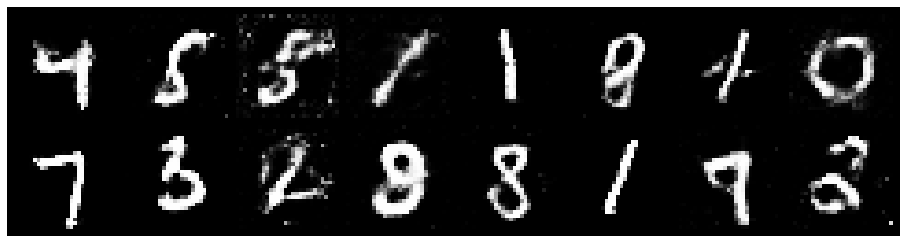

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.2335, Generator Loss: 0.9843
D(x): 0.5890, D(G(z)): 0.4417


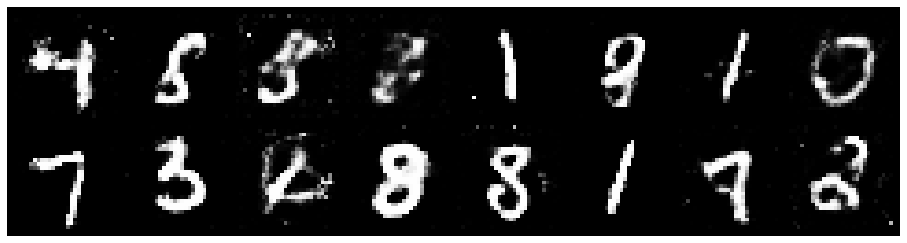

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.2416, Generator Loss: 0.9540
D(x): 0.5329, D(G(z)): 0.4086


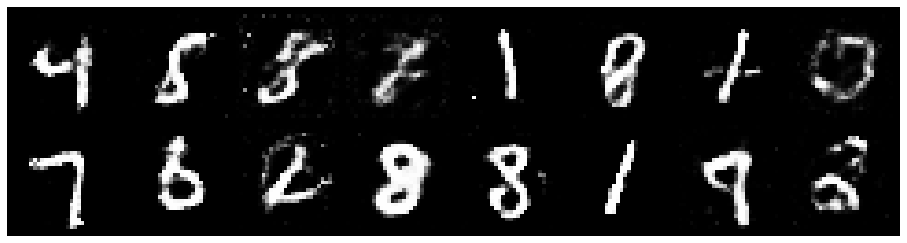

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.2435, Generator Loss: 0.8469
D(x): 0.5766, D(G(z)): 0.4428


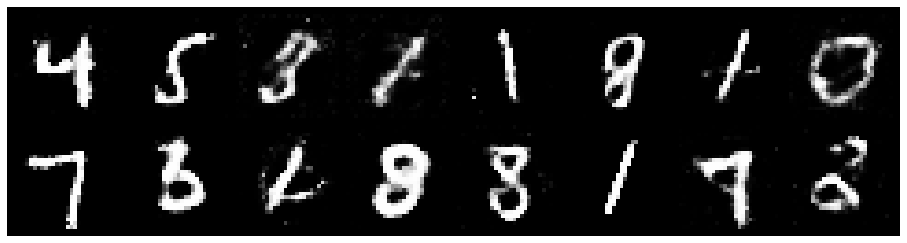

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.3611, Generator Loss: 0.8767
D(x): 0.5609, D(G(z)): 0.4830


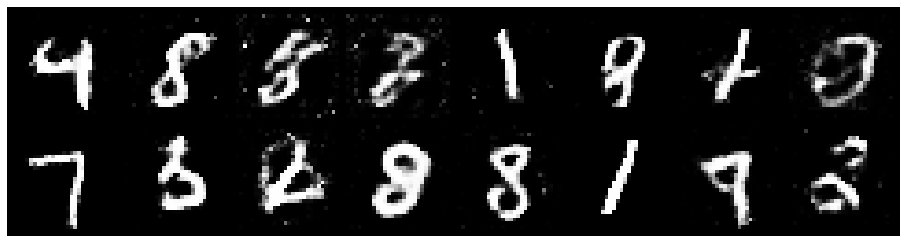

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.2916, Generator Loss: 0.9472
D(x): 0.5358, D(G(z)): 0.4483


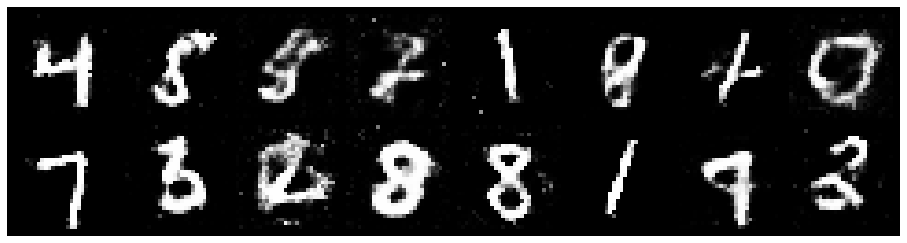

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.2689, Generator Loss: 0.8334
D(x): 0.5537, D(G(z)): 0.4478


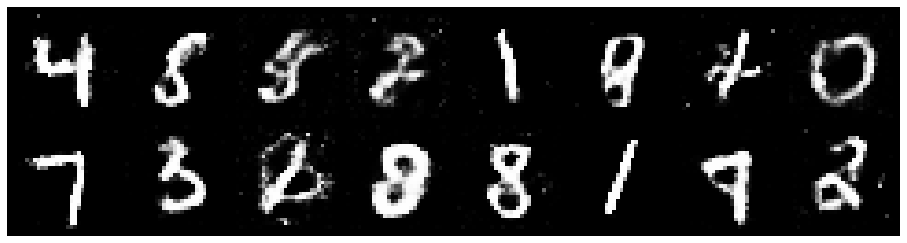

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.2685, Generator Loss: 0.8440
D(x): 0.5649, D(G(z)): 0.4480


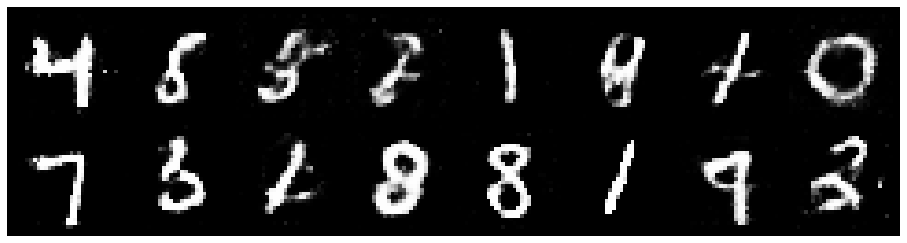

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.3198, Generator Loss: 0.8148
D(x): 0.5466, D(G(z)): 0.4662


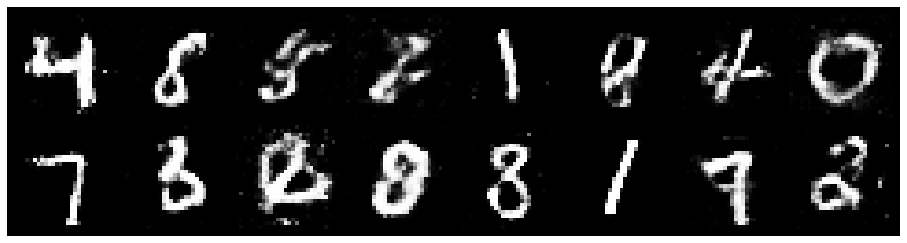

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.3249, Generator Loss: 0.8346
D(x): 0.5604, D(G(z)): 0.4764


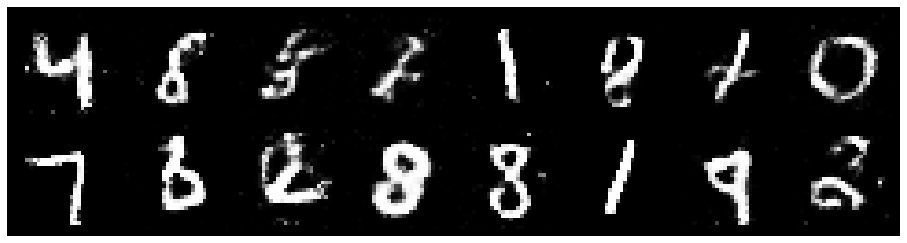

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.2838, Generator Loss: 0.8847
D(x): 0.5189, D(G(z)): 0.4243


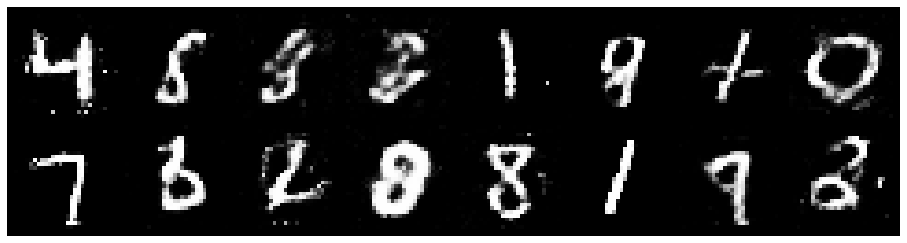

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.2705, Generator Loss: 0.8851
D(x): 0.5399, D(G(z)): 0.4393


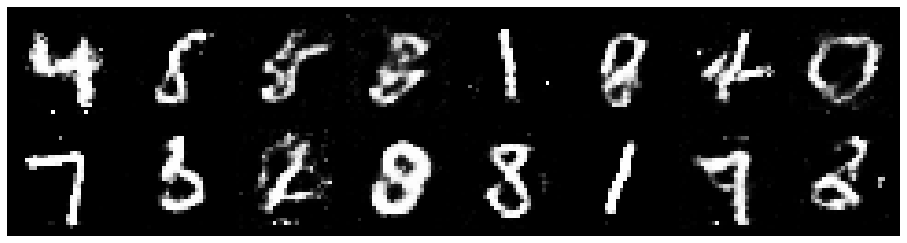

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.2643, Generator Loss: 0.9559
D(x): 0.5406, D(G(z)): 0.4250


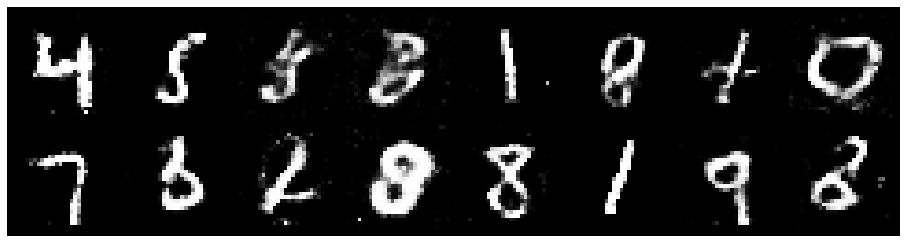

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.2556, Generator Loss: 0.8879
D(x): 0.5370, D(G(z)): 0.4229


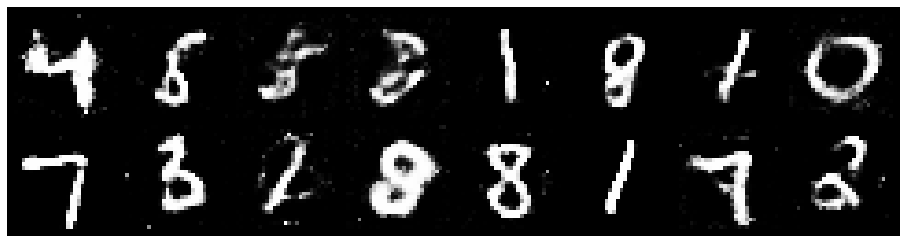

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.2803, Generator Loss: 0.8471
D(x): 0.5488, D(G(z)): 0.4489


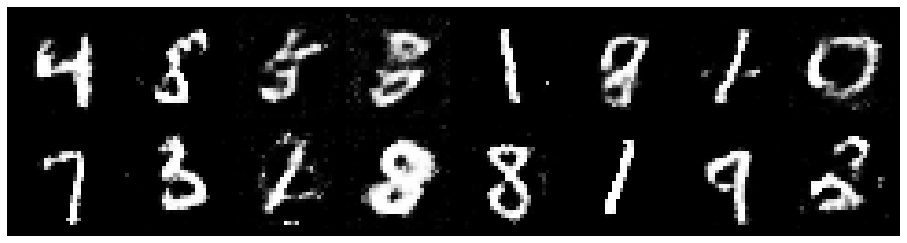

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.2319, Generator Loss: 0.8172
D(x): 0.5675, D(G(z)): 0.4385


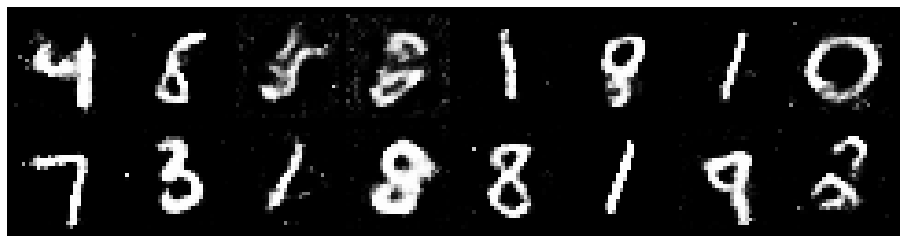

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.2635, Generator Loss: 0.9291
D(x): 0.5645, D(G(z)): 0.4614


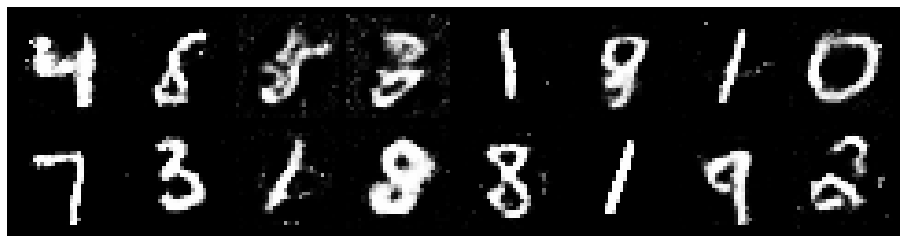

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.4024, Generator Loss: 0.8475
D(x): 0.5323, D(G(z)): 0.4582


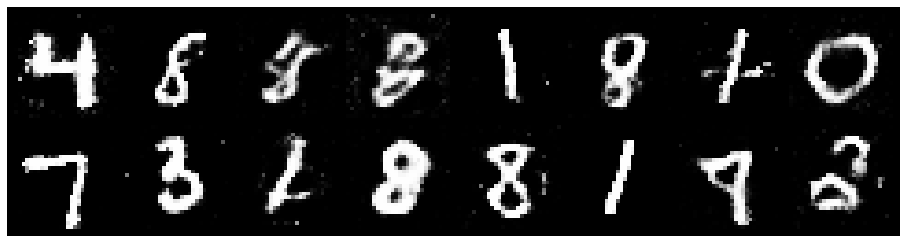

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.3512, Generator Loss: 0.8280
D(x): 0.5606, D(G(z)): 0.4755


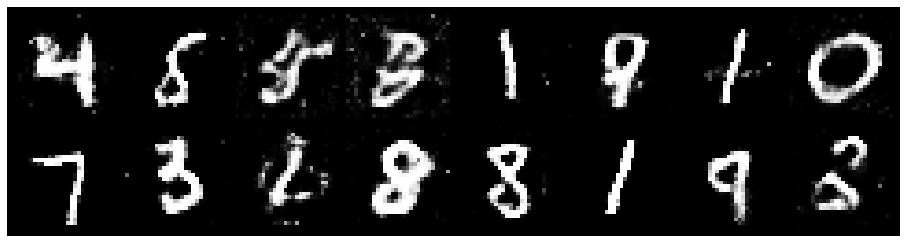

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.1967, Generator Loss: 0.7916
D(x): 0.5853, D(G(z)): 0.4485


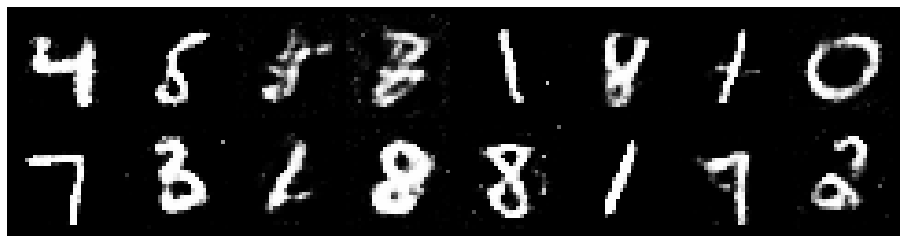

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.2696, Generator Loss: 0.8197
D(x): 0.5615, D(G(z)): 0.4722


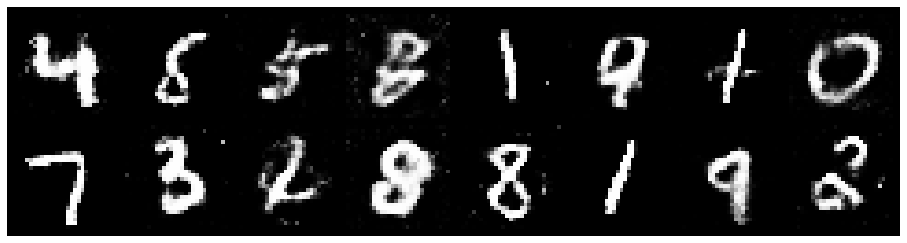

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.2795, Generator Loss: 0.8615
D(x): 0.5429, D(G(z)): 0.4474


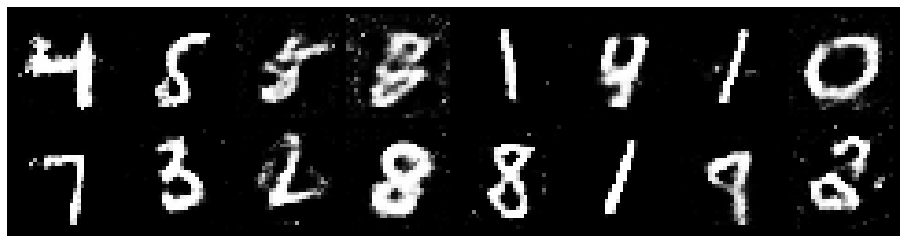

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.2344, Generator Loss: 0.9515
D(x): 0.5617, D(G(z)): 0.4274


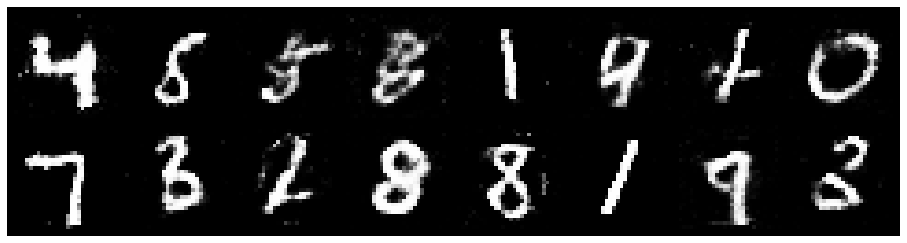

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.3001, Generator Loss: 0.8786
D(x): 0.5679, D(G(z)): 0.4806


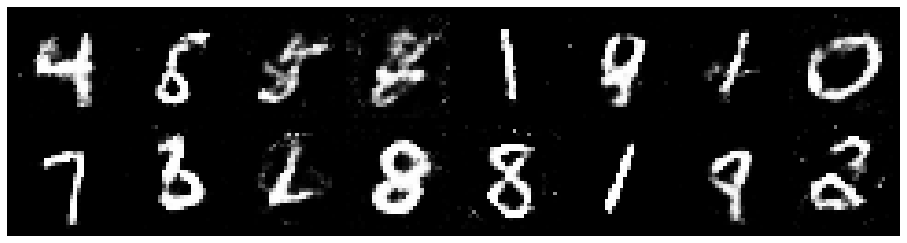

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.2612, Generator Loss: 0.8753
D(x): 0.5440, D(G(z)): 0.4396


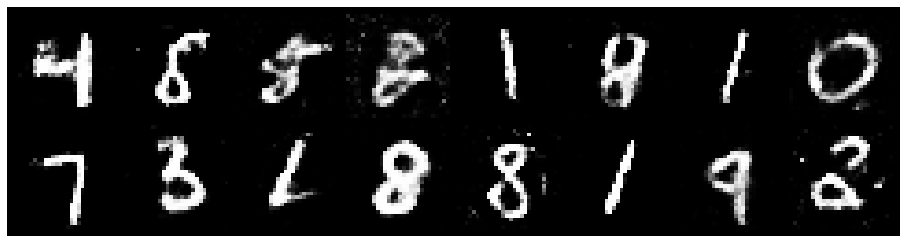

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.1919, Generator Loss: 0.9499
D(x): 0.5623, D(G(z)): 0.4148


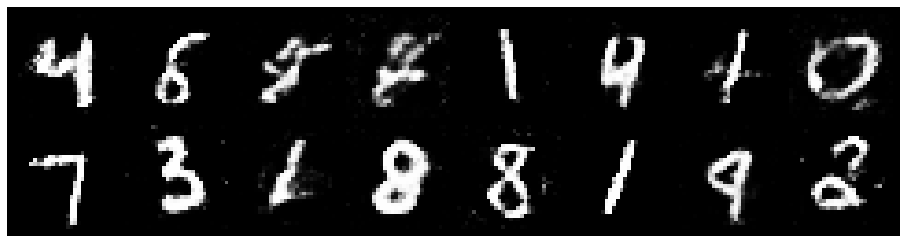

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.3098, Generator Loss: 0.8979
D(x): 0.5453, D(G(z)): 0.4631


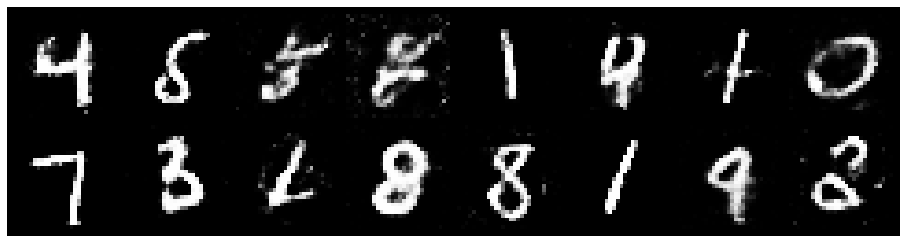

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.2580, Generator Loss: 1.0083
D(x): 0.5488, D(G(z)): 0.4238


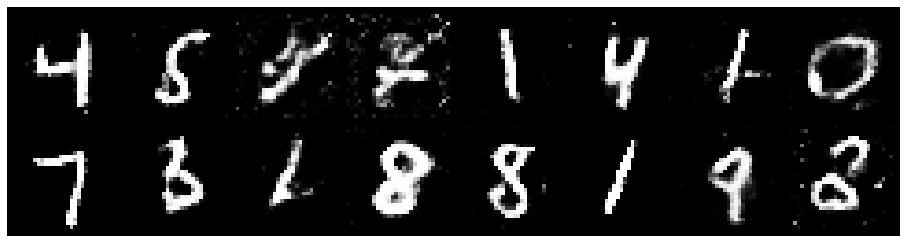

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.2333, Generator Loss: 0.8876
D(x): 0.5864, D(G(z)): 0.4557


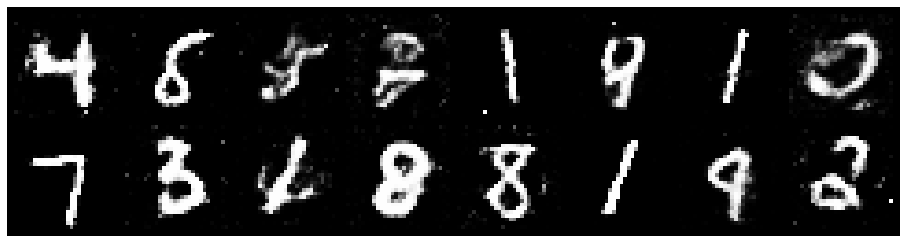

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.3251, Generator Loss: 0.8380
D(x): 0.5294, D(G(z)): 0.4468


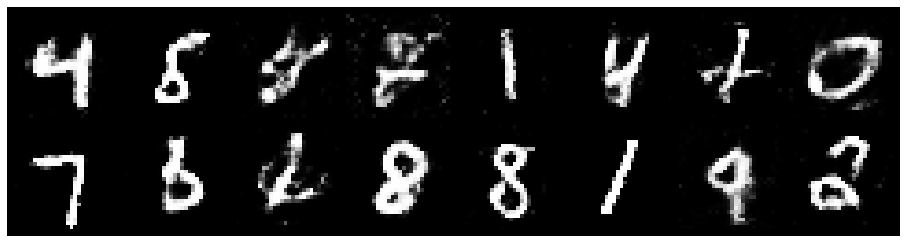

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.2980, Generator Loss: 0.9082
D(x): 0.5539, D(G(z)): 0.4461


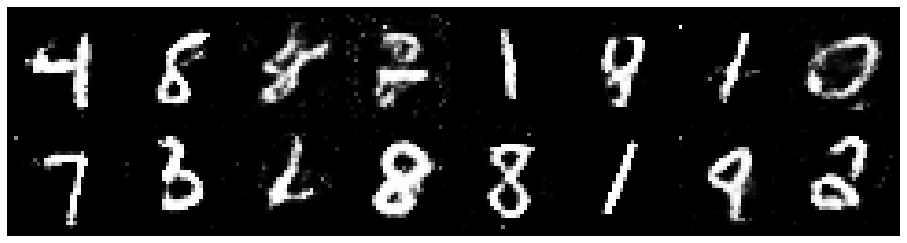

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.2876, Generator Loss: 0.8680
D(x): 0.5394, D(G(z)): 0.4338


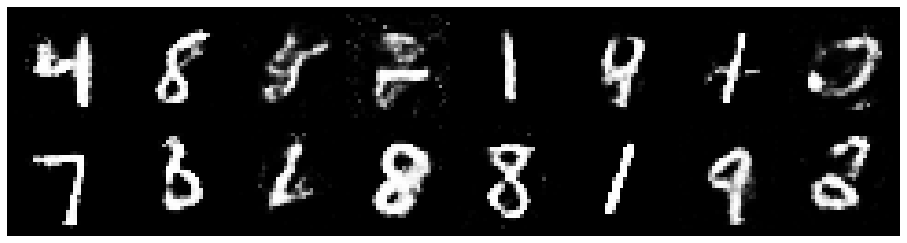

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.2843, Generator Loss: 0.9069
D(x): 0.5733, D(G(z)): 0.4619


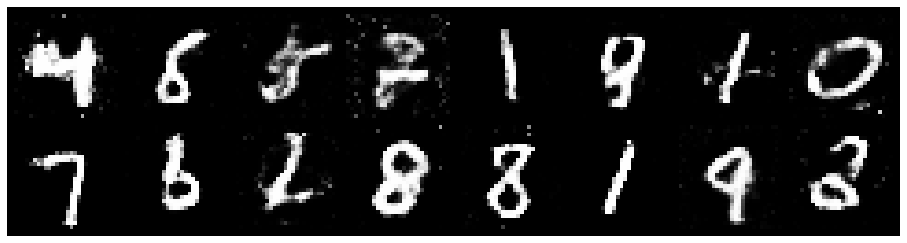

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.4888, Generator Loss: 0.8263
D(x): 0.5212, D(G(z)): 0.5030


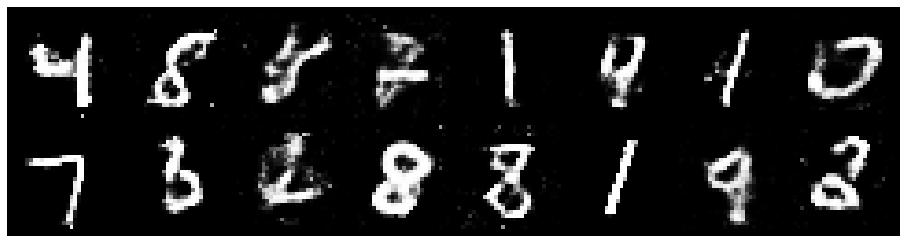

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.2770, Generator Loss: 0.7825
D(x): 0.5606, D(G(z)): 0.4652


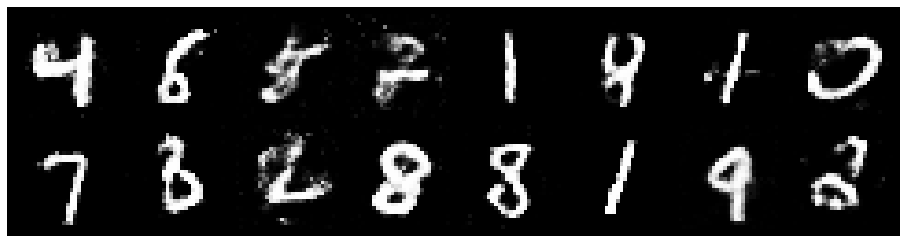

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.3291, Generator Loss: 0.8517
D(x): 0.5187, D(G(z)): 0.4500


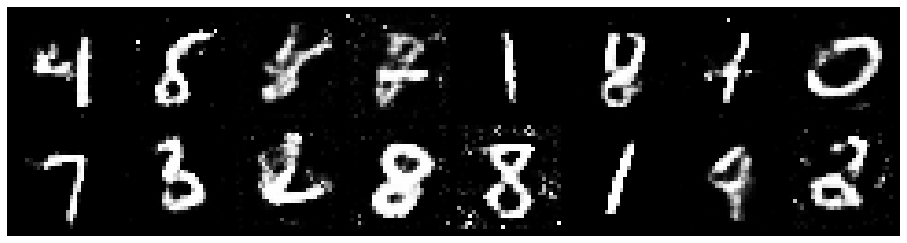

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.3507, Generator Loss: 0.9346
D(x): 0.5223, D(G(z)): 0.4614


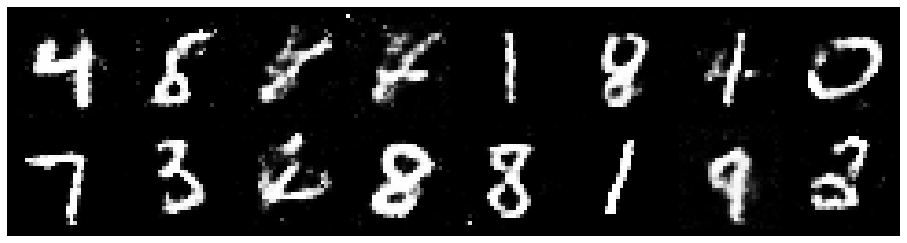

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.1770, Generator Loss: 0.9341
D(x): 0.5726, D(G(z)): 0.4132


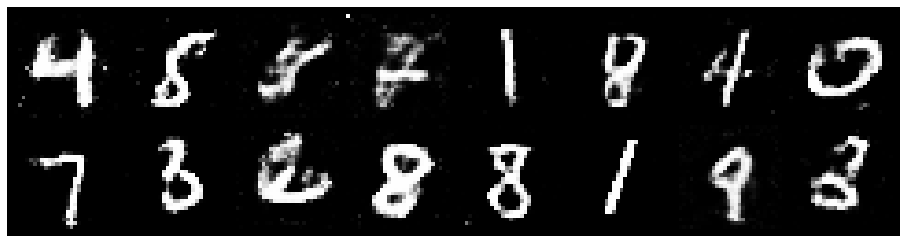

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.2764, Generator Loss: 0.8569
D(x): 0.5416, D(G(z)): 0.4386


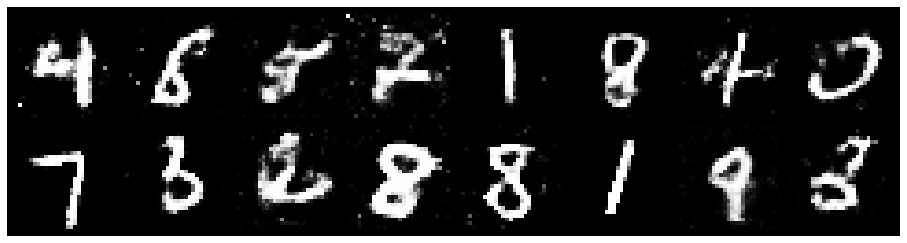

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.3111, Generator Loss: 0.8021
D(x): 0.5686, D(G(z)): 0.4761


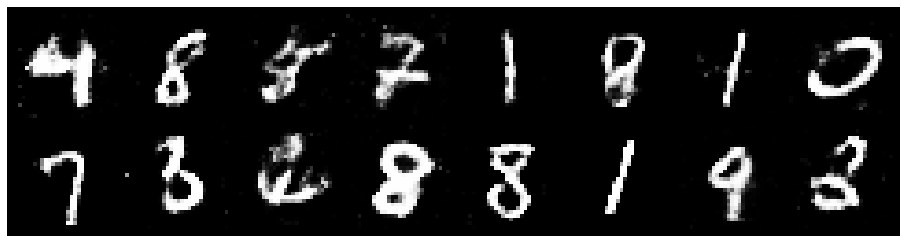

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.2957, Generator Loss: 0.8384
D(x): 0.5369, D(G(z)): 0.4343


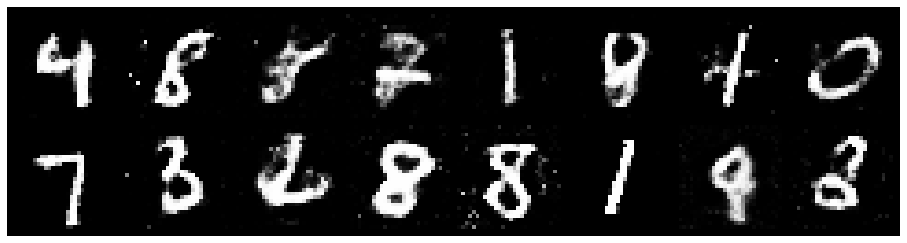

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.2444, Generator Loss: 0.8677
D(x): 0.5411, D(G(z)): 0.4218


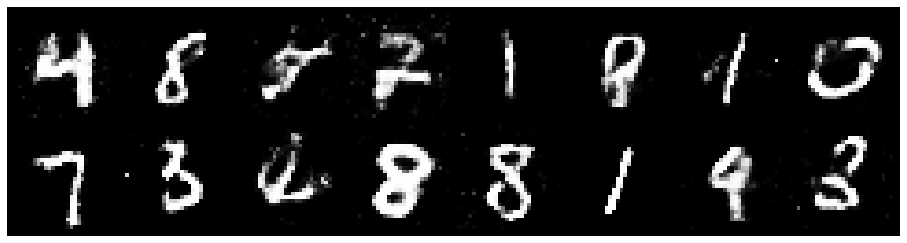

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.2325, Generator Loss: 0.8599
D(x): 0.5707, D(G(z)): 0.4365


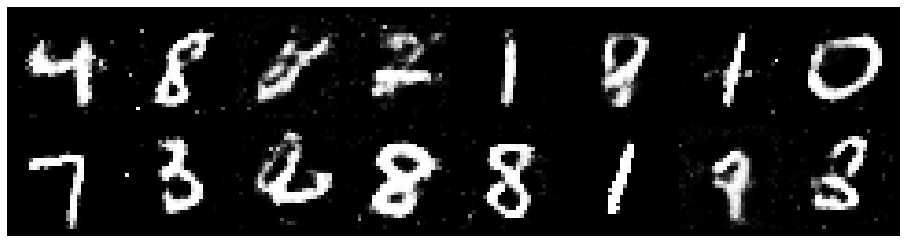

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.2196, Generator Loss: 1.1153
D(x): 0.5180, D(G(z)): 0.3735


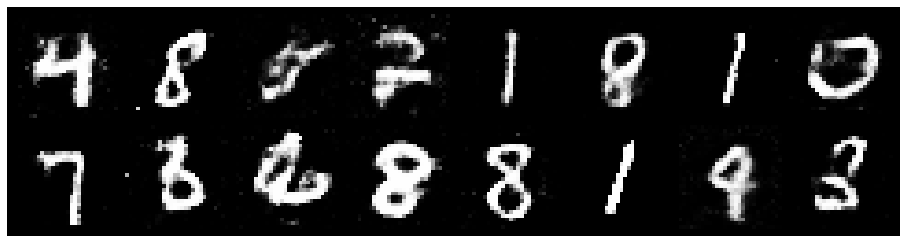

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.3343, Generator Loss: 0.8474
D(x): 0.5319, D(G(z)): 0.4268


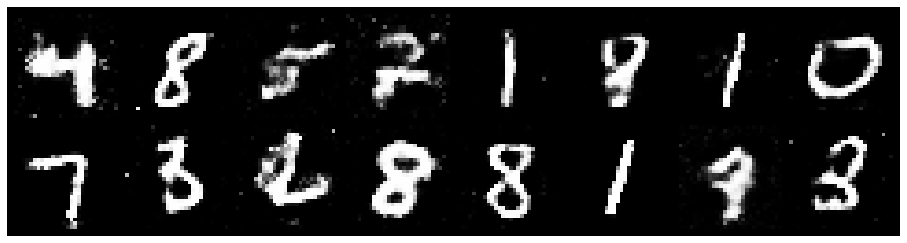

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.2307, Generator Loss: 0.8600
D(x): 0.5660, D(G(z)): 0.4372


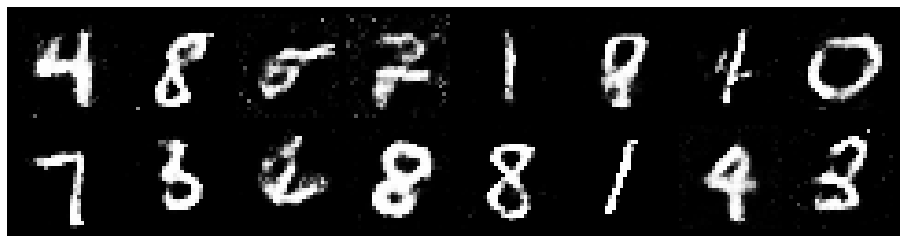

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.2313, Generator Loss: 0.8568
D(x): 0.5639, D(G(z)): 0.4270


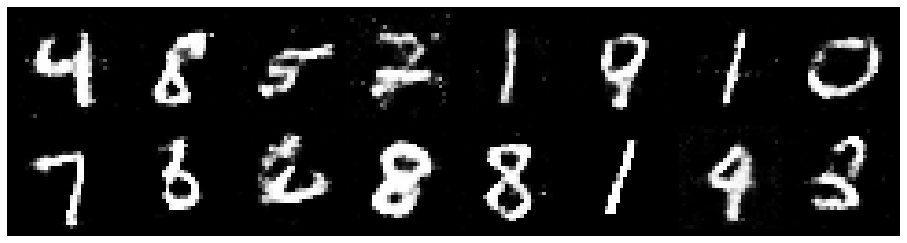

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.3089, Generator Loss: 0.9039
D(x): 0.5673, D(G(z)): 0.4796


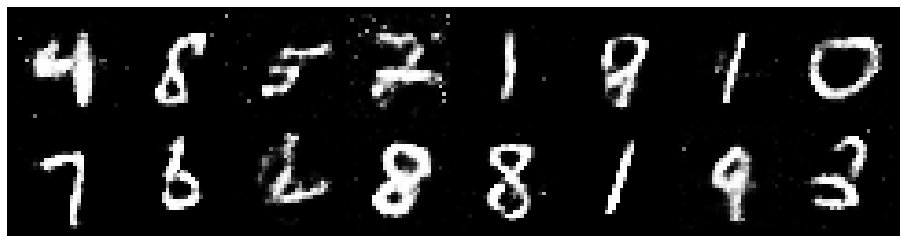

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.2350, Generator Loss: 0.9089
D(x): 0.5827, D(G(z)): 0.4473


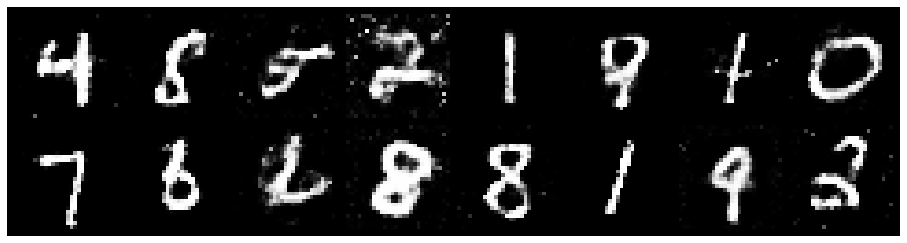

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.2196, Generator Loss: 0.8636
D(x): 0.5639, D(G(z)): 0.4267


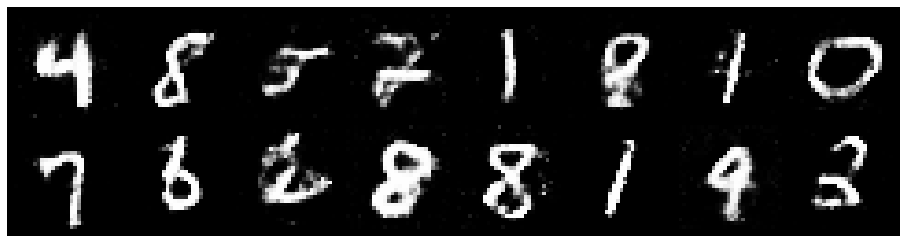

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.3351, Generator Loss: 0.8478
D(x): 0.5419, D(G(z)): 0.4593


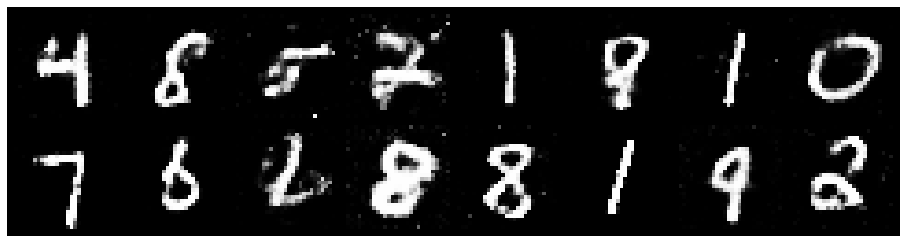

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.2639, Generator Loss: 0.9438
D(x): 0.5618, D(G(z)): 0.4333


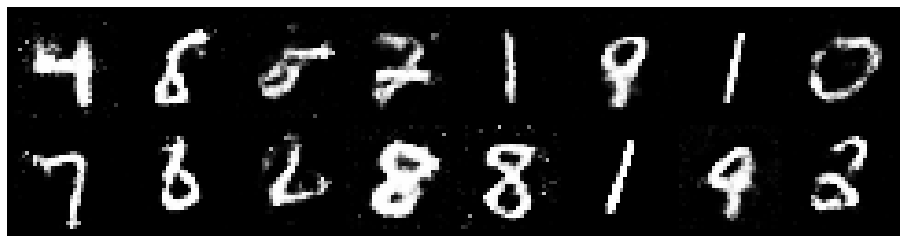

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.2074, Generator Loss: 0.9590
D(x): 0.5707, D(G(z)): 0.4198


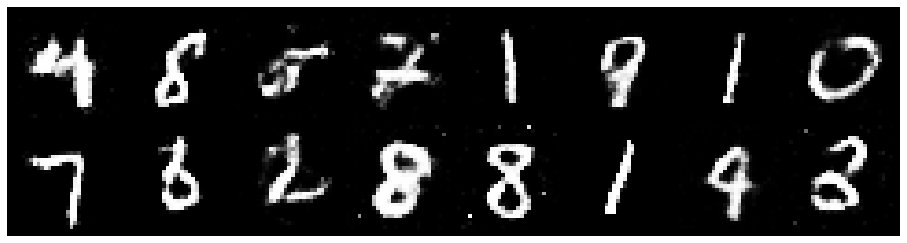

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.2886, Generator Loss: 0.8446
D(x): 0.5989, D(G(z)): 0.4944


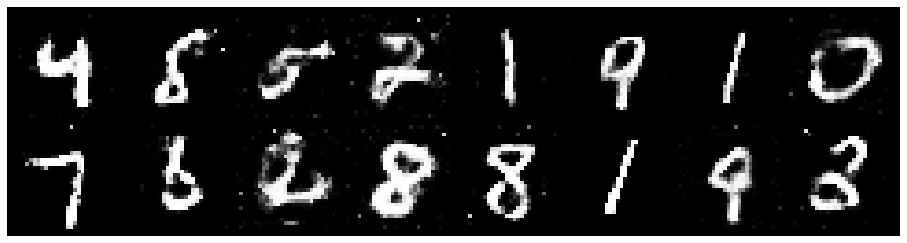

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.2743, Generator Loss: 0.8770
D(x): 0.5329, D(G(z)): 0.4418


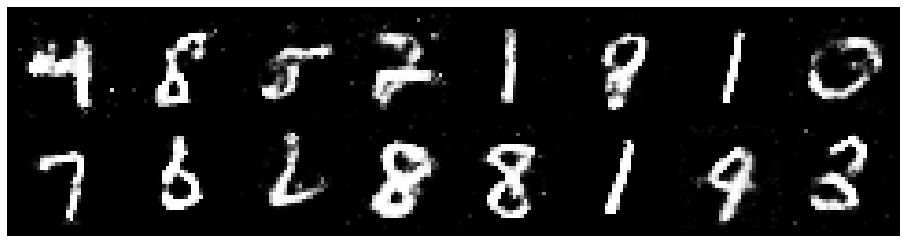

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.3351, Generator Loss: 0.8497
D(x): 0.5481, D(G(z)): 0.4715


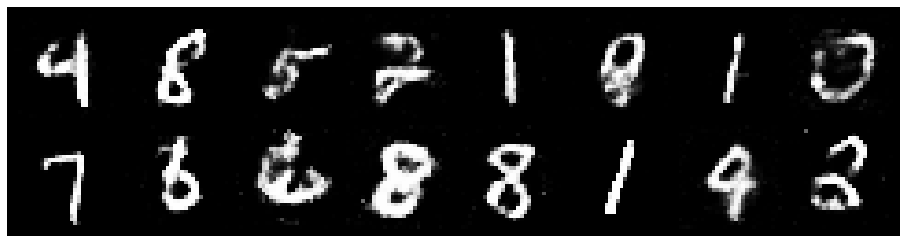

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.3033, Generator Loss: 0.8417
D(x): 0.5407, D(G(z)): 0.4549


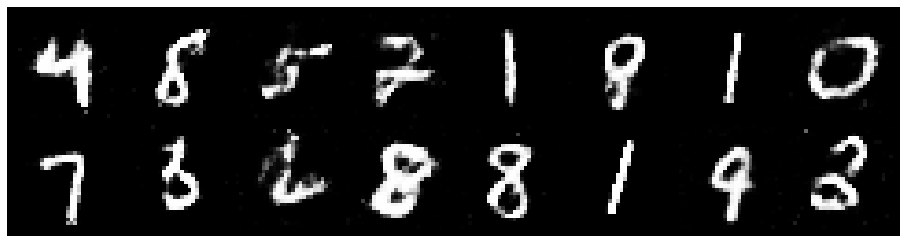

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.3116, Generator Loss: 0.7609
D(x): 0.5642, D(G(z)): 0.4763


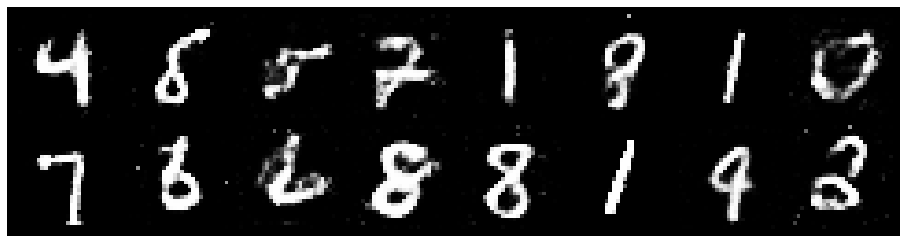

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.2730, Generator Loss: 0.7742
D(x): 0.5986, D(G(z)): 0.4851


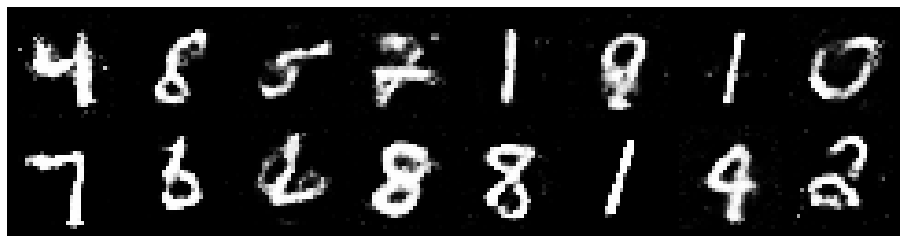

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.3249, Generator Loss: 0.9235
D(x): 0.5709, D(G(z)): 0.4594


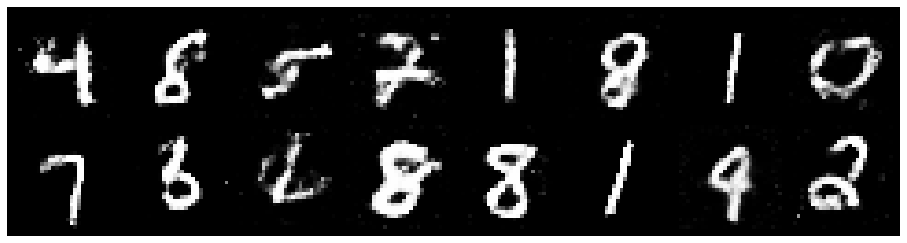

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.3091, Generator Loss: 0.8360
D(x): 0.5578, D(G(z)): 0.4485


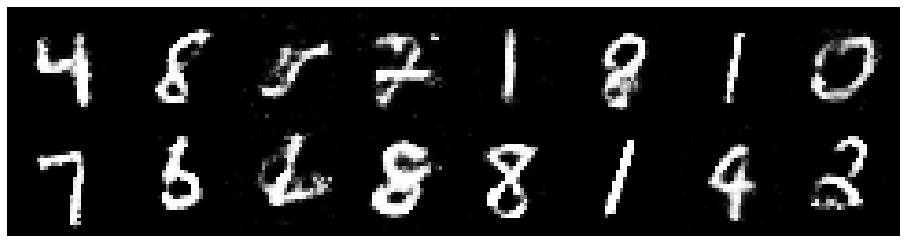

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.3233, Generator Loss: 0.8130
D(x): 0.5561, D(G(z)): 0.4888


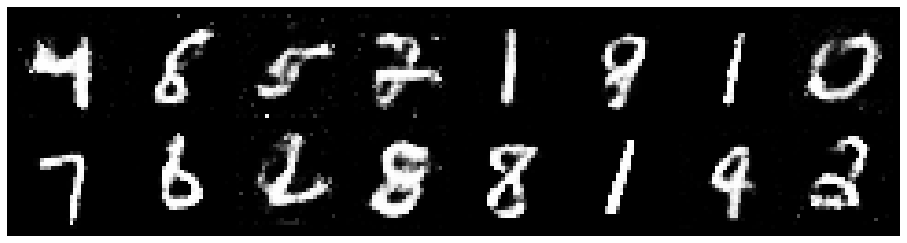

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.3356, Generator Loss: 0.8006
D(x): 0.5348, D(G(z)): 0.4561


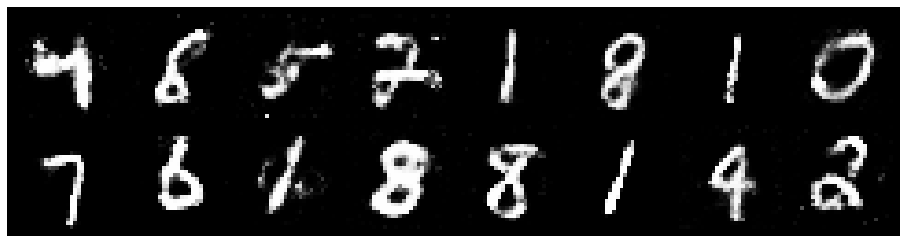

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.3039, Generator Loss: 0.8250
D(x): 0.5703, D(G(z)): 0.4843


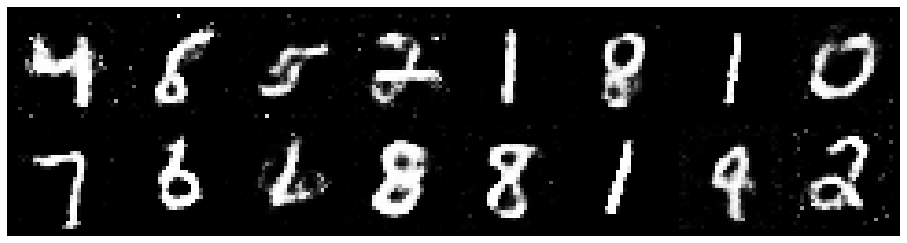

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.2836, Generator Loss: 0.8363
D(x): 0.5196, D(G(z)): 0.4326


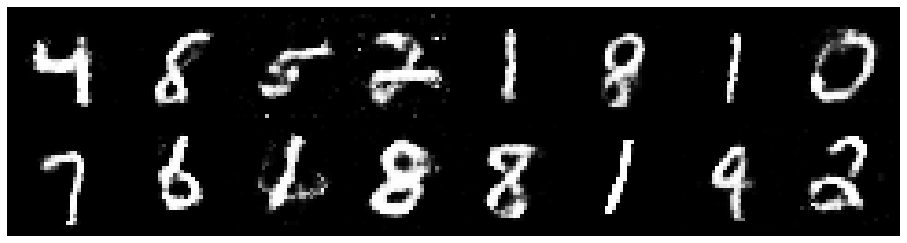

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.2658, Generator Loss: 0.9041
D(x): 0.5360, D(G(z)): 0.4326


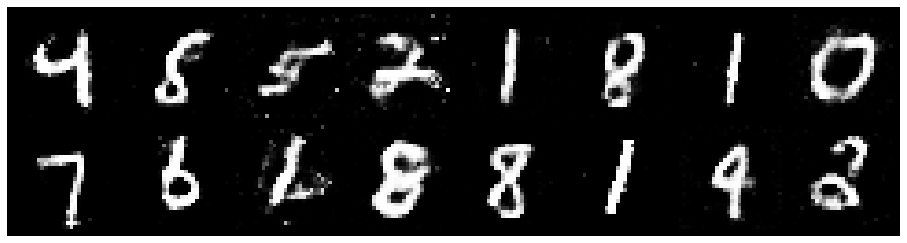

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.2675, Generator Loss: 0.8945
D(x): 0.5412, D(G(z)): 0.4483


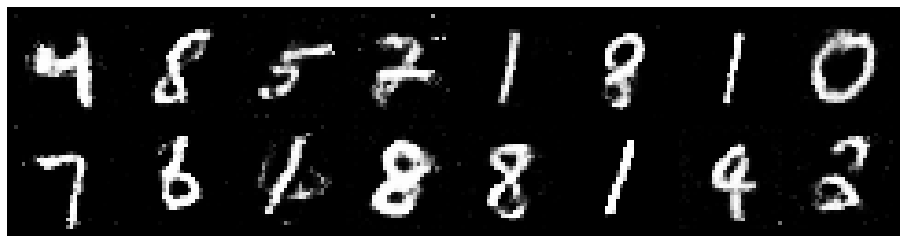

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.2615, Generator Loss: 0.9725
D(x): 0.5297, D(G(z)): 0.4234


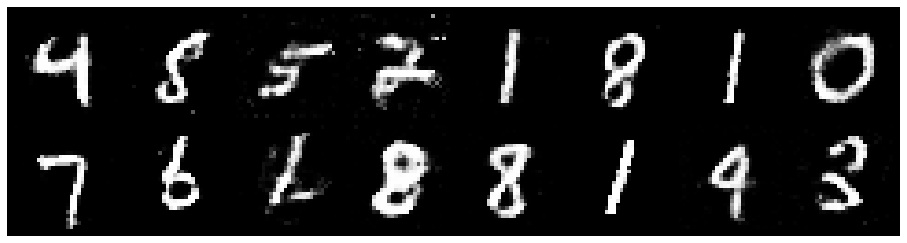

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.2544, Generator Loss: 0.8262
D(x): 0.5615, D(G(z)): 0.4539


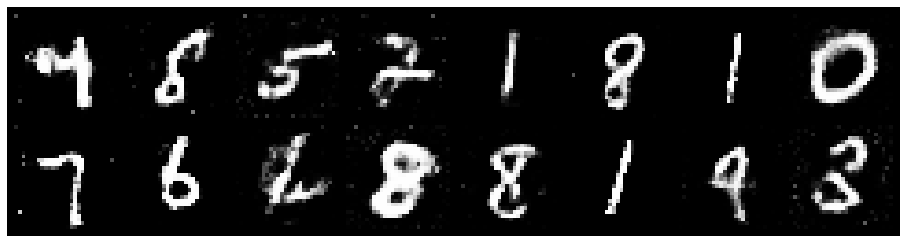

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.3052, Generator Loss: 0.8086
D(x): 0.5226, D(G(z)): 0.4440


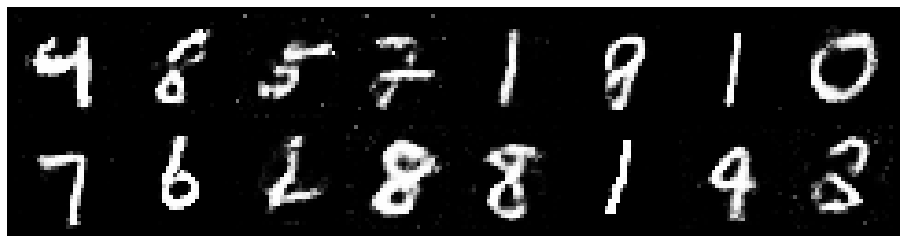

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.2989, Generator Loss: 0.7996
D(x): 0.5620, D(G(z)): 0.4733


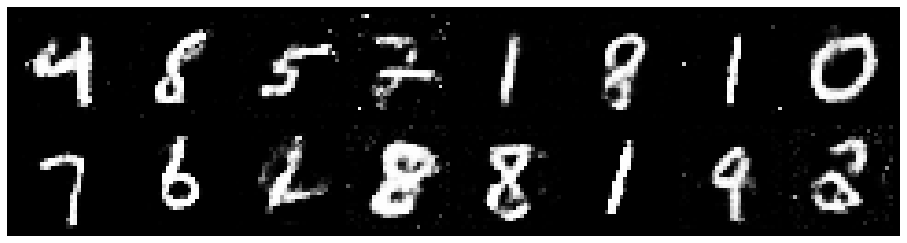

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.3568, Generator Loss: 0.7501
D(x): 0.5680, D(G(z)): 0.5123


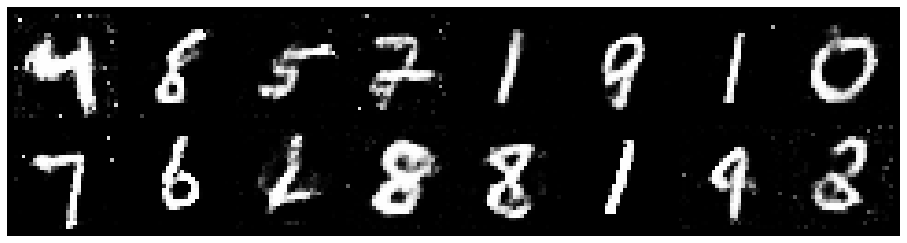

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.3149, Generator Loss: 0.8417
D(x): 0.5504, D(G(z)): 0.4668


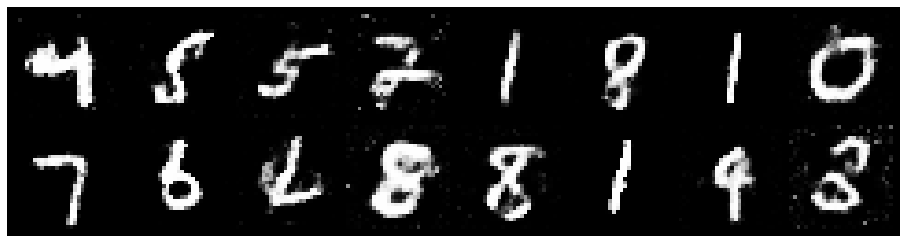

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.2360, Generator Loss: 0.7661
D(x): 0.5910, D(G(z)): 0.4674


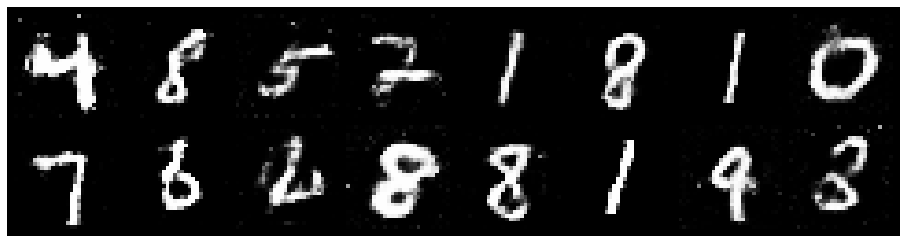

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.2806, Generator Loss: 0.8477
D(x): 0.5594, D(G(z)): 0.4488


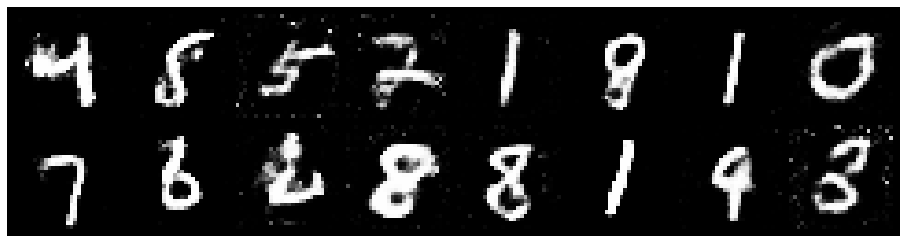

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.1826, Generator Loss: 0.9039
D(x): 0.5956, D(G(z)): 0.4391


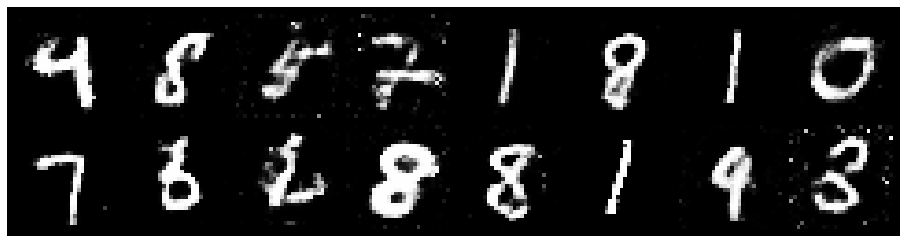

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.2921, Generator Loss: 0.8997
D(x): 0.5244, D(G(z)): 0.4390


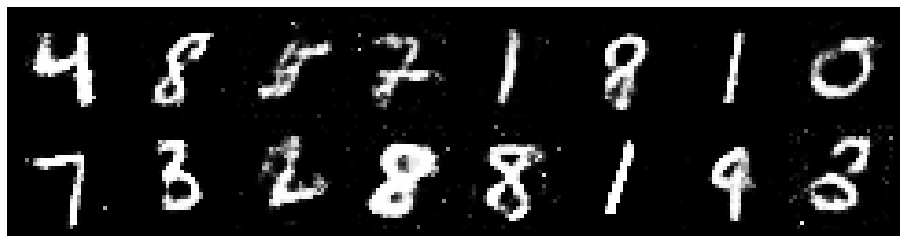

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.4116, Generator Loss: 0.7904
D(x): 0.5357, D(G(z)): 0.5032


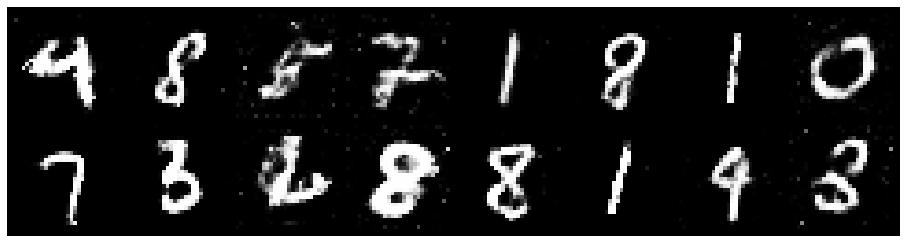

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.3565, Generator Loss: 0.8576
D(x): 0.5303, D(G(z)): 0.4626


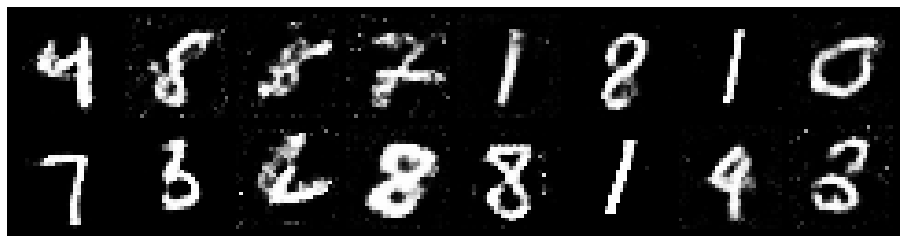

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.2857, Generator Loss: 0.8387
D(x): 0.5768, D(G(z)): 0.4614


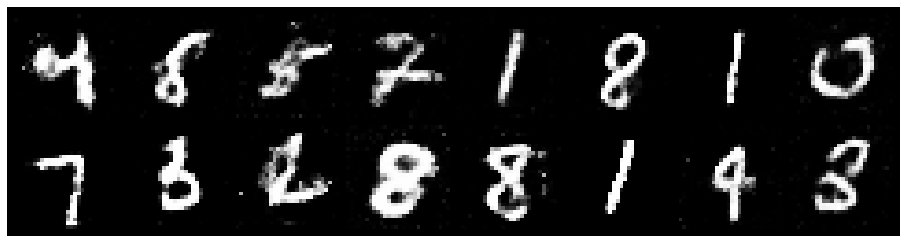

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.3067, Generator Loss: 0.9112
D(x): 0.5355, D(G(z)): 0.4306


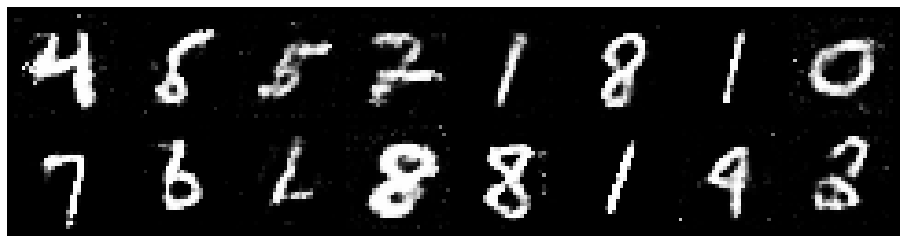

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.3637, Generator Loss: 0.8541
D(x): 0.5152, D(G(z)): 0.4586


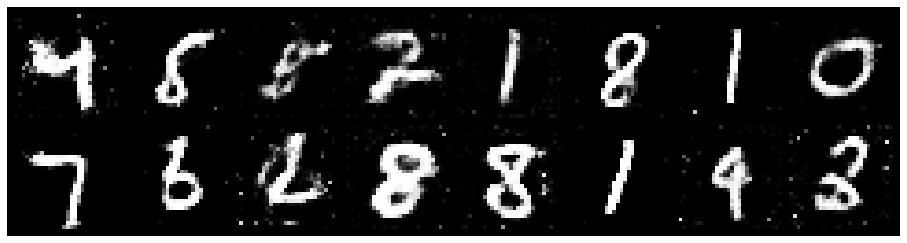

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.2851, Generator Loss: 0.8943
D(x): 0.5147, D(G(z)): 0.4188


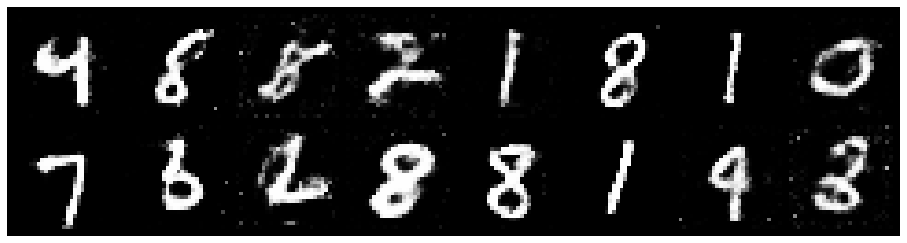

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.2979, Generator Loss: 0.8282
D(x): 0.5318, D(G(z)): 0.4462


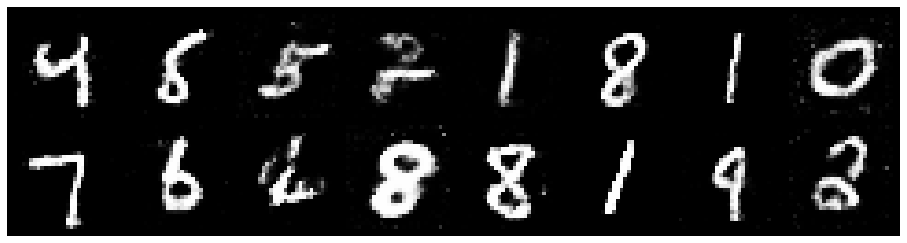

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.2365, Generator Loss: 0.9854
D(x): 0.5548, D(G(z)): 0.4147


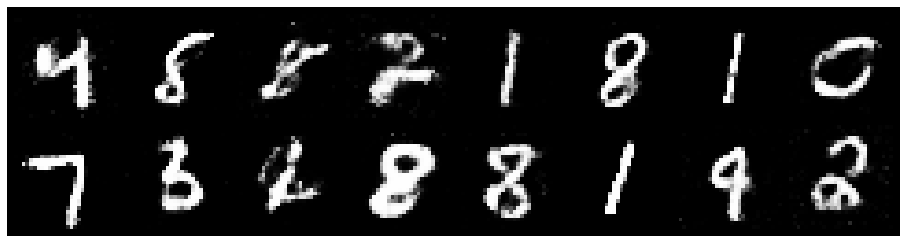

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.2276, Generator Loss: 1.0119
D(x): 0.5627, D(G(z)): 0.4299


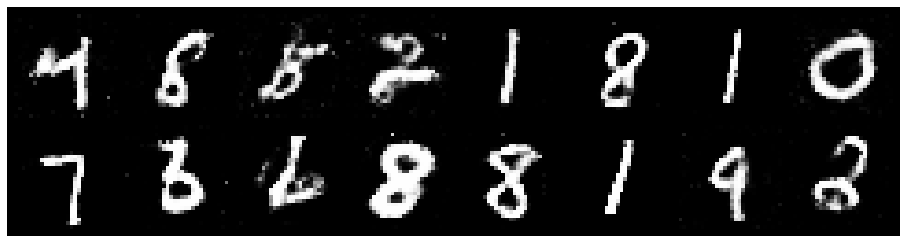

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.2042, Generator Loss: 0.8487
D(x): 0.5607, D(G(z)): 0.4222


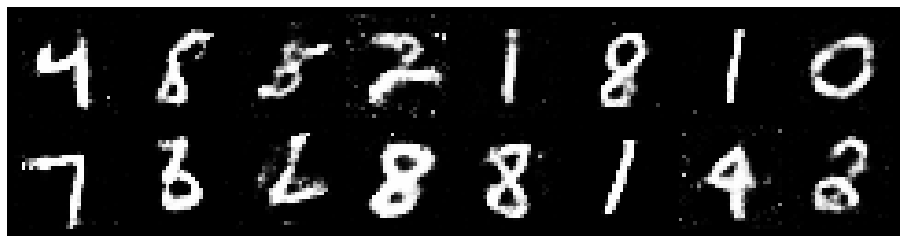

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.4120, Generator Loss: 0.7392
D(x): 0.5584, D(G(z)): 0.5015


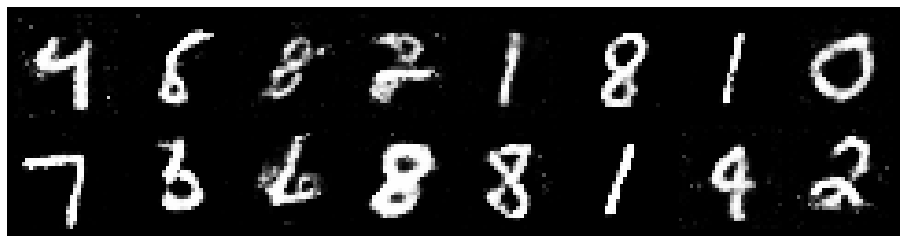

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.3209, Generator Loss: 0.7188
D(x): 0.5728, D(G(z)): 0.4929


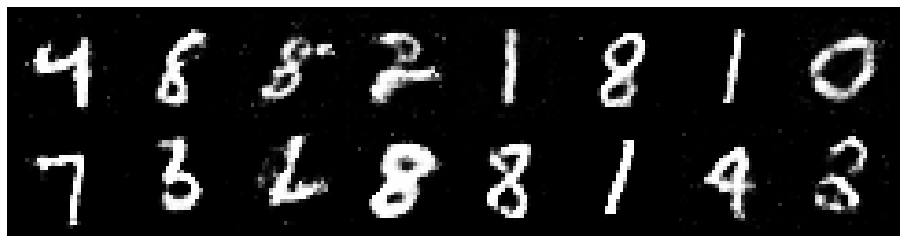

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.2433, Generator Loss: 0.9433
D(x): 0.5513, D(G(z)): 0.4498


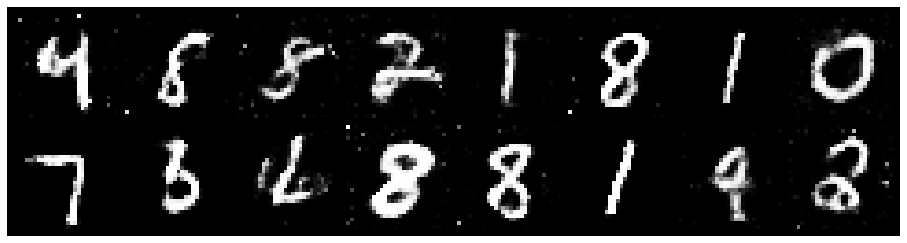

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.3853, Generator Loss: 0.9769
D(x): 0.5156, D(G(z)): 0.4656


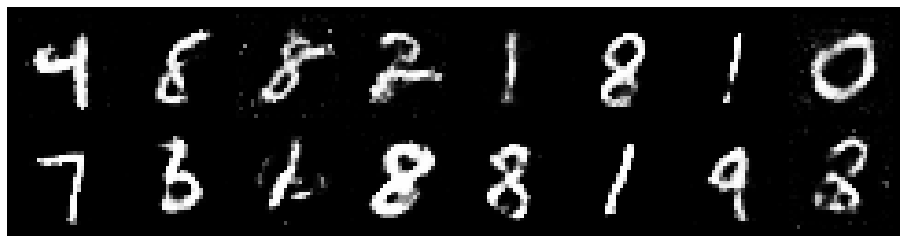

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.3516, Generator Loss: 0.9134
D(x): 0.5201, D(G(z)): 0.4568


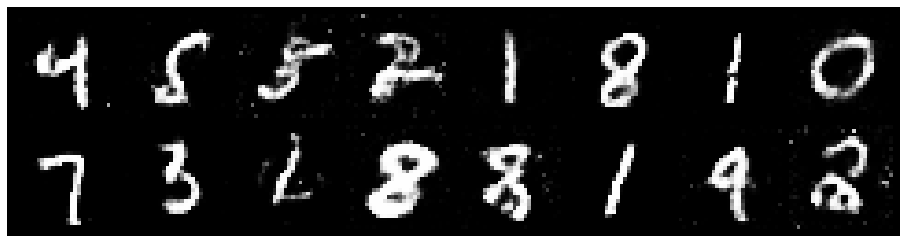

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.3762, Generator Loss: 0.8249
D(x): 0.5813, D(G(z)): 0.5042


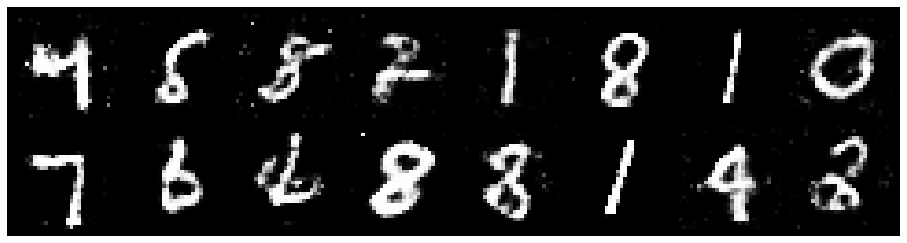

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.4195, Generator Loss: 0.7805
D(x): 0.5143, D(G(z)): 0.4876


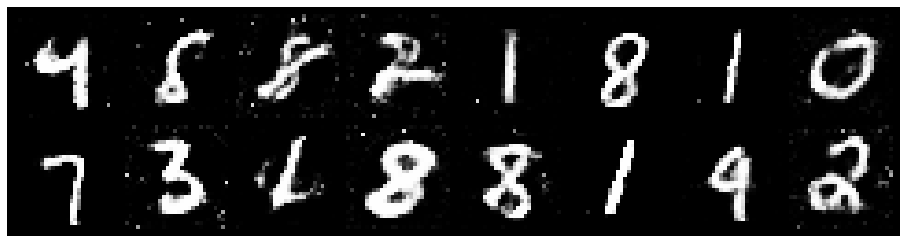

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.3303, Generator Loss: 0.9072
D(x): 0.5227, D(G(z)): 0.4462


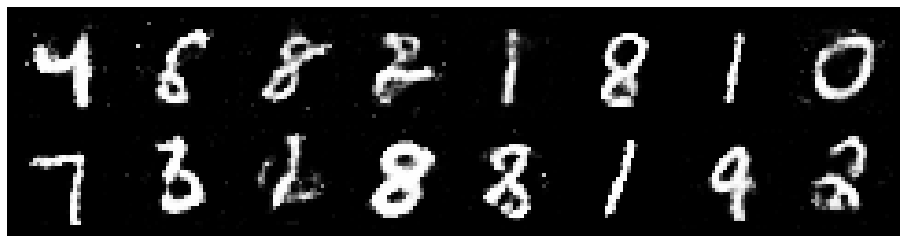

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.3931, Generator Loss: 0.9496
D(x): 0.5200, D(G(z)): 0.4614


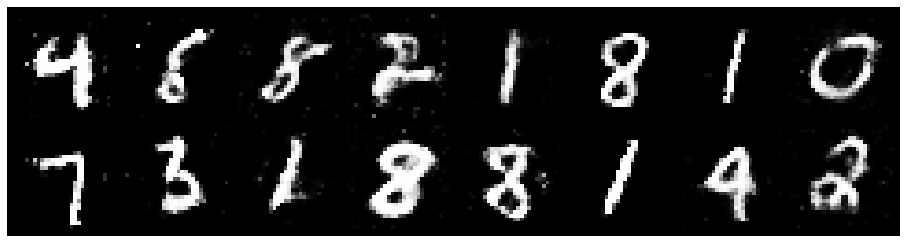

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.4126, Generator Loss: 0.7929
D(x): 0.5279, D(G(z)): 0.4934


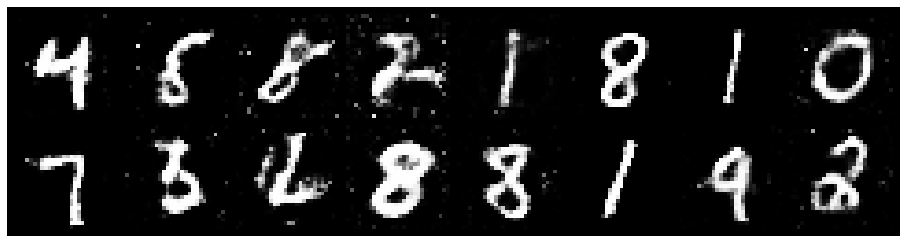

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.2345, Generator Loss: 0.9070
D(x): 0.5363, D(G(z)): 0.4122


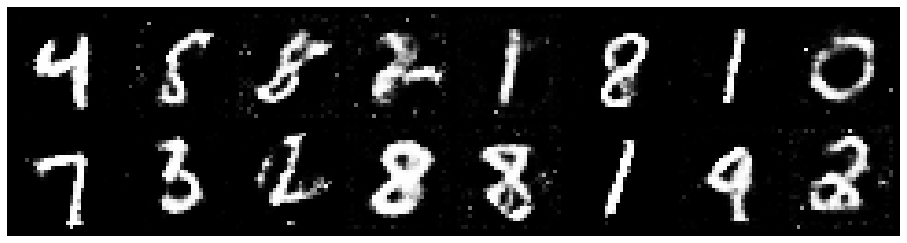

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.2916, Generator Loss: 0.8206
D(x): 0.5458, D(G(z)): 0.4584


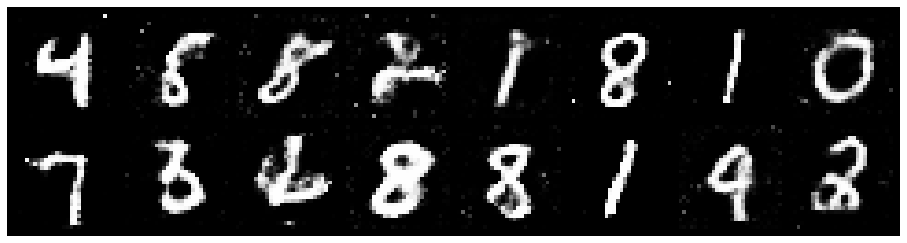

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.3413, Generator Loss: 0.9433
D(x): 0.5380, D(G(z)): 0.4469


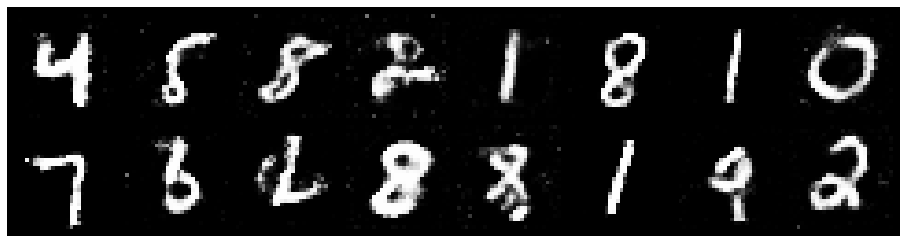

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.2954, Generator Loss: 0.8416
D(x): 0.5588, D(G(z)): 0.4734


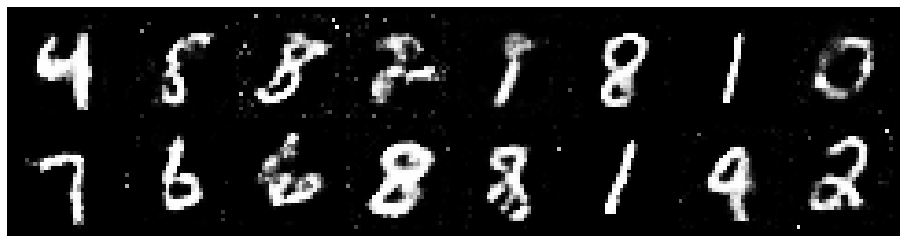

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.3101, Generator Loss: 0.8316
D(x): 0.5348, D(G(z)): 0.4495


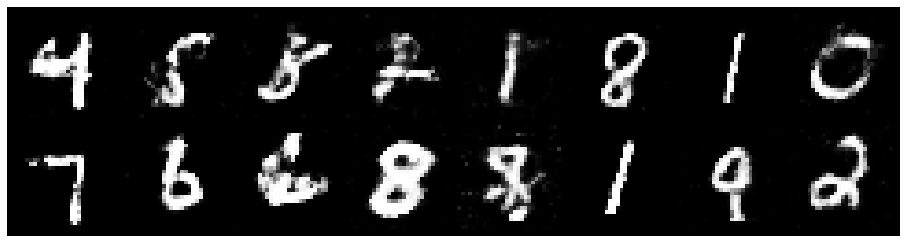

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.3097, Generator Loss: 0.9269
D(x): 0.5451, D(G(z)): 0.4450


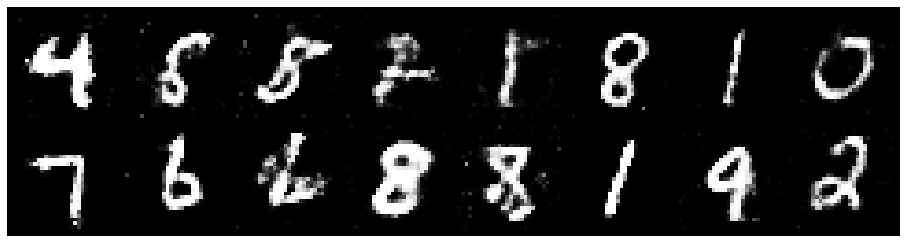

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.4020, Generator Loss: 0.8613
D(x): 0.5172, D(G(z)): 0.4698


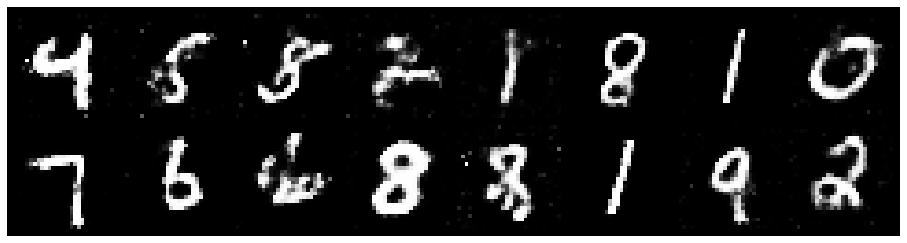

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.2981, Generator Loss: 0.8298
D(x): 0.5638, D(G(z)): 0.4680


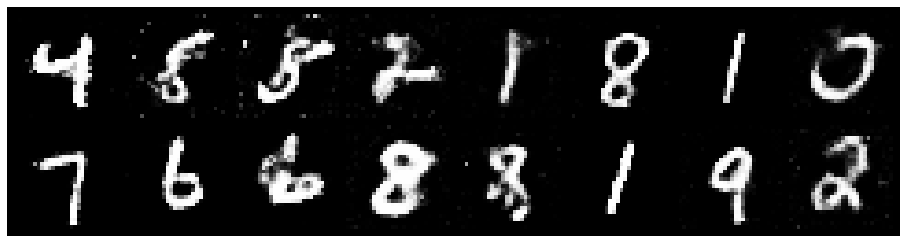

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.2499, Generator Loss: 0.8115
D(x): 0.5676, D(G(z)): 0.4477


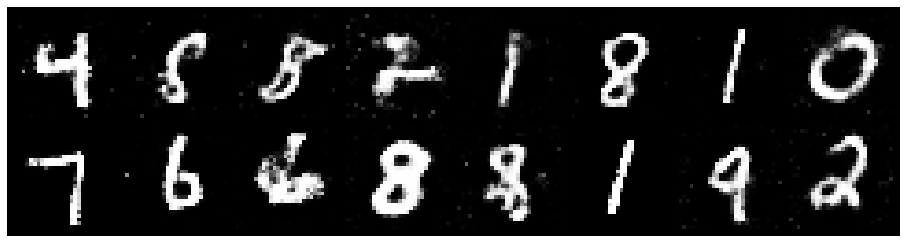

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.3068, Generator Loss: 0.7631
D(x): 0.5313, D(G(z)): 0.4554


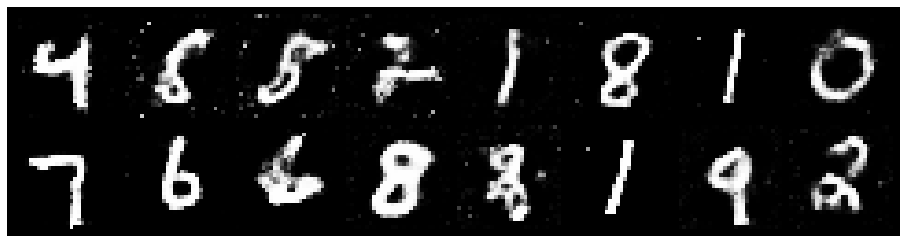

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.3097, Generator Loss: 0.8680
D(x): 0.5104, D(G(z)): 0.4362


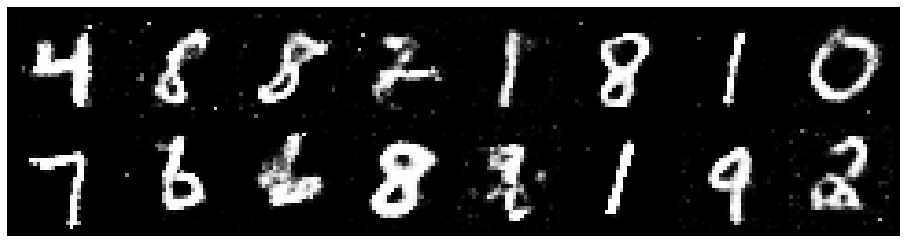

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.3825, Generator Loss: 0.7924
D(x): 0.5500, D(G(z)): 0.4947


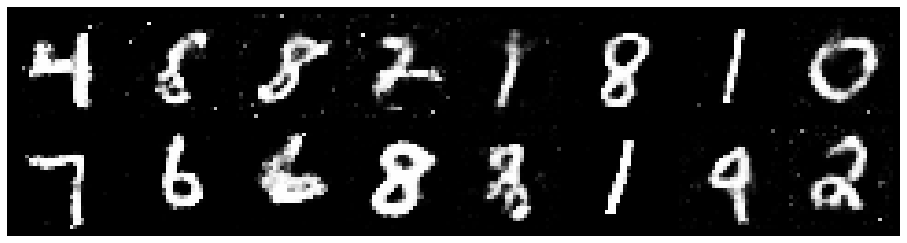

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.2863, Generator Loss: 0.8312
D(x): 0.5647, D(G(z)): 0.4727


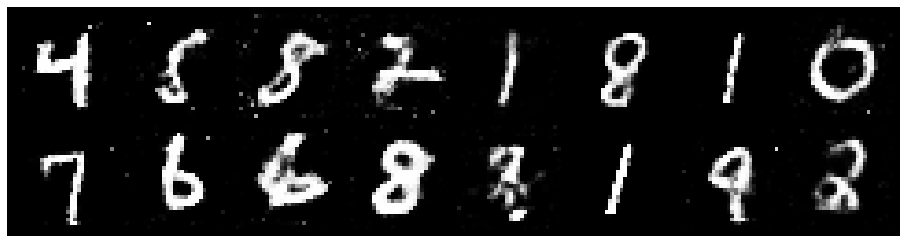

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.3222, Generator Loss: 0.8920
D(x): 0.5585, D(G(z)): 0.4568


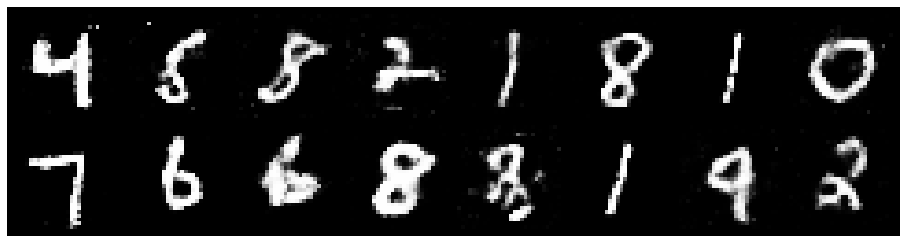

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.2175, Generator Loss: 0.8720
D(x): 0.5654, D(G(z)): 0.4402


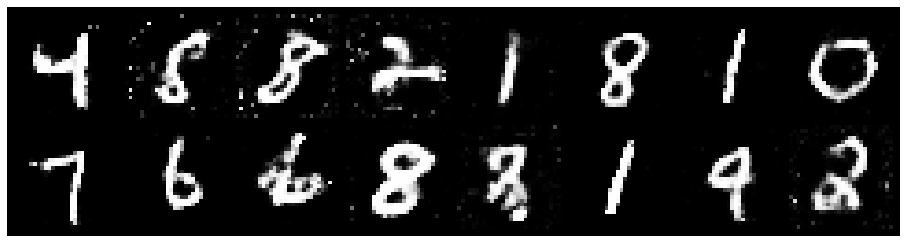

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.2564, Generator Loss: 0.8724
D(x): 0.5357, D(G(z)): 0.4353


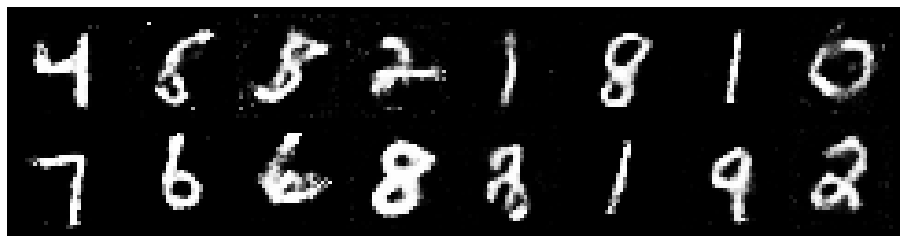

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.3242, Generator Loss: 0.8929
D(x): 0.5882, D(G(z)): 0.4960


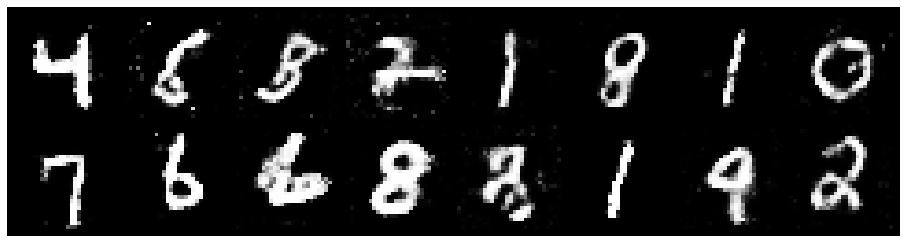

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.4084, Generator Loss: 0.8882
D(x): 0.4972, D(G(z)): 0.4397


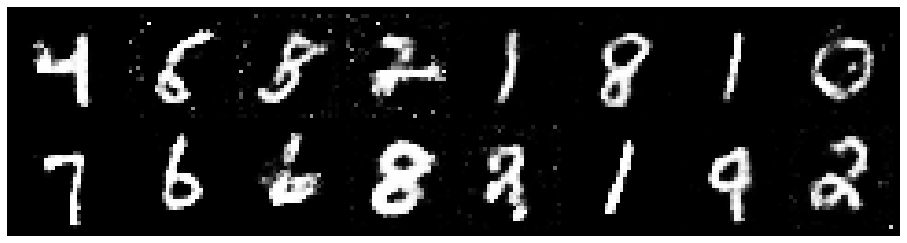

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.2523, Generator Loss: 0.8409
D(x): 0.5541, D(G(z)): 0.4470


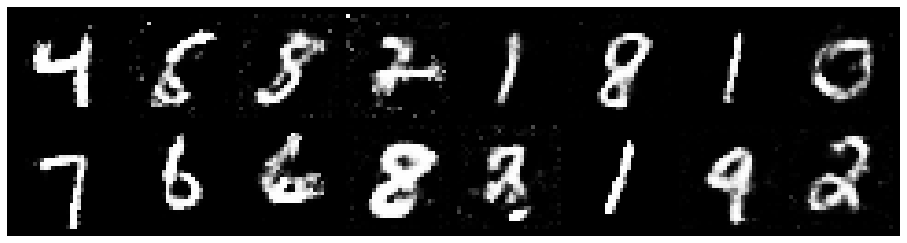

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.2633, Generator Loss: 0.9142
D(x): 0.5338, D(G(z)): 0.4386


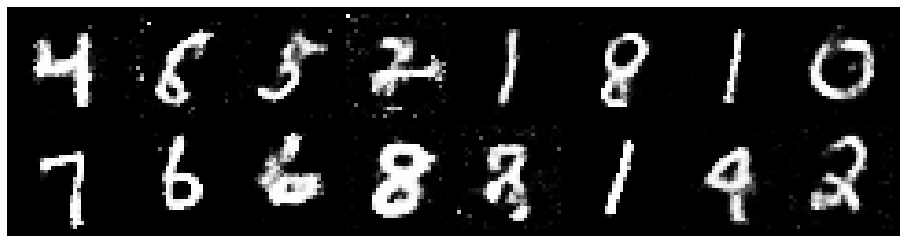

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.3197, Generator Loss: 0.9633
D(x): 0.5265, D(G(z)): 0.4485


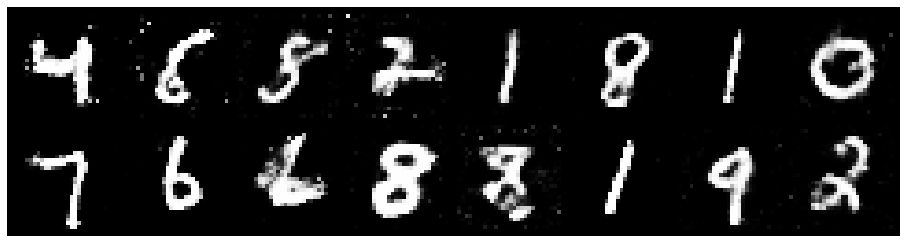

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.3713, Generator Loss: 0.7491
D(x): 0.5413, D(G(z)): 0.4925


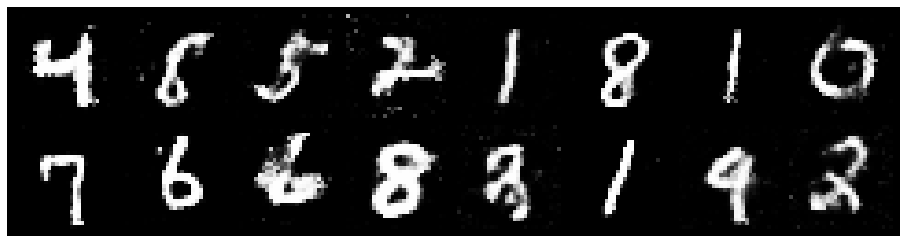

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.2246, Generator Loss: 0.8657
D(x): 0.5585, D(G(z)): 0.4328


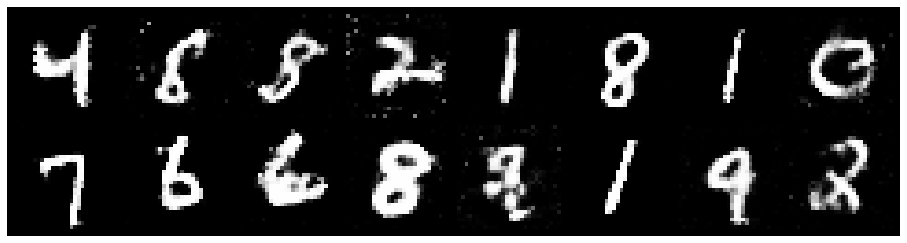

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.2915, Generator Loss: 0.9344
D(x): 0.5389, D(G(z)): 0.4368


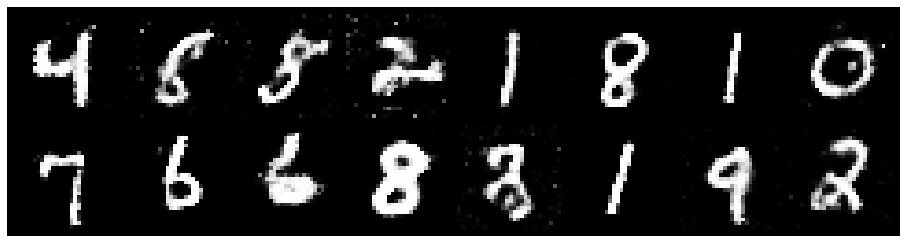

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.2771, Generator Loss: 0.8123
D(x): 0.5656, D(G(z)): 0.4571


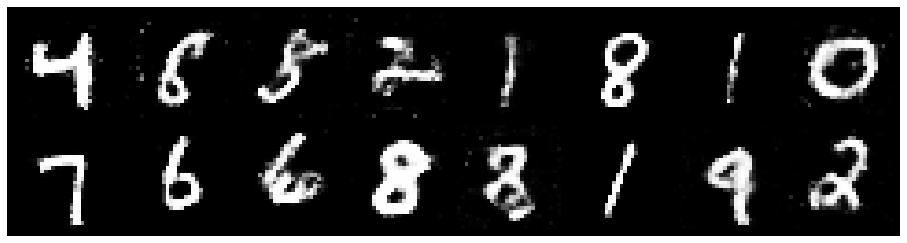

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.3525, Generator Loss: 0.7383
D(x): 0.5788, D(G(z)): 0.5087


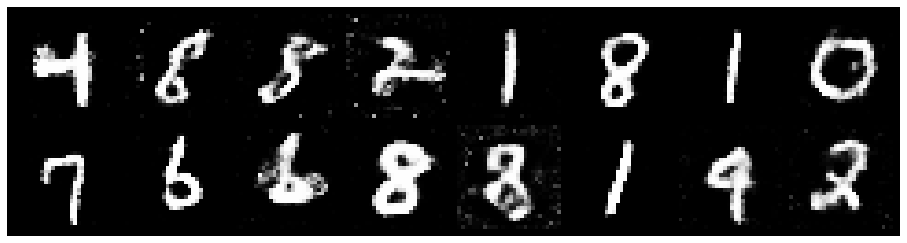

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.3995, Generator Loss: 0.8136
D(x): 0.5362, D(G(z)): 0.4876


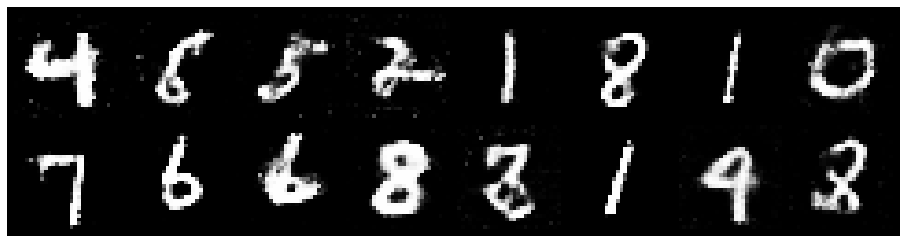

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.2808, Generator Loss: 0.8477
D(x): 0.5567, D(G(z)): 0.4524


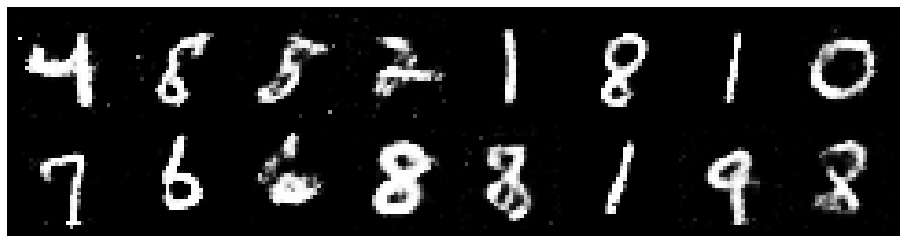

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.2849, Generator Loss: 0.9253
D(x): 0.5573, D(G(z)): 0.4579


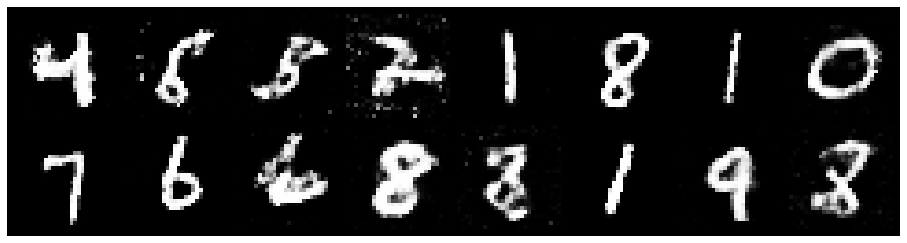

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.3411, Generator Loss: 0.8769
D(x): 0.5594, D(G(z)): 0.4651


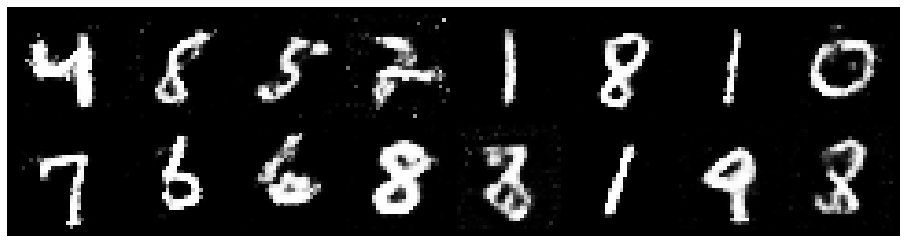

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.2773, Generator Loss: 0.8707
D(x): 0.5466, D(G(z)): 0.4488


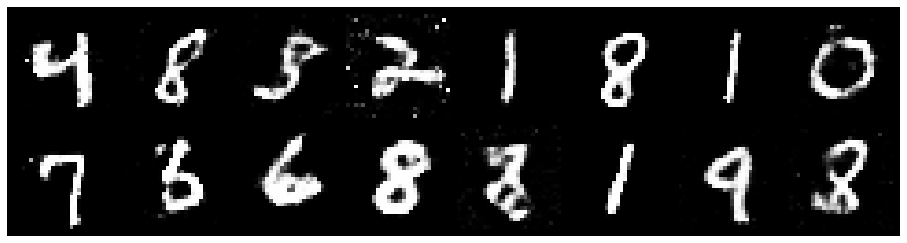

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.3202, Generator Loss: 0.9239
D(x): 0.5666, D(G(z)): 0.4634


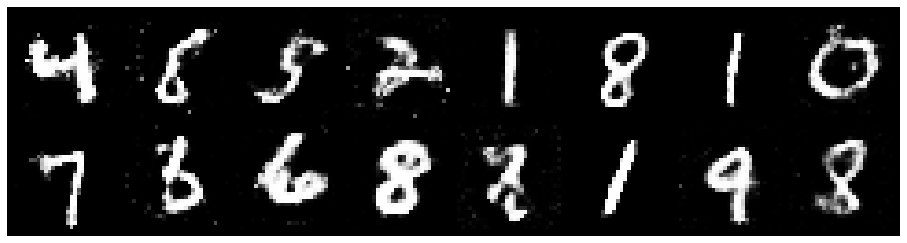

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.2902, Generator Loss: 0.9105
D(x): 0.5186, D(G(z)): 0.4275


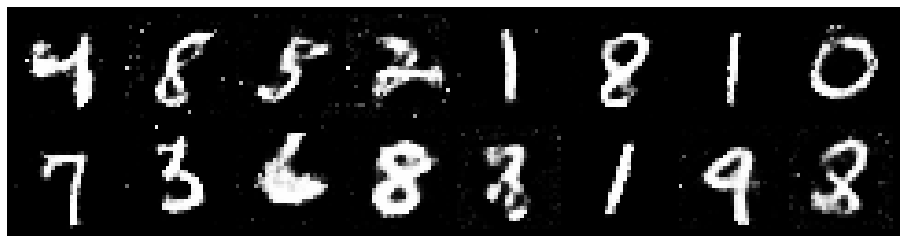

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.2897, Generator Loss: 0.7950
D(x): 0.5898, D(G(z)): 0.4745


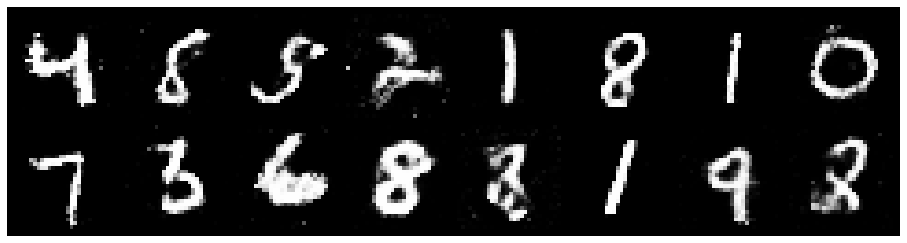

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.3751, Generator Loss: 0.8358
D(x): 0.5368, D(G(z)): 0.4823


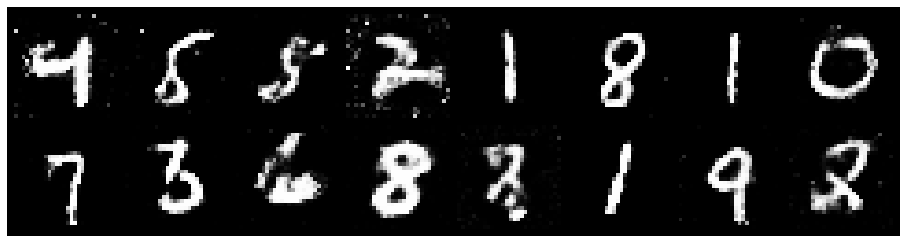

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.4112, Generator Loss: 0.7323
D(x): 0.5165, D(G(z)): 0.4945


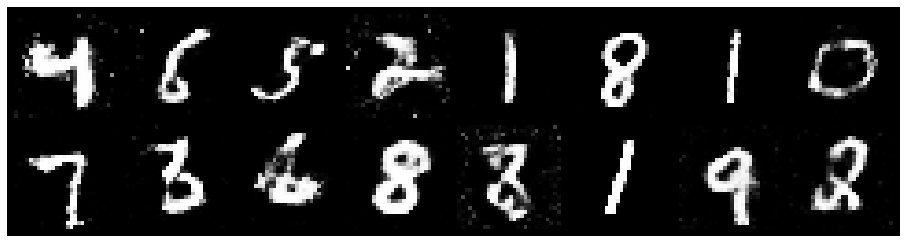

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.3402, Generator Loss: 0.8360
D(x): 0.5173, D(G(z)): 0.4453


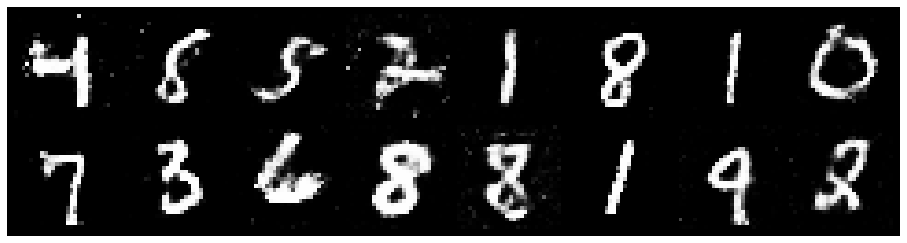

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.2673, Generator Loss: 0.8526
D(x): 0.5535, D(G(z)): 0.4527


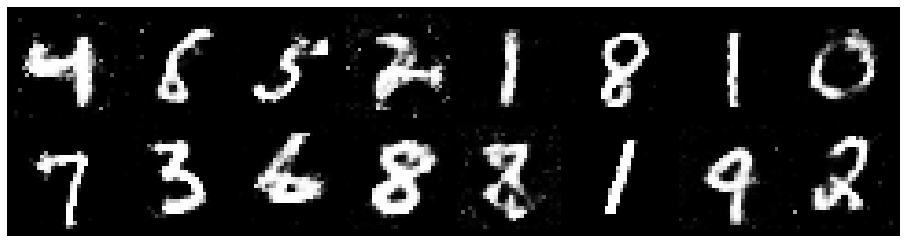

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.2703, Generator Loss: 0.8119
D(x): 0.5611, D(G(z)): 0.4644


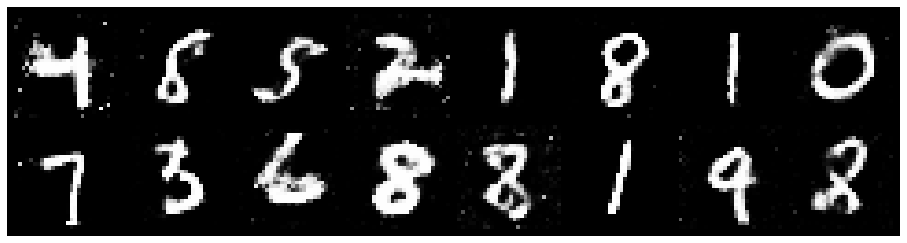

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.2526, Generator Loss: 0.8478
D(x): 0.5352, D(G(z)): 0.4271


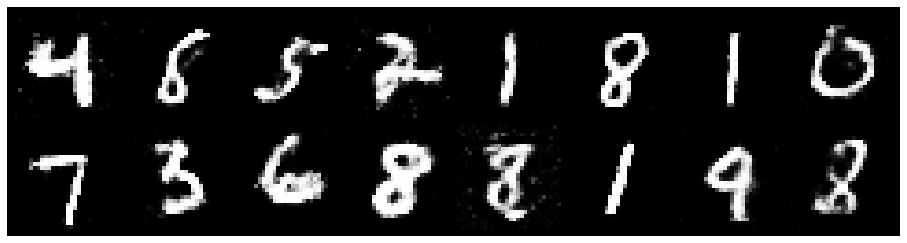

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.2453, Generator Loss: 0.9969
D(x): 0.5629, D(G(z)): 0.4216


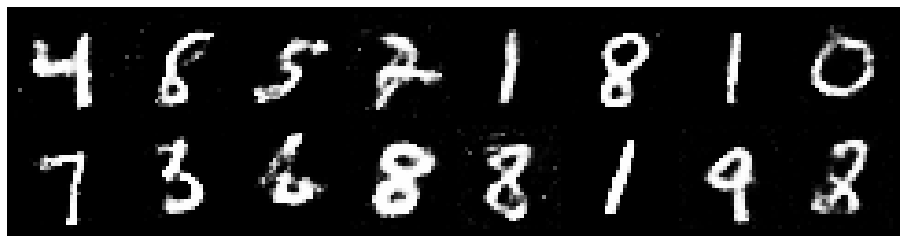

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.2708, Generator Loss: 0.9033
D(x): 0.6061, D(G(z)): 0.4733


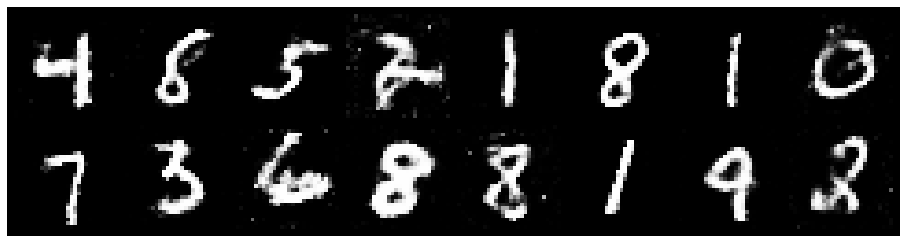

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.3775, Generator Loss: 0.7537
D(x): 0.5246, D(G(z)): 0.4853


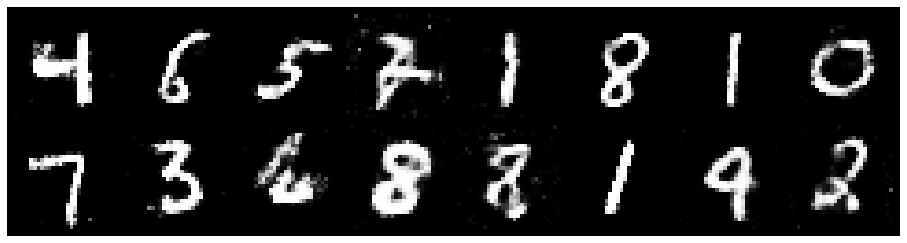

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.3089, Generator Loss: 0.8155
D(x): 0.5579, D(G(z)): 0.4824


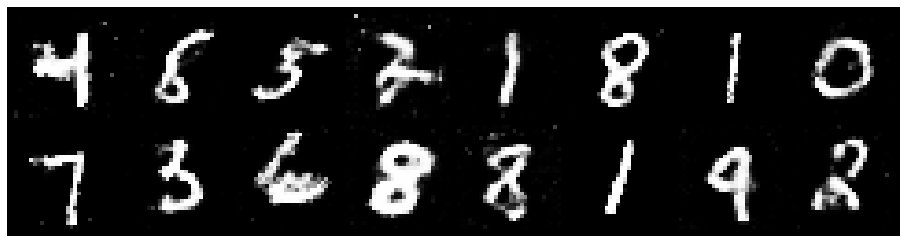

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.3500, Generator Loss: 0.8758
D(x): 0.5517, D(G(z)): 0.4625


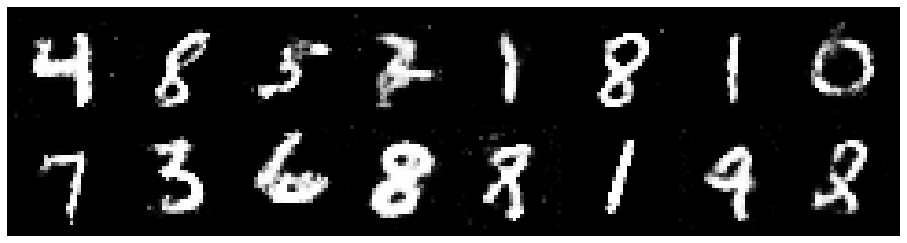

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.3411, Generator Loss: 0.9062
D(x): 0.5140, D(G(z)): 0.4372


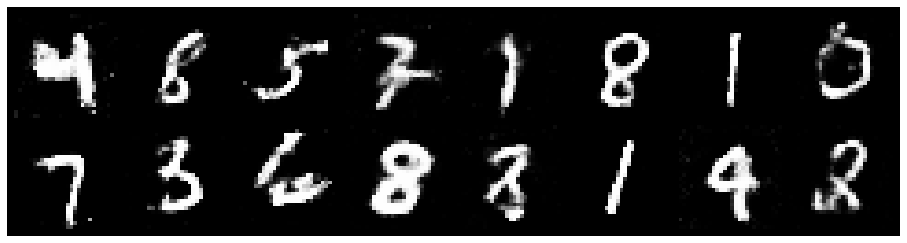

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.3585, Generator Loss: 0.7825
D(x): 0.5518, D(G(z)): 0.4819


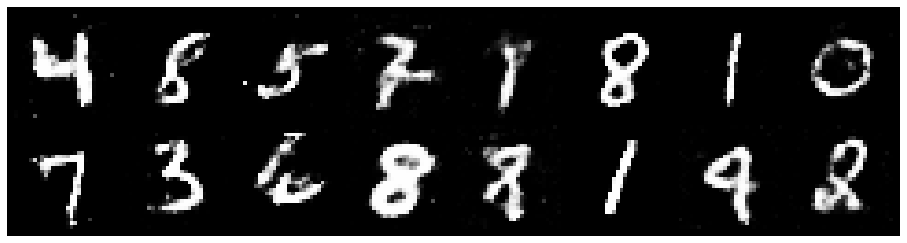

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.3046, Generator Loss: 0.8260
D(x): 0.5436, D(G(z)): 0.4576


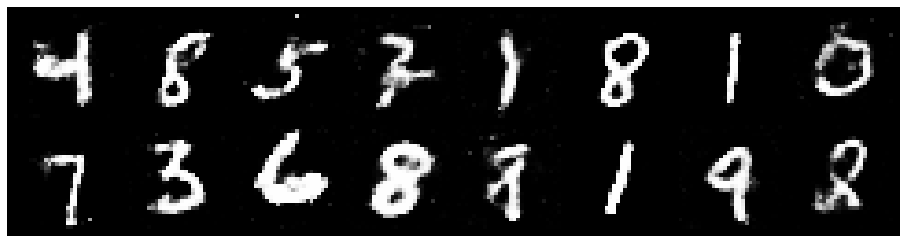

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.3062, Generator Loss: 0.8435
D(x): 0.5363, D(G(z)): 0.4528


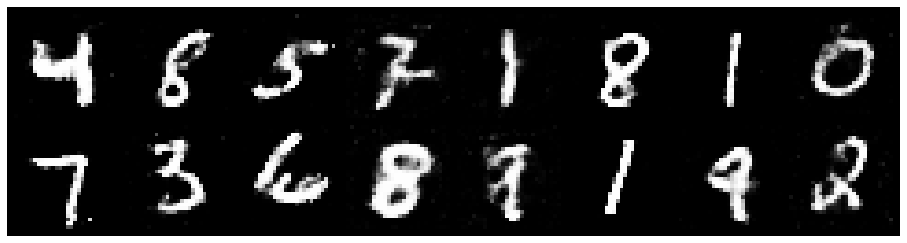

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.2837, Generator Loss: 0.8724
D(x): 0.5747, D(G(z)): 0.4696


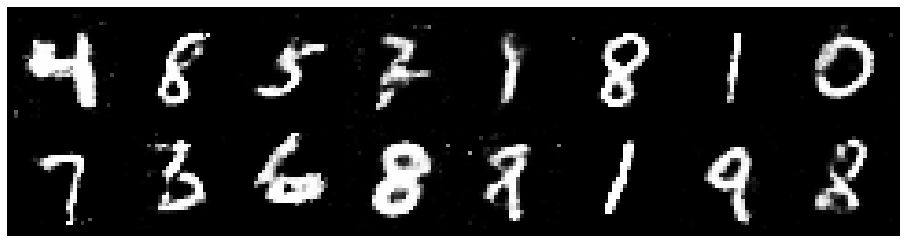

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.2597, Generator Loss: 0.9504
D(x): 0.5254, D(G(z)): 0.4110


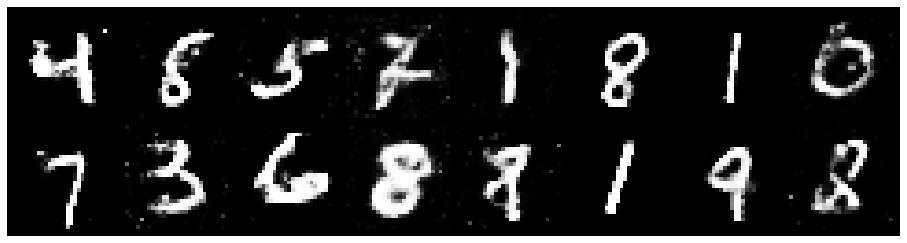

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.2279, Generator Loss: 0.9855
D(x): 0.5467, D(G(z)): 0.4022


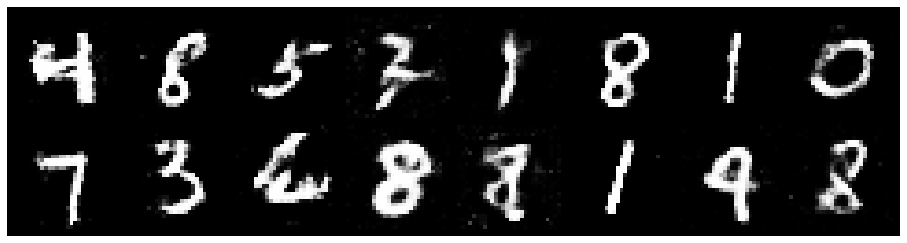

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.3356, Generator Loss: 0.7945
D(x): 0.5323, D(G(z)): 0.4799


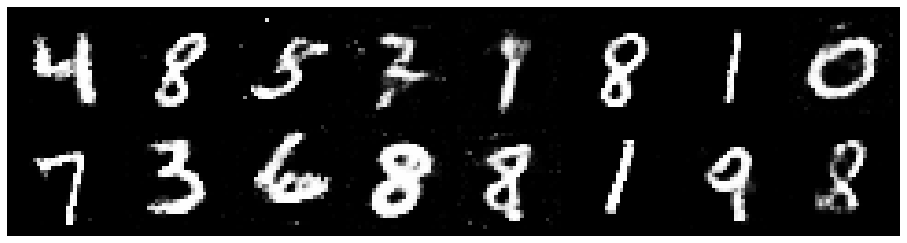

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.3378, Generator Loss: 0.7470
D(x): 0.5643, D(G(z)): 0.5008


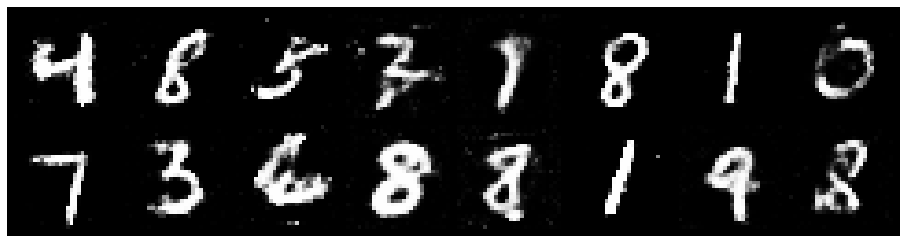

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.3230, Generator Loss: 0.9173
D(x): 0.5079, D(G(z)): 0.4362


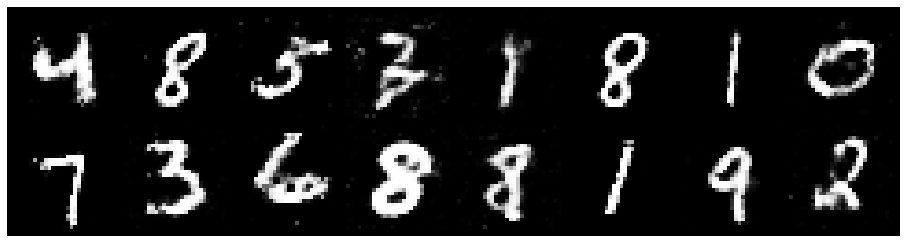

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.2830, Generator Loss: 0.8615
D(x): 0.5831, D(G(z)): 0.4647


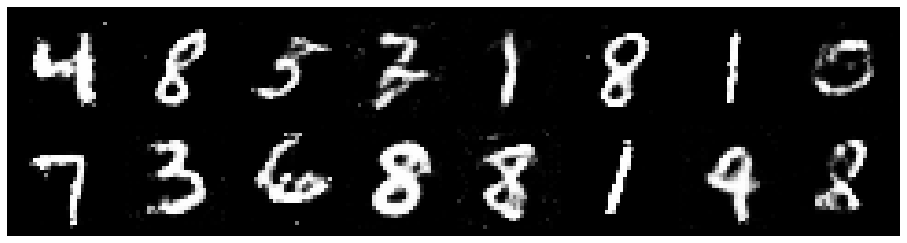

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.4214, Generator Loss: 0.8969
D(x): 0.5581, D(G(z)): 0.4732


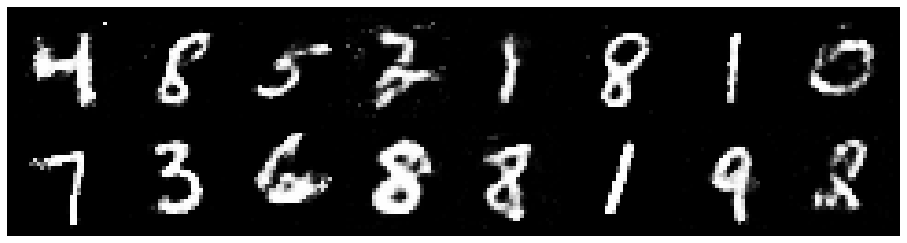

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.4058, Generator Loss: 0.8886
D(x): 0.4697, D(G(z)): 0.4241


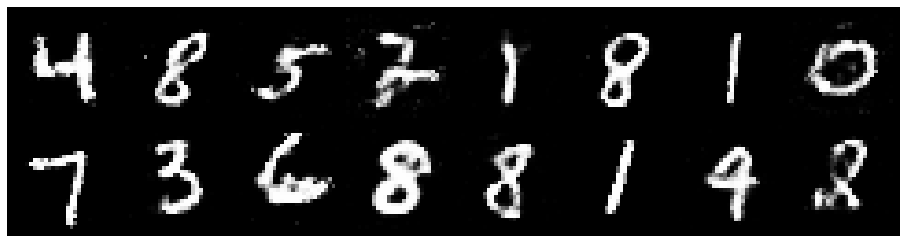

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.2559, Generator Loss: 0.8269
D(x): 0.5644, D(G(z)): 0.4558


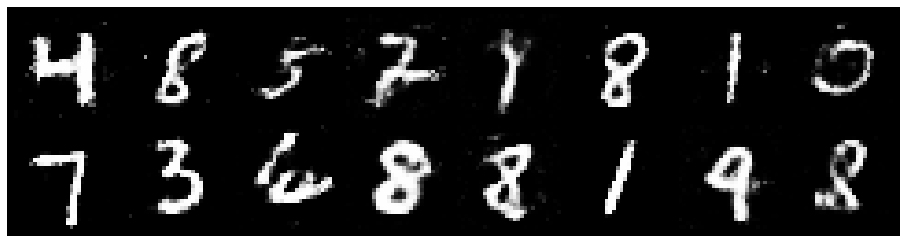

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.2001, Generator Loss: 0.8826
D(x): 0.5646, D(G(z)): 0.4246


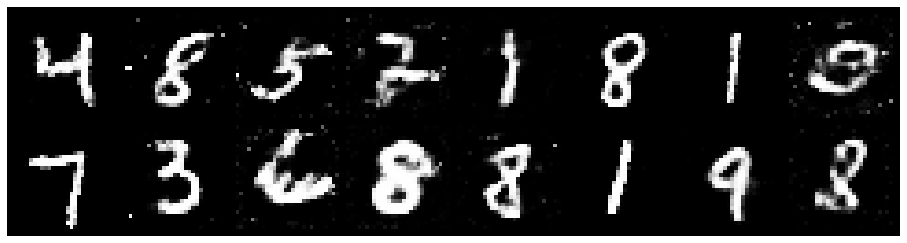

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.2818, Generator Loss: 0.8996
D(x): 0.5305, D(G(z)): 0.4276


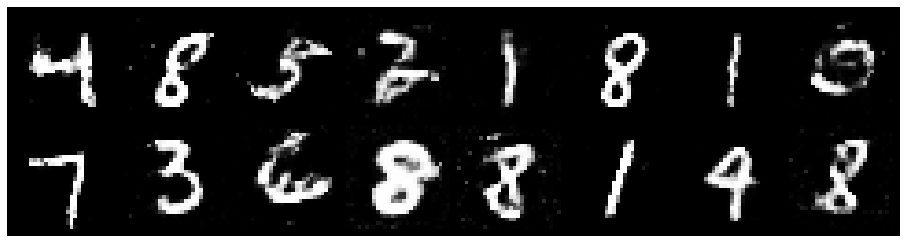

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.3276, Generator Loss: 0.7980
D(x): 0.5746, D(G(z)): 0.4736


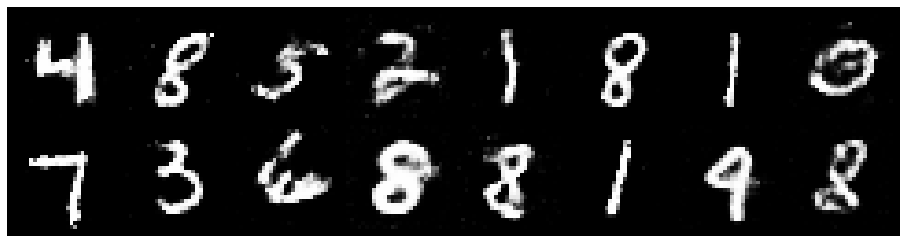

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.3166, Generator Loss: 0.8427
D(x): 0.5262, D(G(z)): 0.4427


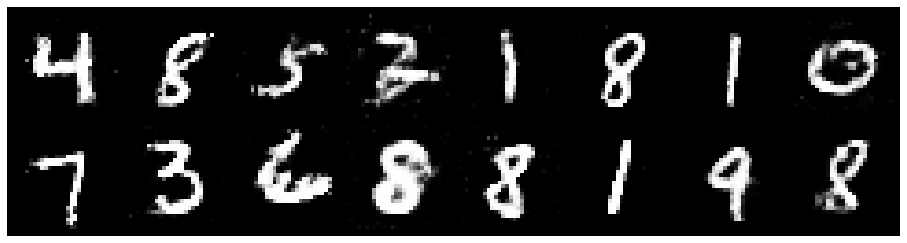

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.3797, Generator Loss: 0.9023
D(x): 0.5145, D(G(z)): 0.4548


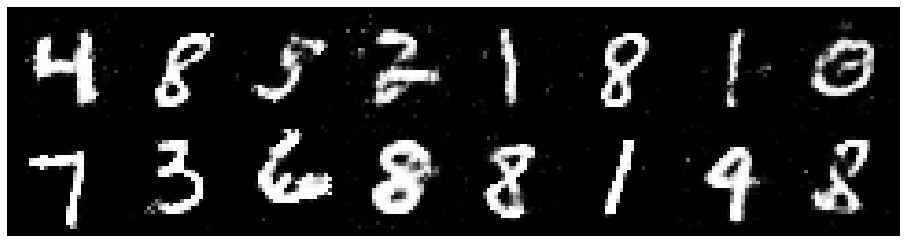

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.2122, Generator Loss: 0.8562
D(x): 0.5635, D(G(z)): 0.4384


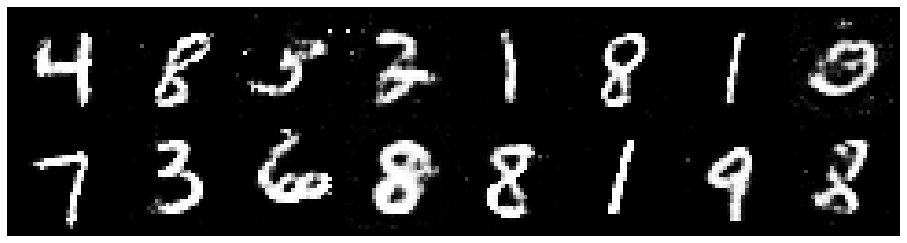

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.2175, Generator Loss: 0.7976
D(x): 0.5619, D(G(z)): 0.4265


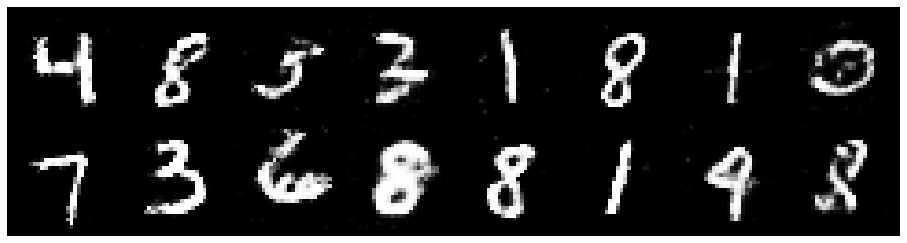

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.2561, Generator Loss: 0.8999
D(x): 0.5472, D(G(z)): 0.4304


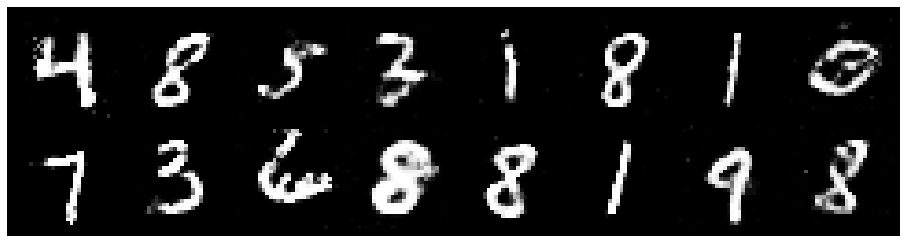

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.2382, Generator Loss: 0.9064
D(x): 0.5613, D(G(z)): 0.4332


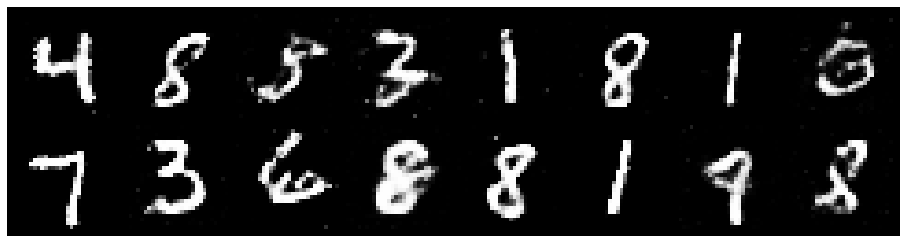

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.2613, Generator Loss: 0.8817
D(x): 0.5661, D(G(z)): 0.4520


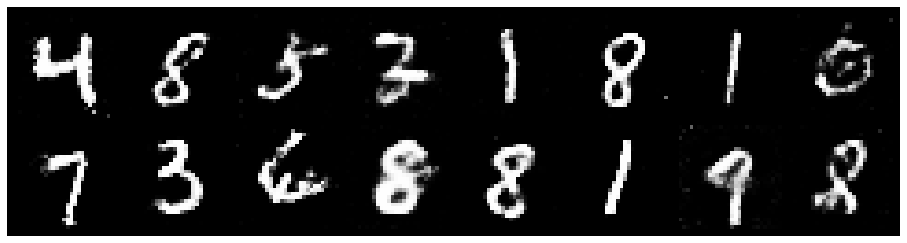

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.2653, Generator Loss: 0.8848
D(x): 0.5460, D(G(z)): 0.4384


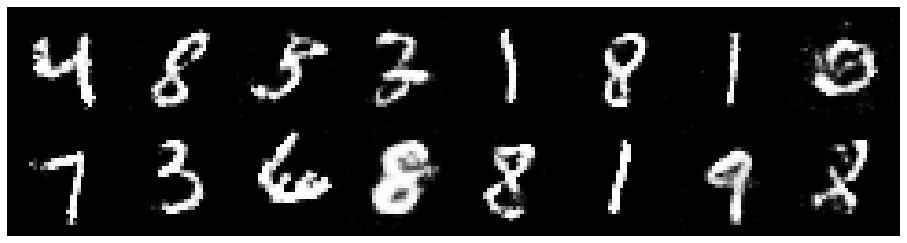

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.3454, Generator Loss: 0.8487
D(x): 0.5165, D(G(z)): 0.4494


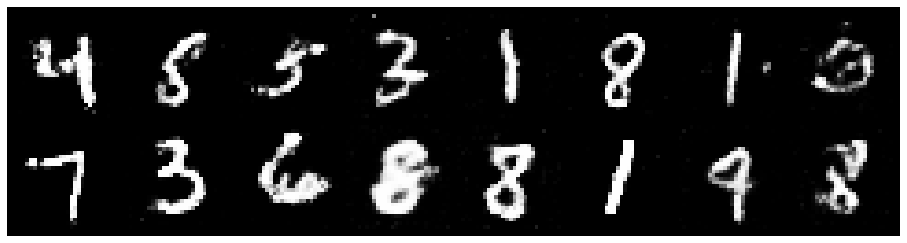

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.3004, Generator Loss: 0.8471
D(x): 0.5146, D(G(z)): 0.4299


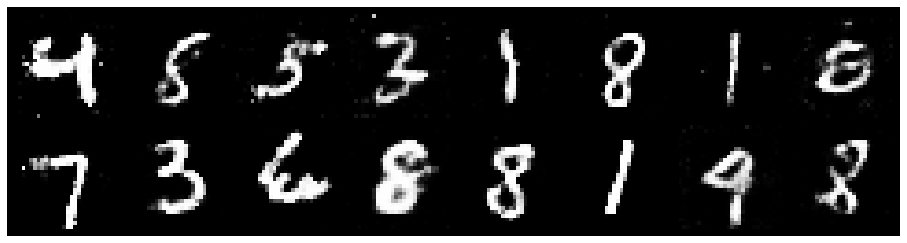

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.3080, Generator Loss: 0.8576
D(x): 0.5362, D(G(z)): 0.4498


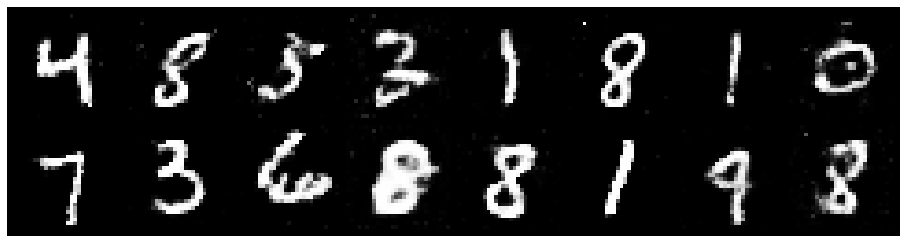

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.2385, Generator Loss: 0.8630
D(x): 0.5634, D(G(z)): 0.4487


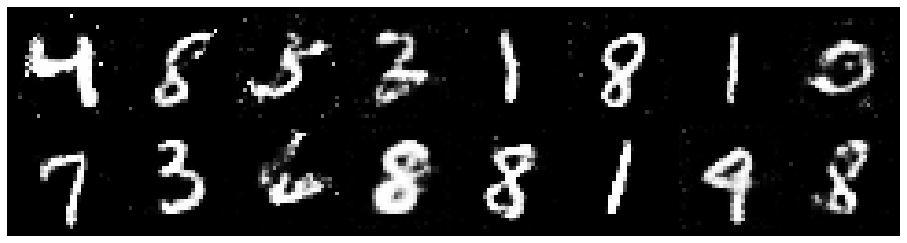

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.2994, Generator Loss: 0.9895
D(x): 0.5301, D(G(z)): 0.4274


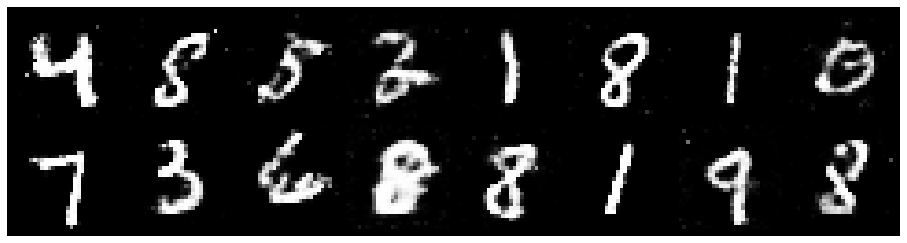

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.2451, Generator Loss: 0.8603
D(x): 0.5565, D(G(z)): 0.4535


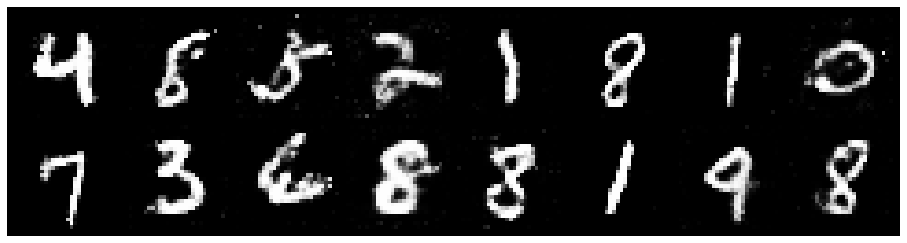

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.2870, Generator Loss: 0.8994
D(x): 0.5560, D(G(z)): 0.4522


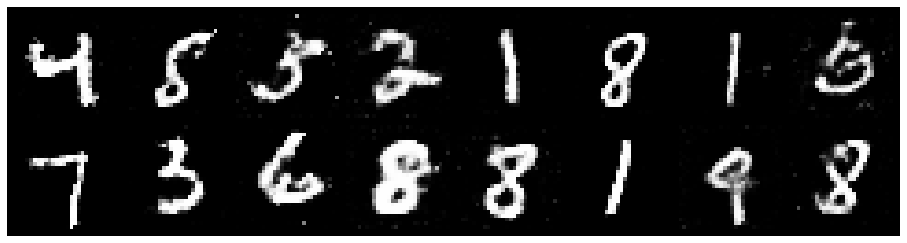

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.2600, Generator Loss: 0.9194
D(x): 0.5751, D(G(z)): 0.4592


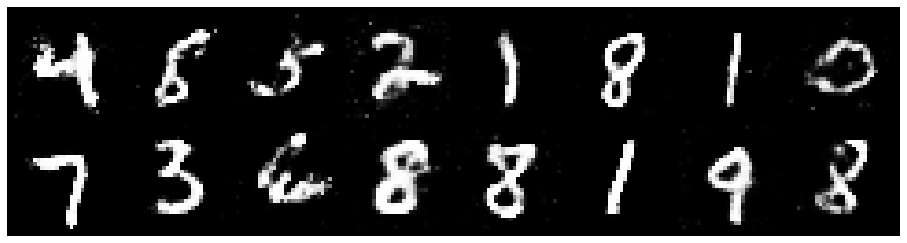

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.3011, Generator Loss: 0.8407
D(x): 0.5173, D(G(z)): 0.4264


In [71]:
for epoch in range(num_epochs):
  for batch_number, (real_batch,_) in enumerate(data_loader):

    n = real_batch.size(0)
    real_data = Variable(img_to_vec(real_batch))
    fake_data = gnet(noise(n)).detach()

    d_error, d_pred_real, d_pred_fake = train_dnet(d_optimizer, real_data, fake_data)


    fake_data = gnet(noise(n))
    
    g_error = train_gnet(g_optimizer, fake_data)

    logger.log(d_error, g_error, epoch, batch_number, num_batches)

    if batch_number%100 == 0:
      test_images = vec_to_img(gnet(test_noise))
      test_images = test_images.data
      logger.log_images(
          test_images, num_test_samples, 
          epoch, batch_number, num_batches
          );
      # Display status Logs
      logger.display_status(
          epoch, num_epochs, batch_number, num_batches,
          d_error, g_error, d_pred_real, d_pred_fake
          )
      torch.save(gnet.state_dict(), "./weights/gnet.h5")
      torch.save(dnet.state_dict(), "./weights/dnet.h5")